# Importing Necessary Libraries

In [242]:
#importing all the necessary liraries
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt

import keras
from keras.models import Sequential
from keras. layers import Activation
from keras.layers.core import Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras.utils import to_categorical

# Loading Data

In [160]:
#Loading dataset
trainDataSet = pd.read_csv(r"C:\Users\bisha\OneDrive\Desktop\hrv dataset\data\final\train.csv")

In [161]:
#displaying data sample
trainDataSet.head()

,MEAN_RR,MEDIAN_RR,SDRR,RMSSD,SDSD,SDRR_RMSSD,HR,pNN25,pNN50,SD1,...,HF,HF_PCT,HF_NU,TP,LF_HF,HF_LF,sampen,higuci,datasetId,condition
0,885.157845,853.763730,140.972741,15.554505,15.553371,9.063146,69.499952,11.133333,0.533333,11.001565,...,15.522603,0.421047,1.514737,3686.666157,65.018055,0.015380,2.139754,1.163485,2,no stress
1,939.425371,948.357865,81.317742,12.964439,12.964195,6.272369,64.363150,5.600000,0.000000,9.170129,...,2.108525,0.070133,0.304603,3006.487251,327.296635,0.003055,2.174499,1.084711,2,interruption
2,898.186047,907.006860,84.497236,16.305279,16.305274,5.182201,67.450066,13.066667,0.200000,11.533417,...,13.769729,0.512671,1.049528,2685.879461,94.280910,0.010607,2.135350,1.176315,2,interruption
3,881.757865,893.460030,90.370537,15.720468,15.720068,5.748591,68.809562,11.800000,0.133333,11.119476,...,18.181913,0.529387,1.775294,3434.520980,55.328701,0.018074,2.178341,1.179688,2,no stress
4,809.625331,811.184865,62.766242,19.213819,19.213657,3.266724,74.565728,20.200000,0.200000,13.590641,...,48.215822,1.839473,3.279993,2621.175204,29.487873,0.033912,2.221121,1.249612,2,no stress


In [162]:
#loading test sample
testDataSet = pd.read_csv(r"C:\Users\bisha\OneDrive\Desktop\hrv dataset\data\final\train.csv")

In [260]:
#displaying test sample
testDataSet.head()

,MEAN_RR,MEDIAN_RR,SDRR,RMSSD,SDSD,SDRR_RMSSD,HR,pNN25,pNN50,SD1,...,HF,HF_PCT,HF_NU,TP,LF_HF,HF_LF,sampen,higuci,datasetId,condition
0,885.157845,853.763730,140.972741,15.554505,15.553371,9.063146,69.499952,11.133333,0.533333,11.001565,...,15.522603,0.421047,1.514737,3686.666157,65.018055,0.015380,2.139754,1.163485,2,no stress
1,939.425371,948.357865,81.317742,12.964439,12.964195,6.272369,64.363150,5.600000,0.000000,9.170129,...,2.108525,0.070133,0.304603,3006.487251,327.296635,0.003055,2.174499,1.084711,2,interruption
2,898.186047,907.006860,84.497236,16.305279,16.305274,5.182201,67.450066,13.066667,0.200000,11.533417,...,13.769729,0.512671,1.049528,2685.879461,94.280910,0.010607,2.135350,1.176315,2,interruption
3,881.757865,893.460030,90.370537,15.720468,15.720068,5.748591,68.809562,11.800000,0.133333,11.119476,...,18.181913,0.529387,1.775294,3434.520980,55.328701,0.018074,2.178341,1.179688,2,no stress
4,809.625331,811.184865,62.766242,19.213819,19.213657,3.266724,74.565728,20.200000,0.200000,13.590641,...,48.215822,1.839473,3.279993,2621.175204,29.487873,0.033912,2.221121,1.249612,2,no stress


In [164]:
#Looking for the shape of test data set
testDataSet.shape

(369289, 36)

In [165]:
#checking if there are any null values
testDataSet.isnull().sum()

MEAN_RR              0
MEDIAN_RR            0
SDRR                 0
RMSSD                0
SDSD                 0
SDRR_RMSSD           0
HR                   0
pNN25                0
pNN50                0
SD1                  0
SD2                  0
KURT                 0
SKEW                 0
MEAN_REL_RR          0
MEDIAN_REL_RR        0
SDRR_REL_RR          0
RMSSD_REL_RR         0
SDSD_REL_RR          0
SDRR_RMSSD_REL_RR    0
KURT_REL_RR          0
SKEW_REL_RR          0
VLF                  0
VLF_PCT              0
LF                   0
LF_PCT               0
LF_NU                0
HF                   0
HF_PCT               0
HF_NU                0
TP                   0
LF_HF                0
HF_LF                0
sampen               0
higuci               0
datasetId            0
condition            0
dtype: int64

# Preprocessing

In [166]:
#Droping unnecessary columns
trainSamples = trainDataSet.drop(['condition','datasetId'], axis = 1)

In [167]:
trainSamples

,MEAN_RR,MEDIAN_RR,SDRR,RMSSD,SDSD,SDRR_RMSSD,HR,pNN25,pNN50,SD1,...,LF_PCT,LF_NU,HF,HF_PCT,HF_NU,TP,LF_HF,HF_LF,sampen,higuci
0,885.157845,853.763730,140.972741,15.554505,15.553371,9.063146,69.499952,11.133333,0.533333,11.001565,...,27.375666,98.485263,15.522603,0.421047,1.514737,3686.666157,65.018055,0.015380,2.139754,1.163485
1,939.425371,948.357865,81.317742,12.964439,12.964195,6.272369,64.363150,5.600000,0.000000,9.170129,...,22.954139,99.695397,2.108525,0.070133,0.304603,3006.487251,327.296635,0.003055,2.174499,1.084711
2,898.186047,907.006860,84.497236,16.305279,16.305274,5.182201,67.450066,13.066667,0.200000,11.533417,...,48.335104,98.950472,13.769729,0.512671,1.049528,2685.879461,94.280910,0.010607,2.135350,1.176315
3,881.757865,893.460030,90.370537,15.720468,15.720068,5.748591,68.809562,11.800000,0.133333,11.119476,...,29.290305,98.224706,18.181913,0.529387,1.775294,3434.520980,55.328701,0.018074,2.178341,1.179688
4,809.625331,811.184865,62.766242,19.213819,19.213657,3.266724,74.565728,20.200000,0.200000,13.590641,...,54.242160,96.720007,48.215822,1.839473,3.279993,2621.175204,29.487873,0.033912,2.221121,1.249612
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
369284,721.396910,721.533965,36.377559,9.609941,9.609936,3.785409,83.384647,0.933333,0.000000,6.797519,...,48.219676,89.119683,38.227175,5.886975,10.880317,649.351702,8.190908,0.122087,2.096850,1.314910
369285,984.266492,978.622945,74.918433,13.762274,13.761705,5.443754,61.314243,6.333333,0.200000,9.734243,...,31.481178,99.642453,2.573834,0.112964,0.357547,2278.456746,278.683532,0.003588,2.131264,1.175975
369286,1025.499743,1024.968400,95.309200,23.051254,23.050395,4.134664,59.028594,30.400000,2.066667,16.304530,...,54.870376,99.819930,4.287216,0.098983,0.180070,4331.259564,554.340761,0.001804,2.215643,1.140232
369287,798.123167,803.559610,78.449897,16.736686,16.736657,4.687302,75.978628,10.000000,1.466667,11.838553,...,43.587168,96.477005,46.636158,1.591647,3.522995,2930.056129,27.384942,0.036516,2.091628,1.181937


In [196]:
trainSamples.shape


(369289, 34)

# Extracting labels from train and test dataset

In [169]:
trainLabels = trainDataSet['condition']

In [170]:
trainLabels

0            no stress
1         interruption
2         interruption
3            no stress
4            no stress
              ...     
369284       no stress
369285       no stress
369286       no stress
369287       no stress
369288       no stress
Name: condition, Length: 369289, dtype: object

In [171]:
testSamples = testDataSet.drop(['condition','datasetId'], axis = 1)


In [172]:
testLabels = testDataSet['condition']

In [173]:
testLabels

0            no stress
1         interruption
2         interruption
3            no stress
4            no stress
              ...     
369284       no stress
369285       no stress
369286       no stress
369287       no stress
369288       no stress
Name: condition, Length: 369289, dtype: object

# Normalization

In [174]:
#Normalizing using Min Max Scaler
scaling = MinMaxScaler(feature_range=(0,1))
trainSamples = scaling.fit_transform(trainSamples)

In [175]:
trainSamples

array([[0.43596493, 0.29623337, 0.21209913, ..., 0.03539462, 0.94718154,
        0.39574294],
       [0.50603051, 0.37951539, 0.100855  , ..., 0.00679268, 0.96648135,
        0.15501473],
       [0.45278583, 0.34310938, 0.10678409, ..., 0.02431648, 0.94473507,
        0.43494913],
       ...,
       [0.61716237, 0.4469644 , 0.12694615, ..., 0.00388866, 0.98933569,
        0.32468371],
       [0.32359321, 0.25203294, 0.09550707, ..., 0.0844439 , 0.92044908,
        0.45213052],
       [0.34464579, 0.26226264, 0.07545588, ..., 0.08234303, 0.98519767,
        0.61149533]])

In [176]:
testSamples = scaling.fit_transform(testSamples)

In [177]:
testSamples

array([[0.43596493, 0.29623337, 0.21209913, ..., 0.03539462, 0.94718154,
        0.39574294],
       [0.50603051, 0.37951539, 0.100855  , ..., 0.00679268, 0.96648135,
        0.15501473],
       [0.45278583, 0.34310938, 0.10678409, ..., 0.02431648, 0.94473507,
        0.43494913],
       ...,
       [0.61716237, 0.4469644 , 0.12694615, ..., 0.00388866, 0.98933569,
        0.32468371],
       [0.32359321, 0.25203294, 0.09550707, ..., 0.0844439 , 0.92044908,
        0.45213052],
       [0.34464579, 0.26226264, 0.07545588, ..., 0.08234303, 0.98519767,
        0.61149533]])

# Normalization and Encoding


In [265]:
trainDataSet.condition.value_counts()

no stress        200082
interruption     105150
time pressure     64057
Name: condition, dtype: int64

In [266]:
pd.DataFrame(trainLabels) 

,0
0,1
1,0
2,0
3,1
4,1
...,...
369284,1
369285,1
369286,1
369287,1


In [267]:
trainLabels = trainLabels.reshape(-1,1)

In [268]:
testLabels = testLabels.reshape(-1,1)

In [269]:

model = Sequential()
model.add(Dense(34, input_shape= (34,), activation = 'relu'))
model.add(Dense(64, activation = 'relu'))
model.add(Dense(36, activation = 'relu'))
model.add(Dense(12, activation = 'relu'))
model.add(Dense(9, activation = 'relu'))
model.add(Dense(3, activation = 'softmax'))

In [270]:
model.summary()

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_67 (Dense)             (None, 34)                1190      
_________________________________________________________________
dense_68 (Dense)             (None, 64)                2240      
_________________________________________________________________
dense_69 (Dense)             (None, 36)                2340      
_________________________________________________________________
dense_70 (Dense)             (None, 12)                444       
_________________________________________________________________
dense_71 (Dense)             (None, 9)                 117       
_________________________________________________________________
dense_72 (Dense)             (None, 3)                 30        
Total params: 6,361
Trainable params: 6,361
Non-trainable params: 0
___________________________________________________

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001),loss='categorical_crossentropy', metrics=['accuracy'])
trained_model = model.fit(trainSamples,TrainLabel, validation_split=0.1 ,batch_size=100,epochs=50,shuffle=True,verbose=2)

Epoch 1/50
3324/3324 - 10s - loss: 0.8533 - accuracy: 0.6229 - val_loss: 0.7403 - val_accuracy: 0.6945
Epoch 2/50
3324/3324 - 10s - loss: 0.6701 - accuracy: 0.7140 - val_loss: 0.5996 - val_accuracy: 0.7451
Epoch 3/50
3324/3324 - 8s - loss: 0.5417 - accuracy: 0.7812 - val_loss: 0.4897 - val_accuracy: 0.8116
Epoch 4/50
3324/3324 - 9s - loss: 0.4520 - accuracy: 0.8243 - val_loss: 0.4226 - val_accuracy: 0.8347
Epoch 5/50
3324/3324 - 7s - loss: 0.3938 - accuracy: 0.8472 - val_loss: 0.3710 - val_accuracy: 0.8568
Epoch 6/50
3324/3324 - 9s - loss: 0.3489 - accuracy: 0.8645 - val_loss: 0.3282 - val_accuracy: 0.8726
Epoch 7/50
3324/3324 - 9s - loss: 0.3140 - accuracy: 0.8772 - val_loss: 0.2985 - val_accuracy: 0.8838
Epoch 8/50
3324/3324 - 9s - loss: 0.2851 - accuracy: 0.8877 - val_loss: 0.2713 - val_accuracy: 0.8922
Epoch 9/50
3324/3324 - 9s - loss: 0.2578 - accuracy: 0.8989 - val_loss: 0.2474 - val_accuracy: 0.9015
Epoch 10/50
3324/3324 - 7s - loss: 0.2349 - accuracy: 0.9079 - val_loss: 0.2216 

# Visualization


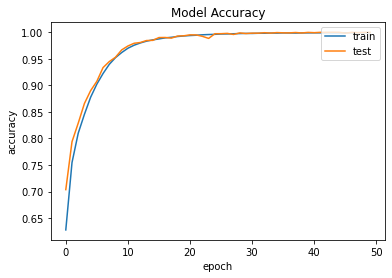

In [243]:
plt.plot(trained_model.history['accuracy'])
plt.plot(trained_model.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','test'],loc = 'upper right')

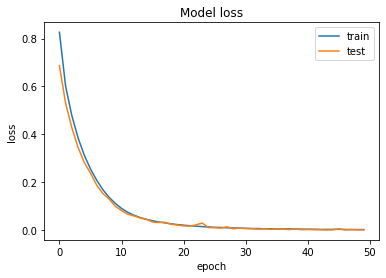

In [244]:
plt.plot(trained_model.history['loss'])
plt.plot(trained_model.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','test'],loc = 'upper right')

# Prediction

In [246]:
predictions = model.predict(testSamples, batch_size = 10, verbose = 2)

36929/36929 - 42s


In [248]:
for i in predictions:
    print (i)

[1.3236802e-09 9.9999630e-01 3.7404686e-06]
[9.9995661e-01 3.0332425e-09 4.3409935e-05]
[9.9886441e-01 1.7054111e-04 9.6513878e-04]
[3.7991183e-06 9.9999619e-01 1.0840617e-08]
[3.2558019e-12 1.0000000e+00 6.2403761e-13]
[0. 1. 0.]
[8.5604994e-17 1.0000000e+00 1.0319238e-09]
[3.1619204e-24 1.0000000e+00 1.3271955e-33]
[9.9999452e-01 5.4896464e-06 7.4889671e-13]
[5.2007505e-09 1.0000000e+00 3.4044441e-09]
[1.2239200e-04 1.4077038e-06 9.9987614e-01]
[3.2723178e-20 1.0000000e+00 1.0131167e-14]
[9.8883380e-13 1.0000000e+00 1.4173338e-08]
[9.998969e-01 9.722501e-05 5.889219e-06]
[2.0796882e-11 1.0000000e+00 4.8791271e-12]
[4.374850e-06 9.999956e-01 6.895103e-09]
[3.8600415e-10 9.7638774e-01 2.3612224e-02]
[1.8657003e-04 9.9981350e-01 2.2347535e-15]
[9.7393706e-07 1.6744399e-03 9.9832457e-01]
[9.9999535e-01 9.7225018e-07 3.6904905e-06]
[3.1842414e-31 1.0000000e+00 0.0000000e+00]
[3.344178e-32 1.000000e+00 0.000000e+00]
[2.8734366e-04 1.2567441e-06 9.9971133e-01]
[1.0000000e+00 6.1281701e-16 1

[2.7111669e-06 9.9999332e-01 3.9183437e-06]
[7.7979966e-12 1.0000000e+00 2.1012189e-11]
[9.9998391e-01 2.6645386e-08 1.6054688e-05]
[1.4602899e-08 9.9999988e-01 1.3930298e-07]
[2.705501e-11 1.000000e+00 5.409915e-13]
[1.0226815e-27 1.0000000e+00 4.4645138e-34]
[1.0000000e+00 1.9923053e-16 1.1599262e-17]
[2.2790015e-03 9.9770653e-01 1.4397771e-05]
[1.0000000e+00 1.1663902e-11 4.1871140e-13]
[9.9998653e-01 1.3463598e-05 2.0278365e-20]
[1.000000e+00 3.341212e-14 2.879497e-18]
[1.5598094e-10 1.0000000e+00 5.9881565e-11]
[2.979062e-14 1.000000e+00 8.323138e-34]
[1.0000000e+00 2.5207506e-15 9.8031365e-17]
[3.1971755e-11 1.0000000e+00 9.3185668e-17]
[1.0000000e+00 3.9536863e-09 1.2527529e-08]
[9.9997556e-01 2.4420324e-05 5.0518138e-19]
[8.9466055e-17 9.9999869e-01 1.3358126e-06]
[1.0000000e+00 2.2788314e-13 7.3226451e-13]
[9.9999905e-01 9.0827092e-07 1.0489835e-12]
[2.4913123e-09 9.9999142e-01 8.5985212e-06]
[9.9999869e-01 1.0913226e-06 1.9453194e-07]
[1.0000000e+00 4.8390785e-09 1.5901219e-2

[7.0357414e-11 9.9999321e-01 6.8453814e-06]
[1.5868311e-05 1.1394868e-06 9.9998295e-01]
[1.1695707e-06 9.9999881e-01 1.6325036e-08]
[4.21307833e-09 1.00000000e+00 1.22399385e-20]
[9.8478240e-01 4.0534385e-05 1.5177039e-02]
[7.180452e-24 1.000000e+00 3.090076e-32]
[9.9999881e-01 1.1741976e-06 2.2107031e-08]
[9.9999988e-01 1.4665613e-07 1.3859487e-16]
[3.7638204e-06 9.9999619e-01 3.8021800e-16]
[4.9303067e-16 1.0000000e+00 1.2531379e-15]
[1.0000000e+00 1.3936649e-13 6.2661112e-14]
[3.0663342e-03 9.9693286e-01 8.6619883e-07]
[2.9528042e-09 1.0000000e+00 4.8057372e-27]
[5.8979167e-26 1.0000000e+00 1.6314072e-26]
[1.6130753e-04 2.8477536e-06 9.9983585e-01]
[1.07016724e-13 1.00000000e+00 1.40692250e-10]
[1.4177513e-14 3.9692446e-12 1.0000000e+00]
[4.9586685e-11 1.0000000e+00 1.4709763e-28]
[1.0000000e+00 1.9248043e-13 1.0476289e-12]
[1.0201728e-11 1.0000000e+00 2.1552256e-10]
[8.8692514e-07 1.4322474e-06 9.9999774e-01]
[1.0000000e+00 6.9101391e-10 5.7907984e-10]
[4.2818421e-08 1.9340099e-07 

[1.7427979e-16 1.0000000e+00 1.1650086e-31]
[2.1612952e-12 1.0000000e+00 9.6640470e-17]
[4.0502431e-07 9.9999964e-01 1.9549151e-19]
[1.0831997e-05 9.9991810e-01 7.0985181e-05]
[1.2191187e-07 7.0696029e-07 9.9999917e-01]
[8.7502676e-06 9.9999034e-01 9.7687666e-07]
[2.4111487e-03 6.6034168e-05 9.9752277e-01]
[6.1047418e-13 1.0000000e+00 1.2465258e-14]
[1.9649354e-10 9.9999988e-01 1.3737525e-07]
[1.0000000e+00 4.7700038e-12 6.5311435e-17]
[9.999088e-01 9.120445e-05 6.264976e-11]
[8.910892e-16 9.391412e-15 1.000000e+00]
[1.0000000e+00 3.5060548e-12 1.8775788e-13]
[4.4855351e-08 1.9896216e-07 9.9999976e-01]
[3.5847013e-05 9.9995947e-01 4.6432565e-06]
[9.9999988e-01 3.6508190e-09 1.0520166e-07]
[9.9999416e-01 5.8260116e-06 1.2556371e-09]
[1.15407544e-14 6.92647190e-11 1.00000000e+00]
[9.3360040e-07 2.7387989e-08 9.9999905e-01]
[9.1199007e-11 1.0000000e+00 2.3306955e-11]
[9.9999988e-01 1.5112764e-07 7.2472253e-20]
[2.0091398e-14 2.8023268e-09 1.0000000e+00]
[9.9999905e-01 8.3688443e-09 8.9476

[8.3417140e-09 3.6010524e-06 9.9999642e-01]
[2.7494944e-12 1.0000000e+00 4.1509451e-15]
[3.4175288e-27 1.0000000e+00 5.3182531e-33]
[1.0064690e-04 9.9989939e-01 4.7788316e-15]
[1.0000000e+00 1.1696016e-09 1.5670104e-14]
[3.0623642e-08 9.9999917e-01 8.2522070e-07]
[3.8076423e-06 1.0309126e-09 9.9999619e-01]
[2.0678173e-05 9.9997938e-01 7.1634673e-12]
[1.0000000e+00 1.3056704e-10 6.3073025e-17]
[1.2270713e-09 9.9995732e-01 4.2630229e-05]
[9.9983585e-01 7.3386275e-07 1.6343732e-04]
[4.8051320e-04 1.4193449e-05 9.9950528e-01]
[1.000000e+00 5.183071e-14 6.126668e-18]
[6.8762266e-15 1.0000000e+00 4.1698830e-13]
[1.4827758e-10 1.0000000e+00 3.4874166e-14]
[2.8307745e-11 1.0000000e+00 2.0268796e-37]
[4.4704742e-09 9.8004639e-01 1.9953568e-02]
[3.9522687e-09 9.9999619e-01 3.7988430e-06]
[8.1967948e-25 1.0000000e+00 4.1436885e-35]
[1.32220675e-05 9.99986768e-01 1.09220344e-09]
[2.639673e-12 1.000000e+00 6.252931e-14]
[3.0379098e-08 9.9443096e-01 5.5689923e-03]
[1.5358076e-07 9.9999988e-01 1.3973

[8.6406347e-17 7.4273165e-05 9.9992573e-01]
[5.3939985e-16 1.0000000e+00 6.6733235e-13]
[1.0320415e-17 1.0000000e+00 2.2394485e-28]
[9.9831593e-01 2.7941976e-05 1.6560955e-03]
[8.401112e-12 1.000000e+00 5.259032e-14]
[1.0000000e+00 2.1645968e-11 8.3068687e-26]
[2.5529604e-12 1.0000000e+00 1.1928751e-12]
[9.999995e-01 4.794971e-07 9.756203e-09]
[1.0000000e+00 9.3131808e-10 3.0877395e-08]
[1.2875616e-07 5.0964081e-07 9.9999940e-01]
[9.9999881e-01 2.8847031e-08 1.2516255e-06]
[1.1309857e-21 1.0000000e+00 5.0688208e-22]
[9.9774820e-01 2.2517410e-03 1.2131482e-14]
[9.9999034e-01 5.0883749e-08 9.6935637e-06]
[1.7991377e-07 9.9989820e-01 1.0154156e-04]
[9.8330235e-17 1.0000000e+00 9.7456234e-13]
[1.1894559e-03 3.5915404e-05 9.9877459e-01]
[1.13693716e-07 6.88771928e-09 9.99999881e-01]
[2.021294e-10 1.000000e+00 1.674055e-27]
[1.0000000e+00 2.9900504e-13 2.4223594e-09]
[6.4480986e-14 1.0000000e+00 0.0000000e+00]
[1.5789573e-14 1.8097105e-14 1.0000000e+00]
[5.2362882e-15 1.0000000e+00 2.2345764

[2.1482586e-12 1.0000000e+00 1.0804901e-09]
[1.0000000e+00 4.8123755e-13 1.9789534e-14]
[8.9042857e-08 9.9999988e-01 2.0020778e-18]
[9.765571e-13 1.000000e+00 5.242411e-20]
[5.8011838e-12 1.0000000e+00 3.1752873e-10]
[3.5741673e-13 1.0000000e+00 2.7620340e-13]
[9.9999845e-01 6.2604073e-09 1.5954726e-06]
[1.16159114e-04 1.05373985e-07 9.99883771e-01]
[1.0976683e-17 1.0000000e+00 2.9328996e-17]
[1.0000000e+00 6.4865375e-21 1.5051979e-22]
[1.1562979e-06 5.5509659e-06 9.9999332e-01]
[3.1237239e-03 9.9647164e-01 4.0470719e-04]
[1.4343256e-05 4.1305438e-07 9.9998522e-01]
[9.9998951e-01 1.0534896e-05 2.3473330e-08]
[1.0000000e+00 5.0190703e-08 2.9419574e-22]
[0. 1. 0.]
[1.3181711e-11 1.0000000e+00 0.0000000e+00]
[8.5236866e-15 1.0000000e+00 3.9673037e-10]
[1.7547713e-25 1.0000000e+00 2.0025189e-35]
[5.68457553e-03 9.94315445e-01 1.27287835e-17]
[7.0104565e-05 9.9992990e-01 4.1213571e-14]
[1.000000e+00 3.815563e-08 3.412167e-09]
[4.8265517e-20 5.7140643e-09 1.0000000e+00]
[1.2038760e-07 9.9947

[1.0000000e+00 7.4974194e-11 3.8368297e-15]
[9.9999261e-01 2.9527500e-08 7.3530155e-06]
[5.4975175e-07 1.7028745e-07 9.9999928e-01]
[6.4888816e-08 9.9999988e-01 6.1442045e-12]
[3.2675111e-15 1.0000000e+00 1.2143275e-16]
[8.7222207e-31 1.0000000e+00 9.7265064e-26]
[9.9999893e-01 1.0684669e-06 1.8931825e-14]
[7.912174e-20 1.000000e+00 7.144979e-26]
[1.0000000e+00 4.7827765e-08 2.8384346e-08]
[2.4560217e-03 9.9753213e-01 1.1722785e-05]
[8.689089e-06 9.999913e-01 1.868064e-17]
[1.4030119e-11 1.0000000e+00 2.1468757e-18]
[1.000000e+00 2.151254e-10 3.071020e-14]
[9.997454e-01 2.545789e-04 5.876585e-12]
[1.0000000e+00 9.2261358e-11 3.3144357e-16]
[5.8177113e-10 1.0000000e+00 2.5957004e-17]
[1.0000000e+00 2.1054774e-13 9.1922954e-13]
[9.6533214e-14 1.0000000e+00 2.8686314e-26]
[4.2094432e-11 1.0000000e+00 1.0595379e-11]
[5.1839673e-19 1.0000000e+00 1.1044684e-17]
[1.5905204e-16 2.1574668e-14 1.0000000e+00]
[7.0657057e-11 9.9999344e-01 6.5581880e-06]
[3.5744993e-18 1.0000000e+00 1.3231532e-23]


[4.7020566e-07 9.9996698e-01 3.2497719e-05]
[2.6515906e-06 9.9999738e-01 4.8096262e-14]
[2.5697121e-08 4.3901277e-08 9.9999988e-01]
[9.9999940e-01 5.3773891e-07 2.0099756e-24]
[1.0000000e+00 1.5236327e-10 1.7770569e-23]
[1.7989962e-07 9.9999976e-01 1.8035149e-21]
[1.6987545e-04 1.1521477e-06 9.9982893e-01]
[1.0000000e+00 3.5365934e-16 8.7162009e-16]
[1.0000000e+00 2.9960123e-08 3.0740089e-14]
[9.9999964e-01 3.4700111e-07 3.3238804e-16]
[2.0093588e-21 1.0000000e+00 1.3440376e-13]
[8.9185292e-08 9.9999988e-01 2.4437193e-13]
[9.9951184e-01 3.6636825e-09 4.8814458e-04]
[7.5871483e-03 9.9241287e-01 6.8871548e-09]
[9.9955398e-01 2.6785517e-06 4.4333833e-04]
[1.2013308e-07 9.9999988e-01 1.9624226e-21]
[6.7782335e-09 1.0000000e+00 8.0490623e-12]
[1.0000000e+00 1.9343389e-18 3.1562762e-19]
[7.32444954e-16 1.00000000e+00 1.05282284e-16]
[4.0439611e-13 4.6153182e-06 9.9999535e-01]
[9.9999964e-01 3.6068122e-09 3.9484812e-07]
[1.7809776e-25 1.0000000e+00 2.6479919e-28]
[2.9342268e-20 1.0000000e+00 

[1.0000000e+00 4.8354081e-12 2.9094296e-26]
[8.652399e-05 8.506476e-07 9.999126e-01]
[5.135853e-22 1.000000e+00 9.463121e-15]
[1.0000000e+00 4.3566627e-15 1.0835860e-16]
[9.9999118e-01 3.1281576e-08 8.7706849e-06]
[3.5802334e-08 6.1447750e-04 9.9938548e-01]
[2.3012430e-13 2.0866862e-10 1.0000000e+00]
[7.3589952e-08 9.9446833e-01 5.5315322e-03]
[4.2961584e-04 1.2549666e-06 9.9956912e-01]
[2.0106600e-06 1.1755061e-06 9.9999678e-01]
[2.6948678e-03 9.9730515e-01 1.4277500e-09]
[1.0000000e+00 1.9028185e-17 3.0011634e-28]
[1.0000000e+00 8.9676853e-09 1.7853455e-09]
[9.9756539e-01 5.8655377e-08 2.4346346e-03]
[1.0000000e+00 1.1883888e-10 3.5520278e-12]
[8.932731e-09 9.999989e-01 1.037440e-06]
[2.4825695e-15 1.0000000e+00 1.5775208e-11]
[1.1937544e-05 9.9997890e-01 9.2039763e-06]
[3.7998518e-10 9.9988985e-01 1.1011981e-04]
[9.4389482e-11 1.0000000e+00 5.0656982e-11]
[4.2353696e-03 3.4990899e-06 9.9576110e-01]
[7.4202922e-05 1.5139595e-07 9.9992561e-01]
[5.5536629e-09 1.0000000e+00 4.4624401e-1

[2.4247760e-21 1.0000000e+00 1.9847127e-23]
[1.8176081e-10 2.5064629e-08 1.0000000e+00]
[4.05628392e-10 1.30483775e-08 1.00000000e+00]
[1.0000000e+00 6.2091843e-10 1.0918021e-15]
[9.9978286e-01 6.1263887e-07 2.1660155e-04]
[8.1533358e-07 9.9999917e-01 4.8704883e-22]
[5.5812441e-05 9.9994421e-01 7.9871293e-10]
[9.9999917e-01 3.4455510e-07 4.2678420e-07]
[4.0839193e-18 1.0000000e+00 1.6097085e-19]
[9.9852920e-01 1.4707252e-03 1.5021923e-08]
[4.5957242e-17 1.0000000e+00 3.5727206e-14]
[3.435872e-10 1.000000e+00 6.274249e-20]
[2.8003755e-13 9.9999976e-01 2.6506603e-07]
[8.410043e-12 1.000000e+00 5.194296e-13]
[8.8770381e-13 9.9892956e-01 1.0704022e-03]
[2.9202411e-16 1.0000000e+00 1.0431624e-27]
[1.9479306e-02 1.8103745e-04 9.8033971e-01]
[1.3491430e-06 9.9998260e-01 1.6102278e-05]
[3.3098352e-06 3.7592557e-07 9.9999630e-01]
[2.5460988e-05 9.9997449e-01 9.0557192e-16]
[4.2021605e-07 1.2386000e-06 9.9999833e-01]
[9.9999988e-01 1.1578696e-07 3.8003783e-25]
[9.9995935e-01 1.9490601e-06 3.8743

[3.0761813e-20 1.0000000e+00 1.6030035e-28]
[2.0292176e-05 3.9899969e-10 9.9997973e-01]
[3.957712e-18 1.000000e+00 8.888050e-15]
[1.8473666e-09 6.5653172e-09 1.0000000e+00]
[7.9483563e-08 1.4013270e-07 9.9999976e-01]
[2.8598904e-26 1.0000000e+00 0.0000000e+00]
[2.7988267e-06 9.9991405e-01 8.3209823e-05]
[2.0347654e-10 7.2571731e-07 9.9999928e-01]
[2.0402124e-09 1.0000000e+00 7.0726895e-09]
[9.9999642e-01 2.2627778e-06 1.3544459e-06]
[6.305019e-05 9.999331e-01 3.805783e-06]
[1.8491804e-06 5.5368281e-07 9.9999762e-01]
[5.1800888e-03 9.9481946e-01 5.0817425e-07]
[9.9996984e-01 3.0200890e-05 7.3560407e-15]
[9.9993372e-01 6.6221924e-05 1.1199746e-16]
[9.9687636e-01 2.1816687e-07 3.1233686e-03]
[2.1495293e-12 1.0000000e+00 1.1201154e-08]
[9.9962258e-01 3.0892217e-04 6.8465619e-05]
[9.5950511e-19 1.0000000e+00 1.4166496e-20]
[1.2102026e-03 1.1848075e-06 9.9878865e-01]
[1.0000000e+00 4.5960324e-09 5.9677063e-13]
[2.0546217e-17 1.0000000e+00 2.6215613e-11]
[9.9591631e-01 5.6955387e-06 4.0780450

[1.7639410e-04 1.0574812e-06 9.9982256e-01]
[2.2552833e-09 5.6304490e-08 1.0000000e+00]
[1.0000000e+00 1.3195391e-08 3.7993683e-08]
[1.9284544e-12 1.0000000e+00 1.3933891e-27]
[9.9991584e-01 8.4178784e-05 4.1358697e-13]
[2.5148680e-07 9.9999976e-01 4.4127970e-14]
[9.9999988e-01 1.1860152e-07 4.2478221e-09]
[1.2006337e-12 1.0000000e+00 3.0966967e-09]
[2.6882552e-21 1.0000000e+00 2.7527425e-27]
[1.6574939e-14 6.3690333e-12 1.0000000e+00]
[1.0035366e-07 2.2199313e-06 9.9999774e-01]
[3.0629811e-11 1.0000000e+00 1.4414285e-08]
[6.785743e-11 1.000000e+00 6.229626e-09]
[2.5102683e-05 9.9997246e-01 2.4208184e-06]
[3.1151048e-09 1.2349972e-06 9.9999881e-01]
[3.4812497e-10 1.0000000e+00 1.0107402e-19]
[5.524680e-07 9.999994e-01 5.389376e-13]
[9.9999964e-01 2.5002515e-07 7.2435363e-08]
[2.9051377e-04 9.9970943e-01 1.2296432e-10]
[4.7290353e-03 9.9527091e-01 4.2008242e-12]
[4.2417266e-35 1.0000000e+00 0.0000000e+00]
[1.9478130e-05 2.6653029e-06 9.9997783e-01]
[1.0000000e+00 8.4497642e-14 1.8396796

[9.9998641e-01 1.2977582e-05 6.3208580e-07]
[1.1119103e-14 2.7715425e-14 1.0000000e+00]
[2.6939470e-14 3.2593265e-11 1.0000000e+00]
[2.1865856e-22 1.0000000e+00 1.0995852e-14]
[7.3413666e-13 2.5546667e-06 9.9999750e-01]
[3.1428601e-24 1.0000000e+00 7.8996278e-20]
[0. 1. 0.]
[0. 1. 0.]
[6.7172954e-07 9.9999928e-01 5.9316125e-14]
[3.0647163e-07 9.9999964e-01 4.5168052e-14]
[5.507632e-15 1.000000e+00 2.164756e-09]
[9.9999654e-01 5.6458184e-08 3.4493871e-06]
[9.4066998e-08 9.4284161e-08 9.9999976e-01]
[8.0874785e-10 9.9996722e-01 3.2729753e-05]
[9.9999952e-01 4.3683315e-09 4.4966163e-07]
[6.8972232e-09 1.6229863e-04 9.9983764e-01]
[1.7742548e-13 1.0000000e+00 2.1337598e-10]
[1.7706964e-15 5.8473101e-11 1.0000000e+00]
[3.8731947e-08 7.7958111e-06 9.9999213e-01]
[5.5601347e-05 4.4256326e-06 9.9993992e-01]
[9.9991477e-01 7.1247545e-05 1.3997894e-05]
[2.592409e-29 1.000000e+00 0.000000e+00]
[1.0000000e+00 1.6857716e-17 3.0174897e-19]
[9.9993837e-01 4.3057034e-07 6.1107101e-05]
[3.7435535e-20 1

[1.3099897e-08 1.0000000e+00 2.6234643e-13]
[2.53538812e-09 1.00000000e+00 1.09662175e-10]
[3.8941870e-24 1.0000000e+00 1.5963309e-24]
[9.0099711e-08 9.8299372e-01 1.7006133e-02]
[2.4102358e-26 1.0000000e+00 0.0000000e+00]
[3.4393575e-19 1.0000000e+00 6.5513974e-27]
[2.4767322e-11 9.9875093e-01 1.2490894e-03]
[2.9006165e-13 1.0000000e+00 9.5180246e-11]
[9.9776399e-01 6.3672564e-07 2.2353828e-03]
[5.9833193e-13 9.9999976e-01 1.8964653e-07]
[1.5850453e-08 1.0000000e+00 1.0993307e-08]
[2.28608882e-10 9.99989033e-01 1.10166075e-05]
[1.0000000e+00 1.6743267e-23 2.3905235e-32]
[1.4182214e-37 1.0000000e+00 4.6088801e-37]
[1.2991750e-09 1.0000000e+00 2.5652633e-25]
[2.0976841e-13 9.9999964e-01 4.1042205e-07]
[9.9999833e-01 1.7057587e-06 3.8372534e-12]
[2.5477597e-16 9.5909695e-12 1.0000000e+00]
[9.9909484e-01 6.6696160e-08 9.0504275e-04]
[3.8556096e-05 5.8167267e-08 9.9996138e-01]
[1.2185788e-15 1.0000000e+00 2.0717855e-26]
[9.1511109e-14 1.0000000e+00 7.6707966e-11]
[8.364038e-19 1.000000e+00

[3.8541871e-06 9.9999619e-01 2.9129246e-13]
[7.5299013e-04 9.9924707e-01 2.9615668e-11]
[9.4486086e-10 1.0000000e+00 1.6612822e-18]
[1.0000000e+00 8.9992569e-18 1.0330217e-18]
[1.8511265e-09 8.0513859e-11 1.0000000e+00]
[1.000000e+00 6.203303e-28 6.703221e-37]
[9.4403585e-10 1.0000000e+00 4.5609465e-08]
[2.8205112e-16 1.0000000e+00 1.0521235e-25]
[3.4181564e-11 1.0000000e+00 3.0590365e-21]
[3.1931956e-15 1.0000000e+00 1.0097518e-30]
[1.9066131e-15 1.0000000e+00 7.8051332e-10]
[3.1448799e-13 9.9999988e-01 7.1516425e-08]
[5.1452975e-10 1.0000000e+00 1.6474366e-10]
[1.0000000e+00 3.3824038e-10 5.2091164e-14]
[8.3120444e-09 1.0000000e+00 2.3301443e-26]
[1.0890475e-24 1.0000000e+00 1.5551485e-21]
[3.156588e-05 3.021157e-03 9.969472e-01]
[3.7560875e-11 9.9998474e-01 1.5248620e-05]
[9.8923159e-10 1.0000000e+00 2.4067137e-10]
[3.3033785e-16 3.2406505e-14 1.0000000e+00]
[1.1497385e-14 1.0000000e+00 4.2871769e-13]
[9.3405658e-16 1.0000000e+00 1.9412037e-28]
[5.2032585e-05 9.8072485e-07 9.9994695

[4.841498e-16 1.000000e+00 8.156979e-21]
[1.911029e-06 8.761213e-06 9.999893e-01]
[1.0000000e+00 3.3909692e-10 9.2974586e-13]
[1.6714253e-07 9.4554895e-07 9.9999893e-01]
[8.279716e-28 1.000000e+00 3.326508e-38]
[9.9999988e-01 4.1150477e-10 9.4406538e-08]
[1.1709608e-06 9.9996591e-01 3.2955220e-05]
[8.4982804e-19 1.0000000e+00 1.9965059e-30]
[6.7982603e-10 9.9885821e-01 1.1418425e-03]
[2.0410078e-15 1.0000000e+00 2.5799566e-12]
[9.8854218e-07 2.6285048e-05 9.9997270e-01]
[6.8370073e-11 1.4179638e-08 1.0000000e+00]
[2.2509343e-03 9.9706692e-01 6.8217772e-04]
[1.0942035e-05 9.9998903e-01 1.6302455e-25]
[2.9349909e-08 8.9464429e-06 9.9999106e-01]
[1.0819504e-16 1.0000000e+00 2.9839062e-11]
[8.7866742e-10 9.9995494e-01 4.5086072e-05]
[9.999187e-01 8.128017e-05 9.675926e-22]
[1.6484855e-11 1.0000000e+00 9.3155148e-16]
[1.0000000e+00 1.3309151e-13 3.8201408e-28]
[8.203544e-08 9.999999e-01 7.854950e-11]
[5.9753374e-13 1.0000000e+00 4.4569995e-16]
[9.9999750e-01 2.4673955e-06 1.1840641e-18]
[1.

[9.9998236e-01 2.3726663e-09 1.7683977e-05]
[1.1076842e-16 1.0000000e+00 7.0936432e-13]
[1.0000000e+00 3.9095387e-21 1.1633436e-23]
[9.9999988e-01 1.3013363e-07 9.1216136e-24]
[3.6025205e-18 1.0000000e+00 4.4238841e-31]
[3.9533127e-11 2.4449696e-09 1.0000000e+00]
[1.3559539e-21 1.0000000e+00 6.5588527e-26]
[1.0000000e+00 1.9164549e-10 1.1268912e-08]
[1.0000000e+00 1.8883679e-09 1.4346807e-16]
[9.9999738e-01 2.9515577e-09 2.5670115e-06]
[1.8319801e-09 1.0000000e+00 4.5456157e-24]
[3.4896490e-05 4.1688807e-04 9.9954814e-01]
[1.0000000e+00 5.7595646e-08 1.5609053e-09]
[1.0000000e+00 1.0947590e-15 1.6736995e-17]
[9.9998760e-01 9.4184522e-08 1.2233066e-05]
[6.1188343e-21 1.0000000e+00 6.8864540e-18]
[1.7405446e-05 9.9947220e-01 5.1043194e-04]
[1.0316803e-11 2.0958103e-06 9.9999785e-01]
[9.998939e-01 6.762691e-05 3.853243e-05]
[1.0000000e+00 2.0538255e-14 1.1430744e-13]
[5.5087183e-04 2.6659172e-02 9.7278994e-01]
[1.0000000e+00 2.2934142e-08 3.2057765e-09]
[1.1289176e-02 5.9879547e-08 9.8871

[4.72680426e-15 1.19392995e-14 1.00000000e+00]
[9.9999869e-01 1.3482977e-06 3.3976341e-28]
[2.8082301e-04 9.9970043e-01 1.8774033e-05]
[2.5121353e-06 9.9999738e-01 1.2604920e-07]
[4.2440963e-04 1.1881076e-06 9.9957436e-01]
[2.4595472e-06 6.3885938e-07 9.9999690e-01]
[2.419609e-15 1.000000e+00 3.816878e-13]
[1.0000000e+00 2.2804438e-10 1.3451275e-13]
[1.6165593e-06 9.9999833e-01 2.0827480e-12]
[2.9907851e-10 1.0000000e+00 5.7543263e-12]
[3.8243499e-08 1.0000000e+00 1.6718055e-12]
[9.9999905e-01 9.9048202e-07 3.0020772e-20]
[1.6899955e-08 9.9998784e-01 1.2126046e-05]
[1.0143787e-02 4.0848150e-05 9.8981535e-01]
[1.5459554e-08 1.0000000e+00 2.3855147e-12]
[3.9868801e-16 9.9999869e-01 1.2835154e-06]
[1.9116671e-08 1.0000000e+00 7.9388299e-15]
[3.1302650e-06 9.9999690e-01 4.2609465e-13]
[3.0586139e-15 1.0000000e+00 1.0589463e-14]
[9.9996924e-01 1.4831412e-05 1.5965074e-05]
[2.0276441e-09 9.9996603e-01 3.3949913e-05]
[9.9573189e-01 4.2681536e-03 9.7028460e-20]
[9.9999976e-01 3.5035291e-11 2.1

[3.3657664e-06 9.9996698e-01 2.9649054e-05]
[3.155397e-08 4.358465e-08 9.999999e-01]
[1.0317408e-20 1.0000000e+00 1.4488137e-18]
[1.9237179e-07 2.7742925e-10 9.9999976e-01]
[1.7482496e-15 9.9690956e-01 3.0904913e-03]
[3.7256669e-09 1.0000000e+00 5.1996197e-24]
[9.9554114e-08 9.9999988e-01 3.2272192e-27]
[1.405915e-27 1.000000e+00 8.823203e-27]
[1.0000000e+00 5.8007897e-18 3.5485182e-28]
[9.9525636e-01 3.2269421e-05 4.7113360e-03]
[1.0000000e+00 2.5214303e-10 3.3631833e-09]
[7.249833e-18 1.000000e+00 2.607044e-31]
[1.1673977e-06 1.7145005e-05 9.9998164e-01]
[6.7328404e-16 3.0076029e-14 1.0000000e+00]
[5.5252157e-12 9.9993587e-01 6.4130356e-05]
[1.0000000e+00 2.2097419e-18 9.0318462e-21]
[9.9999869e-01 1.2748467e-06 5.3160784e-17]
[2.6441971e-09 1.0000000e+00 1.1959269e-21]
[7.9020097e-08 2.2420886e-06 9.9999774e-01]
[3.09404214e-07 9.99999642e-01 1.01975116e-13]
[7.33551951e-06 9.99992609e-01 1.13854176e-10]
[1.0505351e-18 1.0000000e+00 1.4222986e-18]
[1.8008218e-12 1.0000000e+00 1.2778

[3.4661307e-21 1.0000000e+00 3.9911220e-28]
[6.029641e-13 9.993825e-01 6.174819e-04]
[1.0183067e-18 1.0000000e+00 4.5621375e-16]
[3.6927141e-04 9.9963069e-01 1.7321071e-10]
[6.9805495e-13 1.0000000e+00 2.3149298e-28]
[4.4219506e-10 9.9999082e-01 9.1220145e-06]
[7.0312705e-29 1.0000000e+00 0.0000000e+00]
[1.0767312e-04 1.8396461e-10 9.9989235e-01]
[9.9840707e-01 6.9273335e-07 1.5921956e-03]
[2.8869355e-08 9.9999988e-01 1.0347844e-07]
[1.1137715e-07 9.9999988e-01 4.5460004e-15]
[0. 1. 0.]
[9.7708268e-09 1.0000000e+00 6.8971825e-25]
[1.9356937e-10 9.7869796e-01 2.1302100e-02]
[1.0000000e+00 2.9134889e-11 1.8315107e-14]
[1.0000000e+00 6.1544275e-10 8.3637271e-17]
[1.0000000e+00 3.2977714e-11 2.6181046e-10]
[9.057118e-10 1.000000e+00 0.000000e+00]
[1.0000000e+00 4.2780002e-11 7.3585027e-09]
[9.9999988e-01 8.0677530e-08 6.1842633e-19]
[9.9997127e-01 5.4934726e-06 2.3237180e-05]
[3.5081507e-11 1.0000000e+00 7.0744008e-21]
[1.3023974e-21 1.0000000e+00 2.3654247e-16]
[3.0206485e-17 1.0000000e+0

[9.9995589e-01 7.1191010e-08 4.3975677e-05]
[7.578957e-11 1.000000e+00 3.361314e-11]
[9.9999988e-01 6.0636076e-08 9.1133012e-09]
[8.7705459e-08 9.9998009e-01 1.9793533e-05]
[2.0377871e-05 9.9997962e-01 1.2719381e-08]
[4.456528e-14 1.000000e+00 2.526843e-09]
[4.1533206e-15 1.1543837e-14 1.0000000e+00]
[3.2972620e-04 9.9967027e-01 1.7640601e-14]
[4.9560147e-21 1.0000000e+00 1.5659361e-20]
[1.0737212e-12 1.0000000e+00 4.2689173e-27]
[1.5277634e-04 9.9984717e-01 2.1609035e-08]
[3.5387240e-17 2.6596267e-11 1.0000000e+00]
[8.6390291e-11 1.0000000e+00 9.7449005e-24]
[1.3659577e-14 1.0000000e+00 2.1807945e-16]
[2.4772699e-09 7.1609925e-08 9.9999988e-01]
[4.1512811e-07 9.9999964e-01 1.2551993e-23]
[1.0000000e+00 5.0752881e-20 6.7698416e-26]
[1.0000000e+00 9.2525954e-13 3.1340268e-15]
[1.0000000e+00 2.0491588e-09 7.8954550e-09]
[8.8400001e-15 1.4513445e-14 1.0000000e+00]
[8.51358e-30 1.00000e+00 0.00000e+00]
[2.6372501e-10 1.0000000e+00 1.6727489e-09]
[6.4402695e-07 9.9999940e-01 7.5726795e-15]


[2.6098459e-08 1.0000000e+00 2.6547754e-08]
[1.6863126e-02 6.5099130e-06 9.8313034e-01]
[4.5295329e-10 1.0000000e+00 7.7845922e-16]
[2.6533019e-08 1.4679564e-07 9.9999988e-01]
[1.1072654e-10 2.5150937e-04 9.9974853e-01]
[9.990797e-01 9.193132e-04 9.837770e-07]
[9.9999988e-01 2.5903862e-11 1.2639295e-07]
[3.3195615e-08 1.0000000e+00 1.7158168e-17]
[2.6842991e-14 1.5323139e-11 1.0000000e+00]
[3.8069054e-19 2.2719632e-15 1.0000000e+00]
[6.0385355e-05 9.9993956e-01 3.4648356e-22]
[3.1808846e-05 4.3265327e-06 9.9996388e-01]
[9.9998999e-01 7.7916206e-07 9.1228339e-06]
[1.32971386e-11 1.00000000e+00 2.67330205e-15]
[5.0259467e-12 9.9999774e-01 2.2158554e-06]
[5.5873295e-14 1.0000000e+00 6.3482787e-28]
[1.0000000e+00 3.4990384e-13 1.2365598e-16]
[3.1079987e-09 1.0000000e+00 4.3321796e-10]
[1.0000000e+00 1.2310562e-26 1.2587019e-35]
[4.5350287e-10 9.9999952e-01 4.5014434e-07]
[8.5570974e-11 1.0000000e+00 3.8576453e-20]
[6.8959346e-13 1.0000000e+00 2.5780425e-20]
[3.7868917e-06 9.9999619e-01 3.8

[9.9999988e-01 3.8027226e-09 1.4848099e-07]
[2.7758155e-05 2.1341400e-06 9.9997008e-01]
[1.3043729e-11 1.0000000e+00 6.3101857e-11]
[1.6487266e-16 1.0000000e+00 7.6356592e-30]
[4.2580800e-11 1.0000000e+00 1.9431202e-08]
[3.0867786e-16 1.0000000e+00 3.3687163e-21]
[1.0000000e+00 2.3666768e-18 4.8785300e-20]
[3.9716497e-10 1.0000000e+00 6.7679785e-12]
[4.0233485e-07 9.9999964e-01 1.4636174e-14]
[1.5652174e-07 2.1053826e-07 9.9999964e-01]
[5.4301413e-06 9.5655832e-07 9.9999356e-01]
[1.8087642e-10 9.9999952e-01 4.5013573e-07]
[1.33462486e-08 1.00000000e+00 5.21782418e-15]
[1.0000000e+00 6.5615197e-14 2.6772055e-19]
[1.0000000e+00 2.7380908e-27 5.8410608e-36]
[1.10772644e-08 9.99889135e-01 1.10808374e-04]
[1.6943195e-18 1.0000000e+00 1.4087603e-27]
[1.6622077e-18 1.0000000e+00 3.2168776e-15]
[1.9113449e-04 2.1369526e-05 9.9978751e-01]
[1.4327118e-16 1.0000000e+00 2.7560064e-11]
[3.9435097e-21 1.0000000e+00 1.7936806e-09]
[1.00000000e+00 1.13132434e-10 2.03426609e-10]
[1.1770633e-27 1.000000

[1.0000000e+00 2.3390598e-14 7.8117937e-13]
[9.9967027e-01 2.4322225e-04 8.6570937e-05]
[2.7529279e-05 9.9997222e-01 1.9814095e-07]
[9.7397583e-09 9.9809688e-01 1.9030672e-03]
[9.9983084e-01 4.7458179e-06 1.6435415e-04]
[3.6630265e-16 1.0000000e+00 0.0000000e+00]
[9.9996901e-01 3.6459937e-06 2.7332519e-05]
[9.7300172e-06 9.9999022e-01 2.6919227e-14]
[9.1039387e-10 9.9998915e-01 1.0795083e-05]
[2.4309973e-23 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.3777985e-17 6.6833952e-18]
[9.999584e-01 4.153003e-05 6.187357e-08]
[1.3802222e-19 1.0000000e+00 6.7422152e-18]
[6.08131811e-02 9.39080060e-01 1.06696636e-04]
[1.0309105e-09 9.9999988e-01 8.1717950e-08]
[2.5519935e-14 1.0000000e+00 1.8489350e-28]
[1.0000000e+00 2.8719095e-08 3.9418042e-09]
[6.5565973e-07 3.1561473e-08 9.9999928e-01]
[6.2018515e-08 2.3118687e-08 9.9999988e-01]
[2.3286557e-11 9.9999988e-01 1.4084574e-07]
[5.4897132e-17 1.0000000e+00 3.3375542e-30]
[9.9991322e-01 8.6728178e-05 2.9058025e-13]
[9.914077e-17 9.045956e-12 1.000

[1.0000000e+00 1.8617455e-09 7.7788088e-11]
[8.2697946e-11 9.9999964e-01 3.9043297e-07]
[1.6094980e-13 9.9999976e-01 2.5009146e-07]
[1.7293714e-19 1.0000000e+00 4.1189584e-29]
[6.295561e-13 1.000000e+00 5.086151e-09]
[8.1246432e-23 1.0000000e+00 3.5711942e-14]
[2.9742691e-11 1.1505788e-10 1.0000000e+00]
[1.00000000e+00 1.35307855e-17 2.21146138e-26]
[1.000000e+00 8.870184e-11 8.502952e-11]
[9.9991906e-01 1.1904134e-05 6.9044530e-05]
[9.9999046e-01 9.5790610e-06 1.4823084e-11]
[6.5072201e-17 1.0000000e+00 2.8682835e-17]
[5.8603454e-03 1.6575341e-06 9.9413800e-01]
[1.0000000e+00 2.1345223e-09 1.8384121e-37]
[1.3693498e-03 9.2756414e-07 9.9862981e-01]
[3.3762274e-11 1.0000000e+00 2.2359130e-22]
[1.8982450e-12 2.4435825e-11 1.0000000e+00]
[1.2455138e-13 1.5975569e-07 9.9999988e-01]
[1.3963699e-04 9.9986029e-01 1.5165493e-13]
[1.6718022e-04 9.9983275e-01 1.0908842e-12]
[1.5211221e-16 1.0352740e-11 1.0000000e+00]
[2.5528253e-11 1.0000000e+00 2.0823771e-13]
[1.0811255e-08 1.0000000e+00 3.8061

[1.33325036e-14 9.99996901e-01 3.15235275e-06]
[2.6064463e-17 3.1390402e-15 1.0000000e+00]
[2.1515181e-05 9.7524798e-01 2.4730582e-02]
[4.3847144e-06 9.9999523e-01 3.2663252e-07]
[1.9385622e-09 1.0000000e+00 3.1452546e-34]
[5.5425897e-10 9.9998832e-01 1.1648105e-05]
[1.0000000e+00 1.6239587e-08 2.7220789e-08]
[1.5166032e-03 1.8357341e-05 9.9846506e-01]
[1.0000000e+00 5.5727284e-10 2.0696709e-09]
[6.2267396e-09 1.0000000e+00 1.2307726e-14]
[6.7611403e-12 1.0000000e+00 1.8174462e-09]
[2.5471880e-07 9.9999976e-01 1.3422143e-19]
[0.12024132 0.00276115 0.8769976 ]
[8.3245144e-09 1.0000000e+00 1.1307732e-08]
[3.0655992e-15 1.0000000e+00 1.0397781e-26]
[7.8931669e-07 9.9999917e-01 2.7643379e-11]
[1.0851559e-12 1.0000000e+00 5.2120542e-23]
[9.9999988e-01 1.4401569e-07 4.2659714e-08]
[1.0000000e+00 7.8398635e-11 2.1098452e-26]
[1.0000000e+00 2.5420678e-11 2.6633724e-19]
[7.3582675e-11 9.9999952e-01 4.9965814e-07]
[1.8199889e-09 1.0000000e+00 2.6853046e-35]
[4.0953708e-07 1.0235524e-04 9.9989724

[4.2409674e-12 1.0000000e+00 2.3384766e-13]
[9.9999988e-01 9.8631965e-08 1.1940018e-08]
[6.038357e-11 1.000000e+00 4.038833e-08]
[4.7957092e-09 1.0000000e+00 2.3693236e-18]
[5.5303253e-12 1.0000000e+00 8.3861598e-12]
[9.0702429e-13 1.0000000e+00 2.0066339e-19]
[4.7899974e-12 1.0000000e+00 4.0950403e-19]
[9.8123050e-01 1.8754080e-02 1.5403766e-05]
[3.2340525e-16 1.0000000e+00 1.6284637e-29]
[1.1507993e-11 9.9999571e-01 4.2556776e-06]
[4.2336978e-10 1.0000000e+00 1.0376220e-12]
[9.999999e-01 6.268306e-08 9.333531e-12]
[1.0000000e+00 3.4320958e-12 7.3818643e-17]
[5.6224038e-05 9.9994373e-01 4.8671161e-11]
[1.3991417e-12 1.0000000e+00 1.4350401e-26]
[1.8633725e-13 1.0000000e+00 1.3651673e-27]
[1.0000000e+00 1.7690680e-09 1.9401413e-13]
[2.8116590e-10 9.9999678e-01 3.2316386e-06]
[1.000000e+00 4.405892e-26 6.260406e-35]
[8.6675680e-09 9.7464186e-01 2.5358126e-02]
[2.4714839e-09 1.0000000e+00 1.7949346e-15]
[9.9999976e-01 2.2960331e-10 2.2331335e-07]
[8.7164670e-05 5.4322868e-07 9.9991226e-0

[9.9986434e-01 1.3568165e-04 6.8442132e-13]
[1.18495335e-17 1.00000000e+00 1.43015267e-21]
[9.9753904e-01 2.4609989e-03 9.9008552e-09]
[9.9997318e-01 2.6767801e-05 2.5792776e-23]
[4.737473e-30 1.000000e+00 0.000000e+00]
[1.0000000e+00 1.8843205e-16 8.6641836e-17]
[9.9996114e-01 3.8850965e-05 3.1123444e-13]
[8.1125330e-03 9.9188751e-01 1.9194041e-22]
[1.7767779e-10 9.9999285e-01 7.1768100e-06]
[5.8917627e-16 1.0000000e+00 5.7885375e-20]
[3.3702405e-09 9.9988174e-01 1.1820955e-04]
[3.2347139e-34 1.0000000e+00 1.1666857e-23]
[3.9726794e-14 8.7049186e-09 1.0000000e+00]
[3.999412e-21 1.000000e+00 7.091500e-22]
[7.6289762e-19 1.0000000e+00 5.7415602e-36]
[1.5238161e-09 9.9999964e-01 3.5106331e-07]
[1.4556832e-09 9.9999356e-01 6.4953229e-06]
[1.0000000e+00 4.7341352e-13 3.2755323e-17]
[8.6227031e-10 1.0000000e+00 3.0937888e-11]
[1.0000000e+00 2.1908917e-09 1.3516887e-20]
[2.6491379e-25 1.0000000e+00 2.3082991e-35]
[9.9999630e-01 3.6745778e-06 1.2237080e-22]
[2.2471420e-09 2.2432676e-08 1.0000

[9.9999845e-01 1.1811689e-07 1.3970372e-06]
[1.274268e-20 1.000000e+00 9.080178e-28]
[1.0000000e+00 3.0161348e-17 2.1831978e-18]
[9.9406767e-01 2.6332384e-05 5.9060263e-03]
[9.9999988e-01 1.0016418e-07 1.5443244e-09]
[9.9999917e-01 7.9165068e-07 3.3871942e-12]
[4.804331e-25 1.000000e+00 9.974621e-17]
[7.124584e-21 1.000000e+00 6.711999e-29]
[1.0000000e+00 2.0653735e-08 2.7390209e-08]
[1.0571728e-04 7.7894147e-06 9.9988651e-01]
[3.5318625e-23 1.0000000e+00 5.2458318e-35]
[1.8539525e-06 9.9999809e-01 5.7315732e-20]
[8.5792816e-15 9.9977976e-01 2.2024025e-04]
[4.5977263e-12 1.0000000e+00 2.2497506e-08]
[0. 1. 0.]
[8.842271e-08 9.992693e-01 7.305851e-04]
[1.1956779e-10 9.9999988e-01 7.7118685e-08]
[1.0141695e-12 1.0000000e+00 2.0243411e-11]
[9.9836355e-01 1.8992116e-06 1.6345857e-03]
[3.2655115e-11 4.2059602e-11 1.0000000e+00]
[2.2853883e-09 1.3914713e-06 9.9999857e-01]
[6.6863754e-06 9.9999332e-01 1.4344512e-10]
[9.99999046e-01 1.01094940e-06 1.32254725e-14]
[5.5677955e-11 1.0000000e+00 3

[9.4584693e-14 1.0000000e+00 1.1045904e-10]
[6.5525932e-13 1.0000000e+00 8.5299166e-26]
[1.465952e-20 1.000000e+00 6.351517e-23]
[1.0855655e-09 1.0000000e+00 5.5073652e-09]
[9.8778787e-07 9.9999905e-01 4.0984611e-18]
[1.0119987e-10 1.0000000e+00 6.4046685e-11]
[1.20819685e-04 9.99879122e-01 2.89577462e-15]
[8.6174339e-09 9.9970299e-01 2.9698596e-04]
[3.8242735e-05 3.7332657e-07 9.9996138e-01]
[1.5054885e-10 1.0000000e+00 2.0934445e-09]
[1.0000000e+00 5.2436178e-10 1.6444797e-17]
[9.9999940e-01 6.3356413e-07 5.8562394e-10]
[9.9775356e-01 1.8057619e-03 4.4069279e-04]
[1.0000000e+00 3.9795122e-18 1.0198054e-29]
[6.0387784e-09 2.3460595e-08 1.0000000e+00]
[7.8781297e-05 9.9992120e-01 1.6179992e-09]
[3.7008934e-03 9.9629909e-01 1.8815224e-13]
[8.8742144e-14 1.0000000e+00 3.3199793e-08]
[4.08528680e-12 9.99999881e-01 1.03440755e-07]
[1.0000000e+00 1.2357414e-09 6.8139796e-14]
[3.6571257e-06 9.9999630e-01 3.7635012e-08]
[1.9423321e-06 9.9999774e-01 4.0871592e-07]
[1.0000000e+00 7.2194583e-15 

[9.9992776e-01 7.8145013e-07 7.1406423e-05]
[1.9913863e-03 9.9800867e-01 7.9088229e-09]
[1.2288550e-12 1.0000000e+00 3.7935974e-19]
[1.00000000e+00 5.98212784e-15 1.26058925e-14]
[7.0023552e-16 1.0000000e+00 5.3315174e-18]
[6.2885812e-19 1.0000000e+00 1.4682663e-31]
[1.000000e+00 9.641036e-09 1.100675e-09]
[3.7285921e-11 1.0000000e+00 1.4220823e-17]
[1.0000000e+00 2.2331148e-09 1.6225771e-09]
[7.8726031e-10 2.5627676e-06 9.9999738e-01]
[3.1662859e-09 9.9971086e-01 2.8913139e-04]
[1.0750199e-09 9.9999976e-01 2.8235891e-07]
[1.2730850e-16 1.4614017e-12 1.0000000e+00]
[1.0000000e+00 9.3789121e-16 1.7856825e-13]
[1.1882196e-04 9.9988115e-01 9.2819882e-16]
[9.9988556e-01 1.4687171e-05 9.9736739e-05]
[1.9741862e-12 2.4661357e-08 1.0000000e+00]
[2.9723527e-05 1.2807193e-08 9.9997032e-01]
[1.0000000e+00 2.4840713e-11 1.0948677e-11]
[1.4684179e-05 2.1645019e-06 9.9998319e-01]
[1.4179285e-08 1.4847136e-07 9.9999988e-01]
[2.3661569e-15 2.6504493e-12 1.0000000e+00]
[9.5839758e-10 2.5334556e-08 1.0

[2.0897198e-05 9.4546872e-01 5.4510426e-02]
[9.9973816e-01 2.6082102e-04 1.1222907e-06]
[1.0000000e+00 4.9345943e-17 3.3881705e-17]
[3.2652634e-18 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.5424856e-08 3.6318136e-26]
[1.0000000e+00 2.1936708e-14 3.6924589e-13]
[9.9998200e-01 1.7978666e-05 9.5851886e-18]
[1.6634476e-06 9.9999189e-01 6.3812699e-06]
[9.3123397e-08 9.9990296e-01 9.6963558e-05]
[5.4081002e-09 1.0000000e+00 1.1903625e-25]
[2.2605088e-15 1.0000000e+00 1.1051348e-09]
[2.3177292e-06 9.9999762e-01 5.9888940e-08]
[4.852162e-14 1.000000e+00 8.158498e-15]
[3.8877593e-13 8.6655275e-12 1.0000000e+00]
[2.2314302e-06 5.6974369e-07 9.9999726e-01]
[3.3845316e-04 2.0438908e-07 9.9966133e-01]
[6.6002445e-05 2.6635895e-04 9.9966764e-01]
[1.0000000e+00 9.9475055e-14 3.3521275e-14]
[6.4801862e-12 1.0000000e+00 1.3600286e-09]
[9.316270e-07 9.999945e-01 4.575940e-06]
[6.9497651e-14 1.0000000e+00 6.1571753e-10]
[9.6098539e-15 1.6313681e-06 9.9999833e-01]
[5.465351e-09 1.000000e+00 4.836706e-1

[9.9999511e-01 4.8846673e-06 6.2546021e-19]
[5.95035132e-09 1.00000000e+00 1.04991145e-08]
[1.0432033e-04 9.9989104e-01 4.6280852e-06]
[7.1190137e-10 1.0000000e+00 2.7806592e-26]
[9.9997580e-01 4.2020683e-06 2.0020525e-05]
[9.9986851e-01 1.5164176e-05 1.1637012e-04]
[8.5644955e-03 1.9838033e-05 9.9141568e-01]
[8.525878e-12 1.000000e+00 5.836936e-11]
[9.9998271e-01 1.7328059e-05 3.3430555e-13]
[1.0000000e+00 2.2168542e-15 9.1705549e-26]
[1.0000000e+00 4.8754688e-24 3.8273094e-32]
[4.5936193e-14 2.8397382e-09 1.0000000e+00]
[1.9663747e-05 1.4194643e-06 9.9997890e-01]
[1.7370763e-09 1.0000000e+00 8.7254628e-13]
[1.0304342e-03 1.8972420e-05 9.9895060e-01]
[1.0000000e+00 4.8555537e-09 3.1135659e-08]
[4.7912482e-16 1.2418266e-11 1.0000000e+00]
[1.3425625e-12 1.0000000e+00 3.2639569e-25]
[1.4952672e-06 9.9999845e-01 2.0065376e-13]
[1.000000e+00 6.010327e-09 8.929334e-09]
[2.62910388e-10 1.00000000e+00 1.39214135e-11]
[2.8477243e-15 1.0000000e+00 3.1485912e-12]
[1.0241923e-12 1.0000000e+00 3.3

[7.569981e-08 9.999999e-01 2.484282e-24]
[9.9999988e-01 7.5757441e-08 1.6488208e-16]
[9.9999976e-01 1.9253605e-07 1.2948498e-10]
[1.0000000e+00 7.2173893e-16 1.9223588e-15]
[1.9598287e-09 1.3389630e-06 9.9999869e-01]
[4.9254507e-11 1.0000000e+00 1.7748281e-08]
[1.0000000e+00 4.3989392e-11 1.7251047e-12]
[2.2433606e-09 1.0000000e+00 4.0213416e-10]
[4.7343683e-06 9.9213541e-01 7.8598252e-03]
[1.7084472e-05 9.9998295e-01 3.5252338e-08]
[5.9088013e-16 1.0000000e+00 6.1615058e-30]
[9.4873758e-06 6.6809440e-07 9.9998987e-01]
[8.6880281e-10 5.8436593e-09 1.0000000e+00]
[5.9979266e-06 9.9999404e-01 6.3722801e-22]
[9.9591982e-01 3.9331939e-05 4.0408964e-03]
[4.7456747e-06 9.9999523e-01 1.5979859e-10]
[1.5578275e-27 9.0741090e-15 1.0000000e+00]
[1.0000000e+00 8.8140528e-12 5.5826764e-17]
[1.04257385e-08 1.00000000e+00 1.67808127e-29]
[4.7429194e-07 1.4617806e-02 9.8538172e-01]
[9.6413489e-05 9.9990356e-01 1.1809086e-10]
[5.5548397e-05 3.5580767e-06 9.9994087e-01]
[9.9904233e-01 5.3463651e-09 9.5

[2.1872444e-03 9.9781018e-01 2.6442297e-06]
[0. 1. 0.]
[2.2295971e-11 1.0000000e+00 4.6518734e-14]
[2.3123144e-23 1.0000000e+00 2.6731571e-13]
[9.9934751e-01 6.5250898e-04 3.0897869e-09]
[1.3686716e-08 1.0000000e+00 9.2898931e-16]
[6.5376010e-04 9.9934620e-01 2.0039961e-22]
[1.0968781e-09 9.9993193e-01 6.8041183e-05]
[2.3558414e-10 1.0000000e+00 3.1686536e-08]
[2.4086969e-05 9.9997425e-01 1.6827486e-06]
[9.9866784e-01 3.5401992e-08 1.3321184e-03]
[9.4523642e-08 1.1137310e-07 9.9999976e-01]
[4.5439538e-05 9.9995458e-01 1.8748147e-30]
[3.5898485e-16 1.0000000e+00 2.5586598e-30]
[1.0000000e+00 1.5322313e-12 8.3613666e-17]
[4.9435513e-14 1.0000000e+00 6.2444370e-09]
[1.9235331e-22 1.0000000e+00 1.7547789e-09]
[6.7202264e-04 8.8844087e-07 9.9932706e-01]
[3.629800e-10 1.000000e+00 5.604188e-12]
[1.8851483e-15 1.0000000e+00 4.9185046e-33]
[2.7524484e-12 1.0000000e+00 9.7562941e-29]
[2.7739677e-08 1.0000000e+00 4.9602805e-32]
[1.0440622e-12 1.0000000e+00 4.0994457e-20]
[4.339075e-06 9.999957e-

[3.9413209e-10 1.0000000e+00 1.8802248e-19]
[9.9998915e-01 1.0798563e-05 2.1489398e-20]
[1.000000e+00 4.014007e-14 2.866031e-24]
[6.8119391e-07 1.3449022e-07 9.9999917e-01]
[3.7682713e-10 9.9999940e-01 5.6361864e-07]
[9.9999976e-01 1.7269522e-07 1.2339900e-07]
[1.0000000e+00 1.6006299e-09 1.7411363e-09]
[6.1516562e-06 9.9998999e-01 3.7980842e-06]
[1.000000e+00 4.578193e-09 3.286864e-11]
[9.996909e-01 6.674085e-06 3.025041e-04]
[2.15445890e-12 1.00000000e+00 1.15757876e-10]
[1.7866828e-09 2.2395703e-04 9.9977607e-01]
[5.7735265e-09 9.9999940e-01 5.8020254e-07]
[8.1430359e-17 1.0000000e+00 1.2611206e-18]
[9.9998832e-01 1.1689079e-05 8.5781382e-12]
[9.834035e-10 1.000000e+00 4.826620e-11]
[3.9990855e-09 1.0000000e+00 3.5383552e-12]
[9.9926430e-01 2.9392939e-07 7.3541596e-04]
[1.5087893e-09 1.0000000e+00 2.4155127e-09]
[1.0000000e+00 9.2511276e-10 1.0133564e-14]
[4.6898857e-10 9.9999166e-01 8.3505374e-06]
[1.5239405e-29 1.0000000e+00 2.7595216e-36]
[6.1849796e-09 2.9361034e-08 1.0000000e+0

[1.9915287e-06 9.9999797e-01 1.0252207e-15]
[9.9999881e-01 1.1469656e-06 6.4075622e-13]
[6.6628797e-10 1.0000000e+00 1.1314970e-10]
[4.6912177e-07 9.9999952e-01 3.0579833e-22]
[1.382885e-32 1.000000e+00 0.000000e+00]
[1.2648986e-09 9.9847311e-01 1.5268852e-03]
[1.0000000e+00 5.5371338e-08 8.5766338e-20]
[3.028626e-14 1.000000e+00 9.922608e-21]
[7.805504e-10 8.629704e-08 9.999999e-01]
[6.209318e-20 2.977899e-13 1.000000e+00]
[1.0000000e+00 2.1976934e-12 7.2361469e-13]
[9.9998486e-01 1.5144088e-05 2.0327961e-14]
[1.2459708e-12 1.0000000e+00 8.5318671e-19]
[1.0000000e+00 4.4865366e-12 1.0364403e-10]
[6.709894e-12 1.000000e+00 2.330274e-14]
[1.2172673e-17 1.0000000e+00 3.2664573e-08]
[1.7945772e-09 1.0000000e+00 4.2800442e-13]
[7.1478524e-07 9.9999189e-01 7.3658334e-06]
[1.7902558e-09 1.0000000e+00 9.8796164e-23]
[4.1629242e-10 9.9998379e-01 1.6179896e-05]
[5.1580328e-32 1.0000000e+00 3.6198732e-28]
[2.6403492e-11 1.0000000e+00 2.3449456e-12]
[1.9628821e-11 1.0000000e+00 2.8996136e-18]
[1.

[4.387724e-20 1.000000e+00 9.481161e-28]
[6.0082611e-10 1.0000000e+00 4.0045755e-08]
[1.0000000e+00 4.3822005e-14 1.9364665e-13]
[1.0000000e+00 1.5219835e-13 6.7798808e-15]
[2.4670285e-06 9.9999750e-01 8.8725967e-19]
[3.0042724e-10 4.6946457e-08 1.0000000e+00]
[1.0000000e+00 4.9868827e-16 5.9825069e-18]
[6.285153e-11 9.999943e-01 5.744162e-06]
[1.0745492e-19 1.0000000e+00 2.0406279e-21]
[9.9995673e-01 4.3307107e-05 3.1153732e-12]
[1.2120542e-10 1.0000000e+00 8.8845220e-23]
[9.9999988e-01 1.4738909e-10 1.1295363e-07]
[4.9225e-34 1.0000e+00 0.0000e+00]
[9.9962425e-01 9.8386499e-06 3.6585974e-04]
[2.3298285e-30 1.0000000e+00 4.6195336e-20]
[1.0000000e+00 1.9518834e-11 4.0490664e-09]
[1.000000e+00 4.444729e-10 8.469974e-16]
[9.9999857e-01 1.7221634e-08 1.4605807e-06]
[9.9983203e-01 1.6797629e-04 7.1029538e-10]
[1.9546801e-06 9.9879020e-01 1.2079179e-03]
[1.0000000e+00 1.2644431e-09 3.9291479e-13]
[3.2359893e-09 1.0000000e+00 1.1152564e-09]
[1.7706999e-03 2.6697047e-05 9.9820256e-01]
[1.000

[2.4024210e-10 1.0000000e+00 1.2143112e-35]
[2.2289617e-09 1.0000000e+00 2.4712794e-14]
[1.5157579e-13 1.0000000e+00 2.1105904e-14]
[1.4571114e-10 1.0000000e+00 1.7137023e-19]
[1.0000000e+00 4.6171834e-08 3.7208817e-12]
[1.0000000e+00 9.2159861e-15 4.7951866e-13]
[1.0000000e+00 3.7448277e-11 1.6384806e-10]
[9.9953866e-01 4.5664274e-04 4.8051388e-06]
[1.000000e+00 4.253913e-12 4.585634e-26]
[2.1165039e-05 9.9993408e-01 4.4680211e-05]
[5.3214817e-06 9.9999428e-01 3.0262174e-07]
[5.5054270e-06 9.9999452e-01 1.7439923e-16]
[9.9999928e-01 1.3493558e-10 6.8882349e-07]
[4.9633335e-04 6.5898621e-07 9.9950302e-01]
[1.5056117e-29 3.0788775e-15 1.0000000e+00]
[1.00000000e+00 4.30198099e-08 1.03130475e-26]
[1.1676871e-31 1.0000000e+00 3.9951170e-26]
[9.999988e-01 4.768036e-07 7.136697e-07]
[1.5571015e-21 1.0000000e+00 9.2509156e-25]
[9.9997389e-01 2.6091699e-05 5.6266813e-09]
[2.1486182e-13 1.0000000e+00 2.1886519e-10]
[2.0147076e-05 3.7752660e-08 9.9997985e-01]
[8.2284797e-11 9.9999416e-01 5.7897

[1.1592463e-11 1.0000000e+00 4.1106976e-31]
[3.1623762e-18 1.0000000e+00 2.6203642e-24]
[0. 1. 0.]
[9.9981469e-01 1.8530578e-04 9.0685662e-12]
[1.345585e-02 6.102934e-08 9.865441e-01]
[1.0000000e+00 2.7217874e-16 4.5352058e-13]
[1.0000000e+00 1.0532567e-16 7.6284019e-17]
[3.7728002e-12 1.0000000e+00 1.0650536e-10]
[1.1609138e-16 1.0000000e+00 2.5275271e-13]
[1.0000000e+00 7.6562319e-20 1.1247835e-25]
[1.0000000e+00 3.8814645e-15 4.7858280e-14]
[6.9350802e-14 1.0000000e+00 5.7839744e-18]
[1.0561051e-07 2.6087566e-06 9.9999726e-01]
[1.000000e+00 4.008778e-12 4.632225e-11]
[1.0000000e+00 2.0368767e-16 4.0957765e-18]
[1.0000000e+00 4.7895148e-15 6.0380256e-14]
[4.5067168e-09 9.8005819e-01 1.9941788e-02]
[1.3515890e-15 1.0000000e+00 3.5084844e-15]
[9.9999547e-01 3.6191927e-10 4.5878205e-06]
[1.0000000e+00 1.1356194e-15 1.4605341e-17]
[7.0154447e-09 9.9977738e-01 2.2260858e-04]
[1.4902937e-05 9.9998510e-01 1.1937700e-12]
[9.1733609e-17 1.0000000e+00 1.2092968e-18]
[9.4316825e-11 9.9998522e-0

[1.4140915e-07 9.9999988e-01 2.1684650e-14]
[1.3759045e-29 1.0000000e+00 0.0000000e+00]
[1.0186374e-17 1.0000000e+00 3.4853350e-18]
[1.9028916e-09 1.0000000e+00 1.1208344e-25]
[4.0215298e-08 1.0000000e+00 3.5478589e-11]
[5.709101e-15 1.000000e+00 7.676810e-15]
[4.9001580e-12 1.0000000e+00 3.7203864e-15]
[1.4929419e-07 9.8275650e-01 1.7243357e-02]
[1.5982011e-17 1.0000000e+00 1.0205399e-16]
[8.429138e-08 4.847107e-12 9.999999e-01]
[2.9875902e-15 1.0000000e+00 3.3300909e-29]
[1.6007794e-09 1.0000000e+00 2.7287769e-10]
[4.7874847e-31 1.0000000e+00 1.0234688e-29]
[1.2920665e-07 9.9999988e-01 1.7898459e-09]
[5.1292815e-12 1.0000000e+00 4.0447789e-22]
[1.1985584e-12 1.0000000e+00 4.2048416e-24]
[8.1363738e-10 1.0000000e+00 1.5002481e-18]
[1.0000000e+00 2.3307162e-16 1.7033853e-26]
[5.180824e-19 1.000000e+00 9.672001e-27]
[1.0000000e+00 2.9704822e-11 1.9972601e-15]
[3.0719418e-09 1.0000000e+00 1.4052011e-13]
[1.1370958e-18 1.0000000e+00 9.5639561e-26]
[3.3634318e-10 1.0000000e+00 4.7191123e-2

[6.309688e-16 1.000000e+00 0.000000e+00]
[1.1914623e-13 1.0000000e+00 7.8484273e-17]
[1.000000e+00 5.099451e-08 1.169020e-08]
[5.6992875e-30 1.0000000e+00 0.0000000e+00]
[1.0906934e-10 1.0000000e+00 7.4506672e-17]
[5.6776184e-27 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.9232560e-09 3.1676453e-11]
[5.5152283e-09 1.0000000e+00 4.1366048e-24]
[1.3019921e-06 9.9999869e-01 2.0683071e-12]
[1.0000000e+00 4.5332582e-10 4.1789048e-09]
[1.000000e+00 4.368123e-10 2.135393e-17]
[4.776591e-10 1.000000e+00 8.148974e-09]
[1.000000e+00 8.007605e-21 6.956215e-24]
[1.0000000e+00 1.4423739e-24 2.4651544e-33]
[1.5107709e-16 1.0000000e+00 4.2323704e-19]
[9.912840e-01 8.715848e-03 1.105499e-07]
[0. 1. 0.]
[7.8516314e-05 9.9992144e-01 8.1685165e-09]
[1.0260519e-06 9.9999893e-01 7.2998714e-15]
[9.9999988e-01 6.8822075e-08 1.2713793e-08]
[1.0000000e+00 1.8151082e-16 5.8360166e-17]
[3.1247654e-10 1.0000000e+00 5.4923671e-08]
[1.75723179e-15 1.00000000e+00 1.35319925e-14]
[9.9999940e-01 5.8141666e-07 3.01719

[2.3659444e-04 9.9976343e-01 3.0216210e-14]
[6.1279467e-16 9.9999785e-01 2.1820053e-06]
[4.8243452e-04 9.5950736e-07 9.9951661e-01]
[9.9939847e-01 6.0157903e-04 2.8793669e-19]
[9.9999988e-01 9.6458955e-08 4.4150100e-11]
[1.0000000e+00 5.4018012e-09 1.6346993e-15]
[3.0254057e-13 1.0000000e+00 2.0468295e-25]
[0. 1. 0.]
[1.27150095e-08 9.99857187e-01 1.42769204e-04]
[6.5747709e-06 9.9999344e-01 2.4701965e-08]
[3.2195858e-05 2.5138087e-07 9.9996758e-01]
[1.0000000e+00 1.7380829e-10 4.6277869e-13]
[1.00000000e+00 1.24201565e-08 1.39183476e-09]
[2.3074622e-13 1.0000000e+00 1.4514353e-26]
[1.13773766e-07 9.99999881e-01 2.18441445e-10]
[6.7864092e-09 1.0000000e+00 2.5662666e-10]
[9.9997437e-01 1.2628935e-07 2.5478037e-05]
[1.4977939e-12 1.0000000e+00 2.5701702e-14]
[2.3162590e-07 9.9999976e-01 2.3569643e-10]
[2.7367737e-12 9.9999952e-01 4.4016150e-07]
[9.9999762e-01 2.3543898e-06 9.2568196e-11]
[3.5997141e-09 1.0000000e+00 1.2238152e-22]
[1.0000000e+00 2.7095972e-14 1.1835496e-15]
[6.9493336e-

[1.0000000e+00 1.8460589e-10 8.9090502e-10]
[1.8829089e-02 9.8102254e-01 1.4843202e-04]
[1.0000000e+00 2.1009086e-09 2.2950203e-23]
[1.7223378e-29 1.0000000e+00 0.0000000e+00]
[8.4473257e-05 9.9991548e-01 9.9811166e-11]
[1.8663905e-11 1.0000000e+00 2.2594282e-10]
[1.0466307e-07 9.9999988e-01 3.1002834e-13]
[7.9105678e-04 4.4837680e-06 9.9920446e-01]
[1.0000000e+00 1.0320942e-14 6.0339579e-19]
[3.6315300e-06 2.6074442e-06 9.9999380e-01]
[9.9993241e-01 5.2570275e-08 6.7536130e-05]
[1.000000e+00 3.130916e-10 9.088049e-12]
[1.1059704e-08 9.9999821e-01 1.8117989e-06]
[4.3077855e-12 1.0000000e+00 5.7484979e-13]
[0. 1. 0.]
[1.0000000e+00 5.4774870e-13 3.1025213e-12]
[2.9286229e-21 1.0000000e+00 2.8026265e-35]
[1.0000000e+00 5.8596900e-08 5.2448754e-11]
[1.6212591e-09 1.0000000e+00 5.6687700e-11]
[1.5621213e-08 1.0000000e+00 1.1526799e-23]
[2.3063271e-09 2.2995278e-05 9.9997699e-01]
[1.6198330e-10 9.9987197e-01 1.2796241e-04]
[9.9997091e-01 7.3390936e-07 2.8373495e-05]
[2.6253236e-10 9.9998391

[4.0034648e-17 2.8234207e-14 1.0000000e+00]
[4.9153696e-06 9.9976438e-01 2.3077654e-04]
[9.7553998e-01 5.0377828e-04 2.3956241e-02]
[2.4014601e-09 1.0000000e+00 6.9962500e-21]
[2.8485268e-16 1.0000000e+00 2.1905510e-11]
[1.03163036e-13 1.00000000e+00 4.97369405e-25]
[1.0000000e+00 5.4238826e-21 5.1014238e-24]
[1.693432e-28 1.000000e+00 0.000000e+00]
[1.0000000e+00 8.1725009e-11 5.7481906e-17]
[9.770055e-06 1.272105e-07 9.999901e-01]
[9.9999630e-01 2.5504397e-08 3.7499838e-06]
[2.317407e-06 9.643804e-01 3.561727e-02]
[1.0000000e+00 2.2446092e-10 6.7670712e-13]
[5.620687e-11 1.000000e+00 2.729558e-10]
[4.0069354e-12 1.0000000e+00 1.6300769e-10]
[1.0000000e+00 1.8204044e-14 7.6022684e-14]
[3.0089119e-21 1.0000000e+00 1.2143085e-13]
[6.6852344e-06 9.9999046e-01 2.8388761e-06]
[3.533562e-11 1.000000e+00 8.868163e-24]
[1.3314011e-04 3.4601314e-07 9.9986649e-01]
[1.8986663e-06 5.2129241e-07 9.9999762e-01]
[6.1417688e-07 1.6411805e-08 9.9999940e-01]
[1.0000000e+00 2.1853482e-10 4.8861413e-15]


[2.3165761e-05 6.1186807e-07 9.9997628e-01]
[1.5940230e-11 1.0000000e+00 4.2842407e-10]
[9.9999869e-01 2.0852047e-09 1.3065932e-06]
[3.7267409e-08 1.8103518e-07 9.9999976e-01]
[3.7474132e-07 9.9999964e-01 1.3354386e-24]
[9.8649847e-12 3.2809220e-04 9.9967194e-01]
[7.2688836e-06 1.0128624e-06 9.9999177e-01]
[1.0000000e+00 1.4031425e-08 1.9637113e-13]
[9.9996710e-01 9.5715480e-10 3.2906202e-05]
[9.8529647e-09 1.0000000e+00 6.6859745e-17]
[1.3813471e-11 1.0000000e+00 1.8539134e-10]
[5.1699154e-04 9.9948299e-01 1.2955001e-24]
[1.0000000e+00 9.4318745e-15 4.8722722e-16]
[1.0000000e+00 7.8124351e-09 2.0186961e-11]
[6.1597342e-07 9.9997246e-01 2.6911992e-05]
[6.0653912e-11 1.0000000e+00 2.6269698e-09]
[4.0464893e-06 9.9999595e-01 3.0665309e-17]
[5.3385446e-07 2.3313156e-08 9.9999940e-01]
[3.4655272e-11 1.0000000e+00 1.1118911e-18]
[2.7001628e-09 1.0000000e+00 8.0601853e-12]
[9.9980170e-01 1.5681211e-05 1.8262982e-04]
[1.4507567e-23 1.0000000e+00 4.3015754e-36]
[5.7954579e-03 1.9983347e-06 9.9

[9.77784e-12 1.00000e+00 3.00942e-19]
[4.5853050e-17 1.0000000e+00 3.6060312e-23]
[3.465312e-05 9.999653e-01 6.999575e-16]
[9.9986815e-01 1.3140046e-04 4.8522895e-07]
[6.4767573e-07 9.9999940e-01 5.5151717e-13]
[2.262948e-08 9.994500e-01 5.499565e-04]
[2.7094924e-15 1.0000000e+00 7.6639308e-09]
[1.03944295e-07 9.99999881e-01 7.22969297e-12]
[2.4683018e-22 1.0000000e+00 5.7280898e-34]
[1.0000000e+00 2.6753147e-13 1.1775236e-12]
[2.9824862e-13 1.0000000e+00 3.9584527e-10]
[1.0000000e+00 4.7026757e-12 6.1635775e-14]
[3.2746315e-04 9.9967253e-01 5.9707129e-14]
[9.2588675e-13 9.9999857e-01 1.4292481e-06]
[4.4653906e-38 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 2.8266723e-16 1.5050359e-16]
[7.8696885e-08 9.9999988e-01 1.3060003e-08]
[1.0000000e+00 6.8798687e-09 5.1716881e-24]
[1.0000000e+00 9.4140006e-13 7.1250825e-11]
[9.999912e-01 8.281790e-06 5.754016e-07]
[9.99987721e-01 1.06909965e-05 1.52756877e-06]
[0. 1. 0.]
[3.7366660e-18 1.0000000e+00 1.6886602e-26]
[1.0000000e+00 1.9934502e-19 4

[3.447525e-28 1.000000e+00 0.000000e+00]
[5.5071654e-09 1.3912030e-07 9.9999988e-01]
[8.5560586e-10 5.7110155e-05 9.9994290e-01]
[1.1063416e-06 2.3741348e-10 9.9999893e-01]
[1.5465185e-08 1.4445503e-07 9.9999988e-01]
[8.828249e-28 1.000000e+00 6.266118e-27]
[9.9997067e-01 1.6411460e-06 2.7616985e-05]
[9.9997246e-01 6.6550697e-08 2.7452310e-05]
[1.6547815e-09 1.0000000e+00 3.7271168e-09]
[9.9999976e-01 1.9836989e-07 2.9735909e-09]
[9.999932e-01 6.446821e-06 3.248134e-07]
[9.9991500e-01 8.4978128e-05 3.0757512e-08]
[1.0000000e+00 2.4889595e-16 9.1998143e-18]
[2.8251801e-09 9.9999869e-01 1.2795434e-06]
[2.3907301e-10 9.9999905e-01 9.2019019e-07]
[2.0268533e-05 5.1798770e-06 9.9997461e-01]
[9.999999e-01 6.685826e-08 7.037655e-22]
[1.9586935e-11 1.0000000e+00 2.9392808e-19]
[9.9990511e-01 9.4851377e-05 1.7307149e-23]
[4.4324444e-10 1.6903473e-07 9.9999988e-01]
[2.6987721e-03 9.7253733e-06 9.9729151e-01]
[6.5171187e-13 9.9985862e-01 1.4136740e-04]
[0. 1. 0.]
[1.7866054e-17 1.2324248e-09 1.00

[3.8331258e-09 1.0000000e+00 1.8328544e-12]
[4.4425518e-17 4.2868009e-13 1.0000000e+00]
[7.991621e-08 9.999999e-01 4.110184e-14]
[1.7950840e-24 1.0000000e+00 2.0017078e-14]
[1.7687594e-07 9.9999988e-01 8.4442189e-11]
[1.3750187e-09 1.0000000e+00 2.2210279e-22]
[1.0451776e-03 9.9894840e-01 6.4560672e-06]
[9.9999678e-01 3.2303105e-06 2.2881465e-19]
[1.2432873e-11 9.9963641e-01 3.6357777e-04]
[1.2322931e-07 9.9999988e-01 1.3577932e-18]
[9.9999976e-01 1.5435513e-07 7.7926437e-08]
[6.2057275e-09 9.9999964e-01 3.0820385e-07]
[9.9999344e-01 6.5563122e-06 4.5031870e-10]
[9.522705e-12 9.999924e-01 7.625528e-06]
[1.8357701e-03 4.6438797e-07 9.9816376e-01]
[9.9999976e-01 1.4991276e-09 2.6715873e-07]
[1.0000000e+00 1.8048855e-13 3.1107546e-14]
[1.0000000e+00 7.0482207e-09 1.5277131e-13]
[6.6529768e-09 9.9999988e-01 1.2592204e-07]
[8.6700389e-09 1.0000000e+00 9.1000395e-11]
[4.0692583e-09 1.0000000e+00 3.1077261e-09]
[9.9866211e-01 1.3379278e-03 9.6322523e-09]
[5.269009e-30 1.000000e+00 0.000000e+0

[4.3842668e-12 4.5394377e-06 9.9999547e-01]
[1.4081303e-14 7.0632999e-11 1.0000000e+00]
[3.2177458e-17 1.0000000e+00 1.9065769e-15]
[3.5048155e-17 1.0000000e+00 8.8153043e-14]
[2.664892e-15 1.000000e+00 0.000000e+00]
[4.8854571e-12 9.9999952e-01 4.8474226e-07]
[9.9999976e-01 1.9257334e-09 2.5301824e-07]
[4.0916947e-07 9.9999964e-01 8.1234957e-15]
[1.0000000e+00 5.0630129e-11 4.5219392e-24]
[5.5699917e-07 9.9999940e-01 9.5602149e-14]
[4.2522826e-12 1.0000000e+00 1.6240962e-14]
[6.127589e-15 1.000000e+00 1.145316e-16]
[1.8965223e-04 4.7688042e-07 9.9980992e-01]
[1.6478049e-13 1.0000000e+00 1.8216953e-19]
[9.9999988e-01 1.3174548e-07 9.1870173e-17]
[1.0000000e+00 6.2284878e-12 9.8820839e-12]
[6.59821069e-12 1.00000000e+00 1.20689086e-26]
[9.9998593e-01 1.4110058e-05 7.4708995e-09]
[1.4683929e-11 9.9999988e-01 1.1792841e-07]
[6.6051419e-14 3.2842366e-12 1.0000000e+00]
[9.7720081e-09 9.9997985e-01 2.0118774e-05]
[1.3279992e-20 9.9999988e-01 7.0634314e-08]
[1.6374494e-14 1.0000000e+00 1.2695

[1.0976778e-15 1.0000000e+00 3.1259456e-10]
[8.3942716e-05 3.8316625e-06 9.9991226e-01]
[4.5911816e-06 9.9999535e-01 7.3122793e-29]
[3.4845574e-11 9.9975997e-01 2.4007226e-04]
[3.0795979e-20 1.0000000e+00 1.0148158e-27]
[7.883820e-21 1.000000e+00 9.190449e-18]
[1.3580624e-02 4.7164018e-08 9.8641938e-01]
[2.6201414e-07 9.9999976e-01 2.5043948e-33]
[1.7466543e-28 1.0000000e+00 4.6759802e-22]
[1.0000000e+00 3.6366329e-10 5.7706814e-08]
[2.7332696e-12 1.0000000e+00 1.5073511e-24]
[1.0000000e+00 9.4498910e-13 3.3848397e-12]
[8.7863200e-06 3.3518002e-06 9.9998784e-01]
[2.431406e-15 1.000000e+00 9.743542e-13]
[8.230538e-33 1.000000e+00 0.000000e+00]
[1.0000000e+00 1.3600206e-13 2.0717160e-17]
[6.9140077e-07 9.9999928e-01 2.9251729e-12]
[9.9999976e-01 1.7614634e-07 8.7950085e-08]
[7.7392942e-06 6.6265244e-07 9.9999166e-01]
[3.6173606e-08 9.9987912e-01 1.2087512e-04]
[2.4289505e-14 1.0000000e+00 6.9291972e-10]
[1.5774216e-07 9.9999988e-01 1.3246314e-10]
[1.0000000e+00 3.9205764e-13 4.7559318e-1

[2.7780774e-07 9.9999976e-01 1.6009901e-16]
[4.5010635e-09 1.0000000e+00 1.8227846e-10]
[5.3271056e-06 7.4192139e-05 9.9992049e-01]
[4.2241817e-07 1.5900710e-05 9.9998367e-01]
[1.0000000e+00 8.1147346e-11 1.5179272e-10]
[6.0546392e-07 9.9999940e-01 1.0493945e-15]
[9.0384947e-06 9.9999094e-01 1.1174962e-14]
[1.0000000e+00 7.5119990e-09 2.8919716e-24]
[1.5519068e-21 1.0000000e+00 5.1290764e-23]
[1.0000000e+00 3.5474028e-16 8.2056274e-15]
[1.0335158e-23 1.0000000e+00 4.7860098e-22]
[1.0000000e+00 3.9386028e-09 5.2574709e-09]
[9.9999821e-01 9.5168450e-11 1.8378365e-06]
[2.8464914e-08 7.4263489e-06 9.9999249e-01]
[1.2757053e-16 1.0000000e+00 4.3467502e-16]
[1.7951024e-11 1.0000000e+00 4.0790103e-28]
[3.1020566e-14 1.0000000e+00 1.8755141e-16]
[2.6038042e-05 8.1960161e-06 9.9996579e-01]
[0. 1. 0.]
[9.9999964e-01 8.3638270e-08 2.1102915e-07]
[9.9999821e-01 1.1379799e-09 1.7588630e-06]
[9.9999928e-01 7.4333894e-07 7.5345936e-13]
[6.6617951e-15 1.0000000e+00 1.0815017e-14]
[9.9999988e-01 9.5369

[0. 1. 0.]
[9.9999988e-01 6.7645075e-08 8.6446231e-13]
[1.0995282e-26 1.0000000e+00 1.1339228e-22]
[1.40443035e-08 1.00000000e+00 3.22904595e-32]
[9.612356e-09 1.000000e+00 2.866050e-26]
[3.06282581e-17 1.00000000e+00 1.00884886e-19]
[2.4811677e-09 9.9990129e-01 9.8672826e-05]
[1.4653451e-24 1.0000000e+00 5.6635276e-30]
[2.8647755e-23 1.0000000e+00 2.2444722e-25]
[2.5046191e-07 9.9999976e-01 4.8927230e-08]
[1.1068693e-08 1.0000000e+00 4.2243377e-19]
[2.3781945e-07 9.9824846e-01 1.7512814e-03]
[1.0000000e+00 1.9603005e-11 3.6284588e-13]
[1.0821396e-08 4.6964292e-06 9.9999535e-01]
[1.0000000e+00 3.9717371e-08 7.6277296e-14]
[7.2435105e-12 1.0000000e+00 2.0642291e-25]
[9.9999976e-01 8.1115417e-08 5.9885870e-08]
[8.151651e-08 8.524074e-08 9.999999e-01]
[9.9997580e-01 5.3473282e-06 1.8850835e-05]
[4.8884612e-08 1.0000000e+00 2.9269282e-19]
[5.422626e-19 1.000000e+00 4.592716e-22]
[1.3019185e-09 9.9999988e-01 6.5308370e-08]
[1.0000000e+00 5.2921719e-16 2.9650118e-20]
[1.000000e+00 5.855452e-

[8.3936799e-16 1.0000000e+00 4.2533963e-26]
[9.99985933e-01 2.34058390e-07 1.37918905e-05]
[8.6546514e-10 1.0000000e+00 6.0204526e-22]
[1.2260952e-30 1.0000000e+00 7.1709204e-33]
[1.1940630e-20 1.0000000e+00 2.5444052e-19]
[9.9999499e-01 5.0606350e-06 1.9303047e-14]
[6.7987330e-08 9.9999988e-01 4.1033096e-20]
[1.0000000e+00 1.5264183e-15 6.3938455e-10]
[9.9999952e-01 1.1092738e-08 5.1001911e-07]
[2.1333754e-08 1.0000000e+00 4.4888893e-09]
[2.7765044e-09 9.3904132e-01 6.0958765e-02]
[6.38581792e-16 9.99999881e-01 1.17240674e-07]
[9.9999952e-01 2.6820533e-07 2.9241102e-07]
[5.0409349e-06 9.9986923e-01 1.2578863e-04]
[5.986351e-10 9.999782e-01 2.180146e-05]
[2.7768073e-14 1.7609503e-14 1.0000000e+00]
[3.8210282e-10 1.0000000e+00 1.7643943e-20]
[6.8604258e-08 9.9999988e-01 2.2676718e-27]
[7.6017026e-14 1.0000000e+00 5.9726245e-21]
[9.9995613e-01 2.3406583e-06 4.1476662e-05]
[1.0000000e+00 2.5543827e-12 4.4751210e-11]
[9.9997556e-01 7.6878558e-07 2.3779083e-05]
[2.5351881e-05 9.9995720e-01 

[3.0925726e-08 1.0000000e+00 7.7186827e-23]
[1.0000000e+00 6.0464083e-09 5.8084333e-09]
[1.3353028e-22 1.0000000e+00 3.6815256e-27]
[8.4223011e-08 9.9999917e-01 7.5559723e-07]
[4.6970697e-17 1.0000000e+00 5.8753952e-18]
[2.2722017e-07 9.9999976e-01 8.3688846e-12]
[5.5171015e-20 1.0000000e+00 1.7017743e-19]
[9.9999988e-01 1.2732583e-07 2.1498436e-13]
[9.9999952e-01 4.9563886e-07 3.3944398e-19]
[3.0574774e-05 8.0667839e-08 9.9996936e-01]
[9.999490e-01 3.782393e-08 5.096977e-05]
[1.0000000e+00 8.1241042e-11 4.1518088e-11]
[9.9777514e-01 3.2500665e-07 2.2244726e-03]
[2.9241582e-28 1.0000000e+00 8.3168351e-31]
[1.0046071e-08 1.0000000e+00 1.7456427e-12]
[9.9955267e-01 9.2401052e-08 4.4719790e-04]
[6.0175445e-08 9.9999988e-01 8.9087757e-18]
[5.5517119e-10 1.0000000e+00 2.5717032e-08]
[8.601621e-06 9.999914e-01 2.564664e-10]
[1.3782417e-07 9.9999988e-01 1.3793610e-12]
[1.0000000e+00 3.6541295e-12 3.3711888e-26]
[9.9941432e-01 5.8978340e-08 5.8563595e-04]
[6.0481831e-05 9.9993956e-01 7.2970533

[1.0000000e+00 4.0633112e-27 6.9672994e-36]
[1.2483874e-20 1.0000000e+00 1.4474934e-18]
[9.5524263e-07 9.9999905e-01 2.5931510e-27]
[1.6042917e-03 9.9839574e-01 3.8116708e-13]
[6.536918e-06 3.321364e-07 9.999931e-01]
[2.0486269e-04 9.9979514e-01 1.2532940e-20]
[3.5080060e-07 8.8309594e-07 9.9999881e-01]
[5.1658794e-21 1.0000000e+00 1.6636460e-20]
[2.8163786e-08 9.9988389e-01 1.1603712e-04]
[5.2650708e-15 1.4091459e-14 1.0000000e+00]
[4.4167145e-10 1.0000000e+00 2.0634520e-08]
[3.2149806e-06 9.9999678e-01 5.7409188e-13]
[0. 1. 0.]
[1.6781777e-06 9.9999797e-01 3.0749166e-07]
[1.0000000e+00 2.9299077e-10 1.0564314e-09]
[3.355209e-12 9.991824e-01 8.175977e-04]
[1.0000000e+00 1.2475333e-08 1.2756343e-13]
[8.3365433e-20 1.0000000e+00 1.7429873e-20]
[1.000000e+00 8.729043e-09 3.051127e-11]
[0. 1. 0.]
[7.9221204e-25 1.0000000e+00 9.0961792e-24]
[8.8880103e-07 9.9999917e-01 1.0732847e-15]
[1.000000e+00 8.904587e-09 2.985231e-12]
[1.5211341e-03 9.9847883e-01 1.4260912e-13]
[5.6358892e-18 1.00000

[7.6551572e-05 9.9992347e-01 9.4336468e-09]
[9.294393e-24 1.000000e+00 6.967752e-21]
[7.812987e-09 1.000000e+00 2.971469e-18]
[2.6552051e-08 9.9998832e-01 1.1697666e-05]
[0. 1. 0.]
[1.740675e-13 9.871781e-01 1.282189e-02]
[5.2233099e-07 9.9999952e-01 1.4353639e-09]
[1.1577875e-23 1.0000000e+00 2.1750377e-23]
[9.9995315e-01 2.1512562e-06 4.4697728e-05]
[6.7472339e-10 1.6831642e-08 1.0000000e+00]
[9.970117e-20 1.000000e+00 4.838149e-19]
[7.4878688e-12 1.0000000e+00 3.4497556e-09]
[7.3218078e-04 6.5094588e-07 9.9926716e-01]
[4.3856358e-05 9.9324119e-01 6.7149843e-03]
[4.5440636e-05 6.1464874e-07 9.9995399e-01]
[1.04357495e-11 1.00000000e+00 6.55851535e-22]
[5.977336e-08 9.999999e-01 3.205579e-10]
[2.3845221e-06 1.0656699e-06 9.9999654e-01]
[4.6300815e-05 9.9995375e-01 3.3138796e-15]
[9.9999988e-01 3.5285741e-09 1.3240044e-07]
[3.9628211e-24 1.0000000e+00 1.3306656e-29]
[9.5512187e-10 1.0000000e+00 2.7677752e-22]
[9.9992764e-01 7.2378891e-05 7.8918427e-09]
[4.2766204e-30 1.0000000e+00 6.97

[9.9999678e-01 4.3785778e-10 3.1872187e-06]
[5.952212e-17 1.000000e+00 5.894997e-17]
[1.3520988e-16 1.0000000e+00 6.5571287e-14]
[9.9999988e-01 7.9828460e-08 3.7923145e-09]
[5.5079599e-05 5.1220437e-04 9.9943274e-01]
[2.0398550e-02 6.0615143e-06 9.7959536e-01]
[9.9999940e-01 1.4131706e-08 5.4019682e-07]
[1.7263737e-07 9.9722904e-01 2.7707927e-03]
[2.5903804e-12 1.0000000e+00 1.5792642e-22]
[2.1437142e-13 1.0000000e+00 1.7073941e-17]
[2.3468770e-20 9.9999964e-01 3.4134584e-07]
[9.9996543e-01 3.4473342e-09 3.4627981e-05]
[1.0000000e+00 3.3837588e-10 2.6691898e-08]
[1.4791108e-04 9.9985206e-01 5.5406244e-12]
[5.9373979e-05 9.9994051e-01 1.5433423e-07]
[7.8869506e-09 1.0000000e+00 3.6627423e-11]
[1.0000000e+00 1.9601189e-13 2.1190716e-12]
[2.5326814e-09 1.0000000e+00 2.8129524e-27]
[9.9999809e-01 1.8780921e-06 1.4349954e-16]
[9.999995e-01 8.034875e-11 5.177603e-07]
[9.9794549e-01 2.0544864e-03 8.2877070e-13]
[6.912123e-38 1.000000e+00 0.000000e+00]
[1.0000000e+00 4.7749706e-17 2.3760009e-2

[9.9941278e-01 1.7675760e-07 5.8707886e-04]
[2.6406318e-33 1.0000000e+00 0.0000000e+00]
[1.666030e-32 1.000000e+00 6.563324e-36]
[9.9997389e-01 2.3790776e-08 2.6053405e-05]
[5.9092957e-09 1.0000000e+00 2.2693296e-23]
[6.127178e-07 9.999994e-01 3.053742e-13]
[6.01919403e-09 1.01457246e-07 9.99999881e-01]
[3.5377052e-06 2.6234215e-08 9.9999642e-01]
[1.0000000e+00 7.1806436e-09 3.4782005e-08]
[2.7355991e-17 1.0000000e+00 2.0189779e-14]
[8.1637797e-10 1.0000000e+00 4.7673035e-19]
[1.4228428e-31 1.0000000e+00 9.3640748e-24]
[1.0000000e+00 7.1808726e-10 2.0978107e-15]
[1.7002698e-06 2.7217760e-05 9.9997103e-01]
[7.2892767e-04 9.5462167e-01 4.4649485e-02]
[9.9999988e-01 1.0061491e-07 3.5096480e-08]
[6.6851321e-06 9.9999332e-01 5.6297563e-23]
[6.9531076e-02 1.9944975e-05 9.3044901e-01]
[7.1275011e-03 1.3594987e-05 9.9285889e-01]
[4.4314584e-06 9.9999559e-01 1.1203330e-26]
[1.11959835e-05 9.99988794e-01 2.76953644e-13]
[5.2329126e-23 1.0000000e+00 4.0817028e-28]
[9.9962533e-01 9.7176862e-06 3.6

[1.1223564e-27 1.0000000e+00 0.0000000e+00]
[9.994180e-01 5.820074e-04 7.875245e-11]
[5.250856e-03 1.125752e-05 9.947379e-01]
[9.9999940e-01 5.3436276e-11 5.4635922e-07]
[2.8839962e-31 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 4.9998138e-17 3.6387500e-17]
[2.9968535e-11 1.0000000e+00 3.3202746e-13]
[2.3459460e-04 9.9976546e-01 1.2880558e-11]
[1.0000000e+00 3.5428396e-08 1.8869466e-08]
[4.1250803e-09 9.9999857e-01 1.4164766e-06]
[9.908640e-01 1.488461e-05 9.121087e-03]
[4.7586951e-10 1.0854356e-08 1.0000000e+00]
[1.1383312e-13 1.0000000e+00 7.8270208e-13]
[3.7384016e-09 1.0000000e+00 1.5044049e-38]
[1.0000000e+00 1.7352085e-09 9.6650086e-24]
[1.6409358e-04 1.0196529e-06 9.9983490e-01]
[1.0000000e+00 3.4019082e-19 1.9904891e-24]
[1.000000e+00 6.087283e-15 4.428660e-17]
[3.4653869e-09 9.9999666e-01 3.2927787e-06]
[9.9999976e-01 1.5791762e-11 2.6324091e-07]
[8.5840009e-07 5.5043696e-05 9.9994409e-01]
[9.6780690e-09 5.7287473e-11 1.0000000e+00]
[1.0000000e+00 3.9647876e-16 3.4716445e-16]


[9.9999535e-01 4.5956808e-06 3.4751502e-10]
[9.9883002e-01 5.8007528e-09 1.1700313e-03]
[1.19954435e-04 3.22137595e-07 9.99879718e-01]
[9.9669731e-01 3.3166446e-04 2.9711092e-03]
[1.1689106e-12 1.0000000e+00 2.8337345e-30]
[4.434354e-06 9.999956e-01 7.607780e-13]
[6.5213164e-15 2.0392399e-09 1.0000000e+00]
[3.411472e-12 1.000000e+00 3.116593e-10]
[1.0277981e-06 1.4448875e-11 9.9999893e-01]
[3.253645e-36 1.000000e+00 0.000000e+00]
[1.0000000e+00 6.5248046e-10 1.9402931e-13]
[2.5897953e-03 9.9730551e-01 1.0477659e-04]
[3.9225102e-11 1.0000000e+00 1.4189131e-16]
[4.002328e-13 1.000000e+00 5.649875e-09]
[1.0000000e+00 3.3840517e-16 1.3671039e-15]
[1.2716024e-12 1.0000000e+00 1.3971864e-24]
[3.3111834e-07 9.9999964e-01 1.3931147e-16]
[2.2890299e-06 3.1140039e-06 9.9999464e-01]
[0. 1. 0.]
[1.0000000e+00 1.0454910e-12 1.4929816e-24]
[5.7158590e-14 2.0681197e-13 1.0000000e+00]
[7.8198418e-08 2.6216757e-04 9.9973780e-01]
[2.0036508e-08 1.0000000e+00 9.9160673e-20]
[1.3147506e-06 2.4673733e-04 9

[9.5280943e-17 1.0000000e+00 5.8787073e-20]
[8.4087769e-06 4.0308414e-06 9.9998760e-01]
[1.6934851e-19 1.0000000e+00 1.1892747e-15]
[3.6540368e-06 9.9999630e-01 9.5367714e-20]
[1.4024728e-09 1.0000000e+00 1.9326464e-14]
[6.0631039e-10 1.7552944e-07 9.9999988e-01]
[1.000000e+00 3.814674e-16 3.741134e-16]
[1.00000000e+00 5.78640053e-11 1.48481755e-27]
[9.9999988e-01 1.7549881e-07 1.3052939e-18]
[1.0000000e+00 6.8660775e-09 2.3403711e-11]
[3.9670288e-15 7.0516766e-09 1.0000000e+00]
[5.584440e-26 1.000000e+00 9.184407e-21]
[2.8665735e-12 1.0000000e+00 8.9023375e-22]
[3.5002283e-12 1.0000000e+00 3.4268704e-15]
[9.9998927e-01 1.0669511e-05 4.8808071e-19]
[2.1705435e-05 2.5608113e-06 9.9997568e-01]
[6.2083172e-06 9.9999380e-01 2.2237705e-21]
[9.9997663e-01 2.1350748e-09 2.3348082e-05]
[3.4782642e-13 1.0000000e+00 9.7615266e-25]
[1.0000000e+00 1.6725448e-09 9.2663597e-23]
[6.2163117e-08 9.9999988e-01 4.9233852e-18]
[2.215315e-08 9.242209e-09 1.000000e+00]
[7.546139e-06 9.999925e-01 1.119856e-2

[1.1881698e-05 4.3024329e-06 9.9998379e-01]
[5.678960e-20 1.000000e+00 4.248822e-19]
[8.1199131e-10 5.2528453e-06 9.9999475e-01]
[3.5876725e-05 9.9996412e-01 4.2435911e-08]
[1.0000000e+00 4.6954641e-14 2.1722589e-24]
[1.1257746e-11 1.0000000e+00 2.5387912e-08]
[2.4946411e-18 1.0000000e+00 1.2687346e-26]
[6.3305622e-10 1.0000000e+00 1.6132892e-08]
[1.1303882e-08 9.9999321e-01 6.7646624e-06]
[5.1678880e-06 9.9999487e-01 8.9528295e-11]
[9.9998784e-01 3.1764555e-09 1.2214906e-05]
[5.2126319e-15 7.0883084e-11 1.0000000e+00]
[1.1158106e-07 9.9999988e-01 1.4901387e-21]
[1.7483091e-03 7.1917611e-06 9.9824452e-01]
[2.1520769e-04 5.4004101e-07 9.9978429e-01]
[1.6607271e-15 3.2599853e-11 1.0000000e+00]
[5.9953084e-07 9.9999940e-01 2.1483861e-14]
[5.8143304e-09 1.0000000e+00 4.4917779e-34]
[6.7001591e-09 1.0000000e+00 3.8189792e-26]
[1.3555595e-23 1.0000000e+00 6.0721408e-22]
[1.3879689e-10 1.9850534e-08 1.0000000e+00]
[1.2662809e-06 9.9389267e-01 6.1060507e-03]
[2.3954459e-04 7.1835967e-07 9.9975

[6.1568493e-09 1.0000000e+00 9.1441343e-21]
[1.0000000e+00 1.1616073e-12 5.7307146e-26]
[1.7715853e-02 9.8228377e-01 3.2107940e-07]
[7.867511e-12 1.000000e+00 2.353736e-13]
[1.1946817e-14 1.0000000e+00 4.8884594e-20]
[2.5635865e-04 9.9974364e-01 1.8093389e-26]
[2.4911742e-05 6.3686805e-08 9.9997497e-01]
[1.0000000e+00 2.1770492e-13 1.0175671e-14]
[2.1357078e-12 1.0000000e+00 3.8196990e-08]
[1.6834073e-24 1.0000000e+00 8.7026592e-28]
[5.0769191e-05 1.1291757e-05 9.9993789e-01]
[3.6972187e-19 1.0000000e+00 2.3855537e-21]
[5.7602868e-24 1.0000000e+00 1.9592179e-32]
[9.9999940e-01 5.9013689e-07 1.9806955e-23]
[6.5091564e-17 1.0000000e+00 3.4506162e-21]
[5.6502509e-09 9.9999988e-01 1.5065275e-07]
[3.6359367e-07 9.9999964e-01 1.9168857e-10]
[9.9999952e-01 4.1818049e-07 1.3270636e-10]
[4.5092115e-08 1.0000000e+00 3.1773371e-16]
[1.3560319e-05 9.9998641e-01 7.9882100e-22]
[1.0000000e+00 1.3995848e-08 1.2002867e-14]
[1.0000000e+00 2.0823115e-15 3.1753604e-17]
[1.5979462e-03 1.7610032e-06 9.9840

[1.3417056e-11 1.0000000e+00 1.1403848e-17]
[1.0000000e+00 9.1629876e-14 4.0594844e-27]
[2.3766868e-15 1.0000000e+00 8.0405060e-22]
[4.6680624e-09 1.0000000e+00 4.8117394e-18]
[2.5976987e-09 9.9991858e-01 8.1400089e-05]
[9.9999988e-01 1.6923611e-08 1.2844812e-07]
[1.0000000e+00 1.7183249e-14 2.3533218e-14]
[6.2076584e-04 6.4180026e-06 9.9937278e-01]
[5.3293206e-02 1.7936659e-06 9.4670498e-01]
[4.0004872e-10 1.0000000e+00 3.3498683e-12]
[7.5820384e-07 9.9999928e-01 4.7945606e-21]
[1.6036678e-08 9.9999964e-01 3.0124812e-07]
[3.8564135e-08 1.1614766e-06 9.9999881e-01]
[8.1420153e-16 1.0000000e+00 3.7043035e-35]
[1.6454887e-05 2.4235778e-08 9.9998355e-01]
[1.16233525e-04 4.10094941e-07 9.99883294e-01]
[9.9984348e-01 1.2652265e-06 1.5517602e-04]
[1.0000000e+00 8.5967615e-09 8.9731680e-11]
[3.1128327e-21 1.0000000e+00 1.2726965e-16]
[2.0323747e-09 1.0000000e+00 9.5482866e-10]
[1.8905620e-17 1.0000000e+00 6.5292037e-16]
[9.9994767e-01 6.3013238e-07 5.1758390e-05]
[2.6394978e-15 1.0000000e+00 

[9.9998057e-01 1.6566286e-05 2.9160501e-06]
[4.636498e-28 1.000000e+00 0.000000e+00]
[1.0000000e+00 2.8271156e-15 4.2936656e-17]
[3.926751e-05 9.440209e-07 9.999598e-01]
[4.4391030e-29 1.0000000e+00 1.3093049e-31]
[3.0044823e-30 1.0000000e+00 0.0000000e+00]
[1.1765412e-03 9.9882144e-01 1.9699410e-06]
[4.0869324e-38 1.0000000e+00 0.0000000e+00]
[3.6976474e-16 1.3368386e-12 1.0000000e+00]
[0. 1. 0.]
[8.4992552e-26 1.0000000e+00 1.5190309e-36]
[3.9810807e-08 3.8255665e-05 9.9996173e-01]
[9.9999976e-01 2.4663717e-07 4.6742734e-08]
[9.9990010e-01 9.9889257e-05 6.1094855e-26]
[1.7667877e-10 1.0000000e+00 1.1243147e-12]
[1.0000000e+00 9.6941371e-25 1.0520755e-32]
[4.1678991e-06 9.9848026e-01 1.5155852e-03]
[1.8782740e-09 6.0883005e-09 1.0000000e+00]
[4.2711090e-08 1.0000000e+00 2.7828735e-21]
[3.0673748e-06 9.9999642e-01 4.9517666e-07]
[5.596603e-16 2.803373e-14 1.000000e+00]
[1.1096965e-10 3.2377226e-10 1.0000000e+00]
[9.9516076e-01 3.6310723e-06 4.8356233e-03]
[6.1624910e-08 9.9999988e-01 1

[2.7188772e-12 1.0000000e+00 6.6625507e-17]
[4.351395e-09 1.000000e+00 5.438398e-24]
[1.0894179e-08 1.0000000e+00 8.2021751e-10]
[9.8925602e-01 1.0743957e-02 2.2095632e-14]
[9.4556364e-18 1.0000000e+00 2.4031148e-31]
[1.0000000e+00 5.9460356e-18 8.5655866e-19]
[8.7948021e-05 2.3937332e-03 9.9751830e-01]
[4.4564396e-04 1.6612366e-06 9.9955267e-01]
[1.9168635e-11 1.0000000e+00 7.3488547e-16]
[8.3659026e-05 9.9991632e-01 4.2608447e-14]
[9.9668105e-04 6.4958945e-06 9.9899679e-01]
[1.000000e+00 1.410960e-12 5.714364e-11]
[9.9999619e-01 2.1454986e-12 3.7917814e-06]
[9.999080e-01 9.206735e-05 1.080539e-09]
[1.0000000e+00 2.6370857e-20 1.4833181e-26]
[8.8620764e-09 1.0000000e+00 9.8675484e-11]
[1.1681034e-09 1.0000000e+00 4.1558133e-13]
[9.4210054e-32 1.0000000e+00 9.2393180e-24]
[3.0406031e-08 9.4551349e-01 5.4486457e-02]
[1.00286115e-05 9.99989986e-01 8.65632704e-11]
[3.2536800e-30 1.0000000e+00 3.5453853e-32]
[1.0000000e+00 4.4058354e-10 7.4308114e-21]
[6.722226e-13 1.000000e+00 2.952702e-1

[1.3904479e-07 9.9972111e-01 2.7872896e-04]
[2.5243536e-12 1.0000000e+00 1.7851462e-26]
[1.6077031e-10 1.2114441e-10 1.0000000e+00]
[2.5690180e-05 9.9997425e-01 6.4299446e-09]
[0. 1. 0.]
[1.000000e+00 7.867964e-19 7.771693e-29]
[1.4788354e-13 9.9974960e-01 2.5034999e-04]
[1.0000000e+00 3.6658476e-10 8.3068413e-10]
[1.1917073e-10 1.0000000e+00 1.5620489e-09]
[9.9999952e-01 3.5605888e-07 1.2531510e-07]
[8.3199444e-07 9.9999917e-01 3.6624689e-10]
[1.0000000e+00 7.0781416e-09 6.7421171e-09]
[0. 1. 0.]
[2.3284336e-05 2.7678996e-06 9.9997389e-01]
[3.2139527e-11 3.5142232e-08 1.0000000e+00]
[7.0052478e-14 5.5455867e-09 1.0000000e+00]
[8.7114038e-11 1.0000000e+00 1.4119744e-09]
[1.33838745e-08 1.00000000e+00 8.96396957e-10]
[8.3009405e-10 9.9997795e-01 2.2066752e-05]
[3.191792e-10 9.999659e-01 3.410519e-05]
[1.0000000e+00 8.3386518e-14 2.7894029e-11]
[7.9775136e-04 3.1768991e-08 9.9920219e-01]
[3.9024627e-08 9.9999952e-01 4.5234077e-07]
[1.2724541e-08 1.0000000e+00 1.5895256e-16]
[1.0000000e+0

[9.968094e-14 1.000000e+00 5.775149e-09]
[1.5766274e-11 1.0000000e+00 9.5292762e-13]
[9.999987e-01 9.528948e-07 3.623271e-07]
[9.9999809e-01 1.4614759e-06 5.2636165e-07]
[2.7168919e-03 9.9726319e-01 1.9991918e-05]
[3.4943877e-18 1.0000000e+00 1.4978183e-10]
[4.962432e-12 1.000000e+00 5.236421e-14]
[1.0000000e+00 3.2981368e-11 5.8050212e-13]
[3.4310361e-08 1.9296504e-08 1.0000000e+00]
[2.0343463e-15 1.0000000e+00 8.4703277e-24]
[1.6598524e-06 9.8738557e-05 9.9989963e-01]
[1.0000000e+00 1.6156276e-14 6.2702512e-13]
[1.2762122e-30 1.0000000e+00 2.8320293e-21]
[1.8153624e-18 1.4884814e-04 9.9985111e-01]
[1.0000000e+00 3.0260627e-10 1.8719337e-08]
[3.0318333e-18 1.0000000e+00 6.7132573e-28]
[9.5896867e-16 1.0000000e+00 4.4643507e-16]
[1.6876582e-08 1.0000000e+00 5.3712208e-11]
[6.5212784e-19 1.0000000e+00 4.7703254e-18]
[9.9998558e-01 2.6147623e-07 1.4174061e-05]
[9.9999666e-01 1.3140482e-06 1.9688948e-06]
[1.3353531e-08 1.0000000e+00 2.6398330e-09]
[5.0043003e-16 1.0000000e+00 8.7404160e-2

[1.5202934e-15 1.0000000e+00 7.3270397e-11]
[1.2058833e-18 1.0000000e+00 4.4078879e-28]
[1.2758114e-10 9.9983966e-01 1.6032629e-04]
[7.5012625e-31 1.0000000e+00 2.2422677e-37]
[9.9791473e-01 1.6158996e-03 4.6946338e-04]
[9.9995518e-01 4.4862616e-05 5.2577437e-10]
[7.2334977e-13 2.7804816e-09 1.0000000e+00]
[6.7271089e-10 2.9407676e-07 9.9999976e-01]
[3.7532397e-17 1.0000000e+00 4.3354432e-22]
[2.4090352e-07 4.2564070e-06 9.9999547e-01]
[2.2942560e-08 9.9999881e-01 1.1509793e-06]
[9.9966776e-01 3.3222715e-04 5.8146872e-15]
[3.4086492e-12 1.0000000e+00 3.7048118e-09]
[5.5096619e-18 1.0000000e+00 3.0007535e-19]
[9.9999321e-01 6.7494802e-06 1.2089974e-19]
[1.3252348e-07 2.6990104e-08 9.9999988e-01]
[5.415832e-09 1.000000e+00 4.112835e-14]
[9.1388932e-07 6.8400885e-07 9.9999845e-01]
[9.9999952e-01 1.8224032e-08 4.6519634e-07]
[9.4917856e-16 1.0000000e+00 3.1973196e-20]
[2.1770619e-08 1.5757101e-05 9.9998426e-01]
[1.6194244e-15 9.9999988e-01 1.6666726e-07]
[9.99954700e-01 4.52456043e-05 1.01

[1.5523782e-24 1.0000000e+00 2.8850738e-24]
[5.5258420e-09 1.4743225e-08 1.0000000e+00]
[1.21928335e-11 1.00000000e+00 2.31334130e-09]
[1.0000000e+00 5.4225138e-11 3.8758893e-10]
[9.6939004e-04 6.0309849e-05 9.9897027e-01]
[1.4656353e-17 1.0000000e+00 3.8841556e-25]
[4.9350747e-13 1.0000000e+00 8.5366008e-16]
[1.03085804e-04 1.47490664e-09 9.99896884e-01]
[2.2994709e-05 9.9997699e-01 1.2588861e-13]
[2.0831605e-05 9.9997914e-01 6.9231909e-09]
[1.0000000e+00 3.7461038e-16 4.0330354e-16]
[8.539925e-08 9.999999e-01 4.952095e-24]
[6.7024102e-11 6.6211106e-07 9.9999928e-01]
[1.0000000e+00 1.1355974e-08 1.5348278e-13]
[7.3284503e-15 1.0000000e+00 1.2196034e-20]
[9.8528731e-01 9.3046367e-07 1.4711753e-02]
[4.9911103e-30 1.0000000e+00 0.0000000e+00]
[5.3919359e-18 1.0000000e+00 7.6022605e-16]
[1.0000000e+00 2.7155739e-17 1.6296171e-17]
[1.0000000e+00 1.4024542e-09 1.6558117e-08]
[7.267011e-15 1.000000e+00 9.083820e-27]
[2.1727028e-06 9.9999785e-01 3.3896138e-23]
[2.0964057e-10 9.9999309e-01 6.9

[2.7832694e-04 1.8050479e-05 9.9970359e-01]
[3.5128283e-05 9.7670363e-07 9.9996388e-01]
[4.2740363e-11 1.0000000e+00 1.3783075e-26]
[2.1504076e-07 5.8798406e-08 9.9999976e-01]
[9.3594837e-13 1.0000000e+00 2.6810082e-26]
[3.8737254e-04 9.9961263e-01 2.9530852e-20]
[1.3911747e-10 4.6900691e-06 9.9999535e-01]
[1.0000000e+00 2.4492929e-08 4.8943644e-24]
[4.1037390e-17 1.0000000e+00 1.9076163e-31]
[1.8047087e-05 9.9998200e-01 9.6793689e-13]
[8.4258454e-06 9.9999154e-01 1.3832522e-11]
[2.0605019e-19 7.4635544e-05 9.9992537e-01]
[3.4975174e-06 9.9999654e-01 5.3960413e-11]
[1.0000000e+00 5.3660626e-10 4.9795459e-12]
[1.0000000e+00 5.5469667e-11 5.8862124e-09]
[1.4693192e-07 9.9999988e-01 2.7465120e-08]
[1.2967911e-20 1.0000000e+00 9.6207216e-31]
[0.0010221  0.77100176 0.22797607]
[2.2062676e-14 1.0000000e+00 5.2354801e-11]
[1.0000000e+00 2.8215055e-13 5.4538946e-17]
[1.0000000e+00 1.4717563e-13 1.4512144e-14]
[1.6013703e-07 9.9999988e-01 1.5532022e-08]
[9.9996674e-01 3.3265424e-05 6.0317967e-1

[9.4543835e-31 1.0000000e+00 0.0000000e+00]
[6.1713981e-11 1.0000000e+00 6.3412484e-09]
[3.3392011e-09 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 5.4981921e-09 3.4394798e-09]
[8.9439814e-19 1.0000000e+00 7.4789965e-18]
[2.4057808e-11 2.0961295e-09 1.0000000e+00]
[1.0000000e+00 1.2506015e-16 1.5797690e-16]
[9.9999964e-01 3.1536618e-07 5.1809260e-17]
[9.6910640e-05 9.8216218e-01 1.7740887e-02]
[1.7334530e-08 1.0000000e+00 6.9172193e-14]
[7.1294829e-07 9.9999928e-01 3.7044056e-17]
[1.3033348e-09 1.0000000e+00 2.3706792e-11]
[2.3396838e-11 1.0000000e+00 1.6559405e-20]
[6.9135418e-17 1.0000000e+00 7.4871936e-17]
[7.1432441e-04 9.9921513e-01 7.0553615e-05]
[1.0000000e+00 1.2839686e-12 4.1515395e-11]
[1.2703944e-05 1.9260794e-06 9.9998534e-01]
[5.7734062e-10 1.2632504e-08 1.0000000e+00]
[1.0000000e+00 1.7181457e-09 7.9669615e-13]
[9.3228127e-09 9.9802339e-01 1.9766225e-03]
[1.7135758e-04 3.2193140e-05 9.9979645e-01]
[2.2544276e-08 2.9847649e-07 9.9999964e-01]
[3.4520732e-16 1.5344540e-12 1.0

[8.4852340e-11 9.4771391e-01 5.2286096e-02]
[4.0626037e-13 1.0000000e+00 1.5826177e-14]
[1.0000000e+00 3.6142261e-15 1.1612606e-14]
[1.8345894e-08 1.9659160e-06 9.9999797e-01]
[9.9996352e-01 9.8618284e-07 3.5516638e-05]
[6.5164886e-16 1.0000000e+00 2.9536738e-15]
[1.1191873e-06 9.9999893e-01 1.7614757e-18]
[1.4015641e-14 9.1189622e-07 9.9999905e-01]
[3.5778314e-16 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 8.3205207e-15 1.4096713e-16]
[1.0000000e+00 8.1977918e-11 7.1441845e-12]
[1.0000000e+00 3.8657485e-27 4.4996968e-36]
[4.5687903e-14 9.9770528e-01 2.2947798e-03]
[1.0862649e-14 1.0000000e+00 9.3809325e-09]
[2.2441770e-06 9.9921441e-01 7.8328844e-04]
[9.9999905e-01 9.0682897e-07 1.6901736e-14]
[6.6996348e-05 9.9993300e-01 4.8396238e-08]
[2.3583984e-09 9.9980050e-01 1.9952586e-04]
[9.9977654e-01 2.1357894e-04 9.8375776e-06]
[1.00406283e-12 1.00000000e+00 1.10849645e-11]
[2.7956153e-32 1.0000000e+00 1.7620560e-25]
[7.5485775e-07 3.8775866e-05 9.9996042e-01]
[9.9999988e-01 1.3666180e-07 

[9.9999976e-01 2.5239743e-07 7.0290321e-17]
[2.3921741e-25 1.0000000e+00 1.0764472e-22]
[1.0360622e-11 1.0000000e+00 3.7141224e-28]
[9.9999762e-01 1.7099482e-06 6.9306657e-07]
[7.4990297e-04 9.9925011e-01 3.9925033e-14]
[6.6730346e-09 9.9999845e-01 1.6002849e-06]
[9.9999702e-01 2.8566619e-06 7.1036595e-08]
[9.2055097e-07 9.9999905e-01 3.0179559e-21]
[3.2517674e-16 1.0000000e+00 1.0882397e-13]
[1.8029232e-14 1.0000000e+00 2.4040879e-15]
[1.4037702e-10 1.0000000e+00 7.9971372e-09]
[8.2524074e-03 9.9174762e-01 4.0152244e-12]
[1.3501452e-07 9.9999988e-01 2.2109539e-27]
[9.9998057e-01 1.7788054e-05 1.6124688e-06]
[6.863159e-20 1.000000e+00 6.091208e-23]
[4.6480678e-10 3.9365321e-07 9.9999964e-01]
[9.0372043e-10 1.0000000e+00 8.8316350e-09]
[1.000000e+00 5.226895e-09 7.460128e-12]
[1.9122197e-03 9.9808770e-01 6.9510814e-11]
[2.2269504e-03 8.4435420e-08 9.9777299e-01]
[9.9999845e-01 1.5301308e-06 9.5977896e-25]
[7.0340818e-08 9.9999416e-01 5.6923386e-06]
[4.1774158e-12 2.3068245e-09 1.0000000

[5.4615899e-20 1.0000000e+00 1.9392704e-22]
[9.9999988e-01 1.5257760e-10 1.7513399e-07]
[9.9999809e-01 2.5615988e-08 1.8565781e-06]
[9.7839532e-13 1.0000000e+00 1.5024076e-10]
[7.6465863e-01 1.6487227e-06 2.3533969e-01]
[4.6337325e-07 1.9394391e-05 9.9998009e-01]
[1.2857157e-16 1.0000000e+00 3.2874026e-15]
[8.6247246e-14 1.0000000e+00 2.9394289e-25]
[1.0000000e+00 1.0253374e-09 2.6892214e-27]
[1.7317371e-04 9.9028707e-01 9.5397588e-03]
[9.9975520e-01 2.4476618e-04 2.1050115e-08]
[9.9975389e-01 1.2208439e-05 2.3391766e-04]
[1.1293546e-05 1.6954152e-07 9.9998856e-01]
[1.0796344e-14 1.0000000e+00 2.1782969e-19]
[0. 1. 0.]
[5.5704896e-10 9.9997401e-01 2.5961392e-05]
[1.0000000e+00 3.7659258e-09 6.6614205e-13]
[1.5213366e-24 1.0000000e+00 1.4441342e-26]
[9.9999976e-01 1.2329724e-07 8.8771003e-08]
[3.3576484e-07 1.1405850e-05 9.9998832e-01]
[1.4601895e-16 1.0000000e+00 9.8821371e-24]
[3.7203522e-06 6.1842438e-06 9.9999011e-01]
[1.000000e+00 7.843005e-11 6.573413e-16]
[1.3178510e-05 9.9998677

[8.6888485e-06 3.3428826e-08 9.9999130e-01]
[4.4574001e-08 1.0000000e+00 5.6030073e-25]
[1.6277410e-06 3.8465355e-06 9.9999452e-01]
[6.6804807e-07 9.9814844e-01 1.8508801e-03]
[1.0000000e+00 1.7094665e-17 7.1502661e-19]
[3.1430123e-08 9.9972183e-01 2.7810092e-04]
[2.6897964e-19 9.9999988e-01 9.8621804e-08]
[1.5815143e-09 1.0000000e+00 2.8783695e-08]
[2.136149e-11 1.000000e+00 8.015806e-26]
[1.0000000e+00 1.7042659e-15 1.2926314e-14]
[2.1208758e-07 9.9999976e-01 4.7812831e-14]
[1.1320435e-11 9.9999893e-01 1.0282502e-06]
[1.1214866e-02 2.6500638e-05 9.8875856e-01]
[6.4510672e-09 1.0000000e+00 4.3969832e-23]
[9.9999821e-01 2.5140377e-08 1.7721069e-06]
[3.2780824e-17 1.0000000e+00 2.8368061e-15]
[1.8520558e-06 9.9964690e-01 3.5114220e-04]
[5.7882742e-27 1.0000000e+00 1.2001402e-29]
[1.0000000e+00 5.0769358e-08 1.1540116e-18]
[6.8443558e-05 7.6056731e-06 9.9992394e-01]
[1.0000000e+00 4.6209191e-08 2.3928335e-08]
[1.0000000e+00 5.0647602e-15 6.9887490e-15]
[2.0615488e-08 9.9999857e-01 1.3764

[2.0240146e-05 9.9997973e-01 2.0182410e-17]
[1.0000000e+00 1.9340527e-09 9.8437547e-10]
[3.7341555e-27 1.0000000e+00 1.2556434e-33]
[1.8039068e-06 8.1129492e-06 9.9999011e-01]
[9.9994779e-01 5.2248983e-05 5.5007041e-17]
[1.0000000e+00 3.1951508e-08 1.3680944e-16]
[2.5843297e-31 1.0000000e+00 0.0000000e+00]
[1.7946041e-17 1.0000000e+00 1.0025303e-19]
[1.6193293e-06 9.9977440e-01 2.2394981e-04]
[1.0000000e+00 5.4728562e-11 7.3280869e-15]
[9.2085584e-09 6.4549008e-06 9.9999356e-01]
[5.2207244e-10 9.9999988e-01 7.6004930e-08]
[5.3317052e-07 3.5202132e-07 9.9999917e-01]
[3.1424283e-09 1.0000000e+00 5.7375013e-24]
[4.7026177e-07 1.3887058e-08 9.9999952e-01]
[9.999274e-01 7.803551e-07 7.175818e-05]
[8.1183287e-05 9.9974364e-01 1.7516837e-04]
[5.3137816e-03 9.9468601e-01 2.2182864e-07]
[1.579295e-10 1.000000e+00 3.458321e-16]
[3.2197874e-15 1.0000000e+00 9.2462639e-24]
[1.484434e-09 9.999976e-01 2.380335e-06]
[9.9999976e-01 2.2561948e-09 2.3560648e-07]
[9.9999964e-01 5.6040100e-10 3.0597894e-0

[3.3520589e-09 9.9999988e-01 1.5339545e-07]
[9.9861336e-01 1.3859950e-03 5.4188496e-07]
[1.0000000e+00 4.8739207e-11 1.5291975e-16]
[1.0000000e+00 2.0452491e-10 6.3085967e-11]
[2.9875241e-06 9.9999702e-01 1.1358435e-26]
[9.9968207e-01 3.0773613e-04 1.0193769e-05]
[9.9961448e-01 1.6204226e-07 3.8540040e-04]
[1.3100931e-09 9.9999547e-01 4.5668676e-06]
[1.0000000e+00 1.8073611e-18 2.2845604e-19]
[8.4064646e-07 2.3156403e-08 9.9999917e-01]
[5.1247935e-07 9.9999952e-01 3.8912351e-10]
[9.9993956e-01 1.8282272e-07 6.0169783e-05]
[1.0000000e+00 3.0306583e-15 1.3137556e-19]
[2.3320918e-11 1.0000000e+00 6.7337380e-24]
[9.07940986e-22 1.00000000e+00 1.08125974e-19]
[1.000000e+00 7.149549e-10 4.591206e-16]
[1.1416770e-18 1.0000000e+00 1.3386677e-24]
[1.0000000e+00 8.9551587e-12 3.6193603e-14]
[9.568739e-07 9.271856e-01 7.281341e-02]
[2.2640917e-10 1.0000000e+00 8.8208766e-28]
[2.3812356e-07 9.9999976e-01 1.9204230e-23]
[6.7858683e-12 1.0000000e+00 9.3314437e-17]
[1.1605169e-21 1.0000000e+00 4.5678

[2.992905e-23 1.000000e+00 3.821747e-19]
[1.0000000e+00 4.7205101e-10 4.6303416e-08]
[1.1352060e-10 9.9999964e-01 3.1266111e-07]
[1.0000000e+00 7.5993281e-17 2.1070477e-17]
[1.51662025e-05 9.99984860e-01 3.25546567e-09]
[1.1644156e-12 1.6534848e-07 9.9999988e-01]
[9.999826e-01 4.349512e-08 1.739256e-05]
[9.0339791e-14 1.0196183e-07 9.9999988e-01]
[1.0804920e-28 7.7828696e-16 1.0000000e+00]
[3.2697149e-04 9.9967301e-01 1.0265351e-22]
[2.1302678e-05 8.3915211e-06 9.9997032e-01]
[5.3490350e-12 9.9999857e-01 1.4639849e-06]
[9.3555682e-05 9.9990642e-01 1.7417828e-10]
[1.5669697e-09 1.0000000e+00 2.2287790e-20]
[1.0000000e+00 4.0477609e-13 2.7875548e-24]
[4.0787633e-27 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 9.2657843e-10 4.2836806e-12]
[9.991473e-01 6.146281e-07 8.520524e-04]
[1.0000000e+00 8.6232294e-10 5.8532686e-11]
[7.965598e-05 9.999201e-01 2.085182e-07]
[5.571204e-12 9.999907e-01 9.345186e-06]
[1.0000000e+00 8.7951069e-09 3.0397451e-09]
[7.553602e-06 3.910512e-07 9.999920e-01]
[5.

[4.5101893e-05 9.9995494e-01 1.6097461e-12]
[1.0000000e+00 2.8496235e-13 7.0168361e-27]
[1.8153086e-09 1.0000000e+00 6.8221745e-21]
[8.2913114e-14 1.0000000e+00 6.3892527e-09]
[6.0642512e-13 1.0000000e+00 1.2776735e-15]
[1.0000000e+00 9.8157467e-17 1.1857634e-16]
[1.1470099e-13 1.0000000e+00 3.9806821e-25]
[8.5455640e-06 9.9977022e-01 2.2125518e-04]
[1.0000000e+00 1.8114901e-09 3.0520382e-09]
[1.1287416e-11 1.0000000e+00 1.4681083e-10]
[1.7764146e-03 9.9822229e-01 1.3514591e-06]
[1.0000000e+00 3.0970488e-18 7.5045961e-20]
[9.9997950e-01 5.4688778e-09 2.0485739e-05]
[9.3169766e-04 9.9906832e-01 2.2278577e-09]
[4.7030677e-03 1.0569493e-05 9.9528641e-01]
[9.9999869e-01 1.3666652e-06 9.5886404e-18]
[9.9991751e-01 8.2457751e-05 4.1477266e-09]
[4.5330616e-08 3.7314433e-07 9.9999952e-01]
[1.0000000e+00 3.1688085e-13 3.1228519e-18]
[1.7352998e-03 9.9825627e-01 8.4007061e-06]
[3.5573802e-07 4.3010937e-07 9.9999917e-01]
[2.6427325e-22 1.0000000e+00 1.6578990e-36]
[9.3606789e-17 1.0000000e+00 5.2

[9.9999988e-01 1.1747885e-09 7.2927932e-08]
[1.1806401e-09 9.9973863e-01 2.6136669e-04]
[3.2443190e-09 3.5665127e-07 9.9999964e-01]
[1.7928448e-14 1.0000000e+00 3.8823196e-17]
[1.9601754e-09 1.0000000e+00 4.4887380e-15]
[1.0306879e-04 9.9989688e-01 1.5177028e-08]
[0. 1. 0.]
[1.0000000e+00 7.2720853e-15 5.4075864e-27]
[1.0247943e-05 9.9998975e-01 1.8740330e-08]
[4.785491e-25 1.000000e+00 3.382120e-36]
[5.9520875e-28 1.0000000e+00 1.6464394e-38]
[4.2863814e-14 1.0000000e+00 1.2612588e-09]
[1.0000000e+00 1.4918906e-10 6.6459376e-13]
[1.0000000e+00 4.5299071e-09 1.5454375e-14]
[5.7719514e-04 1.7780057e-03 9.9764484e-01]
[9.9972576e-01 2.7422843e-04 1.9253534e-23]
[2.0584222e-03 9.9794155e-01 5.6850443e-21]
[3.8821241e-04 1.4950352e-05 9.9959689e-01]
[1.0000000e+00 4.9888511e-09 1.3433702e-22]
[2.5186399e-27 1.0000000e+00 2.8219800e-35]
[4.0658139e-09 9.9058807e-01 9.4119404e-03]
[1.3022718e-08 1.0000000e+00 6.9420750e-12]
[9.9946898e-01 5.3099490e-04 2.9258302e-20]
[1.0000000e+00 1.5070917

[0. 1. 0.]
[2.6431373e-06 1.1983336e-06 9.9999619e-01]
[3.6177912e-08 1.0000000e+00 5.0586006e-15]
[9.9997759e-01 2.2419035e-05 1.6005098e-11]
[7.4260141e-04 2.1989033e-06 9.9925524e-01]
[2.602212e-07 9.993430e-01 6.567412e-04]
[2.1146959e-11 1.0000000e+00 3.3072438e-12]
[9.9999952e-01 4.8820135e-07 6.2823437e-19]
[2.0560990e-06 1.0535944e-06 9.9999690e-01]
[9.4304796e-06 9.9999058e-01 2.3898353e-17]
[9.4921779e-06 9.9999046e-01 1.8760796e-12]
[2.6544765e-12 1.0000000e+00 3.4981824e-14]
[6.6606489e-08 9.9999976e-01 1.2425670e-07]
[9.9999940e-01 6.0977521e-07 4.3586938e-20]
[6.2837120e-07 9.4674611e-01 5.3253252e-02]
[5.8190779e-13 1.0000000e+00 1.1149115e-17]
[9.9999988e-01 6.0519838e-08 4.2408656e-14]
[5.6599203e-15 1.0000000e+00 6.9448861e-26]
[1.0000000e+00 1.1008760e-10 2.2619889e-18]
[1.41754035e-05 9.27982512e-07 9.99984860e-01]
[1.5972275e-15 1.0000000e+00 4.8006111e-14]
[8.4731365e-03 9.9152690e-01 6.4148105e-23]
[7.1207751e-10 9.9999750e-01 2.4892413e-06]
[1.1266604e-17 6.8479

[1.4479043e-07 9.9651355e-01 3.4863881e-03]
[2.5691181e-06 9.9999654e-01 8.6073879e-07]
[8.630037e-11 1.000000e+00 7.166246e-25]
[9.9547935e-01 2.9009188e-05 4.4917287e-03]
[4.3127355e-07 9.9999952e-01 7.6191950e-13]
[3.1744663e-12 1.0000000e+00 2.2929195e-12]
[3.7091772e-15 1.0000000e+00 1.4080804e-16]
[6.7428527e-07 9.9999928e-01 9.8531544e-11]
[1.0000000e+00 3.1322692e-08 3.1822005e-09]
[1.8248841e-08 1.0000000e+00 3.8151396e-16]
[1.0000000e+00 1.1942932e-16 1.4681023e-18]
[9.7852576e-01 2.1474181e-02 3.5863417e-20]
[1.7523038e-07 9.9999988e-01 5.9757408e-15]
[1.0000000e+00 2.2626085e-12 3.9288417e-20]
[1.9593735e-11 1.0000000e+00 1.6391566e-09]
[1.0000000e+00 2.9143923e-09 4.7120245e-11]
[1.0000000e+00 3.5045959e-09 2.3070765e-08]
[1.4790792e-20 1.0000000e+00 9.8947552e-09]
[2.3400394e-12 9.9999988e-01 9.1294162e-08]
[1.0000000e+00 6.4669843e-09 4.5646780e-09]
[5.4656238e-11 9.9999750e-01 2.5325098e-06]
[4.2613746e-11 9.9999714e-01 2.8703876e-06]
[1.1565493e-08 1.0000000e+00 4.1066

[1.0000000e+00 5.0800403e-10 2.4790637e-11]
[2.9262957e-09 1.0000000e+00 9.4598435e-21]
[1.00000000e+00 1.36636155e-14 3.09713924e-13]
[9.9897182e-01 3.9927303e-07 1.0278913e-03]
[3.9745166e-20 1.0000000e+00 9.3719673e-25]
[2.1991354e-20 1.0000000e+00 8.8887661e-29]
[1.000000e+00 1.351889e-10 1.085411e-15]
[6.3001369e-09 9.9999976e-01 2.8325243e-07]
[2.3891213e-08 1.4327710e-10 1.0000000e+00]
[2.7137945e-08 5.3465315e-05 9.9994648e-01]
[0. 1. 0.]
[6.9459297e-08 9.9999988e-01 6.0592175e-18]
[1.3278975e-05 9.9998617e-01 5.5281856e-07]
[9.9999976e-01 2.7634835e-07 5.3939453e-20]
[9.3701980e-10 1.0000000e+00 1.1184978e-18]
[1.6826992e-07 1.0689135e-07 9.9999976e-01]
[9.9408180e-01 8.5486397e-05 5.8327024e-03]
[2.3716298e-10 1.0000000e+00 5.2134738e-20]
[2.4863985e-15 1.0000000e+00 1.9504732e-22]
[3.584909e-07 2.185464e-06 9.999975e-01]
[9.9977022e-01 2.2981502e-04 4.0148405e-13]
[3.5360895e-06 9.9999642e-01 2.0404360e-19]
[2.1950704e-07 9.9978548e-01 2.1423446e-04]
[1.2257653e-09 7.7677309

[2.1046110e-12 1.0000000e+00 1.4629881e-09]
[3.4533650e-07 2.3711438e-07 9.9999940e-01]
[7.6421165e-18 1.0000000e+00 4.8068793e-10]
[2.3678151e-10 1.0000000e+00 2.2246294e-09]
[2.9030909e-07 9.9999976e-01 1.0002029e-13]
[6.7688416e-07 9.9999714e-01 2.0996038e-06]
[3.7111964e-05 5.5335991e-06 9.9995732e-01]
[9.9999952e-01 3.2181416e-07 9.9258678e-08]
[9.9999988e-01 1.3151049e-07 5.1999191e-08]
[2.9465784e-11 1.0000000e+00 1.3602473e-08]
[1.0000000e+00 1.4273063e-08 1.5910090e-27]
[4.3139883e-04 9.6327388e-01 3.6294650e-02]
[1.7362872e-04 9.9982637e-01 2.9919640e-11]
[5.4135148e-11 9.9826616e-01 1.7338316e-03]
[1.0000000e+00 4.4903807e-12 2.4900864e-11]
[1.0000000e+00 3.7482617e-09 2.2841951e-11]
[4.9842865e-04 3.3590233e-05 9.9946803e-01]
[7.3318487e-12 3.1757438e-06 9.9999678e-01]
[9.246870e-15 1.804241e-10 1.000000e+00]
[1.0000000e+00 1.7786633e-09 5.0123104e-14]
[9.958863e-13 6.207588e-09 1.000000e+00]
[1.000000e+00 4.802264e-16 7.250924e-22]
[3.0885071e-06 9.9999297e-01 3.9859729e-0

[8.7126750e-08 9.9999940e-01 4.2846287e-07]
[1.7687182e-05 9.9998236e-01 2.0864751e-13]
[1.8439271e-06 1.1205491e-05 9.9998701e-01]
[1.7161859e-09 9.9993062e-01 6.9380178e-05]
[1.0000000e+00 5.6767526e-08 6.5111172e-10]
[1.7547484e-13 1.0000000e+00 5.4926476e-24]
[4.9473815e-06 9.9999499e-01 8.0756282e-15]
[3.2948212e-12 1.0000000e+00 6.6198399e-24]
[9.8766220e-01 4.0503855e-05 1.2297364e-02]
[1.0000000e+00 1.2529126e-16 1.9896236e-13]
[1.0811741e-05 1.1513259e-06 9.9998808e-01]
[1.36234885e-05 5.21563265e-07 9.99985814e-01]
[1.0000000e+00 1.0999525e-10 1.4826477e-11]
[1.0000000e+00 1.9481100e-13 2.9598742e-17]
[6.7350944e-04 9.9932647e-01 5.5965756e-21]
[9.7908522e-11 1.0000000e+00 1.3731343e-09]
[1.9669005e-25 1.0000000e+00 2.1682684e-24]
[6.8434285e-14 3.3429206e-14 1.0000000e+00]
[1.0000000e+00 4.6935266e-08 5.4445293e-10]
[8.9190823e-25 1.0000000e+00 6.4182066e-37]
[1.935803e-23 1.000000e+00 4.406319e-23]
[9.040777e-13 1.000000e+00 8.479602e-10]
[1.1834188e-11 1.0000000e+00 5.2222

[2.1252743e-18 1.0000000e+00 1.8393469e-20]
[9.9999321e-01 6.8027543e-06 3.8204605e-30]
[3.4042387e-07 3.6396847e-10 9.9999964e-01]
[1.8869736e-06 9.9999809e-01 1.3940181e-21]
[1.0000000e+00 7.7340337e-13 4.8664406e-12]
[2.971553e-07 9.999541e-01 4.567195e-05]
[7.6305191e-04 2.0640473e-06 9.9923491e-01]
[1.0231375e-04 6.0641440e-05 9.9983704e-01]
[1.4826374e-05 9.9998522e-01 4.8699418e-09]
[4.4048807e-08 1.6620137e-07 9.9999976e-01]
[1.01834285e-05 9.99989748e-01 7.19348705e-08]
[2.1668560e-15 3.1083425e-09 1.0000000e+00]
[1.0000000e+00 3.0717668e-16 7.1684316e-18]
[9.9998987e-01 2.1462695e-06 7.9556949e-06]
[1.000000e+00 9.285453e-11 3.928436e-13]
[1.38018280e-15 1.06705034e-10 1.00000000e+00]
[1.0000000e+00 3.9652462e-10 5.4869637e-12]
[7.4114790e-09 1.0000000e+00 4.9921587e-22]
[4.2369608e-14 1.0000000e+00 2.3537375e-08]
[5.4494063e-07 2.8763866e-08 9.9999940e-01]
[2.759486e-09 3.304480e-13 1.000000e+00]
[1.8206511e-10 1.0000000e+00 3.7479686e-09]
[7.991881e-10 9.992880e-01 7.120357

[9.2160855e-07 9.9999905e-01 3.9600722e-14]
[8.824475e-21 1.000000e+00 5.781347e-19]
[1.8546062e-04 9.9981457e-01 2.5548261e-11]
[1.6392261e-04 9.9974805e-01 8.8107539e-05]
[4.6294124e-05 5.5167851e-07 9.9995315e-01]
[8.614420e-17 1.000000e+00 9.381918e-16]
[2.7319136e-20 1.0000000e+00 2.8244583e-19]
[2.6850624e-25 1.0000000e+00 5.7757007e-20]
[1.4734908e-15 1.6965917e-12 1.0000000e+00]
[1.5306748e-07 9.9999189e-01 7.9659676e-06]
[5.2936017e-10 1.0000000e+00 6.7643018e-23]
[5.6491398e-09 9.9999774e-01 2.2411823e-06]
[9.999833e-01 7.136787e-06 9.533461e-06]
[8.9299689e-34 1.0000000e+00 1.4691182e-38]
[9.9978787e-01 4.5324095e-06 2.0764880e-04]
[6.2621119e-10 1.1207136e-05 9.9998879e-01]
[1.0000000e+00 1.0169492e-12 3.6056864e-16]
[6.473573e-07 9.997470e-01 2.524269e-04]
[4.9684713e-06 4.2916849e-06 9.9999070e-01]
[1.2617947e-10 1.0000000e+00 1.9008467e-23]
[1.302988e-07 9.999999e-01 9.424418e-17]
[3.4041564e-10 1.0000000e+00 2.9143298e-25]
[9.99999881e-01 1.03407615e-07 4.85032004e-14]


[1.3402163e-12 1.0000000e+00 5.4317565e-19]
[7.1390696e-07 9.9999928e-01 1.5821839e-19]
[5.6279174e-26 1.0000000e+00 2.7364912e-21]
[6.5656042e-13 1.0000000e+00 2.6010608e-26]
[2.674156e-10 1.000000e+00 1.621644e-11]
[9.130991e-19 1.209056e-06 9.999988e-01]
[8.7826211e-06 9.9999118e-01 2.1331942e-15]
[2.2252441e-05 9.9997771e-01 3.8478408e-22]
[3.7274117e-09 9.9999905e-01 9.5562541e-07]
[5.5355690e-06 9.9999380e-01 6.6040855e-07]
[1.3579184e-17 1.0000000e+00 2.1421669e-30]
[3.5301524e-14 9.9999571e-01 4.3295595e-06]
[1.1658084e-13 1.0000000e+00 1.4349478e-25]
[1.2184651e-11 1.0000000e+00 2.2271488e-26]
[4.6537066e-27 1.0000000e+00 0.0000000e+00]
[1.6753362e-05 9.9998319e-01 3.7973770e-08]
[1.8490896e-06 9.9999809e-01 1.8112562e-08]
[9.9972957e-01 2.7041187e-04 5.4386861e-18]
[1.2215315e-05 9.9962270e-01 3.6497629e-04]
[2.1463201e-07 9.9999976e-01 4.4234977e-11]
[1.000000e+00 6.435746e-19 6.716512e-20]
[1.0000000e+00 3.0354932e-16 1.1523592e-15]
[8.6470241e-11 1.0000000e+00 1.7379114e-0

[2.0687243e-07 4.3410009e-07 9.9999940e-01]
[5.181305e-09 1.000000e+00 5.009544e-27]
[1.221801e-13 1.000000e+00 6.962060e-30]
[1.6237653e-10 1.1618201e-02 9.8838180e-01]
[5.5008759e-06 1.2014594e-07 9.9999440e-01]
[9.994427e-17 1.000000e+00 4.351993e-16]
[1.4624528e-18 9.9999726e-01 2.7171775e-06]
[6.704482e-03 9.932955e-01 1.188246e-18]
[5.012966e-12 1.000000e+00 5.550825e-24]
[9.9571937e-01 4.2801085e-03 4.3725552e-07]
[1.8979547e-09 2.9612488e-08 1.0000000e+00]
[1.6636669e-03 9.9833637e-01 2.3924854e-13]
[9.9993694e-01 6.3107400e-05 2.7529264e-19]
[9.9973267e-01 2.6727861e-04 9.8478556e-23]
[2.2045403e-09 1.0000000e+00 1.2159982e-13]
[9.9960583e-01 3.9414893e-04 9.8124770e-17]
[5.7331380e-07 1.0822658e-06 9.9999833e-01]
[5.7334471e-11 9.9999988e-01 7.2111575e-08]
[1.0000000e+00 1.1172676e-14 2.7616588e-14]
[9.0524609e-06 9.9999094e-01 8.0920410e-13]
[1.0000000e+00 1.4704917e-12 8.5050219e-20]
[3.1823882e-13 1.0000000e+00 2.5951886e-11]
[9.9999833e-01 4.4251944e-08 1.6704978e-06]
[3.

[1.632179e-11 1.000000e+00 8.369491e-20]
[4.9510954e-06 9.9999487e-01 7.3359068e-08]
[9.9999964e-01 3.3436552e-07 2.2779482e-17]
[1.0000000e+00 9.9706328e-12 7.4736826e-13]
[1.0000000e+00 2.8914503e-11 3.3918346e-22]
[9.9999988e-01 6.0311152e-08 1.9831687e-08]
[3.3002518e-14 1.0000000e+00 2.9129188e-17]
[2.3208283e-06 9.9999774e-01 8.8923889e-11]
[4.8410525e-32 1.0000000e+00 0.0000000e+00]
[1.2560236e-10 8.1783505e-03 9.9182159e-01]
[9.9968183e-01 3.0112005e-08 3.1824040e-04]
[4.1784835e-12 1.0000000e+00 4.7874473e-24]
[3.8156376e-08 1.3830229e-06 9.9999857e-01]
[1.000000e+00 9.593315e-15 4.945619e-17]
[2.2782225e-09 9.9999762e-01 2.3421399e-06]
[1.4882915e-03 1.0179995e-06 9.9851066e-01]
[9.9999905e-01 9.6510917e-07 1.1805796e-18]
[1.6818599e-17 1.0000000e+00 7.6845790e-14]
[2.7030595e-16 1.0000000e+00 2.9687288e-13]
[9.9998474e-01 1.5310508e-05 2.4989608e-14]
[4.8449528e-16 2.0310358e-11 1.0000000e+00]
[3.6222593e-06 9.9999642e-01 1.7298966e-15]
[1.1887238e-07 9.9999988e-01 5.4781370

[3.8569095e-09 1.0000000e+00 5.4828027e-26]
[2.1853686e-05 9.9997818e-01 1.1500649e-13]
[1.17120315e-07 9.99999881e-01 5.37247527e-24]
[9.9999976e-01 2.3550447e-07 2.1874724e-08]
[3.243600e-33 1.000000e+00 5.316376e-37]
[1.3565134e-04 2.1148840e-06 9.9986219e-01]
[1.8792261e-09 7.3464325e-04 9.9926537e-01]
[1.0000000e+00 4.6160000e-17 2.0926134e-17]
[7.4569435e-08 7.7655524e-01 2.2344473e-01]
[0. 1. 0.]
[1.0000000e+00 7.8187612e-15 7.9549455e-18]
[4.8189468e-05 9.9995184e-01 4.1225391e-11]
[1.0000000e+00 2.7247857e-19 7.3156855e-30]
[6.5118516e-13 1.0000000e+00 4.1989288e-08]
[3.3682777e-06 5.2226325e-09 9.9999666e-01]
[1.2338541e-10 1.0000000e+00 2.7696472e-20]
[6.411573e-15 1.000000e+00 6.525195e-16]
[7.9361539e-14 1.0000000e+00 7.0899245e-24]
[1.0000000e+00 1.9279552e-11 6.2816452e-10]
[1.0000000e+00 3.2801485e-12 2.1867325e-10]
[1.6352476e-12 1.8274642e-09 1.0000000e+00]
[2.6730778e-15 1.0000000e+00 1.4021284e-12]
[1.1458053e-08 3.5359341e-07 9.9999964e-01]
[2.5908464e-09 9.9999905

[1.9962892e-03 9.9774975e-01 2.5388735e-04]
[8.501744e-20 9.999999e-01 6.518305e-08]
[9.999994e-01 6.102569e-07 8.314151e-12]
[7.5402472e-06 9.9999249e-01 2.9301245e-11]
[2.4518261e-12 1.0000000e+00 6.2040095e-14]
[1.4116767e-06 3.8392700e-05 9.9996018e-01]
[9.9596453e-01 5.4699894e-06 4.0299804e-03]
[9.9798989e-01 7.8757339e-06 2.0022397e-03]
[1.7899024e-09 9.9997234e-01 2.7600416e-05]
[9.988006e-28 1.000000e+00 4.967254e-30]
[1.6437212e-07 9.9999988e-01 2.3470709e-23]
[2.3490124e-07 1.3678749e-06 9.9999845e-01]
[9.0448840e-20 1.0000000e+00 2.7536828e-23]
[1.4057001e-07 6.6996694e-01 3.3003291e-01]
[6.7341171e-04 9.9932635e-01 2.2404666e-07]
[1.0131509e-06 9.9999905e-01 2.1967059e-09]
[1.0000000e+00 4.8296245e-10 1.2830256e-09]
[9.259087e-14 1.000000e+00 5.564219e-33]
[2.5704265e-13 1.8670415e-06 9.9999809e-01]
[6.5368391e-04 9.9932599e-01 2.0417796e-05]
[6.930532e-10 1.000000e+00 7.664432e-23]
[1.5460866e-03 5.3285507e-06 9.9844861e-01]
[1.8520504e-18 1.0000000e+00 1.3427592e-24]
[3.

[2.0727699e-03 9.9792719e-01 1.3264989e-12]
[1.0321234e-07 9.9999988e-01 3.4842790e-21]
[1.3025572e-06 9.9999869e-01 6.3958348e-22]
[2.6998016e-06 9.9999726e-01 3.3965652e-14]
[5.2161672e-17 1.0000000e+00 2.0554103e-09]
[2.8704925e-08 9.4737023e-01 5.2629795e-02]
[4.1759282e-04 2.8471610e-01 7.1486628e-01]
[2.1268304e-04 3.8213926e-08 9.9978727e-01]
[2.9673155e-08 1.3007054e-08 1.0000000e+00]
[1.0000000e+00 8.1126494e-10 1.8539951e-17]
[1.3383408e-02 9.8661661e-01 2.9121477e-12]
[1.0000000e+00 7.3756175e-24 1.1324041e-32]
[7.1724744e-12 1.0000000e+00 3.1151634e-27]
[4.3826942e-10 2.2974026e-08 1.0000000e+00]
[1.3217306e-07 9.9998903e-01 1.0823058e-05]
[1.4663439e-11 4.2112192e-06 9.9999583e-01]
[1.0000000e+00 8.0049006e-10 4.8391101e-26]
[4.3204915e-07 9.9999952e-01 1.3163891e-11]
[1.2774545e-07 9.9999988e-01 3.7271066e-14]
[4.6176072e-05 1.3677212e-08 9.9995387e-01]
[6.7615938e-15 1.0000000e+00 6.3392167e-09]
[1.3993836e-17 1.0000000e+00 3.0535507e-10]
[1.6270533e-15 5.3675283e-13 1.0

[9.9998176e-01 1.8256229e-05 1.2389242e-27]
[1.5910402e-05 5.5071445e-07 9.9998355e-01]
[3.7332982e-04 9.9962664e-01 1.1485527e-11]
[2.9157557e-12 1.0000000e+00 4.8720040e-08]
[4.6817713e-11 1.0000000e+00 4.7072684e-09]
[9.9999475e-01 6.5933995e-07 4.5054185e-06]
[3.3687037e-08 5.5754487e-04 9.9944240e-01]
[1.3877755e-14 1.5868154e-11 1.0000000e+00]
[5.2048231e-15 1.0000000e+00 3.5859047e-17]
[2.0301836e-07 9.9992549e-01 7.4307012e-05]
[5.4869541e-15 9.9999988e-01 1.2634882e-07]
[1.3702621e-06 7.1843073e-07 9.9999785e-01]
[1.6715730e-05 2.8575516e-06 9.9998045e-01]
[6.1445903e-20 1.0000000e+00 8.1682281e-19]
[4.0479485e-08 2.2783155e-08 9.9999988e-01]
[9.9999774e-01 2.2467998e-06 2.2961972e-23]
[9.9997079e-01 4.8884425e-07 2.8686713e-05]
[1.4023960e-10 9.9999905e-01 9.8201144e-07]
[1.0000000e+00 9.8470467e-09 2.5260996e-10]
[4.4531931e-10 2.9625369e-06 9.9999702e-01]
[8.9825016e-07 9.9999905e-01 4.7214116e-30]
[2.2389423e-15 1.0000000e+00 5.7232993e-14]
[8.9547758e-10 1.0000000e+00 5.5

[1.000000e+00 3.989972e-17 1.546774e-17]
[2.9271548e-13 1.0000000e+00 1.7965842e-24]
[1.0000000e+00 2.7446113e-08 1.3160798e-09]
[2.5993469e-32 1.0000000e+00 2.1310735e-38]
[1.0000000e+00 2.9590214e-10 2.0385909e-12]
[9.6201431e-03 1.5893101e-04 9.9022090e-01]
[9.454220e-04 5.065085e-04 9.985481e-01]
[1.3064484e-09 1.0000000e+00 8.2018955e-17]
[1.0000000e+00 7.3156706e-19 1.3600730e-20]
[5.5358118e-08 8.4320587e-01 1.5679403e-01]
[7.0964271e-14 1.0000000e+00 6.5085205e-14]
[5.1892716e-06 9.9999464e-01 7.5972942e-08]
[1.5488350e-06 9.9999845e-01 1.1531306e-09]
[1.8016495e-16 1.0000000e+00 1.3555304e-20]
[1.3013787e-22 1.0000000e+00 1.7340404e-28]
[9.5760171e-12 1.2901457e-11 1.0000000e+00]
[8.817913e-36 1.000000e+00 0.000000e+00]
[9.9998093e-01 3.2920013e-08 1.9121695e-05]
[0. 1. 0.]
[3.2496797e-13 3.3356431e-05 9.9996662e-01]
[1.5864935e-35 1.0000000e+00 0.0000000e+00]
[5.6552915e-07 9.9999118e-01 8.2258703e-06]
[1.0000000e+00 9.0712756e-14 9.8863119e-11]
[8.5388467e-07 9.9999917e-01 1

[2.1409944e-07 1.5889201e-07 9.9999964e-01]
[8.4202355e-08 2.1731299e-08 9.9999988e-01]
[6.1625869e-15 3.0287536e-10 1.0000000e+00]
[6.1078405e-05 2.2136304e-07 9.9993873e-01]
[5.961921e-30 1.000000e+00 0.000000e+00]
[7.5278221e-12 1.0000000e+00 1.3618177e-12]
[3.4756905e-36 1.0000000e+00 0.0000000e+00]
[2.1416827e-07 9.2633172e-08 9.9999964e-01]
[2.1366542e-09 9.9999881e-01 1.1659680e-06]
[7.5781330e-08 9.9977726e-01 2.2268349e-04]
[5.6844279e-14 1.5204453e-10 1.0000000e+00]
[1.4242474e-11 1.0000000e+00 5.7403284e-38]
[2.0565238e-09 1.0000000e+00 1.6138772e-19]
[6.28662e-32 1.00000e+00 0.00000e+00]
[1.1671702e-03 1.7844399e-05 9.9881506e-01]
[9.999993e-01 6.132579e-07 1.107511e-07]
[1.0000000e+00 1.0906934e-10 3.7155270e-12]
[1.0000000e+00 1.1227312e-08 1.9388235e-10]
[1.0000000e+00 3.6997213e-16 7.5351903e-16]
[1.5325142e-07 9.9999988e-01 8.0017009e-12]
[7.1843385e-07 9.9901855e-01 9.8074507e-04]
[3.8210615e-08 1.0000000e+00 7.3479276e-09]
[5.574927e-33 1.000000e+00 0.000000e+00]
[1.

[1.2060088e-16 4.0252069e-11 1.0000000e+00]
[7.700133e-21 1.000000e+00 0.000000e+00]
[2.876490e-10 4.701501e-08 1.000000e+00]
[1.0000000e+00 1.3366976e-17 1.2710451e-19]
[2.2061448e-11 4.3868972e-08 1.0000000e+00]
[3.574962e-26 1.000000e+00 0.000000e+00]
[8.9312193e-09 5.8973575e-07 9.9999940e-01]
[1.7779135e-13 1.0000000e+00 2.6689353e-08]
[1.0710515e-03 1.5429599e-04 9.9877459e-01]
[6.785247e-12 5.950709e-11 1.000000e+00]
[1.0000000e+00 1.3070038e-17 4.2453874e-19]
[2.2594707e-18 1.0000000e+00 5.3223050e-28]
[1.00000000e+00 4.75818170e-12 1.10237625e-10]
[9.9999940e-01 3.8089127e-09 5.5324779e-07]
[3.8745818e-14 5.4937867e-05 9.9994504e-01]
[1.4912148e-12 1.0000000e+00 1.4772175e-10]
[3.0117546e-04 9.5967054e-01 4.0028166e-02]
[1.1988859e-15 1.0000000e+00 1.0898721e-21]
[3.5198568e-16 9.6220920e-06 9.9999034e-01]
[1.00000000e+00 1.23755814e-08 2.45725036e-17]
[9.9999964e-01 3.1276400e-07 1.0337927e-28]
[3.0194673e-21 1.0000000e+00 2.1141243e-25]
[1.0000000e+00 1.5655861e-17 1.3515253

[4.9527285e-35 1.0000000e+00 0.0000000e+00]
[6.4352463e-29 1.0000000e+00 0.0000000e+00]
[1.8422465e-08 9.9999738e-01 2.6321329e-06]
[2.7650805e-17 1.0000000e+00 3.2132810e-17]
[1.979385e-09 1.000000e+00 3.675520e-27]
[7.9465307e-10 1.0000000e+00 2.8324220e-26]
[5.5176494e-09 9.9999833e-01 1.6499279e-06]
[3.4011766e-06 1.6896659e-06 9.9999487e-01]
[3.8963417e-08 4.6814435e-07 9.9999952e-01]
[6.6172707e-22 1.0000000e+00 3.6046255e-32]
[0. 1. 0.]
[3.7864437e-10 1.0000000e+00 1.6537217e-16]
[4.2208498e-07 2.1987904e-03 9.9780077e-01]
[1.2040327e-09 9.9986899e-01 1.3101430e-04]
[6.6058815e-06 9.9999344e-01 2.5783634e-10]
[1.8782704e-09 1.0000000e+00 1.1823143e-28]
[5.691573e-08 1.000000e+00 7.440190e-16]
[1.2851695e-05 9.9998713e-01 6.4656414e-17]
[3.120114e-25 1.000000e+00 4.970037e-31]
[1.1501482e-11 1.0000000e+00 5.8362914e-22]
[9.9999952e-01 4.6297632e-07 4.2258431e-15]
[7.0388348e-11 9.8200375e-01 1.7996261e-02]
[9.9999988e-01 1.2601417e-07 4.0119555e-29]
[1.0000000e+00 2.9113199e-09 1

[1.9165036e-05 9.9998081e-01 2.8139421e-10]
[1.0000000e+00 1.7900520e-08 1.0180934e-10]
[1.16029936e-04 9.99884009e-01 7.33623094e-18]
[9.97256935e-01 2.74303439e-03 1.22015315e-11]
[0. 1. 0.]
[3.6183074e-08 9.9957448e-01 4.2554573e-04]
[1.00000000e+00 1.15729375e-14 2.44664620e-15]
[1.0000000e+00 5.0610387e-09 3.5532689e-15]
[8.6456224e-11 1.0000000e+00 1.3507685e-09]
[6.2613239e-13 1.0000000e+00 3.0962497e-23]
[7.8156850e-09 1.0000000e+00 9.9501775e-11]
[1.0275500e-06 3.8440743e-05 9.9996054e-01]
[4.3529267e-14 9.9999988e-01 7.0654657e-08]
[1.92296476e-18 1.00000000e+00 1.07101286e-20]
[5.5938563e-03 3.9571660e-06 9.9440223e-01]
[3.7999143e-18 1.0000000e+00 2.2835347e-17]
[9.9999118e-01 8.8677180e-06 1.9130646e-09]
[9.1197107e-22 1.0000000e+00 1.8677728e-18]
[2.9661607e-12 5.5660916e-09 1.0000000e+00]
[1.47593475e-08 1.00000000e+00 1.66729970e-27]
[1.130166e-14 1.000000e+00 1.015178e-08]
[1.8634221e-28 1.0000000e+00 1.2305106e-35]
[2.3756364e-14 1.0000000e+00 6.2935199e-13]
[1.000000

[1.4543492e-13 1.0000000e+00 1.3008692e-08]
[0. 1. 0.]
[3.3562152e-18 1.0000000e+00 1.1365343e-14]
[5.2675170e-10 9.9999642e-01 3.6144847e-06]
[1.3634239e-08 6.6284208e-08 9.9999988e-01]
[3.4685637e-14 1.0000000e+00 6.6692383e-32]
[1.0000000e+00 1.0907652e-08 2.5814336e-38]
[1.6584607e-15 1.0000000e+00 1.9620586e-11]
[2.7650967e-04 1.0285707e-05 9.9971312e-01]
[3.5186435e-08 1.0000000e+00 7.0364569e-12]
[9.9999940e-01 3.0136127e-07 2.3766496e-07]
[9.9980325e-01 1.8770408e-04 9.0269359e-06]
[2.0536089e-19 1.0000000e+00 1.3719334e-08]
[1.0000000e+00 4.5208115e-08 2.8540575e-20]
[1.1665528e-05 1.6307129e-06 9.9998665e-01]
[3.2274848e-08 1.0000000e+00 7.1747892e-15]
[1.7038453e-09 5.0730929e-08 1.0000000e+00]
[1.0000000e+00 7.0098586e-18 1.8697769e-17]
[6.8889534e-17 1.0000000e+00 2.5250521e-23]
[2.0127601e-11 1.0000000e+00 4.2579462e-24]
[6.2464764e-12 1.0000000e+00 3.9817137e-18]
[1.4426985e-09 1.0000000e+00 2.3993256e-21]
[5.468736e-10 9.999902e-01 9.716952e-06]
[8.3124942e-15 1.0000000

[1.0000000e+00 1.7651189e-08 4.6205090e-10]
[0. 1. 0.]
[9.99885321e-01 5.35171148e-06 1.09338755e-04]
[1.7566014e-08 1.0000000e+00 4.8796802e-14]
[1.6034083e-19 1.0000000e+00 6.8966102e-23]
[2.0485619e-05 1.2670884e-07 9.9997938e-01]
[2.4962225e-14 9.0105534e-01 9.8944627e-02]
[8.276802e-30 1.000000e+00 8.973589e-31]
[2.2084036e-08 9.9989271e-01 1.0722812e-04]
[3.5429099e-10 9.9999988e-01 1.0755644e-07]
[1.10572955e-07 9.99839067e-01 1.60751049e-04]
[1.0000000e+00 1.2937626e-08 2.4689423e-22]
[1.8978447e-14 1.0000000e+00 8.0078852e-12]
[9.41689e-36 1.00000e+00 0.00000e+00]
[9.9996066e-01 3.9338312e-05 7.9808203e-21]
[1.3656668e-02 9.8629391e-01 4.9537997e-05]
[1.0115331e-11 7.6094109e-09 1.0000000e+00]
[5.7914885e-08 1.0000000e+00 4.3043077e-10]
[3.0379272e-07 9.9999964e-01 7.4402545e-21]
[5.8920876e-12 9.9999964e-01 3.9807094e-07]
[9.9780649e-01 5.6441014e-08 2.1935396e-03]
[3.4215140e-05 2.9361958e-05 9.9993646e-01]
[1.1818048e-13 5.5527547e-08 1.0000000e+00]
[5.9245540e-05 9.9994075

[1.7962136e-17 1.0000000e+00 3.1965545e-18]
[1.07343766e-10 1.00000000e+00 2.51887951e-20]
[2.3978166e-06 9.9988961e-01 1.0804869e-04]
[1.6390106e-05 1.3110616e-06 9.9998236e-01]
[0.00275055 0.90262115 0.09462821]
[1.5518311e-12 5.3734088e-09 1.0000000e+00]
[1.15411405e-08 9.99999881e-01 1.22296697e-07]
[9.9977666e-01 2.2335204e-04 7.2051688e-21]
[9.9983609e-01 2.5284354e-08 1.6388921e-04]
[6.8957533e-04 9.9931037e-01 4.9831099e-09]
[1.3899723e-13 1.0000000e+00 1.0483906e-08]
[9.9966133e-01 3.2787258e-04 1.0820832e-05]
[9.2247389e-18 9.9993229e-01 6.7709276e-05]
[1.7556891e-05 9.9998248e-01 7.5640155e-20]
[1.8381027e-23 1.0000000e+00 1.8839784e-28]
[6.0384586e-08 4.5548079e-12 9.9999988e-01]
[1.2741766e-07 9.9999988e-01 4.6516280e-09]
[7.8517286e-15 1.0000000e+00 2.7628978e-32]
[3.2515949e-08 1.0000000e+00 2.7152938e-10]
[6.2709071e-10 1.0000000e+00 2.0074288e-13]
[4.8908161e-10 1.0000000e+00 1.3733818e-11]
[1.3050448e-11 1.0000000e+00 5.2658853e-11]
[1.5310644e-03 9.9846894e-01 2.7819

[1.3375238e-17 1.0000000e+00 1.7344479e-16]
[1.12345195e-04 9.56954896e-01 4.29327674e-02]
[2.5708669e-12 9.9998772e-01 1.2252672e-05]
[1.0000000e+00 1.9429782e-09 2.1755182e-16]
[4.459798e-06 9.999932e-01 2.366946e-06]
[6.1811556e-07 9.9999940e-01 2.7674017e-16]
[1.9796686e-16 4.0465854e-14 1.0000000e+00]
[1.5641017e-07 9.9999988e-01 2.7096171e-22]
[3.7267241e-21 1.0000000e+00 3.5404945e-16]
[7.1903573e-06 4.3711870e-04 9.9955565e-01]
[4.5173336e-09 9.9999571e-01 4.2480096e-06]
[2.4359628e-07 9.9999809e-01 1.7213891e-06]
[9.999882e-01 1.122844e-05 5.551083e-07]
[7.5845295e-17 1.0000000e+00 7.1065625e-13]
[9.0424135e-17 1.0000000e+00 4.5809938e-29]
[3.4238756e-09 1.0000000e+00 1.6112150e-25]
[5.3746064e-17 1.0000000e+00 8.5247814e-10]
[5.0296994e-15 1.0000000e+00 7.2627233e-09]
[9.9999309e-01 3.8866764e-07 6.5732702e-06]
[3.9069629e-08 1.0000000e+00 2.9563462e-22]
[9.9999666e-01 3.2932874e-06 2.0813795e-11]
[1.3805961e-34 1.0000000e+00 0.0000000e+00]
[1.5463051e-05 1.0883983e-07 9.9998

[1.0000000e+00 5.9935190e-10 5.7244576e-10]
[1.0000000e+00 1.0532465e-09 2.8512520e-11]
[4.2378625e-07 2.9728701e-05 9.9996984e-01]
[1.2961321e-05 3.3452062e-07 9.9998665e-01]
[1.3800195e-05 9.9998617e-01 8.4178650e-17]
[1.0656418e-12 1.1978282e-10 1.0000000e+00]
[4.1845312e-11 1.0000000e+00 1.1079285e-10]
[1.0000000e+00 3.4126440e-08 1.8404957e-15]
[7.1302173e-07 9.9999928e-01 1.1360929e-19]
[2.1955110e-03 3.7789416e-08 9.9780446e-01]
[3.4244347e-06 7.4890141e-07 9.9999583e-01]
[1.05996634e-07 9.99999881e-01 3.42688660e-13]
[1.9440152e-10 1.0000000e+00 1.4800988e-15]
[2.260602e-09 1.000000e+00 8.496025e-12]
[1.3781498e-08 9.9999857e-01 1.3907813e-06]
[0. 1. 0.]
[9.9969816e-01 3.0190629e-04 1.1038653e-10]
[2.9279270e-12 1.0000000e+00 4.5355286e-08]
[1.0000000e+00 4.4023148e-14 1.6156693e-12]
[9.9638510e-01 2.7304606e-03 8.8437914e-04]
[9.5746586e-17 1.0000000e+00 3.9578686e-15]
[5.2466002e-17 1.0000000e+00 3.4517236e-09]
[7.8480184e-07 9.9999917e-01 7.6275319e-11]
[1.0000000e+00 1.8600

[1.3455446e-05 9.9998641e-01 8.6467224e-08]
[1.3252235e-09 3.2189639e-08 1.0000000e+00]
[9.9643719e-01 3.5628274e-03 5.0297304e-13]
[9.2490041e-04 9.9906832e-01 6.8008135e-06]
[4.5219454e-05 1.9042848e-07 9.9995458e-01]
[5.4512930e-14 1.0000000e+00 7.5242255e-14]
[3.985719e-05 5.659972e-09 9.999602e-01]
[4.3714334e-07 9.9998355e-01 1.5960888e-05]
[9.9999976e-01 2.6835019e-07 4.7893323e-22]
[9.6780556e-04 1.2303028e-06 9.9903095e-01]
[2.1331891e-11 1.0000000e+00 1.4073352e-22]
[6.207694e-07 5.301050e-07 9.999988e-01]
[1.0000000e+00 1.7346257e-17 3.7016620e-20]
[6.6739026e-15 1.0000000e+00 3.9313819e-13]
[1.1273703e-16 4.5098024e-13 1.0000000e+00]
[1.6864837e-08 1.0000000e+00 1.3114741e-24]
[1.0000000e+00 8.5423145e-13 4.1665699e-12]
[1.9532423e-05 9.9998045e-01 1.3484199e-13]
[2.1177657e-24 1.0000000e+00 1.1745515e-27]
[1.0000000e+00 7.2867366e-18 8.5074921e-19]
[9.9999952e-01 4.2184797e-07 6.7638217e-19]
[2.3737595e-08 1.0000000e+00 1.2970196e-11]
[0. 1. 0.]
[6.2984645e-10 9.9998271e-0

[2.4559602e-06 9.9999750e-01 6.3401895e-10]
[2.4444705e-06 9.9999750e-01 3.3812313e-08]
[1.9925722e-15 1.0000000e+00 6.3411220e-33]
[1.3959020e-17 1.0000000e+00 2.1453083e-14]
[4.0531253e-05 9.9995947e-01 3.9975983e-08]
[3.5195822e-05 9.9996483e-01 4.2449616e-12]
[1.4737103e-07 9.9999988e-01 1.4683635e-28]
[4.0633685e-14 1.0000000e+00 9.1340825e-16]
[4.5430534e-02 9.5200332e-05 9.5447427e-01]
[8.3104322e-11 1.5449785e-05 9.9998450e-01]
[9.9984312e-01 1.5245733e-07 1.5675259e-04]
[1.4760884e-17 1.0000000e+00 5.8827754e-10]
[2.1405654e-05 9.9982870e-01 1.4976262e-04]
[4.5902448e-06 9.9999535e-01 2.2246405e-20]
[9.9999332e-01 5.3887097e-06 1.2919207e-06]
[4.149626e-25 1.000000e+00 6.378260e-27]
[9.9998975e-01 1.0225870e-05 1.4797179e-10]
[7.648412e-08 9.999715e-01 2.835355e-05]
[6.8327410e-08 9.9999988e-01 1.5664919e-12]
[3.7716539e-32 1.0000000e+00 6.2974392e-19]
[2.9149971e-05 9.9997079e-01 5.6912630e-09]
[0. 1. 0.]
[3.8384655e-17 1.0000000e+00 1.3047733e-30]
[5.4882964e-12 9.9968982e-0

[1.0000000e+00 1.1023631e-11 1.8685188e-13]
[9.7127406e-13 1.0000000e+00 1.2650295e-16]
[2.5515989e-03 1.0382963e-06 9.9744737e-01]
[3.2354295e-04 2.9633110e-04 9.9938011e-01]
[9.9978369e-01 4.7757358e-06 2.1157769e-04]
[9.9999988e-01 9.0973977e-08 6.8818153e-15]
[2.2982775e-12 9.9999750e-01 2.5507397e-06]
[1.0000000e+00 3.8844626e-12 4.4691207e-24]
[1.0000000e+00 1.0873109e-08 1.7756659e-10]
[4.7163184e-09 9.9999809e-01 1.9421589e-06]
[2.0557967e-18 1.0000000e+00 7.9330818e-29]
[1.2186937e-17 1.0000000e+00 4.3504298e-25]
[5.0225033e-25 1.0000000e+00 2.0463325e-30]
[9.9999988e-01 6.9043885e-08 1.0468752e-13]
[1.0000000e+00 2.1599025e-12 5.2972726e-12]
[9.9997985e-01 2.0129559e-05 3.2892193e-14]
[1.0000000e+00 2.8665983e-10 4.9007785e-14]
[7.6655815e-13 1.0000000e+00 2.4101753e-23]
[1.2534391e-15 3.1251794e-12 1.0000000e+00]
[2.5571001e-04 9.9974412e-01 1.6851979e-07]
[1.0000000e+00 2.6552851e-13 2.3612168e-14]
[3.830656e-05 3.736315e-04 9.995881e-01]
[9.9999762e-01 2.3584978e-06 2.4825

[4.354603e-11 1.000000e+00 0.000000e+00]
[7.3225721e-07 9.9699879e-01 3.0005428e-03]
[1.7873865e-07 2.0942491e-05 9.9997890e-01]
[9.1764150e-06 1.9643244e-07 9.9999058e-01]
[4.5087584e-18 1.0000000e+00 4.1353654e-28]
[9.900568e-13 1.000000e+00 7.532033e-15]
[2.4176329e-24 1.0000000e+00 9.9255151e-15]
[5.217059e-26 2.754881e-15 1.000000e+00]
[8.8618314e-11 1.5086170e-05 9.9998486e-01]
[9.9681479e-01 3.1852410e-03 1.8462311e-23]
[4.7557875e-34 1.0000000e+00 0.0000000e+00]
[2.0076487e-07 9.9999976e-01 9.1222926e-20]
[2.3714154e-23 1.0000000e+00 2.4133770e-23]
[1.0000000e+00 3.6073208e-10 9.1551610e-14]
[1.2857249e-04 2.4322802e-08 9.9987137e-01]
[1.0000000e+00 3.1232825e-17 1.0955410e-21]
[9.9999976e-01 1.9834492e-07 9.3688239e-09]
[4.0237917e-20 1.0000000e+00 2.7237535e-14]
[4.1145466e-21 1.0000000e+00 8.7106924e-14]
[1.8581206e-12 1.0000000e+00 3.2195065e-14]
[9.9999869e-01 1.2554317e-06 1.3138107e-09]
[1.2221274e-03 4.0696857e-08 9.9877781e-01]
[1.0000000e+00 1.2999797e-14 7.8457791e-1

[4.038312e-18 1.000000e+00 1.522293e-26]
[1.0000000e+00 3.8524464e-09 1.4651947e-12]
[5.9273857e-22 1.0000000e+00 6.8801620e-30]
[2.0235316e-08 9.9988842e-01 1.1160657e-04]
[1.0000000e+00 1.2304968e-12 1.9168854e-11]
[1.0000000e+00 3.2834899e-09 1.4144874e-08]
[1.5693797e-05 9.9776351e-01 2.2208127e-03]
[3.1032527e-10 3.2558024e-08 1.0000000e+00]
[2.2536669e-12 9.9999988e-01 1.2601322e-07]
[1.3327194e-05 9.9998593e-01 7.4834639e-07]
[0. 1. 0.]
[0. 1. 0.]
[5.4426086e-10 1.0000000e+00 1.2988740e-22]
[1.7856498e-19 1.0000000e+00 0.0000000e+00]
[1.8807897e-07 9.9999964e-01 1.6373610e-07]
[1.7347684e-05 5.3058265e-08 9.9998260e-01]
[1.000000e+00 1.379813e-17 4.947833e-22]
[1.0000000e+00 2.3150228e-09 3.6446116e-10]
[9.9999905e-01 9.7557620e-07 1.8275913e-24]
[2.4867412e-14 1.0000000e+00 3.8013184e-08]
[4.2607411e-24 1.0000000e+00 1.0032852e-13]
[1.0000000e+00 2.7375624e-09 5.0952411e-12]
[1.5636463e-32 1.0000000e+00 1.0030574e-28]
[3.5816915e-11 1.0000000e+00 4.2381879e-26]
[2.9550978e-05 9

[2.4598113e-13 9.9999058e-01 9.4468078e-06]
[2.5383621e-14 1.0000000e+00 5.1414055e-09]
[4.3280123e-12 9.9999988e-01 8.6235993e-08]
[3.4728682e-08 6.4902298e-07 9.9999928e-01]
[9.9983215e-01 1.8009256e-11 1.6786612e-04]
[2.5240884e-03 9.9729770e-01 1.7820085e-04]
[1.7354701e-09 1.0000000e+00 1.2684800e-38]
[3.3310928e-07 9.9999964e-01 2.1874605e-11]
[5.6864814e-05 9.9885988e-01 1.0831767e-03]
[1.8664465e-12 1.2894434e-09 1.0000000e+00]
[9.9934489e-01 6.4742134e-04 7.6275628e-06]
[9.9986231e-01 4.5272345e-06 1.3314757e-04]
[1.000000e+00 4.291751e-09 4.254001e-24]
[1.000000e+00 4.596850e-08 2.368983e-38]
[4.6808295e-09 1.0000000e+00 3.7130270e-08]
[0. 1. 0.]
[1.0000000e+00 3.6137100e-11 6.0021293e-11]
[1.9992557e-24 1.0000000e+00 4.0650300e-28]
[1.0000000e+00 1.0842983e-14 8.8076499e-12]
[2.3513942e-06 1.2499788e-08 9.9999762e-01]
[5.9777936e-15 1.0000000e+00 2.3754601e-25]
[2.2060388e-23 1.0000000e+00 3.2841807e-23]
[1.0000000e+00 9.3050871e-13 1.1842412e-14]
[3.9084231e-12 1.0000000e+0

[1.2197461e-15 4.7350567e-13 1.0000000e+00]
[0. 1. 0.]
[2.0807206e-06 9.9999797e-01 3.1075087e-15]
[9.4713506e-08 9.9839896e-01 1.6009063e-03]
[2.5923647e-14 1.0000000e+00 4.8430130e-16]
[6.5508825e-09 1.0000000e+00 1.1876463e-09]
[1.0000000e+00 1.9086750e-09 3.5067205e-10]
[3.5576907e-06 1.4276769e-08 9.9999642e-01]
[1.5760848e-09 1.0000000e+00 6.2317154e-21]
[2.9335966e-04 9.9970657e-01 5.7029256e-21]
[1.0000000e+00 3.3450461e-13 8.3009390e-20]
[2.4472531e-03 9.9754983e-01 2.9821265e-06]
[2.4105640e-07 2.6760745e-07 9.9999952e-01]
[9.9999845e-01 2.1020206e-08 1.5923412e-06]
[1.2043791e-27 1.0000000e+00 7.4113082e-28]
[8.7846882e-07 9.9999917e-01 3.8945323e-13]
[1.0000000e+00 2.3297657e-08 6.0687920e-19]
[3.2360673e-29 1.0000000e+00 3.4775310e-30]
[2.0075936e-09 1.0000000e+00 7.0142973e-26]
[1.000000e+00 3.054006e-13 7.838966e-11]
[5.1272632e-11 9.9989974e-01 1.0022061e-04]
[9.9999988e-01 1.0428545e-11 7.7681300e-08]
[4.7958833e-20 1.0000000e+00 8.1217820e-18]
[9.9999964e-01 1.5602865

[5.8667148e-11 1.0000000e+00 4.6459666e-11]
[6.376170e-19 1.000000e+00 6.699654e-26]
[3.8656933e-10 1.0000000e+00 1.3252936e-25]
[3.9327310e-17 1.0000000e+00 8.8623773e-17]
[2.0085373e-07 9.9999976e-01 3.4273725e-08]
[9.9999976e-01 2.0930019e-08 2.6388813e-07]
[1.6615462e-09 9.9983013e-01 1.6988035e-04]
[3.0477389e-13 1.0000000e+00 8.8333705e-09]
[6.2746315e-20 1.0000000e+00 1.5593099e-17]
[4.3570481e-10 1.0000000e+00 2.0797237e-11]
[1.8504135e-05 3.2131196e-05 9.9994934e-01]
[1.0716594e-11 1.0000000e+00 1.1278194e-28]
[0. 1. 0.]
[2.3583570e-12 1.0000000e+00 1.7582845e-15]
[5.6134361e-14 1.0000000e+00 3.1156493e-09]
[2.968600e-04 9.997031e-01 8.964881e-10]
[9.9992502e-01 2.5375204e-05 4.9541337e-05]
[6.1650060e-16 1.9283145e-12 1.0000000e+00]
[1.0000000e+00 1.5232857e-08 3.3081706e-16]
[1.6430384e-04 7.1977162e-08 9.9983561e-01]
[6.125336e-33 1.000000e+00 0.000000e+00]
[1.5869578e-07 9.9999988e-01 1.5550292e-29]
[3.4690322e-26 1.0000000e+00 0.0000000e+00]
[4.6421747e-15 7.4858029e-11 1

[8.9800167e-05 9.9990535e-01 4.8822967e-06]
[5.104829e-17 1.000000e+00 4.131470e-21]
[1.0000000e+00 8.2443603e-19 1.7970402e-20]
[6.6862011e-04 9.9933136e-01 2.5120460e-11]
[1.1100151e-05 9.6334243e-06 9.9997926e-01]
[7.2142563e-11 1.0000000e+00 1.9889801e-15]
[9.0321681e-11 1.0000000e+00 4.9976208e-17]
[1.9896864e-11 1.0000000e+00 4.0018638e-31]
[1.0526097e-02 4.0384817e-05 9.8943347e-01]
[4.4439046e-05 6.0140758e-07 9.9995494e-01]
[2.6969810e-06 1.8789135e-07 9.9999714e-01]
[1.0000000e+00 2.5298752e-10 1.8123586e-08]
[1.0000000e+00 1.5085159e-09 3.4725035e-17]
[1.9605321e-16 9.9999869e-01 1.3210446e-06]
[1.000000e+00 9.218588e-15 3.913449e-13]
[2.0025917e-16 1.0000000e+00 0.0000000e+00]
[1.0931147e-15 9.9999988e-01 7.2965918e-08]
[6.8230761e-08 4.1167823e-06 9.9999583e-01]
[4.7807040e-05 9.9995220e-01 1.4417407e-13]
[8.8050998e-15 1.0000000e+00 1.1748856e-23]
[9.9961889e-01 3.8108698e-04 1.0042244e-15]
[1.2892565e-07 9.9999988e-01 7.4557136e-13]
[8.9173504e-13 9.9958998e-01 4.1007361

[2.3851384e-04 5.2762857e-06 9.9975616e-01]
[5.2003245e-12 9.9999976e-01 1.8699447e-07]
[1.0000000e+00 2.7401317e-17 6.0812137e-19]
[2.3370886e-18 1.0000000e+00 1.1123929e-16]
[3.4616843e-03 9.9653828e-01 1.2932307e-10]
[1.2493003e-04 9.9987507e-01 6.1688644e-14]
[1.1063984e-27 1.0000000e+00 7.4646774e-21]
[1.1892397e-07 6.8954187e-10 9.9999988e-01]
[1.000000e+00 6.116956e-17 2.786108e-17]
[4.5591145e-14 1.0000000e+00 8.2427521e-20]
[4.0428581e-11 1.0000000e+00 1.9302338e-10]
[1.0000000e+00 1.6913896e-12 2.2297359e-16]
[3.1544771e-15 1.0000000e+00 2.1692246e-27]
[1.2177730e-07 9.9999917e-01 6.6129502e-07]
[3.6740344e-02 9.6325964e-01 8.1230495e-10]
[1.4087281e-08 1.2604315e-07 9.9999988e-01]
[1.0000000e+00 6.9628109e-13 8.8964215e-24]
[9.9999988e-01 2.4817504e-11 9.4907364e-08]
[6.111173e-13 1.000000e+00 6.890306e-21]
[4.935436e-08 1.000000e+00 8.167580e-25]
[1.0000000e+00 3.0366692e-27 6.8334262e-36]
[6.5546444e-09 1.0000000e+00 9.9758492e-15]
[2.7677413e-16 1.0000000e+00 3.3830482e-1

[1.3148720e-14 1.0000000e+00 1.6663941e-15]
[9.1006482e-09 9.9986935e-01 1.3058624e-04]
[7.1742076e-17 5.1698486e-11 1.0000000e+00]
[9.7292991e-09 1.1820044e-07 9.9999988e-01]
[9.999950e-01 2.046552e-08 5.005881e-06]
[3.3256935e-17 1.0000000e+00 2.8526714e-30]
[2.2927543e-15 3.2187452e-14 1.0000000e+00]
[1.4140600e-05 1.5492475e-06 9.9998426e-01]
[1.0000000e+00 2.2169212e-08 9.2961940e-18]
[1.7520373e-03 9.9824798e-01 6.6712066e-13]
[7.0032598e-17 1.0000000e+00 2.0922324e-15]
[1.0000000e+00 4.7570357e-13 3.9928295e-12]
[9.5550725e-03 7.7767210e-05 9.9036717e-01]
[9.9293997e-05 9.9990070e-01 7.1433605e-21]
[9.789331e-09 1.000000e+00 4.972924e-22]
[1.000000e+00 8.663790e-09 3.576278e-11]
[8.8590195e-06 9.9999118e-01 2.4176882e-14]
[6.056141e-07 9.999994e-01 8.121002e-18]
[7.1230737e-09 3.6487015e-04 9.9963510e-01]
[3.9531820e-02 1.8408347e-04 9.6028411e-01]
[4.6844589e-06 9.9985707e-01 1.3822615e-04]
[4.7434528e-07 9.9999952e-01 8.8003858e-17]
[1.1861321e-12 5.1421256e-11 1.0000000e+00]


[1.0000000e+00 3.1110354e-09 1.5325083e-24]
[3.0497167e-20 1.0000000e+00 2.0231579e-28]
[1.7568874e-18 1.0000000e+00 6.3994732e-24]
[3.0600925e-10 5.0448595e-08 1.0000000e+00]
[1.3800110e-06 9.9999857e-01 2.2439880e-19]
[1.1496886e-02 1.7227605e-06 9.8850143e-01]
[6.9142461e-06 8.5672878e-07 9.9999225e-01]
[1.372391e-31 1.000000e+00 0.000000e+00]
[3.3947758e-03 3.2914970e-05 9.9657238e-01]
[9.9999988e-01 1.1944068e-07 9.1365537e-09]
[1.07391793e-08 1.00000000e+00 1.21297685e-14]
[1.7111164e-18 1.0000000e+00 1.7316172e-25]
[4.0159975e-05 9.9995983e-01 2.0347599e-09]
[8.7126559e-03 2.0346377e-07 9.9128717e-01]
[4.248782e-30 1.000000e+00 3.737668e-31]
[3.4955106e-04 9.9965048e-01 1.6913300e-09]
[9.9995911e-01 4.0853418e-05 5.4587029e-19]
[1.8023030e-08 1.0000000e+00 2.7335853e-10]
[1.0000000e+00 2.1284989e-11 2.5617233e-10]
[6.2761526e-16 1.0000000e+00 9.9277704e-11]
[9.9999928e-01 7.3688074e-07 3.5395504e-14]
[5.6572005e-15 1.0000000e+00 2.5059830e-17]
[1.0191448e-09 9.9991584e-01 8.4137

[9.9999845e-01 2.9195400e-07 1.3049689e-06]
[4.2829488e-06 9.9999571e-01 2.1739006e-30]
[1.7124564e-04 9.9982870e-01 2.0499751e-14]
[4.760830e-13 1.000000e+00 4.508256e-27]
[1.0000000e+00 6.1410676e-15 9.1009760e-15]
[5.4958346e-16 1.0000000e+00 2.8770479e-11]
[1.0000000e+00 1.4644901e-09 1.4644185e-15]
[3.9996732e-20 1.0000000e+00 1.1268395e-12]
[1.0000000e+00 9.4903573e-12 4.1831705e-13]
[9.9998152e-01 1.8456863e-05 1.2411679e-09]
[3.3946251e-04 3.1094228e-06 9.9965739e-01]
[1.8261923e-09 1.0000000e+00 1.0130676e-27]
[4.8826132e-10 1.0892396e-07 9.9999988e-01]
[7.2690868e-06 9.9997497e-01 1.7795081e-05]
[3.6179295e-19 2.4524208e-15 1.0000000e+00]
[4.5676948e-06 9.9999547e-01 4.5740491e-14]
[3.0855286e-25 1.0000000e+00 3.1691171e-24]
[1.6115651e-14 1.0000000e+00 2.4891575e-17]
[2.0776625e-09 9.9995911e-01 4.0938870e-05]
[2.159377e-04 8.537345e-07 9.997832e-01]
[1.0000000e+00 5.4391073e-15 1.9523805e-13]
[1.8899674e-13 1.0000000e+00 6.8139016e-29]
[9.9999988e-01 1.4671937e-07 2.4558857

[2.6143898e-10 9.9999905e-01 9.8893975e-07]
[4.932529e-15 6.449159e-13 1.000000e+00]
[9.9999952e-01 4.3405876e-07 3.4978893e-09]
[0. 1. 0.]
[1.000000e+00 4.900195e-12 7.698014e-11]
[1.2222796e-05 2.1858357e-05 9.9996591e-01]
[1.875204e-12 9.999585e-01 4.153114e-05]
[7.2495175e-21 1.0000000e+00 1.6653668e-20]
[9.9999750e-01 1.9069937e-08 2.5183001e-06]
[3.3106465e-30 1.0000000e+00 0.0000000e+00]
[6.9652892e-06 4.0178359e-04 9.9959129e-01]
[6.2548566e-16 1.0000000e+00 2.1095318e-18]
[1.9886363e-10 1.0000000e+00 2.1918792e-08]
[1.6664850e-09 9.9999809e-01 1.9594606e-06]
[4.4594567e-10 9.9997401e-01 2.5928532e-05]
[3.8127386e-09 1.0000000e+00 1.5107348e-18]
[2.2000073e-19 9.9999917e-01 8.0243433e-07]
[3.1715891e-10 9.9225396e-01 7.7460497e-03]
[2.2465012e-11 5.6525961e-11 1.0000000e+00]
[2.4719965e-10 1.0000000e+00 1.0785568e-20]
[2.7314725e-06 9.9999726e-01 2.7052726e-14]
[6.5915093e-11 7.5008035e-09 1.0000000e+00]
[1.3442984e-03 1.1805583e-05 9.9864393e-01]
[1.2254039e-06 9.9999881e-01 2

[3.5368450e-04 1.8432463e-06 9.9964452e-01]
[5.1091198e-15 1.0000000e+00 5.5290683e-09]
[6.9449030e-10 1.0000000e+00 1.0975036e-12]
[1.7513155e-05 9.9946731e-01 5.1520317e-04]
[3.8005496e-06 5.1457636e-08 9.9999619e-01]
[6.0837163e-20 1.0000000e+00 3.1056695e-13]
[1.0000000e+00 1.1392554e-15 7.2319414e-16]
[1.12245485e-04 9.99887109e-01 6.39276777e-07]
[5.5704985e-13 1.0000000e+00 1.2069672e-14]
[0. 1. 0.]
[1.1234413e-10 9.9048209e-01 9.5179360e-03]
[9.9998224e-01 6.1151441e-06 1.1670829e-05]
[8.1967826e-13 1.0000000e+00 2.1956131e-14]
[1.0852017e-06 2.9930376e-09 9.9999893e-01]
[9.9999666e-01 3.1946922e-06 1.6629821e-07]
[3.347684e-27 1.000000e+00 0.000000e+00]
[2.4470771e-03 6.7475808e-06 9.9754614e-01]
[9.417295e-19 1.000000e+00 1.732718e-28]
[4.3142904e-08 1.0000000e+00 2.0926065e-16]
[9.9907506e-01 6.5131059e-07 9.2434452e-04]
[1.5427264e-09 9.9991632e-01 8.3713290e-05]
[7.2827575e-08 9.9999988e-01 1.7430941e-27]
[7.5418860e-08 1.9893527e-05 9.9997997e-01]
[1.0000000e+00 1.6648870

[6.156493e-14 1.000000e+00 5.526877e-27]
[9.999950e-01 1.566852e-08 5.050958e-06]
[3.6075627e-07 2.5930349e-04 9.9974030e-01]
[3.6210352e-18 9.9999928e-01 6.8486321e-07]
[2.7097744e-09 2.0792571e-04 9.9979204e-01]
[1.6624816e-09 1.0000000e+00 1.3553364e-24]
[1.0000000e+00 4.0048654e-27 7.1565623e-36]
[1.0000000e+00 1.1066317e-10 2.9343455e-23]
[2.3615341e-20 1.0000000e+00 3.2759823e-17]
[2.8206523e-15 1.0000000e+00 1.3802825e-23]
[3.5875607e-06 9.9999642e-01 9.4176897e-12]
[3.8102885e-09 1.0000000e+00 2.1365809e-26]
[3.7481554e-12 1.0000000e+00 1.5065866e-24]
[1.4361340e-04 1.3689559e-07 9.9985623e-01]
[9.7412856e-05 9.9990261e-01 5.8314043e-15]
[2.1290882e-07 9.9999821e-01 1.5496252e-06]
[1.0000000e+00 3.8854705e-12 2.5758981e-10]
[2.1637494e-12 1.0000000e+00 1.1760848e-12]
[9.9999535e-01 1.3714359e-07 4.5322049e-06]
[2.255864e-09 1.000000e+00 6.026279e-14]
[2.2775225e-07 3.5390778e-07 9.9999940e-01]
[1.0000000e+00 7.4806062e-15 2.5433538e-14]
[7.5340133e-05 7.3822171e-06 9.9991727e-0

[8.3579164e-11 8.0088672e-11 1.0000000e+00]
[3.1332752e-14 4.7125727e-11 1.0000000e+00]
[1.4358528e-08 1.0000000e+00 5.2921136e-15]
[1.202871e-08 1.000000e+00 4.356350e-10]
[2.8734656e-23 1.0000000e+00 2.1638962e-25]
[6.921154e-04 1.297613e-05 9.992949e-01]
[6.7875143e-15 1.0000000e+00 1.1905563e-20]
[6.2806104e-15 1.0000000e+00 6.9349461e-22]
[1.0000000e+00 2.8461578e-13 3.3405707e-24]
[5.2014698e-10 5.8400165e-04 9.9941599e-01]
[2.2780984e-08 1.0000000e+00 4.7680185e-24]
[1.4692130e-06 9.9999857e-01 9.3940773e-13]
[1.0190712e-09 1.0000000e+00 3.7308670e-08]
[7.133890e-04 9.992866e-01 5.008406e-08]
[1.9974408e-17 1.0000000e+00 2.6604430e-15]
[1.8621662e-11 1.0000000e+00 6.0200761e-25]
[9.9975294e-01 2.4705520e-04 6.9557141e-17]
[4.7191961e-06 9.9999523e-01 4.7651052e-09]
[1.0000000e+00 1.3087803e-09 8.5299795e-19]
[2.2237057e-08 1.0000000e+00 1.5647072e-11]
[2.370954e-12 1.000000e+00 1.348078e-29]
[5.8743606e-08 1.0000000e+00 1.3111169e-27]
[4.5563949e-05 1.4187389e-05 9.9994028e-01]


[3.6870021e-22 1.0000000e+00 4.8958845e-21]
[8.0529248e-25 1.0000000e+00 4.0873318e-26]
[2.7762477e-09 1.0000000e+00 1.0204507e-08]
[1.0000000e+00 2.7531582e-15 2.5150536e-16]
[1.4192990e-06 1.6393072e-06 9.9999690e-01]
[1.993946e-10 1.000000e+00 8.028099e-13]
[1.8366675e-03 4.8518356e-08 9.9816328e-01]
[1.2623683e-09 1.0000000e+00 1.6410902e-16]
[1.0000000e+00 8.7486025e-11 7.5358156e-18]
[9.9999952e-01 1.2823553e-08 4.9368862e-07]
[1.1976709e-11 9.9682802e-01 3.1720030e-03]
[9.9999380e-01 5.7164634e-06 4.9495486e-07]
[1.0000000e+00 1.3820838e-09 2.7928426e-18]
[1.000000e+00 5.818826e-12 3.492163e-10]
[9.7181347e-09 1.0000000e+00 2.0924016e-21]
[7.554520e-34 1.000000e+00 2.399718e-37]
[1.0000000e+00 1.9809288e-10 4.3213718e-16]
[1.9631358e-05 1.1508489e-05 9.9996889e-01]
[1.9647414e-32 1.0000000e+00 0.0000000e+00]
[1.4413464e-30 1.0000000e+00 1.5407504e-31]
[5.2585214e-10 1.0000000e+00 4.3936801e-23]
[1.7052336e-07 9.9999988e-01 1.9007058e-11]
[4.258988e-04 9.115826e-07 9.995732e-01]


[1.0172151e-08 9.9972349e-01 2.7644660e-04]
[9.999995e-01 4.255115e-07 6.409182e-20]
[5.0798890e-06 9.9999487e-01 5.5467725e-10]
[1.13444734e-07 7.82276118e-07 9.99999046e-01]
[1.2871197e-11 9.9999976e-01 1.9798112e-07]
[2.6364455e-03 9.9736351e-01 3.6103332e-11]
[1.0000000e+00 5.4210143e-11 4.7053755e-16]
[1.0000000e+00 2.2008144e-12 5.5907679e-12]
[2.4467820e-06 9.9999750e-01 7.6648035e-20]
[1.4915406e-25 1.0000000e+00 5.1423996e-30]
[1.0000000e+00 1.0387804e-12 3.7619115e-17]
[3.7322168e-28 1.0000000e+00 1.7397482e-32]
[3.3094359e-05 9.9996674e-01 1.0519998e-07]
[7.4599150e-08 9.9999988e-01 1.2202767e-11]
[4.4557039e-13 9.9985266e-01 1.4733030e-04]
[1.0000000e+00 1.6040258e-12 1.7411894e-09]
[9.9897659e-01 1.0224495e-03 9.4753710e-07]
[1.7828174e-35 1.0000000e+00 0.0000000e+00]
[4.5143054e-08 1.1480299e-07 9.9999988e-01]
[9.9999988e-01 1.4932763e-07 9.6123554e-09]
[9.266039e-16 1.000000e+00 0.000000e+00]
[4.490017e-10 1.000000e+00 5.454566e-15]
[1.95901854e-11 1.24465505e-08 1.00000

[5.5171557e-12 1.0000000e+00 2.9320911e-19]
[3.7119478e-06 9.9999630e-01 1.4687665e-14]
[9.9999940e-01 5.5335700e-09 5.5067324e-07]
[1.7412229e-09 9.9996197e-01 3.8027963e-05]
[7.2222107e-08 9.9999988e-01 4.5290095e-12]
[4.3148361e-06 9.9999571e-01 1.6571976e-12]
[3.1660988e-03 9.9682993e-01 3.8968033e-06]
[2.1044567e-10 1.2722034e-13 1.0000000e+00]
[1.05039026e-19 1.00000000e+00 3.18631339e-27]
[1.9972133e-16 1.0000000e+00 2.8122765e-12]
[2.1714887e-16 1.3484298e-11 1.0000000e+00]
[1.0326245e-04 9.9157012e-01 8.3265025e-03]
[1.7264601e-03 1.8562528e-06 9.9827170e-01]
[9.9999845e-01 1.6087467e-06 1.1693854e-28]
[0. 1. 0.]
[6.991534e-08 9.999999e-01 8.984986e-18]
[6.6777633e-18 1.0000000e+00 3.6475768e-31]
[5.0620187e-22 1.0000000e+00 2.8830355e-26]
[2.7726091e-07 9.9999976e-01 3.0513474e-11]
[0. 1. 0.]
[9.8370734e-10 1.0000000e+00 5.5343247e-12]
[9.136129e-18 1.000000e+00 0.000000e+00]
[9.9998879e-01 1.0587382e-07 1.1078935e-05]
[1.8690546e-13 9.9999690e-01 3.1188374e-06]
[1.4391733e-1

[1.7220112e-12 1.7042758e-11 1.0000000e+00]
[5.2867440e-16 1.0000000e+00 5.6447124e-25]
[3.3851946e-05 2.2155375e-04 9.9974459e-01]
[2.4314340e-07 9.9999976e-01 4.9601483e-24]
[6.6413020e-20 1.0000000e+00 2.3556295e-22]
[2.5540525e-11 1.0000000e+00 1.4603002e-17]
[2.5476435e-08 3.5611247e-08 9.9999988e-01]
[1.0000000e+00 1.4591583e-10 2.4651928e-25]
[1.0000000e+00 3.7450686e-27 1.6235091e-35]
[3.8629790e-11 1.0000000e+00 2.0753067e-25]
[1.6138293e-03 5.0956320e-08 9.9838614e-01]
[6.7958186e-09 9.9993026e-01 6.9679074e-05]
[1.0000000e+00 4.0063104e-15 2.1584565e-16]
[5.0338008e-04 4.6861536e-04 9.9902797e-01]
[7.0223194e-12 9.9999917e-01 8.1546966e-07]
[1.6431198e-08 3.0741390e-07 9.9999964e-01]
[4.7440908e-06 9.9999523e-01 4.3520078e-15]
[3.7896356e-11 1.0000000e+00 3.9530834e-16]
[1.7052784e-07 3.1623111e-07 9.9999952e-01]
[1.346511e-13 1.000000e+00 5.049950e-09]
[1.4577957e-13 1.0000000e+00 5.3133089e-09]
[3.3404016e-11 9.9999988e-01 7.5185959e-08]
[1.7914968e-18 9.9999559e-01 4.3611

[1.05522854e-10 8.71343975e-09 1.00000000e+00]
[2.7290662e-03 9.9727088e-01 6.0274457e-09]
[1.5970082e-15 3.0854195e-12 1.0000000e+00]
[3.9306360e-05 9.9996066e-01 2.5967353e-11]
[1.0000000e+00 5.1143708e-13 1.0917888e-09]
[1.0000000e+00 5.0452985e-13 2.0380885e-13]
[1.6377969e-13 1.0000000e+00 2.6354993e-33]
[2.2775467e-08 1.0000000e+00 3.4531260e-09]
[1.0000000e+00 1.6098035e-08 1.8550705e-17]
[1.0167200e-24 1.0000000e+00 1.8419113e-26]
[1.000000e+00 1.087567e-10 1.855252e-12]
[7.1623274e-13 1.0000000e+00 9.2206875e-25]
[1.0601464e-03 9.9893981e-01 1.2500482e-08]
[4.4284067e-17 1.0000000e+00 5.7823329e-10]
[4.7362013e-14 1.0000000e+00 1.5038312e-08]
[4.8989035e-24 1.0000000e+00 1.2196351e-29]
[4.054837e-14 1.000000e+00 7.248080e-21]
[2.362486e-15 1.000000e+00 6.026686e-20]
[2.2688931e-10 9.9999750e-01 2.4916831e-06]
[1.37762245e-05 9.99986172e-01 4.42645191e-18]
[8.068244e-16 1.000000e+00 4.216759e-17]
[1.7355404e-07 6.3821250e-01 3.6178732e-01]
[1.0000000e+00 3.7592752e-08 1.6764555

[6.1833254e-07 9.9999940e-01 6.4576160e-23]
[3.1198027e-11 1.0000000e+00 1.4682708e-25]
[4.8627408e-11 1.0000000e+00 2.2983511e-14]
[3.2434595e-12 9.9999940e-01 5.4412743e-07]
[4.2127587e-07 9.9999952e-01 3.4498154e-19]
[1.0000000e+00 3.3256874e-13 3.2271950e-12]
[4.0284564e-22 1.0000000e+00 1.2133088e-16]
[5.538571e-02 9.223814e-06 9.446051e-01]
[1.4285809e-08 1.0000000e+00 2.2555376e-16]
[3.4861354e-09 1.0000000e+00 2.1992434e-21]
[1.0000000e+00 4.1329635e-08 2.9364267e-09]
[1.0000000e+00 2.3046295e-13 8.5945375e-15]
[7.175473e-07 5.443035e-07 9.999987e-01]
[1.0000000e+00 5.3429838e-09 1.5841975e-10]
[6.945824e-08 9.999999e-01 6.695904e-24]
[6.0367560e-15 1.0000000e+00 1.9990918e-09]
[9.9999952e-01 4.6588937e-07 2.2559558e-18]
[9.999932e-01 1.278716e-07 6.727489e-06]
[3.6442349e-11 9.9998868e-01 1.1343838e-05]
[5.2824087e-09 1.0000000e+00 6.9607058e-15]
[1.0000000e+00 3.9737619e-11 2.7889822e-15]
[1.8273914e-16 1.0000000e+00 1.7708742e-09]
[1.0000000e+00 1.0442818e-11 7.1609161e-14]


[1.1101460e-09 1.0000000e+00 1.0248936e-09]
[6.5075704e-16 1.0000000e+00 1.7688359e-12]
[1.0000000e+00 6.9308927e-09 1.4804007e-19]
[4.3493789e-04 7.6600725e-07 9.9956423e-01]
[3.352263e-17 1.000000e+00 4.814186e-31]
[1.0000000e+00 6.2347924e-18 5.8302119e-16]
[6.4962444e-21 1.0000000e+00 3.5540644e-25]
[5.6528484e-09 2.0578007e-07 9.9999976e-01]
[1.0000000e+00 2.0934582e-11 9.4005947e-10]
[2.3949226e-05 9.9822718e-01 1.7488925e-03]
[1.9894934e-14 1.0000000e+00 2.4370536e-21]
[1.0000000e+00 1.4494291e-08 9.0420047e-16]
[1.2870042e-05 1.6706183e-07 9.9998701e-01]
[3.8479867e-10 1.0000000e+00 1.0489269e-15]
[1.4253472e-08 9.9968898e-01 3.1099777e-04]
[9.9999881e-01 1.1008265e-06 1.1976391e-07]
[1.0000000e+00 1.0223246e-12 1.0684509e-26]
[1.0000000e+00 3.4443244e-13 6.8690261e-20]
[1.02465415e-11 1.00000000e+00 4.89523937e-25]
[9.9999988e-01 6.0575864e-11 7.3522493e-08]
[4.0642966e-15 2.9075531e-12 1.0000000e+00]
[1.1920994e-06 9.9999881e-01 8.8405413e-20]
[1.1365373e-09 1.0000000e+00 7.2

[1.0288607e-26 1.0000000e+00 3.8660276e-35]
[1.0107775e-09 8.2707549e-05 9.9991727e-01]
[2.2614167e-13 1.0000000e+00 2.2609433e-27]
[3.3131479e-07 8.7254772e-09 9.9999964e-01]
[9.997286e-01 2.706647e-04 7.516488e-07]
[5.8125799e-16 1.0000000e+00 1.9060897e-15]
[4.3472279e-10 7.1328672e-09 1.0000000e+00]
[7.5159868e-08 9.9999988e-01 1.9671474e-18]
[8.4593521e-05 9.9991536e-01 2.4737297e-22]
[9.9606043e-01 3.9394968e-03 7.2683498e-22]
[2.6969648e-14 1.0000000e+00 2.2928365e-12]
[1.2934073e-05 9.9998701e-01 3.4027657e-23]
[9.9994290e-01 5.4187109e-05 2.8428265e-06]
[7.061775e-23 1.000000e+00 4.340511e-09]
[2.4614609e-11 1.0000000e+00 4.4412686e-15]
[5.410599e-12 1.000000e+00 1.747394e-13]
[3.5798458e-27 1.0000000e+00 7.0333024e-31]
[4.4439910e-09 9.6123332e-01 3.8766723e-02]
[1.9578028e-11 9.9999535e-01 4.6273453e-06]
[1.3214977e-13 1.0000000e+00 5.5913924e-25]
[1.6153648e-15 4.9193479e-11 1.0000000e+00]
[3.2842328e-07 1.5689859e-03 9.9843067e-01]
[8.254267e-06 9.999918e-01 4.973888e-11]


[2.4780082e-12 1.0000000e+00 1.2968233e-16]
[7.3621544e-07 4.5920963e-08 9.9999917e-01]
[3.3150209e-06 2.5450473e-04 9.9974221e-01]
[4.968300e-07 9.999995e-01 7.237086e-27]
[9.9999738e-01 1.7842583e-09 2.5860102e-06]
[1.3451720e-08 1.0000000e+00 6.0644723e-24]
[7.7246762e-27 1.0000000e+00 1.2613767e-24]
[1.0000000e+00 6.7573280e-11 8.2349405e-13]
[4.8849432e-07 9.9999952e-01 2.6722461e-11]
[5.2377236e-06 6.5074893e-08 9.9999475e-01]
[3.4150245e-04 6.9032006e-07 9.9965775e-01]
[1.2165625e-06 9.9999881e-01 3.9475344e-23]
[9.9999917e-01 8.6241886e-07 3.1384254e-16]
[8.0911134e-16 1.0000000e+00 2.5259402e-14]
[7.381376e-07 9.999993e-01 4.898820e-26]
[3.7221094e-12 1.0000000e+00 5.2677698e-20]
[3.7481165e-10 1.0000000e+00 3.3761012e-13]
[5.0325321e-18 1.0000000e+00 4.1332157e-08]
[1.0000000e+00 1.1668564e-09 5.7112196e-28]
[2.5659476e-18 4.0590976e-08 1.0000000e+00]
[6.0052345e-18 1.0000000e+00 0.0000000e+00]
[1.9148587e-12 9.9999940e-01 5.4471309e-07]
[1.0000000e+00 3.9454892e-13 1.5633322

[4.2256204e-15 9.9998498e-01 1.4976096e-05]
[2.8254254e-21 1.0000000e+00 1.2668723e-19]
[1.0000000e+00 1.8868520e-09 1.6145378e-17]
[1.1484807e-36 1.0000000e+00 4.1447774e-36]
[4.3352547e-10 1.0000000e+00 1.6913871e-11]
[3.1431432e-07 8.3821436e-04 9.9916148e-01]
[1.9706988e-12 1.0000000e+00 1.9038864e-09]
[9.4872742e-13 1.0000000e+00 3.4133794e-08]
[5.360948e-10 1.000000e+00 0.000000e+00]
[2.4234127e-02 1.8177379e-05 9.7574764e-01]
[2.9849109e-05 9.9997020e-01 1.3409658e-13]
[6.8069313e-04 2.6153926e-05 9.9929309e-01]
[6.9752336e-11 1.0000000e+00 3.3658851e-09]
[1.2782069e-05 9.9992871e-01 5.8469450e-05]
[2.2544427e-18 1.0000000e+00 1.6915257e-15]
[9.9999988e-01 6.2040876e-08 2.3393477e-08]
[1.0000000e+00 3.3998490e-13 1.0721964e-16]
[2.6135222e-14 9.9998784e-01 1.2116463e-05]
[1.9318785e-08 1.0000000e+00 1.3927310e-11]
[4.0835863e-21 1.0000000e+00 5.9471820e-29]
[4.7455513e-04 3.0367455e-06 9.9952245e-01]
[1.0000000e+00 3.4357768e-12 1.5117258e-11]
[2.8933528e-06 9.9999714e-01 2.5125

[4.0575428e-15 1.0000000e+00 2.9336507e-16]
[8.9568782e-13 9.9999976e-01 2.2480997e-07]
[1.0000000e+00 2.2648951e-10 1.2629305e-11]
[8.3100576e-07 7.5978693e-07 9.9999845e-01]
[1.872890e-06 5.311843e-07 9.999976e-01]
[1.6677292e-08 1.0000000e+00 5.6376469e-20]
[3.6798211e-15 6.4885455e-05 9.9993515e-01]
[1.3102713e-04 9.9986768e-01 1.3365435e-06]
[4.3120643e-10 9.9999988e-01 7.8573144e-08]
[1.7133372e-05 8.2635472e-07 9.9998200e-01]
[1.0000000e+00 3.5711558e-09 3.0898182e-16]
[9.9999881e-01 2.3188008e-07 9.5250698e-07]
[4.3521829e-19 1.2164616e-05 9.9998784e-01]
[7.2202929e-06 9.9999273e-01 2.1304988e-14]
[3.3874084e-10 5.6815839e-05 9.9994314e-01]
[4.4259446e-06 9.9997222e-01 2.3401035e-05]
[1.0000000e+00 6.2765835e-16 2.7122342e-14]
[1.0000000e+00 7.7857328e-13 1.1913386e-11]
[4.7462747e-18 1.0000000e+00 8.9056686e-29]
[1.5115553e-04 4.3534883e-06 9.9984443e-01]
[2.8621705e-19 1.0000000e+00 2.8253705e-29]
[3.7224247e-05 6.5115158e-04 9.9931169e-01]
[9.9999964e-01 3.2884310e-07 4.7290

[1.7878245e-05 6.0254124e-06 9.9997604e-01]
[1.6557510e-20 1.0000000e+00 1.0341636e-21]
[6.503873e-05 6.083090e-07 9.999343e-01]
[4.4369778e-18 1.0000000e+00 6.6914156e-30]
[2.978044e-05 9.999702e-01 4.876042e-12]
[2.0402047e-09 3.3656231e-12 1.0000000e+00]
[1.891314e-15 1.000000e+00 6.374028e-12]
[1.5631827e-11 1.0000000e+00 6.2286305e-12]
[1.0000000e+00 6.6832267e-15 2.5399759e-17]
[4.50478970e-32 1.00000000e+00 1.18665236e-35]
[5.9863986e-37 1.0000000e+00 0.0000000e+00]
[1.00000000e+00 1.14470955e-15 1.02067696e-22]
[1.0000000e+00 1.3898471e-10 1.6612320e-10]
[0. 1. 0.]
[1.0000000e+00 1.4616136e-12 1.2983074e-25]
[6.2073607e-10 1.0000000e+00 1.9994713e-22]
[1.1662303e-18 1.0000000e+00 4.4414380e-15]
[2.2115051e-10 1.8901232e-05 9.9998105e-01]
[7.2403423e-06 2.9305946e-07 9.9999249e-01]
[1.4238824e-05 6.9538771e-08 9.9998569e-01]
[1.0000000e+00 4.3770525e-15 2.0300751e-11]
[1.1573456e-16 1.6641440e-09 1.0000000e+00]
[7.849898e-16 1.000000e+00 6.032827e-20]
[1.1877332e-15 1.0000000e+0

[6.9792506e-19 1.0000000e+00 4.1170063e-31]
[1.0000000e+00 2.9614917e-08 1.7056789e-13]
[1.0000000e+00 3.8183972e-18 2.9483770e-19]
[3.3170851e-12 9.9966395e-01 3.3603355e-04]
[4.7937639e-19 1.0000000e+00 2.0264796e-20]
[1.7030622e-09 1.0000000e+00 1.6880690e-13]
[3.3078187e-09 9.9998927e-01 1.0724711e-05]
[1.9834553e-24 1.0000000e+00 9.9301239e-25]
[2.4876876e-08 1.9354177e-07 9.9999976e-01]
[1.8069432e-15 1.0000000e+00 3.0988870e-14]
[7.6882225e-12 1.0000000e+00 2.2675886e-32]
[1.6658807e-18 9.9999857e-01 1.4309106e-06]
[6.965392e-12 1.000000e+00 1.125160e-27]
[2.3913176e-24 1.6255334e-15 1.0000000e+00]
[1.2260639e-09 1.0000000e+00 5.5272978e-20]
[2.6213252e-08 1.0000000e+00 5.6454259e-09]
[9.2254365e-10 1.0000000e+00 5.8872504e-11]
[1.1626100e-10 9.9999964e-01 3.0996299e-07]
[4.3565904e-10 1.4572483e-07 9.9999988e-01]
[9.9972504e-01 6.0527059e-09 2.7492005e-04]
[1.0000000e+00 2.4245366e-09 3.1624857e-25]
[5.9848215e-10 4.6519363e-05 9.9995351e-01]
[1.796829e-11 1.000000e+00 8.929887

[6.7232228e-29 1.0000000e+00 1.7342807e-33]
[8.0234374e-15 1.1303408e-10 1.0000000e+00]
[5.5657503e-17 1.0000000e+00 1.9717623e-09]
[2.9668725e-09 1.0000000e+00 1.9771595e-27]
[8.2816134e-20 1.0000000e+00 6.0553996e-35]
[9.9979419e-01 2.0587705e-04 2.0019718e-10]
[1.13691355e-10 9.99995828e-01 4.20020524e-06]
[8.4931584e-05 5.5337551e-07 9.9991453e-01]
[9.9957639e-01 4.2359592e-04 1.4430057e-25]
[7.3516397e-08 9.9995899e-01 4.0861632e-05]
[1.7300415e-11 2.9398242e-08 1.0000000e+00]
[9.9896646e-01 1.0315065e-03 2.0139801e-06]
[1.0000000e+00 7.1280164e-19 4.5498140e-24]
[1.0000000e+00 1.9410116e-20 1.6008472e-27]
[9.9998605e-01 1.4000067e-05 1.2314473e-19]
[9.9996042e-01 3.9631901e-05 1.1190319e-14]
[1.9748528e-12 1.0000000e+00 1.6607322e-09]
[1.33876785e-08 1.87701783e-08 1.00000000e+00]
[2.7438711e-07 9.9968779e-01 3.1203902e-04]
[6.2929101e-16 1.0000000e+00 3.0301465e-17]
[3.8978396e-10 9.9999201e-01 8.0164509e-06]
[2.4079416e-16 1.0000000e+00 2.2837123e-14]
[1.0000000e+00 3.8427334e-

[1.2614080e-20 1.0000000e+00 4.5858684e-08]
[5.4860260e-18 1.0000000e+00 1.0229815e-28]
[8.9206767e-11 1.0000000e+00 1.0620376e-13]
[1.0000000e+00 2.6209532e-17 8.3643925e-18]
[9.9990368e-01 9.6370204e-05 1.3949656e-22]
[1.0000000e+00 2.1328821e-09 1.1063827e-10]
[1.8451284e-07 9.9999976e-01 5.2910171e-17]
[1.0000000e+00 7.1707001e-11 1.0423067e-28]
[2.1879421e-06 9.9999785e-01 3.0169220e-10]
[2.9245525e-18 1.0000000e+00 5.9602837e-15]
[4.8326679e-06 9.9999464e-01 4.8290900e-07]
[2.1436945e-16 1.0000000e+00 3.0293107e-12]
[1.0000000e+00 1.0293290e-09 2.2055675e-08]
[1.10036555e-11 9.99990702e-01 9.33324372e-06]
[9.7985205e-13 1.0000000e+00 3.4189422e-09]
[1.8779611e-10 1.0000000e+00 4.5915610e-14]
[5.8810588e-08 5.0244207e-04 9.9949753e-01]
[2.5601966e-27 1.0000000e+00 0.0000000e+00]
[5.8321091e-03 9.9416792e-01 2.7982603e-08]
[4.123936e-32 1.000000e+00 0.000000e+00]
[3.5294156e-28 1.0000000e+00 1.5025203e-35]
[2.1981882e-06 9.0815115e-07 9.9999690e-01]
[3.1136753e-06 3.0500036e-09 9.9

[9.5038660e-05 9.2123950e-01 7.8665525e-02]
[5.050015e-10 1.000000e+00 5.685622e-10]
[2.4682620e-05 9.9997520e-01 1.4742517e-07]
[2.5901112e-10 9.9999607e-01 3.9487063e-06]
[1.5824708e-06 9.9999845e-01 1.1459756e-21]
[7.7836984e-07 9.5798957e-01 4.2009655e-02]
[9.9999499e-01 3.4543064e-06 1.5972894e-06]
[2.6376772e-14 1.0000000e+00 1.7607766e-13]
[5.9816124e-08 2.2705207e-07 9.9999976e-01]
[1.00000000e+00 1.64967504e-18 1.06164955e-19]
[1.0302053e-03 9.9896979e-01 2.4968119e-09]
[1.6072858e-02 1.8188059e-05 9.8390895e-01]
[2.1280039e-22 1.0000000e+00 1.9355121e-26]
[1.0000000e+00 6.9528490e-23 2.8513007e-30]
[5.0089229e-06 9.9999499e-01 1.2992616e-18]
[9.9996805e-01 9.8734940e-09 3.1903281e-05]
[4.8022690e-29 1.0000000e+00 3.1818336e-33]
[9.956787e-01 4.321302e-03 8.401649e-16]
[4.2283814e-13 1.0000000e+00 9.4997022e-12]
[0. 1. 0.]
[3.7482434e-11 1.0000000e+00 8.0669025e-28]
[2.5851463e-10 1.0000000e+00 4.8827910e-21]
[1.8693162e-14 1.0000000e+00 1.6044184e-26]
[2.5642868e-10 9.9887794

[1.9378792e-08 1.0000000e+00 1.3109609e-21]
[9.9999070e-01 4.2482628e-12 9.3425397e-06]
[2.3178253e-03 9.9768186e-01 2.8737315e-07]
[7.27673e-12 1.00000e+00 1.06583e-25]
[1.0000000e+00 4.8243905e-08 5.8560830e-26]
[1.5965555e-10 1.0000000e+00 6.3179719e-09]
[1.9652259e-07 5.5316542e-07 9.9999928e-01]
[7.8905660e-10 7.9974359e-07 9.9999917e-01]
[1.6295486e-06 7.9361344e-06 9.9999046e-01]
[9.9999869e-01 1.2615742e-06 1.0800935e-08]
[2.3613403e-04 9.9976391e-01 3.7380302e-10]
[7.7577051e-12 1.0000000e+00 1.0792567e-12]
[9.9984419e-01 1.5579730e-04 2.2502166e-18]
[1.0000000e+00 4.5568962e-11 4.9171669e-13]
[1.0416638e-09 9.9996638e-01 3.3656441e-05]
[9.2562050e-07 3.0932210e-06 9.9999595e-01]
[1.4355913e-11 9.9996436e-01 3.5624165e-05]
[9.5582269e-05 1.1805007e-06 9.9990320e-01]
[5.5914577e-13 1.0000000e+00 3.0495903e-19]
[9.9998724e-01 1.2719814e-05 1.0756201e-08]
[1.0000000e+00 1.4066325e-14 4.3297942e-13]
[2.575801e-09 1.000000e+00 3.732711e-15]
[9.9999571e-01 1.0007325e-07 4.1564208e-0

[8.9668734e-05 9.9991035e-01 7.5478155e-21]
[1.0000000e+00 8.8539310e-13 1.1991794e-10]
[1.0139434e-02 9.8986059e-01 3.0490519e-17]
[9.9999988e-01 8.7145743e-08 1.3999267e-19]
[8.0116459e-19 1.0000000e+00 2.0272208e-21]
[1.2340589e-20 9.9999928e-01 6.5568975e-07]
[4.5243116e-09 1.0000000e+00 1.1267596e-09]
[9.9999917e-01 5.5953114e-07 2.0652801e-07]
[8.3743114e-13 1.0000000e+00 1.0619436e-22]
[1.0377630e-15 1.0000000e+00 1.0623731e-22]
[1.8079428e-08 1.0000000e+00 4.7246917e-09]
[6.7247536e-24 1.0000000e+00 5.7596273e-24]
[9.9969399e-01 3.0601484e-04 3.4362211e-11]
[7.9039932e-04 8.3612049e-01 1.6308904e-01]
[9.9999905e-01 9.5350237e-07 9.2126924e-11]
[1.9114019e-04 1.6985928e-07 9.9980873e-01]
[9.9999988e-01 9.4018034e-08 2.6847294e-10]
[1.0000000e+00 3.1138801e-27 7.0687625e-36]
[0. 1. 0.]
[9.9999249e-01 4.4513094e-08 7.5427788e-06]
[2.730548e-13 1.000000e+00 3.235838e-26]
[2.7471378e-03 9.9725157e-01 1.2605069e-06]
[3.5823128e-04 9.9962068e-01 2.1093250e-05]
[1.1140174e-06 9.9999893

[3.2819022e-11 1.0000000e+00 1.3611057e-09]
[9.9711847e-01 3.5429738e-07 2.8811553e-03]
[6.1479426e-09 1.0000000e+00 6.2402523e-22]
[2.119568e-09 1.000000e+00 3.210311e-35]
[3.4025883e-12 9.9999988e-01 1.5798531e-07]
[9.999999e-01 9.727559e-08 7.888560e-09]
[9.9999917e-01 8.5804620e-11 8.7973558e-07]
[1.2939743e-09 1.0000000e+00 2.0146353e-25]
[9.9999678e-01 1.4364988e-06 1.7655728e-06]
[1.9114162e-11 9.9999988e-01 1.7870576e-07]
[1.6989859e-06 5.2293711e-07 9.9999774e-01]
[9.9565566e-01 1.5608739e-05 4.3286961e-03]
[1.0000000e+00 2.9355465e-21 2.9627384e-28]
[3.5861045e-20 1.0000000e+00 1.5277174e-30]
[5.469308e-11 1.000000e+00 6.842987e-17]
[3.6062852e-12 1.0000000e+00 1.7091666e-17]
[1.1781456e-09 1.0000000e+00 6.6126158e-18]
[3.55020688e-15 1.00000000e+00 1.19312236e-32]
[2.2920931e-04 9.9977082e-01 1.7302300e-10]
[9.9999988e-01 1.4673238e-07 4.4562314e-17]
[5.7552334e-06 9.9999428e-01 9.3028078e-11]
[9.8744059e-01 1.2559425e-02 2.5208446e-15]
[1.3477561e-05 6.9669724e-08 9.9998641

[1.0000000e+00 9.1994473e-14 2.5637866e-17]
[4.5728318e-10 1.0004500e-08 1.0000000e+00]
[9.99881506e-01 1.03846431e-10 1.18473494e-04]
[2.4515018e-17 1.0000000e+00 1.7615223e-28]
[2.4831002e-11 1.0000000e+00 1.0737135e-11]
[7.3546971e-21 1.0000000e+00 1.5841692e-30]
[4.8983004e-04 1.1609272e-05 9.9949861e-01]
[7.8043122e-05 9.9992192e-01 1.2946904e-09]
[1.8088938e-03 5.8972987e-06 9.9818522e-01]
[1.000000e+00 6.134538e-14 9.464889e-15]
[1.000000e+00 7.470335e-09 5.670546e-10]
[1.7888233e-08 1.0007554e-08 1.0000000e+00]
[1.5718235e-06 2.5067459e-08 9.9999845e-01]
[7.434666e-14 1.000000e+00 5.029216e-09]
[1.000000e+00 6.894953e-23 9.504005e-29]
[1.1605732e-13 9.9990714e-01 9.2821756e-05]
[9.9999952e-01 3.4214753e-07 1.4696620e-07]
[9.1796366e-15 1.0000000e+00 9.4182842e-30]
[2.9938167e-13 1.0000000e+00 8.6572834e-16]
[3.9209532e-19 1.0000000e+00 9.3711828e-17]
[2.5490311e-04 9.9974495e-01 6.7167356e-08]
[4.044865e-09 9.999918e-01 8.249428e-06]
[7.9256165e-07 1.4582980e-07 9.9999905e-01]


[1.0000000e+00 9.0576071e-09 4.9254957e-08]
[4.3739247e-18 1.0000000e+00 2.0715966e-14]
[5.8818090e-14 1.0000000e+00 1.1515859e-15]
[1.1478309e-04 5.2515508e-05 9.9983263e-01]
[9.9990869e-01 9.1346148e-05 2.7777992e-17]
[9.9997258e-01 5.3110384e-08 2.7465461e-05]
[7.8260643e-17 1.0000000e+00 4.7464653e-14]
[7.1398355e-04 1.8185901e-04 9.9910408e-01]
[7.0805450e-09 1.0000000e+00 1.8177251e-11]
[3.7615415e-23 1.0000000e+00 4.1447689e-25]
[2.3646634e-04 9.9976355e-01 1.9095415e-13]
[1.4857537e-07 9.9998677e-01 1.3144044e-05]
[9.9931758e-06 1.4559766e-04 9.9984443e-01]
[9.9999774e-01 7.8970597e-10 2.2075239e-06]
[9.9994457e-01 3.2246355e-08 5.5439421e-05]
[9.9999809e-01 1.9271661e-06 1.5442415e-10]
[1.2943977e-07 9.9556667e-01 4.4331751e-03]
[1.01875856e-04 3.66940549e-05 9.99861360e-01]
[1.11584870e-15 1.00000000e+00 1.07133235e-11]
[3.9027679e-09 1.0000000e+00 5.9057967e-26]
[2.1905897e-10 1.0000000e+00 1.0730854e-14]
[1.16480544e-29 1.00000000e+00 0.00000000e+00]
[8.1896765e-08 1.894073

[2.3916877e-05 9.9997342e-01 2.6816263e-06]
[4.5639685e-22 1.0000000e+00 2.9784906e-20]
[9.417131e-12 1.000000e+00 2.207895e-08]
[3.608692e-09 1.000000e+00 3.317288e-20]
[3.2280017e-38 1.0000000e+00 1.2510850e-36]
[1.5668673e-05 2.2836582e-07 9.9998415e-01]
[9.9999881e-01 3.1026490e-11 1.2474023e-06]
[9.9998951e-01 1.0455096e-05 1.1977936e-09]
[1.5886792e-06 9.9999821e-01 1.8100400e-07]
[1.7903436e-12 1.6880014e-04 9.9983120e-01]
[7.5615931e-01 7.1674754e-04 2.4312399e-01]
[2.3336839e-11 4.1518393e-07 9.9999964e-01]
[9.1088183e-24 1.0000000e+00 1.5335802e-22]
[6.519004e-11 1.000000e+00 9.262766e-13]
[1.4383298e-05 9.3724185e-01 6.2743731e-02]
[1.7677665e-16 1.0000000e+00 6.4329831e-12]
[3.1872893e-10 1.0000000e+00 4.8525985e-21]
[1.8068583e-10 1.0000000e+00 3.7388877e-12]
[9.9999988e-01 1.6394551e-07 1.6864575e-12]
[6.7385673e-17 1.0000000e+00 1.7256105e-13]
[3.5578371e-09 1.0000000e+00 8.5112639e-10]
[9.9999321e-01 6.1668125e-08 6.6595194e-06]
[1.7630066e-07 9.9999988e-01 1.2845853e-0

[1.849257e-23 1.000000e+00 3.056912e-22]
[3.268213e-09 9.992926e-01 7.073719e-04]
[9.9996853e-01 1.4643025e-06 3.0038158e-05]
[3.6451703e-16 1.0000000e+00 2.6666601e-16]
[4.4093982e-22 1.0000000e+00 1.9430425e-19]
[1.000000e+00 5.922154e-18 8.874688e-18]
[1.0536339e-17 1.0000000e+00 1.7204056e-16]
[3.0260223e-06 9.9999702e-01 4.2990047e-13]
[1.7572581e-12 1.0000000e+00 8.6733145e-31]
[1.2951352e-27 1.0000000e+00 7.9840796e-38]
[7.4551422e-14 1.0000000e+00 1.1318285e-19]
[5.693979e-17 1.000000e+00 8.308428e-17]
[1.0000000e+00 2.0245496e-11 6.7055311e-12]
[1.0000000e+00 1.6579537e-16 3.7104347e-16]
[5.869787e-13 1.000000e+00 1.285127e-24]
[1.2719563e-06 1.3574417e-07 9.9999857e-01]
[1.6760303e-06 9.9999833e-01 3.7526167e-25]
[3.6982136e-15 1.0000000e+00 4.0986847e-10]
[6.9597969e-03 9.9304020e-01 4.0909672e-08]
[1.15146095e-05 9.62217882e-07 9.99987483e-01]
[9.9999988e-01 7.0528230e-08 1.2849596e-10]
[3.8679648e-10 1.0000000e+00 7.6066735e-15]
[0. 1. 0.]
[4.7256578e-12 1.0000000e+00 2.85

[3.3665023e-16 1.0000000e+00 1.1666982e-13]
[1.8235454e-05 9.9998176e-01 2.2095869e-15]
[3.3573423e-02 7.4394629e-05 9.6635222e-01]
[1.0000000e+00 1.2291867e-14 9.1720216e-19]
[4.9944837e-14 1.0000000e+00 1.1651568e-21]
[8.2447190e-07 5.5541232e-06 9.9999356e-01]
[9.999944e-01 5.553270e-06 3.582677e-14]
[1.4971891e-07 9.9999988e-01 3.5733629e-09]
[4.542603e-15 6.150138e-12 1.000000e+00]
[3.8556132e-21 1.0000000e+00 3.1677668e-22]
[1.1090643e-06 9.9992013e-01 7.8837125e-05]
[1.0967965e-06 9.9999893e-01 1.4426359e-10]
[5.7168423e-21 1.0000000e+00 0.0000000e+00]
[1.8778131e-07 9.9999976e-01 1.2526487e-10]
[2.0293019e-10 1.0000000e+00 3.6990663e-08]
[8.6942784e-08 9.9999905e-01 7.8543002e-07]
[4.1986222e-08 9.9958748e-01 4.1250937e-04]
[8.7980133e-08 9.9999988e-01 3.1389863e-11]
[9.9999988e-01 5.5878973e-09 9.7249803e-08]
[1.2849037e-13 1.0000000e+00 2.9106315e-09]
[1.0000000e+00 9.4310399e-09 4.2858797e-08]
[9.9999988e-01 1.4123016e-07 1.3802698e-11]
[4.2538301e-13 4.0395298e-10 1.0000000

[1.3006447e-36 1.0000000e+00 0.0000000e+00]
[4.4243170e-06 9.9999547e-01 7.9996987e-08]
[1.5122212e-12 1.0000000e+00 4.8091338e-18]
[6.1367558e-16 1.0000000e+00 4.8923622e-11]
[3.9695937e-08 1.0000000e+00 1.0910715e-26]
[2.4200614e-05 9.9997580e-01 9.9132395e-12]
[5.8418478e-11 1.0000000e+00 6.5136904e-13]
[4.2937613e-06 9.9999571e-01 3.6823911e-10]
[4.2480239e-04 9.9957520e-01 1.0644737e-13]
[1.4542259e-11 1.0000000e+00 2.9802888e-26]
[6.0994081e-09 9.9999928e-01 6.8591686e-07]
[1.0000000e+00 5.9580341e-11 2.3943558e-10]
[4.6355355e-09 1.0000000e+00 5.0085034e-23]
[5.4250403e-11 9.7078776e-01 2.9212277e-02]
[1.9353812e-09 3.2818889e-08 1.0000000e+00]
[4.5974171e-09 9.9891520e-01 1.0848184e-03]
[1.0000000e+00 2.3810424e-15 4.5649422e-15]
[9.9999976e-01 2.9200535e-07 1.8482899e-16]
[2.0136180e-07 2.2788807e-04 9.9977189e-01]
[9.9999988e-01 6.6977175e-09 1.2667712e-07]
[9.194832e-18 1.000000e+00 6.865919e-17]
[1.1430730e-04 8.5371248e-08 9.9988556e-01]
[5.2900919e-05 2.4978938e-06 9.9994

[1.0000000e+00 7.4645754e-14 1.7505033e-09]
[9.9998891e-01 9.6728645e-06 1.4059963e-06]
[9.999999e-01 1.595388e-08 9.937389e-08]
[4.9751012e-09 1.0000000e+00 2.2117752e-17]
[9.999999e-01 7.584564e-08 6.433567e-17]
[1.000000e+00 3.677874e-13 2.159479e-15]
[2.6231635e-07 2.1745109e-07 9.9999952e-01]
[2.8320642e-08 1.0000000e+00 3.2014240e-14]
[4.3030798e-16 5.7415210e-12 1.0000000e+00]
[3.3588552e-17 1.0000000e+00 4.4107124e-21]
[3.2797507e-05 1.6772923e-05 9.9995041e-01]
[9.6304366e-06 1.8336728e-08 9.9999034e-01]
[7.094978e-18 1.000000e+00 3.172479e-17]
[7.2591450e-10 1.2803101e-04 9.9987197e-01]
[7.4641985e-12 1.0000000e+00 7.1557427e-10]
[1.0000000e+00 1.6365773e-15 3.4411994e-24]
[3.8446334e-14 1.0000000e+00 6.2219524e-10]
[1.000000e+00 8.966682e-15 6.263184e-14]
[9.2933566e-10 3.3651460e-07 9.9999964e-01]
[7.0758940e-11 1.0000000e+00 2.4443962e-24]
[1.5299490e-08 9.9999702e-01 2.9427022e-06]
[9.9999750e-01 6.8536532e-10 2.5187062e-06]
[9.999999e-01 6.420370e-08 7.493675e-18]
[3.583

[1.7488581e-09 1.0000000e+00 5.7434091e-18]
[9.9999976e-01 4.3908741e-11 2.0214277e-07]
[1.0000000e+00 1.5635966e-12 1.6498909e-12]
[9.9999535e-01 4.0080050e-07 4.3493069e-06]
[1.0222876e-27 1.0000000e+00 3.0242281e-21]
[8.5194958e-22 1.0000000e+00 1.2796549e-21]
[2.5158770e-10 1.0000000e+00 1.3273218e-26]
[9.9981576e-01 2.0507725e-06 1.8224561e-04]
[9.9995565e-01 3.2162763e-05 1.2193935e-05]
[2.4849155e-18 1.0000000e+00 1.7185524e-20]
[4.0748876e-21 1.0000000e+00 9.8903603e-31]
[1.2786485e-03 9.9869990e-01 2.1397092e-05]
[9.9873978e-01 7.0918770e-07 1.2595386e-03]
[1.00000000e+00 1.02925665e-12 1.06404735e-16]
[9.7614554e-07 1.9439305e-07 9.9999881e-01]
[1.0000000e+00 4.8374600e-14 3.6318377e-13]
[2.2887925e-14 1.0000000e+00 1.8562795e-11]
[3.9594058e-13 1.0000000e+00 5.4855864e-18]
[1.0085277e-07 9.9999988e-01 3.5493733e-19]
[9.5624344e-09 1.0000000e+00 7.5790405e-23]
[6.8342496e-09 1.0000000e+00 1.5953819e-12]
[8.3636889e-11 1.0000000e+00 1.1718506e-12]
[3.3655078e-06 2.2541779e-05 

[9.9999833e-01 5.5282055e-07 1.1281550e-06]
[1.1080632e-02 3.8715275e-08 9.8891932e-01]
[9.9999940e-01 5.6091716e-07 4.1304933e-12]
[1.5009691e-07 9.9999988e-01 2.8592811e-17]
[1.0000000e+00 2.8108046e-10 2.2484112e-09]
[2.2201948e-17 7.5997357e-13 1.0000000e+00]
[1.0000000e+00 2.4557881e-10 3.7993737e-09]
[2.1142279e-09 9.9999511e-01 4.8618763e-06]
[2.1719197e-06 9.9999690e-01 9.5726693e-07]
[8.67986e-33 1.00000e+00 0.00000e+00]
[1.0000000e+00 5.2379264e-15 1.2030362e-23]
[6.00714617e-11 1.00000000e+00 1.02887294e-25]
[1.1149115e-17 1.0000000e+00 4.3528201e-25]
[1.000000e+00 1.169453e-15 1.498643e-15]
[5.9073827e-08 1.0000000e+00 2.0862242e-14]
[9.5226536e-15 1.0000000e+00 2.5800967e-29]
[2.4720644e-05 9.9997532e-01 3.3626320e-09]
[1.3644453e-17 1.6284444e-11 1.0000000e+00]
[9.9997330e-01 2.6735506e-05 1.7919604e-13]
[9.9999905e-01 1.5415061e-10 9.2932407e-07]
[1.000000e+00 2.521728e-14 3.454190e-26]
[1.000000e+00 1.026676e-09 5.935623e-29]
[3.0060321e-10 1.0000000e+00 1.0866086e-22]


[1.0000000e+00 5.8246078e-13 1.9266693e-14]
[9.9774456e-01 2.2554705e-03 7.8177069e-11]
[2.1388680e-30 1.0000000e+00 1.3502117e-32]
[1.3662658e-05 9.9998629e-01 3.8948108e-27]
[2.2146692e-03 9.9778533e-01 1.4811556e-09]
[1.8513609e-05 9.9998152e-01 2.8694634e-27]
[9.9999881e-01 3.4297412e-09 1.1475969e-06]
[3.3161836e-13 9.9992681e-01 7.3189556e-05]
[7.2571567e-09 1.0000000e+00 1.6684187e-09]
[3.0862153e-11 1.0000000e+00 5.7248807e-26]
[9.9999928e-01 9.1509715e-09 7.5387851e-07]
[7.4195037e-30 1.0000000e+00 1.0959069e-32]
[5.2169111e-07 2.2951663e-03 9.9770433e-01]
[9.9998319e-01 1.6798991e-05 1.5371809e-13]
[2.8528049e-05 9.6473819e-01 3.5233278e-02]
[9.9897516e-01 6.9897300e-07 1.0241109e-03]
[1.5679889e-13 1.0000000e+00 1.9442730e-08]
[5.4231255e-18 1.5596197e-09 1.0000000e+00]
[3.1452094e-10 1.0000000e+00 8.7025064e-25]
[3.3359899e-04 1.5860267e-05 9.9965048e-01]
[3.0324212e-08 1.0000000e+00 6.3251455e-13]
[2.3178258e-07 9.9999976e-01 9.8114983e-09]
[7.0207911e-14 1.0000000e+00 5.6

[4.574571e-05 9.999542e-01 7.821019e-10]
[1.0000000e+00 5.1494357e-08 5.4893351e-10]
[2.1820350e-23 1.0000000e+00 4.3029858e-29]
[8.509732e-06 1.940868e-06 9.999895e-01]
[1.4839821e-16 1.0000000e+00 7.6370029e-14]
[1.4563253e-21 1.0000000e+00 4.1577880e-24]
[3.1361242e-06 1.0085758e-03 9.9898833e-01]
[4.1963633e-17 1.0000000e+00 8.8216096e-22]
[3.8649374e-12 1.0000000e+00 1.7817890e-22]
[1.3013832e-15 1.0000000e+00 5.1386111e-24]
[3.1095188e-10 9.9996293e-01 3.7018817e-05]
[4.7240619e-08 1.4032339e-07 9.9999976e-01]
[1.1526957e-11 1.0000000e+00 4.0111667e-11]
[9.9999988e-01 6.2067265e-08 4.8240896e-18]
[2.58188749e-07 9.99999762e-01 1.13435895e-23]
[2.6725382e-03 9.9732649e-01 9.6356689e-07]
[1.0000000e+00 2.3272908e-09 3.9491045e-16]
[2.4315011e-07 9.9999976e-01 1.3056988e-23]
[7.0862161e-06 6.4257574e-07 9.9999225e-01]
[1.7675103e-06 9.9275085e-06 9.9998832e-01]
[6.0593780e-11 6.0952954e-09 1.0000000e+00]
[1.0000000e+00 7.1287453e-13 6.9305948e-26]
[1.1739877e-07 9.9999988e-01 1.8833

[5.0544039e-12 1.0000000e+00 3.4417077e-26]
[9.9927777e-01 4.9111196e-07 7.2173536e-04]
[1.000000e+00 7.524188e-09 4.522088e-08]
[1.0840164e-23 1.0000000e+00 6.6875866e-23]
[9.9999857e-01 1.1918882e-07 1.3046233e-06]
[9.9999976e-01 1.8891005e-07 1.1034621e-09]
[3.6565764e-16 3.7968105e-12 1.0000000e+00]
[1.0000000e+00 2.6775988e-15 9.4671687e-14]
[9.04974e-11 1.00000e+00 0.00000e+00]
[1.0000000e+00 3.4123801e-10 6.0294907e-09]
[1.0000000e+00 2.4106348e-12 6.2541777e-12]
[1.0859403e-09 9.9818581e-01 1.8142039e-03]
[2.1302708e-10 1.0000000e+00 1.7847239e-11]
[2.5645136e-10 9.9997473e-01 2.5212985e-05]
[2.7676802e-05 9.9997234e-01 8.8484602e-15]
[1.0000000e+00 3.6931707e-09 1.9624407e-18]
[7.6660569e-08 9.8934585e-01 1.0654037e-02]
[9.9999857e-01 3.2296890e-09 1.4043950e-06]
[3.9539995e-07 3.8232801e-07 9.9999917e-01]
[1.0907239e-05 9.9998915e-01 3.3496488e-22]
[7.156255e-23 1.000000e+00 4.826064e-31]
[1.2278068e-03 1.4533344e-06 9.9877077e-01]
[1.6519285e-34 1.0000000e+00 2.0836776e-38]


[0. 1. 0.]
[1.7318995e-12 1.0000000e+00 7.1076145e-22]
[2.0264457e-08 1.0000000e+00 6.8696934e-24]
[1.0000000e+00 1.6705528e-12 3.2284234e-10]
[1.4827862e-05 2.5640352e-06 9.9998260e-01]
[9.9998963e-01 2.7322042e-08 1.0380099e-05]
[0. 1. 0.]
[1.1675068e-12 1.0000000e+00 1.2711378e-18]
[4.0197293e-11 1.2360555e-08 1.0000000e+00]
[8.6869655e-08 9.9484694e-01 5.1529203e-03]
[9.9999857e-01 1.4690169e-06 4.2415178e-09]
[8.2096318e-12 5.6386836e-11 1.0000000e+00]
[1.0000000e+00 3.4841227e-12 5.0039999e-14]
[3.5329925e-24 1.0000000e+00 1.0570983e-28]
[9.9999905e-01 9.5442681e-07 6.3816091e-13]
[9.9999893e-01 1.1290253e-06 2.9785549e-28]
[7.9513583e-08 1.2549236e-07 9.9999976e-01]
[5.7774519e-09 1.0000000e+00 3.6113126e-18]
[1.0000000e+00 5.8572613e-13 1.8814927e-10]
[9.9999940e-01 5.4303877e-07 5.5461170e-11]
[1.0000000e+00 5.1115915e-13 3.0014984e-11]
[1.1842243e-27 1.0000000e+00 3.1080152e-36]
[4.8967341e-10 2.6981615e-08 1.0000000e+00]
[4.2808160e-11 1.0000000e+00 2.4718033e-10]
[1.6208702

[1.0401884e-08 1.0000000e+00 1.2825343e-12]
[5.0752048e-11 1.0000000e+00 1.3979085e-13]
[1.2814830e-08 1.0000000e+00 1.0952042e-18]
[1.0000000e+00 2.4461730e-09 5.6613175e-10]
[1.1959791e-10 1.0000000e+00 6.8798389e-10]
[9.9952292e-01 4.7710584e-04 6.8683981e-19]
[1.000000e+00 4.450761e-10 1.746153e-11]
[2.4743089e-14 9.9999678e-01 3.2636478e-06]
[9.9999928e-01 6.0784862e-07 1.1200339e-07]
[1.5025580e-12 1.0000000e+00 5.6079497e-09]
[9.91349e-10 1.00000e+00 2.56596e-16]
[2.533955e-33 1.000000e+00 9.058737e-26]
[1.0274644e-07 9.9999797e-01 1.9291940e-06]
[6.153080e-13 1.000000e+00 2.285652e-25]
[2.0054013e-06 8.7626013e-06 9.9998927e-01]
[1.2382128e-03 9.9876177e-01 1.2514856e-12]
[9.9998474e-01 1.5268775e-05 5.9381338e-15]
[1.7401238e-07 9.9999988e-01 1.0557031e-22]
[1.0000000e+00 2.6243919e-08 1.8295528e-17]
[4.6581242e-14 1.0000000e+00 6.9203940e-27]
[2.677792e-12 1.000000e+00 7.306837e-17]
[5.6809401e-17 1.0000000e+00 2.0782124e-19]
[5.7535020e-05 5.3157155e-06 9.9993718e-01]
[3.168

[2.9072737e-05 9.9997091e-01 5.7078928e-14]
[1.1720662e-14 1.0000000e+00 4.8710381e-19]
[2.0833669e-16 9.9999988e-01 1.1299824e-07]
[9.9998808e-01 1.1936698e-05 9.6882158e-14]
[6.1868782e-10 9.9676114e-01 3.2388531e-03]
[1.2509794e-07 9.9999988e-01 1.4650338e-14]
[9.9999976e-01 2.4069854e-07 2.9679925e-09]
[3.6886667e-07 2.3119380e-06 9.9999738e-01]
[5.0649523e-10 9.9971873e-01 2.8125267e-04]
[8.8606466e-05 6.0516832e-06 9.9990535e-01]
[8.9908744e-06 2.1655146e-07 9.9999082e-01]
[9.9910307e-01 8.0705213e-05 8.1621477e-04]
[1.5306223e-15 1.0000000e+00 1.2312998e-27]
[1.8777897e-06 1.8270769e-06 9.9999630e-01]
[5.0196733e-05 9.9994302e-01 6.7493734e-06]
[1.4539941e-13 1.7835983e-14 1.0000000e+00]
[3.3172582e-15 1.0000000e+00 1.3236367e-17]
[7.6040315e-08 9.9999988e-01 1.2697958e-17]
[2.3130042e-14 1.0000000e+00 7.2750000e-11]
[9.1188674e-08 9.9999964e-01 2.7386534e-07]
[1.7792781e-12 1.0000000e+00 9.8878357e-23]
[1.0000000e+00 2.5695026e-11 8.9838587e-10]
[7.7804733e-14 1.0000000e+00 4.1

[3.621178e-17 9.924304e-15 1.000000e+00]
[1.036554e-06 9.999989e-01 7.766690e-18]
[5.5875993e-09 1.0000000e+00 4.6106852e-17]
[1.000000e+00 1.681130e-08 2.804324e-22]
[2.5419474e-14 1.0000000e+00 1.0239288e-12]
[1.0000000e+00 3.1662193e-15 2.6462398e-17]
[9.999925e-01 7.554369e-06 6.778068e-31]
[8.9091165e-11 9.9999833e-01 1.6331770e-06]
[4.4362532e-06 9.9999559e-01 2.5982494e-21]
[1.11253846e-10 1.00000000e+00 4.24580537e-13]
[1.0000000e+00 3.1003003e-10 2.1945569e-15]
[9.6533719e-15 1.0000000e+00 1.8530397e-18]
[5.214061e-05 9.998093e-01 1.385812e-04]
[1.2908678e-21 1.0000000e+00 1.6393971e-28]
[1.0000000e+00 1.4880572e-17 1.2184694e-19]
[1.01101605e-07 9.99999762e-01 1.45337594e-07]
[1.0000000e+00 9.6251573e-10 1.9948575e-19]
[8.137809e-12 1.000000e+00 3.110844e-10]
[9.9999988e-01 2.1582212e-09 6.8354133e-08]
[1.9312767e-05 9.9998069e-01 3.9689059e-22]
[5.8989619e-13 9.9999893e-01 1.1095083e-06]
[1.000000e+00 8.055059e-14 7.946802e-14]
[4.594523e-21 1.000000e+00 6.297673e-21]
[7.405

[2.0940417e-05 9.9997902e-01 1.2948449e-14]
[1.1211159e-07 1.8378263e-07 9.9999976e-01]
[1.6877706e-05 4.8780773e-08 9.9998307e-01]
[7.5334881e-08 9.9978703e-01 2.1287089e-04]
[2.3348014e-07 1.9911528e-07 9.9999952e-01]
[1.1061043e-06 9.9999893e-01 6.0026981e-29]
[2.9113180e-14 1.0000000e+00 6.4151015e-21]
[7.1782336e-09 1.0000000e+00 7.4086679e-16]
[1.000000e+00 2.655461e-14 7.086681e-16]
[2.3356602e-06 1.7996930e-10 9.9999762e-01]
[1.4452467e-12 3.8242728e-10 1.0000000e+00]
[3.2581138e-07 2.1757215e-08 9.9999964e-01]
[9.9991775e-01 8.2264713e-05 2.4839562e-08]
[7.977689e-08 7.328611e-06 9.999926e-01]
[8.811248e-15 1.000000e+00 4.120156e-20]
[1.0325908e-18 9.9999845e-01 1.5421641e-06]
[7.5913431e-14 1.0000000e+00 1.4450287e-31]
[1.7542994e-05 1.1866964e-06 9.9998128e-01]
[1.000000e+00 9.577132e-12 4.116844e-11]
[1.0000000e+00 4.7177733e-25 2.0682799e-33]
[5.0674355e-08 1.0000000e+00 6.7484282e-11]
[9.991222e-01 9.407386e-06 8.684146e-04]
[2.3263487e-10 1.0000000e+00 2.7757674e-23]
[2.

[9.9999940e-01 2.1051451e-07 3.0697234e-07]
[1.4984682e-12 1.0000000e+00 5.9536317e-13]
[9.029603e-06 9.999908e-01 9.711435e-08]
[5.3585808e-12 3.7448813e-09 1.0000000e+00]
[7.8296649e-09 1.0000000e+00 6.6138874e-15]
[1.5265375e-19 1.0000000e+00 2.7225115e-18]
[7.497109e-10 1.000000e+00 7.937994e-12]
[6.7498085e-25 1.0000000e+00 5.9412429e-21]
[2.0073007e-11 8.1168174e-09 1.0000000e+00]
[4.899681e-12 1.000000e+00 8.788941e-19]
[3.0915694e-27 1.0000000e+00 0.0000000e+00]
[5.48847652e-07 9.99999404e-01 1.02430255e-17]
[8.8896732e-06 9.9999106e-01 1.2796120e-13]
[9.9842381e-01 2.3087263e-05 1.5530684e-03]
[1.2835174e-28 1.0000000e+00 2.1507623e-32]
[1.0000000e+00 1.1992414e-17 3.4134793e-18]
[1.0000000e+00 1.7875140e-15 3.2152092e-15]
[2.51801401e-13 1.08960115e-11 1.00000000e+00]
[3.3189417e-15 1.0000000e+00 1.3128929e-13]
[4.5708624e-05 2.2989209e-06 9.9995196e-01]
[1.0000000e+00 5.5786331e-09 4.3958406e-09]
[1.6708178e-08 7.4352356e-06 9.9999249e-01]
[1.3352614e-08 1.0000000e+00 4.5991

[1.000000e+00 1.506811e-16 6.057849e-20]
[6.4408596e-08 9.9999511e-01 4.7287645e-06]
[1.1876463e-09 1.0000000e+00 5.8250085e-09]
[1.0000000e+00 4.3181179e-12 6.9661064e-09]
[1.1095885e-06 4.8403031e-06 9.9999404e-01]
[2.0390109e-12 1.0000000e+00 1.1471861e-11]
[2.127944e-10 1.000000e+00 3.432625e-24]
[4.09930578e-09 9.99986887e-01 1.30951985e-05]
[5.1077366e-15 1.0000000e+00 6.5029632e-10]
[9.151481e-17 1.000000e+00 0.000000e+00]
[1.2773049e-06 9.9999869e-01 4.5041141e-13]
[9.9999976e-01 2.9768710e-09 2.8922085e-07]
[7.1960319e-15 1.9167727e-14 1.0000000e+00]
[1.3267891e-08 4.7098752e-07 9.9999952e-01]
[9.9999738e-01 2.5678587e-06 4.8993903e-11]
[1.07550315e-08 9.99630690e-01 3.69348360e-04]
[1.00000000e+00 3.03033470e-15 1.31340065e-14]
[2.3633238e-08 1.0000000e+00 6.4725572e-18]
[2.0421909e-12 1.0000000e+00 1.5234126e-09]
[1.0000000e+00 3.3079111e-09 4.8677094e-13]
[3.9314613e-04 9.9959749e-01 9.3702693e-06]
[4.4509362e-15 1.0000000e+00 1.4067933e-29]
[9.9932778e-01 6.7218946e-04 3.4

[7.8761598e-12 1.0000000e+00 3.0926673e-19]
[4.1962216e-09 9.9999642e-01 3.6358679e-06]
[4.728740e-10 2.149908e-02 9.785009e-01]
[3.6648554e-13 9.9999785e-01 2.1197468e-06]
[1.0000000e+00 1.8224307e-13 1.2034949e-16]
[1.853789e-18 1.000000e+00 1.452694e-17]
[8.8155583e-10 1.0000000e+00 5.2218986e-18]
[7.7171185e-09 1.0000000e+00 4.2472487e-27]
[5.8531843e-17 1.0000000e+00 2.3881948e-28]
[9.9999976e-01 2.2175647e-07 4.6351510e-14]
[9.9438921e-08 9.9999988e-01 3.8351134e-17]
[6.5472655e-11 1.0000000e+00 1.1535643e-15]
[9.9999988e-01 1.1677001e-07 3.1703631e-16]
[6.3257774e-19 1.0000000e+00 0.0000000e+00]
[9.9662256e-01 4.0146362e-05 3.3373332e-03]
[1.0000000e+00 5.4948792e-09 1.9497329e-11]
[2.7989795e-15 1.0000000e+00 8.3798046e-10]
[1.8596952e-06 9.9999809e-01 8.8069330e-22]
[9.7529024e-01 2.4709441e-02 3.5999116e-07]
[1.6580727e-10 1.0000000e+00 1.1404199e-09]
[9.9999917e-01 8.1896820e-07 8.8017252e-17]
[5.1318556e-03 9.9486756e-01 5.8093559e-07]
[1.0000000e+00 1.1458954e-08 9.7494854

[5.6510407e-06 3.2835803e-07 9.9999404e-01]
[1.2350077e-04 9.9987650e-01 1.8665025e-14]
[7.0726087e-09 1.0000000e+00 4.7700190e-13]
[2.7934866e-11 1.0000000e+00 2.2947440e-12]
[9.9999762e-01 5.2070536e-08 2.3888856e-06]
[8.291921e-27 1.000000e+00 1.210273e-29]
[2.2042424e-12 1.0000000e+00 3.8134578e-13]
[1.0000000e+00 2.3731982e-08 2.2355739e-09]
[9.9997211e-01 2.7449683e-05 5.2236055e-07]
[3.9650339e-10 9.9999988e-01 6.2572802e-08]
[4.6489408e-09 1.0000000e+00 1.5183676e-17]
[7.3147578e-07 2.9027613e-05 9.9997020e-01]
[1.0000000e+00 6.1651124e-27 1.2632234e-35]
[4.387206e-09 9.999927e-01 7.230015e-06]
[2.3457240e-05 9.9997652e-01 1.1348661e-21]
[9.9352360e-01 3.9849706e-06 6.4723897e-03]
[3.4949556e-21 1.0000000e+00 1.5295418e-31]
[7.4060440e-30 1.0000000e+00 3.0433056e-25]
[2.3131750e-03 9.9768674e-01 6.6871124e-08]
[1.0000000e+00 1.8118044e-13 2.4325798e-11]
[1.0082599e-08 9.9999976e-01 2.9783394e-07]
[6.2553534e-25 1.0000000e+00 1.4112141e-18]
[7.9678593e-09 1.0000000e+00 1.5201693

[1.0000000e+00 5.7822143e-09 5.8046234e-09]
[9.99999881e-01 1.17910865e-07 2.15827031e-13]
[9.9989355e-01 1.0639730e-04 2.1468782e-09]
[3.1374097e-09 1.0000000e+00 5.1513044e-11]
[1.0000000e+00 7.1970288e-09 2.4514213e-14]
[7.4960260e-09 1.0000000e+00 1.3623867e-12]
[1.0000000e+00 1.6581254e-15 3.2761856e-15]
[1.0000000e+00 7.2287114e-13 4.9224564e-14]
[9.4949479e-05 9.9990499e-01 2.2540633e-12]
[5.7367998e-07 9.9942774e-01 5.7166722e-04]
[3.5654790e-05 3.5331382e-08 9.9996436e-01]
[2.6471170e-14 1.0000000e+00 1.6365579e-31]
[3.8734171e-08 4.5648882e-08 9.9999988e-01]
[4.0861554e-08 9.9999857e-01 1.4047057e-06]
[1.0000000e+00 1.0048022e-16 5.0535066e-16]
[9.9999440e-01 2.8037482e-06 2.7000540e-06]
[0.0083873  0.9416028  0.05000985]
[9.1509575e-17 1.0000000e+00 1.4842006e-19]
[1.0000000e+00 1.9347457e-17 6.6533633e-15]
[1.0149894e-08 9.4906014e-01 5.0939877e-02]
[2.3554527e-07 9.9996507e-01 3.4736753e-05]
[6.3484238e-13 1.0000000e+00 5.2331573e-21]
[1.0000000e+00 7.5495986e-14 1.5470530

[4.9625932e-08 1.0000000e+00 1.1493362e-12]
[2.4082936e-10 1.0000000e+00 7.4741853e-12]
[9.9999964e-01 5.1565374e-09 2.9871714e-07]
[2.0092729e-15 1.0000000e+00 1.5490721e-23]
[7.9396507e-12 9.9962509e-01 3.7489962e-04]
[1.5999796e-04 9.9984002e-01 1.4393558e-14]
[3.4534281e-17 1.0000000e+00 2.9607921e-30]
[1.5554009e-07 9.9999118e-01 8.6819809e-06]
[1.4392191e-09 1.0000000e+00 1.5590538e-25]
[1.0000000e+00 1.3467591e-26 3.8639633e-35]
[1.2299508e-11 1.0000000e+00 1.0609116e-21]
[1.2249271e-05 9.9998772e-01 9.0829779e-09]
[1.0000000e+00 1.9903840e-08 1.5599723e-22]
[9.4103440e-12 1.0000000e+00 2.9111549e-08]
[1.0000000e+00 4.1997175e-10 3.4592784e-08]
[1.0000000e+00 3.1582195e-09 2.0741579e-11]
[5.5472292e-08 1.0000000e+00 2.1627078e-10]
[1.14991785e-07 9.99999881e-01 1.41737872e-13]
[6.7976053e-08 9.9999988e-01 1.2790536e-11]
[1.1247391e-09 1.0000000e+00 4.5425305e-24]
[3.5903949e-09 1.1917318e-07 9.9999988e-01]
[1.0000000e+00 6.9223516e-11 4.5527349e-11]
[2.7341716e-12 1.0000000e+00 

[1.0000000e+00 3.3926917e-09 1.6069476e-19]
[1.0000000e+00 4.3164788e-16 1.8181579e-23]
[7.5026323e-06 9.9999249e-01 6.7898347e-11]
[1.0000000e+00 5.2216356e-27 2.5381982e-36]
[8.641670e-10 1.000000e+00 9.161592e-21]
[4.478902e-08 1.000000e+00 5.083082e-18]
[8.2933255e-24 1.0000000e+00 2.3304069e-22]
[6.2605920e-14 1.0000000e+00 3.5057072e-12]
[9.9999607e-01 2.5254947e-08 3.8944595e-06]
[9.549456e-09 1.670463e-09 1.000000e+00]
[4.6200613e-03 9.1835588e-08 9.9537981e-01]
[2.9045302e-17 3.0473988e-11 1.0000000e+00]
[1.3195649e-22 1.0000000e+00 7.1075873e-22]
[2.9486056e-09 1.0000000e+00 5.0052035e-10]
[4.7146706e-21 1.0000000e+00 8.4273616e-25]
[1.0000000e+00 5.9361365e-09 1.6232592e-15]
[0. 1. 0.]
[1.000000e+00 1.381087e-10 2.423911e-10]
[1.0000000e+00 2.4564743e-08 7.7096551e-10]
[1.6135575e-26 1.0000000e+00 0.0000000e+00]
[2.9914198e-09 1.0000000e+00 2.2267145e-12]
[1.000000e+00 1.127183e-09 8.513186e-16]
[6.6984529e-11 1.0000000e+00 2.8513051e-12]
[9.9999988e-01 7.7385485e-09 1.29961

[1.0000000e+00 1.2735387e-13 7.3492896e-12]
[6.681398e-13 1.000000e+00 1.165912e-22]
[1.1526310e-09 1.0000000e+00 3.6737506e-21]
[1.0000000e+00 7.5392430e-09 7.0623894e-13]
[4.4278378e-05 1.5892758e-06 9.9995410e-01]
[6.0028890e-07 9.9999940e-01 5.1896364e-14]
[1.0000000e+00 1.1424144e-16 1.6248994e-17]
[1.0000000e+00 2.7015937e-10 7.5706524e-10]
[5.86224475e-21 1.00000000e+00 1.20358795e-29]
[3.6500106e-17 6.3931195e-12 1.0000000e+00]
[1.9370883e-23 1.0000000e+00 3.0248320e-26]
[1.3983817e-15 1.0000000e+00 7.5470159e-23]
[5.2233117e-05 1.4039053e-06 9.9994636e-01]
[9.9993908e-01 6.0939488e-05 3.7974707e-23]
[3.84268013e-08 1.11519995e-07 9.99999881e-01]
[1.0000000e+00 3.6905648e-13 1.6735013e-10]
[9.9871552e-01 1.2845076e-03 1.4193901e-12]
[1.0105176e-17 1.0000000e+00 3.9261454e-12]
[1.0000000e+00 1.6932365e-15 5.6912027e-16]
[2.1568032e-15 2.0471409e-11 1.0000000e+00]
[2.727670e-08 4.305965e-06 9.999957e-01]
[1.0000000e+00 1.5145307e-19 1.0078672e-28]
[5.3704082e-04 1.6416576e-06 9.9

[2.5904141e-09 1.0000000e+00 5.3111546e-19]
[9.9997854e-01 2.1468952e-05 7.4288671e-21]
[2.7710164e-14 9.9999905e-01 9.6023427e-07]
[9.9872249e-01 1.7143963e-06 1.2757893e-03]
[3.2433302e-24 1.0000000e+00 2.5263822e-30]
[8.7008225e-08 9.9999988e-01 1.4418400e-09]
[1.0000000e+00 3.1446734e-11 1.5746625e-14]
[2.3850977e-10 9.9995959e-01 4.0455609e-05]
[2.0888671e-15 1.0000000e+00 1.5539202e-22]
[4.7296390e-04 9.9952590e-01 1.1467064e-06]
[3.6939895e-05 9.9996305e-01 1.1702850e-14]
[3.1477867e-08 8.6763450e-08 9.9999988e-01]
[1.0000000e+00 2.4729196e-11 6.5602866e-16]
[1.0000000e+00 1.7248836e-09 2.9645383e-19]
[8.3418583e-10 2.1844149e-04 9.9978155e-01]
[1.8817802e-21 1.0000000e+00 8.5005778e-20]
[2.1922432e-34 1.0000000e+00 0.0000000e+00]
[2.0645054e-03 9.9793553e-01 1.7887531e-12]
[9.9999690e-01 1.1163256e-09 3.0815906e-06]
[7.3857045e-22 1.0000000e+00 0.0000000e+00]
[9.9998033e-01 1.4053716e-06 1.8256484e-05]
[2.1893793e-09 1.1393370e-07 9.9999988e-01]
[4.3736510e-03 1.3800397e-06 9.9

[1.0000000e+00 4.1316472e-08 3.4523121e-15]
[1.0339577e-30 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 6.7266735e-14 9.1488817e-13]
[3.0773252e-05 9.9996924e-01 3.1764959e-11]
[2.1449017e-08 1.0000000e+00 3.4125973e-16]
[2.2105647e-36 1.0000000e+00 0.0000000e+00]
[3.2433821e-15 1.0000000e+00 4.6477568e-11]
[1.0000000e+00 9.0571778e-12 1.8348292e-10]
[7.9108746e-04 9.9920899e-01 1.0210051e-13]
[1.0000000e+00 5.1906938e-12 1.6679085e-14]
[1.0000000e+00 2.5127023e-10 6.5277877e-15]
[1.0000000e+00 2.4112150e-15 2.7845916e-15]
[7.132452e-11 1.000000e+00 8.662706e-15]
[6.9913152e-04 9.9476671e-01 4.5341416e-03]
[1.0000000e+00 1.6601677e-10 4.9936170e-14]
[3.0289939e-07 9.9999964e-01 1.3303512e-13]
[1.6362524e-08 1.0000000e+00 8.3806074e-13]
[1.9915882e-04 3.0650859e-05 9.9977022e-01]
[2.4307962e-13 1.0000000e+00 2.9437431e-14]
[3.1094289e-12 1.5286382e-08 1.0000000e+00]
[8.864690e-03 9.911351e-01 7.526611e-08]
[1.0000000e+00 5.3199333e-12 1.9517197e-11]
[1.0000000e+00 2.2686013e-09 9.3158706

[5.0369999e-07 9.9999952e-01 1.6866589e-09]
[8.08975007e-03 9.91910279e-01 1.04119605e-22]
[1.0000000e+00 3.2234668e-12 4.6150961e-12]
[6.7837584e-07 9.9999928e-01 1.6947953e-12]
[1.177290e-12 1.000000e+00 7.711127e-21]
[1.2552389e-14 3.4450179e-11 1.0000000e+00]
[5.9284869e-13 1.0000000e+00 1.9567069e-26]
[1.0149649e-06 9.9999893e-01 2.8713953e-13]
[1.0000000e+00 3.3060314e-09 3.2338667e-09]
[1.7914409e-02 9.8208559e-01 6.2940250e-11]
[7.1720163e-10 1.0000000e+00 5.2989097e-12]
[6.1690125e-10 1.0000000e+00 5.6589422e-10]
[7.0645046e-07 5.0744354e-03 9.9492478e-01]
[3.0266671e-11 1.0000000e+00 1.1796234e-23]
[8.450406e-11 1.000000e+00 5.997809e-13]
[1.0000000e+00 3.7517825e-08 5.4802914e-08]
[9.9431425e-01 1.2191807e-06 5.6844763e-03]
[0. 1. 0.]
[7.7030410e-10 1.0000000e+00 2.8205679e-14]
[1.3344684e-10 1.0000000e+00 5.3473285e-16]
[1.4547141e-11 1.0000000e+00 1.9775029e-23]
[9.9999952e-01 4.4269834e-07 4.0796687e-17]
[4.8797755e-13 1.0000000e+00 2.9186151e-16]
[8.3110308e-07 9.9999917

[9.9611325e-06 1.3748079e-05 9.9997628e-01]
[1.000000e+00 3.097315e-14 3.241604e-13]
[1.9533963e-09 9.9999928e-01 7.2228437e-07]
[8.5452172e-07 9.9999917e-01 5.0715574e-09]
[9.8919125e-15 2.0212358e-14 1.0000000e+00]
[4.5379578e-10 5.9497491e-03 9.9405020e-01]
[1.2683694e-07 9.9999988e-01 1.7781397e-10]
[2.8012124e-11 4.3127536e-11 1.0000000e+00]
[4.0821708e-12 9.9999976e-01 2.1285230e-07]
[9.9992037e-01 3.7180056e-05 4.2400705e-05]
[8.7555316e-14 9.9999988e-01 9.3017384e-08]
[9.234758e-27 1.000000e+00 3.255433e-36]
[2.777373e-11 1.000000e+00 7.290179e-27]
[3.6416236e-07 9.9999940e-01 2.6972401e-07]
[2.8543306e-08 1.0000000e+00 2.4340423e-22]
[1.0000000e+00 1.1089940e-10 5.0657486e-14]
[1.0000000e+00 1.4414791e-14 5.9658828e-14]
[1.7708355e-06 9.9999762e-01 5.9224556e-07]
[9.7146425e-05 1.0610179e-06 9.9990177e-01]
[9.0139617e-18 1.0000000e+00 2.2221301e-29]
[1.0000000e+00 4.1714625e-11 3.1632458e-10]
[1.0000000e+00 3.0748392e-08 6.4136555e-14]
[3.4729780e-26 1.0000000e+00 2.2111857e-3

[3.915810e-12 1.000000e+00 9.723424e-19]
[8.5882753e-08 9.9999988e-01 3.7195203e-15]
[2.3920178e-05 9.9997604e-01 3.3731637e-20]
[7.5713465e-06 6.4242414e-08 9.9999237e-01]
[1.3708579e-08 2.2382591e-07 9.9999976e-01]
[1.1455696e-06 9.9999881e-01 9.9721154e-10]
[1.4143442e-12 1.0000000e+00 3.2360528e-08]
[1.2466076e-16 9.9999797e-01 1.9740585e-06]
[1.0000000e+00 4.6602513e-09 1.0116305e-13]
[1.7818724e-20 1.0000000e+00 6.8636006e-21]
[1.0000000e+00 1.4704855e-09 5.2447811e-09]
[6.1334198e-08 9.9971157e-01 2.8831215e-04]
[2.788256e-17 1.880660e-14 1.000000e+00]
[9.9999976e-01 2.9044653e-08 2.0499735e-07]
[1.2669880e-08 1.0449353e-07 9.9999988e-01]
[4.7466742e-10 1.0676585e-07 9.9999988e-01]
[1.0000000e+00 3.2218223e-14 2.3428087e-12]
[2.9103141e-05 9.9997091e-01 8.3804210e-22]
[9.9996388e-01 3.6101079e-05 8.6803265e-10]
[9.9387136e-05 4.6045548e-06 9.9989605e-01]
[2.5367025e-10 1.0000000e+00 7.4424446e-13]
[1.9569840e-10 2.3317929e-08 1.0000000e+00]
[3.5510603e-15 1.0000000e+00 2.2250881

[6.2970340e-18 1.0000000e+00 7.5263906e-26]
[2.4021401e-07 9.9999976e-01 2.4696233e-08]
[4.6233325e-08 4.1729569e-07 9.9999952e-01]
[1.4013171e-10 1.0000000e+00 9.7962806e-20]
[6.2189721e-18 1.0000000e+00 1.2318783e-11]
[1.4014632e-19 9.9999821e-01 1.7417786e-06]
[2.5301744e-10 1.0000000e+00 5.7985716e-20]
[1.3146303e-08 1.5477239e-10 1.0000000e+00]
[1.8911199e-13 9.9999928e-01 7.0042660e-07]
[5.7753466e-13 1.4133924e-08 1.0000000e+00]
[7.9154487e-09 1.0000000e+00 4.1684865e-19]
[9.9912757e-01 7.6880178e-06 8.6473586e-04]
[1.0000000e+00 3.4772103e-09 6.2030554e-09]
[1.0000000e+00 2.6119398e-10 6.8084884e-09]
[1.0000000e+00 7.2694154e-17 3.2234709e-17]
[6.620142e-05 9.984799e-01 1.453948e-03]
[2.4975925e-06 9.9999750e-01 4.4570464e-13]
[7.1461241e-09 9.9973017e-01 2.6976343e-04]
[9.9942303e-01 5.1026207e-05 5.2595045e-04]
[7.6632833e-10 9.9999619e-01 3.7711211e-06]
[1.0000000e+00 2.4165694e-19 1.0224467e-21]
[9.9999976e-01 8.2645375e-09 2.1543282e-07]
[1.0000000e+00 7.7438887e-18 3.7995

[9.9996591e-01 3.4126955e-05 5.1560708e-08]
[0. 1. 0.]
[1.1173708e-09 1.0000000e+00 5.3612312e-26]
[2.2053546e-10 6.7183208e-08 9.9999988e-01]
[6.8451061e-07 9.9999928e-01 2.7073666e-08]
[0. 1. 0.]
[8.7436241e-20 1.0000000e+00 2.4784484e-19]
[1.7581983e-14 1.5080914e-11 1.0000000e+00]
[2.5628684e-09 1.0000000e+00 7.4084537e-13]
[0. 1. 0.]
[1.000000e+00 3.901904e-09 1.400122e-11]
[9.9999893e-01 1.0837631e-06 3.5547898e-19]
[9.4706070e-07 9.9999905e-01 1.1563389e-15]
[2.1171671e-05 9.9807584e-01 1.9029464e-03]
[2.5240119e-08 1.2834938e-08 1.0000000e+00]
[5.5032161e-17 1.0000000e+00 1.0142155e-13]
[7.7420140e-14 2.7220708e-14 1.0000000e+00]
[6.2544304e-30 1.0000000e+00 0.0000000e+00]
[5.0519783e-18 1.0000000e+00 2.9644276e-10]
[9.9999964e-01 4.0308566e-07 1.1015931e-19]
[3.0963365e-09 1.0000000e+00 7.6207508e-25]
[1.0000000e+00 2.7000638e-10 7.4347261e-28]
[8.6579798e-03 1.4643651e-05 9.9132735e-01]
[1.1928232e-07 1.8929559e-07 9.9999964e-01]
[6.0989134e-07 1.8874786e-07 9.9999917e-01]
[9

[9.9999988e-01 1.8950877e-11 1.5157653e-07]
[1.0000000e+00 4.6455003e-17 2.1451822e-17]
[1.0000000e+00 1.6678714e-09 1.9279479e-11]
[2.0356141e-07 2.7094482e-06 9.9999714e-01]
[4.6348219e-08 9.9999821e-01 1.7894071e-06]
[1.0000000e+00 2.4894944e-21 9.0438998e-24]
[1.2472059e-08 9.9978906e-01 2.1099549e-04]
[9.9999928e-01 3.2971939e-09 7.2035618e-07]
[9.7536486e-01 4.8285557e-04 2.4152255e-02]
[2.2241133e-15 1.0000000e+00 9.5284744e-36]
[1.0000000e+00 6.6062134e-10 2.7182708e-08]
[1.13143185e-04 9.99886870e-01 4.17138146e-14]
[1.0675455e-09 9.9992740e-01 7.2560149e-05]
[1.3299969e-02 4.7237133e-08 9.8670006e-01]
[6.3140209e-09 1.0000000e+00 4.8912215e-12]
[1.0000000e+00 4.0415666e-09 9.5087601e-28]
[5.8101195e-05 9.9994195e-01 4.3731803e-21]
[1.0000000e+00 8.0476168e-09 5.9370152e-18]
[9.9999619e-01 2.1114047e-06 1.7060983e-06]
[1.1289024e-16 1.0000000e+00 2.5785355e-19]
[9.9992824e-01 9.3579038e-09 7.1704810e-05]
[0. 1. 0.]
[9.5803250e-09 1.0000000e+00 1.8606264e-10]
[1.6914354e-15 1.0

[2.5982464e-17 1.0000000e+00 6.0976770e-21]
[1.6465478e-21 1.0000000e+00 2.4019491e-25]
[9.9999642e-01 3.4090112e-06 7.7722525e-08]
[1.0000000e+00 1.2590451e-09 3.2001154e-08]
[5.3762907e-16 1.0000000e+00 4.8081237e-11]
[7.3489955e-12 1.0000000e+00 2.8835437e-17]
[1.01421316e-10 1.00000000e+00 2.75478335e-10]
[1.7344254e-08 1.7999430e-08 1.0000000e+00]
[1.0000000e+00 1.3825449e-13 4.6670152e-15]
[2.0953235e-07 4.6234305e-08 9.9999976e-01]
[3.3648837e-09 1.0000000e+00 2.2981387e-12]
[2.3136991e-16 6.6815226e-14 1.0000000e+00]
[1.0000000e+00 1.2154110e-10 6.3259145e-14]
[3.5398138e-08 1.0000000e+00 5.0475302e-10]
[9.9827027e-01 3.5323196e-06 1.7261307e-03]
[1.000000e+00 1.294527e-13 9.269571e-13]
[1.6743179e-07 9.9999988e-01 2.0339048e-14]
[9.9999988e-01 6.6852324e-10 7.2912215e-08]
[2.5854427e-17 1.5914438e-11 1.0000000e+00]
[1.000000e+00 3.109898e-08 1.495887e-08]
[9.9924529e-01 7.5470010e-04 6.5515443e-21]
[4.3178572e-10 3.5266598e-07 9.9999964e-01]
[8.4060846e-15 1.0000000e+00 1.5667

[1.1188181e-25 1.0000000e+00 1.6248296e-34]
[1.4865843e-14 1.0000000e+00 1.3841961e-14]
[1.9630008e-27 1.0000000e+00 3.1823721e-38]
[8.4494321e-05 5.0867715e-07 9.9991500e-01]
[2.2784438e-05 8.0106497e-07 9.9997640e-01]
[1.0000000e+00 1.2910558e-12 1.1212769e-14]
[4.8725299e-17 1.0000000e+00 3.3838743e-14]
[3.7215447e-18 1.0000000e+00 3.2444256e-20]
[1.5979457e-11 9.9999738e-01 2.6601313e-06]
[2.8912788e-15 1.1060207e-12 1.0000000e+00]
[9.9999976e-01 1.9669650e-07 1.2408870e-10]
[2.9076924e-05 9.9997091e-01 3.0286649e-14]
[5.7426459e-13 9.9760336e-01 2.3966853e-03]
[9.972542e-01 2.156413e-05 2.724306e-03]
[9.285365e-11 1.000000e+00 0.000000e+00]
[8.0013087e-15 1.0000000e+00 4.3867072e-33]
[2.0769737e-06 9.9999797e-01 3.1212909e-22]
[5.9388090e-09 1.0000000e+00 1.4376562e-15]
[1.0000000e+00 3.2001862e-13 3.4607095e-16]
[8.8143066e-09 9.9997377e-01 2.6260595e-05]
[1.1965223e-25 1.0000000e+00 0.0000000e+00]
[7.7725545e-06 9.9999225e-01 1.7129789e-24]
[2.6601226e-12 1.0000000e+00 3.6908258

[1.0000000e+00 2.4899471e-16 1.5471819e-16]
[2.0195909e-04 1.2410046e-06 9.9979681e-01]
[3.8457107e-10 3.4886358e-07 9.9999964e-01]
[1.5594317e-12 9.8740679e-01 1.2593224e-02]
[9.5695085e-10 1.0000000e+00 2.2340753e-11]
[1.0352307e-11 1.0000000e+00 8.8063408e-38]
[1.4673219e-07 3.6669076e-07 9.9999952e-01]
[1.0330132e-08 1.0000000e+00 2.7197526e-09]
[1.0000000e+00 4.2133733e-10 4.2518411e-10]
[1.0000000e+00 7.7725093e-10 4.2250715e-15]
[2.6240996e-05 9.9997377e-01 4.1440508e-14]
[2.5332909e-08 4.9496041e-08 9.9999988e-01]
[2.5121135e-13 1.4870595e-08 1.0000000e+00]
[1.2858181e-13 9.9999988e-01 1.7313192e-07]
[1.6112059e-21 1.0000000e+00 2.8993858e-30]
[4.4950028e-18 1.0000000e+00 2.4770765e-20]
[1.4811094e-12 1.0000000e+00 3.8604902e-33]
[1.0000000e+00 4.6597769e-14 1.4665866e-24]
[9.8118485e-18 1.0000000e+00 2.9619941e-12]
[1.8962245e-17 1.0000000e+00 0.0000000e+00]
[1.5868522e-18 1.0000000e+00 3.7452278e-26]
[1.000000e+00 7.402476e-10 6.610925e-11]
[3.6869579e-23 1.0000000e+00 1.2478

[4.4519728e-11 1.0000000e+00 2.5657570e-14]
[8.2965176e-14 9.9999070e-01 9.2493401e-06]
[1.3479740e-04 3.6964724e-05 9.9982822e-01]
[9.9999952e-01 4.8887131e-07 4.6344038e-08]
[2.7250289e-16 1.2056053e-10 1.0000000e+00]
[4.5211964e-06 9.9999535e-01 1.6615026e-07]
[2.8621183e-10 1.0000000e+00 2.0505038e-09]
[5.54285e-12 1.00000e+00 4.29656e-12]
[3.9494225e-07 9.9999964e-01 2.7133260e-17]
[3.3118651e-04 7.3936571e-06 9.9966145e-01]
[1.0193181e-09 4.7893128e-08 1.0000000e+00]
[9.9999940e-01 1.5157609e-08 6.0729479e-07]
[1.2293002e-02 9.8770696e-01 2.7369526e-23]
[1.5781927e-05 1.1511127e-06 9.9998307e-01]
[9.0158437e-06 9.9999094e-01 1.9089340e-13]
[9.9999678e-01 3.2524592e-06 1.7677724e-18]
[1.31209026e-23 1.00000000e+00 4.75297724e-26]
[1.000000e+00 1.479870e-19 5.601115e-29]
[1.0000000e+00 3.1523431e-18 1.2798752e-20]
[1.2345787e-05 7.0044871e-06 9.9998069e-01]
[7.1208939e-07 9.9999928e-01 1.0814319e-12]
[9.8333664e-16 6.4678725e-09 1.0000000e+00]
[3.4988504e-06 3.2268278e-07 9.9999619

[3.6117141e-17 1.0000000e+00 3.3486598e-09]
[9.7526206e-12 1.0000000e+00 8.6000805e-15]
[1.8900044e-27 1.0000000e+00 1.5559365e-30]
[1.0000000e+00 1.9124802e-12 4.2058690e-16]
[1.0000000e+00 1.1234606e-10 4.8066249e-09]
[9.9995708e-01 4.2936797e-05 5.7943454e-19]
[1.0016051e-07 4.2489879e-07 9.9999952e-01]
[1.0615645e-06 8.2775779e-07 9.9999809e-01]
[5.126166e-09 9.999994e-01 6.123218e-07]
[9.999987e-01 9.893299e-07 3.488822e-07]
[1.3637047e-12 1.0000000e+00 8.5422062e-23]
[3.2053828e-18 1.0000000e+00 2.3633168e-10]
[1.0741334e-05 9.9998927e-01 8.9319604e-17]
[3.6384333e-07 9.9999940e-01 1.9653086e-07]
[2.7652597e-32 1.0000000e+00 1.5872091e-26]
[1.0000000e+00 1.1588258e-08 5.6064409e-13]
[3.6082574e-07 9.9999964e-01 2.5837085e-23]
[8.3102069e-16 1.0000000e+00 8.4415245e-16]
[1.1695526e-20 1.0000000e+00 9.7420208e-20]
[9.9999869e-01 1.3170180e-06 2.0567093e-28]
[9.3851908e-05 1.6980735e-05 9.9988914e-01]
[1.0000000e+00 1.6549792e-14 1.9923730e-13]
[4.7091737e-27 5.1335238e-14 1.0000000

[1.0000000e+00 3.8882116e-13 5.1077897e-17]
[1.0000000e+00 5.8547424e-11 2.3916780e-09]
[4.1964493e-05 9.9995804e-01 8.4381417e-09]
[2.5695503e-27 1.0000000e+00 1.5958389e-30]
[2.3067165e-04 8.1357757e-07 9.9976856e-01]
[1.7320434e-06 9.9675226e-01 3.2460322e-03]
[3.9489101e-09 9.7174376e-01 2.8256292e-02]
[1.3892765e-06 2.0335960e-04 9.9979526e-01]
[9.9791867e-01 2.0592585e-03 2.2128677e-05]
[1.5234546e-11 1.0000000e+00 1.1387641e-08]
[1.0000000e+00 5.4208117e-17 1.2741630e-17]
[2.2404404e-02 1.2556562e-05 9.7758305e-01]
[7.254148e-18 1.000000e+00 7.726545e-24]
[1.0977863e-02 9.8902214e-01 1.1916345e-09]
[3.4843130e-17 1.0000000e+00 3.9097214e-19]
[6.2475781e-14 1.0000000e+00 1.8097998e-22]
[4.6686477e-10 4.3765088e-08 1.0000000e+00]
[6.2574941e-08 9.9970418e-01 2.9565868e-04]
[1.4490529e-16 1.0000000e+00 2.1918223e-14]
[7.1119082e-08 1.1435573e-07 9.9999976e-01]
[3.3207967e-19 1.0000000e+00 4.2242992e-22]
[1.3803563e-08 3.9555266e-09 1.0000000e+00]
[1.0000000e+00 3.7072244e-08 7.5225

[1.0374995e-11 9.9999964e-01 3.8288533e-07]
[1.5737366e-23 1.0000000e+00 1.9579961e-21]
[1.8903999e-12 9.9983358e-01 1.6638491e-04]
[1.0000000e+00 3.6444417e-19 1.1032916e-28]
[2.9605812e-07 6.1221880e-07 9.9999905e-01]
[1.000000e+00 5.175984e-19 6.289149e-29]
[5.028850e-17 1.000000e+00 9.117992e-10]
[1.4068963e-09 1.0000000e+00 8.3188657e-16]
[1.0000000e+00 3.3216091e-18 1.1047828e-20]
[9.9999988e-01 7.4711785e-08 6.6160428e-19]
[2.4812419e-07 9.9999976e-01 8.0602547e-21]
[1.4804263e-07 9.9999964e-01 2.2395356e-07]
[1.0000000e+00 2.8868066e-21 1.3504085e-23]
[1.7252067e-12 1.0000000e+00 2.1451458e-28]
[1.0000000e+00 1.5030882e-27 4.5527031e-36]
[9.9999952e-01 3.2508474e-09 5.2534591e-07]
[1.5394871e-16 1.0000000e+00 2.2090120e-15]
[6.861654e-16 1.000000e+00 0.000000e+00]
[1.505622e-38 1.000000e+00 0.000000e+00]
[3.883302e-11 1.000000e+00 2.692734e-18]
[5.163958e-10 1.000000e+00 7.558733e-18]
[6.8165945e-10 9.2577732e-01 7.4222669e-02]
[1.63564e-09 1.00000e+00 0.00000e+00]
[1.5238989e-

[5.9208884e-05 5.5460539e-08 9.9994075e-01]
[2.3505308e-06 9.9999762e-01 2.4415234e-10]
[2.2333355e-03 9.9776661e-01 3.6414452e-08]
[2.4399887e-04 1.3736833e-07 9.9975592e-01]
[3.5993138e-03 6.3545449e-05 9.9633718e-01]
[1.0000000e+00 1.8696414e-17 1.1687516e-17]
[9.9997783e-01 2.1497353e-05 7.0905446e-07]
[2.7707533e-06 9.9999726e-01 2.5187532e-12]
[8.961848e-14 1.000000e+00 0.000000e+00]
[1.0000000e+00 1.9860977e-09 1.9338455e-17]
[8.3441281e-09 9.9999964e-01 3.2038656e-07]
[1.0000000e+00 8.5339291e-09 3.2484554e-17]
[8.9234469e-05 9.9991071e-01 2.5779638e-17]
[3.6196546e-08 1.0000000e+00 5.9442244e-17]
[9.9999988e-01 1.7341564e-07 4.2233749e-32]
[1.5776520e-20 1.0000000e+00 5.1121273e-28]
[9.9999869e-01 1.1130486e-06 2.0733961e-07]
[4.6361342e-06 2.9969306e-07 9.9999511e-01]
[8.9141791e-11 1.0000000e+00 1.0575333e-14]
[2.4342284e-14 1.0000000e+00 3.3705234e-09]
[9.9999642e-01 3.5948797e-06 4.8724149e-19]
[1.8483192e-08 1.0000000e+00 3.5741456e-25]
[3.3622973e-07 9.9999964e-01 3.4598

[9.9998415e-01 1.2027333e-07 1.5703439e-05]
[6.5409967e-07 9.9999940e-01 7.6094285e-22]
[1.4843214e-09 1.0000000e+00 1.4130111e-21]
[1.0000000e+00 9.2454003e-20 2.6161525e-29]
[3.6906343e-21 1.0000000e+00 2.2963909e-19]
[9.0964291e-15 1.0000000e+00 1.0655779e-10]
[9.9999344e-01 5.4842708e-08 6.5846912e-06]
[1.8244494e-04 6.1489226e-07 9.9981695e-01]
[5.7468377e-11 1.0000000e+00 1.1556853e-26]
[1.4705105e-04 5.9008499e-07 9.9985230e-01]
[9.997224e-01 1.363407e-08 2.776027e-04]
[9.9999952e-01 3.0768327e-08 4.4668349e-07]
[2.5300706e-08 1.0000000e+00 5.6068418e-15]
[3.0120498e-05 9.9996984e-01 7.6336350e-12]
[5.4281029e-14 9.9987209e-01 1.2785557e-04]
[2.1182542e-07 9.9999118e-01 8.6422706e-06]
[9.999994e-01 6.111876e-07 8.197375e-12]
[8.156846e-08 9.999999e-01 7.789025e-14]
[7.132189e-31 1.000000e+00 0.000000e+00]
[2.8317680e-07 9.9999976e-01 2.7133410e-14]
[5.7930941e-18 1.0000000e+00 1.6541937e-10]
[1.6066309e-06 9.9999845e-01 4.3832112e-30]
[3.1091571e-07 9.9999964e-01 6.5100301e-15]


[9.9998391e-01 1.6145756e-05 5.1569339e-22]
[9.9998748e-01 1.2537287e-05 8.3047874e-14]
[7.8709905e-07 9.9999893e-01 2.7559906e-07]
[1.000000e+00 4.297856e-08 7.464049e-14]
[2.49220133e-09 9.99884725e-01 1.15309915e-04]
[1.0000000e+00 6.1186958e-28 1.5311316e-36]
[1.4031058e-06 9.9999857e-01 2.4717596e-12]
[1.0000000e+00 5.7995152e-15 1.5157639e-24]
[3.4557871e-07 9.9999964e-01 3.1116618e-10]
[2.0499877e-09 1.0000000e+00 1.4181595e-18]
[9.713603e-26 1.000000e+00 0.000000e+00]
[1.0000000e+00 4.7494957e-08 3.0065977e-11]
[2.0962777e-10 9.9999881e-01 1.1595088e-06]
[9.2531153e-04 9.9907303e-01 1.6971333e-06]
[2.8739551e-33 1.0000000e+00 0.0000000e+00]
[9.220667e-03 3.569975e-08 9.907793e-01]
[2.0113876e-17 1.0000000e+00 1.1168029e-22]
[2.8435920e-06 9.9999475e-01 2.3429575e-06]
[9.9999809e-01 1.9246534e-06 6.2232176e-15]
[2.3198683e-07 9.9995744e-01 4.2325435e-05]
[2.973873e-18 1.000000e+00 3.708613e-14]
[1.8108111e-26 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 3.4348374e-17 1.3446789e-2

[2.2217117e-13 1.0000000e+00 1.3378406e-09]
[5.7963275e-16 1.1364326e-10 1.0000000e+00]
[7.2998533e-22 1.0000000e+00 2.1178131e-10]
[8.1162152e-16 1.0000000e+00 4.1500637e-20]
[0. 1. 0.]
[1.1169349e-19 1.6615431e-06 9.9999833e-01]
[2.288232e-08 9.392803e-09 1.000000e+00]
[1.3527925e-06 9.9998903e-01 9.6995063e-06]
[9.9999952e-01 3.6957627e-07 6.1009487e-08]
[4.9951677e-06 3.3943836e-06 9.9999166e-01]
[1.000000e+00 2.603740e-12 4.738791e-12]
[8.7438573e-10 9.9997771e-01 2.2281174e-05]
[9.9997163e-01 1.2801598e-07 2.8299337e-05]
[1.0000000e+00 2.3084443e-09 2.1078432e-10]
[7.8874346e-12 1.0000000e+00 1.6888676e-17]
[1.3950054e-09 1.0000000e+00 1.4323271e-19]
[5.7325927e-03 5.6695328e-05 9.9421072e-01]
[3.3587176e-07 1.3475469e-08 9.9999964e-01]
[9.9999797e-01 1.9888657e-06 1.7939317e-11]
[2.9242242e-10 1.0000000e+00 1.6190566e-12]
[9.999733e-01 2.673650e-05 4.953704e-23]
[1.0347036e-06 1.4887403e-06 9.9999750e-01]
[5.9809146e-24 1.0000000e+00 1.5910746e-21]
[4.5715448e-16 1.0000000e+00 5

[2.0269525e-07 9.9999976e-01 2.7993069e-17]
[1.2307784e-07 9.4066745e-01 5.9332445e-02]
[8.7718316e-10 1.0000000e+00 1.2662861e-29]
[1.0000000e+00 6.7212014e-09 2.0261894e-24]
[7.69601193e-14 9.99895930e-01 1.04007326e-04]
[9.99988437e-01 1.15388475e-05 1.33205409e-11]
[1.5129855e-16 1.0000000e+00 2.6867796e-13]
[9.9999988e-01 8.7564949e-08 4.4143016e-19]
[1.3357507e-07 2.9349277e-07 9.9999952e-01]
[8.5322316e-10 1.0000000e+00 5.0423802e-22]
[9.9998665e-01 1.3356367e-05 1.2256749e-18]
[1.6445182e-16 1.0000000e+00 3.4967263e-15]
[3.088921e-17 1.000000e+00 0.000000e+00]
[1.2537281e-18 8.3709338e-06 9.9999166e-01]
[1.0000000e+00 1.9158357e-08 2.2040658e-27]
[1.3759579e-09 1.0006122e-08 1.0000000e+00]
[2.3742554e-25 1.0000000e+00 5.0804780e-28]
[6.6105527e-10 9.9949324e-01 5.0676707e-04]
[4.4019898e-13 1.0000000e+00 4.8389565e-21]
[1.8110988e-10 1.0000000e+00 2.9629774e-27]
[2.3915838e-15 1.0000000e+00 1.9296118e-21]
[2.9477403e-06 9.9993384e-01 6.3136402e-05]
[1.0000000e+00 9.0717608e-14 

[1.0000000e+00 2.0813531e-09 2.4664187e-15]
[9.9956459e-01 2.0698503e-06 4.3335580e-04]
[1.0000000e+00 2.8277108e-10 8.2946079e-20]
[9.5626630e-04 7.8635856e-07 9.9904293e-01]
[3.0106312e-05 2.4614467e-08 9.9996984e-01]
[7.0205380e-05 9.9992979e-01 2.6738787e-08]
[9.3899074e-15 1.0000000e+00 2.9580045e-22]
[5.1440585e-14 9.9996531e-01 3.4688099e-05]
[3.8177566e-18 1.0000000e+00 1.5736942e-31]
[3.5961612e-08 1.0000000e+00 2.3359107e-19]
[8.6631459e-20 1.0000000e+00 1.4733155e-24]
[3.1721442e-22 1.0000000e+00 6.7594762e-31]
[1.5731999e-11 1.0000000e+00 1.6479473e-12]
[2.3253026e-28 1.0000000e+00 0.0000000e+00]
[1.000000e+00 6.354669e-11 2.958522e-38]
[8.1719762e-08 9.9999917e-01 7.5277489e-07]
[3.3885412e-12 1.0000000e+00 9.3702416e-27]
[1.7471684e-12 1.0000000e+00 6.2181027e-23]
[1.000000e+00 1.444938e-12 1.041050e-15]
[8.6458560e-05 2.3945404e-07 9.9991333e-01]
[6.7756126e-15 9.9999976e-01 2.4406523e-07]
[1.01077574e-04 9.99898791e-01 8.50538129e-08]
[1.6827506e-11 1.0000000e+00 1.8120

[2.0728876e-06 6.1197165e-11 9.9999797e-01]
[9.9999976e-01 1.8393710e-07 2.0709639e-18]
[7.4794792e-07 9.5934075e-01 4.0658396e-02]
[1.4146557e-14 1.0000000e+00 4.2694616e-24]
[1.0000000e+00 4.1772608e-10 1.0029710e-10]
[4.0156223e-07 4.6854839e-07 9.9999917e-01]
[9.9713290e-01 3.6203692e-05 2.8308611e-03]
[2.2079276e-09 9.9995220e-01 4.7833946e-05]
[1.0139782e-08 2.2109587e-08 1.0000000e+00]
[4.9002974e-16 9.9999821e-01 1.8441747e-06]
[3.7373695e-08 1.0000000e+00 8.8544250e-12]
[8.371899e-08 9.997093e-01 2.905697e-04]
[9.9959534e-01 6.2812273e-05 3.4184800e-04]
[1.4626168e-28 1.0000000e+00 1.9361510e-22]
[1.7563313e-18 9.9999249e-01 7.5507101e-06]
[1.9613927e-11 1.0000000e+00 1.1670830e-21]
[5.8242539e-03 9.9411500e-01 6.0697264e-05]
[3.4302947e-09 1.0000000e+00 4.0694599e-09]
[1.3224224e-14 1.0000000e+00 1.0905031e-23]
[1.2624206e-10 1.0000000e+00 1.4738632e-13]
[6.8193538e-24 1.0000000e+00 1.0059106e-31]
[0.01029311 0.95125395 0.03845287]
[3.9756555e-06 9.9999607e-01 5.9746811e-19]


[9.9858427e-01 1.4149226e-03 8.4531837e-07]
[9.9999964e-01 2.1678935e-07 7.8393043e-08]
[7.9622066e-11 9.9924588e-01 7.5411680e-04]
[1.1865506e-16 1.0000000e+00 3.7142866e-16]
[5.0437792e-09 9.9999988e-01 1.6912213e-07]
[1.1082866e-11 9.9999952e-01 4.3963291e-07]
[9.99957204e-01 4.28394160e-05 1.02050095e-22]
[2.1002332e-11 1.0000000e+00 1.6364158e-14]
[4.6931149e-08 1.0000000e+00 1.2614543e-23]
[2.2229638e-07 9.7183281e-01 2.8166965e-02]
[9.367289e-08 2.373876e-06 9.999975e-01]
[1.3401152e-14 1.0000000e+00 1.1949724e-12]
[2.9166957e-12 1.0000000e+00 2.2766761e-21]
[7.9218587e-15 1.0000000e+00 2.5268127e-25]
[6.4437232e-21 1.0000000e+00 9.6530182e-27]
[6.5725810e-25 1.0000000e+00 3.6367387e-24]
[3.3045671e-04 2.0466189e-04 9.9946493e-01]
[1.000000e+00 9.617021e-15 1.108093e-18]
[2.7239578e-24 5.0635236e-15 1.0000000e+00]
[5.2557945e-09 9.9999583e-01 4.1805956e-06]
[5.5148616e-05 9.9994481e-01 7.4784927e-12]
[1.0129899e-09 1.0000000e+00 1.0839656e-25]
[7.901737e-09 1.000000e+00 4.548644

[4.1638355e-04 1.8369713e-06 9.9958175e-01]
[2.0187803e-19 1.0000000e+00 9.6125344e-25]
[1.4234884e-09 3.3788286e-08 1.0000000e+00]
[1.0801549e-19 1.0000000e+00 6.8276097e-30]
[7.9417761e-05 9.9992061e-01 4.1525605e-09]
[2.0237874e-07 9.9999344e-01 6.2648537e-06]
[1.35970515e-08 1.00000000e+00 3.05084009e-16]
[6.0701966e-14 1.0000000e+00 1.3972641e-27]
[1.0000000e+00 3.0203403e-15 1.1637080e-11]
[9.4304077e-08 9.9934334e-01 6.5656862e-04]
[7.6988593e-09 1.0000000e+00 5.0791876e-10]
[1.8383221e-06 9.9999821e-01 7.7450997e-11]
[1.4374963e-24 1.0000000e+00 3.5648019e-34]
[2.3862030e-11 1.0000000e+00 1.9097065e-23]
[2.61369719e-15 1.00000000e+00 1.02223476e-16]
[1.2174868e-15 2.0146484e-12 1.0000000e+00]
[1.5548240e-07 1.4595524e-07 9.9999964e-01]
[3.2660832e-12 1.0000000e+00 1.7938895e-20]
[3.3680658e-18 1.0000000e+00 1.6253920e-21]
[1.00000000e+00 1.10786024e-11 4.63861108e-25]
[1.0000000e+00 4.7009955e-13 2.5147039e-12]
[9.018536e-33 1.000000e+00 0.000000e+00]
[4.4554920e-13 3.5798703e-

[0. 1. 0.]
[2.7354757e-04 1.2399669e-06 9.9972516e-01]
[2.6881922e-05 7.4837508e-04 9.9922478e-01]
[2.6927588e-15 1.0000000e+00 3.8041575e-10]
[1.0000000e+00 5.3763893e-10 3.6592336e-13]
[1.0000000e+00 1.4298366e-13 3.7778890e-17]
[6.5650687e-31 1.0000000e+00 0.0000000e+00]
[9.9893945e-01 5.8675262e-08 1.0605500e-03]
[1.3680669e-07 9.9991417e-01 8.5709922e-05]
[2.3882087e-09 9.9991214e-01 8.7895729e-05]
[2.9101071e-03 1.7026659e-06 9.9708825e-01]
[1.1456049e-07 3.6247459e-04 9.9963737e-01]
[3.39190920e-09 9.99878049e-01 1.21989615e-04]
[2.9940068e-04 9.9673587e-01 2.9646533e-03]
[3.5166872e-10 1.0000000e+00 6.8120897e-27]
[1.7943818e-13 9.3474291e-12 1.0000000e+00]
[2.7876104e-05 9.9997211e-01 1.8574825e-10]
[6.6930463e-16 1.0000000e+00 5.6646324e-14]
[9.9999940e-01 5.4662343e-07 3.5196656e-13]
[1.3413155e-09 1.0000000e+00 7.0627411e-09]
[5.7343064e-09 1.0000000e+00 6.9986666e-17]
[1.0000000e+00 2.6067101e-13 2.9483696e-24]
[1.2796463e-08 1.0000000e+00 4.9973291e-08]
[9.986083e-01 1.39

[1.8328975e-26 1.0000000e+00 0.0000000e+00]
[1.0136728e-09 9.9997008e-01 2.9877387e-05]
[4.1341827e-13 1.0000000e+00 6.1085685e-11]
[3.3371812e-08 9.9999905e-01 9.6881820e-07]
[5.0671246e-05 8.8380472e-07 9.9994850e-01]
[9.9999988e-01 9.1184695e-08 2.5525057e-13]
[2.2278843e-22 1.0000000e+00 1.0476321e-21]
[1.0000000e+00 2.0325777e-15 4.9765422e-17]
[3.1892457e-26 2.4362616e-15 1.0000000e+00]
[4.6734131e-14 1.0000000e+00 1.8679667e-09]
[1.0000000e+00 3.8948608e-10 8.2091596e-09]
[3.4515580e-17 1.0000000e+00 8.0100755e-22]
[2.4376091e-23 1.0000000e+00 1.0893337e-25]
[1.9029414e-10 1.0000000e+00 3.4733971e-10]
[2.037050e-06 9.999980e-01 5.466737e-24]
[4.4007262e-15 1.0000000e+00 6.4264991e-26]
[1.3522801e-15 1.0000000e+00 7.0071952e-30]
[5.3890410e-08 2.3176379e-05 9.9997675e-01]
[9.9936336e-01 6.3668133e-04 1.1199029e-10]
[1.0000000e+00 5.5025613e-11 1.9218774e-20]
[7.009432e-05 6.938193e-06 9.999230e-01]
[1.0000000e+00 4.7361767e-13 6.5588021e-11]
[1.5073702e-14 1.0000000e+00 3.0828656

[3.1232415e-05 1.3673970e-06 9.9996746e-01]
[1.1491231e-08 1.3954160e-05 9.9998605e-01]
[9.9999785e-01 3.5034208e-08 2.1094136e-06]
[7.0856285e-09 3.3416991e-06 9.9999666e-01]
[6.9831877e-08 9.9996328e-01 3.6550195e-05]
[1.2924958e-06 9.9999869e-01 1.4917954e-09]
[1.47804585e-05 3.68056646e-07 9.99984860e-01]
[7.8534627e-31 1.0000000e+00 3.0191634e-24]
[2.7349957e-05 1.9342203e-06 9.9997067e-01]
[3.9302218e-08 2.3721569e-08 9.9999988e-01]
[6.3700911e-10 8.2581823e-07 9.9999917e-01]
[3.5931395e-22 1.0000000e+00 3.7022939e-22]
[5.1840476e-11 1.0000000e+00 3.1112395e-15]
[4.1924427e-19 9.9998939e-01 1.0575856e-05]
[7.6589013e-06 9.9999237e-01 6.4189223e-09]
[6.4141178e-11 1.0000000e+00 6.8210416e-25]
[4.9808087e-15 9.9999762e-01 2.3695877e-06]
[1.7059809e-15 9.9085498e-01 9.1450429e-03]
[3.3990714e-06 3.8816133e-08 9.9999654e-01]
[1.0000000e+00 1.5743038e-12 1.2013978e-25]
[9.9965143e-01 3.4858851e-04 6.2940341e-22]
[2.8977216e-11 9.9999988e-01 1.4609232e-07]
[1.0000000e+00 1.7866237e-12 

[1.4332206e-08 1.0000000e+00 7.3156724e-11]
[5.2090390e-13 1.0000000e+00 1.0402536e-12]
[0. 1. 0.]
[2.3076822e-05 9.9997675e-01 1.4717240e-07]
[2.0125221e-11 1.0000000e+00 7.6260131e-14]
[1.000000e+00 9.459896e-10 3.034400e-08]
[4.7991349e-04 9.9952006e-01 1.7215744e-13]
[3.2643384e-20 1.0000000e+00 7.8965694e-24]
[1.0000000e+00 1.9723027e-10 2.2277174e-08]
[5.3274104e-18 1.0000000e+00 5.1492458e-13]
[2.0438526e-14 4.0432740e-11 1.0000000e+00]
[9.1282374e-08 1.4246716e-04 9.9985743e-01]
[9.1937132e-04 1.9207877e-05 9.9906141e-01]
[1.1864089e-11 4.0606462e-08 1.0000000e+00]
[2.1406901e-21 1.0000000e+00 1.8702843e-16]
[2.4382822e-09 4.6954050e-09 1.0000000e+00]
[1.6860350e-25 3.0527624e-15 1.0000000e+00]
[9.9999928e-01 7.1047901e-07 1.0355986e-12]
[1.9939715e-07 2.0604052e-10 9.9999976e-01]
[1.0000000e+00 1.2320629e-09 3.1751474e-14]
[5.5767694e-03 1.5658186e-05 9.9440753e-01]
[6.6902492e-09 1.0000000e+00 3.3078441e-15]
[2.9415834e-05 5.3319345e-06 9.9996531e-01]
[1.1072989e-10 1.0000000

[8.884938e-21 1.000000e+00 9.174310e-16]
[4.0399057e-14 9.9999213e-01 7.8944486e-06]
[1.2086946e-07 9.9998260e-01 1.7340008e-05]
[6.0367611e-14 9.9998128e-01 1.8714374e-05]
[9.999974e-01 2.615867e-06 7.513189e-15]
[1.0000000e+00 9.5369623e-18 2.6271982e-18]
[9.9999893e-01 3.5055348e-09 1.1274050e-06]
[9.9999940e-01 3.4468042e-07 2.0205906e-07]
[1.312059e-10 9.650585e-09 1.000000e+00]
[2.5393457e-25 1.0000000e+00 1.1511235e-32]
[6.2140919e-09 1.0000000e+00 1.5960691e-24]
[9.999999e-01 9.266659e-08 7.795408e-16]
[2.0925161e-11 5.3584559e-09 1.0000000e+00]
[8.2956586e-11 1.0000000e+00 8.4852694e-09]
[8.0031651e-24 1.0000000e+00 1.2443463e-27]
[9.999900e-01 6.675795e-08 9.843546e-06]
[1.8887864e-05 9.1605409e-07 9.9998021e-01]
[1.0000000e+00 2.3434704e-19 2.1465777e-21]
[1.0000000e+00 1.4264825e-18 2.3910726e-23]
[4.5122378e-24 1.0000000e+00 1.5546245e-31]
[1.3659796e-20 1.0000000e+00 1.1883553e-28]
[1.000000e+00 2.686909e-12 3.941007e-24]
[9.9976331e-01 2.3659441e-04 1.7873334e-07]
[9.999

[9.9999809e-01 1.8675954e-06 5.2447080e-10]
[3.5596068e-12 9.9997997e-01 2.0007705e-05]
[1.0000000e+00 4.7672174e-13 9.2140436e-17]
[3.8673629e-09 2.4514378e-05 9.9997544e-01]
[1.57492681e-14 1.00000000e+00 1.59628585e-27]
[3.7208702e-05 9.9996281e-01 1.5114832e-10]
[2.5843771e-25 1.0000000e+00 2.3483173e-37]
[2.4593726e-07 9.9999976e-01 3.7392707e-09]
[7.8690687e-07 9.9999511e-01 4.0666259e-06]
[2.3562765e-22 1.0000000e+00 1.3822178e-36]
[1.1659135e-12 1.0000000e+00 2.3622272e-28]
[8.5389020e-09 1.2412813e-06 9.9999881e-01]
[1.0000000e+00 1.2489290e-11 1.9797362e-24]
[1.0000000e+00 1.5580958e-26 3.3274397e-35]
[6.59603039e-09 1.05976824e-07 9.99999881e-01]
[9.999349e-01 6.496854e-05 6.936198e-08]
[1.0025631e-05 9.9806100e-01 1.9290055e-03]
[9.9999964e-01 4.9022553e-10 3.7176974e-07]
[8.6967655e-10 1.0000000e+00 1.9394424e-09]
[7.5568516e-07 9.9999928e-01 0.0000000e+00]
[3.8088635e-28 1.0000000e+00 5.7049562e-33]
[1.8284332e-10 9.9982303e-01 1.7693601e-04]
[3.3503787e-03 9.9664956e-01 

[4.4088946e-14 1.0000000e+00 3.1617553e-29]
[3.7372555e-15 9.9999976e-01 2.4188478e-07]
[1.0000000e+00 3.1353637e-09 7.5199829e-13]
[9.999999e-01 8.806676e-08 1.815849e-16]
[2.3155903e-11 1.0000000e+00 4.0173663e-12]
[1.3203551e-30 1.0000000e+00 0.0000000e+00]
[1.1209188e-12 1.0205746e-13 1.0000000e+00]
[4.0952887e-06 6.7623196e-06 9.9998915e-01]
[5.6651985e-20 1.0000000e+00 7.7728850e-20]
[9.9994850e-01 7.6101117e-08 5.1414794e-05]
[0. 1. 0.]
[2.3461728e-33 1.0000000e+00 1.4597305e-19]
[4.0836826e-12 1.0000000e+00 1.6814672e-26]
[5.39463892e-15 1.00000000e+00 1.35875986e-14]
[0. 1. 0.]
[9.9999917e-01 8.4662389e-08 7.1547788e-07]
[1.0000000e+00 5.4990165e-18 7.8073902e-19]
[3.5647878e-05 2.2154702e-06 9.9996209e-01]
[9.9999988e-01 7.3596567e-08 1.7324703e-24]
[3.044623e-29 1.000000e+00 7.365780e-38]
[9.9995744e-01 1.0227835e-06 4.1477586e-05]
[1.3563913e-13 1.0000000e+00 2.2924574e-11]
[1.8616546e-09 9.9990344e-01 9.6527474e-05]
[1.0000000e+00 5.3796735e-13 3.0944199e-15]
[9.9999988e-0

[1.6116071e-19 1.0000000e+00 5.8372666e-31]
[7.5191769e-10 1.0000000e+00 1.0701631e-13]
[2.1993295e-19 1.0000000e+00 3.1478883e-31]
[1.0000000e+00 2.4115592e-12 3.1489651e-26]
[9.9999619e-01 1.4092947e-07 3.6694016e-06]
[2.1138263e-03 4.1630476e-05 9.9784458e-01]
[2.5871681e-14 1.0000000e+00 2.8114011e-09]
[1.0000000e+00 2.3524715e-12 9.2695692e-17]
[1.0000000e+00 4.2132515e-18 3.0719143e-19]
[1.0000000e+00 3.9266965e-10 1.9363499e-15]
[8.7192389e-21 1.0000000e+00 1.0163112e-27]
[8.0202444e-04 9.9919802e-01 2.1251438e-09]
[1.0000000e+00 9.8189947e-19 1.1761256e-19]
[9.9999464e-01 5.3429076e-06 1.4657263e-12]
[1.3497461e-06 1.7489104e-07 9.9999845e-01]
[2.885095e-17 1.000000e+00 0.000000e+00]
[7.3253693e-07 9.9999881e-01 4.9430355e-07]
[9.9999976e-01 2.4130195e-10 2.4772484e-07]
[1.11416495e-14 6.79088244e-11 1.00000000e+00]
[1.8160719e-15 1.0000000e+00 2.1747699e-10]
[9.9999809e-01 4.2623097e-07 1.4770402e-06]
[3.179159e-08 9.999187e-01 8.127126e-05]
[6.5515138e-08 9.9382073e-01 6.1791

[3.4214145e-06 9.9999654e-01 1.7351081e-11]
[6.6509472e-13 9.9960536e-01 3.9466706e-04]
[1.5106045e-15 1.0110812e-12 1.0000000e+00]
[1.4499074e-12 1.0000000e+00 1.6242429e-09]
[5.3808687e-15 1.0000000e+00 4.5158720e-16]
[4.7514936e-10 1.0000000e+00 5.3381504e-11]
[2.4531731e-27 1.0000000e+00 9.9262824e-28]
[2.1276332e-27 1.0000000e+00 9.2758353e-31]
[9.999939e-01 2.772475e-08 6.034295e-06]
[1.190802e-08 1.000000e+00 8.581193e-25]
[1.0000000e+00 2.7490437e-08 1.1928752e-08]
[2.9970915e-04 9.9969161e-01 8.7092712e-06]
[0. 1. 0.]
[5.5541637e-08 1.0000000e+00 3.4436789e-14]
[2.2866599e-13 1.0000000e+00 2.8312174e-11]
[1.0000000e+00 2.1544307e-19 2.2132905e-28]
[1.0000000e+00 2.9497249e-09 2.2213617e-19]
[2.6261778e-13 1.0000000e+00 1.4821951e-15]
[9.9994349e-01 8.8475787e-08 5.6407433e-05]
[9.7367166e-12 9.9999678e-01 3.2239368e-06]
[9.9998426e-01 1.5023447e-05 6.7400509e-07]
[2.481513e-12 1.000000e+00 1.502387e-22]
[1.8841441e-04 9.9981159e-01 9.5116799e-14]
[3.9296546e-03 9.9607038e-01 1

[5.607908e-16 1.000000e+00 9.575192e-20]
[1.2663937e-12 1.0000000e+00 5.1207031e-14]
[6.5748709e-15 1.0000000e+00 6.5278623e-15]
[1.5424381e-16 1.0000000e+00 1.4674006e-28]
[4.1407863e-10 1.0000000e+00 1.8590106e-38]
[1.8792217e-07 9.8170716e-01 1.8292679e-02]
[3.6563597e-06 1.3012217e-05 9.9998331e-01]
[1.08910626e-23 1.00000000e+00 1.47497097e-21]
[9.9916923e-01 6.5862550e-04 1.7216874e-04]
[2.1042412e-03 3.6276421e-07 9.9789536e-01]
[1.1544209e-12 9.9997199e-01 2.7983897e-05]
[2.518095e-10 1.000000e+00 7.382893e-13]
[1.4015787e-10 2.8623185e-07 9.9999976e-01]
[1.7787881e-09 9.9935132e-01 6.4863160e-04]
[3.7737917e-13 1.0000000e+00 9.7500914e-12]
[8.9544454e-07 9.9494475e-01 5.0542713e-03]
[1.11996534e-09 1.22211645e-08 1.00000000e+00]
[6.3044166e-13 1.0000000e+00 4.1865591e-11]
[1.9630117e-10 9.9999499e-01 5.0045969e-06]
[9.9997354e-01 6.8070392e-08 2.6319334e-05]
[1.7438886e-09 9.9991632e-01 8.3729021e-05]
[2.7579664e-12 1.0000000e+00 4.8737000e-25]
[1.5845299e-10 1.0000000e+00 2.6

[1.22208685e-05 9.99987602e-01 6.32097112e-08]
[9.4458176e-07 2.2479861e-07 9.9999881e-01]
[1.0000000e+00 1.0275727e-10 1.8209464e-25]
[1.0000000e+00 3.8346171e-13 2.6496378e-14]
[5.4572633e-18 6.5408307e-13 1.0000000e+00]
[4.0542032e-03 9.9594575e-01 2.2078300e-10]
[2.1957724e-06 9.9999785e-01 7.0598619e-19]
[1.0000000e+00 3.0064864e-09 7.1365230e-14]
[4.4378240e-18 1.0000000e+00 3.0371165e-30]
[9.999999e-01 8.019899e-12 9.175537e-08]
[1.0824931e-20 1.0000000e+00 1.1120054e-26]
[8.694583e-12 1.000000e+00 9.011661e-10]
[1.38362595e-14 1.00000000e+00 2.16297713e-09]
[2.5323481e-09 1.0000000e+00 4.8303214e-15]
[1.7348373e-09 9.9999964e-01 3.8020218e-07]
[9.9999917e-01 8.2563633e-07 8.1818807e-19]
[9.999907e-01 9.347005e-06 1.410237e-19]
[7.5259812e-13 1.0000000e+00 3.2791848e-16]
[2.0144463e-22 1.0000000e+00 1.1713707e-26]
[1.0000000e+00 6.6630978e-13 3.0115722e-16]
[1.88828311e-11 1.00000000e+00 1.05748175e-20]
[1.0000000e+00 1.5512527e-10 5.8486709e-11]
[9.9953413e-01 4.6593271e-04 2.1

[6.172137e-08 9.999999e-01 3.313218e-11]
[2.6540965e-09 9.9997938e-01 2.0650563e-05]
[1.407526e-09 9.999993e-01 7.627089e-07]
[4.3275924e-07 9.9999952e-01 7.4149630e-14]
[9.5516700e-01 2.6739044e-05 4.4806290e-02]
[9.9999869e-01 8.9594755e-07 3.9934093e-07]
[4.2579140e-09 1.0000000e+00 3.0440455e-27]
[4.8519183e-07 9.9999952e-01 2.7146511e-13]
[9.9998856e-01 1.1434410e-05 2.8920328e-20]
[1.3554867e-16 1.0000000e+00 9.1336939e-17]
[4.9561422e-08 1.0000000e+00 1.0362192e-17]
[1.5727361e-05 9.9998426e-01 9.0576116e-22]
[1.0000000e+00 5.8619030e-08 3.8930153e-08]
[9.9999928e-01 5.5381258e-07 1.2805239e-07]
[2.3632613e-07 9.9999976e-01 6.4003177e-19]
[1.238324e-18 1.000000e+00 3.064014e-27]
[1.2173305e-09 3.8642928e-10 1.0000000e+00]
[6.4753112e-05 9.9993527e-01 6.0057759e-21]
[7.5307893e-17 9.9999988e-01 1.1427485e-07]
[1.0000000e+00 1.0807457e-09 2.4435550e-18]
[1.1622687e-18 1.0000000e+00 5.5399107e-31]
[1.0000000e+00 4.3515573e-18 1.5228740e-18]
[9.9999404e-01 6.0075040e-06 1.7470176e-2

[4.505726e-21 1.000000e+00 3.471687e-22]
[1.000000e+00 3.436211e-11 2.014041e-09]
[9.9996626e-01 8.0745480e-08 3.3634875e-05]
[2.2101115e-07 1.4542505e-07 9.9999964e-01]
[3.9382512e-06 9.9999607e-01 1.4680595e-15]
[1.0000000e+00 4.1553472e-16 1.0482960e-13]
[9.9999988e-01 4.0528034e-10 6.8265663e-08]
[2.1398883e-07 9.9999976e-01 1.1249125e-24]
[9.9982041e-01 2.1205866e-09 1.7956016e-04]
[8.5454803e-11 9.9999952e-01 5.0184104e-07]
[8.2633555e-08 9.9999928e-01 6.2360954e-07]
[1.1204777e-06 9.9005336e-01 9.9455789e-03]
[1.540986e-08 1.000000e+00 8.685146e-21]
[4.1915063e-14 1.0000000e+00 6.9261090e-09]
[1.0000000e+00 2.5650385e-10 8.3297708e-13]
[4.6885855e-09 1.0000000e+00 2.2423800e-21]
[8.5311623e-24 1.0000000e+00 1.1495309e-24]
[6.6079597e-10 9.9999917e-01 8.1671180e-07]
[9.9999642e-01 7.1809541e-07 2.9119028e-06]
[8.8557549e-02 1.9112285e-05 9.1142333e-01]
[5.5329683e-14 1.0000000e+00 2.0193607e-24]
[1.1959101e-07 1.0690529e-04 9.9989295e-01]
[9.9999416e-01 4.3896721e-06 1.3712860e-0

[1.0085658e-03 2.1639124e-05 9.9896979e-01]
[1.3823176e-14 1.0000000e+00 1.5614711e-24]
[9.9970251e-01 2.9750998e-04 5.4266169e-20]
[1.1999744e-15 2.4595951e-07 9.9999976e-01]
[4.3059116e-20 1.0000000e+00 1.4505405e-31]
[2.4279428e-13 9.9958843e-01 4.1162127e-04]
[1.04674654e-11 4.88764272e-11 1.00000000e+00]
[1.3790584e-20 1.0000000e+00 2.2680988e-17]
[6.4795068e-04 9.9935156e-01 5.2323105e-07]
[1.0937571e-15 1.0000000e+00 2.1747765e-19]
[1.0729588e-06 9.9999893e-01 4.1486702e-18]
[5.5218994e-36 1.0000000e+00 1.2735778e-35]
[9.9926060e-01 7.3786470e-04 1.5979197e-06]
[2.4886266e-24 4.8953016e-15 1.0000000e+00]
[5.5477045e-08 9.9999988e-01 1.3483270e-07]
[1.301698e-12 1.000000e+00 5.147339e-10]
[6.229272e-27 1.000000e+00 4.534993e-19]
[9.9999988e-01 1.5147884e-07 9.6193537e-18]
[6.9450005e-16 1.6493711e-09 1.0000000e+00]
[1.0000000e+00 3.7278469e-10 1.0843941e-13]
[6.2186447e-09 1.0000000e+00 9.9262045e-21]
[9.9999952e-01 4.2750946e-07 2.4589647e-10]
[1.8854611e-07 9.9999976e-01 5.0830

[9.9991786e-01 8.2082202e-05 7.3762028e-14]
[1.0000000e+00 8.8115090e-17 6.4887216e-19]
[6.1953574e-04 9.9937671e-01 3.8284670e-06]
[1.0000000e+00 1.6160153e-11 2.2238583e-08]
[9.9983346e-01 8.3905325e-06 1.5822233e-04]
[1.9992789e-05 9.9997997e-01 1.3783808e-13]
[5.2319982e-10 2.9266582e-07 9.9999976e-01]
[3.8685166e-11 1.0000000e+00 1.4392788e-10]
[2.9964691e-03 9.9639565e-01 6.0787128e-04]
[9.9998260e-01 1.7437551e-05 1.9800912e-12]
[1.0000000e+00 2.0517792e-09 3.2295405e-16]
[4.2585993e-09 9.9981576e-01 1.8427835e-04]
[3.7065994e-03 9.9629289e-01 4.2989879e-07]
[3.4554141e-08 1.0000000e+00 1.3939846e-12]
[1.9588644e-08 6.9356297e-08 9.9999988e-01]
[1.0846024e-10 1.6983685e-07 9.9999988e-01]
[1.0000000e+00 3.1364270e-10 1.7921428e-08]
[9.9999988e-01 8.7171010e-08 1.2406839e-17]
[2.1540282e-07 9.9999976e-01 3.1633383e-12]
[1.2685881e-13 1.0000000e+00 4.6446534e-08]
[1.9749809e-12 7.7535567e-10 1.0000000e+00]
[4.5277787e-14 1.0000000e+00 3.4368832e-24]
[9.9993944e-01 6.0589377e-05 1.3

[1.0000000e+00 5.4392615e-08 4.5583668e-14]
[4.2584765e-07 2.8166545e-09 9.9999952e-01]
[4.8160893e-04 3.9712560e-07 9.9951804e-01]
[1.5357675e-05 9.9998426e-01 3.9785914e-07]
[1.2878485e-06 9.9999869e-01 7.4750830e-17]
[4.5150741e-11 1.0000000e+00 9.7963324e-17]
[3.2944283e-14 1.0000000e+00 1.6587039e-08]
[5.4889694e-21 1.0000000e+00 1.6633689e-25]
[9.9999392e-01 6.0439943e-06 2.9304235e-12]
[1.4693333e-06 8.6711211e-08 9.9999845e-01]
[9.9999917e-01 8.4383521e-11 8.5008378e-07]
[5.0456948e-20 1.0000000e+00 2.3343996e-24]
[1.000000e+00 6.994199e-20 4.180242e-25]
[8.6877001e-13 1.0000000e+00 5.2541874e-11]
[1.3092426e-12 1.0000000e+00 4.1130912e-19]
[7.1101815e-05 9.9992895e-01 1.5710155e-12]
[2.3141493e-16 1.0000000e+00 0.0000000e+00]
[1.8190069e-09 1.2380803e-04 9.9987614e-01]
[1.0000000e+00 1.7670279e-09 1.8007760e-17]
[9.1916151e-16 1.0000000e+00 1.7124638e-08]
[2.2024822e-07 6.7531526e-01 3.2468447e-01]
[1.0000000e+00 3.2110290e-08 1.5689804e-19]
[1.0170286e-09 9.9995816e-01 4.1878

[8.1811032e-20 1.0000000e+00 2.7480581e-08]
[4.3744286e-11 1.5524904e-04 9.9984467e-01]
[2.2131175e-08 9.9997842e-01 2.1530872e-05]
[3.6035246e-05 2.7567961e-05 9.9993634e-01]
[5.3899842e-03 9.9460995e-01 1.0983784e-07]
[1.0562189e-07 1.6346073e-06 9.9999821e-01]
[1.0000000e+00 2.7761117e-19 1.4009864e-24]
[1.0000000e+00 2.1447476e-18 8.7657864e-23]
[1.0000000e+00 5.3950095e-15 3.9748715e-17]
[1.0000000e+00 9.0000300e-14 4.9885734e-17]
[7.9676056e-06 9.9998665e-01 5.3556032e-06]
[9.6640164e-08 9.9999988e-01 6.7983855e-11]
[1.3084239e-05 1.8797178e-06 9.9998498e-01]
[4.4416687e-18 1.0000000e+00 3.6017969e-23]
[6.4731991e-18 4.5534507e-13 1.0000000e+00]
[9.9946123e-01 5.3876487e-04 2.5626321e-08]
[8.1214075e-26 1.0000000e+00 2.3927343e-22]
[7.1929671e-06 1.2586972e-04 9.9986696e-01]
[1.0000000e+00 2.7918634e-10 1.2581968e-14]
[3.9243837e-17 1.0000000e+00 3.7249941e-19]
[2.8709728e-12 1.0000000e+00 4.4442859e-11]
[6.8469299e-17 1.0000000e+00 1.0527672e-15]
[1.1632171e-06 9.0925729e-01 9.0

[1.2858550e-13 1.0000000e+00 1.8857612e-21]
[9.9997056e-01 9.3144922e-07 2.8499157e-05]
[1.665131e-05 2.064494e-06 9.999813e-01]
[8.6320168e-10 1.0000000e+00 1.4199683e-13]
[7.2988424e-09 5.7549848e-08 9.9999988e-01]
[1.000000e+00 1.395593e-10 4.694748e-14]
[1.0000000e+00 6.1798620e-09 2.1749883e-15]
[3.0766057e-06 2.0635420e-05 9.9997628e-01]
[3.9223905e-05 9.9996078e-01 1.6401829e-10]
[1.4506341e-09 9.9999988e-01 1.2653851e-07]
[5.4166156e-17 9.2417653e-13 1.0000000e+00]
[2.9775549e-06 2.8544277e-05 9.9996853e-01]
[1.0000000e+00 1.1847599e-08 5.8969765e-17]
[1.9870089e-05 2.1904541e-06 9.9997795e-01]
[1.2955625e-06 9.9999869e-01 1.1129435e-08]
[1.0000000e+00 1.3879622e-12 3.4120540e-14]
[4.2519413e-31 1.0000000e+00 0.0000000e+00]
[1.9193712e-13 1.0000000e+00 1.6611960e-30]
[5.5272414e-10 1.0000000e+00 6.1395420e-16]
[4.5616024e-14 1.0000000e+00 3.0252101e-09]
[2.8603454e-06 9.9463862e-01 5.3585209e-03]
[1.6143299e-15 1.0000000e+00 8.9291829e-12]
[1.9414163e-06 1.0309331e-11 9.9999809

[1.0838460e-09 9.9999964e-01 3.8335486e-07]
[3.826917e-16 1.000000e+00 0.000000e+00]
[3.0328556e-07 9.9999964e-01 1.9455793e-33]
[9.9999988e-01 6.2299104e-09 9.5379917e-08]
[1.0000000e+00 2.4655156e-15 1.5753828e-15]
[9.9611485e-01 1.0142086e-08 3.8851593e-03]
[9.0017559e-12 1.0000000e+00 1.9279157e-10]
[5.506900e-07 9.999994e-01 6.593903e-16]
[2.3002208e-20 9.9999988e-01 1.5432661e-07]
[2.7427121e-11 9.9999785e-01 2.1848687e-06]
[9.9999225e-01 3.0774291e-10 7.7029381e-06]
[7.7696404e-07 9.9902523e-01 9.7394560e-04]
[5.5911197e-08 6.0613523e-08 9.9999988e-01]
[2.0875766e-15 1.0000000e+00 2.1886739e-09]
[1.1955102e-16 1.0000000e+00 1.1985563e-23]
[8.6609912e-14 1.0000000e+00 1.5149545e-09]
[0. 1. 0.]
[2.8965042e-12 9.9999976e-01 2.5209022e-07]
[1.0000000e+00 3.6526476e-11 3.6239465e-22]
[1.0000000e+00 5.9285415e-10 1.7777960e-38]
[3.4688696e-13 1.0000000e+00 2.0631292e-23]
[9.9995637e-01 4.3578329e-05 7.7705692e-10]
[1.5072214e-13 1.0000000e+00 2.8669910e-33]
[4.1178971e-09 8.2982399e-0

[3.4551600e-10 1.0000000e+00 1.5245783e-24]
[1.4041436e-12 2.2316435e-11 1.0000000e+00]
[9.9999857e-01 8.6890145e-07 5.4767020e-07]
[1.0000000e+00 5.2605869e-14 1.1538428e-13]
[8.4212813e-19 1.0000000e+00 1.2172869e-23]
[1.9151793e-14 1.0000000e+00 6.3184957e-11]
[2.9114365e-06 9.9859363e-01 1.4035105e-03]
[9.9998808e-01 1.1866111e-05 1.2343073e-11]
[9.9992561e-01 1.8025396e-05 5.6400670e-05]
[9.9999976e-01 1.7498952e-09 1.9468155e-07]
[1.3656364e-19 1.0000000e+00 2.6465112e-14]
[5.7086114e-11 9.9999988e-01 7.1696981e-08]
[1.0000000e+00 4.2645067e-12 1.0915716e-10]
[1.9409997e-17 1.0000000e+00 4.0173765e-22]
[7.5692145e-16 1.2728243e-10 1.0000000e+00]
[1.7093488e-10 1.0000000e+00 4.3074254e-19]
[1.1472717e-05 9.9998856e-01 3.5462287e-22]
[1.8694027e-07 9.9999976e-01 5.6196537e-27]
[9.9999893e-01 1.0300108e-06 7.3736536e-13]
[2.3581611e-06 3.6537776e-06 9.9999404e-01]
[9.9899608e-01 9.7276934e-05 9.0658118e-04]
[3.8620783e-06 1.0143506e-06 9.9999511e-01]
[8.468285e-05 3.099356e-07 9.999

[4.7866322e-13 9.9999964e-01 3.2482822e-07]
[1.0000000e+00 5.1906743e-12 4.5368298e-14]
[3.0409737e-07 9.9999964e-01 4.3551212e-09]
[4.222454e-10 9.999995e-01 4.292134e-07]
[1.19590096e-26 1.00000000e+00 6.39358637e-26]
[7.8204403e-13 1.3347057e-09 1.0000000e+00]
[9.1655075e-08 9.9998951e-01 1.0374575e-05]
[1.6716463e-08 1.0000000e+00 4.1309289e-16]
[1.011938e-04 9.998988e-01 1.378537e-17]
[1.4578351e-06 9.9999857e-01 2.6206590e-10]
[4.1470706e-05 1.4274453e-05 9.9994421e-01]
[1.000000e+00 9.310893e-13 2.651991e-16]
[7.518767e-16 1.000000e+00 3.267747e-12]
[1.3933998e-12 1.0000000e+00 1.5434780e-26]
[2.8774466e-16 1.0000000e+00 0.0000000e+00]
[1.7963355e-11 1.0000000e+00 8.0868610e-11]
[1.0000000e+00 1.8249473e-11 2.4934937e-15]
[1.0000000e+00 1.2646733e-11 1.0069913e-20]
[1.6893185e-04 9.9983108e-01 4.3401060e-14]
[7.818191e-16 1.000000e+00 6.356595e-19]
[1.5181085e-09 3.1329319e-06 9.9999690e-01]
[9.9990427e-01 9.9908092e-08 9.5632524e-05]
[9.9999988e-01 1.7487814e-07 1.1027396e-22]


[1.497699e-09 1.000000e+00 1.437329e-20]
[1.0000000e+00 1.5996657e-16 1.8128368e-18]
[9.7765559e-15 1.0000000e+00 2.8891465e-18]
[2.6494373e-09 4.0609232e-09 1.0000000e+00]
[1.0000000e+00 5.6551517e-11 1.4938410e-25]
[2.0936849e-10 9.9999714e-01 2.8509958e-06]
[1.0243347e-24 1.0000000e+00 8.1276992e-26]
[9.999994e-01 5.857477e-07 6.059959e-09]
[8.335827e-09 1.000000e+00 8.033525e-12]
[9.9999917e-01 8.8300197e-07 1.4080718e-19]
[9.9795914e-01 5.3044459e-06 2.0354975e-03]
[1.1402591e-06 3.4399937e-07 9.9999857e-01]
[3.5442080e-10 2.8946882e-08 1.0000000e+00]
[6.8273454e-04 1.4570608e-06 9.9931586e-01]
[9.9996448e-01 3.5529374e-05 1.9969293e-12]
[7.6545735e-11 1.0000000e+00 7.8950070e-23]
[1.6497451e-17 1.0000000e+00 2.0394634e-11]
[9.9999809e-01 3.7082403e-13 1.9126776e-06]
[7.9914371e-06 9.9999201e-01 1.5465487e-14]
[9.9999988e-01 1.3380715e-07 5.0184375e-12]
[1.9171952e-05 9.9937868e-01 6.0209516e-04]
[4.6853791e-07 9.8540443e-01 1.4595061e-02]
[2.1843169e-08 1.0000000e+00 3.5835079e-0

[9.9955684e-01 4.4317916e-04 4.8738688e-08]
[1.0000000e+00 9.1125374e-09 3.0113978e-10]
[4.8838144e-29 1.0000000e+00 9.7911274e-27]
[9.269805e-10 8.652441e-06 9.999913e-01]
[1.0000000e+00 1.2821845e-12 4.9184191e-11]
[1.0000000e+00 4.3652626e-08 3.6928558e-08]
[6.4385122e-14 1.0000000e+00 2.0043221e-13]
[6.1075953e-09 9.9999988e-01 9.1776727e-08]
[1.000000e+00 4.829993e-10 3.865627e-10]
[1.0000000e+00 9.5090862e-13 4.3148467e-17]
[1.0000000e+00 1.6456746e-14 4.5320644e-14]
[2.1779911e-10 1.0000000e+00 3.0235245e-21]
[3.7806831e-26 1.0000000e+00 3.6246034e-33]
[2.2087474e-06 9.9999774e-01 9.6929856e-14]
[1.0000000e+00 8.8109890e-13 3.4244417e-14]
[1.2060832e-07 7.2413663e-05 9.9992740e-01]
[1.0000000e+00 7.1576847e-09 7.7687341e-09]
[1.2793561e-15 1.0000000e+00 2.1734308e-21]
[1.6251598e-13 1.0000000e+00 2.1727773e-27]
[4.416627e-19 1.000000e+00 7.870313e-17]
[7.3637708e-27 1.0000000e+00 3.1427537e-38]
[9.9999964e-01 2.4423611e-07 1.7155077e-07]
[9.0265644e-07 1.3531212e-04 9.9986374e-0

[3.6126723e-19 9.9999166e-01 8.3074628e-06]
[1.7852765e-10 1.0000000e+00 4.9172116e-10]
[5.736218e-06 4.211158e-05 9.999522e-01]
[1.5584341e-19 3.0562575e-08 1.0000000e+00]
[9.9995637e-01 4.3441400e-05 2.4278992e-07]
[1.0134149e-11 9.9978143e-01 2.1858526e-04]
[1.06425435e-16 2.00168805e-11 1.00000000e+00]
[3.2746817e-07 9.9995446e-01 4.5185006e-05]
[2.0951482e-05 3.8207668e-06 9.9997520e-01]
[6.6779793e-04 5.6146769e-07 9.9933165e-01]
[7.6091950e-16 1.0000000e+00 1.0056428e-22]
[2.3691284e-03 9.9722737e-01 4.0352825e-04]
[5.7740724e-08 1.0000000e+00 5.8408262e-25]
[1.0482249e-04 9.9989522e-01 1.4754647e-12]
[1.3878854e-09 3.4325165e-06 9.9999654e-01]
[1.0000000e+00 1.9527106e-18 2.9649568e-19]
[1.2051032e-05 2.8146287e-06 9.9998510e-01]
[1.0000000e+00 5.4172948e-18 2.5086586e-19]
[2.8500921e-08 5.7457139e-05 9.9994254e-01]
[1.9656407e-04 9.9980348e-01 1.0725473e-10]
[9.9999976e-01 2.2518384e-10 2.5692086e-07]
[6.3034827e-07 9.9999940e-01 5.8343837e-11]
[2.853262e-04 7.267484e-04 9.989

[2.0258813e-08 1.0000000e+00 4.4084359e-16]
[9.9999654e-01 3.5080768e-06 7.9551546e-27]
[9.9999547e-01 4.4827580e-06 8.8644653e-10]
[1.2820916e-15 3.0196836e-07 9.9999964e-01]
[9.9829990e-01 1.7001755e-03 1.5719898e-16]
[3.9912174e-26 1.0000000e+00 0.0000000e+00]
[2.6869711e-06 9.9999714e-01 8.9959656e-08]
[1.4805981e-27 1.0000000e+00 0.0000000e+00]
[5.3536789e-03 9.9464625e-01 1.1450008e-08]
[7.4622475e-16 1.0000000e+00 3.4042474e-10]
[2.0551005e-09 1.0000000e+00 3.5110375e-25]
[2.6669880e-10 9.9999964e-01 4.0036366e-07]
[1.6844911e-11 1.0000000e+00 7.9040752e-16]
[3.8904155e-09 1.0000000e+00 2.8664460e-13]
[1.7313646e-02 9.8268640e-01 1.3964869e-23]
[5.0372579e-05 9.9994957e-01 1.8882823e-10]
[1.9450582e-13 6.7646271e-11 1.0000000e+00]
[5.217207e-10 9.999802e-01 1.978512e-05]
[1.8393494e-10 1.0000000e+00 2.2613703e-12]
[1.000000e+00 6.566219e-09 2.007008e-09]
[9.9999869e-01 3.1904068e-09 1.3111868e-06]
[2.7091487e-06 5.0527035e-08 9.9999726e-01]
[9.7582920e-09 1.0000000e+00 1.0104678

[9.9998498e-01 1.2562364e-09 1.5014192e-05]
[3.1006656e-26 1.0000000e+00 7.6076729e-27]
[1.0000000e+00 6.9815959e-11 1.0059539e-10]
[5.1279932e-02 9.4872004e-01 1.1078307e-21]
[1.1193904e-17 1.0000000e+00 1.6139284e-09]
[1.4250945e-27 1.0000000e+00 2.8053739e-36]
[1.2756633e-13 9.9999988e-01 1.5484230e-07]
[1.000000e+00 8.116516e-18 6.669359e-19]
[3.4145986e-26 1.0000000e+00 5.1745772e-36]
[1.9155787e-05 9.9996924e-01 1.1538253e-05]
[1.4961772e-06 4.1474873e-08 9.9999845e-01]
[9.9999642e-01 3.5816945e-06 3.0767742e-09]
[5.2412615e-06 9.9999475e-01 7.4788015e-14]
[5.0558523e-11 1.0000000e+00 9.3095398e-10]
[9.5628047e-06 9.9999046e-01 6.1110624e-11]
[9.99999881e-01 1.13621965e-07 3.45901786e-17]
[1.3981980e-11 1.0000000e+00 8.9581873e-26]
[6.5186305e-06 9.9999344e-01 1.4276036e-13]
[2.7647529e-10 1.0000000e+00 1.3017576e-12]
[6.3771654e-07 9.9999940e-01 1.7468740e-12]
[1.8421505e-04 4.4436609e-07 9.9981540e-01]
[1.09745615e-05 3.50267965e-06 9.99985576e-01]
[9.2247584e-27 1.0000000e+00 

[5.6885670e-05 1.9829978e-04 9.9974483e-01]
[1.0000000e+00 2.5365607e-11 5.2195180e-37]
[1.1869017e-06 9.9999881e-01 2.9715862e-28]
[4.9831422e-10 1.0000000e+00 1.4008433e-11]
[3.4014234e-14 1.0000000e+00 1.4188828e-13]
[1.0000000e+00 2.6089975e-10 5.4844564e-18]
[1.0000000e+00 2.4332443e-14 4.3302992e-16]
[1.1073906e-06 9.7745264e-01 2.2546167e-02]
[8.3509919e-13 1.0000000e+00 7.2374794e-11]
[6.3333123e-11 1.0000000e+00 1.0085269e-24]
[3.0166720e-07 1.7504208e-05 9.9998224e-01]
[7.353054e-07 8.437388e-04 9.991555e-01]
[1.4166399e-07 9.9999988e-01 1.1341011e-20]
[6.0824679e-11 2.9037238e-08 1.0000000e+00]
[3.363783e-16 9.944581e-01 5.541967e-03]
[3.3784426e-07 9.9999964e-01 1.8428682e-09]
[2.2527132e-04 9.9977475e-01 1.6124034e-11]
[3.7343147e-18 1.0000000e+00 5.5438455e-15]
[3.6827230e-10 1.0000000e+00 1.2361505e-22]
[1.0000000e+00 1.2857582e-11 2.7237798e-10]
[0.00897323 0.9886254  0.00240137]
[4.0715830e-07 9.6135670e-01 3.8642813e-02]
[2.5809086e-18 1.0000000e+00 3.4781240e-25]
[1.

[2.5211096e-07 9.9948043e-01 5.1941344e-04]
[4.17335723e-33 1.00000000e+00 1.22572675e-36]
[6.1472367e-21 4.1024041e-08 1.0000000e+00]
[4.3141423e-08 1.0000000e+00 2.1903552e-18]
[4.0266266e-07 9.9999964e-01 1.9296461e-23]
[1.000000e+00 7.080032e-24 1.406904e-32]
[9.9998391e-01 6.6555717e-06 9.4190373e-06]
[3.2886197e-11 2.2548756e-08 1.0000000e+00]
[4.3203016e-08 1.0000000e+00 3.6907601e-14]
[9.913062e-16 1.000000e+00 9.369353e-26]
[1.0000000e+00 7.4403267e-10 6.7782670e-18]
[9.8399875e-09 1.0000000e+00 8.0291001e-23]
[1.7833407e-13 1.0000000e+00 1.2034888e-11]
[2.7949867e-05 9.9997211e-01 6.3082002e-20]
[1.6547535e-12 9.9999988e-01 8.9727870e-08]
[1.3226305e-07 5.2826721e-07 9.9999928e-01]
[4.4954648e-11 1.0000000e+00 1.3687626e-16]
[1.5921517e-09 4.4779681e-06 9.9999547e-01]
[1.6506299e-05 9.9998355e-01 1.1992183e-15]
[3.7032951e-08 1.0000000e+00 6.9529725e-18]
[1.000000e+00 9.561681e-10 6.232882e-13]
[1.8679229e-25 1.0000000e+00 4.6426328e-31]
[9.9073267e-01 2.7747159e-05 9.2395367

[9.9997962e-01 1.2585388e-06 1.9023342e-05]
[2.3677327e-26 1.0000000e+00 0.0000000e+00]
[9.9999893e-01 2.6348099e-09 1.0891478e-06]
[1.0000000e+00 2.6735689e-14 1.3994238e-13]
[1.6649154e-06 9.9999833e-01 1.1354153e-20]
[8.7204806e-11 2.0994381e-13 1.0000000e+00]
[1.000000e+00 4.790507e-09 3.264394e-09]
[9.9998868e-01 6.2473837e-06 5.1249067e-06]
[1.0000000e+00 5.1588502e-13 2.1606686e-27]
[2.8833714e-37 1.0000000e+00 7.5485031e-33]
[3.3549100e-04 9.9966455e-01 1.3626657e-11]
[1.000000e+00 2.263727e-08 3.760987e-09]
[3.1705178e-14 1.0000000e+00 5.2527374e-21]
[2.1131557e-11 1.0000000e+00 5.7648062e-12]
[1.0000000e+00 9.9154751e-10 2.4170486e-19]
[1.0000000e+00 1.2695553e-11 1.9315030e-15]
[2.5196222e-04 1.0220214e-06 9.9974698e-01]
[1.0000000e+00 2.5315041e-12 2.3446995e-12]
[7.841348e-21 6.421203e-08 9.999999e-01]
[6.0240891e-06 9.9999392e-01 4.0625557e-13]
[9.9966109e-01 3.3890933e-04 1.3742576e-30]
[1.3894452e-06 9.9999857e-01 8.4962855e-09]
[1.1072989e-10 1.0000000e+00 1.2383199e-1

[9.6820707e-10 1.0000000e+00 1.5708711e-10]
[1.0000000e+00 4.4428518e-08 2.4067740e-17]
[8.214781e-06 2.196896e-06 9.999896e-01]
[0. 1. 0.]
[3.5398827e-26 1.0000000e+00 0.0000000e+00]
[1.7045333e-29 1.0000000e+00 1.2752613e-33]
[7.0980830e-05 9.9992168e-01 7.3796523e-06]
[1.3015736e-04 3.6964589e-06 9.9986613e-01]
[1.0009372e-06 3.7704990e-04 9.9962187e-01]
[9.9988925e-01 1.1070002e-04 1.3089253e-16]
[3.8515354e-04 1.7810389e-05 9.9959701e-01]
[5.902643e-11 1.000000e+00 6.330142e-13]
[3.499617e-08 9.996917e-01 3.082552e-04]
[5.0984654e-15 9.9999905e-01 9.3154773e-07]
[9.9994767e-01 5.1188086e-05 1.1756895e-06]
[2.1590363e-13 1.0000000e+00 6.0705902e-29]
[1.0000000e+00 1.4466477e-12 1.3976587e-12]
[5.8530061e-15 9.9999917e-01 8.3120614e-07]
[1.0000000e+00 2.2921938e-12 3.8930634e-10]
[9.99884129e-01 2.96623921e-06 1.12932976e-04]
[9.4102148e-09 1.0000000e+00 1.6255235e-12]
[5.5795184e-08 3.3383937e-08 9.9999988e-01]
[2.8228856e-04 9.9971765e-01 8.9415494e-21]
[9.7045844e-11 1.0000000e+0

[2.0710506e-06 9.6616858e-01 3.3829350e-02]
[4.4618591e-06 3.3547643e-08 9.9999547e-01]
[2.3096874e-08 1.0000000e+00 2.5446377e-12]
[1.0000000e+00 5.8716535e-18 1.7555752e-17]
[1.2843009e-05 2.8317477e-06 9.9998438e-01]
[0. 1. 0.]
[2.3452232e-19 1.0000000e+00 3.7098685e-16]
[9.5597152e-13 1.0000000e+00 4.2164715e-16]
[3.1415373e-05 3.4181830e-06 9.9996519e-01]
[1.0046841e-12 9.9953139e-01 4.6863154e-04]
[9.9773407e-01 7.1562204e-07 2.2652149e-03]
[7.9771340e-13 1.0000000e+00 2.9201437e-14]
[9.999951e-01 4.835565e-06 8.143377e-15]
[1.00000000e+00 1.47329935e-08 1.00522491e-14]
[2.4871817e-06 4.2334978e-08 9.9999750e-01]
[9.2088856e-04 9.9901664e-01 6.2419102e-05]
[3.0619324e-15 9.9980646e-01 1.9351057e-04]
[1.2439451e-10 9.9999106e-01 8.8949137e-06]
[9.963936e-01 9.586107e-07 3.605391e-03]
[9.9989676e-01 1.0320058e-04 4.5109339e-14]
[5.1869811e-09 9.9999821e-01 1.8007228e-06]
[7.65256787e-16 1.33203145e-11 1.00000000e+00]
[9.5349885e-20 1.0000000e+00 7.0915471e-24]
[1.6815954e-06 9.9999

[2.4801428e-14 1.3880358e-09 1.0000000e+00]
[1.284380e-12 1.000000e+00 4.916234e-11]
[1.1299862e-08 1.0000000e+00 2.2123874e-13]
[3.1956717e-21 1.0000000e+00 7.9051083e-29]
[1.0000000e+00 3.2911002e-10 2.9050970e-16]
[1.8784170e-04 9.9976081e-01 5.1407103e-05]
[1.8057053e-35 1.0000000e+00 0.0000000e+00]
[3.8508759e-05 3.6345764e-07 9.9996114e-01]
[3.8426552e-07 9.9999964e-01 2.5862970e-08]
[4.8373414e-07 4.9080240e-11 9.9999952e-01]
[6.7453188e-13 1.0000000e+00 1.6559418e-26]
[4.3371766e-16 1.0000000e+00 3.6039068e-34]
[1.4314577e-06 1.1150107e-06 9.9999750e-01]
[4.4637274e-28 1.0000000e+00 3.1545719e-31]
[7.9172409e-05 4.8377697e-05 9.9987245e-01]
[6.932077e-14 9.999999e-01 1.102914e-07]
[3.2734464e-32 1.0000000e+00 0.0000000e+00]
[1.6872607e-04 1.8229081e-04 9.9964893e-01]
[1.9751322e-19 1.0000000e+00 9.7075230e-12]
[7.1891275e-20 1.0000000e+00 2.6218841e-24]
[7.300416e-13 1.000000e+00 1.438308e-24]
[2.1073004e-10 1.0000000e+00 1.3479543e-22]
[2.1849702e-04 1.4195801e-06 9.9978012e-0

[2.7861065e-15 9.8622012e-01 1.3779862e-02]
[6.7574382e-07 9.9880481e-01 1.1945325e-03]
[7.8543457e-07 9.9999917e-01 1.9938268e-21]
[2.3876550e-15 1.0000000e+00 1.1690149e-24]
[1.0000000e+00 5.1318477e-11 3.5624479e-09]
[0. 1. 0.]
[1.1908483e-05 8.8082969e-01 1.1915840e-01]
[6.0703481e-10 1.0000000e+00 2.3014002e-10]
[5.108894e-27 1.000000e+00 8.842895e-24]
[9.9991250e-01 8.7529457e-05 1.2800354e-22]
[1.3281197e-22 1.0000000e+00 1.9230635e-22]
[3.2269817e-10 9.9999201e-01 7.9787569e-06]
[9.9999392e-01 1.2135715e-06 4.9043128e-06]
[3.4726298e-05 9.9996531e-01 5.3430677e-15]
[9.9822563e-01 8.0011760e-06 1.7663875e-03]
[3.5561274e-09 1.0000000e+00 1.4175050e-18]
[6.1189447e-04 2.5386797e-04 9.9913424e-01]
[5.6960649e-04 9.9943036e-01 2.0056864e-15]
[3.4324724e-10 1.0000000e+00 1.0465765e-23]
[1.2401734e-09 1.0000000e+00 4.7245092e-25]
[1.0000000e+00 2.2043293e-17 1.7218154e-18]
[1.4640551e-08 1.0000000e+00 1.8318136e-19]
[1.9482034e-09 1.0000000e+00 1.0684259e-12]
[8.7836938e-08 1.1609628

[9.9999952e-01 3.6946878e-07 1.1705372e-07]
[5.9659392e-06 9.9999392e-01 9.8126435e-08]
[7.161726e-13 1.000000e+00 4.847820e-08]
[1.7078032e-11 1.0000000e+00 4.9969221e-22]
[3.1474527e-05 9.9996853e-01 2.2143391e-10]
[3.3476986e-06 1.0867370e-06 9.9999559e-01]
[1.2461188e-11 1.0000000e+00 4.7509086e-27]
[8.3911605e-10 1.0000000e+00 5.3736102e-14]
[5.3113890e-06 9.9999464e-01 3.0180894e-23]
[1.0000000e+00 6.7130519e-13 1.6414613e-14]
[9.366317e-10 9.999194e-01 8.062217e-05]
[2.7992061e-21 1.0000000e+00 2.4271907e-14]
[2.2494356e-17 1.0000000e+00 5.9365274e-22]
[5.7790174e-08 2.5652028e-07 9.9999964e-01]
[1.3541787e-11 9.9999714e-01 2.8577711e-06]
[0. 1. 0.]
[4.6322451e-10 3.1190641e-08 1.0000000e+00]
[1.0000000e+00 7.3350975e-10 3.5133363e-13]
[2.6032962e-17 1.0000000e+00 6.0343725e-19]
[1.8301661e-18 1.0000000e+00 6.5985035e-26]
[9.9999976e-01 2.3216805e-10 2.3728865e-07]
[1.4167915e-10 9.9983382e-01 1.6611701e-04]
[5.5736650e-06 9.9999440e-01 1.4180553e-24]
[1.0000000e+00 1.0162398e-1

[3.1917232e-05 3.2947344e-06 9.9996483e-01]
[1.00000e+00 8.72521e-10 1.77030e-09]
[4.9919819e-09 6.1306615e-08 9.9999988e-01]
[1.0000000e+00 3.4255019e-28 5.5191380e-37]
[5.3833897e-09 1.2172444e-07 9.9999988e-01]
[0.00162034 0.99588263 0.00249699]
[8.1075193e-16 1.0000000e+00 1.0816343e-13]
[9.9999976e-01 2.3261852e-07 5.5279308e-08]
[5.4587654e-17 1.0000000e+00 1.0668570e-10]
[5.3182288e-05 9.9994683e-01 9.0096503e-14]
[3.6690418e-15 1.0000000e+00 3.3196255e-15]
[1.0000000e+00 2.3613412e-08 9.4967811e-09]
[1.853126e-09 1.000000e+00 3.554867e-16]
[6.6835769e-06 9.9999332e-01 3.1115596e-17]
[1.0000000e+00 3.0620992e-11 2.5904015e-11]
[2.2832756e-07 9.9757081e-01 2.4289009e-03]
[3.8208981e-07 9.9999678e-01 2.8810657e-06]
[1.2133563e-05 3.9676720e-06 9.9998391e-01]
[5.7896125e-15 7.0303602e-10 1.0000000e+00]
[8.7486109e-17 1.1153366e-05 9.9998879e-01]
[1.8250225e-16 1.1897604e-07 9.9999988e-01]
[5.984141e-10 1.000000e+00 1.619015e-25]
[1.7985002e-03 1.2517427e-06 9.9820018e-01]
[3.854076

[9.9999988e-01 1.1228409e-07 2.5372014e-13]
[9.9999845e-01 1.4213018e-06 1.6794890e-07]
[2.1836780e-07 2.5596031e-10 9.9999976e-01]
[6.5252101e-19 1.0000000e+00 6.4905904e-23]
[0. 1. 0.]
[8.9704478e-03 2.8289126e-06 9.9102670e-01]
[1.6499540e-08 1.2771451e-07 9.9999988e-01]
[9.9951029e-01 4.8976537e-04 1.3611841e-09]
[9.9994481e-01 5.5155349e-05 3.2624307e-26]
[1.0103721e-15 1.0000000e+00 7.0165485e-10]
[1.00000000e+00 1.80056572e-14 1.08961326e-23]
[9.4987643e-11 1.0000000e+00 1.3512781e-10]
[1.4437349e-07 9.9999988e-01 1.2667825e-12]
[4.4984110e-05 8.7545985e-08 9.9995494e-01]
[1.0000000e+00 5.5051115e-15 5.7296980e-11]
[7.0501051e-07 8.5816211e-08 9.9999917e-01]
[3.868707e-08 1.000000e+00 4.449312e-09]
[8.6506118e-09 2.8409053e-07 9.9999976e-01]
[2.1083149e-09 1.0000000e+00 1.2659374e-38]
[1.1282948e-17 1.0000000e+00 3.8788855e-17]
[1.108851e-16 1.862810e-14 1.000000e+00]
[2.8666493e-20 1.0000000e+00 2.0244162e-13]
[9.9998987e-01 4.7162544e-08 1.0151471e-05]
[1.9909621e-08 9.9999857

[9.749415e-09 9.999901e-01 9.848749e-06]
[1.1610347e-29 1.0000000e+00 0.0000000e+00]
[9.665891e-17 1.000000e+00 7.293572e-12]
[9.9955803e-01 4.3059608e-06 4.3761398e-04]
[1.0000000e+00 2.1912383e-13 1.8227764e-15]
[5.4911726e-12 1.0000000e+00 1.3203132e-10]
[7.8535393e-13 9.9999869e-01 1.2727280e-06]
[3.8229502e-15 8.1627071e-02 9.1837299e-01]
[2.0995069e-16 1.0000000e+00 6.0715306e-32]
[0. 1. 0.]
[6.0400962e-15 1.0000000e+00 2.9299034e-09]
[1.9345431e-28 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 3.6382399e-15 5.9806874e-16]
[2.2553348e-09 1.0000000e+00 4.8585859e-19]
[2.9094852e-11 1.0000000e+00 1.2928222e-09]
[9.9998486e-01 1.6491693e-06 1.3500682e-05]
[1.0000000e+00 3.8223935e-09 2.9286006e-21]
[1.0000000e+00 3.9319784e-11 8.8907619e-15]
[1.7837152e-09 1.0000000e+00 1.3778711e-26]
[1.0000000e+00 1.9089008e-09 2.4117749e-16]
[2.5835030e-15 1.0000000e+00 1.1145864e-13]
[5.2096662e-24 1.0000000e+00 5.1697775e-23]
[1.4800916e-06 4.5253344e-07 9.9999809e-01]
[1.9699771e-12 1.0000000e+0

[4.7064428e-20 1.0000000e+00 2.8378886e-30]
[2.0041474e-05 1.5277673e-06 9.9997842e-01]
[1.0000000e+00 1.3437689e-16 1.2211421e-16]
[1.7800901e-10 9.9978966e-01 2.1036675e-04]
[9.8914719e-01 1.5344424e-04 1.0699475e-02]
[5.5326027e-04 9.9555475e-01 3.8920210e-03]
[1.0000000e+00 5.3043504e-08 2.2026057e-10]
[4.9645018e-17 1.0000000e+00 3.6773604e-10]
[1.00000000e+00 1.00174791e-09 1.09171156e-13]
[2.766034e-29 1.000000e+00 1.795044e-30]
[6.5555494e-10 7.1459425e-07 9.9999928e-01]
[2.0116488e-09 1.4980147e-07 9.9999988e-01]
[2.0229108e-13 1.6224175e-11 1.0000000e+00]
[2.2013857e-08 1.0000000e+00 2.9742842e-16]
[1.1798464e-12 9.9942648e-01 5.7348539e-04]
[1.000000e+00 2.541893e-11 9.641600e-14]
[3.6580670e-05 2.3857288e-07 9.9996316e-01]
[6.6456437e-07 4.7535714e-06 9.9999464e-01]
[1.05814825e-05 2.65106962e-07 9.99989152e-01]
[1.0000000e+00 2.7610668e-08 7.0534250e-09]
[4.2300715e-11 1.0000000e+00 2.6829110e-26]
[1.7587238e-06 9.9999821e-01 2.6268167e-15]
[1.0525898e-09 1.0000000e+00 3.3

[1.0000000e+00 1.2948155e-10 7.8808146e-13]
[4.4923496e-09 1.0000000e+00 1.2424314e-10]
[1.1375744e-06 1.9603574e-06 9.9999690e-01]
[1.0000000e+00 6.6241967e-09 1.2633259e-18]
[1.0000000e+00 8.3916797e-12 1.6722589e-15]
[2.5328651e-17 1.8657207e-05 9.9998128e-01]
[1.5399881e-14 1.3659911e-11 1.0000000e+00]
[9.9998200e-01 1.7412181e-05 6.3684490e-07]
[9.9999833e-01 1.7131600e-06 4.1911292e-15]
[9.9999988e-01 4.7096247e-11 8.4406892e-08]
[5.102226e-04 9.994898e-01 2.117991e-19]
[5.88648e-32 1.00000e+00 0.00000e+00]
[9.9998724e-01 1.2777211e-05 7.6788500e-15]
[4.90781851e-08 1.00000000e+00 1.02564745e-11]
[9.9999940e-01 2.2583067e-10 6.1873425e-07]
[1.0000000e+00 1.2727959e-09 5.3677773e-08]
[1.5935163e-10 1.0000000e+00 3.2038468e-08]
[1.6050919e-07 9.9999988e-01 9.6714331e-11]
[3.9262696e-10 2.6765465e-08 1.0000000e+00]
[1.5941280e-24 1.0000000e+00 2.1318205e-24]
[2.7307092e-14 9.9995649e-01 4.3462787e-05]
[0. 1. 0.]
[3.1072219e-28 1.0000000e+00 3.0719996e-32]
[5.2713381e-06 9.9999475e-0

[1.6538157e-13 1.0000000e+00 2.0930813e-20]
[9.8531693e-01 2.7424598e-04 1.4408826e-02]
[1.4287407e-05 1.2849373e-06 9.9998438e-01]
[1.17746769e-19 9.99999881e-01 1.16633565e-07]
[2.8522130e-16 2.1468003e-12 1.0000000e+00]
[3.4015594e-18 1.0000000e+00 6.5729420e-22]
[1.0000000e+00 4.0767967e-15 1.6993624e-25]
[1.6083603e-05 1.1425453e-06 9.9998271e-01]
[9.9999797e-01 1.9967271e-07 1.7562311e-06]
[9.7681737e-14 1.0000000e+00 1.9403744e-28]
[1.0000000e+00 7.8445039e-10 1.2929152e-10]
[1.0000000e+00 7.4051936e-12 2.4904132e-08]
[9.4901288e-06 8.9048070e-01 1.0950982e-01]
[6.6513813e-08 9.9999976e-01 1.4182105e-07]
[1.0639215e-16 1.0000000e+00 3.0825835e-20]
[1.0000000e+00 1.7350224e-10 4.0118276e-17]
[1.7301572e-07 9.9999988e-01 2.3951893e-23]
[9.999733e-01 2.676076e-05 7.736995e-14]
[6.9514372e-09 3.5010243e-07 9.9999964e-01]
[9.9983191e-01 1.6805863e-04 1.1320119e-15]
[2.2298205e-24 1.0000000e+00 2.9261439e-21]
[8.165149e-10 9.047940e-08 9.999999e-01]
[1.0000000e+00 1.0348092e-09 1.3124

[5.2534790e-21 1.0000000e+00 3.1754622e-29]
[1.0000000e+00 8.9865051e-12 1.5767969e-21]
[1.7093967e-11 2.2524595e-12 1.0000000e+00]
[2.7068896e-08 6.8135399e-05 9.9993181e-01]
[9.267641e-01 4.815716e-05 7.318771e-02]
[1.3667713e-09 2.2211236e-06 9.9999774e-01]
[9.9994361e-01 5.6406636e-05 5.0674173e-13]
[1.7426003e-09 9.9999356e-01 6.4233859e-06]
[1.0000000e+00 1.8871461e-10 5.6163341e-08]
[2.1199326e-17 9.9979466e-01 2.0538001e-04]
[2.653547e-18 1.000000e+00 5.290744e-29]
[7.1247836e-04 9.9928719e-01 4.1346419e-07]
[6.3361832e-35 1.0000000e+00 1.4412698e-37]
[1.0000000e+00 1.0520716e-17 1.1479355e-17]
[1.00000000e+00 1.06249085e-14 9.68002567e-09]
[9.143139e-10 1.000000e+00 3.041343e-26]
[9.9767464e-01 1.6997343e-05 2.3083785e-03]
[9.9999893e-01 1.1228468e-06 1.7262222e-08]
[1.0000000e+00 3.1193642e-10 6.1033895e-10]
[3.8651756e-26 1.0000000e+00 6.7932289e-33]
[9.9855295e-16 9.9999762e-01 2.3870025e-06]
[6.3449956e-10 9.3288513e-08 9.9999988e-01]
[2.3215469e-26 1.0000000e+00 1.1381341

[1.34621868e-20 1.00000000e+00 1.29366144e-08]
[6.3361978e-15 2.2965861e-07 9.9999976e-01]
[9.9991202e-01 1.8253058e-07 8.7746048e-05]
[6.8472402e-18 1.0000000e+00 9.9748929e-16]
[9.9999917e-01 7.9707934e-07 2.4473856e-08]
[1.2782245e-06 3.9428318e-07 9.9999833e-01]
[9.9999535e-01 4.4272069e-12 4.6811720e-06]
[4.2476952e-08 9.9999809e-01 1.9003954e-06]
[1.0000000e+00 1.4826467e-16 7.1523702e-18]
[9.9992657e-01 7.3454001e-05 1.4273651e-15]
[1.0000000e+00 3.3104352e-13 6.5468469e-28]
[5.5182459e-17 1.4874773e-07 9.9999988e-01]
[1.3093296e-09 1.1637653e-08 1.0000000e+00]
[5.3574617e-10 2.4884035e-05 9.9997509e-01]
[1.0000000e+00 3.1811155e-12 3.3794274e-12]
[6.127750e-06 9.999664e-01 2.752266e-05]
[9.9905890e-01 9.4112864e-04 5.0704114e-14]
[1.0000000e+00 1.3165462e-10 1.3877174e-10]
[1.6767556e-09 9.9288297e-01 7.1170270e-03]
[1.9320007e-04 1.2407570e-07 9.9980670e-01]
[3.8097916e-14 5.4668884e-11 1.0000000e+00]
[7.991671e-37 1.000000e+00 0.000000e+00]
[4.6195323e-06 9.9999535e-01 1.5473

[0. 1. 0.]
[9.9999607e-01 1.8392292e-07 3.6539802e-06]
[6.506677e-31 1.000000e+00 0.000000e+00]
[1.923568e-05 1.757716e-06 9.999790e-01]
[9.9993563e-01 1.2660315e-07 6.4193184e-05]
[9.0414825e-17 1.0000000e+00 1.8323401e-24]
[1.5042834e-13 1.0000000e+00 6.6093070e-27]
[1.0000000e+00 1.5296467e-16 2.4991299e-16]
[4.2242282e-10 1.0000000e+00 3.4352707e-09]
[4.5005055e-10 4.2083528e-04 9.9957913e-01]
[1.0000000e+00 2.1573972e-10 4.2230874e-16]
[1.2073156e-05 6.9224092e-07 9.9998724e-01]
[9.9993515e-01 6.4816675e-05 4.8723792e-14]
[1.0000000e+00 1.2084145e-13 6.5448238e-13]
[1.000000e+00 2.938250e-11 7.451954e-15]
[3.9099074e-08 1.0000000e+00 3.2764507e-21]
[4.7652392e-07 9.8135740e-09 9.9999952e-01]
[1.6186970e-13 2.2853300e-07 9.9999976e-01]
[1.7653900e-05 9.9998236e-01 8.4216549e-17]
[9.9998689e-01 6.6937195e-10 1.3062906e-05]
[1.7810527e-17 1.0000000e+00 6.8953453e-16]
[1.1337379e-10 1.6613783e-05 9.9998343e-01]
[4.6489296e-10 1.0000000e+00 7.5088440e-25]
[4.9218121e-24 1.0000000e+00 3

[1.8878259e-10 9.9986422e-01 1.3577715e-04]
[9.9999988e-01 7.4144232e-08 8.7312705e-17]
[1.0000000e+00 3.2705384e-13 4.9374027e-16]
[3.2273312e-19 3.9769810e-09 1.0000000e+00]
[1.18822285e-07 1.78514199e-08 9.99999881e-01]
[5.355972e-06 6.996898e-08 9.999945e-01]
[7.0657703e-21 1.0000000e+00 3.6467364e-19]
[2.368262e-05 9.999763e-01 1.310289e-11]
[1.2197946e-05 9.9998784e-01 7.4920982e-18]
[9.9017571e-13 1.0000000e+00 4.2549122e-23]
[6.2302606e-15 1.0000000e+00 1.6460317e-11]
[1.0000000e+00 1.3167918e-18 5.4159460e-20]
[4.5326868e-14 1.0000000e+00 4.1636881e-11]
[3.2455139e-07 9.9999964e-01 1.6987175e-13]
[9.9999738e-01 2.6280370e-06 1.3567709e-09]
[1.0000000e+00 4.1904458e-09 2.1389769e-20]
[3.6050554e-10 2.5781328e-06 9.9999738e-01]
[3.5682403e-21 1.0000000e+00 4.1454887e-21]
[2.3155433e-09 9.9995577e-01 4.4192144e-05]
[4.3559430e-05 9.9995649e-01 2.0630175e-10]
[1.7813316e-13 1.0000000e+00 1.0294686e-27]
[9.9997652e-01 2.3361021e-05 1.0216229e-07]
[1.7497516e-06 9.9999821e-01 3.3282

[6.990880e-08 9.999999e-01 1.128359e-25]
[1.16855235e-05 9.99988317e-01 2.46802787e-11]
[7.44357579e-14 9.99999881e-01 1.10133115e-07]
[2.1946476e-09 1.0000000e+00 3.3672334e-09]
[1.2253772e-08 1.0000000e+00 2.2904163e-11]
[2.188692e-19 1.000000e+00 8.213641e-16]
[9.4828366e-18 1.0000000e+00 5.0126827e-18]
[4.3981008e-10 3.7856969e-07 9.9999964e-01]
[1.1238320e-09 1.0000000e+00 3.5373572e-19]
[9.5366815e-08 9.9999988e-01 1.7089526e-23]
[1.0000000e+00 1.4421472e-18 1.0939547e-20]
[1.1076043e-07 9.9999964e-01 2.8729647e-07]
[1.2740443e-35 1.0000000e+00 0.0000000e+00]
[3.3043474e-07 9.9999964e-01 2.6095190e-10]
[3.9011825e-09 1.0000000e+00 2.8335284e-08]
[1.27566725e-11 1.27531399e-08 1.00000000e+00]
[1.2580583e-04 9.9987423e-01 1.5605983e-21]
[1.0000000e+00 4.5519343e-08 6.8517484e-14]
[1.1211163e-02 1.4657743e-04 9.8864228e-01]
[8.559868e-12 1.000000e+00 3.811101e-21]
[1.6077734e-04 9.9983859e-01 6.2700957e-07]
[4.8899715e-06 9.9999511e-01 2.0484968e-12]
[3.0701402e-05 9.9996924e-01 2.8

[8.2289873e-05 3.6476263e-07 9.9991739e-01]
[1.3293706e-16 1.0000000e+00 2.1168402e-21]
[1.0000000e+00 1.4573452e-17 3.8007792e-28]
[7.862673e-14 1.000000e+00 1.886843e-26]
[9.2127378e-04 2.4036633e-06 9.9907625e-01]
[9.9847883e-01 6.7064292e-07 1.5204451e-03]
[6.160940e-08 8.273244e-09 9.999999e-01]
[9.9983311e-01 5.5088472e-05 1.1179416e-04]
[1.0000000e+00 1.2267514e-28 4.1968813e-37]
[1.4429487e-13 3.6324457e-10 1.0000000e+00]
[1.0000000e+00 1.5436051e-14 1.5325414e-08]
[1.000000e+00 9.432907e-10 5.893381e-16]
[1.7780166e-19 1.0000000e+00 2.7639668e-29]
[1.7106982e-05 2.0679945e-06 9.9998081e-01]
[1.3881284e-07 9.9999988e-01 3.0457553e-14]
[1.0000000e+00 3.6303046e-18 1.6854732e-20]
[5.6445693e-05 9.9994349e-01 2.6211599e-21]
[4.1771131e-12 1.2283397e-08 1.0000000e+00]
[1.0000000e+00 6.4919352e-28 1.8210959e-36]
[1.0000000e+00 1.1403508e-08 1.8336952e-18]
[1.6520398e-29 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 2.0087072e-10 4.7099758e-11]
[3.3805197e-08 9.9997020e-01 2.9795099e-0

[9.9972242e-01 2.7758945e-04 2.3212025e-12]
[2.5231415e-07 9.9999976e-01 1.0507229e-11]
[5.06407286e-12 1.00000000e+00 1.06407335e-13]
[5.6321727e-04 9.6021881e-07 9.9943584e-01]
[2.3955768e-09 1.0000000e+00 1.8172403e-18]
[4.9531483e-11 1.0000000e+00 3.5213870e-13]
[7.4158015e-05 9.9992585e-01 2.4714291e-08]
[1.0000000e+00 9.4025621e-11 1.4221366e-17]
[4.6503885e-08 5.7929228e-03 9.9420702e-01]
[2.3813907e-06 9.9999762e-01 7.2735600e-13]
[1.1741052e-05 9.9998832e-01 5.5120686e-14]
[1.00000000e+00 2.40390485e-11 1.12875514e-10]
[5.4919710e-06 1.2356087e-05 9.9998212e-01]
[3.9052702e-05 9.9996090e-01 5.8612200e-14]
[9.9999976e-01 9.1520755e-09 2.4656356e-07]
[2.4496275e-04 1.9360912e-06 9.9975306e-01]
[6.0855925e-09 4.9020093e-07 9.9999952e-01]
[2.4136747e-13 9.9904305e-01 9.5688441e-04]
[2.0701277e-06 9.9999797e-01 4.3506540e-17]
[8.87211e-34 1.00000e+00 0.00000e+00]
[7.7119449e-07 3.6502132e-07 9.9999881e-01]
[1.0000000e+00 2.2387196e-08 1.0567764e-08]
[3.4603399e-31 1.0000000e+00 1.0

[2.7171711e-16 1.0000000e+00 2.7492945e-16]
[1.4029426e-03 1.3237938e-05 9.9858379e-01]
[1.8652068e-12 7.1564722e-07 9.9999928e-01]
[1.8513398e-15 1.0000000e+00 1.8361350e-10]
[5.2889744e-03 2.8040484e-05 9.9468297e-01]
[1.9978138e-25 1.0000000e+00 1.3479319e-17]
[1.8581776e-08 1.0000000e+00 1.2143346e-12]
[1.0000000e+00 5.6308465e-08 1.3503505e-25]
[1.3546861e-15 1.0000000e+00 6.0581304e-11]
[4.7585225e-10 1.0000000e+00 3.0213761e-16]
[8.8499338e-12 1.0000000e+00 2.0986828e-08]
[6.9122521e-08 9.9970394e-01 2.9594667e-04]
[5.2482466e-15 1.0000000e+00 1.1832529e-13]
[9.9974114e-01 1.0633976e-05 2.4830087e-04]
[1.2433889e-10 9.9998832e-01 1.1656628e-05]
[2.6057915e-16 1.2024621e-09 1.0000000e+00]
[1.4951773e-07 9.9999988e-01 6.6647063e-11]
[1.1495034e-09 1.2489267e-05 9.9998748e-01]
[9.812935e-14 1.000000e+00 4.126030e-09]
[9.999987e-01 4.193595e-07 7.798557e-07]
[2.3896827e-11 1.0000000e+00 5.8443444e-26]
[8.2640859e-08 9.9999988e-01 1.9425448e-20]
[4.5151841e-11 6.2352733e-06 9.9999380

[9.9915230e-01 8.4082945e-04 6.8676386e-06]
[9.0769845e-07 9.8007286e-01 1.9926295e-02]
[1.0000000e+00 1.2669317e-13 2.3768644e-18]
[1.00000000e+00 2.89491976e-12 1.02530754e-25]
[1.0000000e+00 3.1445089e-09 1.4170898e-09]
[1.0000000e+00 1.0460550e-13 1.5026337e-14]
[1.0000000e+00 1.1097727e-10 5.8519534e-18]
[1.0000000e+00 1.2583276e-12 4.0634420e-16]
[1.30063595e-08 1.00000000e+00 8.68596997e-22]
[1.9976266e-10 2.2733072e-07 9.9999976e-01]
[1.0000000e+00 7.8065734e-11 6.0301167e-11]
[8.4861293e-12 1.0000000e+00 3.5034434e-22]
[5.9460737e-13 1.0000000e+00 4.0631406e-27]
[1.1406220e-13 1.0000000e+00 1.6825975e-25]
[9.355238e-05 7.031131e-08 9.999064e-01]
[1.2375078e-13 1.0000000e+00 1.6753158e-13]
[1.4492992e-08 1.0000000e+00 1.2846535e-21]
[5.222872e-04 8.969372e-05 9.993880e-01]
[1.2253300e-05 1.1293673e-07 9.9998760e-01]
[1.0000000e+00 2.2462554e-16 3.3569885e-15]
[1.1931946e-11 9.9990106e-01 9.8878721e-05]
[9.9999845e-01 4.7193347e-09 1.5048432e-06]
[5.8165400e-12 1.0000000e+00 4.7

[0. 1. 0.]
[6.423272e-12 9.999999e-01 6.566835e-08]
[3.1984669e-06 9.9999678e-01 1.3877251e-19]
[1.6973328e-12 1.0000000e+00 2.8169383e-18]
[8.8870937e-09 1.0000000e+00 3.7909807e-18]
[1.4316305e-08 1.0000000e+00 2.1884770e-17]
[4.7993887e-16 1.0000000e+00 1.8438496e-13]
[7.065170e-23 1.000000e+00 8.681127e-16]
[5.1226962e-05 2.8230934e-04 9.9966645e-01]
[1.0008499e-06 9.9999905e-01 5.0899199e-13]
[3.3203019e-12 5.8902105e-09 1.0000000e+00]
[9.9999988e-01 2.8153087e-08 1.0432724e-07]
[8.3880201e-11 1.0000000e+00 2.5073771e-26]
[1.0000000e+00 1.1513884e-11 8.3714866e-09]
[4.6697837e-06 9.9995899e-01 3.6357997e-05]
[2.3083682e-10 3.4018235e-08 1.0000000e+00]
[2.0604664e-12 1.0000000e+00 2.8634374e-19]
[4.13997503e-09 9.99887347e-01 1.12619935e-04]
[1.3908900e-06 1.6496534e-07 9.9999845e-01]
[1.0000000e+00 3.7426569e-11 1.9704788e-14]
[1.3289653e-08 1.0000000e+00 1.0629441e-08]
[1.0000000e+00 6.7606802e-11 3.9768432e-17]
[3.6388021e-03 5.6711933e-06 9.9635553e-01]
[1.6496058e-18 1.0000000

[7.5164476e-15 1.0000000e+00 1.3635622e-15]
[7.728242e-12 1.000000e+00 2.475110e-14]
[1.000000e+00 3.701674e-10 8.075934e-18]
[2.5424187e-17 1.0000000e+00 8.1081733e-30]
[5.9583899e-10 1.0000000e+00 3.4232507e-08]
[1.0000000e+00 2.4731576e-13 1.0694911e-18]
[1.1077838e-06 1.6679030e-11 9.9999893e-01]
[1.0000000e+00 8.7252152e-09 1.2073553e-12]
[9.9999952e-01 4.4984434e-09 4.4216290e-07]
[9.9964607e-01 2.0726186e-06 3.5187302e-04]
[8.4331776e-26 1.0000000e+00 3.2385060e-33]
[9.412831e-10 1.000000e+00 7.565112e-17]
[5.790471e-31 1.000000e+00 0.000000e+00]
[9.9999559e-01 7.0802787e-07 3.7403588e-06]
[2.4999633e-07 9.9999976e-01 1.6582762e-12]
[1.2084708e-19 1.0000000e+00 8.2833211e-12]
[3.1327774e-34 1.0000000e+00 0.0000000e+00]
[9.731798e-07 8.472680e-07 9.999982e-01]
[1.0000000e+00 9.7950395e-14 1.1013081e-11]
[0. 1. 0.]
[7.040765e-16 1.000000e+00 7.283785e-12]
[5.8162817e-09 9.9999988e-01 8.6211486e-08]
[9.9984729e-01 2.3357322e-06 1.5024364e-04]
[9.9999988e-01 1.6659540e-09 1.2194045e

[1.1941574e-22 1.0000000e+00 3.0044861e-35]
[5.6144292e-04 5.6548547e-06 9.9943286e-01]
[1.0000000e+00 1.0508810e-12 1.4984247e-24]
[1.00000000e+00 1.76182251e-08 1.05133234e-19]
[1.0000000e+00 1.1374891e-13 2.2659739e-15]
[9.9999726e-01 2.0006130e-08 2.7080662e-06]
[9.7696174e-12 9.9999797e-01 1.9816391e-06]
[3.8942214e-14 1.0000000e+00 1.0472335e-08]
[1.1463474e-09 1.0000000e+00 5.1177690e-27]
[2.6962864e-17 9.9982244e-01 1.7759031e-04]
[2.3593202e-19 1.0000000e+00 3.7325452e-20]
[1.0000000e+00 1.2703638e-08 5.6027735e-17]
[9.9995172e-01 4.8261576e-05 1.3398338e-17]
[1.5025567e-08 9.9953187e-01 4.6809911e-04]
[6.6109784e-10 1.0000000e+00 2.4711056e-25]
[9.9999750e-01 2.5131876e-06 2.5323632e-11]
[6.4066541e-07 9.9999893e-01 4.4841778e-07]
[1.3987943e-06 9.9999857e-01 7.1274573e-13]
[6.620625e-12 1.000000e+00 4.676867e-24]
[5.1134545e-11 9.9999905e-01 9.1751667e-07]
[4.0818144e-08 1.0000000e+00 9.7864747e-09]
[9.9998534e-01 1.0442253e-06 1.3623715e-05]
[2.3391731e-09 1.0000000e+00 3.6

[1.8997556e-08 9.9999988e-01 1.5337044e-07]
[9.999839e-01 6.603229e-08 1.591707e-05]
[8.6063752e-12 9.9999774e-01 2.2943193e-06]
[3.4555292e-08 9.9967086e-01 3.2918723e-04]
[4.5215520e-03 1.9328093e-06 9.9547654e-01]
[1.00000000e+00 4.96035261e-11 1.09311005e-16]
[2.5665665e-09 1.0000000e+00 1.2887962e-10]
[4.3370387e-11 1.0000000e+00 4.3289868e-12]
[5.5397481e-07 9.9999940e-01 1.2602757e-22]
[8.6214122e-08 9.9999988e-01 7.0690165e-10]
[2.4811666e-06 9.9999750e-01 6.8937769e-31]
[9.9999094e-01 9.0991643e-06 9.1909641e-10]
[1.6390061e-17 1.0000000e+00 2.0208851e-14]
[2.0118664e-14 1.0000000e+00 2.8027875e-12]
[5.4054119e-04 9.9945945e-01 3.0843133e-14]
[8.710412e-06 9.999913e-01 4.102899e-20]
[2.4916275e-17 1.0000000e+00 1.8202320e-24]
[7.3236720e-07 4.5330915e-05 9.9995399e-01]
[3.051755e-08 9.012838e-01 9.871617e-02]
[8.5656386e-05 1.2454221e-06 9.9991310e-01]
[5.4990863e-23 1.0000000e+00 1.0121325e-09]
[1.7251371e-07 3.1336065e-05 9.9996853e-01]
[1.0000000e+00 3.0177622e-14 5.3829066

[1.65338e-10 1.00000e+00 4.67906e-10]
[9.9999952e-01 3.7901978e-07 7.3773769e-08]
[2.1912792e-10 1.0000000e+00 4.7984333e-25]
[2.6255371e-09 9.9998093e-01 1.9043169e-05]
[3.5037674e-12 9.9084455e-01 9.1554057e-03]
[3.0485009e-24 1.0000000e+00 3.6358817e-15]
[9.999045e-01 9.550468e-05 2.371604e-09]
[1.0000000e+00 1.1186206e-12 1.2437770e-08]
[4.860095e-31 1.000000e+00 0.000000e+00]
[3.2576822e-06 2.3674818e-06 9.9999440e-01]
[5.1175192e-07 1.2847019e-05 9.9998665e-01]
[9.3948699e-13 9.9989784e-01 1.0219417e-04]
[6.8824026e-12 9.9999976e-01 2.2423654e-07]
[1.0000000e+00 1.4502797e-17 2.9657553e-22]
[1.5009726e-06 9.9999797e-01 4.4688602e-07]
[1.000000e+00 9.778749e-09 5.217543e-16]
[1.0000000e+00 1.3872864e-17 1.0173123e-19]
[4.5969378e-07 9.9999952e-01 6.4140054e-11]
[1.1683770e-25 1.0000000e+00 3.1466836e-26]
[2.1925487e-07 5.2018631e-08 9.9999976e-01]
[1.0000000e+00 1.3999909e-19 4.8138974e-29]
[2.2243055e-10 9.9999988e-01 7.6993317e-08]
[9.9999845e-01 1.5271744e-06 3.4330180e-13]
[9.

[7.2374763e-03 9.9276251e-01 1.4442129e-15]
[2.0515821e-14 1.0000000e+00 1.9244068e-14]
[2.1369127e-07 1.2991859e-07 9.9999964e-01]
[6.0307439e-09 1.0000000e+00 1.2423326e-09]
[1.5301797e-08 9.9999893e-01 1.0883006e-06]
[6.035384e-12 1.000000e+00 4.500188e-09]
[7.603501e-07 9.999993e-01 1.510877e-19]
[7.4454620e-05 1.7332948e-05 9.9990821e-01]
[2.75124411e-25 1.00000000e+00 1.21742616e-23]
[2.8492358e-02 9.7128314e-01 2.2450066e-04]
[5.2067060e-24 1.0000000e+00 1.8163256e-14]
[9.9999917e-01 4.8857633e-08 8.3123547e-07]
[9.9999976e-01 2.2769457e-09 2.1234298e-07]
[6.852811e-24 1.000000e+00 6.254620e-23]
[4.0469166e-09 9.9999917e-01 8.4022412e-07]
[3.0847015e-12 1.0000000e+00 2.6812261e-16]
[9.9998915e-01 2.4058079e-07 1.0563988e-05]
[1.9424881e-10 1.0000000e+00 1.7286008e-14]
[1.0000000e+00 1.6669101e-10 1.5965357e-08]
[1.3856647e-14 9.9999988e-01 6.2683057e-08]
[4.6880599e-10 9.9999702e-01 2.9467967e-06]
[9.990545e-01 2.818739e-07 9.453054e-04]
[1.0000000e+00 1.2819382e-11 1.4262585e-0

[3.450254e-10 1.000000e+00 5.386117e-11]
[1.2914088e-05 5.3612519e-07 9.9998653e-01]
[9.9573946e-01 4.2596324e-03 9.8685189e-07]
[1.9788974e-08 9.9998581e-01 1.4231889e-05]
[9.9995565e-01 1.9963588e-07 4.4144119e-05]
[1.6009779e-09 1.0000000e+00 4.2657952e-18]
[3.8065091e-06 1.1056918e-06 9.9999511e-01]
[2.1719020e-06 9.9251527e-01 7.4826153e-03]
[6.3057876e-13 1.0000000e+00 1.0358136e-14]
[5.0802634e-10 1.0000000e+00 2.8106492e-10]
[1.2923805e-09 9.9999785e-01 2.1987942e-06]
[2.9480869e-13 9.9999976e-01 2.2382143e-07]
[1.9783697e-09 1.0000000e+00 3.1317212e-22]
[9.9388087e-01 9.7262011e-07 6.1182128e-03]
[1.000000e+00 1.269218e-12 5.805397e-17]
[7.8730444e-09 9.9999952e-01 4.6326826e-07]
[3.8549013e-24 1.0000000e+00 2.0587345e-23]
[1.3143413e-07 9.9999988e-01 6.5891370e-21]
[8.310174e-09 1.000000e+00 4.559364e-19]
[1.0000000e+00 3.1880867e-13 5.4496755e-16]
[7.7844111e-13 1.0000000e+00 4.0989798e-26]
[9.99989748e-01 1.02910944e-05 1.43308565e-08]
[1.8923140e-14 9.9969268e-01 3.0738596

[1.0000000e+00 9.8473241e-10 1.9895762e-11]
[1.20581935e-05 9.99987960e-01 4.12167291e-15]
[6.6891953e-04 3.1215106e-06 9.9932802e-01]
[3.2216931e-09 9.9998021e-01 1.9759060e-05]
[1.5355849e-11 1.0000000e+00 2.3506492e-13]
[4.5815717e-21 1.0000000e+00 5.6814375e-10]
[3.8693719e-15 1.0000000e+00 2.9328482e-14]
[4.2626523e-27 1.0000000e+00 3.3910782e-33]
[1.3099946e-11 9.9999952e-01 5.2143565e-07]
[1.7870670e-08 1.0000000e+00 1.0024454e-28]
[9.9871075e-01 1.2892454e-03 5.0273162e-08]
[9.4901452e-07 9.9999905e-01 3.4021990e-14]
[1.11170906e-10 1.00000000e+00 1.04299029e-14]
[2.3923526e-28 1.0000000e+00 9.1535524e-37]
[7.7838500e-12 1.0000000e+00 3.1202608e-30]
[4.1541835e-08 9.9883717e-01 1.1628995e-03]
[2.9515578e-14 1.0000000e+00 3.4205789e-28]
[2.4511501e-02 2.7401684e-04 9.7521454e-01]
[9.1950052e-26 1.0000000e+00 3.7496306e-26]
[1.3822770e-08 1.0000000e+00 3.2045718e-13]
[9.9999952e-01 6.6689574e-09 5.2175153e-07]
[1.40422785e-08 9.98215199e-01 1.78488588e-03]
[2.4361663e-32 1.000000

[3.8847801e-09 1.0000000e+00 7.0670385e-13]
[1.2679222e-06 9.8238027e-01 1.7618416e-02]
[1.82938174e-06 9.99998212e-01 1.02185445e-13]
[1.0000000e+00 4.8753314e-27 8.8865307e-36]
[0. 1. 0.]
[7.6330651e-04 9.9923527e-01 1.4368677e-06]
[1.2486278e-09 1.4733724e-08 1.0000000e+00]
[1.8414564e-09 1.0000000e+00 8.1849216e-10]
[1.6071090e-09 1.0000000e+00 1.0831433e-17]
[2.0160571e-18 1.0000000e+00 2.8579056e-26]
[0. 1. 0.]
[2.3501737e-12 9.9999928e-01 7.5713371e-07]
[1.4011225e-07 2.3018336e-05 9.9997687e-01]
[6.4626697e-16 3.0702234e-14 1.0000000e+00]
[2.3793564e-04 9.9976188e-01 1.9693741e-07]
[1.1308961e-02 3.8149563e-05 9.8865288e-01]
[1.6795856e-07 4.9830093e-03 9.9501687e-01]
[1.3945966e-05 8.6363320e-07 9.9998522e-01]
[2.1011689e-05 5.7314331e-08 9.9997890e-01]
[9.999994e-01 5.444238e-07 2.591693e-16]
[3.2545731e-08 1.4441391e-08 1.0000000e+00]
[9.9896979e-01 3.1007551e-07 1.0298388e-03]
[1.0000000e+00 9.8977515e-10 1.8982167e-30]
[2.1540423e-21 1.0000000e+00 4.7044398e-32]
[6.284458e

[1.01153455e-05 9.97754991e-01 2.23485637e-03]
[1.7433039e-23 1.0000000e+00 2.0660421e-24]
[2.0946868e-20 1.0000000e+00 1.5021620e-24]
[9.9999881e-01 8.2291302e-07 3.4022787e-07]
[1.4326513e-09 1.0000000e+00 1.9293189e-12]
[1.5379954e-17 1.0000000e+00 2.2934453e-30]
[3.8418374e-08 6.9365029e-08 9.9999988e-01]
[9.9997318e-01 2.6783939e-05 5.5911810e-24]
[3.158644e-11 1.000000e+00 6.515588e-14]
[1.2724345e-16 6.8616029e-12 1.0000000e+00]
[9.948310e-01 3.915155e-07 5.168637e-03]
[3.3041643e-21 1.0000000e+00 7.2246123e-22]
[1.0000000e+00 3.9632605e-16 1.4518294e-10]
[9.9975735e-01 2.4263712e-04 1.0588456e-09]
[9.9997115e-01 1.3562386e-09 2.8819331e-05]
[9.5323409e-11 1.0000000e+00 2.9287287e-25]
[3.5212404e-04 9.9964678e-01 1.1019849e-06]
[9.9909711e-01 1.4179374e-05 8.8875217e-04]
[6.7209068e-04 2.6842523e-05 9.9930108e-01]
[1.0000000e+00 1.9462064e-15 1.1549822e-15]
[1.0000000e+00 4.5061496e-16 2.8122815e-16]
[1.5071261e-10 1.0000000e+00 6.8221706e-11]
[1.0000000e+00 7.9016935e-16 8.4941

[9.9999833e-01 3.8721108e-08 1.6796656e-06]
[1.0000000e+00 6.3321066e-14 4.7162724e-13]
[8.2948291e-06 9.9996996e-01 2.1671451e-05]
[1.8889955e-07 2.3921308e-07 9.9999952e-01]
[1.5360236e-08 9.9999988e-01 7.1242773e-08]
[3.3702560e-15 1.0000000e+00 1.3053997e-09]
[7.3642586e-05 9.9992633e-01 1.6822612e-18]
[4.0270307e-13 1.0000000e+00 1.9090305e-14]
[1.2595068e-08 1.0000000e+00 2.2454411e-24]
[2.0876949e-16 1.0000000e+00 1.5070069e-23]
[1.1496873e-02 9.8850316e-01 1.6905610e-17]
[1.3395778e-15 1.0000000e+00 2.3679008e-14]
[1.0000000e+00 1.1900951e-13 4.2754670e-13]
[1.0000000e+00 2.6554256e-14 1.4225906e-12]
[1.0000000e+00 1.2053315e-18 1.9637033e-21]
[1.6526544e-12 9.9796581e-01 2.0341547e-03]
[4.637055e-32 1.000000e+00 0.000000e+00]
[3.3939341e-05 1.5785675e-06 9.9996448e-01]
[1.66516925e-10 9.99986887e-01 1.30534545e-05]
[9.0801626e-07 9.9999905e-01 8.6098566e-22]
[7.9548293e-13 1.0000000e+00 6.2491424e-28]
[3.6137584e-22 1.0000000e+00 2.2256070e-15]
[3.4858315e-23 1.0000000e+00 2.7

[1.0000000e+00 2.9937738e-15 3.1091174e-14]
[8.9491614e-08 8.0388689e-01 1.9611298e-01]
[1.0000000e+00 2.1408986e-17 1.8016742e-19]
[1.3933548e-04 9.9986064e-01 4.0132719e-14]
[5.4943058e-23 1.0000000e+00 3.1716183e-18]
[9.99999762e-01 1.14564216e-07 9.68636300e-08]
[1.16029165e-04 9.99884009e-01 1.99101261e-14]
[6.8588946e-10 9.8476774e-01 1.5232320e-02]
[1.8889052e-05 9.9998116e-01 2.2487703e-14]
[2.7266466e-05 9.9997270e-01 3.7169692e-13]
[4.8577048e-10 9.9999702e-01 2.9618475e-06]
[1.3360936e-28 1.0000000e+00 2.5789133e-31]
[8.2009315e-09 9.9997365e-01 2.6315121e-05]
[7.7720152e-08 3.4599227e-06 9.9999642e-01]
[1.0000000e+00 1.3244306e-12 9.0487560e-26]
[4.9798464e-06 9.9962819e-01 3.6676653e-04]
[6.3861853e-07 9.9999940e-01 2.2669089e-09]
[1.0000000e+00 6.5363104e-11 2.2727766e-09]
[9.9993813e-01 6.1899736e-05 3.6012214e-13]
[4.11968983e-07 1.06362556e-07 9.99999523e-01]
[9.9999917e-01 1.3743430e-10 8.6924757e-07]
[4.3075372e-05 2.9701039e-06 9.9995399e-01]
[7.0411899e-10 1.000000

[1.29682375e-23 1.00000000e+00 1.90430280e-29]
[9.9999940e-01 1.4827141e-08 5.9717524e-07]
[2.8137516e-16 1.0000000e+00 1.7928243e-14]
[1.0000000e+00 4.2255938e-12 7.3099036e-17]
[1.0000000e+00 1.8795465e-16 4.9758993e-16]
[1.9354306e-11 9.9998844e-01 1.1576964e-05]
[2.0704825e-18 3.7615852e-15 1.0000000e+00]
[1.0000000e+00 2.7631994e-20 9.2493020e-23]
[1.0000000e+00 6.8953766e-11 6.9294899e-17]
[2.8953148e-10 1.0000000e+00 4.0136429e-20]
[1.6206463e-10 1.0000000e+00 1.1006277e-11]
[1.1325854e-15 9.9999511e-01 4.8631423e-06]
[5.7020523e-14 1.0000000e+00 1.1161011e-13]
[2.3282505e-27 1.0000000e+00 1.2589692e-30]
[6.3783163e-03 9.9362165e-01 5.5085960e-13]
[9.6982894e-11 1.7402828e-03 9.9825972e-01]
[9.9740857e-01 1.0697754e-04 2.4844063e-03]
[7.3117901e-12 1.0000000e+00 1.3942916e-29]
[1.1008371e-09 9.9999845e-01 1.5799766e-06]
[2.0156654e-10 1.0000000e+00 4.4245585e-09]
[6.2332496e-08 9.9998963e-01 1.0262866e-05]
[9.088401e-13 9.994824e-01 5.175319e-04]
[9.2561160e-15 1.0000000e+00 1.0

[9.8696959e-01 1.3030422e-02 4.0130219e-11]
[1.3362282e-25 1.0000000e+00 1.6255131e-32]
[1.8497125e-05 9.9998152e-01 5.2433636e-24]
[9.140270e-12 1.000000e+00 4.242675e-08]
[9.9999940e-01 5.7370056e-07 3.8860421e-14]
[1.2970414e-05 9.9998701e-01 1.4690102e-22]
[9.9999988e-01 9.0921411e-08 7.5240536e-10]
[1.0000000e+00 1.5687645e-12 1.1990944e-18]
[4.9749097e-17 1.6985360e-10 1.0000000e+00]
[1.1176831e-18 1.0000000e+00 3.1003959e-13]
[1.0000000e+00 2.6768609e-17 6.8342704e-18]
[1.28808995e-11 1.57163910e-07 9.99999881e-01]
[8.6041582e-05 9.9991393e-01 1.4046422e-26]
[9.9799651e-01 2.0035126e-03 2.8846049e-08]
[9.6065960e-05 7.9985057e-07 9.9990308e-01]
[4.2252711e-27 1.0000000e+00 2.4185983e-19]
[5.3603012e-06 3.3987313e-08 9.9999464e-01]
[1.0000000e+00 4.7483701e-09 2.6939857e-12]
[2.396365e-11 1.000000e+00 1.843214e-12]
[8.038792e-36 1.000000e+00 0.000000e+00]
[1.0000000e+00 3.1233260e-12 3.7381848e-14]
[9.9998856e-01 1.1451456e-05 2.2635358e-09]
[1.9259862e-10 8.0587559e-12 1.0000000

[4.6133888e-08 2.3550662e-08 9.9999988e-01]
[2.4325023e-11 9.9999857e-01 1.4304808e-06]
[1.0000000e+00 3.2907394e-08 5.5612737e-09]
[2.501446e-32 1.000000e+00 0.000000e+00]
[2.3843676e-09 1.0000000e+00 4.1754742e-11]
[4.9982864e-06 9.9999499e-01 2.1465404e-23]
[2.7026472e-06 9.9786192e-01 2.1354016e-03]
[6.3703792e-11 8.7783314e-07 9.9999917e-01]
[3.1055690e-04 9.9968946e-01 6.0614317e-13]
[7.729846e-09 1.000000e+00 4.257879e-10]
[9.4365856e-13 9.8935926e-01 1.0640763e-02]
[9.9999905e-01 1.5314623e-07 8.7460586e-07]
[1.7202006e-14 1.9626107e-09 1.0000000e+00]
[9.9995625e-01 4.3783155e-05 5.2236889e-23]
[3.5791719e-37 1.0000000e+00 1.8131004e-32]
[6.1127241e-09 1.6768132e-08 1.0000000e+00]
[1.1451017e-24 1.0000000e+00 5.4855500e-16]
[1.0000000e+00 7.7893686e-10 6.9168990e-15]
[2.4059960e-15 1.5528716e-14 1.0000000e+00]
[6.9148694e-11 1.0000000e+00 1.0608652e-17]
[1.6524042e-06 1.3837634e-06 9.9999702e-01]
[1.0000000e+00 3.7092981e-11 4.8894414e-15]
[2.6614752e-25 1.0000000e+00 2.5046653

[1.8828299e-05 9.9998116e-01 9.5452315e-17]
[1.0000000e+00 1.0971113e-10 7.0288447e-10]
[1.6075015e-07 9.9999988e-01 3.4656967e-12]
[9.3412185e-05 6.7875646e-07 9.9990594e-01]
[5.3984078e-11 9.7632843e-01 2.3671608e-02]
[7.1166398e-17 1.0000000e+00 5.5125048e-24]
[1.0000000e+00 1.2203961e-10 2.9332172e-14]
[3.3168396e-12 1.0000000e+00 2.0396840e-12]
[4.3081766e-19 3.1568376e-05 9.9996841e-01]
[8.5598549e-15 1.0000000e+00 1.3592359e-23]
[2.1939487e-20 1.0000000e+00 3.1920442e-19]
[5.0525824e-15 9.9999976e-01 2.6172793e-07]
[1.2409423e-09 1.0000000e+00 2.8937799e-25]
[9.9999988e-01 9.5371185e-08 7.3490293e-14]
[1.000000e+00 1.552670e-22 3.876419e-30]
[1.1439061e-17 9.9990165e-01 9.8365250e-05]
[9.9999774e-01 2.2925149e-06 1.8019909e-14]
[8.5897817e-11 9.9999762e-01 2.3528364e-06]
[1.8123030e-12 1.0000000e+00 1.6505727e-21]
[3.2733222e-12 9.9999952e-01 5.1128728e-07]
[2.7934976e-22 1.0000000e+00 8.8035908e-22]
[7.1157942e-06 9.9999285e-01 7.9331363e-24]
[1.392329e-16 1.000000e+00 5.720913

[9.9762279e-01 2.3754013e-03 1.7386440e-06]
[3.8434358e-08 1.0000000e+00 5.8106452e-18]
[1.0000000e+00 2.8025122e-14 2.2409276e-20]
[1.000000e+00 1.621455e-08 4.282160e-09]
[6.949110e-08 9.999999e-01 8.246300e-10]
[1.1077143e-03 7.4113387e-04 9.9815112e-01]
[1.1412911e-07 9.9999976e-01 5.9834377e-08]
[1.0000000e+00 2.6435489e-11 3.0546536e-20]
[1.0000000e+00 8.8960778e-10 1.8769618e-14]
[2.4537428e-09 9.9998069e-01 1.9260420e-05]
[1.7725256e-04 1.3809697e-06 9.9982136e-01]
[4.096558e-09 9.999993e-01 6.876794e-07]
[5.651500e-10 1.000000e+00 9.941008e-16]
[9.1693132e-11 1.0000000e+00 1.0396255e-22]
[1.2924477e-16 1.0000000e+00 3.9383991e-13]
[5.2110187e-16 1.0000000e+00 1.0968323e-15]
[1.0000000e+00 4.0338829e-08 4.3418935e-09]
[3.2270052e-07 9.9999964e-01 1.4286094e-13]
[3.696718e-15 1.000000e+00 5.346684e-13]
[2.6114943e-04 9.9973756e-01 1.2549924e-06]
[9.9999201e-01 7.9274396e-06 1.3036064e-11]
[3.936971e-06 9.470010e-07 9.999951e-01]
[2.1316875e-08 9.9996769e-01 3.2253054e-05]
[6.175

[9.032756e-05 2.698917e-07 9.999094e-01]
[3.33709102e-18 1.00000000e+00 1.02786975e-23]
[1.0000000e+00 2.7618196e-27 3.8940736e-36]
[2.4317782e-14 8.5731982e-09 1.0000000e+00]
[1.1041239e-08 2.7972977e-08 1.0000000e+00]
[1.1296031e-08 9.1835436e-06 9.9999082e-01]
[1.8036969e-18 1.0000000e+00 2.8631454e-17]
[1.000000e+00 3.924926e-08 7.557643e-09]
[1.2490493e-08 9.9746776e-01 2.5322372e-03]
[1.3069258e-07 9.9997437e-01 2.5466570e-05]
[3.9706993e-08 1.6899163e-08 1.0000000e+00]
[1.0000000e+00 4.4275636e-09 1.4014080e-10]
[1.6714215e-25 1.0000000e+00 4.4164987e-31]
[1.9940094e-15 1.0000000e+00 1.4912478e-21]
[7.9785165e-21 1.0000000e+00 2.9637330e-13]
[6.2607275e-09 1.0000000e+00 1.5737659e-24]
[2.1732212e-08 5.6323795e-09 1.0000000e+00]
[1.0009282e-36 1.0000000e+00 9.2013051e-37]
[7.1284325e-09 9.9999988e-01 8.4830560e-08]
[1.2189448e-02 9.8781061e-01 5.3528289e-12]
[1.0000000e+00 1.0687654e-10 4.3318554e-11]
[3.8539283e-06 9.8378938e-01 1.6206678e-02]
[1.0000000e+00 3.2095087e-09 4.0531

[1.0000000e+00 1.5890535e-15 1.7583682e-19]
[1.0000000e+00 1.9626145e-09 1.3136214e-10]
[1.2140275e-07 6.2524897e-01 3.7475085e-01]
[5.9573520e-11 1.0000000e+00 2.1971085e-18]
[1.1215643e-09 1.0000000e+00 2.3208889e-21]
[7.9384632e-04 3.2578482e-09 9.9920613e-01]
[3.0646597e-06 9.9999690e-01 6.4968803e-10]
[1.7317567e-09 6.3266600e-11 1.0000000e+00]
[1.1259983e-04 3.2495089e-07 9.9988711e-01]
[6.9070688e-10 1.0000000e+00 1.3628595e-16]
[1.2018303e-07 3.0009819e-08 9.9999988e-01]
[1.0864222e-06 9.9999678e-01 2.1124933e-06]
[9.9997222e-01 2.7751545e-05 2.8735231e-19]
[1.0000000e+00 9.9288579e-13 3.2010603e-16]
[1.5331874e-08 1.0000000e+00 1.7757526e-19]
[4.722976e-05 3.226808e-06 9.999496e-01]
[4.1613347e-07 9.9998188e-01 1.7728937e-05]
[1.0000000e+00 7.7795542e-10 5.1434576e-08]
[3.9377973e-21 2.1694459e-14 1.0000000e+00]
[9.9999881e-01 1.1946601e-06 1.3042677e-10]
[5.7554969e-17 1.0000000e+00 8.2967474e-38]
[1.4827157e-07 9.9999988e-01 0.0000000e+00]
[1.4372909e-12 1.1645950e-07 9.9999

[9.9974769e-01 6.8034162e-05 1.8424509e-04]
[7.5713300e-14 1.0000000e+00 2.0580648e-25]
[1.0279799e-07 9.9999988e-01 1.8285413e-09]
[1.4333463e-08 1.0000000e+00 1.2460848e-12]
[3.3459519e-17 1.0000000e+00 5.7790255e-21]
[6.6277651e-05 9.9993372e-01 2.1921549e-13]
[2.8104777e-10 1.0000000e+00 3.7978588e-13]
[3.5272682e-17 1.0000000e+00 2.9894520e-09]
[5.759653e-08 9.999906e-01 9.472854e-06]
[1.0680185e-12 2.6928129e-13 1.0000000e+00]
[1.4217756e-10 1.0160485e-03 9.9898392e-01]
[1.0417936e-03 9.9891996e-01 3.8187976e-05]
[2.7661896e-08 1.7938122e-07 9.9999976e-01]
[5.4415356e-30 1.0000000e+00 0.0000000e+00]
[9.9915159e-01 1.0640173e-06 8.4736379e-04]
[3.9104630e-06 9.9999607e-01 3.9444004e-08]
[1.0514730e-11 1.0000000e+00 1.8727222e-20]
[1.8854504e-07 9.9999976e-01 5.3017361e-28]
[1.5158470e-10 1.0000000e+00 2.3362465e-14]
[1.4901687e-08 1.0083428e-08 1.0000000e+00]
[1.0000000e+00 6.3668947e-16 4.6900760e-14]
[0. 1. 0.]
[1.4377154e-09 9.9991977e-01 8.0253143e-05]
[2.5840872e-13 7.6815429

[1.5044795e-05 9.9998319e-01 1.8359293e-06]
[1.5283935e-09 9.9991870e-01 8.1327467e-05]
[1.0000000e+00 4.8761550e-10 4.1734133e-14]
[9.9999547e-01 5.6975185e-09 4.5893480e-06]
[5.0945851e-05 3.3658831e-05 9.9991536e-01]
[3.9654352e-10 1.0000000e+00 8.2250288e-22]
[9.9999738e-01 5.0619015e-10 2.6629793e-06]
[2.476264e-04 4.718959e-06 9.997477e-01]
[5.8431554e-36 1.0000000e+00 0.0000000e+00]
[5.4173277e-10 7.6195815e-06 9.9999237e-01]
[1.14936125e-11 9.32648163e-06 9.99990702e-01]
[3.5273178e-08 3.9176743e-06 9.9999607e-01]
[2.3615117e-31 1.0000000e+00 0.0000000e+00]
[1.7857942e-10 1.0000000e+00 3.8821172e-11]
[4.4800106e-09 1.0000000e+00 3.4251414e-25]
[3.8765303e-11 1.2275228e-07 9.9999988e-01]
[1.2294276e-04 9.5099966e-07 9.9987614e-01]
[3.2707739e-09 1.7809920e-04 9.9982196e-01]
[6.5172590e-10 1.3117708e-06 9.9999869e-01]
[1.9918427e-15 1.0000000e+00 3.1802938e-10]
[1.0000000e+00 1.2248003e-15 1.5518777e-13]
[1.0000000e+00 8.0796958e-10 2.5346699e-11]
[1.0000000e+00 3.8545326e-17 1.2

[9.9977320e-01 8.6634736e-06 2.1809101e-04]
[6.2303297e-07 9.9999940e-01 2.3264203e-12]
[2.1147214e-25 1.0000000e+00 6.3043405e-18]
[1.0000000e+00 4.4098446e-18 1.2706572e-19]
[5.2117081e-11 1.0000000e+00 2.7978644e-26]
[0. 1. 0.]
[4.1786341e-05 8.3134446e-04 9.9912685e-01]
[2.4606178e-17 1.0000000e+00 1.7707302e-15]
[5.7800284e-19 3.0009164e-06 9.9999702e-01]
[1.9018404e-06 9.9999809e-01 1.7831936e-14]
[2.8462793e-08 1.0000000e+00 6.2860691e-17]
[9.9996722e-01 3.2806471e-05 3.3925666e-21]
[2.3889360e-04 9.9976116e-01 1.6881792e-19]
[1.8277266e-08 1.0000000e+00 2.9243191e-10]
[7.0279581e-18 1.0000000e+00 2.5509744e-12]
[7.3613435e-11 2.7636915e-07 9.9999976e-01]
[9.9999988e-01 7.5939440e-08 1.8260737e-09]
[3.8584343e-08 1.0000000e+00 1.7909456e-13]
[2.3042650e-05 1.9432439e-06 9.9997497e-01]
[6.8936855e-17 2.3576363e-09 1.0000000e+00]
[4.6492337e-14 9.9981767e-01 1.8238625e-04]
[1.4913903e-13 1.0000000e+00 2.4231097e-15]
[9.9991941e-01 1.2921431e-06 7.9231642e-05]
[0. 1. 0.]
[5.5441940

[9.9999988e-01 8.2153036e-08 8.7230084e-11]
[2.9052184e-15 9.9897373e-01 1.0263250e-03]
[1.0000000e+00 7.0714773e-16 1.2806159e-15]
[8.528945e-10 3.311088e-08 1.000000e+00]
[9.9999976e-01 1.8059322e-07 1.0644675e-08]
[1.0000000e+00 2.5847326e-17 1.4125220e-19]
[1.0000000e+00 4.0325654e-09 1.3298884e-23]
[4.1266469e-07 2.0841017e-05 9.9997878e-01]
[9.9985480e-01 1.4511717e-04 1.9477384e-20]
[9.9997318e-01 2.6870312e-05 2.8029679e-09]
[9.9921405e-01 7.8588305e-04 3.7194393e-12]
[2.6237577e-22 1.0000000e+00 1.5490442e-21]
[1.0000000e+00 3.2157054e-08 4.0085580e-15]
[2.1172961e-04 1.6459737e-07 9.9978811e-01]
[6.9088660e-06 9.9999297e-01 1.0787291e-07]
[9.336947e-06 9.999907e-01 9.350818e-16]
[3.5760208e-05 3.1651558e-05 9.9993253e-01]
[3.9867991e-06 9.9999607e-01 5.4778656e-12]
[6.5133776e-07 9.9999940e-01 1.8657227e-16]
[5.9472533e-13 1.0000000e+00 3.2666082e-11]
[1.0000000e+00 1.0829177e-14 5.0955316e-16]
[1.28980815e-14 7.21847812e-07 9.99999285e-01]
[1.0000000e+00 2.6616048e-08 1.7529

[1.2763084e-13 1.0000000e+00 6.6617003e-13]
[1.4515572e-11 1.0000000e+00 1.7885907e-16]
[0. 1. 0.]
[6.3505354e-19 6.8419745e-08 9.9999988e-01]
[2.8053684e-10 1.0000000e+00 1.9653314e-08]
[4.2046251e-09 1.0000000e+00 1.5033479e-10]
[1.0000000e+00 4.6244447e-16 5.9994248e-16]
[2.1921056e-15 1.0000000e+00 9.9360353e-10]
[9.9999845e-01 1.5483905e-06 2.3978415e-12]
[2.7341547e-04 9.9972659e-01 5.4413977e-11]
[1.2382833e-11 9.9999976e-01 1.8375283e-07]
[6.9122585e-08 9.9730706e-01 2.6928238e-03]
[1.1261648e-07 9.9996316e-01 3.6681558e-05]
[3.1448149e-09 1.0000000e+00 8.1642262e-30]
[1.1207002e-13 1.0000000e+00 2.9621454e-09]
[1.6759169e-04 9.9983239e-01 5.0670961e-09]
[9.9963725e-01 3.6277491e-04 3.5412029e-12]
[1.2654744e-04 9.9987340e-01 1.4451552e-15]
[2.4035047e-12 1.0000000e+00 8.9201728e-17]
[9.99997735e-01 1.32877975e-08 2.22324911e-06]
[5.1853134e-26 1.0000000e+00 1.3135683e-22]
[7.6740402e-12 1.0000000e+00 3.9566906e-08]
[2.5843011e-08 9.9996769e-01 3.2267944e-05]
[4.4454536e-12 1.0

[6.326579e-10 1.000000e+00 3.831306e-20]
[9.9999976e-01 1.4568267e-11 2.5405649e-07]
[2.9464811e-16 4.8775518e-13 1.0000000e+00]
[2.39317793e-25 1.00000000e+00 1.12074155e-23]
[3.010659e-06 9.401404e-01 5.985648e-02]
[9.8440278e-01 1.0953762e-04 1.5487759e-02]
[4.5537471e-04 9.9954456e-01 1.4404823e-21]
[4.000781e-08 5.435123e-08 9.999999e-01]
[9.9999726e-01 8.9627139e-10 2.7439917e-06]
[9.205178e-12 1.000000e+00 5.572129e-15]
[5.3091686e-08 1.0000000e+00 2.6374902e-26]
[6.8866063e-12 1.0000000e+00 9.7231861e-11]
[1.1186410e-05 9.9998879e-01 1.3249144e-18]
[2.6122514e-08 1.0000000e+00 1.1444402e-09]
[3.5853849e-17 1.0000000e+00 3.0191909e-21]
[5.6299561e-09 9.9990916e-01 9.0873509e-05]
[1.000000e+00 4.425428e-20 3.701405e-29]
[1.2082189e-09 1.0000000e+00 7.0242399e-16]
[1.0556015e-05 9.5420991e-11 9.9998939e-01]
[6.4845914e-03 9.9337703e-01 1.3848438e-04]
[1.0000000e+00 3.5822734e-14 6.5590957e-13]
[4.4054258e-09 1.0000000e+00 4.5107132e-21]
[5.1300891e-10 1.0000000e+00 9.0618055e-09]


[3.3384151e-18 1.0000000e+00 3.3631223e-26]
[3.9877993e-04 9.9533868e-01 4.2625656e-03]
[9.9997175e-01 2.8230415e-05 9.8187526e-12]
[2.0987299e-09 1.0000000e+00 7.9071551e-15]
[3.5955785e-03 9.9640441e-01 1.4218975e-08]
[1.4504115e-11 1.0000000e+00 1.0390760e-19]
[3.5823326e-04 9.9963570e-01 6.0264642e-06]
[1.1452843e-03 9.9885476e-01 2.0157152e-11]
[4.6141256e-28 1.0000000e+00 3.0769513e-23]
[1.1797821e-21 1.0000000e+00 1.2668988e-08]
[9.9999845e-01 1.5104002e-06 1.3568231e-18]
[6.5753260e-04 9.9934238e-01 1.1668133e-07]
[1.0000000e+00 6.8680772e-14 1.7359148e-19]
[5.6791475e-15 1.0000000e+00 8.8317893e-27]
[2.4663822e-14 1.0000000e+00 2.2780981e-12]
[9.9999869e-01 1.3161881e-06 1.1312746e-19]
[1.0000000e+00 3.0572778e-08 2.4732064e-08]
[3.5180156e-10 1.8610898e-08 1.0000000e+00]
[2.6821179e-11 1.0000000e+00 1.2798537e-38]
[4.9180135e-12 1.0000000e+00 2.3378345e-13]
[1.0020811e-05 9.9998999e-01 3.3091271e-13]
[5.0069917e-09 1.0000000e+00 7.1015221e-13]
[1.6293204e-15 1.0000000e+00 2.3

[1.0125591e-06 2.4376357e-06 9.9999654e-01]
[3.5531940e-07 1.4854353e-07 9.9999952e-01]
[2.5548424e-33 1.0000000e+00 0.0000000e+00]
[9.468162e-05 1.495967e-06 9.999038e-01]
[4.6937927e-05 6.4969740e-08 9.9995303e-01]
[3.5077866e-16 1.0000000e+00 1.4765153e-11]
[1.0000000e+00 1.3997470e-09 2.1322505e-10]
[5.1604935e-08 7.0569530e-07 9.9999928e-01]
[1.0000000e+00 6.0933281e-10 1.0756838e-14]
[1.00000000e+00 9.19215550e-13 1.07478984e-10]
[1.000000e+00 4.744368e-13 1.248985e-24]
[3.5440706e-07 9.9999964e-01 9.8299723e-34]
[9.9999976e-01 8.0317204e-11 2.1542398e-07]
[9.9999762e-01 3.4797346e-10 2.3471484e-06]
[9.9999940e-01 6.0906149e-07 2.3205717e-11]
[4.1130757e-19 1.0000000e+00 4.3247076e-29]
[7.0016959e-10 1.0000000e+00 2.4120117e-18]
[3.7896913e-05 9.9996209e-01 3.0263337e-18]
[1.41247725e-11 9.99426484e-01 5.73484867e-04]
[4.8758558e-18 1.0000000e+00 2.1261673e-17]
[8.3731180e-08 1.9128587e-05 9.9998081e-01]
[2.3766134e-12 1.0000000e+00 8.6766011e-10]
[1.0305017e-09 4.2826354e-08 1.0

[9.9999988e-01 1.2531574e-07 2.8073956e-37]
[1.000000e+00 7.428639e-11 2.507130e-10]
[1.0000000e+00 1.6678874e-09 4.8256166e-11]
[1.0000000e+00 8.9813401e-10 1.1678704e-15]
[8.4572238e-23 1.0000000e+00 6.1952344e-22]
[1.0279735e-27 1.0000000e+00 5.3024564e-24]
[3.453246e-12 1.000000e+00 9.171902e-11]
[9.0626966e-22 1.0000000e+00 1.2509664e-20]
[9.9973804e-01 2.5679913e-04 5.0894541e-06]
[9.9998772e-01 1.2292277e-05 1.7399717e-18]
[6.0254828e-15 1.0000000e+00 2.5302555e-18]
[1.02788725e-07 9.99989867e-01 1.00696188e-05]
[3.1668716e-07 9.9999964e-01 2.5338591e-13]
[7.6290245e-14 1.0000000e+00 1.9559606e-11]
[2.6605704e-11 1.0000000e+00 1.3546337e-16]
[1.0287661e-08 1.0000000e+00 2.9444183e-13]
[4.584908e-11 1.000000e+00 2.938688e-18]
[6.8171071e-06 9.9994266e-01 5.0512695e-05]
[1.5707762e-20 1.0000000e+00 8.5163192e-09]
[1.8498135e-09 1.0000000e+00 6.4145759e-17]
[9.99999404e-01 4.98058171e-07 1.17752705e-07]
[1.1267753e-34 1.0000000e+00 0.0000000e+00]
[8.3920555e-14 1.0000000e+00 7.2096

[1.0000000e+00 4.1210666e-13 4.2029743e-12]
[1.0000000e+00 2.5729722e-13 3.8893183e-16]
[1.6869631e-08 1.0000000e+00 2.2116358e-21]
[2.4782992e-10 2.3274906e-09 1.0000000e+00]
[1.6921050e-06 9.9999833e-01 1.2402154e-14]
[4.8047262e-28 1.0000000e+00 5.0014263e-28]
[9.9984050e-01 5.1822184e-07 1.5905342e-04]
[1.0000000e+00 3.4518732e-10 1.0984622e-28]
[9.783043e-16 1.000000e+00 1.835948e-08]
[1.5076716e-07 9.9999988e-01 2.8036297e-21]
[8.4625036e-11 1.0000000e+00 1.5088100e-27]
[2.2610922e-03 3.0086402e-04 9.9743807e-01]
[2.81031e-11 1.00000e+00 0.00000e+00]
[1.0000000e+00 2.1269202e-11 1.5670487e-11]
[1.0000000e+00 4.7122133e-11 2.9336944e-13]
[2.4432984e-06 3.6978054e-06 9.9999380e-01]
[7.700871e-09 1.000000e+00 2.481947e-13]
[9.8847384e-09 1.0000000e+00 3.3200796e-16]
[4.0030543e-05 9.9995995e-01 6.6693595e-15]
[1.0139924e-15 3.1056491e-04 9.9968946e-01]
[9.9966085e-01 3.3913023e-04 1.5384207e-29]
[3.8129843e-07 9.9999964e-01 9.5051504e-09]
[4.9412598e-08 1.2902137e-06 9.9999869e-01]


[1.0000000e+00 5.6158491e-09 1.3800678e-14]
[1.3009111e-06 9.9999869e-01 1.0359743e-14]
[4.5395693e-15 9.9996519e-01 3.4838944e-05]
[9.9993753e-01 3.0170568e-06 5.9496062e-05]
[5.9355449e-07 9.9999940e-01 2.9434372e-22]
[1.0000000e+00 7.9349749e-10 3.4880795e-08]
[5.1482981e-05 8.9177101e-06 9.9993956e-01]
[9.9396306e-01 1.5242647e-06 6.0354294e-03]
[4.5298352e-03 4.6561396e-05 9.9542361e-01]
[1.8976884e-14 9.9998999e-01 1.0036056e-05]
[1.0000000e+00 2.3286255e-18 4.7766323e-23]
[2.2437660e-10 1.0000000e+00 1.5600108e-11]
[3.9417178e-22 1.0000000e+00 3.3783180e-35]
[1.0000000e+00 2.0480441e-10 2.9207863e-09]
[2.7121330e-10 1.1849066e-06 9.9999881e-01]
[1.000000e+00 6.749115e-13 7.342542e-18]
[2.8757590e-22 1.0000000e+00 6.6357527e-21]
[3.7978762e-07 9.9999964e-01 1.5168920e-08]
[4.0691702e-06 9.9999595e-01 4.9896224e-12]
[9.0177622e-05 1.0818086e-02 9.8909175e-01]
[9.5666634e-17 1.0000000e+00 2.0973812e-09]
[7.1392225e-13 1.0000000e+00 5.1542135e-11]
[2.2131489e-05 9.9995673e-01 2.1143

[4.2218633e-09 9.9988770e-01 1.1226653e-04]
[2.0604816e-09 1.0000000e+00 6.8703154e-11]
[7.1962626e-07 9.9999928e-01 1.5934764e-09]
[1.4494959e-30 1.0000000e+00 0.0000000e+00]
[8.5418718e-03 9.9106163e-01 3.9654938e-04]
[3.7431214e-09 9.9989414e-01 1.0585771e-04]
[9.9999952e-01 4.5693753e-07 7.1770071e-14]
[7.9058101e-03 8.7029235e-08 9.9209410e-01]
[6.157198e-14 1.000000e+00 1.528001e-10]
[1.0000000e+00 8.4467472e-15 6.9794774e-15]
[1.5480957e-14 1.0000000e+00 1.5095196e-10]
[5.186829e-14 1.000000e+00 4.715691e-23]
[4.3610341e-12 1.0000000e+00 3.8834473e-16]
[1.0000000e+00 5.5651550e-10 5.5487573e-14]
[9.9999976e-01 5.3410467e-09 2.9635439e-07]
[1.0000000e+00 4.4285454e-08 3.3876901e-11]
[8.0119777e-09 1.0000000e+00 1.5799736e-24]
[3.1193395e-10 9.9997675e-01 2.3244467e-05]
[9.9999392e-01 6.0648208e-06 1.8355475e-16]
[1.934137e-06 9.999981e-01 9.952666e-18]
[1.3228046e-05 9.9998677e-01 1.2393618e-10]
[5.4214701e-07 6.0472510e-05 9.9993896e-01]
[2.6966087e-11 1.0000000e+00 1.4240586e-0

[9.99994874e-01 1.39147796e-08 5.07333834e-06]
[4.7838682e-07 3.5432849e-06 9.9999595e-01]
[1.0000000e+00 1.3609483e-15 4.0706812e-19]
[9.622663e-13 1.000000e+00 7.821001e-22]
[1.2720687e-05 7.1314021e-09 9.9998724e-01]
[2.1151991e-12 1.0000000e+00 1.3474567e-09]
[4.93225230e-08 8.82230520e-01 1.17769435e-01]
[4.1268303e-04 9.9958736e-01 1.5122911e-17]
[2.7299880e-03 9.9727005e-01 5.2185365e-12]
[1.4556197e-10 9.9978250e-01 2.1753593e-04]
[1.0654854e-05 9.1157931e-01 8.8409998e-02]
[6.0506813e-30 1.0000000e+00 1.5888588e-31]
[5.2751215e-08 1.0000000e+00 1.7510876e-09]
[1.4917103e-13 9.9973387e-01 2.6612979e-04]
[1.0000000e+00 4.6741538e-10 6.6241576e-13]
[1.0000000e+00 9.8243791e-10 4.8729975e-16]
[4.9111613e-06 9.9999511e-01 1.9606856e-09]
[4.7848544e-06 9.9999273e-01 2.5380396e-06]
[7.3485716e-13 1.0000000e+00 2.6759837e-09]
[1.1503937e-19 1.0000000e+00 2.9389221e-19]
[1.000000e+00 8.293958e-09 1.551938e-08]
[1.7515196e-34 1.0000000e+00 0.0000000e+00]
[4.9210459e-30 1.0000000e+00 2.2

[1.0000000e+00 4.6358415e-14 3.6292131e-13]
[4.4051622e-14 1.0000000e+00 6.9685117e-24]
[1.0000000e+00 4.1617848e-10 6.2477393e-12]
[5.2479653e-38 1.0000000e+00 3.4148640e-38]
[9.9999762e-01 2.3540172e-06 2.7100542e-15]
[2.54737425e-36 1.00000000e+00 1.14458784e-29]
[1.7008832e-10 1.0000000e+00 2.8911707e-21]
[1.9391470e-12 1.0000000e+00 3.5494562e-11]
[5.3841677e-06 7.1170682e-05 9.9992347e-01]
[3.3920787e-05 9.9996603e-01 4.2874593e-08]
[5.4629670e-08 1.0000000e+00 2.2550121e-24]
[2.7872593e-07 9.9999976e-01 1.0566489e-16]
[2.323375e-31 1.000000e+00 0.000000e+00]
[2.5464728e-05 9.9997449e-01 7.0880574e-19]
[1.8884956e-11 1.0000000e+00 1.5938726e-09]
[1.0000000e+00 1.9736575e-10 2.2428204e-10]
[2.9168132e-06 9.9999714e-01 2.6441667e-11]
[1.649172e-10 6.011657e-09 1.000000e+00]
[2.3207577e-12 1.0000000e+00 9.7848391e-15]
[1.0000000e+00 1.3455754e-11 1.0216662e-15]
[3.1051313e-09 9.9999630e-01 3.7321377e-06]
[1.7801566e-09 1.0000000e+00 2.4651152e-08]
[1.9674063e-11 1.0000000e+00 1.7091

[9.999883e-01 1.131204e-05 3.235671e-07]
[9.9996388e-01 3.6102905e-05 2.3702201e-28]
[5.3391424e-28 1.0000000e+00 1.3532761e-30]
[1.4029470e-12 1.0000000e+00 2.1475272e-14]
[3.1809669e-10 1.4009903e-07 9.9999988e-01]
[2.5365855e-33 1.0000000e+00 2.7020986e-25]
[9.999995e-01 4.639058e-07 2.433638e-25]
[6.8236970e-12 9.9965978e-01 3.4017692e-04]
[5.25374750e-18 1.00000000e+00 1.22988555e-29]
[2.4587356e-14 1.0000000e+00 5.1902210e-26]
[9.9993408e-01 6.5953704e-05 1.6672141e-13]
[5.0843761e-07 9.9978346e-01 2.1610464e-04]
[2.9674951e-09 1.0000000e+00 1.8511018e-09]
[1.0000000e+00 3.0945798e-11 1.2132644e-28]
[5.2004488e-04 3.8765129e-06 9.9947613e-01]
[6.6875344e-07 9.9999928e-01 4.8767145e-23]
[9.9994278e-01 2.2340713e-07 5.6978821e-05]
[1.09137595e-10 1.00000000e+00 3.02110029e-23]
[1.0000000e+00 5.5613712e-12 3.1305441e-11]
[1.7817716e-05 9.9998164e-01 5.9735311e-07]
[3.6021002e-06 2.8031788e-08 9.9999642e-01]
[1.00000000e+00 3.91352201e-10 1.48298085e-08]
[9.9999952e-01 4.4041008e-07 

[9.9995041e-01 4.0468912e-08 4.9586226e-05]
[2.3076607e-09 1.0000000e+00 3.5114507e-26]
[9.9999988e-01 1.1185786e-07 2.4637440e-18]
[1.0000000e+00 1.9699997e-12 8.3771476e-11]
[9.99886990e-01 1.12894966e-04 1.49110690e-07]
[1.0000000e+00 1.1060225e-09 2.5736144e-10]
[1.2468861e-12 1.0000000e+00 1.4332880e-28]
[1.9467488e-11 1.0000000e+00 5.8700052e-11]
[1.0000000e+00 1.9525836e-11 2.6022398e-09]
[1.0000000e+00 1.0470075e-16 1.4089295e-16]
[9.9999964e-01 2.7709754e-07 7.3508730e-08]
[9.9996614e-01 3.3816043e-05 4.1099223e-13]
[4.4365868e-05 8.4385977e-07 9.9995482e-01]
[7.1007215e-17 1.0000000e+00 1.3291492e-10]
[3.1230981e-28 1.0000000e+00 1.0317118e-30]
[2.1625124e-15 1.0000000e+00 9.9633149e-12]
[9.1027869e-13 9.9999964e-01 3.3861227e-07]
[3.003529e-04 7.053583e-07 9.996990e-01]
[2.2203256e-10 6.4054322e-09 1.0000000e+00]
[1.0000000e+00 2.5338964e-26 3.8385183e-35]
[7.5904535e-27 1.0000000e+00 0.0000000e+00]
[6.2658427e-07 9.9999928e-01 1.7522777e-07]
[7.3784861e-17 1.0000000e+00 1.4

[1.3898248e-23 1.0000000e+00 1.4798234e-21]
[2.016498e-08 1.000000e+00 1.833963e-12]
[1.5808173e-17 1.0000000e+00 7.3776456e-31]
[9.9996233e-01 3.7613270e-05 1.0900441e-19]
[9.9999893e-01 2.7764011e-07 8.0448535e-07]
[4.5730325e-10 1.0000000e+00 4.0052817e-25]
[1.0000000e+00 2.2729023e-09 2.5930753e-19]
[4.3772062e-04 9.9956232e-01 1.4547315e-08]
[1.0176766e-20 3.5636916e-09 1.0000000e+00]
[3.9990208e-08 1.3436521e-06 9.9999857e-01]
[1.9206923e-14 1.5644515e-10 1.0000000e+00]
[5.5099763e-03 3.6615795e-05 9.9445337e-01]
[1.0000000e+00 1.4391917e-09 6.1269390e-10]
[5.6352372e-09 9.9999797e-01 1.9734505e-06]
[7.4067270e-07 1.8073902e-03 9.9819189e-01]
[2.3251607e-05 9.9964595e-01 3.3082403e-04]
[1.5715258e-12 1.0000000e+00 3.5058596e-09]
[1.0000000e+00 1.0397469e-10 3.7610586e-13]
[9.9965262e-01 5.5201468e-07 3.4680776e-04]
[1.7376081e-09 9.9997807e-01 2.1898330e-05]
[1.0000000e+00 2.3240602e-10 1.6304579e-08]
[5.1332807e-17 1.0000000e+00 0.0000000e+00]
[9.845429e-28 1.000000e+00 5.238233

[2.1439317e-13 9.9992025e-01 7.9709789e-05]
[4.5792714e-08 9.9990320e-01 9.6842603e-05]
[1.2017574e-10 1.0000000e+00 5.7941265e-09]
[2.2455136e-13 1.0000000e+00 1.1156461e-27]
[9.9999821e-01 1.6583642e-06 1.4696434e-07]
[1.0000000e+00 1.4094088e-11 1.5499848e-20]
[7.1575901e-06 9.9999285e-01 2.9209653e-17]
[9.9976343e-01 2.1057297e-06 2.3446417e-04]
[2.1194495e-04 1.0921144e-07 9.9978799e-01]
[9.9991727e-01 8.2778024e-05 1.7139429e-08]
[8.256950e-19 1.000000e+00 1.608715e-14]
[1.0759670e-14 1.0000000e+00 4.0404493e-20]
[1.3094992e-13 1.0000000e+00 2.2789098e-13]
[1.4561144e-05 1.2959919e-07 9.9998534e-01]
[4.8694481e-08 1.4923279e-07 9.9999976e-01]
[9.9999654e-01 3.5010883e-06 4.6865045e-20]
[1.0000000e+00 2.2706932e-12 1.7799698e-09]
[9.9999988e-01 9.1140706e-08 3.3607239e-11]
[1.0888882e-06 9.9999893e-01 1.1120621e-21]
[2.2510814e-03 9.9774891e-01 4.5006231e-23]
[1.25180941e-08 1.00000000e+00 1.02161914e-08]
[1.0225836e-28 6.0437347e-16 1.0000000e+00]
[2.9524343e-14 9.9999940e-01 5.7

[4.3147926e-07 9.9999952e-01 3.9126222e-15]
[1.8628588e-15 1.0000000e+00 6.9953440e-13]
[4.4293316e-34 1.0000000e+00 4.2251115e-34]
[1.5279045e-09 9.9390101e-01 6.0989466e-03]
[1.0000000e+00 1.5984271e-09 7.1556129e-12]
[1.0000000e+00 2.0760678e-09 3.8855001e-27]
[5.1291183e-05 1.8358718e-05 9.9993038e-01]
[1.1591038e-24 1.0000000e+00 2.3221753e-34]
[9.9999321e-01 6.8407935e-06 2.5157155e-14]
[2.1157536e-14 1.0000000e+00 1.1004869e-15]
[9.9999917e-01 8.7585130e-07 2.8827985e-21]
[1.0000000e+00 2.0710152e-11 3.2859891e-13]
[1.0714042e-06 1.1271532e-04 9.9988616e-01]
[4.943142e-12 1.000000e+00 2.242384e-10]
[1.0286752e-13 1.0000000e+00 1.1390944e-23]
[1.3220651e-09 1.0000000e+00 2.8020678e-22]
[9.6054285e-09 1.0000000e+00 2.0735599e-23]
[8.779802e-32 1.000000e+00 0.000000e+00]
[9.9904579e-01 9.2091499e-04 3.3245946e-05]
[7.040757e-26 1.000000e+00 2.416568e-35]
[1.3036544e-06 9.9997473e-01 2.3912620e-05]
[1.5381318e-08 1.1992901e-12 1.0000000e+00]
[1.000000e+00 4.458767e-09 9.810750e-28]


[1.2068196e-07 9.9999988e-01 1.8958050e-17]
[9.9998653e-01 1.3418503e-05 7.0466657e-15]
[1.1491401e-25 1.0000000e+00 8.0084824e-38]
[4.786292e-11 1.000000e+00 3.307498e-11]
[1.4567137e-14 1.0000000e+00 6.1781084e-12]
[9.9996352e-01 2.9272864e-05 7.0951960e-06]
[3.4068505e-06 9.9999654e-01 1.8991958e-22]
[1.7586470e-11 1.0000000e+00 3.2351428e-21]
[4.2317484e-23 1.0000000e+00 2.0647866e-34]
[3.0186175e-06 9.9999702e-01 3.5126785e-08]
[9.9991012e-01 8.9907531e-05 1.3828928e-13]
[1.0000000e+00 1.5822230e-17 1.4736909e-18]
[5.6980692e-23 1.0000000e+00 4.7583787e-28]
[1.0000000e+00 6.4320971e-09 5.5902643e-09]
[9.9973375e-01 2.6618585e-04 1.3172493e-19]
[1.0000000e+00 2.6313213e-10 2.2042991e-14]
[6.4780920e-10 1.5333923e-08 1.0000000e+00]
[1.0000000e+00 2.4127606e-15 6.0051705e-24]
[4.402800e-04 9.995597e-01 3.518076e-14]
[4.5050096e-11 1.0000000e+00 6.1095780e-20]
[1.9284036e-05 9.9998057e-01 1.7138986e-07]
[8.4226685e-13 9.9999762e-01 2.3249995e-06]
[9.999802e-01 1.981981e-05 8.246792e-1

[4.9737485e-11 1.0000000e+00 8.8805126e-18]
[1.0000000e+00 4.6817916e-10 5.0231002e-09]
[3.6510634e-20 1.0000000e+00 2.1136216e-20]
[3.4060928e-08 9.9999917e-01 8.0194087e-07]
[3.9502273e-12 1.0000000e+00 2.3117523e-21]
[1.0000000e+00 2.7666442e-08 6.5099099e-22]
[4.8582312e-03 1.5081483e-05 9.9512661e-01]
[3.0189644e-09 9.9998951e-01 1.0490293e-05]
[1.7543989e-11 1.0000000e+00 2.4174735e-26]
[5.0056008e-09 7.5616008e-01 2.4383989e-01]
[1.0000000e+00 2.2665098e-15 7.5162051e-26]
[5.5165243e-12 1.0000000e+00 3.6956102e-12]
[2.6547762e-06 9.9999738e-01 1.8524471e-27]
[2.7100418e-14 1.0000000e+00 6.6709061e-28]
[8.7284294e-12 1.0000000e+00 2.1704050e-15]
[1.1335987e-06 5.2297309e-09 9.9999881e-01]
[1.0000000e+00 2.1609710e-22 2.5982418e-28]
[9.9999988e-01 6.5376540e-08 2.5846279e-14]
[3.0875545e-12 9.9998415e-01 1.5895896e-05]
[1.0000000e+00 2.2847266e-11 1.4270796e-09]
[1.0589918e-12 1.0000000e+00 6.1303308e-28]
[4.6920772e-15 9.9999225e-01 7.7254062e-06]
[9.9921739e-01 2.7881815e-06 7.7

[2.9885606e-14 1.0000000e+00 1.0870874e-11]
[2.4972913e-23 1.0000000e+00 0.0000000e+00]
[4.4406748e-05 9.9995553e-01 1.5744878e-10]
[1.6550920e-15 1.1288724e-12 1.0000000e+00]
[7.7014624e-11 9.9999201e-01 8.0140044e-06]
[1.0000000e+00 6.5308416e-18 2.6000733e-15]
[2.8841585e-09 9.9979144e-01 2.0858277e-04]
[3.9325140e-08 5.9747083e-05 9.9994016e-01]
[1.0000000e+00 3.2507808e-09 2.9028445e-26]
[3.6663930e-10 1.0000000e+00 6.7347425e-12]
[3.7842355e-17 1.0000000e+00 2.4571563e-25]
[9.99991417e-01 8.62738489e-06 1.08339206e-10]
[1.0000000e+00 3.1094668e-18 1.5477180e-25]
[2.7526206e-09 1.0993568e-10 1.0000000e+00]
[1.0000000e+00 6.1707778e-10 4.3640636e-08]
[9.9808104e-20 1.0000000e+00 1.5087954e-31]
[6.504430e-09 1.000000e+00 1.446021e-09]
[6.636782e-06 9.998938e-01 9.949293e-05]
[4.2578494e-10 9.9682426e-01 3.1757366e-03]
[2.8673862e-17 1.0000000e+00 9.2678936e-35]
[2.0722794e-06 1.4951129e-06 9.9999642e-01]
[1.6086858e-16 1.0000000e+00 5.4691114e-29]
[1.7948285e-11 1.0000000e+00 4.0622

[4.2567003e-06 9.9999571e-01 1.8997521e-22]
[3.6614451e-11 2.8552065e-04 9.9971443e-01]
[9.9999976e-01 1.3640089e-08 2.8522038e-07]
[9.9999106e-01 8.8814868e-06 1.2614490e-10]
[1.0000000e+00 1.2182593e-13 3.1744967e-12]
[1.0000000e+00 2.4816078e-08 3.1995642e-09]
[2.9428284e-09 9.9985647e-01 1.4351281e-04]
[2.5807535e-16 7.9344821e-12 1.0000000e+00]
[2.4193967e-15 1.0000000e+00 7.3063749e-10]
[9.5946878e-26 1.0000000e+00 1.7777381e-27]
[6.081911e-11 1.000000e+00 1.805992e-08]
[9.99999881e-01 4.84367380e-10 1.08606145e-07]
[1.0062611e-06 1.0214292e-06 9.9999797e-01]
[8.972647e-09 1.000000e+00 4.817246e-12]
[1.4050769e-06 9.9999857e-01 7.5108934e-18]
[9.038181e-15 1.000000e+00 1.016525e-26]
[2.3271519e-10 1.0000000e+00 2.5958682e-10]
[1.0181801e-15 1.0000000e+00 4.0369360e-13]
[4.0929308e-07 9.7575903e-01 2.4240552e-02]
[1.0000000e+00 4.9198295e-10 6.9184907e-09]
[2.9966173e-18 9.9999726e-01 2.7829667e-06]
[1.7880309e-09 1.0000000e+00 3.6093056e-16]
[9.9998248e-01 1.7547249e-05 1.5174771

[9.9999952e-01 5.3108556e-07 9.7870158e-12]
[3.7335563e-03 9.9625993e-01 6.5738600e-06]
[2.4488982e-09 9.9255437e-01 7.4456697e-03]
[1.0000000e+00 8.3340472e-09 4.1304918e-14]
[9.9996340e-01 3.6540441e-05 1.0884159e-09]
[9.9999964e-01 3.3243233e-09 3.0508181e-07]
[1.0000000e+00 6.6280008e-09 4.2675906e-12]
[2.4793113e-17 1.0000000e+00 4.4976350e-22]
[9.521220e-10 9.999995e-01 4.798182e-07]
[9.9934214e-01 3.6020529e-07 6.5744348e-04]
[1.0000000e+00 1.9541008e-10 1.0191625e-09]
[1.9774743e-14 1.0000000e+00 6.9433832e-09]
[1.0000000e+00 1.3952710e-10 6.9585023e-15]
[1.1069737e-10 1.0000000e+00 4.2323614e-12]
[9.9999964e-01 3.8958012e-07 1.3106543e-15]
[1.3728889e-04 9.9986267e-01 1.7726352e-16]
[8.6995758e-02 2.0967074e-05 9.1298324e-01]
[2.8323469e-18 1.0000000e+00 2.1585301e-24]
[9.9992335e-01 1.6447416e-07 7.6475080e-05]
[3.3443594e-23 1.0000000e+00 2.0088913e-21]
[6.5788477e-06 1.5117184e-08 9.9999344e-01]
[2.5449025e-09 9.9999952e-01 4.6151189e-07]
[9.0365278e-11 1.0000000e+00 6.7982

[3.5180053e-12 1.0000000e+00 1.4038082e-28]
[1.1660399e-09 1.0000000e+00 2.0540026e-17]
[4.1160320e-09 2.8697084e-08 1.0000000e+00]
[1.16835174e-07 9.99999881e-01 1.54747763e-15]
[9.0363401e-06 9.9999094e-01 8.5301766e-12]
[2.9045668e-07 9.9999976e-01 4.2095865e-11]
[3.4550612e-10 6.8970507e-10 1.0000000e+00]
[5.0915759e-08 1.9637482e-05 9.9998033e-01]
[2.4004933e-13 1.0000000e+00 7.3724122e-16]
[1.4683355e-06 9.9999821e-01 3.1691150e-07]
[9.99999881e-01 1.35122447e-09 1.08424416e-07]
[2.9256052e-15 9.9999988e-01 1.2093001e-07]
[4.125186e-07 9.999242e-01 7.539535e-05]
[2.9509418e-12 1.0000000e+00 5.5168896e-13]
[2.1171772e-08 3.4051993e-08 1.0000000e+00]
[9.9992907e-01 4.0010913e-05 3.0901967e-05]
[2.6419241e-16 1.0000000e+00 1.6878782e-29]
[9.999286e-01 7.143700e-05 3.821852e-12]
[8.839592e-12 1.000000e+00 6.799249e-24]
[1.0000000e+00 1.5807737e-11 1.1414163e-13]
[1.9568118e-18 1.0000000e+00 1.6577481e-20]
[1.1333591e-17 2.2112108e-09 1.0000000e+00]
[1.0000000e+00 5.4658855e-08 1.2741

[3.409579e-12 7.888275e-09 1.000000e+00]
[1.0942702e-08 1.0000000e+00 7.3838734e-22]
[3.1730532e-10 1.0000000e+00 3.2042851e-09]
[1.1336843e-23 1.0000000e+00 2.5950293e-23]
[1.1739819e-28 1.0000000e+00 0.0000000e+00]
[1.000000e+00 9.722807e-09 9.480695e-12]
[3.0602826e-04 9.9969399e-01 1.6525150e-17]
[4.8481530e-23 1.0000000e+00 3.5049672e-37]
[1.32097946e-23 1.00000000e+00 8.17180200e-29]
[4.7968483e-22 1.0000000e+00 1.2202450e-21]
[9.967391e-01 3.260929e-03 1.450518e-11]
[5.6697894e-25 1.0000000e+00 2.2414023e-31]
[2.6774826e-03 4.9282706e-05 9.9727327e-01]
[4.6063169e-06 2.9614496e-08 9.9999535e-01]
[1.0560955e-02 1.5816177e-05 9.8942322e-01]
[2.4079378e-19 2.0069540e-13 1.0000000e+00]
[5.8287976e-28 1.0000000e+00 3.1838931e-21]
[5.3800545e-06 9.9999464e-01 2.3450806e-08]
[1.9342114e-35 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.4595193e-11 2.5490413e-10]
[5.7262082e-07 2.7994905e-05 9.9997139e-01]
[7.6395645e-09 9.0954256e-01 9.0457506e-02]
[3.7368081e-11 1.0000000e+00 1.7900396

[4.1235666e-08 9.9994779e-01 5.2183150e-05]
[1.0000000e+00 3.1825047e-16 4.2477752e-16]
[1.0552343e-18 1.0000000e+00 1.4073297e-22]
[1.2918086e-18 2.1895781e-04 9.9978107e-01]
[5.4591732e-07 1.1698538e-03 9.9882954e-01]
[3.4019312e-13 1.0000000e+00 2.4853997e-10]
[9.999939e-01 6.073584e-06 3.108497e-12]
[1.10860345e-20 1.00000000e+00 4.65586928e-21]
[9.9999833e-01 9.5779615e-07 6.5821774e-07]
[6.9775856e-06 1.7033028e-05 9.9997604e-01]
[3.4228660e-04 9.9965775e-01 3.3779495e-19]
[4.9990776e-05 9.9994671e-01 3.2835455e-06]
[9.9959463e-01 3.2516354e-11 4.0532718e-04]
[1.8827193e-11 9.9985492e-01 1.4510819e-04]
[1.962998e-11 6.283832e-08 9.999999e-01]
[3.6660655e-04 9.9963343e-01 2.6464628e-08]
[1.8463668e-12 4.2324486e-09 1.0000000e+00]
[1.4860382e-05 9.9998462e-01 4.8009304e-07]
[5.0325348e-17 1.0000000e+00 1.7495047e-32]
[1.0000000e+00 3.3711490e-08 5.4602456e-09]
[1.0000000e+00 4.1973955e-21 9.2219930e-24]
[1.0000000e+00 1.2260944e-24 2.4751723e-32]
[9.9999142e-01 1.4322192e-06 7.1089

[4.725333e-08 4.882953e-08 9.999999e-01]
[9.9998200e-01 1.7967679e-05 1.0160973e-08]
[3.837366e-14 1.000000e+00 6.884400e-27]
[2.3937842e-04 3.4008258e-06 9.9975723e-01]
[1.1047044e-02 9.8895299e-01 2.2554702e-22]
[9.9910623e-01 7.7536424e-06 8.8597654e-04]
[1.0000000e+00 3.5315822e-14 5.3846704e-14]
[9.9994373e-01 5.6265020e-05 1.4046215e-16]
[2.2573603e-14 2.1276472e-14 1.0000000e+00]
[1.0138939e-14 1.0000000e+00 4.3185978e-26]
[2.614737e-13 1.000000e+00 4.409830e-17]
[4.9520535e-33 1.0000000e+00 1.8199569e-36]
[1.0000000e+00 3.0914869e-12 1.9103747e-25]
[1.000000e+00 4.683195e-13 1.874763e-16]
[3.2526251e-09 1.1981103e-06 9.9999881e-01]
[5.9255933e-09 1.0000000e+00 5.2412620e-16]
[1.1790703e-07 9.9999976e-01 8.0476184e-08]
[2.4959925e-06 5.1880384e-08 9.9999750e-01]
[4.3274825e-14 9.9997389e-01 2.6129597e-05]
[4.5472494e-15 1.0000000e+00 2.6271503e-09]
[9.999999e-01 6.632506e-08 8.124990e-10]
[1.2560382e-04 9.9987423e-01 9.1108923e-08]
[1.0000000e+00 2.1141802e-18 6.7598011e-19]
[9.

[1.0560511e-08 1.0000000e+00 4.4345999e-22]
[7.3170975e-33 1.0000000e+00 9.5455836e-19]
[0.00071881 0.55667245 0.4426087 ]
[7.024545e-07 9.999510e-01 4.827319e-05]
[1.0000000e+00 2.2109364e-13 7.2354292e-13]
[9.2541275e-10 1.0000000e+00 6.2435544e-13]
[2.2457797e-08 9.9999964e-01 3.1912197e-07]
[1.2015865e-16 1.0000000e+00 3.2901419e-20]
[9.9615866e-01 1.9744360e-04 3.6439444e-03]
[2.4615311e-15 2.7778816e-11 1.0000000e+00]
[2.6149144e-06 9.9999738e-01 8.7287448e-11]
[5.6428064e-14 1.0000000e+00 2.0083523e-31]
[1.1243740e-02 3.8293547e-07 9.8875588e-01]
[2.0621588e-18 1.0000000e+00 4.0767791e-16]
[1.5251526e-11 1.0000000e+00 6.4615496e-12]
[7.560313e-08 9.999999e-01 7.113315e-13]
[9.9993718e-01 6.2779785e-05 2.8304965e-13]
[2.8790976e-04 9.9971205e-01 1.7662608e-15]
[9.9999499e-01 3.3509338e-07 4.6705932e-06]
[5.3541065e-08 1.0000000e+00 4.8487506e-28]
[8.2546322e-12 1.0000000e+00 7.9413564e-27]
[1.2998925e-11 1.0000000e+00 4.3574488e-28]
[1.0000000e+00 8.1549463e-16 8.8134789e-20]
[5.

[1.0000000e+00 4.3585607e-10 6.3801095e-12]
[1.4745501e-27 1.0000000e+00 1.5826282e-31]
[1.7365892e-05 9.9998260e-01 3.7869125e-10]
[1.0000000e+00 1.8602819e-14 3.7261621e-25]
[9.997043e-01 4.865613e-05 2.470446e-04]
[1.6377197e-12 1.0000000e+00 1.8787288e-24]
[9.078902e-11 9.999957e-01 4.263583e-06]
[9.9994588e-01 5.9251806e-06 4.8121441e-05]
[6.3362336e-06 5.9924122e-07 9.9999309e-01]
[1.0000000e+00 1.0273645e-11 1.1126427e-17]
[9.9999774e-01 2.2419347e-06 2.2413214e-15]
[1.0000000e+00 2.9303312e-22 8.8930393e-29]
[5.3866994e-08 9.9999988e-01 6.0670665e-08]
[9.99894619e-01 4.37739618e-06 1.00919286e-04]
[9.99247551e-01 1.31966535e-05 7.39226758e-04]
[2.3223538e-14 1.0000000e+00 5.2602037e-11]
[1.0000000e+00 8.5710876e-13 2.4765007e-27]
[0. 1. 0.]
[3.788500e-15 1.000000e+00 4.747989e-13]
[1.4631338e-12 1.0000000e+00 5.7352334e-10]
[1.8631731e-07 9.2051834e-01 7.9481468e-02]
[6.3043204e-10 9.9975616e-01 2.4387123e-04]
[6.6969741e-10 1.0000000e+00 2.6972597e-09]
[1.0000000e+00 3.3594183

[2.1253768e-13 9.9999988e-01 1.5992352e-07]
[8.2238366e-06 9.9999177e-01 2.3837307e-08]
[4.0522505e-02 4.7431322e-06 9.5947278e-01]
[5.5422329e-17 1.0000000e+00 1.6396268e-15]
[6.900820e-08 9.999999e-01 3.850566e-16]
[4.4248422e-14 1.0000000e+00 1.0207829e-13]
[5.4660552e-09 8.4445355e-07 9.9999917e-01]
[4.6029597e-14 1.0000000e+00 2.1038886e-27]
[1.0000000e+00 8.2313412e-10 1.1982631e-24]
[1.627336e-26 7.403421e-14 1.000000e+00]
[4.3014043e-05 1.7482675e-07 9.9995685e-01]
[2.9639529e-07 9.9993944e-01 6.0363753e-05]
[5.4426286e-10 9.9994266e-01 5.7395919e-05]
[1.0000000e+00 5.9452437e-10 3.0850578e-10]
[9.9965489e-01 3.4509163e-04 1.9686180e-08]
[2.482009e-05 8.807062e-08 9.999751e-01]
[2.5462065e-15 3.2774880e-10 1.0000000e+00]
[1.0000000e+00 2.3142459e-09 2.6556333e-14]
[6.2403144e-10 1.0000000e+00 4.9114851e-21]
[2.4350485e-12 1.0000000e+00 9.4031589e-25]
[1.0246454e-09 1.0000000e+00 3.1536673e-10]
[7.3317546e-10 1.0000000e+00 1.8775697e-15]
[1.556611e-14 1.000000e+00 4.000605e-12]


[4.3005414e-07 9.9999952e-01 2.3909811e-22]
[1.0000000e+00 4.7312338e-11 2.0546538e-09]
[1.0264951e-14 1.0000000e+00 1.5226772e-17]
[1.4112279e-10 1.0000000e+00 2.8343313e-21]
[1.1744145e-24 1.0000000e+00 4.0277404e-19]
[2.6640614e-06 6.3197030e-09 9.9999738e-01]
[3.4515563e-18 1.0000000e+00 4.6726272e-11]
[1.4629328e-09 9.9997175e-01 2.8244929e-05]
[2.2287637e-11 1.0000000e+00 2.7013177e-12]
[7.3171240e-11 1.0000000e+00 1.6703935e-27]
[9.9995005e-01 4.9900777e-05 4.4346802e-08]
[7.862939e-15 1.000000e+00 2.597354e-10]
[6.6598639e-15 1.5485534e-14 1.0000000e+00]
[9.092612e-15 1.000000e+00 1.081984e-30]
[5.1704717e-14 1.0000000e+00 5.7193965e-09]
[1.0000000e+00 7.1368680e-09 1.3059063e-11]
[1.3261496e-04 9.9986732e-01 4.1067088e-14]
[4.0593767e-07 9.9999964e-01 3.8750724e-15]
[1.00002805e-10 9.99972105e-01 2.78370790e-05]
[8.5182821e-17 1.0000000e+00 1.3583712e-14]
[3.8400433e-08 9.9960154e-01 3.9852815e-04]
[4.0693043e-04 9.9959308e-01 3.8008007e-08]
[1.0000000e+00 1.9611501e-14 7.4520

[2.5753123e-18 9.9999607e-01 3.9520555e-06]
[4.368406e-12 9.999932e-01 6.801431e-06]
[9.9999750e-01 2.5625823e-06 5.6091465e-27]
[9.6081544e-21 1.0000000e+00 6.2920202e-09]
[1.139877e-15 3.055520e-10 1.000000e+00]
[3.7295980e-08 9.8879963e-01 1.1200395e-02]
[2.0470530e-13 1.0000000e+00 1.0856528e-12]
[9.9997866e-01 2.9223878e-07 2.1041784e-05]
[9.9996197e-01 3.8079063e-05 5.1987714e-30]
[1.0000000e+00 3.6909686e-08 4.8172480e-11]
[1.0270469e-30 1.0000000e+00 0.0000000e+00]
[9.9999893e-01 1.1101221e-06 1.5352439e-18]
[3.2068919e-15 1.0000000e+00 3.3536757e-10]
[1.0000000e+00 6.1344541e-11 6.3312897e-09]
[9.7981101e-01 2.0184742e-02 4.1898356e-06]
[5.4317851e-16 1.7949442e-12 1.0000000e+00]
[2.0429313e-04 4.5972786e-08 9.9979573e-01]
[1.0000000e+00 1.9563007e-14 1.7083031e-13]
[2.2750757e-16 1.0000000e+00 2.0991577e-13]
[1.000000e+00 4.070301e-15 3.503137e-14]
[3.127484e-07 9.998448e-01 1.548250e-04]
[2.8988585e-05 7.5372419e-04 9.9921727e-01]
[1.4225044e-04 2.9148883e-05 9.9982858e-01]


[7.9768901e-13 1.0000000e+00 2.1722704e-21]
[2.0545688e-15 3.3317227e-11 1.0000000e+00]
[7.272244e-09 9.999958e-01 4.162157e-06]
[1.0564484e-07 9.9999988e-01 1.5634692e-22]
[8.6337438e-14 2.6756543e-11 1.0000000e+00]
[1.11138795e-23 1.00000000e+00 2.76097127e-31]
[9.9999964e-01 3.7558459e-07 8.9428829e-12]
[2.9762609e-07 9.9999976e-01 6.7945281e-09]
[1.6784841e-02 4.9398594e-05 9.8316574e-01]
[9.5727581e-10 1.0000000e+00 7.7443555e-12]
[1.0000000e+00 6.4971734e-10 4.9546525e-14]
[1.7035756e-09 1.0000000e+00 2.3232100e-13]
[1.000000e+00 3.364851e-13 3.386670e-18]
[1.1799128e-13 1.0000000e+00 2.6334124e-08]
[1.2585012e-11 1.0000000e+00 4.7319269e-08]
[9.9999857e-01 2.9979745e-08 1.4660037e-06]
[1.0000000e+00 1.1051014e-12 2.1583419e-23]
[3.0144787e-15 9.9999905e-01 9.7344980e-07]
[9.175939e-12 1.000000e+00 3.020684e-09]
[1.8840507e-04 2.5765861e-05 9.9978584e-01]
[1.0000000e+00 1.9726825e-14 6.5579443e-13]
[8.016425e-05 3.763766e-08 9.999198e-01]
[3.9323144e-08 7.0991253e-09 1.0000000e+0

[1.2035518e-13 1.0000000e+00 3.4961777e-16]
[2.2773340e-23 1.0000000e+00 4.1830286e-27]
[1.4003422e-13 1.0000000e+00 2.5856889e-10]
[1.2423152e-04 9.9987578e-01 8.8748533e-22]
[1.3832698e-14 1.0000000e+00 1.7762340e-26]
[1.2107135e-03 9.9878925e-01 6.6150986e-18]
[1.0182466e-14 1.0000000e+00 2.1788830e-15]
[7.1371210e-06 9.9980408e-01 1.8884997e-04]
[7.2206335e-10 4.0989860e-08 1.0000000e+00]
[6.5431783e-20 1.0000000e+00 1.7791148e-20]
[1.0000000e+00 1.0753989e-10 4.8501910e-14]
[1.0000000e+00 4.9185975e-11 2.9991263e-13]
[1.0184240e-09 9.9999988e-01 1.5490374e-07]
[7.966705e-09 1.000000e+00 1.490722e-13]
[1.1870437e-08 9.9999940e-01 6.5367624e-07]
[9.9994361e-01 3.6289832e-06 5.2799864e-05]
[9.9999988e-01 2.3222189e-08 7.2375727e-08]
[2.488555e-13 3.428097e-09 1.000000e+00]
[9.9999738e-01 2.9449854e-08 2.6008374e-06]
[6.0647704e-10 1.0000000e+00 3.7633483e-09]
[1.00000000e+00 9.20269527e-10 1.00989766e-16]
[2.0758714e-12 1.4478275e-06 9.9999857e-01]
[1.0000000e+00 2.8588746e-12 9.8676

[2.6178585e-30 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.0671507e-09 1.3865100e-15]
[4.7850939e-08 1.5818804e-04 9.9984169e-01]
[5.2337589e-07 4.7438442e-07 9.9999905e-01]
[9.999919e-01 8.155085e-06 3.546912e-17]
[7.577252e-12 9.999436e-01 5.636727e-05]
[9.9999881e-01 3.1851059e-07 8.8795855e-07]
[5.5878779e-31 1.0000000e+00 1.1455266e-37]
[2.3044480e-07 9.9995625e-01 4.3519020e-05]
[1.1903551e-06 1.4297153e-06 9.9999738e-01]
[0.20583193 0.78704476 0.00712329]
[7.448440e-12 1.000000e+00 8.631027e-18]
[6.4147514e-08 9.9999988e-01 2.5541197e-19]
[4.0175328e-13 7.5632160e-11 1.0000000e+00]
[9.4577263e-11 1.0000000e+00 1.0037474e-26]
[1.0000000e+00 8.5385468e-14 1.9179265e-12]
[1.0208992e-14 4.3004388e-08 1.0000000e+00]
[1.1408190e-11 1.0000000e+00 1.5974746e-26]
[8.080871e-09 1.000000e+00 8.303530e-14]
[1.000000e+00 7.139424e-10 5.753778e-08]
[1.1841890e-09 9.6161898e-07 9.9999905e-01]
[1.7388344e-07 2.4019565e-07 9.9999964e-01]
[1.4499644e-17 1.0000000e+00 5.6677536e-26]
[1.8196774e-

[4.5262906e-13 9.9999881e-01 1.2437863e-06]
[1.4000626e-12 1.0000000e+00 8.8468178e-22]
[9.9999177e-01 8.1715807e-06 2.0808835e-09]
[1.0000000e+00 2.3365435e-19 7.8218424e-28]
[7.1321083e-12 1.0000000e+00 2.1955782e-23]
[8.4007588e-31 1.0000000e+00 5.1572673e-24]
[1.0920965e-06 9.9999893e-01 1.6956121e-24]
[3.1708460e-06 3.6155177e-07 9.9999642e-01]
[4.018771e-11 1.000000e+00 7.041707e-23]
[1.318971e-07 9.999999e-01 2.581061e-14]
[1.4695776e-08 1.1209343e-07 9.9999988e-01]
[3.2058929e-09 1.0000000e+00 5.2806960e-24]
[1.0000000e+00 2.6399161e-11 1.3252649e-15]
[1.02154314e-04 9.99897838e-01 1.39105214e-14]
[5.0497545e-10 1.0000000e+00 9.8736857e-26]
[9.9998724e-01 1.2777626e-05 3.6090751e-19]
[1.8901580e-09 9.9999964e-01 3.7053161e-07]
[2.3303498e-04 9.9976701e-01 8.7036501e-21]
[4.5005485e-11 9.9998391e-01 1.6110178e-05]
[9.99999762e-01 1.31838195e-11 2.29909318e-07]
[1.0000000e+00 1.1586794e-09 5.6533726e-11]
[2.5027222e-12 1.0000000e+00 5.5399191e-13]
[3.1314431e-09 1.0000000e+00 2.5

[2.1820076e-06 9.9999785e-01 6.6993361e-10]
[1.6058556e-06 1.0855705e-08 9.9999833e-01]
[5.6276374e-08 4.6695891e-04 9.9953306e-01]
[5.1072289e-05 3.8084462e-08 9.9994886e-01]
[1.0000000e+00 6.0275589e-09 5.8289144e-11]
[9.3271794e-08 9.9999988e-01 4.6265168e-20]
[1.0000000e+00 1.0285792e-09 1.1420904e-11]
[9.6811292e-10 1.0000000e+00 4.5607523e-13]
[1.1025733e-07 9.9999988e-01 1.5501975e-20]
[6.861234e-09 1.000000e+00 3.138171e-12]
[1.0000000e+00 1.1501762e-08 2.6124953e-12]
[5.9078725e-06 9.9999404e-01 1.8079689e-09]
[1.05818945e-04 9.99894023e-01 1.69386027e-07]
[1.0000000e+00 3.6022210e-09 1.8432214e-08]
[8.2134681e-09 2.0834725e-05 9.9997914e-01]
[9.9984145e-01 1.2117058e-05 1.4637269e-04]
[9.99877572e-01 4.98060399e-06 1.17383475e-04]
[2.4932738e-16 6.3815945e-12 1.0000000e+00]
[1.1906967e-04 9.9988091e-01 1.5304048e-08]
[3.3746520e-07 2.6826774e-05 9.9997282e-01]
[3.4332825e-11 9.9999988e-01 6.2276214e-08]
[4.524954e-11 1.000000e+00 1.422952e-15]
[9.0913491e-06 9.9999094e-01 8.5

[8.4694817e-05 1.9698878e-06 9.9991333e-01]
[2.9047173e-18 1.0000000e+00 1.6634060e-26]
[2.1329417e-06 9.9999785e-01 2.6128072e-13]
[1.0000000e+00 1.2438307e-13 7.0535615e-16]
[9.9997520e-01 2.4806250e-05 5.4502753e-21]
[8.914825e-26 1.000000e+00 3.762949e-30]
[4.6107547e-07 9.9999952e-01 7.0754369e-17]
[1.6280868e-08 1.0000000e+00 6.7923981e-26]
[1.000000e+00 2.934871e-16 5.630480e-16]
[1.6302976e-10 1.0000000e+00 2.2579033e-25]
[7.704899e-12 1.000000e+00 8.370149e-23]
[2.7139147e-13 9.9977976e-01 2.2022765e-04]
[1.8394335e-10 1.0000000e+00 2.1697189e-14]
[1.0000000e+00 2.0693875e-08 2.1870923e-09]
[6.972317e-05 5.390230e-07 9.999298e-01]
[5.7921506e-12 1.0000000e+00 2.0028567e-11]
[4.5516259e-07 9.9999952e-01 2.0218707e-18]
[9.9999845e-01 1.5982412e-06 9.2165347e-30]
[3.3926012e-06 9.9999666e-01 4.6199460e-18]
[1.000000e+00 5.242655e-11 7.318843e-14]
[3.2681968e-15 1.0000000e+00 6.6895973e-13]
[1.6672378e-03 9.9833280e-01 5.9113270e-09]
[3.846808e-16 1.000000e+00 3.895954e-17]
[4.239

[1.5950144e-11 1.0000000e+00 1.7875249e-18]
[1.0000000e+00 2.1886880e-15 3.5747586e-14]
[7.8214424e-16 1.0000000e+00 7.1256715e-21]
[9.9973434e-01 2.5753368e-04 8.0789532e-06]
[1.0361792e-10 9.9999988e-01 1.5183753e-07]
[2.0234590e-06 8.0989321e-06 9.9998987e-01]
[1.3907581e-05 9.9976772e-01 2.1838264e-04]
[1.000000e+00 8.661086e-15 1.393160e-13]
[3.7032620e-05 2.8968982e-06 9.9996006e-01]
[4.4443755e-04 9.9955553e-01 3.4636709e-14]
[1.7514413e-17 1.0000000e+00 1.0259108e-16]
[1.3804435e-03 9.9861956e-01 2.9809578e-11]
[6.3708805e-10 4.7331819e-06 9.9999523e-01]
[2.1432384e-22 1.0000000e+00 1.1212721e-30]
[2.0798399e-10 4.1939323e-09 1.0000000e+00]
[2.3104628e-23 1.0000000e+00 0.0000000e+00]
[2.6311692e-11 1.0000000e+00 4.7919579e-10]
[1.000000e+00 9.364617e-15 2.132501e-19]
[3.9915115e-16 1.0000000e+00 1.6282401e-14]
[4.0337560e-13 9.9979943e-01 2.0063062e-04]
[6.5858944e-29 1.0000000e+00 1.7581563e-31]
[1.0492583e-09 9.5502219e-09 1.0000000e+00]
[2.1248630e-16 1.4298211e-12 1.0000000

[5.123808e-11 1.000000e+00 2.011076e-14]
[1.0000000e+00 6.3311423e-10 3.5402655e-12]
[9.9999976e-01 2.1630179e-07 2.9910957e-19]
[9.4501967e-13 1.0000000e+00 8.5863344e-10]
[6.7733463e-06 4.6577347e-06 9.9998856e-01]
[2.5192919e-28 1.0000000e+00 7.1175500e-28]
[3.4801656e-04 9.9965203e-01 3.7911252e-09]
[2.0826084e-08 9.2497921e-01 7.5020783e-02]
[9.9999964e-01 4.6544199e-10 3.9015345e-07]
[9.9998045e-01 1.9505189e-05 6.7164657e-10]
[9.9970067e-01 1.4543074e-06 2.9793390e-04]
[9.99999881e-01 1.01749975e-09 1.03054184e-07]
[0.0009836  0.9722697  0.02674668]
[3.1903159e-07 9.9999964e-01 2.8655074e-15]
[9.9999130e-01 8.6548825e-06 7.4841904e-16]
[3.0613920e-15 1.0000000e+00 4.0526416e-10]
[4.2166806e-16 1.0000000e+00 5.3186805e-10]
[1.7194836e-20 1.0000000e+00 1.4586893e-27]
[1.0000000e+00 2.6478795e-14 7.9278482e-14]
[7.498186e-20 1.000000e+00 6.937398e-32]
[4.3701965e-22 1.0000000e+00 2.1893172e-20]
[9.004288e-14 1.000000e+00 2.027504e-09]
[4.4567242e-10 3.8907197e-09 1.0000000e+00]
[1.

[8.1867467e-05 1.5628991e-08 9.9991810e-01]
[2.2609623e-18 1.0000000e+00 1.2246929e-30]
[1.5217049e-13 1.0000000e+00 3.8413201e-18]
[3.2531440e-05 9.9996746e-01 8.1015737e-22]
[1.5041842e-06 9.7754616e-01 2.2452282e-02]
[2.4656317e-20 1.0000000e+00 2.6906893e-34]
[1.0000000e+00 2.8802661e-18 3.9571794e-20]
[1.4242556e-07 9.9999988e-01 3.2236867e-09]
[1.5215228e-03 2.1687167e-05 9.9845684e-01]
[1.0000000e+00 3.8133877e-08 1.1449905e-20]
[1.0000000e+00 1.4094899e-14 1.1629922e-17]
[5.4084569e-07 3.6790325e-07 9.9999905e-01]
[8.4728226e-30 1.0000000e+00 3.4238337e-33]
[1.000000e+00 4.586581e-10 3.504096e-12]
[8.1814858e-07 1.2589741e-04 9.9987328e-01]
[9.9987400e-01 1.2604368e-04 2.6094777e-19]
[9.9995911e-01 8.2534029e-07 4.0009974e-05]
[9.9998701e-01 1.2967569e-05 7.1617794e-14]
[8.8481316e-15 1.0000000e+00 1.0684289e-14]
[2.1019553e-12 1.0000000e+00 1.0504253e-21]
[1.0000000e+00 4.6896564e-10 6.7772508e-09]
[1.0000000e+00 3.2641160e-19 2.2285664e-20]
[3.8564643e-22 1.0000000e+00 6.0225

[1.7204299e-07 9.9999988e-01 1.2643038e-19]
[1.7183002e-16 1.0000000e+00 3.5093599e-12]
[1.1925877e-28 1.0000000e+00 4.7590783e-24]
[2.0521397e-16 1.0000000e+00 0.0000000e+00]
[0. 1. 0.]
[2.551942e-09 1.000000e+00 8.951030e-15]
[2.7221201e-08 9.9999988e-01 1.5408483e-07]
[1.5896202e-08 1.0000000e+00 3.8519435e-18]
[1.2339901e-11 1.0000000e+00 3.4677602e-12]
[1.0000000e+00 2.4327877e-08 1.8898449e-13]
[3.8900074e-09 1.0000000e+00 1.0173383e-21]
[7.8760149e-06 1.0633148e-01 8.9366060e-01]
[9.9664295e-01 3.3570442e-03 5.4226523e-13]
[9.915478e-13 1.000000e+00 1.102122e-21]
[9.9999559e-01 4.4002945e-06 3.2492346e-13]
[7.1369714e-18 1.0000000e+00 2.2314793e-32]
[2.3840912e-12 1.0000000e+00 1.4901677e-13]
[2.4625952e-09 1.0000000e+00 7.0920575e-10]
[2.0365391e-19 9.9999976e-01 2.2958241e-07]
[9.99997497e-01 2.53559824e-06 1.35561425e-36]
[2.2999497e-12 1.0000000e+00 4.6546626e-28]
[9.9865121e-01 9.5416844e-06 1.3393285e-03]
[2.2240809e-10 2.1818311e-08 1.0000000e+00]
[9.9999988e-01 3.4369743

[9.9999738e-01 2.6449129e-06 6.1546885e-19]
[1.0000000e+00 2.9395895e-15 1.2618643e-14]
[1.1471616e-08 1.0000000e+00 4.5446530e-13]
[9.9999917e-01 7.8936938e-07 2.5662127e-12]
[1.2697455e-09 1.0000000e+00 0.0000000e+00]
[9.9999726e-01 2.1138072e-07 2.5082618e-06]
[9.9621993e-01 3.4580527e-05 3.7455279e-03]
[9.9999976e-01 2.3715744e-07 7.9501360e-14]
[9.9999774e-01 1.7062717e-08 2.2771269e-06]
[1.0061848e-09 1.0000000e+00 2.0341049e-12]
[0. 1. 0.]
[9.9803716e-01 3.7483986e-08 1.9628278e-03]
[1.2406289e-22 1.0000000e+00 6.2789592e-37]
[6.3567820e-13 4.0613710e-07 9.9999964e-01]
[3.0687221e-05 9.9955684e-01 4.1239525e-04]
[4.2521006e-10 1.0000000e+00 1.0049939e-16]
[2.978507e-13 1.000000e+00 4.736550e-08]
[3.1785637e-11 1.0000000e+00 1.7639178e-26]
[9.9996877e-01 2.1512991e-05 9.8109094e-06]
[9.9999988e-01 1.3345300e-07 2.8245592e-16]
[1.6195726e-06 9.9994373e-01 5.4648775e-05]
[7.5604376e-06 9.9999249e-01 1.0774438e-10]
[9.9983835e-01 1.1496663e-07 1.6151222e-04]
[3.5662025e-11 9.9999964

[5.6897932e-08 1.0000000e+00 3.8239277e-15]
[8.7596447e-10 9.9995625e-01 4.3690183e-05]
[1.0000000e+00 1.3173545e-18 2.3862297e-19]
[8.6359742e-06 4.5918551e-07 9.9999094e-01]
[3.4002631e-10 1.0000000e+00 1.2191106e-12]
[3.4569425e-03 2.9713570e-05 9.9651331e-01]
[1.000000e+00 1.902612e-09 2.195606e-13]
[2.1076614e-05 2.3829263e-05 9.9995506e-01]
[1.000000e+00 6.230630e-11 7.300751e-09]
[1.4421401e-05 2.3839537e-05 9.9996173e-01]
[3.1759155e-05 9.9996555e-01 2.6859229e-06]
[9.9999702e-01 2.9843548e-06 1.2587250e-08]
[9.1913911e-19 1.0000000e+00 4.2220994e-26]
[1.7451957e-05 1.9823194e-06 9.9998057e-01]
[9.958598e-01 4.140235e-03 6.701636e-10]
[2.1214624e-15 1.0000000e+00 1.1244057e-18]
[3.7141993e-07 9.9997854e-01 2.1078997e-05]
[9.9934143e-01 2.8560878e-06 6.5569975e-04]
[0. 1. 0.]
[2.6261164e-06 1.4085252e-06 9.9999595e-01]
[9.9829978e-01 1.5798364e-03 1.2044825e-04]
[4.7048446e-04 4.7425638e-05 9.9948210e-01]
[1.0000000e+00 8.6298420e-14 3.5518695e-17]
[3.2238039e-09 1.0000000e+00 4

[9.2620242e-01 7.3794402e-02 3.2404955e-06]
[7.3384421e-10 1.0000000e+00 1.6496755e-25]
[9.9998569e-01 9.5111295e-07 1.3294985e-05]
[9.9999845e-01 1.5619477e-06 1.9044587e-15]
[1.000000e+00 7.800398e-18 9.496190e-19]
[1.0000000e+00 2.7308089e-09 4.6219344e-11]
[1.6501841e-09 8.3168561e-05 9.9991679e-01]
[3.3300864e-12 7.1407403e-03 9.9285924e-01]
[1.0000000e+00 2.5262268e-16 4.3076718e-19]
[5.4787782e-11 1.0000000e+00 3.1069255e-13]
[3.8650576e-11 1.0265673e-11 1.0000000e+00]
[1.0378352e-09 3.9201083e-07 9.9999964e-01]
[2.9861434e-05 9.9997008e-01 1.0185252e-10]
[1.0000000e+00 3.6824299e-09 4.7562497e-23]
[2.4112500e-24 1.0000000e+00 4.2334944e-22]
[2.9231724e-06 9.9993289e-01 6.4079853e-05]
[2.5666116e-08 1.0000000e+00 7.8323046e-25]
[1.9769052e-10 1.7503494e-13 1.0000000e+00]
[1.7333212e-26 1.0000000e+00 7.9015290e-27]
[1.4496031e-12 1.0000000e+00 3.7469569e-11]
[9.9999976e-01 8.8145732e-08 1.6446398e-07]
[2.7862413e-13 1.0000000e+00 4.9199937e-08]
[1.0000000e+00 1.9202912e-12 9.2962

[1.3606646e-20 1.0000000e+00 3.1126617e-24]
[2.2652432e-06 2.7326605e-04 9.9972445e-01]
[1.0000000e+00 1.8288067e-09 3.9545327e-08]
[1.1117003e-33 1.0000000e+00 3.6501547e-37]
[1.8866439e-06 9.9995112e-01 4.6912999e-05]
[4.4480745e-15 9.9362856e-01 6.3714692e-03]
[6.4032932e-13 9.9999988e-01 1.0212026e-07]
[9.9978286e-01 4.5566835e-06 2.1267378e-04]
[9.9885857e-01 4.2750030e-06 1.1371647e-03]
[9.9999964e-01 3.4315536e-07 4.6023742e-16]
[1.0000000e+00 9.0686703e-09 1.2263479e-15]
[1.8709719e-21 1.0000000e+00 1.0334764e-08]
[1.6347635e-09 1.0000000e+00 8.7935420e-25]
[4.4022638e-33 1.0000000e+00 1.4980163e-20]
[2.4320293e-21 1.0000000e+00 1.7903970e-19]
[9.9977273e-01 2.2732455e-04 2.3591723e-18]
[8.7123369e-14 1.0000000e+00 6.7067963e-16]
[1.0970695e-05 7.2351469e-08 9.9998891e-01]
[7.7550385e-13 1.0000000e+00 3.8426858e-24]
[9.480611e-06 9.081488e-06 9.999814e-01]
[2.7558385e-22 1.0000000e+00 1.7548024e-20]
[1.5719266e-13 1.0000000e+00 2.0762811e-17]
[5.5654559e-16 1.0000000e+00 1.8240

[8.0989784e-11 1.0000000e+00 3.3615288e-09]
[1.4512545e-16 4.2517454e-13 1.0000000e+00]
[7.8878570e-11 4.2986617e-06 9.9999571e-01]
[1.9727858e-16 1.0000000e+00 2.5144823e-35]
[1.8607148e-29 1.0000000e+00 0.0000000e+00]
[2.0500380e-07 9.9999976e-01 1.2265778e-21]
[1.0000000e+00 3.7089351e-12 1.3376002e-10]
[4.0432320e-09 1.5561862e-07 9.9999988e-01]
[4.7772004e-14 1.0000000e+00 3.3314012e-13]
[7.0367889e-08 9.9484754e-01 5.1523438e-03]
[1.0000000e+00 3.9083486e-27 4.0848479e-36]
[1.2811256e-07 9.1798336e-10 9.9999988e-01]
[1.7111851e-14 1.0000000e+00 2.8585721e-25]
[1.7748971e-14 1.0000000e+00 4.2832937e-17]
[6.4687760e-07 9.9999940e-01 3.2252306e-08]
[2.4534663e-17 1.0877480e-09 1.0000000e+00]
[1.00021369e-09 9.99987483e-01 1.24861945e-05]
[9.7213233e-09 1.0000000e+00 2.1297516e-13]
[2.0247830e-09 1.5456182e-05 9.9998450e-01]
[1.7233376e-13 1.0000000e+00 1.4416636e-10]
[3.9488688e-07 9.9999964e-01 3.5221226e-14]
[7.6354848e-04 9.9922609e-01 1.0320854e-05]
[8.0717355e-04 9.9919277e-01 

[1.0000000e+00 1.2070948e-09 9.6152899e-09]
[2.2984582e-06 9.9999762e-01 1.2601318e-07]
[9.9984491e-01 1.5503734e-04 8.8805267e-25]
[5.1598042e-32 1.0000000e+00 2.3416029e-34]
[4.1160955e-16 1.0000000e+00 1.9424863e-08]
[2.2660274e-07 9.9996901e-01 3.0740186e-05]
[4.2645306e-16 1.6919543e-12 1.0000000e+00]
[1.3164636e-28 1.0000000e+00 7.7723709e-30]
[2.5459377e-09 1.5555386e-08 1.0000000e+00]
[1.0000000e+00 1.8531648e-09 4.1568942e-08]
[2.5867624e-07 9.9999976e-01 3.4081724e-09]
[1.7595978e-02 1.9821486e-05 9.8238420e-01]
[3.4335642e-06 9.9999654e-01 3.6453101e-24]
[4.4009498e-09 1.0000000e+00 1.7732882e-27]
[3.6014880e-19 1.0000000e+00 1.8343145e-29]
[1.7406440e-10 1.0000000e+00 1.7026968e-11]
[2.63688307e-05 1.05440305e-08 9.99973655e-01]
[9.9683702e-01 1.4950799e-06 3.1614525e-03]
[1.0809089e-12 1.0000000e+00 7.9076579e-10]
[1.00000e+00 3.29099e-12 7.35358e-12]
[5.3764967e-19 2.1280898e-06 9.9999785e-01]
[4.2420212e-26 1.0000000e+00 3.4615440e-37]
[1.0000000e+00 1.8901768e-20 3.7687

[2.3712199e-09 1.0000000e+00 3.2728622e-08]
[2.4365150e-12 9.9995172e-01 4.8315596e-05]
[6.7309161e-06 5.4684626e-09 9.9999321e-01]
[1.8988228e-10 1.0000000e+00 2.3937611e-11]
[9.9584019e-01 2.5987083e-07 4.1595958e-03]
[1.0923126e-07 9.9998283e-01 1.7079323e-05]
[2.4972316e-10 4.2787573e-08 1.0000000e+00]
[5.5643452e-11 1.0000000e+00 4.2299866e-13]
[1.5135239e-14 1.0000000e+00 9.1283859e-20]
[9.9999857e-01 1.3945041e-06 2.3582152e-11]
[4.0936135e-05 9.9995911e-01 5.5094200e-09]
[9.819391e-11 1.000000e+00 9.432546e-25]
[7.638192e-05 5.258627e-07 9.999231e-01]
[6.6495420e-07 9.9999928e-01 4.8175136e-10]
[8.8341898e-14 1.0000000e+00 2.3700597e-11]
[1.0428848e-04 9.9949145e-01 4.0428166e-04]
[3.3925276e-14 1.0000000e+00 5.9232476e-15]
[6.8827437e-20 1.0000000e+00 3.7070603e-20]
[1.0000000e+00 3.2301705e-15 3.5128698e-19]
[6.9585130e-06 9.9999309e-01 1.2215866e-37]
[2.3538989e-05 5.1770460e-08 9.9997640e-01]
[1.29428046e-20 1.00000000e+00 1.60369070e-14]
[1.0000000e+00 1.4200711e-17 4.5717

[9.9999988e-01 1.3835714e-07 3.8493262e-08]
[1.8464183e-36 1.0000000e+00 0.0000000e+00]
[9.979144e-01 2.068594e-06 2.083604e-03]
[9.9859411e-01 4.6779684e-07 1.4053622e-03]
[1.651272e-13 1.000000e+00 4.823579e-09]
[1.4779552e-07 9.9999988e-01 1.9927517e-14]
[1.3589860e-05 1.0863395e-06 9.9998534e-01]
[1.2272540e-05 9.9998772e-01 5.3650803e-12]
[9.9995780e-01 3.2585183e-05 9.5969344e-06]
[1.0000000e+00 1.8466506e-21 4.8062948e-24]
[4.8205921e-34 1.0000000e+00 6.3415664e-23]
[1.0000000e+00 5.6030153e-11 6.6869323e-09]
[1.0000000e+00 7.5099477e-21 6.6242427e-29]
[8.8771203e-34 1.0000000e+00 2.5769975e-37]
[1.0000000e+00 1.0231553e-09 1.1643014e-25]
[9.9965060e-01 3.4370148e-04 5.7462526e-06]
[1.8276887e-11 9.9999988e-01 1.5663242e-07]
[4.5901295e-12 1.0000000e+00 1.0796265e-21]
[1.0000000e+00 1.8623226e-26 3.7618916e-35]
[1.4603117e-14 9.9999690e-01 3.1548611e-06]
[9.9999881e-01 1.1720316e-06 5.4183480e-16]
[7.7527681e-15 1.0000000e+00 2.1399672e-10]
[1.0000000e+00 5.5354836e-09 9.0265538

[3.2988208e-08 1.2874442e-07 9.9999988e-01]
[1.5250831e-18 1.0000000e+00 1.4210548e-13]
[1.0000000e+00 2.1672848e-16 1.9450253e-16]
[5.1895864e-08 1.7193254e-06 9.9999821e-01]
[1.0000000e+00 5.7222035e-08 1.0869187e-16]
[1.8415598e-07 9.9999976e-01 2.3529979e-14]
[1.5612058e-28 1.0000000e+00 1.1230385e-25]
[1.0000000e+00 9.9985457e-17 3.8244770e-25]
[9.9981254e-01 5.4440328e-08 1.8751527e-04]
[4.0729544e-09 1.0000000e+00 2.3247380e-18]
[1.772359e-15 1.000000e+00 3.338765e-22]
[1.9978517e-04 2.4655112e-05 9.9977559e-01]
[3.3583405e-05 9.9996638e-01 8.8983968e-24]
[1.484412e-09 1.000000e+00 8.437927e-14]
[1.8192711e-08 9.9999976e-01 2.6836733e-07]
[1.0000000e+00 2.2911271e-12 1.2844069e-16]
[9.9999964e-01 3.5376377e-07 1.6650422e-20]
[1.000000e+00 5.597641e-19 2.068774e-21]
[1.0000000e+00 1.3880021e-08 2.9371031e-10]
[4.4524746e-18 1.0000000e+00 4.0617809e-10]
[9.708984e-31 1.000000e+00 0.000000e+00]
[9.9999976e-01 2.4204400e-07 2.8828689e-19]
[1.0000000e+00 5.5112654e-16 4.6905340e-17]


[4.4214212e-05 2.4356657e-05 9.9993145e-01]
[1.0000000e+00 8.4094305e-09 6.0209888e-12]
[2.1040414e-08 6.2457261e-08 9.9999988e-01]
[9.6765382e-07 9.9999905e-01 2.1296552e-10]
[1.0000000e+00 3.7468819e-09 4.2575412e-16]
[4.3678604e-04 6.7829951e-06 9.9955636e-01]
[1.0000000e+00 9.4773036e-18 7.1839494e-19]
[1.8046491e-08 1.0000000e+00 1.7600937e-18]
[9.9998081e-01 2.8673648e-09 1.9220604e-05]
[1.00338425e-10 1.00000000e+00 1.01446051e-18]
[9.9997449e-01 2.5327863e-05 2.0415753e-07]
[1.6489791e-15 1.0000000e+00 5.9598930e-24]
[8.504643e-10 7.408299e-09 1.000000e+00]
[2.3325064e-29 1.0000000e+00 0.0000000e+00]
[1.000000e+00 3.315044e-08 1.529097e-14]
[8.0654623e-19 1.0000000e+00 3.6795804e-31]
[5.4471955e-11 1.0000000e+00 3.6200655e-21]
[1.0000000e+00 1.3073027e-10 4.4232573e-17]
[4.9530418e-06 9.9999499e-01 3.8450599e-15]
[3.2861154e-35 1.0000000e+00 0.0000000e+00]
[2.2839825e-12 9.9991512e-01 8.4909203e-05]
[3.2246033e-09 1.0000000e+00 4.2003054e-16]
[1.2233637e-04 2.1236056e-05 9.9985

[1.1504042e-16 1.0000000e+00 3.2672278e-13]
[4.4400393e-11 4.6918711e-07 9.9999952e-01]
[6.9092144e-05 1.4744310e-06 9.9992943e-01]
[1.0000000e+00 9.1685859e-28 7.3163573e-37]
[1.0943353e-04 9.9989057e-01 1.2396557e-11]
[1.4024484e-07 9.9994147e-01 5.8454083e-05]
[1.0000000e+00 2.3590059e-11 3.2655624e-18]
[1.19678035e-11 2.94839614e-04 9.99705136e-01]
[1.0000000e+00 9.8262021e-09 4.9694937e-10]
[5.007778e-05 9.475676e-06 9.999404e-01]
[1.0000000e+00 1.2469905e-16 4.9458830e-17]
[8.751369e-08 9.999999e-01 6.042038e-09]
[1.1909941e-05 9.9998808e-01 5.6982175e-12]
[5.1208964e-11 1.0000000e+00 1.3939808e-10]
[6.594431e-03 9.934056e-01 9.345357e-10]
[9.9999726e-01 1.4216010e-06 1.3099811e-06]
[7.0395726e-03 6.0894481e-06 9.9295431e-01]
[4.0422945e-04 9.9959582e-01 8.8692467e-09]
[1.1361648e-03 2.0798931e-05 9.9884295e-01]
[2.4791798e-09 1.0000000e+00 2.6273365e-12]
[9.9999845e-01 1.4940912e-06 4.9898842e-15]
[8.9728546e-06 9.9999106e-01 3.2897292e-24]
[1.0000000e+00 1.5182823e-15 1.6467128

[1.4344945e-04 9.9985647e-01 8.0327655e-21]
[1.0000000e+00 4.2942806e-13 4.7758776e-11]
[2.0214170e-14 1.4997855e-13 1.0000000e+00]
[7.2621416e-09 1.0000000e+00 5.7380101e-22]
[4.9041675e-05 9.9991035e-01 4.0602186e-05]
[5.3564377e-06 9.9999464e-01 5.6725117e-08]
[3.0239236e-09 1.0000000e+00 3.8787216e-25]
[7.9331880e-10 9.9999416e-01 5.8116002e-06]
[1.6910194e-06 1.8974187e-06 9.9999642e-01]
[1.16253666e-07 9.99996066e-01 3.86700640e-06]
[1.2429475e-11 5.9284813e-11 1.0000000e+00]
[9.9994588e-01 3.2579078e-07 5.3709107e-05]
[2.5184616e-07 9.9999523e-01 4.5086745e-06]
[1.7644377e-13 1.0000000e+00 1.1974446e-25]
[1.0000000e+00 1.2688918e-15 1.2506272e-13]
[1.2182422e-18 1.0000000e+00 7.2839077e-24]
[5.7878873e-16 1.0000000e+00 1.3658609e-26]
[6.035481e-04 9.993961e-01 3.176881e-07]
[2.5293290e-10 9.9999964e-01 3.9702229e-07]
[3.3052858e-10 1.0000000e+00 6.8114415e-19]
[9.9999976e-01 2.4574712e-07 5.3236158e-16]
[4.0442954e-32 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 7.1513171e-15 1.6

[2.9738922e-09 1.7310576e-08 1.0000000e+00]
[3.0389012e-30 1.0000000e+00 2.6119937e-37]
[9.9999976e-01 2.9680129e-07 6.6391891e-15]
[1.2885029e-26 1.0000000e+00 0.0000000e+00]
[1.8353329e-10 9.9996352e-01 3.6463407e-05]
[2.9924124e-13 1.0000000e+00 2.1655927e-14]
[1.0000000e+00 4.1929027e-08 2.3797804e-15]
[9.9999952e-01 2.5495968e-08 5.2657333e-07]
[3.4055105e-12 1.0000000e+00 1.3275543e-19]
[1.0000000e+00 2.5731438e-13 9.7513254e-18]
[3.6970710e-15 1.0000000e+00 1.5160732e-09]
[1.000000e+00 5.219761e-28 3.612961e-36]
[1.2420109e-08 1.0000000e+00 3.9541997e-16]
[0. 1. 0.]
[1.0000000e+00 1.4090453e-08 4.5383919e-16]
[4.1774882e-08 1.0000000e+00 1.2893259e-12]
[1.0000000e+00 2.6815808e-11 1.6979805e-27]
[2.0416309e-08 9.9996781e-01 3.2184846e-05]
[3.23385929e-10 1.00000000e+00 1.26408925e-23]
[1.5521232e-17 1.0000000e+00 5.3734466e-14]
[1.0000000e+00 1.2519858e-16 3.9836319e-16]
[3.0017343e-05 9.9964166e-01 3.2833265e-04]
[2.5580432e-06 9.9999750e-01 5.8959868e-12]
[1.5406941e-07 9.9999

[9.997534e-05 6.697703e-07 9.998994e-01]
[6.1849232e-12 1.0000000e+00 6.5396646e-11]
[1.7249116e-07 9.9999988e-01 3.4111896e-17]
[4.6648063e-12 1.0000000e+00 1.4634145e-21]
[9.9999583e-01 5.0413178e-08 4.2293868e-06]
[1.0405354e-12 1.0000000e+00 1.1997361e-16]
[1.1927248e-12 1.0000000e+00 4.1775440e-08]
[9.9977416e-01 1.1383416e-05 2.1439248e-04]
[4.9254034e-12 9.9925107e-01 7.4889383e-04]
[2.0345036e-07 9.9999976e-01 2.1327640e-16]
[5.7736076e-20 1.0000000e+00 1.5366751e-18]
[3.0424442e-08 1.0000000e+00 5.7297687e-28]
[3.9104813e-27 1.0000000e+00 6.0269863e-27]
[1.5906339e-10 3.2876659e-07 9.9999964e-01]
[1.4164899e-09 1.0000000e+00 1.2582253e-22]
[1.0631434e-08 9.9953341e-01 4.6664989e-04]
[3.8822053e-15 1.0000000e+00 2.2076841e-12]
[1.0000000e+00 2.2935125e-10 4.2221350e-17]
[4.6111167e-13 1.0000000e+00 2.2001323e-14]
[1.0000000e+00 1.0755648e-14 7.8593788e-13]
[1.0000000e+00 1.4010377e-12 3.7038289e-17]
[3.6245888e-11 1.0000000e+00 4.9623975e-18]
[2.0817607e-10 1.0000000e+00 6.6245

[6.7856104e-10 9.9994385e-01 5.6185454e-05]
[9.9999905e-01 9.6692133e-07 8.2701702e-14]
[1.5319223e-05 9.9998462e-01 1.5569924e-16]
[1.0000000e+00 1.2426688e-13 2.9007287e-12]
[3.0700265e-09 1.0000000e+00 9.0642131e-23]
[2.237414e-15 1.000000e+00 6.886807e-11]
[4.9972004e-10 1.0000000e+00 7.8489064e-17]
[1.0000000e+00 1.8844466e-12 6.6416747e-11]
[7.6500355e-06 8.8868593e-04 9.9910361e-01]
[3.083514e-07 9.999995e-01 8.480416e-08]
[6.5476994e-12 1.0000000e+00 3.7321028e-13]
[5.6812974e-06 9.9999428e-01 4.8247493e-08]
[1.7513236e-14 1.5032467e-11 1.0000000e+00]
[1.000000e+00 9.238427e-11 8.447703e-25]
[2.1081697e-13 1.0000000e+00 4.7169240e-19]
[1.3224875e-04 9.9986768e-01 6.1234660e-13]
[1.0000000e+00 2.0565549e-13 7.9346762e-24]
[0. 1. 0.]
[0.05512092 0.9241918  0.02068727]
[1.3370456e-15 1.0000000e+00 2.0891495e-08]
[1.383995e-04 9.998610e-01 5.470494e-07]
[1.9027043e-15 1.0000000e+00 1.8633559e-08]
[2.3040694e-11 1.0000000e+00 2.1916323e-12]
[1.000000e+00 1.510973e-08 8.602849e-12]
[

[1.7409817e-11 1.0000000e+00 1.2594542e-15]
[4.6183163e-06 1.4915442e-11 9.9999535e-01]
[5.6641496e-09 1.0000000e+00 1.1141988e-22]
[9.9999988e-01 2.0696311e-09 7.4991469e-08]
[1.9821486e-11 1.0000000e+00 3.0127779e-24]
[4.4900744e-06 9.9999547e-01 1.0271904e-09]
[1.0000000e+00 2.6229080e-10 1.8114727e-13]
[2.0296328e-08 1.1843910e-07 9.9999988e-01]
[1.0000000e+00 9.7537633e-14 1.7221115e-10]
[4.6772952e-04 1.6422412e-06 9.9953067e-01]
[1.1547927e-15 1.4811185e-11 1.0000000e+00]
[3.4467936e-14 2.1110458e-10 1.0000000e+00]
[4.6408982e-06 4.0371896e-07 9.9999499e-01]
[1.3290941e-20 1.0000000e+00 5.4705533e-21]
[2.3126291e-18 1.0000000e+00 8.0155444e-30]
[9.9999130e-01 8.7146163e-06 1.1396347e-11]
[1.0000000e+00 1.8738741e-11 4.0060652e-08]
[2.2277895e-08 2.4999411e-08 1.0000000e+00]
[9.9918097e-01 3.2101468e-06 8.1583945e-04]
[1.0000000e+00 9.2280174e-15 1.3217947e-25]
[9.9964702e-01 3.4752826e-04 5.4851171e-06]
[1.0000000e+00 7.9358875e-09 1.5537045e-10]
[1.5342134e-06 6.1908032e-08 9.9

[2.950604e-12 1.000000e+00 9.025445e-20]
[1.2543303e-09 1.0000000e+00 9.4460084e-26]
[1.0000000e+00 1.3460557e-18 4.0485154e-29]
[4.6800758e-18 1.0000000e+00 1.8089512e-29]
[7.8393950e-06 9.9999213e-01 3.2190982e-08]
[1.0825080e-06 9.9999893e-01 1.2843103e-08]
[1.0000000e+00 1.0188756e-15 2.1495915e-15]
[7.7951832e-13 1.0000000e+00 1.2648965e-09]
[5.3203695e-11 9.9171036e-01 8.2896622e-03]
[3.3517416e-23 1.0000000e+00 9.3784256e-28]
[8.4915569e-05 3.5095718e-07 9.9991477e-01]
[1.1255136e-07 9.9999988e-01 1.8221098e-14]
[4.6073847e-06 9.9999535e-01 1.8996779e-08]
[9.9982351e-01 1.7646374e-04 8.7912005e-14]
[1.0000000e+00 2.4447199e-11 9.2290925e-11]
[4.4697813e-07 9.9999332e-01 6.2310919e-06]
[4.2102996e-31 1.0000000e+00 4.7808930e-25]
[7.1122721e-09 2.4613426e-08 1.0000000e+00]
[9.2673895e-22 1.0000000e+00 1.0020858e-21]
[1.1776492e-16 1.0000000e+00 2.4413884e-22]
[8.2368608e-12 1.0000000e+00 1.9438644e-20]
[3.7637472e-04 6.0323180e-07 9.9962294e-01]
[1.8081877e-19 1.0000000e+00 3.6061

[3.653517e-04 3.905401e-08 9.996346e-01]
[1.0000000e+00 4.7763726e-10 4.6010231e-09]
[3.2621056e-08 1.0000000e+00 4.1551167e-09]
[3.7813791e-24 1.0000000e+00 1.4610744e-25]
[3.0505296e-03 2.0076826e-05 9.9692947e-01]
[3.1380903e-08 2.0149939e-05 9.9997985e-01]
[1.0000000e+00 1.1709522e-16 2.2091761e-19]
[4.5125995e-24 1.0000000e+00 1.9695029e-28]
[7.0802105e-12 1.0000000e+00 1.2866617e-10]
[2.1848175e-15 1.6232750e-11 1.0000000e+00]
[9.9999475e-01 7.1693876e-08 5.1125435e-06]
[1.03515553e-07 9.99999881e-01 1.04491994e-17]
[1.0141869e-03 9.9897826e-01 7.6409397e-06]
[2.2359712e-12 1.0000000e+00 6.3313220e-29]
[1.0000000e+00 1.1284678e-08 3.6429870e-09]
[9.9999559e-01 2.2958880e-06 2.1171902e-06]
[1.1867477e-12 1.0000000e+00 1.7841954e-16]
[4.8110224e-11 1.0000000e+00 1.3669965e-12]
[4.0451018e-30 1.0000000e+00 0.0000000e+00]
[9.9999988e-01 6.5070139e-08 2.0827386e-09]
[9.9805874e-01 1.9412236e-03 8.1822976e-15]
[2.9446398e-06 7.8147241e-07 9.9999630e-01]
[9.9999571e-01 4.2596566e-06 2.7

[2.0942776e-14 1.0000000e+00 2.5250205e-10]
[1.068210e-12 1.000000e+00 2.382766e-10]
[9.9999225e-01 7.7599407e-06 1.2958569e-19]
[1.0000000e+00 1.1006495e-17 7.4971567e-20]
[9.7524766e-11 1.0000000e+00 3.7841615e-18]
[1.0000000e+00 2.8107598e-15 3.6030538e-12]
[7.519415e-03 3.371276e-05 9.924469e-01]
[1.7801236e-23 1.0000000e+00 6.7475373e-34]
[1.0000000e+00 3.1593473e-12 4.5681300e-15]
[3.7932047e-03 2.0404430e-06 9.9620479e-01]
[9.9999332e-01 5.2707574e-06 1.4888165e-06]
[6.462049e-10 1.000000e+00 9.708626e-36]
[8.070520e-11 9.999933e-01 6.651345e-06]
[2.6528733e-06 9.9998510e-01 1.2336731e-05]
[1.2716427e-03 9.9870384e-01 2.4571085e-05]
[1.0370561e-06 2.1248002e-06 9.9999678e-01]
[5.672147e-10 1.000000e+00 6.138605e-16]
[1.3987753e-13 1.0000000e+00 2.1315684e-24]
[9.9999845e-01 3.2846742e-13 1.5861876e-06]
[8.490460e-14 1.000000e+00 4.820373e-11]
[1.0000000e+00 1.4686440e-09 3.7145634e-27]
[6.5444830e-18 1.0000000e+00 2.5379937e-22]
[1.5715438e-12 1.0000000e+00 6.4945001e-24]
[3.341

[9.4775832e-01 5.2241694e-02 1.0638116e-20]
[4.8579585e-18 1.0000000e+00 2.1079494e-12]
[1.5538274e-12 1.0000000e+00 5.4949501e-10]
[1.2171712e-11 1.0000000e+00 2.0207686e-26]
[2.3654795e-38 1.0000000e+00 0.0000000e+00]
[9.9999857e-01 1.4280954e-06 8.1815124e-09]
[1.6620723e-13 1.0000000e+00 1.4239128e-08]
[1.4269705e-28 1.0000000e+00 2.4405826e-26]
[7.5599226e-16 1.0000000e+00 1.4232611e-08]
[3.9734831e-04 5.5649548e-07 9.9960214e-01]
[7.964203e-04 9.992036e-01 7.031269e-12]
[4.1175142e-13 9.9999976e-01 2.8078077e-07]
[1.5075583e-06 4.5688441e-05 9.9995279e-01]
[8.3728843e-18 1.0000000e+00 3.8285235e-31]
[1.6028460e-11 9.9999988e-01 1.7785074e-07]
[4.666661e-07 9.999964e-01 3.107948e-06]
[5.3145769e-16 9.9604613e-01 3.9537996e-03]
[1.7914495e-26 1.0000000e+00 1.9015158e-36]
[1.2813951e-02 4.4152592e-05 9.8714185e-01]
[3.7872633e-05 9.9996209e-01 5.5840452e-08]
[8.7441574e-09 2.4610657e-08 1.0000000e+00]
[1.5371706e-03 8.9482501e-07 9.9846196e-01]
[1.8470917e-09 5.1546709e-09 1.0000000

[3.3776754e-08 1.0000000e+00 2.4688720e-14]
[1.0000000e+00 1.2468878e-13 3.5662916e-15]
[9.9998605e-01 1.3472891e-05 4.4087562e-07]
[1.3430524e-07 9.9999988e-01 1.4145694e-10]
[7.3045552e-09 9.9982101e-01 1.7904265e-04]
[9.9955529e-01 4.4077970e-04 3.9142897e-06]
[1.7154896e-07 9.8349279e-05 9.9990141e-01]
[9.112454e-08 4.746588e-08 9.999999e-01]
[1.0000000e+00 5.4580171e-09 4.8292504e-16]
[9.9999034e-01 8.9425249e-09 9.6060921e-06]
[2.4345052e-08 1.0000000e+00 8.4302403e-21]
[2.1994564e-08 8.8974675e-06 9.9999106e-01]
[9.9999595e-01 4.0432064e-06 4.9325193e-11]
[1.0000000e+00 4.0797335e-13 1.4207167e-16]
[3.244699e-27 1.000000e+00 7.939155e-32]
[1.0000000e+00 9.4749011e-14 4.3492726e-08]
[2.1521284e-06 4.6893774e-04 9.9952888e-01]
[2.0355194e-14 1.0000000e+00 6.6352262e-12]
[6.854064e-17 1.000000e+00 2.044984e-36]
[2.5499670e-16 1.0000000e+00 1.3453795e-16]
[2.5644079e-03 9.9743563e-01 1.8175937e-10]
[2.621029e-09 1.000000e+00 9.368130e-09]
[9.0623622e-08 9.9999988e-01 3.6236595e-20]


[9.999999e-01 9.397877e-08 4.946518e-12]
[7.449377e-07 9.959125e-01 4.086780e-03]
[1.5997005e-09 9.9878865e-01 1.2113700e-03]
[1.5023797e-09 1.0000000e+00 7.9760555e-20]
[8.881445e-29 1.000000e+00 8.933804e-30]
[3.2737228e-16 1.0000000e+00 1.0109697e-15]
[2.0687803e-05 2.5478024e-05 9.9995387e-01]
[2.1904321e-09 1.0000000e+00 1.7510925e-11]
[1.8648860e-14 1.0000000e+00 4.2567323e-22]
[1.0000000e+00 8.5461410e-10 2.7712354e-18]
[1.8098241e-05 9.9998188e-01 1.8853932e-09]
[2.2458099e-16 3.8114838e-11 1.0000000e+00]
[9.9999487e-01 2.5629639e-08 5.1521952e-06]
[3.3507432e-16 8.7442525e-10 1.0000000e+00]
[1.0000000e+00 2.0229777e-08 2.2012752e-13]
[2.3104965e-09 9.9999976e-01 2.9296655e-07]
[3.1020189e-08 1.0000000e+00 2.5086823e-23]
[6.9689953e-15 1.0000000e+00 2.1973281e-09]
[1.8197718e-26 1.0000000e+00 1.3295715e-34]
[1.4531193e-04 1.4082598e-06 9.9985325e-01]
[4.8390947e-10 4.9762800e-08 1.0000000e+00]
[4.0049287e-11 1.0000000e+00 2.0678220e-26]
[1.6602562e-09 9.9999940e-01 6.0696476e-0

[1.095736e-31 1.000000e+00 2.821799e-26]
[3.5687744e-08 5.4173110e-08 9.9999988e-01]
[3.5193379e-13 9.9999976e-01 2.6693638e-07]
[2.3641698e-13 1.0000000e+00 3.4411843e-10]
[3.5540255e-09 1.0000000e+00 9.9393651e-26]
[3.9981414e-11 9.9821585e-01 1.7841128e-03]
[1.6313668e-09 9.9999714e-01 2.8081392e-06]
[2.7337452e-07 9.9999976e-01 7.9598550e-12]
[9.5390713e-01 1.1608378e-04 4.5976799e-02]
[1.4747144e-18 1.0000000e+00 6.2831188e-25]
[1.0000000e+00 3.0715426e-17 8.5256571e-18]
[2.7276207e-22 1.0000000e+00 1.4506526e-29]
[8.7352965e-11 1.0000000e+00 4.4644597e-13]
[3.1004815e-15 1.0000000e+00 3.7478726e-18]
[1.000000e+00 9.114495e-14 4.544731e-13]
[5.1599564e-10 9.9977416e-01 2.2590111e-04]
[4.2453065e-19 1.0000000e+00 5.7950382e-26]
[1.650379e-08 1.000000e+00 3.152090e-26]
[1.0000000e+00 1.5035214e-08 4.1813633e-15]
[5.0220598e-07 2.5904644e-06 9.9999690e-01]
[1.1042174e-14 1.0000000e+00 6.9246415e-13]
[1.0000000e+00 4.5404477e-18 3.5892680e-19]
[3.8695441e-10 1.0000000e+00 5.1869755e-2

[1.23524820e-25 1.00000000e+00 1.11841734e-32]
[6.7534742e-15 1.0000000e+00 1.8897243e-11]
[1.8704782e-04 6.3097968e-07 9.9981230e-01]
[2.6505936e-10 1.0000000e+00 2.5528421e-13]
[1.0000000e+00 2.0094262e-15 2.8639756e-17]
[1.4703172e-04 5.4705879e-07 9.9985242e-01]
[9.9999976e-01 2.8812653e-07 4.9047488e-19]
[9.9999881e-01 8.5540982e-08 1.1130371e-06]
[1.05345725e-13 1.00000000e+00 3.60348179e-26]
[5.0824909e-03 9.9491751e-01 6.7752456e-19]
[9.9999988e-01 1.5904105e-09 1.3882833e-07]
[5.5451530e-24 1.0000000e+00 1.0207349e-23]
[1.0000000e+00 2.4751412e-08 3.4845154e-08]
[1.9738806e-09 1.0000000e+00 1.0831596e-10]
[1.7718735e-06 9.3760356e-08 9.9999809e-01]
[8.006444e-05 4.642289e-07 9.999194e-01]
[3.5478129e-10 1.0548939e-11 1.0000000e+00]
[2.5687108e-03 1.1038019e-05 9.9742031e-01]
[5.9532287e-08 9.9999654e-01 3.4953966e-06]
[9.9997580e-01 1.8684133e-07 2.3992779e-05]
[1.5468625e-07 9.9999964e-01 2.5309882e-07]
[4.200012e-11 1.000000e+00 1.487267e-11]
[1.0000000e+00 5.6196779e-19 1.1

[1.0000000e+00 1.1407401e-12 3.5526726e-15]
[3.3292595e-25 1.0000000e+00 2.1467733e-22]
[2.5370384e-06 2.4253284e-06 9.9999499e-01]
[1.01426735e-10 1.00000000e+00 4.74999382e-08]
[1.0000000e+00 1.0773917e-15 2.4329740e-15]
[3.3780335e-13 1.0000000e+00 0.0000000e+00]
[9.5970263e-12 3.1502179e-09 1.0000000e+00]
[9.9999893e-01 8.4968470e-11 1.0952725e-06]
[1.000000e+00 9.110586e-25 1.984483e-33]
[4.2733315e-09 1.0000000e+00 6.5665168e-10]
[1.2497919e-09 1.4191114e-04 9.9985802e-01]
[4.3983785e-14 1.0000000e+00 2.7005967e-08]
[9.9995005e-01 4.9902490e-05 2.9265402e-24]
[1.0000000e+00 8.4153821e-13 3.2627283e-15]
[1.0000000e+00 9.1030128e-10 6.0251704e-12]
[9.9989641e-01 1.0355635e-04 2.4567579e-20]
[9.9994779e-01 5.2229501e-05 1.0802884e-11]
[7.4383235e-05 9.9992561e-01 3.2428110e-20]
[1.3365742e-07 9.9999988e-01 4.7782047e-13]
[1.2891757e-06 9.9999869e-01 1.5667992e-14]
[2.860118e-12 1.000000e+00 4.930505e-27]
[1.000000e+00 1.253045e-11 9.125608e-11]
[1.5742875e-10 1.0000000e+00 3.0548189

[1.0424499e-13 9.9556953e-01 4.4305213e-03]
[7.1276358e-18 1.5310083e-04 9.9984694e-01]
[1.0000000e+00 3.4534967e-08 9.7288915e-09]
[2.4805361e-10 1.1347222e-09 1.0000000e+00]
[7.7956506e-30 1.0000000e+00 1.8289525e-32]
[9.7127301e-01 1.5373207e-05 2.8711563e-02]
[4.8986663e-14 1.0000000e+00 1.7680502e-08]
[9.9994099e-01 5.8954953e-05 4.1923165e-13]
[4.177292e-06 9.999958e-01 3.714224e-11]
[9.3432760e-01 6.5672390e-02 1.2230186e-20]
[9.99999523e-01 3.54714018e-07 1.02971235e-07]
[5.0972576e-14 1.0000000e+00 7.0263694e-20]
[1.0000000e+00 2.6438074e-10 1.6014685e-29]
[1.0000000e+00 4.6791215e-14 4.6441388e-12]
[1.4675900e-06 9.9999857e-01 1.9514408e-19]
[2.7311627e-13 1.0000000e+00 1.9241697e-09]
[1.2373538e-14 1.0000000e+00 3.2467789e-12]
[2.0798169e-08 6.4776833e-07 9.9999928e-01]
[1.0000000e+00 1.1050013e-10 3.0963483e-09]
[1.0000000e+00 8.6155328e-18 2.7829507e-19]
[1.0000000e+00 4.4648939e-13 2.1314302e-24]
[2.0718816e-10 1.0000000e+00 3.7155397e-13]
[2.1019281e-15 1.0000000e+00 3.9

[8.5094669e-08 3.4879828e-05 9.9996507e-01]
[2.2659619e-14 1.0000000e+00 4.0696936e-31]
[5.2220802e-17 2.3644248e-11 1.0000000e+00]
[9.8527025e-08 9.9999964e-01 1.7915380e-07]
[9.9998260e-01 5.0388650e-07 1.6968595e-05]
[9.9872106e-01 1.2777162e-03 1.1468709e-06]
[1.3889385e-17 1.0000000e+00 1.5940652e-19]
[1.000000e+00 2.293152e-19 2.951840e-21]
[8.7254931e-10 2.3078143e-13 1.0000000e+00]
[1.9985551e-08 9.9999988e-01 9.0701960e-08]
[1.0965162e-19 1.5717005e-07 9.9999988e-01]
[5.9151142e-09 1.0000000e+00 4.6718195e-17]
[9.9983156e-01 1.1423601e-05 1.5694059e-04]
[1.6794872e-10 1.0000000e+00 3.3515479e-09]
[1.0000000e+00 1.1871821e-20 3.2397235e-29]
[1.8345052e-04 9.9981660e-01 1.8958869e-14]
[2.1965576e-08 4.0667614e-06 9.9999595e-01]
[1.00858794e-25 1.00000000e+00 5.55191607e-35]
[1.0000000e+00 6.7051746e-19 7.0938880e-20]
[1.0000000e+00 6.2351471e-11 3.0768674e-09]
[3.4222384e-12 6.0509189e-09 1.0000000e+00]
[1.3724912e-15 1.0000000e+00 4.8989826e-11]
[2.9758378e-09 1.9977574e-07 9.9

[1.2299165e-04 9.9987698e-01 2.2870480e-15]
[0. 1. 0.]
[9.9999976e-01 1.5661178e-07 1.7047405e-07]
[5.3429406e-25 1.0000000e+00 2.6333487e-33]
[9.9999857e-01 1.4180093e-06 5.4420557e-08]
[1.0000000e+00 3.7896671e-17 1.9835303e-17]
[4.5864793e-15 9.9999940e-01 6.2160149e-07]
[3.2954619e-16 1.0000000e+00 2.0992774e-21]
[8.2616031e-10 6.3096626e-09 1.0000000e+00]
[9.4871916e-04 2.6082214e-06 9.9904865e-01]
[2.1156667e-13 9.9975044e-01 2.4951308e-04]
[7.3778034e-07 9.9936849e-01 6.3077331e-04]
[1.5911456e-06 9.9999499e-01 3.4075699e-06]
[4.8229219e-14 1.0000000e+00 1.0873745e-13]
[8.9131347e-05 4.1596682e-05 9.9986923e-01]
[1.4203996e-08 1.9651294e-07 9.9999976e-01]
[6.6429326e-05 9.9993360e-01 5.4458889e-11]
[1.0000000e+00 1.1220371e-09 1.3752060e-15]
[6.3045840e-17 1.0000000e+00 1.1572528e-16]
[4.244188e-12 1.000000e+00 9.984392e-27]
[9.7903477e-11 1.0000000e+00 2.3169147e-08]
[1.000000e+00 4.212702e-12 7.644360e-11]
[7.1302238e-05 9.9992871e-01 1.1041901e-20]
[2.5977588e-11 1.0000000e+0

[8.058571e-04 9.991942e-01 6.404526e-11]
[1.0000000e+00 5.0978975e-11 1.7225328e-09]
[3.5810313e-21 1.0000000e+00 1.8543611e-19]
[1.0000000e+00 1.4713328e-09 6.1102164e-17]
[6.939727e-17 1.000000e+00 0.000000e+00]
[2.5129928e-05 9.9997389e-01 9.6809651e-07]
[6.6714786e-04 9.8549658e-01 1.3836221e-02]
[1.3830935e-13 9.9997509e-01 2.4931402e-05]
[4.941813e-23 1.000000e+00 7.104439e-38]
[1.5420526e-35 1.0000000e+00 3.0245835e-30]
[2.6453990e-03 3.2529035e-05 9.9732214e-01]
[3.6381154e-15 1.0000000e+00 1.2578059e-10]
[9.9999976e-01 3.1110465e-09 2.3600541e-07]
[1.6850742e-13 1.0000000e+00 8.0772221e-12]
[2.3748047e-20 1.0000000e+00 4.8071724e-25]
[1.000000e+00 3.118958e-11 1.810742e-11]
[4.9911492e-11 4.7944653e-09 1.0000000e+00]
[6.868595e-07 9.999993e-01 3.394219e-19]
[8.4545011e-09 2.1099832e-04 9.9978906e-01]
[5.2886215e-08 1.0000000e+00 9.8907809e-15]
[1.6316308e-07 3.3141271e-07 9.9999952e-01]
[9.9946326e-01 5.4825108e-07 5.3616386e-04]
[2.0326704e-08 1.5639280e-08 1.0000000e+00]
[1.

[4.7703047e-06 9.9999523e-01 2.2226034e-21]
[6.6305423e-09 1.0000000e+00 9.4626942e-21]
[1.0000000e+00 3.8059264e-11 8.1226086e-28]
[1.0383924e-23 1.0000000e+00 0.0000000e+00]
[1.0743644e-12 1.0000000e+00 3.2473240e-27]
[1.0000000e+00 1.2502916e-12 1.2308395e-12]
[2.0120451e-08 4.9247436e-08 9.9999988e-01]
[1.5100468e-08 9.9998951e-01 1.0527515e-05]
[5.2310124e-17 1.0000000e+00 1.6509194e-28]
[1.0000000e+00 6.7191124e-09 4.3859934e-08]
[1.2762281e-13 1.0000000e+00 2.1639103e-12]
[6.1510585e-29 1.0000000e+00 0.0000000e+00]
[1.3163998e-11 1.0000000e+00 5.8739122e-08]
[9.9156398e-11 1.0000000e+00 3.4926678e-26]
[6.3358584e-07 9.9999928e-01 1.1284934e-07]
[6.2523205e-26 1.0000000e+00 9.6646986e-27]
[9.9997127e-01 2.8772485e-05 8.5583901e-10]
[8.5591179e-09 9.9999654e-01 3.4240454e-06]
[2.1404183e-08 1.0000000e+00 8.7640812e-23]
[2.5094229e-07 9.9999905e-01 6.7520790e-07]
[4.1974745e-14 1.0000000e+00 9.7537603e-11]
[3.4834700e-09 1.0000000e+00 4.5304027e-15]
[9.999993e-01 7.593196e-07 9.609

[9.9997795e-01 2.2098910e-05 3.7998383e-14]
[6.7856287e-10 1.0000000e+00 7.2436994e-17]
[3.8111850e-03 9.9618882e-01 1.8647235e-13]
[6.096738e-04 4.958620e-05 9.993407e-01]
[3.6456686e-07 1.9651900e-06 9.9999762e-01]
[9.997397e-01 4.562722e-06 2.557086e-04]
[1.8480739e-10 1.0000000e+00 7.3951556e-09]
[0. 1. 0.]
[9.99999642e-01 3.19023059e-07 1.02463386e-19]
[0. 1. 0.]
[5.4056958e-17 1.0000000e+00 5.5800693e-13]
[1.17233085e-05 7.97451719e-07 9.99987483e-01]
[1.6048284e-11 1.0000000e+00 1.8032534e-14]
[6.5925692e-06 1.1675437e-06 9.9999225e-01]
[1.0497652e-06 9.9999893e-01 7.0807521e-17]
[1.9858539e-09 9.9995744e-01 4.2590775e-05]
[9.9999988e-01 1.4428747e-07 9.2859898e-17]
[6.7682127e-10 9.9993062e-01 6.9320122e-05]
[1.1101086e-15 1.0000000e+00 8.0887557e-34]
[4.9690669e-03 3.6253266e-06 9.9502736e-01]
[2.4401936e-17 1.0000000e+00 2.0189810e-26]
[1.000000e+00 2.990714e-08 4.335993e-09]
[9.9999976e-01 1.6927200e-07 8.7352582e-08]
[1.0000000e+00 1.2040116e-12 6.7330603e-12]
[5.4696238e-0

[9.9988437e-01 1.1564819e-04 1.0738141e-12]
[9.9589044e-01 5.2314159e-04 3.5864245e-03]
[8.896594e-12 1.000000e+00 4.287382e-24]
[3.08014023e-07 9.99999642e-01 1.22480515e-14]
[2.2029679e-05 9.9997783e-01 7.2110950e-08]
[1.3268206e-11 1.0000000e+00 5.7079279e-29]
[9.9996579e-01 7.6934947e-07 3.3543660e-05]
[1.3206437e-07 9.9999988e-01 1.5855342e-24]
[1.1811276e-05 9.9998820e-01 4.3794863e-24]
[1.0000000e+00 1.3196888e-10 8.5620299e-18]
[1.6676374e-11 1.0000000e+00 1.8847620e-13]
[1.4775025e-04 9.5815700e-01 4.1695207e-02]
[8.3609248e-12 1.0000000e+00 3.6895214e-14]
[4.7167120e-10 1.2242698e-08 1.0000000e+00]
[1.7176680e-12 1.0000000e+00 5.5769533e-16]
[3.6720721e-07 2.4918978e-07 9.9999940e-01]
[3.6765929e-08 8.9643341e-05 9.9991035e-01]
[1.0000000e+00 1.5918198e-08 3.0540950e-27]
[1.3509594e-16 1.0000000e+00 2.3817626e-13]
[1.4147651e-12 1.3455087e-11 1.0000000e+00]
[1.0000000e+00 9.1893648e-10 2.1921007e-08]
[4.2467571e-05 6.7995978e-07 9.9995685e-01]
[4.9280681e-24 1.0000000e+00 1.0

[3.2617544e-07 9.9999964e-01 2.1309606e-14]
[2.3605245e-28 1.0000000e+00 1.2198600e-34]
[9.9999988e-01 6.5751955e-08 4.4054094e-16]
[1.7644526e-15 1.0000000e+00 1.0150058e-08]
[1.8896841e-15 1.0000000e+00 3.7003397e-25]
[1.6854767e-16 1.0000000e+00 1.0655814e-11]
[2.0836620e-13 9.9999881e-01 1.2107175e-06]
[3.4339660e-05 8.0809259e-06 9.9995756e-01]
[1.0000000e+00 2.7258884e-11 2.8390247e-08]
[4.4575167e-13 1.0000000e+00 1.6705593e-27]
[6.2613052e-15 1.0000000e+00 1.9381075e-09]
[8.4068660e-07 9.9999917e-01 2.0358608e-09]
[1.2316744e-05 9.9998772e-01 2.3165467e-26]
[9.9649268e-01 7.0107760e-08 3.5071538e-03]
[1.5148896e-18 9.9999988e-01 9.0935458e-08]
[5.4297837e-13 1.0000000e+00 1.3028562e-26]
[4.1682689e-13 1.0000000e+00 1.0016679e-31]
[1.0000000e+00 5.4903385e-18 1.6482714e-19]
[4.6056107e-06 9.9999368e-01 1.6280068e-06]
[8.5185033e-11 1.0000000e+00 2.0367774e-22]
[2.1004526e-08 9.9999988e-01 6.6525494e-08]
[1.3831076e-03 9.9861073e-01 6.1331316e-06]
[8.390099e-30 1.000000e+00 4.866

[1.0000000e+00 3.3093318e-16 8.5767819e-16]
[5.0936958e-08 7.7695226e-08 9.9999988e-01]
[7.8023677e-13 1.0000000e+00 3.7570500e-17]
[1.0000000e+00 2.3973342e-11 1.3087298e-10]
[3.6754926e-07 9.9999964e-01 2.9486839e-16]
[9.9999094e-01 7.6105139e-10 9.0373051e-06]
[1.0633129e-16 1.0000000e+00 6.2754155e-22]
[1.0000000e+00 8.0198539e-12 1.6896212e-10]
[1.4202456e-23 1.0000000e+00 2.0263337e-19]
[5.0945650e-06 1.0071931e-06 9.9999392e-01]
[3.9157202e-03 1.2804753e-05 9.9607146e-01]
[3.1607385e-24 1.0000000e+00 6.9561280e-26]
[8.2334736e-06 4.8750127e-08 9.9999177e-01]
[3.7511784e-17 1.0000000e+00 5.1638633e-16]
[1.0000000e+00 1.7239843e-18 3.1117184e-20]
[1.0000000e+00 4.9460752e-08 1.0077803e-10]
[4.8242548e-09 9.9979120e-01 2.0879249e-04]
[3.2365843e-15 1.0000000e+00 1.4642172e-23]
[1.0000000e+00 2.7750457e-09 4.6969408e-11]
[4.7579637e-27 1.0000000e+00 1.3515031e-35]
[1.0000000e+00 2.5152908e-18 3.3941048e-19]
[8.2159501e-11 1.7334124e-09 1.0000000e+00]
[6.3348895e-09 1.3170120e-08 1.0

[1.0000000e+00 1.1368205e-14 1.2100693e-15]
[1.9606957e-12 1.0000000e+00 8.8258982e-19]
[5.8717975e-11 1.0000000e+00 4.1403178e-15]
[1.000000e+00 2.411500e-15 7.739353e-15]
[1.9035069e-11 1.0000000e+00 8.4289411e-09]
[5.5316290e-10 3.7619362e-08 1.0000000e+00]
[4.1227316e-10 1.0000000e+00 3.5089737e-11]
[1.0000000e+00 2.5067402e-08 3.7601763e-13]
[1.0000000e+00 3.2917971e-10 1.9125258e-10]
[4.1634515e-10 9.9999988e-01 9.0156576e-08]
[9.9992418e-01 1.4743634e-07 7.5676944e-05]
[1.2976914e-03 1.2074100e-05 9.9869019e-01]
[9.9962807e-01 6.8956404e-05 3.0293979e-04]
[9.9981326e-01 1.8682532e-04 4.2053291e-10]
[9.999994e-01 4.079849e-09 5.779763e-07]
[6.3401662e-06 9.9999368e-01 1.7392840e-12]
[3.9036400e-12 1.0000000e+00 1.8497278e-25]
[3.1965075e-17 1.0000000e+00 1.8715394e-32]
[1.00000000e+00 4.36136744e-08 1.21921634e-14]
[1.0000000e+00 9.0644092e-14 7.1596645e-24]
[1.5293355e-11 1.0000000e+00 3.1443129e-08]
[9.8941015e-09 9.9991107e-01 8.8898392e-05]
[9.3871109e-12 1.0000000e+00 3.1707

[2.9739614e-12 1.0000000e+00 1.1653209e-14]
[3.9010360e-34 1.0000000e+00 2.0368068e-31]
[4.6500381e-07 7.1317219e-04 9.9928635e-01]
[1.0000000e+00 1.0797621e-14 8.5111815e-14]
[6.2910538e-11 1.0000000e+00 1.0959791e-15]
[1.0000000e+00 1.7976585e-11 3.0406253e-10]
[9.9999964e-01 3.2404634e-07 4.6366063e-19]
[3.9341885e-16 1.0000000e+00 0.0000000e+00]
[1.05931795e-14 1.00000000e+00 2.15658824e-16]
[1.0000000e+00 2.5647877e-22 6.0702658e-29]
[1.1428191e-11 9.9300247e-01 6.9974936e-03]
[2.2043114e-18 1.0000000e+00 2.9825065e-26]
[9.9901068e-01 6.5286749e-04 3.3648158e-04]
[3.1853474e-12 1.0000000e+00 4.1842684e-22]
[1.6380156e-28 1.0000000e+00 3.3785803e-25]
[9.0049518e-10 3.3430348e-05 9.9996662e-01]
[9.9998796e-01 1.2030270e-05 4.1579207e-09]
[5.820929e-14 1.000000e+00 0.000000e+00]
[2.1169295e-05 9.9997878e-01 1.8350185e-13]
[5.9665464e-09 3.6200760e-08 1.0000000e+00]
[4.5569390e-15 2.6025944e-11 1.0000000e+00]
[2.5741617e-08 1.0000000e+00 3.3066472e-14]
[6.30675216e-16 1.00000000e+00 1

[9.9991739e-01 1.5092604e-09 8.2616432e-05]
[2.1635575e-05 1.2972933e-07 9.9997818e-01]
[9.489245e-10 1.000000e+00 8.627013e-25]
[2.0342672e-09 1.0000000e+00 3.5892196e-08]
[7.0006337e-19 2.4197453e-07 9.9999976e-01]
[1.11072505e-11 1.00000000e+00 6.91363470e-13]
[6.3475741e-10 1.0000000e+00 1.7733865e-23]
[9.9999940e-01 4.7204733e-07 9.4244392e-08]
[2.5508743e-14 1.0000000e+00 1.6675630e-24]
[7.6893124e-11 1.0000000e+00 2.9015840e-10]
[0. 1. 0.]
[9.9950671e-01 4.9329596e-04 8.4886418e-20]
[4.523414e-09 1.000000e+00 3.494464e-20]
[1.9416040e-04 9.9980587e-01 4.0934875e-08]
[6.5329423e-06 3.4361256e-07 9.9999309e-01]
[9.2993048e-07 9.9999905e-01 3.5627418e-10]
[9.9996865e-01 3.1388739e-05 9.8843222e-15]
[1.07701894e-07 9.10529195e-07 9.99998927e-01]
[1.0000000e+00 1.0135443e-17 1.7257270e-19]
[0. 1. 0.]
[0.03373465 0.9652182  0.00104717]
[1.3079684e-29 1.0000000e+00 6.6410382e-38]
[9.9997461e-01 2.5434805e-05 2.1387436e-12]
[0. 1. 0.]
[2.3955474e-06 9.9999762e-01 4.0340938e-13]
[9.14813

[2.14472759e-10 1.00000000e+00 1.46464725e-08]
[1.4290393e-07 5.2352970e-08 9.9999976e-01]
[7.0624801e-14 1.0000000e+00 1.0697588e-21]
[1.9817725e-09 2.3038005e-08 1.0000000e+00]
[2.6852292e-06 9.9999714e-01 7.0164425e-08]
[2.6561219e-16 4.4908497e-13 1.0000000e+00]
[1.9288807e-08 2.9256361e-07 9.9999964e-01]
[5.7100255e-08 1.0000000e+00 2.6125391e-24]
[1.8762948e-07 1.4218070e-07 9.9999964e-01]
[9.9999917e-01 7.8043570e-07 3.4589858e-19]
[4.1580755e-13 9.9999869e-01 1.3512093e-06]
[6.840717e-17 1.000000e+00 1.021017e-12]
[1.5210614e-27 1.0000000e+00 4.0484354e-23]
[1.6852615e-11 9.9999952e-01 4.7507552e-07]
[2.1285378e-09 1.0000000e+00 3.7853373e-11]
[8.626965e-21 1.000000e+00 1.907396e-33]
[1.4061359e-06 4.1096410e-04 9.9958760e-01]
[3.9555167e-10 1.0000000e+00 1.6158543e-27]
[1.4257357e-06 9.9999857e-01 3.2964891e-08]
[8.7517365e-06 9.9999130e-01 3.9909086e-26]
[9.9999988e-01 7.2865504e-08 4.2555040e-08]
[6.860255e-06 3.023498e-04 9.996908e-01]
[9.9996090e-01 1.9431933e-07 3.8879196

[2.3353680e-11 1.0000000e+00 2.5244677e-13]
[9.99989390e-01 4.84905838e-10 1.06128955e-05]
[9.9988341e-01 5.2721361e-07 1.1609749e-04]
[4.0039114e-07 9.9999964e-01 2.6008027e-18]
[9.9992990e-01 4.3703299e-08 7.0078226e-05]
[0. 1. 0.]
[3.6043240e-09 1.6236026e-08 1.0000000e+00]
[1.9948502e-07 9.9999976e-01 1.2069468e-17]
[1.3193692e-21 1.5395034e-14 1.0000000e+00]
[1.000000e+00 3.891990e-12 1.872014e-10]
[1.0697334e-09 9.9999118e-01 8.8086081e-06]
[4.7750070e-17 1.0000000e+00 1.7349258e-22]
[9.9999893e-01 8.0316598e-09 1.1123274e-06]
[1.4357684e-11 1.0000000e+00 1.1147366e-18]
[2.8460500e-24 1.0000000e+00 2.4486398e-26]
[1.3048651e-08 1.0000000e+00 1.7261242e-09]
[4.23216164e-07 9.99888301e-01 1.11220965e-04]
[1.0000000e+00 4.6759308e-09 4.8827130e-15]
[1.0000000e+00 1.1815743e-14 2.9390678e-19]
[1.0000000e+00 1.5087130e-26 7.1585046e-35]
[9.9999821e-01 1.7789444e-06 9.9177697e-09]
[1.0000000e+00 1.3362923e-13 1.2935337e-11]
[2.6259883e-10 9.9999869e-01 1.3053950e-06]
[7.4326846e-13 1.0

[9.3763787e-01 6.1368461e-05 6.2300742e-02]
[9.9998772e-01 1.2336045e-05 2.1743820e-14]
[9.705830e-25 1.000000e+00 2.006386e-22]
[9.9984574e-01 1.5349056e-04 7.3082833e-07]
[9.9999988e-01 1.3905624e-07 5.8911791e-08]
[1.7297099e-04 4.6003615e-07 9.9982661e-01]
[9.999989e-01 1.055593e-06 5.280263e-18]
[9.9999356e-01 2.2569104e-07 6.2045929e-06]
[6.0396844e-14 1.0000000e+00 9.4992614e-28]
[9.999280e-01 8.596409e-08 7.192765e-05]
[1.6231199e-07 9.9999964e-01 2.5321711e-07]
[0. 1. 0.]
[2.9250017e-16 2.1585905e-14 1.0000000e+00]
[0. 1. 0.]
[1.0000000e+00 1.1411989e-09 1.1424370e-37]
[9.9819058e-01 8.0453347e-06 1.8012843e-03]
[3.3310791e-08 4.0417227e-08 9.9999988e-01]
[9.3878514e-18 1.0000000e+00 9.3880187e-28]
[3.3424795e-26 1.0000000e+00 1.1722811e-21]
[8.8596685e-18 1.0000000e+00 1.2341234e-16]
[3.9654619e-06 9.9999607e-01 4.6814680e-18]
[1.3587190e-13 1.0000000e+00 2.0879066e-08]
[8.9259316e-08 3.5139212e-08 9.9999988e-01]
[2.9092498e-20 1.0000000e+00 2.5157815e-32]
[1.7251976e-11 1.00

[2.7302957e-11 1.4984312e-08 1.0000000e+00]
[9.9098957e-01 9.0103829e-03 1.2576543e-09]
[5.2928245e-10 1.0000000e+00 3.6028688e-23]
[2.2215152e-33 1.0000000e+00 0.0000000e+00]
[4.7741704e-09 1.0000000e+00 1.7780021e-20]
[4.5222896e-14 1.0000000e+00 2.2497384e-30]
[2.8904930e-17 1.0000000e+00 1.6573792e-15]
[1.0000000e+00 1.3446781e-10 3.5822482e-13]
[7.4315828e-08 2.6822239e-08 9.9999988e-01]
[2.3996572e-08 8.1462703e-09 1.0000000e+00]
[5.9374482e-17 8.9717694e-10 1.0000000e+00]
[3.2101988e-10 9.9999988e-01 1.6559608e-07]
[6.6730701e-09 1.0000000e+00 3.6440963e-14]
[2.1809593e-10 1.0000000e+00 4.2610149e-10]
[0. 1. 0.]
[9.9976176e-01 2.3484913e-04 3.3740989e-06]
[9.99996901e-01 1.09898135e-08 3.13084411e-06]
[1.66032e-32 1.00000e+00 0.00000e+00]
[1.000000e+00 2.673717e-10 4.420546e-15]
[9.9999976e-01 5.7786654e-08 1.9993107e-07]
[1.6003136e-04 9.9983990e-01 1.5745429e-10]
[1.19612305e-05 9.99906063e-01 8.19593697e-05]
[1.4092045e-07 9.9999988e-01 4.0355017e-10]
[4.73708478e-26 1.000000

[2.8055123e-05 3.2854030e-06 9.9996865e-01]
[1.9566624e-18 1.0000000e+00 2.9766610e-28]
[2.9935370e-13 1.0000000e+00 4.1915948e-10]
[4.8835815e-09 5.8142223e-07 9.9999940e-01]
[4.2462750e-07 2.5469296e-06 9.9999702e-01]
[9.9999940e-01 5.7449665e-07 3.4786463e-21]
[2.630246e-11 1.000000e+00 3.830884e-08]
[4.0995105e-19 1.0000000e+00 1.9483197e-34]
[4.5292235e-11 9.9820948e-01 1.7905462e-03]
[1.0000000e+00 4.9121474e-11 1.4720872e-10]
[2.3249277e-07 9.9999976e-01 4.0247517e-08]
[9.9999833e-01 7.4048052e-07 9.1810767e-07]
[4.8776183e-08 9.9987948e-01 1.2046191e-04]
[9.9994540e-01 5.4642354e-05 3.8348127e-19]
[9.6846073e-16 1.0000000e+00 5.6080823e-15]
[5.0377446e-07 9.9999952e-01 3.6109074e-09]
[3.5762871e-05 1.4989644e-07 9.9996412e-01]
[1.7917576e-09 9.9993253e-01 6.7485205e-05]
[1.0000000e+00 3.1035072e-10 4.9687354e-10]
[3.5181376e-06 9.9999642e-01 8.6648848e-31]
[9.9999928e-01 7.2629894e-07 8.5608410e-27]
[1.0000000e+00 1.5633791e-08 3.5250384e-08]
[9.9978262e-01 7.6911356e-06 2.0967

[4.6082108e-15 1.0000000e+00 8.0705860e-23]
[7.8605629e-11 9.9999702e-01 2.9952694e-06]
[3.480358e-09 2.223326e-04 9.997776e-01]
[2.4188442e-14 1.0000000e+00 2.7634786e-24]
[1.5214375e-21 1.0000000e+00 1.8628962e-28]
[1.0000000e+00 1.6129513e-11 3.3379856e-16]
[3.49756500e-16 1.00000000e+00 1.07576174e-14]
[4.2947108e-11 1.0000000e+00 3.5316718e-09]
[7.862547e-08 9.999999e-01 7.829886e-17]
[1.0000000e+00 2.0843958e-13 4.9930120e-16]
[9.9998808e-01 1.1951117e-05 2.2873597e-18]
[1.0000000e+00 3.8960444e-09 4.7723640e-18]
[1.7976648e-08 1.0000000e+00 1.3822290e-20]
[1.000000e+00 3.397317e-08 3.462678e-23]
[9.9740666e-01 2.5459214e-03 4.7479687e-05]
[3.0609062e-08 9.9990630e-01 9.3734197e-05]
[1.6452189e-11 1.0000000e+00 2.1467546e-24]
[1.9626072e-09 1.0000000e+00 4.9385324e-16]
[4.9693320e-08 1.0777666e-04 9.9989212e-01]
[4.7544836e-18 1.0000000e+00 1.4173922e-17]
[9.9996161e-01 3.8352387e-05 9.3113686e-21]
[1.3417609e-07 9.9927932e-01 7.2052580e-04]
[4.0918663e-03 7.2180832e-08 9.9590802

[1.0000000e+00 2.6623487e-10 7.1660291e-17]
[2.5047291e-11 1.0000000e+00 1.1761427e-13]
[8.429133e-13 1.000000e+00 5.557947e-08]
[1.000000e+00 9.525715e-13 7.008065e-26]
[1.3338995e-12 1.0000000e+00 2.9195848e-08]
[1.6785538e-05 4.8965439e-06 9.9997830e-01]
[9.9985862e-01 1.4126928e-04 1.0536611e-07]
[1.0000000e+00 9.8377164e-09 1.2402045e-27]
[1.5929524e-12 4.0179494e-08 1.0000000e+00]
[1.0000000e+00 3.7362721e-08 2.3522573e-11]
[4.5426313e-10 1.6881629e-07 9.9999988e-01]
[2.1319466e-09 1.0000000e+00 3.2789628e-29]
[0. 1. 0.]
[9.9999928e-01 7.0887432e-07 4.3144267e-27]
[1.0000000e+00 1.8450377e-14 5.8756311e-14]
[9.9998152e-01 1.8509230e-05 2.0940977e-08]
[1.000000e+00 3.198010e-08 4.768694e-08]
[1.05363844e-16 1.00000000e+00 6.42200926e-20]
[9.9999988e-01 1.4674259e-07 2.0873651e-19]
[1.0000000e+00 8.6703019e-13 2.7032609e-27]
[1.0000000e+00 3.6517367e-10 1.8129326e-08]
[1.0000000e+00 9.7184234e-18 9.2048648e-19]
[5.0605853e-05 9.9953365e-01 4.1575287e-04]
[1.0000000e+00 7.6497274e-1

[1.7507168e-12 9.9999952e-01 4.2574854e-07]
[9.8433610e-08 2.7243673e-06 9.9999714e-01]
[8.1304119e-05 9.9991870e-01 7.8540885e-22]
[9.9997950e-01 3.0288275e-06 1.7530436e-05]
[1.0000000e+00 2.6071476e-13 5.6359279e-12]
[5.3704518e-14 9.9999952e-01 4.5441834e-07]
[9.999949e-01 3.024631e-06 2.187385e-06]
[9.999132e-01 8.669428e-05 7.318817e-08]
[9.9999928e-01 3.0759409e-11 7.4173437e-07]
[1.0000000e+00 1.8335390e-13 1.1484252e-26]
[1.0000000e+00 4.7512441e-12 2.6093538e-15]
[1.0430914e-08 9.9999464e-01 5.3459607e-06]
[4.9678220e-15 4.1054726e-08 1.0000000e+00]
[1.1763428e-12 1.0000000e+00 6.7584379e-33]
[1.0000000e+00 6.3984625e-12 1.4263853e-17]
[3.1197013e-15 1.0000000e+00 0.0000000e+00]
[9.9961299e-01 1.4828616e-07 3.8690085e-04]
[3.1152649e-05 9.9996889e-01 3.4319193e-22]
[4.40148623e-13 1.00000000e+00 1.03016505e-10]
[8.913262e-04 9.991086e-01 1.064856e-24]
[1.3083444e-07 3.4395214e-07 9.9999952e-01]
[3.3032022e-16 1.0000000e+00 1.2464697e-20]
[2.7046376e-16 1.0000000e+00 6.8142950

[9.9999952e-01 4.6162589e-07 1.6546565e-14]
[1.000000e+00 9.174696e-16 9.483507e-14]
[7.7368870e-19 1.0000000e+00 2.2010228e-21]
[7.5274821e-11 1.0000000e+00 1.4781912e-12]
[3.5704027e-15 1.0000000e+00 1.4281294e-22]
[1.000000e+00 2.855436e-08 7.968882e-19]
[9.786987e-11 1.000000e+00 6.263666e-09]
[3.293941e-16 1.000000e+00 1.229385e-08]
[9.9995291e-01 1.0557058e-07 4.7022284e-05]
[1.9795042e-04 9.9980205e-01 1.6418161e-10]
[1.0809791e-08 1.0000000e+00 1.1433860e-32]
[1.0000000e+00 1.3935027e-13 4.0561894e-11]
[1.0000000e+00 9.0972567e-16 2.2496724e-20]
[0. 1. 0.]
[1.0000000e+00 1.8497324e-09 1.7487034e-14]
[1.24414555e-05 9.99987602e-01 4.29207581e-12]
[1.9023893e-18 1.0000000e+00 1.8190214e-27]
[4.3872387e-05 9.9995613e-01 3.0669788e-08]
[1.000000e+00 4.156758e-16 9.818883e-19]
[1.7271823e-08 9.9999988e-01 1.4839860e-07]
[1.4210906e-16 2.8970875e-14 1.0000000e+00]
[1.3973103e-04 1.0663856e-06 9.9985921e-01]
[3.8765788e-14 9.9995685e-01 4.3181368e-05]
[1.0000000e+00 6.6661167e-15 1.83

[1.282097e-30 1.000000e+00 0.000000e+00]
[3.0327335e-04 1.1600382e-05 9.9968517e-01]
[1.4616121e-14 4.8820087e-10 1.0000000e+00]
[6.6483300e-04 1.5444111e-05 9.9931979e-01]
[1.3639103e-12 1.0000000e+00 8.0612071e-14]
[1.0959919e-09 9.9999702e-01 2.9741375e-06]
[4.4758880e-12 9.9999642e-01 3.5976748e-06]
[3.7663832e-14 1.6575369e-08 1.0000000e+00]
[2.1077486e-08 9.9999988e-01 1.2752561e-07]
[3.3675032e-09 1.0000000e+00 3.6459781e-08]
[2.2360180e-12 1.0000000e+00 1.6825254e-08]
[4.9120824e-10 9.9998617e-01 1.3845068e-05]
[9.9999976e-01 1.7955425e-07 1.1859337e-18]
[6.844152e-20 1.000000e+00 7.377675e-23]
[9.9998641e-01 1.3584484e-05 7.7416340e-09]
[1.0000000e+00 4.0805144e-08 6.6108269e-10]
[1.1921504e-06 1.4719514e-02 9.8527932e-01]
[1.9891674e-10 4.0368673e-09 1.0000000e+00]
[1.0000000e+00 1.3392509e-15 2.8203082e-15]
[3.9347411e-10 1.0000000e+00 9.8928934e-15]
[9.9789929e-01 3.9048562e-05 2.0616855e-03]
[3.433622e-05 9.999604e-01 5.261865e-06]
[3.5499590e-06 9.9999619e-01 2.7377715e-0

[3.7185363e-14 1.0000000e+00 4.2209218e-12]
[1.7249332e-16 1.0000000e+00 1.6706391e-23]
[1.0000000e+00 1.5289592e-15 1.1853033e-14]
[1.3267764e-13 5.5115052e-06 9.9999452e-01]
[6.066619e-18 1.000000e+00 8.090713e-12]
[1.0000000e+00 1.4664955e-11 3.2132597e-15]
[9.9999845e-01 4.7305321e-07 1.0182463e-06]
[2.4250441e-21 1.0000000e+00 1.0239539e-20]
[1.0000000e+00 2.6483087e-18 3.6889632e-19]
[0.00093592 0.91789263 0.08117145]
[3.5968194e-05 1.8621059e-06 9.9996221e-01]
[6.3791660e-05 2.7933820e-06 9.9993336e-01]
[9.9999881e-01 1.2077388e-06 2.6036826e-08]
[1.5247019e-06 9.9999845e-01 3.9731614e-20]
[5.5017609e-12 4.9529516e-14 1.0000000e+00]
[9.9973851e-01 2.6147111e-04 5.8745536e-18]
[1.8167348e-10 1.0000000e+00 2.4178903e-17]
[1.0224262e-23 1.0000000e+00 5.6731481e-23]
[1.0000000e+00 1.5619499e-10 4.8150931e-13]
[6.5308205e-07 5.5575617e-07 9.9999881e-01]
[2.0214308e-27 1.0000000e+00 7.6571585e-22]
[1.3013177e-09 1.0000000e+00 2.6985207e-20]
[9.9998999e-01 2.8658468e-07 9.7977472e-06]


[9.951959e-19 1.000000e+00 9.011775e-30]
[6.3523980e-06 9.9999368e-01 5.1259047e-08]
[4.3894035e-09 9.9982589e-01 1.7410103e-04]
[7.0672556e-12 9.9999964e-01 3.1231602e-07]
[9.9999774e-01 2.3060352e-06 1.7765042e-15]
[4.5149880e-11 1.0000000e+00 1.1343033e-11]
[1.8101856e-08 1.0000000e+00 8.8344092e-29]
[5.0912868e-06 9.9999487e-01 7.1268091e-12]
[3.491084e-10 1.000000e+00 3.907464e-22]
[9.9999857e-01 1.3912828e-06 6.2029943e-18]
[1.0000000e+00 1.0521315e-10 1.4386467e-26]
[9.9652789e-07 9.9999905e-01 8.2476990e-16]
[6.1344148e-16 3.9823242e-13 1.0000000e+00]
[7.8696241e-09 1.6720345e-07 9.9999988e-01]
[3.9735374e-17 1.0000000e+00 3.6693508e-22]
[1.0000000e+00 2.7303113e-11 4.9735994e-25]
[1.2361138e-20 6.1933399e-08 9.9999988e-01]
[5.455336e-15 7.437446e-10 1.000000e+00]
[2.0593721e-14 1.0000000e+00 1.3137199e-20]
[1.00000000e+00 4.37115304e-08 1.02638475e-08]
[1.7948031e-24 1.0000000e+00 3.5267616e-22]
[4.0313913e-07 9.9999964e-01 3.8446512e-08]
[6.8263866e-08 9.9993920e-01 6.0662791

[1.015778e-09 1.000000e+00 7.197962e-13]
[1.1240651e-06 9.9999893e-01 1.0119577e-20]
[4.0615647e-17 2.8071011e-11 1.0000000e+00]
[1.1966418e-16 2.3156097e-13 1.0000000e+00]
[3.5324679e-03 5.5320284e-06 9.9646205e-01]
[1.877665e-09 1.000000e+00 4.548396e-22]
[1.4570272e-11 1.0000000e+00 1.0910265e-17]
[1.0000000e+00 1.7786769e-09 1.3816963e-09]
[2.0964763e-21 6.3767969e-13 1.0000000e+00]
[1.1984618e-13 2.0729952e-11 1.0000000e+00]
[2.4310486e-05 9.9997568e-01 2.0398768e-11]
[1.0000000e+00 7.0932989e-11 7.0597793e-16]
[1.4269358e-07 9.9998784e-01 1.1998428e-05]
[1.5686854e-09 5.0869835e-07 9.9999952e-01]
[8.5033762e-18 1.0000000e+00 4.2451984e-09]
[9.9999762e-01 2.3399921e-06 1.7075077e-09]
[9.9999821e-01 3.9047333e-13 1.7631119e-06]
[1.9074624e-17 1.0000000e+00 1.3092893e-17]
[5.1026461e-07 9.6259731e-01 3.7402306e-02]
[3.8714476e-18 1.0000000e+00 2.5355208e-26]
[1.0000000e+00 2.8594371e-15 7.1177980e-27]
[1.000000e+00 4.398606e-10 9.829160e-10]
[3.305255e-17 1.000000e+00 6.554633e-16]


[1.0037879e-03 1.9060104e-05 9.9897718e-01]
[9.9999940e-01 3.9269508e-09 6.3457577e-07]
[1.0000000e+00 6.9577096e-14 4.7421162e-24]
[1.0934553e-02 3.8153019e-05 9.8902726e-01]
[1.6895895e-06 9.9999833e-01 9.6762438e-09]
[3.2101912e-07 9.9954408e-01 4.5555842e-04]
[6.2487088e-05 9.9993610e-01 1.4133158e-06]
[9.9867225e-01 2.1556826e-07 1.3274928e-03]
[2.2352580e-13 1.0000000e+00 2.9076476e-08]
[9.9999988e-01 9.9410286e-08 2.3692268e-08]
[1.1545087e-14 9.9999762e-01 2.3979062e-06]
[4.3956744e-12 1.0000000e+00 3.8675094e-09]
[1.1370528e-25 1.0000000e+00 3.9360420e-20]
[9.9991298e-01 1.2032065e-05 7.4986492e-05]
[1.0000000e+00 4.6443965e-08 8.9989316e-14]
[4.3602042e-15 1.0000000e+00 4.9598633e-25]
[1.2322036e-17 1.0000000e+00 9.2477423e-17]
[1.4582337e-11 1.0000000e+00 1.2878335e-09]
[1.5001309e-29 1.0000000e+00 0.0000000e+00]
[1.000000e+00 1.869938e-09 4.909660e-13]
[5.6006043e-05 2.6558835e-06 9.9994135e-01]
[9.0971362e-12 1.0000000e+00 3.3432513e-22]
[9.9999905e-01 2.7837694e-07 6.6161

[4.1595912e-19 1.0000000e+00 4.7966299e-29]
[9.2632339e-11 9.9999988e-01 1.0475595e-07]
[1.7281556e-05 3.5804644e-06 9.9997914e-01]
[1.0441572e-13 1.0000000e+00 5.2350441e-10]
[2.3770102e-25 1.0000000e+00 1.4958428e-17]
[1.9558240e-10 9.9801093e-01 1.9890594e-03]
[4.5929067e-07 1.7748038e-06 9.9999774e-01]
[1.0881449e-04 9.9989116e-01 4.1372548e-11]
[2.262788e-03 1.529834e-04 9.975842e-01]
[3.7360684e-10 1.0000000e+00 1.9681930e-16]
[1.8947307e-05 3.8817014e-08 9.9998105e-01]
[5.346088e-06 3.813560e-06 9.999908e-01]
[9.9999928e-01 1.9785193e-09 6.5884450e-07]
[9.9999166e-01 3.3974668e-06 4.8881921e-06]
[2.3561283e-06 9.9999762e-01 2.0399838e-22]
[7.775902e-22 1.000000e+00 2.109210e-18]
[9.999424e-01 5.757490e-05 8.896214e-09]
[0. 1. 0.]
[1.0000000e+00 1.8519854e-12 2.8614961e-25]
[2.9906059e-05 9.9996996e-01 1.5987695e-07]
[2.0708283e-12 1.0000000e+00 6.3529819e-12]
[2.127750e-05 9.999788e-01 7.987657e-23]
[9.9978107e-01 2.1888223e-04 4.4070772e-19]
[1.3390869e-08 9.9690706e-01 3.09291

[1.5284881e-08 9.3575341e-01 6.4246565e-02]
[3.4740658e-10 9.9999988e-01 7.9547576e-08]
[3.1223008e-20 1.0000000e+00 2.0806677e-30]
[9.9998212e-01 1.0805802e-05 7.0877936e-06]
[1.845080e-04 9.998155e-01 1.285003e-16]
[9.9999809e-01 1.9289200e-06 6.0439294e-09]
[5.6960252e-12 5.3043983e-09 1.0000000e+00]
[1.0000000e+00 3.3128014e-11 7.1315134e-11]
[1.3865259e-03 2.6310459e-05 9.9858725e-01]
[9.9999976e-01 1.4213707e-07 1.0469421e-07]
[1.0000000e+00 1.0547328e-15 2.0901275e-14]
[1.0000000e+00 2.4581230e-09 4.9990167e-08]
[9.9996388e-01 4.6170365e-07 3.5612531e-05]
[9.9999130e-01 1.4115604e-06 7.3306846e-06]
[1.0000000e+00 3.6195446e-19 3.0783641e-28]
[1.1608823e-17 1.0000000e+00 2.3193359e-17]
[1.7249120e-07 1.2043918e-05 9.9998784e-01]
[5.1094745e-03 1.4405833e-05 9.9487609e-01]
[3.4864858e-08 5.2611067e-05 9.9994731e-01]
[1.0000000e+00 1.5770883e-14 6.3064526e-27]
[2.8222770e-08 1.0000000e+00 4.9870564e-15]
[1.5008431e-04 2.6152539e-04 9.9958843e-01]
[5.5950796e-08 6.4679492e-01 3.5320

[3.5087440e-05 1.0088003e-07 9.9996483e-01]
[1.6648031e-18 1.0000000e+00 1.5128686e-18]
[0. 1. 0.]
[2.1871530e-05 4.0536548e-08 9.9997807e-01]
[7.977568e-11 1.412122e-10 1.000000e+00]
[4.1819599e-12 1.0000000e+00 1.9747868e-14]
[2.9894372e-15 1.0000000e+00 6.9923134e-10]
[1.0000000e+00 3.2033256e-09 1.1657190e-10]
[1.7479189e-07 9.9962497e-01 3.7493746e-04]
[1.0000000e+00 2.5123346e-09 1.5808204e-13]
[2.9684873e-08 1.0000000e+00 1.0162531e-12]
[3.4735470e-07 1.8126032e-08 9.9999964e-01]
[2.1307590e-15 9.9999714e-01 2.8139298e-06]
[1.000000e+00 3.083618e-09 7.393494e-12]
[1.0000000e+00 2.9041197e-10 2.7311030e-26]
[1.0000000e+00 5.3828654e-28 3.6904654e-36]
[1.0000000e+00 1.4509781e-08 3.0439039e-21]
[2.9449867e-31 1.0000000e+00 0.0000000e+00]
[9.4890709e-08 9.9999988e-01 1.3662195e-12]
[4.5135956e-10 1.0000000e+00 1.1389368e-10]
[1.1413759e-04 9.9988556e-01 2.0356859e-07]
[0. 1. 0.]
[1.524897e-18 1.000000e+00 8.997570e-19]
[2.4300602e-16 1.0000000e+00 2.0116177e-17]
[1.01043086e-04 9.9

[4.23357e-32 1.00000e+00 0.00000e+00]
[9.9999785e-01 7.8184514e-10 2.1430571e-06]
[1.0000000e+00 3.9622675e-10 3.2354873e-14]
[9.7993797e-01 2.0062065e-02 1.0075465e-08]
[9.9999881e-01 1.1803580e-06 3.5408426e-23]
[2.5083940e-04 1.4794035e-06 9.9974769e-01]
[4.4505729e-18 1.0000000e+00 6.2032018e-30]
[9.9995673e-01 9.4507050e-06 3.3889108e-05]
[3.9357687e-29 1.0000000e+00 3.0012490e-32]
[1.6803017e-10 9.6168905e-01 3.8310919e-02]
[5.6751979e-08 9.9996066e-01 3.9382154e-05]
[9.9997163e-01 1.4165416e-09 2.8382312e-05]
[3.544564e-15 1.000000e+00 6.714497e-10]
[9.9999928e-01 8.9804999e-09 7.5687166e-07]
[1.0000000e+00 3.3371208e-08 1.5308251e-17]
[1.0000000e+00 4.5415970e-08 2.4201277e-21]
[1.2742676e-13 1.0000000e+00 2.7897767e-10]
[2.0116607e-07 9.9983609e-01 1.6368677e-04]
[1.9028081e-05 5.8303362e-06 9.9997509e-01]
[1.0000000e+00 4.9576054e-09 2.3773455e-10]
[1.6122556e-08 2.1108112e-11 1.0000000e+00]
[2.9199286e-24 1.0000000e+00 1.2705634e-29]
[4.0638007e-15 1.0000000e+00 7.8392732e-0

[5.502546e-09 1.000000e+00 9.407698e-21]
[2.4730814e-21 1.0000000e+00 2.6479221e-20]
[2.0153108e-11 1.0000000e+00 3.0632414e-09]
[9.50084140e-16 1.00000000e+00 1.01701425e-10]
[9.9999881e-01 1.8381840e-07 9.1040226e-07]
[9.9999833e-01 7.3922521e-09 1.6878517e-06]
[6.4666360e-25 1.0000000e+00 2.7504248e-18]
[5.2824059e-25 1.0000000e+00 5.2645893e-30]
[5.613267e-10 9.999316e-01 6.838484e-05]
[2.2183256e-23 1.0000000e+00 3.0324493e-31]
[2.1657382e-17 1.0000000e+00 0.0000000e+00]
[2.2087963e-06 7.3426042e-07 9.9999702e-01]
[1.0000000e+00 1.9400683e-12 1.3076229e-16]
[1.0000000e+00 4.8740445e-10 8.4047852e-19]
[1.532408e-14 1.000000e+00 1.908248e-10]
[1.9938157e-26 1.0000000e+00 4.1651879e-38]
[1.6387808e-04 3.1270160e-06 9.9983299e-01]
[1.0515659e-07 9.9999857e-01 1.3672829e-06]
[4.8202122e-09 9.9992359e-01 7.6454031e-05]
[1.5485835e-17 9.9986458e-01 1.3546033e-04]
[2.3593117e-11 1.0000000e+00 2.4515424e-22]
[1.0000000e+00 4.6695203e-10 1.7109210e-10]
[1.0000000e+00 3.0133552e-11 2.3433155

[1.415588e-04 9.998584e-01 8.902307e-09]
[9.9888128e-01 1.1186645e-03 8.8451078e-09]
[4.242001e-13 1.000000e+00 4.007227e-08]
[1.7187130e-04 1.2541138e-06 9.9982685e-01]
[1.2500883e-05 4.3158638e-05 9.9994433e-01]
[1.8489613e-15 1.0000000e+00 6.0414697e-33]
[9.9998796e-01 2.2693589e-06 9.7795055e-06]
[8.817801e-16 1.000000e+00 4.979165e-16]
[5.0624161e-14 1.0000000e+00 1.9309457e-20]
[4.1295519e-19 1.0000000e+00 8.6515916e-19]
[1.0000000e+00 3.5994394e-09 2.0820499e-37]
[6.0666054e-15 1.0000000e+00 2.6235580e-14]
[3.0972505e-10 1.0000000e+00 1.9829640e-16]
[1.6472498e-23 1.0000000e+00 9.9249077e-23]
[2.9555767e-06 1.1784563e-05 9.9998522e-01]
[9.9999785e-01 2.0560637e-06 6.2977250e-08]
[1.0000000e+00 1.5124753e-08 5.9763616e-10]
[5.5538191e-21 1.5471387e-07 9.9999988e-01]
[3.4672337e-07 1.4388097e-06 9.9999821e-01]
[7.5438305e-28 8.6213978e-15 1.0000000e+00]
[1.3000308e-05 9.9998701e-01 7.4468640e-09]
[1.0000000e+00 3.8954294e-08 2.9507957e-08]
[1.0147277e-03 9.9897730e-01 8.0107529e-0

[1.5537290e-06 9.9999845e-01 2.2395681e-10]
[1.2523243e-17 1.0000000e+00 2.7113018e-30]
[8.5079427e-07 9.9999917e-01 1.3580984e-10]
[1.0497689e-05 8.1271995e-10 9.9998951e-01]
[4.0904868e-07 9.9936026e-01 6.3939136e-04]
[9.999995e-01 9.275887e-08 4.115657e-07]
[3.3187687e-06 9.9999666e-01 1.0651866e-13]
[1.6885505e-07 4.7883891e-08 9.9999976e-01]
[3.6175564e-08 1.0000000e+00 4.0071524e-22]
[7.3038237e-18 1.0000000e+00 3.9575024e-17]
[2.4379438e-05 9.9997556e-01 1.1092652e-10]
[1.0000000e+00 2.9489866e-10 2.9639546e-16]
[3.5917352e-10 1.9175323e-07 9.9999976e-01]
[1.0000000e+00 4.2230241e-08 1.8929233e-08]
[1.5573676e-15 1.0000000e+00 5.5752960e-08]
[4.9978635e-19 1.0000000e+00 3.2674624e-22]
[1.0031327e-08 1.0000000e+00 2.3469232e-12]
[4.8745860e-05 9.9995124e-01 9.8820544e-12]
[6.4702405e-13 1.0000000e+00 2.1339587e-18]
[2.3051566e-03 6.6713619e-07 9.9769419e-01]
[9.9908841e-01 9.1139571e-04 2.3562555e-07]
[6.8523032e-06 1.1300065e-06 9.9999201e-01]
[1.0000000e+00 1.9399465e-08 6.2011

[2.9475496e-08 9.9999988e-01 7.2724994e-08]
[6.449368e-32 1.000000e+00 0.000000e+00]
[9.9931777e-01 6.8225642e-04 5.4907693e-22]
[4.4394682e-07 9.9999952e-01 3.0187380e-15]
[1.5514499e-15 1.0000000e+00 5.4674401e-15]
[2.1705348e-25 1.0000000e+00 4.9690832e-26]
[9.9999988e-01 1.7562337e-07 4.1103849e-08]
[9.9998832e-01 7.2054512e-08 1.1535546e-05]
[7.2698166e-21 1.0000000e+00 1.4374469e-24]
[7.1082558e-09 2.3213850e-07 9.9999976e-01]
[1.0000000e+00 3.4569172e-08 4.5605191e-16]
[9.9999940e-01 5.5731635e-07 4.2322590e-17]
[4.4476026e-33 1.0000000e+00 0.0000000e+00]
[3.9475682e-16 1.7929894e-13 1.0000000e+00]
[1.2226607e-10 1.0000000e+00 4.4818745e-31]
[1.5636643e-04 7.9527229e-07 9.9984276e-01]
[1.2678944e-16 1.9751446e-14 1.0000000e+00]
[1.5625146e-23 1.0000000e+00 1.4666622e-35]
[3.8769192e-09 1.0000000e+00 4.8416006e-12]
[1.0000000e+00 9.1284452e-11 1.8487756e-10]
[9.9999881e-01 1.2161912e-06 6.8120586e-11]
[1.0000000e+00 5.6635802e-08 6.0889419e-12]
[1.0000000e+00 6.0150075e-16 5.4784

[2.0543920e-27 1.1461957e-14 1.0000000e+00]
[1.5375621e-16 1.3648062e-11 1.0000000e+00]
[2.6494765e-10 1.0000000e+00 4.2949261e-25]
[1.1489548e-06 9.9999881e-01 5.3539750e-09]
[1.0000000e+00 4.8059272e-13 7.0575594e-12]
[3.9208629e-08 1.0000000e+00 1.9195351e-25]
[8.468801e-11 1.000000e+00 4.507281e-10]
[5.2490295e-04 9.9947506e-01 5.2339997e-11]
[1.0000000e+00 2.4150603e-17 5.5941027e-17]
[2.7534193e-16 1.0000000e+00 3.4008408e-21]
[2.0818711e-06 9.9976200e-01 2.3595957e-04]
[2.2180502e-19 3.0165808e-07 9.9999964e-01]
[3.9128904e-16 6.9094887e-15 1.0000000e+00]
[2.6267622e-14 9.9999988e-01 9.0099846e-08]
[1.0000000e+00 6.2864688e-27 2.1618719e-35]
[5.2923957e-07 9.9999952e-01 1.7040103e-09]
[4.5286222e-05 2.8133891e-06 9.9995184e-01]
[1.0000000e+00 5.3170614e-16 9.9513666e-16]
[5.5755034e-10 4.0101629e-08 1.0000000e+00]
[1.000000e+00 5.609682e-13 9.905920e-23]
[1.6707165e-09 9.9998772e-01 1.2294328e-05]
[8.6308992e-06 9.9999142e-01 1.3647991e-08]
[1.0000000e+00 9.7902129e-12 4.5076993

[1.57363949e-13 1.00000000e+00 1.00509965e-08]
[1.0000000e+00 1.8726845e-11 2.1587102e-10]
[1.0000000e+00 2.5817436e-12 8.1635892e-11]
[1.0549513e-20 9.9999988e-01 1.6984640e-07]
[6.203836e-09 1.000000e+00 9.765359e-18]
[2.2144147e-06 9.9999774e-01 1.6604450e-22]
[1.944588e-02 9.805541e-01 3.316703e-08]
[1.4436025e-15 1.0000000e+00 3.4603846e-13]
[5.7029746e-11 1.0000000e+00 5.3261466e-27]
[2.8035452e-13 1.0000000e+00 6.9939463e-16]
[1.0243141e-08 9.9999845e-01 1.5470665e-06]
[5.9236886e-11 1.0000000e+00 2.7220132e-18]
[6.0089104e-07 1.5661544e-06 9.9999785e-01]
[1.0000000e+00 1.3855783e-13 4.6178166e-16]
[9.9923623e-01 7.6378271e-04 3.0929988e-16]
[7.4976747e-11 9.9999964e-01 3.1957484e-07]
[6.3730615e-10 9.9999988e-01 6.6078201e-08]
[1.0000000e+00 2.2975692e-08 1.0460967e-17]
[2.5761574e-05 9.9997425e-01 6.8756277e-12]
[1.0000000e+00 3.3667694e-10 6.1164562e-09]
[6.1292287e-14 1.0000000e+00 1.1226813e-13]
[3.302040e-14 1.000000e+00 6.839128e-16]
[1.0000000e+00 1.2919153e-16 8.9335559

[1.1390494e-18 1.0000000e+00 1.4266157e-22]
[9.9999952e-01 3.4366752e-07 7.2085555e-08]
[6.9972217e-18 1.0000000e+00 1.6911865e-12]
[9.9998426e-01 3.2237321e-07 1.5342597e-05]
[5.2958824e-18 1.0000000e+00 2.4204578e-23]
[5.8020446e-09 1.0000000e+00 4.4780163e-22]
[7.9457416e-14 1.0000000e+00 3.5610144e-09]
[3.2568939e-24 1.0000000e+00 1.6037534e-31]
[9.9999940e-01 6.3120666e-07 2.0595386e-19]
[0. 1. 0.]
[2.8956089e-11 9.8311079e-01 1.6889194e-02]
[5.3677801e-03 9.9463224e-01 5.7276228e-15]
[1.2039323e-14 1.0000000e+00 1.9553219e-08]
[4.8136284e-10 4.5639986e-06 9.9999547e-01]
[4.7466791e-08 1.0000000e+00 1.4841375e-09]
[9.9999976e-01 2.6393042e-07 3.2766471e-30]
[4.5155175e-13 1.0000000e+00 1.4640796e-20]
[8.995799e-05 6.157930e-07 9.999094e-01]
[1.2511786e-04 9.9987435e-01 4.2500486e-07]
[9.9999988e-01 7.9889084e-08 5.6039030e-18]
[4.0353082e-11 1.0307695e-08 1.0000000e+00]
[2.1075505e-20 9.9999976e-01 1.9773375e-07]
[9.9996173e-01 3.8288290e-05 9.9030582e-13]
[4.0755985e-08 1.0000000

[1.1534975e-09 1.0000000e+00 3.1071334e-09]
[2.4803326e-10 6.3761170e-09 1.0000000e+00]
[1.5148785e-04 2.3838995e-06 9.9984610e-01]
[1.0000000e+00 3.4199904e-10 5.7018070e-16]
[9.7964964e-14 1.0000000e+00 3.1586065e-08]
[7.9728942e-08 9.9999988e-01 9.8439813e-17]
[9.9999976e-01 1.6777958e-07 1.6660796e-07]
[2.3964384e-07 9.9997616e-01 2.3659433e-05]
[2.67003725e-14 1.00000000e+00 1.45168385e-27]
[1.4581518e-09 1.0000000e+00 1.5428826e-27]
[2.7603677e-03 1.7060490e-06 9.9723792e-01]
[4.8457576e-27 1.0000000e+00 0.0000000e+00]
[1.1313995e-05 9.6490498e-05 9.9989223e-01]
[6.2037131e-18 1.0000000e+00 2.2865506e-17]
[7.3601966e-14 1.0000000e+00 3.0465162e-22]
[7.8582535e-17 1.0000000e+00 3.1282249e-13]
[9.9999714e-01 6.5991776e-07 2.1965143e-06]
[1.0000000e+00 3.7047748e-25 1.7606110e-33]
[1.1490880e-09 6.4125494e-08 9.9999988e-01]
[1.1480104e-09 1.0424326e-08 1.0000000e+00]
[2.5781455e-05 6.0189715e-05 9.9991405e-01]
[4.8086320e-28 1.0000000e+00 6.3462444e-28]
[2.4846917e-15 1.0000000e+00 

[9.9999928e-01 7.6024855e-07 3.9909962e-21]
[8.3720982e-11 9.9999404e-01 5.9657864e-06]
[8.6149306e-13 1.0000000e+00 1.8483383e-25]
[4.3087951e-09 1.0000000e+00 4.1349683e-22]
[1.8969111e-14 1.0000000e+00 4.0466202e-12]
[2.3513660e-07 2.7594058e-07 9.9999952e-01]
[1.438308e-24 1.000000e+00 4.783307e-30]
[1.73213740e-03 1.13620285e-04 9.98154223e-01]
[1.5100042e-06 3.3877804e-08 9.9999845e-01]
[1.0000000e+00 8.7431684e-10 3.5873890e-21]
[4.723086e-10 1.000000e+00 4.281237e-09]
[1.0000000e+00 1.8872109e-10 4.4254964e-12]
[1.0000000e+00 1.0517302e-10 1.6205172e-09]
[3.8851319e-08 9.9975437e-01 2.4565132e-04]
[2.0811759e-04 1.1992341e-05 9.9977988e-01]
[1.0000000e+00 7.4980810e-10 1.0727161e-12]
[4.6881059e-15 3.5454216e-12 1.0000000e+00]
[4.5420972e-16 2.3074621e-07 9.9999976e-01]
[1.0000000e+00 1.4971044e-17 1.6988369e-18]
[8.6198068e-18 1.0000000e+00 4.1671553e-17]
[4.7254756e-09 9.9999988e-01 1.0678581e-07]
[0. 1. 0.]
[9.9994254e-01 5.7484107e-05 8.6398092e-13]
[1.0000000e+00 2.2352864

[1.0000000e+00 3.2049146e-09 9.7092046e-24]
[1.7343002e-11 1.0000000e+00 1.3555387e-08]
[2.60286330e-14 1.00000000e+00 1.07409505e-10]
[3.6036829e-10 1.0000000e+00 2.6580485e-23]
[9.4510955e-10 1.0000000e+00 1.3818916e-20]
[2.8464841e-04 9.9953496e-01 1.8035418e-04]
[1.0629319e-06 9.9999893e-01 3.5984416e-12]
[7.9990478e-08 9.9999988e-01 3.6306024e-14]
[2.0200619e-09 1.0000000e+00 1.2129781e-12]
[2.294122e-04 9.997706e-01 3.224351e-08]
[5.6901852e-15 1.0000000e+00 1.9455809e-17]
[1.6002960e-14 1.0000000e+00 1.9832388e-21]
[1.0000000e+00 5.4806797e-15 1.3263486e-13]
[9.9995244e-01 4.7609996e-05 1.3542168e-14]
[9.9999166e-01 1.1999451e-06 7.2023490e-06]
[1.0000000e+00 1.1494867e-17 3.5252550e-22]
[5.1197316e-07 1.9381929e-07 9.9999928e-01]
[1.1732627e-06 8.9505043e-08 9.9999869e-01]
[9.9999976e-01 1.9976792e-07 2.3853536e-28]
[1.0000000e+00 1.6423248e-15 2.8069910e-13]
[7.0004685e-06 6.6165012e-07 9.9999237e-01]
[1.000000e+00 8.824220e-14 4.989443e-12]
[3.3162599e-09 7.9932192e-07 9.9999

[1.9167051e-14 9.9999523e-01 4.7160961e-06]
[3.4535971e-11 1.0000000e+00 7.9715904e-26]
[9.9998116e-01 4.6179597e-08 1.8843315e-05]
[2.3460804e-13 1.0000000e+00 8.0511523e-23]
[3.0776481e-09 1.0000000e+00 4.7269210e-19]
[2.145172e-04 1.873434e-06 9.997836e-01]
[1.0000000e+00 1.5554952e-14 6.4929968e-14]
[2.8164006e-14 9.9999964e-01 3.7412855e-07]
[1.4361756e-16 3.5145734e-11 1.0000000e+00]
[1.4056443e-08 1.0000000e+00 5.4314565e-15]
[1.2157211e-11 1.0000000e+00 6.6663287e-20]
[2.3929327e-09 5.0822719e-09 1.0000000e+00]
[8.363602e-24 1.000000e+00 4.346738e-29]
[9.9996209e-01 3.1200187e-05 6.6295743e-06]
[9.9999988e-01 1.6402575e-07 5.2537136e-08]
[9.9080867e-01 1.0852832e-06 9.1902576e-03]
[3.7683458e-06 9.9999619e-01 1.2582948e-11]
[9.9999988e-01 9.0595449e-08 6.0492636e-18]
[1.0000000e+00 1.8956686e-16 2.8994159e-17]
[9.1734287e-10 1.0000000e+00 1.7727227e-09]
[9.9985695e-01 1.4302634e-04 4.3550837e-19]
[1.8440526e-14 1.0000000e+00 1.5268714e-09]
[2.8818777e-13 9.9999988e-01 1.3660276

[2.0617121e-03 1.0056278e-05 9.9792826e-01]
[5.2907522e-11 9.8541421e-14 1.0000000e+00]
[5.3786236e-18 1.0000000e+00 3.7681431e-18]
[9.9999964e-01 2.7935417e-07 1.7172002e-07]
[1.0000000e+00 3.9135592e-10 5.2377631e-09]
[1.5573640e-12 1.0000000e+00 2.2612451e-27]
[0.02758394 0.96661526 0.00580079]
[1.3741762e-06 2.7530780e-06 9.9999583e-01]
[1.1334670e-08 9.9999905e-01 1.0062881e-06]
[6.6412645e-07 1.9925730e-07 9.9999917e-01]
[3.1241676e-11 1.0000000e+00 4.6935145e-13]
[3.3629596e-05 4.4217813e-06 9.9996197e-01]
[7.6667943e-17 1.0000000e+00 4.3698786e-15]
[1.5639839e-35 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 7.6994635e-12 5.5011436e-15]
[7.8866385e-08 9.9999988e-01 2.3008850e-15]
[1.2016829e-16 4.9967159e-13 1.0000000e+00]
[7.2046109e-06 9.9999285e-01 3.7603218e-09]
[1.6658764e-07 9.9999988e-01 2.4536084e-23]
[1.8591760e-07 9.9999976e-01 1.1485513e-27]
[1.0115288e-07 9.9999940e-01 4.8577374e-07]
[1.0000000e+00 2.1894023e-11 2.5530044e-08]
[1.0000000e+00 1.3518543e-08 6.9958370e-1

[1.3020166e-07 9.9999988e-01 2.9069634e-13]
[2.6960047e-24 1.0000000e+00 4.0120611e-30]
[1.208312e-07 9.999999e-01 8.990367e-11]
[1.0847315e-08 2.2523434e-06 9.9999774e-01]
[5.0050459e-12 5.4157696e-09 1.0000000e+00]
[1.2663429e-12 1.0000000e+00 3.7575834e-23]
[2.4173963e-07 3.2900971e-06 9.9999642e-01]
[3.3425720e-09 1.0000000e+00 2.4807465e-08]
[3.6808622e-05 7.8276337e-08 9.9996316e-01]
[1.0000000e+00 3.2689252e-27 1.1913331e-35]
[3.4492416e-17 1.0000000e+00 1.8720922e-29]
[5.0612239e-06 9.9999499e-01 5.7726116e-12]
[4.8053183e-11 1.0000000e+00 1.4623809e-15]
[9.9992704e-01 7.2991475e-05 1.4148810e-15]
[1.0000000e+00 9.5644338e-14 5.7989186e-11]
[5.4108651e-09 9.9998665e-01 1.3331843e-05]
[9.9654073e-01 9.4782004e-09 3.4591996e-03]
[2.0703510e-07 9.9885488e-01 1.1449186e-03]
[1.7536375e-05 9.9998248e-01 7.2787204e-10]
[2.6468952e-06 9.9999690e-01 4.7809584e-07]
[9.9999857e-01 1.3070627e-08 1.4139770e-06]
[9.9995458e-01 1.0263617e-08 4.5430050e-05]
[6.0202010e-10 9.9983573e-01 1.6426

[3.6109069e-14 1.0000000e+00 1.7322958e-12]
[2.1353362e-05 9.9407971e-01 5.8990135e-03]
[3.4167638e-17 1.0000000e+00 0.0000000e+00]
[1.0731268e-09 9.9999785e-01 2.1114604e-06]
[6.8794666e-16 9.9998331e-01 1.6682241e-05]
[1.9875331e-21 1.0000000e+00 2.9223192e-20]
[1.7720292e-06 9.9999821e-01 5.1356575e-11]
[2.0825201e-13 1.0000000e+00 2.0612066e-11]
[2.1438755e-15 1.0000000e+00 4.3709867e-34]
[5.192318e-12 1.000000e+00 4.376220e-29]
[1.34433937e-14 1.00000000e+00 1.36317595e-17]
[1.6486047e-34 1.0000000e+00 0.0000000e+00]
[1.8413382e-05 1.1655792e-05 9.9996996e-01]
[9.9811721e-01 1.9874202e-05 1.8629064e-03]
[2.5532451e-10 8.7537565e-08 9.9999988e-01]
[1.0000000e+00 1.7686816e-11 3.4447697e-10]
[1.2198345e-15 1.0000000e+00 2.9619407e-10]
[1.7452850e-10 1.2952679e-04 9.9987042e-01]
[1.0000000e+00 7.3656320e-10 1.9946272e-36]
[1.0000000e+00 2.6860012e-09 2.1462202e-11]
[1.0000000e+00 1.4190677e-08 1.1452767e-16]
[4.7454023e-09 9.9999273e-01 7.2688626e-06]
[0. 1. 0.]
[1.2645336e-22 1.0000

[1.0000000e+00 3.4165753e-13 2.4955543e-11]
[1.9884943e-08 1.0000000e+00 1.4242521e-12]
[9.9997222e-01 2.7724114e-05 2.0638353e-08]
[1.5988762e-08 1.0000000e+00 2.7539258e-22]
[1.4197005e-07 3.0524994e-08 9.9999988e-01]
[1.1380276e-09 1.0000000e+00 4.1245284e-12]
[9.9999845e-01 1.9224874e-08 1.4988207e-06]
[9.9991202e-01 8.7970766e-05 6.0895957e-18]
[1.0867736e-16 2.9598733e-14 1.0000000e+00]
[3.1541664e-10 9.9999988e-01 6.8432271e-08]
[2.5978706e-09 3.6858381e-09 1.0000000e+00]
[1.2747171e-04 7.0432384e-06 9.9986541e-01]
[3.24220e-08 1.00000e+00 8.16673e-12]
[1.8192386e-09 9.9999583e-01 4.1188719e-06]
[8.2672862e-08 9.9999988e-01 7.8091013e-23]
[9.9999964e-01 2.7270372e-07 6.9066921e-08]
[2.2302509e-12 1.0000000e+00 3.8904174e-23]
[1.0000000e+00 2.3836079e-13 4.2679776e-25]
[9.9949527e-01 5.0467136e-04 1.0565557e-15]
[2.7487873e-08 9.9954069e-01 4.5938193e-04]
[2.9314848e-13 1.0000000e+00 2.6133724e-12]
[5.217742e-16 1.000000e+00 9.196589e-25]
[2.2461720e-06 9.9999774e-01 5.2402424e-1

[6.9679947e-05 7.6394713e-07 9.9992955e-01]
[1.7387328e-14 2.4016452e-04 9.9975985e-01]
[1.0000000e+00 5.2996213e-18 1.0286921e-18]
[4.3633857e-13 1.8578645e-07 9.9999976e-01]
[9.9999702e-01 3.2086409e-10 2.9877406e-06]
[0. 1. 0.]
[1.0000000e+00 5.6742466e-10 1.0118846e-14]
[1.0000000e+00 1.5634431e-10 1.2843729e-08]
[3.745629e-05 7.126169e-06 9.999554e-01]
[1.0890486e-22 1.0000000e+00 4.3562022e-28]
[1.2808521e-20 1.0000000e+00 4.8105696e-16]
[2.470503e-17 1.000000e+00 0.000000e+00]
[6.049684e-08 5.394396e-05 9.999460e-01]
[1.0000000e+00 1.5200943e-10 3.0198991e-10]
[4.252794e-12 1.000000e+00 8.541769e-26]
[1.0760404e-15 1.8348203e-12 1.0000000e+00]
[1.9111631e-05 3.0744815e-08 9.9998081e-01]
[4.173682e-15 1.000000e+00 2.125688e-18]
[3.2245403e-08 2.7181464e-04 9.9972814e-01]
[5.9301458e-10 9.9999976e-01 2.5868857e-07]
[1.5401858e-24 1.0000000e+00 1.1649177e-27]
[9.9999952e-01 4.9934806e-07 1.0412637e-08]
[1.000000e+00 7.894276e-10 3.720534e-12]
[7.3064625e-09 1.0000000e+00 7.3615316e

[3.4125444e-24 1.0000000e+00 1.4483936e-33]
[1.00000000e+00 1.17661055e-11 1.15470909e-15]
[8.4195255e-09 1.0000000e+00 1.7427511e-09]
[9.2766725e-11 1.0000000e+00 4.4498289e-13]
[1.3526773e-15 1.0000000e+00 1.5408763e-09]
[7.1296807e-10 1.0000000e+00 1.2220789e-16]
[2.9622835e-11 1.0000000e+00 1.3345926e-18]
[2.22426484e-16 1.06699746e-10 1.00000000e+00]
[7.7365858e-06 9.9838889e-01 1.6034433e-03]
[3.0198610e-09 9.9872512e-01 1.2748914e-03]
[1.1589103e-11 1.0000000e+00 7.8294247e-28]
[7.3579585e-08 9.9999988e-01 7.6544533e-19]
[1.0000000e+00 4.2686757e-11 2.7330000e-26]
[9.9999726e-01 1.3503778e-06 1.4053069e-06]
[4.6774667e-12 1.0000000e+00 9.1458209e-11]
[2.3066742e-17 1.0000000e+00 3.4864028e-12]
[9.99986887e-01 3.74775294e-10 1.30670305e-05]
[6.29934505e-09 1.00000000e+00 1.13967065e-11]
[1.2303479e-10 1.0000000e+00 6.9621492e-20]
[8.878064e-20 1.000000e+00 5.211765e-12]
[1.3242535e-31 1.0000000e+00 0.0000000e+00]
[2.9509709e-15 1.0000000e+00 2.5953208e-27]
[1.9172749e-03 8.426388

[7.8991550e-05 9.9992096e-01 7.3366781e-12]
[1.7583501e-09 9.9999988e-01 1.2425399e-07]
[1.3151714e-09 1.0000000e+00 5.6029532e-14]
[1.1355310e-18 1.0000000e+00 1.7196043e-17]
[1.53636989e-07 9.99989271e-01 1.06435855e-05]
[2.9190761e-13 1.0000000e+00 4.5967763e-17]
[1.0000000e+00 5.9394745e-10 2.7693423e-19]
[9.9999487e-01 2.2566681e-07 4.9329124e-06]
[8.1100743e-10 8.6027165e-07 9.9999917e-01]
[4.0759861e-16 1.0000000e+00 3.4128562e-13]
[2.7743175e-15 7.6857493e-11 1.0000000e+00]
[9.9977487e-01 2.2508066e-04 1.1166656e-16]
[1.6177262e-05 1.5255557e-06 9.9998224e-01]
[9.9996340e-01 4.1620117e-07 3.6225185e-05]
[1.5269408e-02 9.8473060e-01 1.2548177e-09]
[1.0904182e-07 9.9999988e-01 9.9034536e-10]
[1.3200419e-09 1.0000000e+00 2.4719497e-21]
[7.6139742e-19 1.0000000e+00 2.5373476e-20]
[2.8906672e-11 1.0000000e+00 6.5937191e-12]
[9.9999845e-01 1.5769721e-06 3.2877043e-19]
[1.5093519e-07 2.2589411e-10 9.9999988e-01]
[7.2295077e-09 9.9999940e-01 6.1439073e-07]
[4.6660575e-06 5.2495924e-08 

[4.7312139e-07 9.9999952e-01 2.0167534e-28]
[7.4575978e-19 1.0000000e+00 2.2080993e-25]
[9.9999273e-01 6.7500437e-06 4.8428615e-07]
[9.9999988e-01 1.5928546e-07 2.0236298e-08]
[3.1700292e-08 9.9946338e-01 5.3659669e-04]
[5.2452584e-08 2.2401829e-04 9.9977595e-01]
[0. 1. 0.]
[1.7246787e-10 1.0000000e+00 1.4330053e-26]
[1.0000000e+00 5.6382534e-11 7.3047446e-10]
[7.200051e-05 4.034428e-05 9.998876e-01]
[7.4432472e-05 1.9232262e-07 9.9992537e-01]
[7.0319156e-10 1.0000000e+00 4.1206665e-09]
[1.0000000e+00 2.2450031e-10 4.2263499e-09]
[5.4160628e-04 2.0818656e-05 9.9943751e-01]
[9.9999976e-01 2.3195881e-07 2.0492939e-10]
[1.4028698e-15 1.0000000e+00 7.2668998e-15]
[6.331268e-03 9.787435e-05 9.935708e-01]
[1.0000000e+00 4.4814965e-17 4.1807849e-17]
[4.9216253e-09 1.6768848e-03 9.9832314e-01]
[1.0000000e+00 3.5746434e-10 1.0778825e-12]
[1.0000000e+00 5.4210443e-15 5.6721540e-15]
[3.7162107e-10 2.2412816e-07 9.9999976e-01]
[2.2231886e-11 9.9999976e-01 2.0494926e-07]
[1.7196548e-08 1.0000000e+0

[9.9975699e-01 2.9082807e-06 2.4010062e-04]
[2.4291113e-19 2.8937923e-09 1.0000000e+00]
[1.0925067e-29 1.0000000e+00 6.0429326e-37]
[9.9999392e-01 5.9606273e-06 8.2056857e-08]
[6.45391583e-06 9.99993563e-01 1.02667237e-22]
[5.2891875e-15 1.0000000e+00 4.5663749e-13]
[1.1513376e-05 9.9955529e-01 4.3310429e-04]
[2.2211495e-08 1.0000000e+00 7.4274181e-19]
[3.3948990e-09 1.0000000e+00 1.4350314e-08]
[1.2926179e-08 1.3325804e-07 9.9999988e-01]
[1.3422373e-12 1.0000000e+00 5.8462189e-18]
[1.0000000e+00 1.1316362e-08 2.3578803e-08]
[9.9999630e-01 3.8117207e-07 3.3967926e-06]
[9.5303608e-07 9.8949933e-01 1.0499717e-02]
[2.7072219e-05 9.9997294e-01 4.0881569e-11]
[1.0000000e+00 4.3091686e-11 4.2795712e-24]
[9.9998939e-01 1.0643576e-05 8.9056691e-23]
[2.0938877e-09 1.0000000e+00 1.1150944e-17]
[1.3179131e-11 9.9999309e-01 6.8812360e-06]
[8.4515004e-06 9.9999154e-01 1.2481368e-08]
[5.2757265e-15 1.0000000e+00 9.0714675e-10]
[9.9999285e-01 7.1817944e-06 3.7136878e-19]
[9.9176556e-01 8.2344385e-03 

[9.9992275e-01 2.7991287e-06 7.4530086e-05]
[1.7561517e-09 1.0000000e+00 1.7761735e-18]
[7.810689e-21 1.000000e+00 0.000000e+00]
[7.9399121e-17 2.0735866e-09 1.0000000e+00]
[9.9999344e-01 4.7715425e-06 1.7745000e-06]
[6.3541415e-06 9.7447926e-01 2.5514288e-02]
[5.0811385e-20 1.0000000e+00 1.5757703e-19]
[9.9999940e-01 6.0407859e-07 1.1953011e-10]
[1.0000000e+00 5.8503692e-14 4.9141312e-27]
[8.404023e-04 9.991596e-01 4.410469e-14]
[8.4596257e-13 9.9384910e-01 6.1509432e-03]
[1.1417687e-06 9.9994266e-01 5.6150995e-05]
[1.000000e+00 5.021336e-17 6.576987e-20]
[1.0000000e+00 7.8343929e-11 3.2598743e-18]
[1.8106284e-06 8.1772414e-06 9.9998999e-01]
[1.2912600e-10 9.9998927e-01 1.0778111e-05]
[1.3819059e-07 3.0284905e-08 9.9999988e-01]
[2.2935250e-08 9.9988627e-01 1.1374941e-04]
[1.0000000e+00 7.9293905e-14 1.3550321e-23]
[2.7525916e-11 1.0000000e+00 1.2776699e-13]
[3.7406123e-01 5.4948153e-08 6.2593871e-01]
[2.3139997e-03 9.9768603e-01 1.1320600e-12]
[7.2724632e-08 9.9999869e-01 1.1780693e-0

[9.9860173e-01 2.4322993e-05 1.3739425e-03]
[3.1819720e-05 1.6652484e-07 9.9996805e-01]
[1.3992972e-11 1.0000000e+00 1.1140839e-22]
[6.9413115e-03 7.1717977e-07 9.9305797e-01]
[3.8874206e-09 9.9999654e-01 3.5048968e-06]
[1.4666538e-03 9.9853325e-01 8.3373806e-08]
[6.0330328e-28 1.0000000e+00 1.6375124e-32]
[1.4799844e-17 1.0000000e+00 5.3927190e-10]
[1.8924436e-07 9.9999976e-01 3.3229644e-18]
[1.2903848e-29 1.0000000e+00 1.0799988e-33]
[3.3691635e-05 3.2476301e-08 9.9996626e-01]
[9.9999714e-01 1.5031230e-06 1.3234207e-06]
[1.1508345e-08 1.0000000e+00 1.9819839e-28]
[5.0645776e-11 1.0000000e+00 3.7434221e-14]
[3.2078200e-03 3.2731023e-08 9.9679214e-01]
[4.3148597e-05 9.9995685e-01 3.6299512e-27]
[9.168934e-21 1.000000e+00 6.110241e-09]
[5.628825e-09 1.000000e+00 2.543153e-08]
[9.1731839e-10 1.0000000e+00 1.5041666e-12]
[7.762874e-08 3.209155e-05 9.999678e-01]
[1.0000000e+00 5.9443546e-19 5.5434906e-21]
[2.1346029e-17 1.0000000e+00 2.1067569e-26]
[3.5715797e-12 1.0000000e+00 1.3663817e-1

[7.4598970e-13 1.0000000e+00 1.7557278e-26]
[1.3434648e-11 1.0000000e+00 4.6085302e-10]
[1.0000000e+00 3.4679003e-15 1.0029913e-15]
[1.0075502e-09 9.9999988e-01 9.4672146e-08]
[1.5302176e-10 1.0000000e+00 2.6345854e-25]
[6.0463266e-13 4.2749861e-09 1.0000000e+00]
[4.1243726e-05 2.5201061e-07 9.9995852e-01]
[8.1660182e-06 9.9980098e-01 1.9081689e-04]
[5.1695753e-07 4.5531557e-08 9.9999940e-01]
[1.667722e-07 9.999999e-01 7.697626e-16]
[1.5799631e-07 9.9999988e-01 1.6839280e-12]
[1.4891648e-07 9.9999988e-01 1.6430795e-19]
[7.3563133e-09 1.0000000e+00 7.6104433e-16]
[1.000000e+00 3.676475e-11 8.511544e-13]
[1.0857465e-30 1.0000000e+00 0.0000000e+00]
[2.4617435e-14 1.0000000e+00 2.4287282e-14]
[9.9996626e-01 3.3691955e-05 1.0827573e-14]
[2.8984501e-12 3.4490549e-11 1.0000000e+00]
[1.2812462e-15 3.1908592e-14 1.0000000e+00]
[9.604278e-11 9.999957e-01 4.338314e-06]
[1.4484457e-04 9.0774449e-07 9.9985421e-01]
[9.9999261e-01 1.0164707e-06 6.3011353e-06]
[4.8517513e-06 9.9999511e-01 3.7822206e-2

[9.0166033e-08 9.9999988e-01 2.2553157e-14]
[9.4989454e-11 1.0000000e+00 5.1648272e-09]
[1.3357915e-15 1.0000000e+00 1.3266207e-11]
[3.1320346e-06 9.9781787e-01 2.1790843e-03]
[1.5662220e-11 3.1031275e-04 9.9968970e-01]
[1.9697688e-25 1.0000000e+00 1.6842496e-23]
[2.2528139e-14 1.0000000e+00 2.0055698e-12]
[3.5210579e-09 9.9999988e-01 1.7179967e-07]
[1.1127518e-05 9.9998891e-01 1.7096971e-15]
[9.9999249e-01 7.5610074e-06 3.8459517e-19]
[1.0000000e+00 2.6904629e-27 3.4375307e-36]
[9.9999952e-01 4.9571258e-07 2.1101371e-08]
[2.0426644e-10 1.0000000e+00 1.6625016e-08]
[1.0000000e+00 2.1300921e-10 2.3426960e-09]
[1.6350375e-09 9.9992347e-01 7.6568147e-05]
[1.4582013e-09 6.8993875e-05 9.9993098e-01]
[6.853569e-04 8.930086e-06 9.993057e-01]
[1.0000000e+00 2.2783893e-12 3.1612909e-14]
[1.6014794e-12 1.0000000e+00 7.8155210e-20]
[7.9819584e-28 5.0020891e-15 1.0000000e+00]
[1.7503616e-04 6.2651296e-08 9.9982494e-01]
[1.1628796e-07 9.9989998e-01 9.9891244e-05]
[1.9114554e-05 6.9656306e-07 9.9998

[7.5476703e-10 1.0000000e+00 3.0225252e-26]
[3.9081190e-15 1.0000000e+00 3.7372847e-15]
[9.9995792e-01 3.0808771e-06 3.8976348e-05]
[5.7104542e-12 9.9999130e-01 8.7490489e-06]
[2.0355984e-19 8.3595814e-06 9.9999166e-01]
[9.9996340e-01 2.4303890e-08 3.6640973e-05]
[1.9990812e-06 9.9999797e-01 1.4130319e-18]
[1.2142350e-04 9.9987853e-01 1.6080491e-23]
[7.4375991e-12 9.9969554e-01 3.0454507e-04]
[1.9551111e-10 1.0000000e+00 2.2494159e-08]
[2.5763584e-11 1.0000000e+00 1.9921918e-38]
[7.1101264e-10 9.9996197e-01 3.8033548e-05]
[1.0000000e+00 1.4409630e-13 1.3049875e-11]
[1.1283677e-10 1.0000000e+00 2.2725705e-11]
[8.1220586e-11 1.0000000e+00 3.4684269e-24]
[9.9999976e-01 7.9649700e-09 1.9895171e-07]
[1.9201046e-27 1.0000000e+00 1.5279139e-32]
[2.4594937e-11 9.8687942e-06 9.9999011e-01]
[1.7839813e-12 1.0000000e+00 9.5879922e-11]
[8.807292e-05 2.499909e-10 9.999119e-01]
[1.8973529e-07 9.9445218e-01 5.5475868e-03]
[5.6291181e-19 1.0000000e+00 4.2589362e-32]
[1.7284924e-21 1.0000000e+00 0.0000

[3.9634997e-06 9.9999607e-01 8.3171976e-09]
[9.954554e-01 3.456991e-05 4.510089e-03]
[9.9997663e-01 2.3422639e-05 5.5880732e-14]
[7.574149e-32 1.000000e+00 6.280336e-26]
[9.9994028e-01 5.9681086e-05 1.3824731e-13]
[8.1378275e-15 1.0000000e+00 4.2614207e-14]
[9.7747165e-05 1.1882115e-06 9.9990106e-01]
[3.8809665e-07 4.5088490e-07 9.9999917e-01]
[1.0000000e+00 1.4923190e-08 9.1041935e-10]
[1.0000000e+00 7.9361140e-09 1.9183453e-14]
[3.1167627e-08 1.0000000e+00 2.0457542e-12]
[9.7103882e-01 2.8960848e-02 3.3575839e-07]
[1.0000000e+00 1.8528059e-11 2.3960857e-15]
[4.0678561e-19 1.0000000e+00 2.2330767e-20]
[9.999924e-01 4.060133e-09 7.601741e-06]
[3.5783623e-06 9.9999642e-01 4.1092026e-08]
[9.9759018e-01 2.6116052e-07 2.4095611e-03]
[9.99978185e-01 1.15488895e-07 2.16993012e-05]
[9.9998820e-01 1.1794167e-05 2.4505434e-20]
[7.1654554e-17 1.0000000e+00 1.0841156e-23]
[7.7603577e-09 9.9987674e-01 1.2329790e-04]
[2.5551731e-07 9.9999976e-01 1.3951046e-15]
[1.1149078e-16 1.0000000e+00 0.0000000

[1.0000000e+00 7.5745486e-11 2.7481348e-13]
[1.0000000e+00 8.4201635e-10 7.3747383e-26]
[7.2292175e-14 1.0000000e+00 3.1030658e-12]
[8.336247e-15 1.000000e+00 9.758203e-12]
[6.6348607e-06 9.9999332e-01 7.3514664e-13]
[1.0000000e+00 2.0465366e-14 3.1147873e-13]
[1.0000000e+00 7.5249095e-23 3.7984147e-29]
[9.9965096e-01 3.4773798e-04 1.2935936e-06]
[1.8186352e-17 1.0000000e+00 4.8481564e-14]
[1.0000000e+00 1.9009172e-10 1.9287819e-27]
[1.2227553e-08 1.0000000e+00 1.4580695e-15]
[6.4799105e-13 1.0000000e+00 4.6842414e-09]
[9.5505267e-04 9.9904472e-01 2.5016402e-07]
[1.4655785e-07 9.9999988e-01 7.2673467e-10]
[9.9994349e-01 9.3726135e-07 5.5506072e-05]
[9.999628e-01 7.969091e-07 3.634808e-05]
[2.4350564e-16 9.9999774e-01 2.2683357e-06]
[9.8020339e-28 1.0000000e+00 2.4236389e-28]
[7.4589823e-14 1.0000000e+00 6.9203217e-25]
[1.4834270e-04 1.1352668e-07 9.9985147e-01]
[8.9151069e-09 1.0000000e+00 1.1833815e-13]
[1.0630866e-06 9.9998426e-01 1.4720706e-05]
[7.8201265e-05 3.3311500e-07 9.9992144

[9.7692138e-01 2.3078581e-02 2.6140854e-13]
[9.260297e-12 1.000000e+00 0.000000e+00]
[3.9370563e-16 9.5825077e-11 1.0000000e+00]
[2.6818255e-19 1.0000000e+00 3.0437638e-29]
[1.7885377e-03 9.9821150e-01 3.6178493e-23]
[1.0000000e+00 1.1737755e-10 1.5608338e-09]
[1.3511943e-08 7.0585265e-05 9.9992943e-01]
[9.999864e-01 5.607227e-07 1.297142e-05]
[1.5473827e-16 1.0000000e+00 1.9119675e-14]
[1.00557166e-07 9.99999881e-01 1.12740484e-08]
[2.0038753e-16 9.9999988e-01 1.0677033e-07]
[1.0387926e-09 9.9996233e-01 3.7612659e-05]
[7.634707e-09 1.000000e+00 1.179495e-12]
[3.2061321e-06 9.9999678e-01 2.8422685e-14]
[1.0000000e+00 2.7408559e-15 1.0187546e-16]
[1.0000000e+00 2.6816161e-15 4.7167295e-25]
[2.3907882e-07 9.9999976e-01 2.4489482e-18]
[2.9632026e-20 1.0000000e+00 1.3983284e-15]
[9.7507554e-01 3.0470482e-04 2.4619760e-02]
[9.9804074e-01 1.2714368e-05 1.9465433e-03]
[9.9999988e-01 1.0938172e-08 6.0058490e-08]
[3.1417464e-06 9.9999690e-01 4.2697437e-23]
[8.9996619e-27 1.0000000e+00 2.5567397

[1.0000000e+00 6.9171842e-09 2.1079638e-10]
[1.000000e+00 8.110846e-12 4.808446e-14]
[2.2229725e-07 9.9999976e-01 2.1054180e-23]
[5.889234e-20 1.000000e+00 4.563264e-33]
[1.0000000e+00 1.4913426e-16 2.3281299e-24]
[3.6831118e-20 1.0000000e+00 2.1473874e-22]
[6.7913847e-06 9.9999321e-01 1.0374849e-11]
[1.0000000e+00 8.9941116e-10 1.6603770e-17]
[9.2661026e-09 9.9999940e-01 5.6800667e-07]
[1.2566173e-09 1.0000000e+00 5.6086984e-09]
[1.0000000e+00 4.5919030e-10 2.1080609e-17]
[9.5721964e-09 1.0000000e+00 2.7750021e-25]
[1.9463327e-07 9.9999976e-01 1.1923032e-13]
[1.0226748e-10 1.0000000e+00 3.3049097e-20]
[1.0000000e+00 2.2917105e-14 7.1433636e-13]
[1.2994843e-21 1.0000000e+00 8.6970084e-30]
[0. 1. 0.]
[5.0433635e-10 1.0000000e+00 3.1197674e-26]
[1.0000000e+00 1.6758842e-10 5.4554305e-26]
[1.5624766e-09 9.9999905e-01 9.5584960e-07]
[9.9053484e-01 9.4650900e-03 2.4853446e-12]
[2.2590432e-15 1.0000000e+00 9.3138929e-21]
[1.9820338e-16 1.0000000e+00 1.0043319e-29]
[2.8844863e-12 1.2705674e-0

[1.4025704e-12 9.9923599e-01 7.6396577e-04]
[8.0907273e-07 9.9999917e-01 4.1098916e-10]
[9.9999976e-01 4.8728857e-08 2.8528947e-07]
[2.3368429e-18 9.9999404e-01 6.0136258e-06]
[1.1541231e-04 5.7513912e-06 9.9987876e-01]
[1.0000000e+00 4.3963333e-21 9.0950345e-24]
[1.42449195e-11 1.00000000e+00 1.20934776e-10]
[2.1557296e-19 1.0000000e+00 6.4401847e-21]
[8.9854417e-09 9.9980944e-01 1.9053683e-04]
[2.8802469e-11 9.9999928e-01 7.2767585e-07]
[8.3865732e-09 1.0000000e+00 3.9643373e-22]
[1.0000000e+00 8.4150811e-12 6.2164266e-28]
[1.0000000e+00 5.7182487e-10 2.7739993e-08]
[1.2556111e-09 9.4760126e-01 5.2398704e-02]
[1.5763791e-17 1.0000000e+00 8.1512745e-24]
[1.7370502e-04 3.2519671e-07 9.9982601e-01]
[1.2045844e-04 6.9006987e-06 9.9987257e-01]
[1.4722115e-09 1.0000000e+00 1.8385865e-38]
[1.0000000e+00 1.7327615e-16 9.8531075e-18]
[9.9999976e-01 2.6570078e-07 6.0993632e-17]
[5.7021726e-10 9.6836665e-08 9.9999988e-01]
[9.9999917e-01 7.8659195e-07 5.9842335e-19]
[6.9440320e-09 1.0000000e+00 

[4.0565192e-04 9.9959439e-01 2.6451989e-23]
[4.0470425e-32 1.0000000e+00 0.0000000e+00]
[6.2970211e-14 2.3126789e-07 9.9999976e-01]
[1.7240258e-12 9.8992878e-01 1.0071185e-02]
[1.2342644e-24 1.0000000e+00 6.5284203e-27]
[4.7383078e-21 1.0000000e+00 7.1454214e-13]
[1.0000000e+00 2.0912534e-09 5.8453027e-11]
[2.0140822e-06 9.9994171e-01 5.6261899e-05]
[5.3486044e-12 1.0000000e+00 4.2851150e-10]
[2.5661916e-06 9.9999738e-01 6.6248372e-20]
[9.9999928e-01 4.8007627e-07 2.8111020e-07]
[7.7532133e-07 9.9983597e-01 1.6320759e-04]
[8.8922818e-08 9.9996889e-01 3.0989468e-05]
[5.4289831e-05 9.9994564e-01 8.7767027e-08]
[1.6515130e-05 9.9998343e-01 1.3751164e-13]
[9.9999928e-01 6.4759723e-07 1.6008609e-07]
[1.0000000e+00 2.6239310e-12 1.8207671e-16]
[1.7045983e-29 1.0000000e+00 7.3451924e-36]
[1.0000000e+00 5.2547816e-10 1.3081518e-12]
[1.4387394e-08 7.1933095e-09 1.0000000e+00]
[1.8270087e-07 9.9999952e-01 2.2536459e-07]
[1.2767320e-05 9.9998724e-01 2.1791811e-21]
[6.3098362e-04 1.0286112e-06 9.9

[9.9998593e-01 1.4094174e-05 5.4962436e-22]
[1.1800190e-03 9.9882001e-01 1.5600966e-19]
[1.2061969e-04 3.6477124e-07 9.9987900e-01]
[1.0000000e+00 1.5707413e-11 4.0037160e-10]
[1.0000000e+00 2.2170589e-21 1.0197853e-23]
[2.8127137e-10 1.7137567e-07 9.9999988e-01]
[4.8703982e-11 2.1139300e-05 9.9997890e-01]
[3.6801398e-17 1.0000000e+00 1.7014055e-10]
[9.9796826e-01 2.0317419e-03 9.5755548e-12]
[3.9327156e-07 5.7190895e-01 4.2809069e-01]
[7.5622457e-01 8.9971552e-05 2.4368542e-01]
[9.9994397e-01 5.6049150e-05 5.5178574e-23]
[2.3339286e-08 1.0000000e+00 1.9966817e-22]
[2.757525e-34 1.000000e+00 1.231956e-37]
[1.0000000e+00 3.8128964e-10 7.2549562e-09]
[2.6626507e-04 9.9973375e-01 4.5465872e-14]
[1.0000000e+00 1.3515316e-16 9.5437359e-17]
[9.9999869e-01 2.4446178e-08 1.2860223e-06]
[1.1711096e-22 1.0000000e+00 1.9403532e-27]
[3.8423467e-25 1.0000000e+00 2.1173662e-20]
[2.4214119e-13 1.0000000e+00 2.6481706e-08]
[3.4048174e-11 5.1694595e-09 1.0000000e+00]
[1.0000000e+00 1.0120056e-08 8.5261

[8.3795759e-10 9.9997461e-01 2.5399147e-05]
[5.8203323e-13 1.0000000e+00 7.7967292e-28]
[1.0000000e+00 1.9084191e-10 5.8564477e-16]
[2.1320412e-08 1.0000000e+00 2.6300084e-16]
[3.5862296e-04 9.9964142e-01 4.0288016e-11]
[1.1740680e-19 1.0000000e+00 1.1168007e-11]
[1.4734797e-11 1.0000000e+00 4.7442512e-09]
[7.8015895e-14 1.0000000e+00 2.6709355e-09]
[1.6218939e-12 1.0000000e+00 1.8628066e-10]
[9.9998641e-01 1.8710168e-07 1.3299522e-05]
[3.3206021e-08 9.9999487e-01 5.1401757e-06]
[4.1811340e-04 2.1852653e-05 9.9956006e-01]
[4.5502647e-06 9.9999547e-01 9.0868153e-15]
[1.7982845e-09 1.0000000e+00 2.1131927e-14]
[1.0000000e+00 2.0328791e-16 3.6936576e-16]
[2.9386342e-09 1.0000000e+00 7.5792244e-09]
[2.8674489e-07 8.7580620e-06 9.9999094e-01]
[3.1174678e-13 1.0000000e+00 5.5858144e-11]
[1.0000000e+00 3.0447747e-10 6.0034413e-09]
[2.3414541e-08 9.9999952e-01 4.8171319e-07]
[1.0000000e+00 7.1716233e-09 4.1267142e-13]
[9.4932457e-21 1.0000000e+00 1.4605156e-27]
[1.0000000e+00 1.4329936e-12 3.9

[3.1878874e-16 1.0000000e+00 9.5972608e-09]
[2.5381116e-13 1.0000000e+00 6.6879860e-18]
[7.325428e-09 9.999907e-01 9.245645e-06]
[3.4736916e-12 1.3248412e-10 1.0000000e+00]
[2.8731295e-13 1.0000000e+00 1.1747735e-23]
[2.2252277e-06 9.9999750e-01 1.7970407e-07]
[9.9999940e-01 7.6857090e-09 5.9009017e-07]
[1.0000000e+00 8.1450951e-15 1.9007373e-16]
[1.4780587e-12 1.0003487e-12 1.0000000e+00]
[4.9397582e-12 1.0000000e+00 1.6811417e-13]
[4.6080524e-15 1.3521363e-14 1.0000000e+00]
[2.0701338e-08 1.2102998e-08 1.0000000e+00]
[5.8551945e-05 9.9994147e-01 1.7629039e-14]
[1.03783349e-09 1.00000000e+00 1.21485605e-23]
[9.178827e-12 1.000000e+00 7.681631e-26]
[2.1646277e-13 1.0000000e+00 3.5435538e-13]
[1.1374317e-03 1.8154753e-06 9.9886072e-01]
[6.0480798e-13 1.0000000e+00 8.2407817e-25]
[8.4480642e-16 1.0000000e+00 7.3916063e-19]
[5.636177e-15 1.000000e+00 0.000000e+00]
[5.0636797e-22 1.0000000e+00 1.2303507e-28]
[1.6063151e-06 9.9999833e-01 9.8845192e-08]
[6.8313533e-10 1.0000000e+00 4.6943003

[1.1501108e-15 1.0000000e+00 1.3513296e-10]
[2.7163148e-06 9.9999726e-01 2.3087420e-20]
[1.3900162e-22 1.0000000e+00 5.8792243e-27]
[1.01335468e-06 9.99998927e-01 1.04363045e-13]
[9.9881846e-01 4.9342071e-07 1.1810372e-03]
[1.3016519e-13 9.9999952e-01 4.7824625e-07]
[9.9999976e-01 2.3683400e-07 5.4914711e-17]
[2.5813907e-07 2.6489943e-04 9.9973482e-01]
[4.5831740e-16 1.0000000e+00 1.4824559e-14]
[2.7673979e-05 2.0269075e-08 9.9997234e-01]
[1.0000000e+00 1.9490645e-10 1.3921985e-09]
[5.8975267e-36 1.0000000e+00 1.2741069e-36]
[4.1274603e-25 1.0000000e+00 0.0000000e+00]
[3.6935384e-27 1.0000000e+00 1.6311620e-29]
[3.3578628e-13 1.0000000e+00 4.8931969e-13]
[8.5861906e-13 1.0000000e+00 1.5752193e-24]
[5.2761755e-09 1.0000000e+00 4.1518590e-17]
[0. 1. 0.]
[1.0309295e-02 3.8884300e-05 9.8965174e-01]
[9.9999988e-01 1.2820507e-07 1.4011311e-08]
[4.8607101e-11 1.0000000e+00 1.3540103e-21]
[2.7240619e-14 9.9999499e-01 4.9774139e-06]
[5.0198893e-21 1.0000000e+00 3.9495333e-35]
[6.8021829e-12 1.0

[9.9999154e-01 8.4560234e-06 3.3956595e-17]
[9.9999940e-01 5.8036267e-08 6.1482973e-07]
[1.0000000e+00 2.6044472e-18 2.3125132e-19]
[3.0312249e-15 1.0000000e+00 1.1426408e-09]
[9.9998546e-01 6.4912997e-12 1.4538182e-05]
[1.03559135e-16 1.00000000e+00 4.94773276e-13]
[3.5421166e-08 1.0000000e+00 6.3101278e-14]
[3.5797227e-12 1.3740204e-12 1.0000000e+00]
[3.2666965e-05 6.2876188e-07 9.9996674e-01]
[9.9999809e-01 1.8892567e-06 3.3879989e-08]
[3.2793489e-06 9.9999440e-01 2.2989746e-06]
[4.9201754e-04 1.2678122e-06 9.9950671e-01]
[8.8544573e-07 9.9999917e-01 6.4355770e-24]
[0.13954885 0.85860175 0.00184927]
[1.0000000e+00 4.3860494e-13 5.0046951e-26]
[4.0330639e-04 9.9959666e-01 2.7236448e-08]
[1.2477190e-23 1.0000000e+00 1.2189751e-13]
[9.9988461e-01 3.5142286e-05 8.0205638e-05]
[2.7685754e-16 6.8484520e-15 1.0000000e+00]
[2.1185721e-18 1.0000000e+00 3.9108382e-20]
[1.4400195e-05 4.8366351e-06 9.9998081e-01]
[9.9714822e-01 1.4167569e-05 2.8376717e-03]
[2.5432962e-07 3.0690384e-07 9.9999940

[9.9999678e-01 3.2258097e-06 3.9012371e-09]
[1.0000000e+00 3.5205812e-13 1.8229401e-11]
[5.7947828e-15 1.0000000e+00 1.2495479e-08]
[1.1781310e-08 9.9872726e-01 1.2727755e-03]
[1.0858263e-13 1.0000000e+00 7.1979850e-14]
[5.4703974e-05 9.9994528e-01 4.8427560e-09]
[1.3784470e-06 9.9994993e-01 4.8627768e-05]
[1.5729240e-07 5.5529634e-09 9.9999988e-01]
[2.4472172e-06 4.7540246e-07 9.9999702e-01]
[4.031899e-19 7.807559e-05 9.999219e-01]
[6.4936061e-13 9.9999988e-01 7.7009766e-08]
[1.0716209e-14 1.0000000e+00 7.5546069e-19]
[5.9201317e-22 1.0000000e+00 4.5465328e-25]
[5.7278527e-18 1.0000000e+00 2.8484116e-28]
[1.0000000e+00 1.0338266e-13 1.5391164e-17]
[1.0000000e+00 1.2258702e-16 1.5312757e-16]
[2.5084364e-13 1.0000000e+00 4.4585207e-09]
[4.692099e-07 9.999995e-01 6.381539e-13]
[6.3395301e-13 1.0000000e+00 1.0530189e-10]
[9.9829346e-01 5.7538227e-06 1.7008472e-03]
[1.2987641e-05 1.9312293e-07 9.9998677e-01]
[9.9999952e-01 5.3430585e-07 1.2703884e-14]
[6.4624493e-07 2.3661784e-11 9.9999940

[9.9999988e-01 1.3009696e-10 1.4707534e-07]
[1.0000000e+00 1.7129058e-18 1.8847480e-20]
[1.0811987e-10 1.0000000e+00 7.9156157e-20]
[4.2505599e-10 1.0000000e+00 1.2789118e-08]
[9.9996698e-01 3.2858756e-05 7.8928188e-08]
[2.0458424e-21 1.0000000e+00 3.2898129e-14]
[1.0000000e+00 1.5931577e-10 1.3842794e-12]
[1.9497646e-09 1.0000000e+00 6.6940339e-26]
[1.3648517e-12 9.9999952e-01 4.6956939e-07]
[2.9944355e-10 9.9974924e-01 2.5078599e-04]
[1.0953209e-07 9.9999988e-01 4.6356430e-08]
[9.9999678e-01 1.5460137e-06 1.7083722e-06]
[1.0000000e+00 2.5588582e-09 1.1076642e-29]
[2.0055625e-08 1.0000000e+00 4.3530985e-08]
[3.2652931e-03 3.0746236e-08 9.9673468e-01]
[1.0000000e+00 5.6863151e-14 4.3310702e-11]
[4.9219496e-05 9.9995053e-01 2.5067038e-07]
[1.4930599e-06 9.9999845e-01 1.7329066e-21]
[1.03647605e-32 1.00000000e+00 0.00000000e+00]
[1.0000000e+00 3.9473718e-09 3.0691272e-11]
[4.7351106e-28 1.6409917e-14 1.0000000e+00]
[9.977108e-01 2.289208e-03 5.114005e-09]
[9.9999976e-01 1.7833235e-09 2.0

[1.0000000e+00 1.4882698e-10 1.1667610e-16]
[1.9175583e-09 9.9997997e-01 2.0067728e-05]
[1.0000000e+00 1.1572961e-10 6.1418530e-11]
[1.0000000e+00 3.7503604e-11 1.8094381e-25]
[1.0000000e+00 1.0721389e-09 2.1032756e-15]
[9.9999976e-01 1.9488012e-07 4.2129777e-18]
[2.7494890e-27 1.0000000e+00 2.7739718e-20]
[1.0000000e+00 3.2401213e-09 8.3309547e-11]
[7.1377690e-07 4.5994778e-08 9.9999928e-01]
[5.6919337e-11 4.5878958e-09 1.0000000e+00]
[6.0471884e-14 1.0000000e+00 2.9963422e-24]
[3.7349398e-07 9.9999964e-01 1.2829671e-08]
[1.0000000e+00 1.3208730e-09 8.6632784e-20]
[1.7489127e-15 1.0000000e+00 1.9567848e-15]
[4.7719627e-06 1.5675840e-06 9.9999368e-01]
[9.999527e-01 4.735132e-05 7.636295e-21]
[1.0000000e+00 8.9211977e-16 2.6674411e-14]
[1.000000e+00 9.417774e-09 5.949560e-08]
[9.9868542e-01 1.7575972e-07 1.3144076e-03]
[7.2615399e-12 9.9940574e-01 5.9430493e-04]
[1.0000000e+00 2.1661692e-12 5.7296245e-25]
[3.1168037e-12 1.0000000e+00 1.1483577e-14]
[2.1901029e-08 1.1508767e-07 9.9999988

[1.8191194e-26 1.0000000e+00 3.5417602e-26]
[5.3850977e-07 6.5880099e-06 9.9999285e-01]
[1.3443878e-07 9.9999988e-01 1.4154397e-12]
[1.3598761e-27 1.0000000e+00 9.0074549e-28]
[1.6602698e-07 9.9999988e-01 2.7082492e-17]
[9.9998617e-01 1.3826463e-05 1.4089372e-08]
[9.8379481e-01 1.0455256e-06 1.6204154e-02]
[3.7917996e-21 1.0000000e+00 9.4382807e-30]
[1.0000000e+00 1.2855025e-12 4.9065785e-10]
[2.7692694e-02 9.7230738e-01 5.2866460e-16]
[4.2385242e-20 1.0000000e+00 3.3704417e-08]
[1.4198155e-11 1.0000000e+00 3.6095454e-13]
[1.4897924e-13 1.0000000e+00 8.0180029e-12]
[4.8955256e-15 1.0000000e+00 2.4594324e-12]
[3.824513e-14 1.000000e+00 5.533067e-24]
[2.6378775e-06 1.0371287e-08 9.9999738e-01]
[1.6954834e-12 1.2545767e-05 9.9998748e-01]
[3.0096899e-07 2.2435705e-08 9.9999964e-01]
[7.255932e-11 1.000000e+00 7.318548e-26]
[2.3281787e-17 9.9999833e-01 1.6598945e-06]
[1.0205973e-05 1.1937311e-06 9.9998856e-01]
[5.1561295e-07 1.9661666e-08 9.9999952e-01]
[7.4162213e-06 7.0253819e-08 9.9999249

[1.0771267e-07 2.2875815e-08 9.9999988e-01]
[8.0801153e-18 4.3140943e-05 9.9995685e-01]
[9.033694e-09 1.000000e+00 9.218818e-11]
[2.9605908e-06 9.9999702e-01 2.7997289e-23]
[2.0289116e-11 3.0610727e-06 9.9999690e-01]
[1.0000000e+00 3.5365335e-12 1.6333529e-15]
[9.9999964e-01 3.6822533e-07 7.0490197e-14]
[0.11917418 0.8776615  0.0031643 ]
[1.000000e+00 6.681695e-12 4.713870e-10]
[4.0700499e-17 9.9929106e-01 7.0895423e-04]
[2.0858323e-16 5.4314100e-13 1.0000000e+00]
[3.5139492e-15 1.0000000e+00 5.8159586e-21]
[7.7749492e-06 1.7266734e-06 9.9999046e-01]
[1.0000000e+00 2.8970175e-09 5.6490341e-09]
[2.6248088e-22 1.0000000e+00 1.7022295e-33]
[3.0149279e-09 1.0000000e+00 1.0849962e-24]
[3.677294e-23 1.000000e+00 1.865777e-20]
[3.9380763e-13 1.0000000e+00 1.4040628e-09]
[8.4286592e-11 1.0000000e+00 3.3292307e-27]
[2.2472948e-14 1.0000000e+00 1.1893019e-15]
[2.7567765e-07 9.9999976e-01 8.2491840e-16]
[3.0489782e-05 9.9996948e-01 6.6469528e-09]
[1.3848420e-08 1.0000000e+00 2.7665647e-27]
[3.845

[4.5372652e-09 9.9999988e-01 1.2209357e-07]
[2.8111609e-27 1.0000000e+00 3.3259743e-31]
[1.5365847e-10 3.0956002e-08 1.0000000e+00]
[2.0518173e-06 9.9999797e-01 1.5335943e-11]
[1.3997441e-28 1.0000000e+00 2.5522150e-31]
[9.9999964e-01 2.2391704e-07 9.2320441e-08]
[9.9999881e-01 4.2652445e-07 6.7716167e-07]
[1.7721597e-26 1.0000000e+00 2.5340896e-26]
[9.9414510e-01 1.0362069e-04 5.7513905e-03]
[1.6431562e-25 1.0000000e+00 4.8383840e-36]
[1.0000000e+00 5.6984622e-11 7.5857471e-09]
[2.8714207e-05 9.9997127e-01 9.8169040e-10]
[3.2586598e-12 1.0000000e+00 2.6046790e-08]
[9.9999237e-01 7.6393653e-06 4.1178316e-27]
[6.027782e-30 1.000000e+00 0.000000e+00]
[1.3516578e-20 1.0000000e+00 7.0387528e-23]
[8.723321e-12 1.000000e+00 9.250638e-24]
[0. 1. 0.]
[1.1610978e-27 1.0000000e+00 7.1231633e-38]
[9.9152173e-16 1.0000000e+00 4.3531845e-14]
[1.1237755e-05 6.7214373e-08 9.9998868e-01]
[1.0000000e+00 2.3634239e-11 2.4360505e-13]
[1.4518817e-14 1.0000000e+00 1.5911843e-28]
[1.9156916e-13 9.9999988e-0

[8.9500263e-06 8.2595996e-08 9.9999094e-01]
[0. 1. 0.]
[2.0656923e-08 9.9996746e-01 3.2558630e-05]
[2.1888054e-04 1.1653893e-06 9.9978000e-01]
[1.0000000e+00 3.9642361e-12 2.3000178e-10]
[2.3305469e-09 3.0062015e-08 1.0000000e+00]
[0. 1. 0.]
[9.9999988e-01 1.6314166e-07 1.2789495e-25]
[1.2979418e-16 1.0000000e+00 5.3897612e-16]
[1.2127779e-14 1.0000000e+00 6.3513679e-09]
[1.8470211e-09 9.9999988e-01 1.2327422e-07]
[6.3404286e-07 9.9999940e-01 1.5402504e-08]
[4.8630745e-11 1.0000000e+00 9.5337854e-13]
[2.6524196e-05 9.5504105e-01 4.4932403e-02]
[2.5080818e-10 1.0000000e+00 6.7350912e-19]
[1.0000000e+00 3.6390504e-12 1.3898125e-14]
[6.2689855e-07 6.7608914e-04 9.9932325e-01]
[3.5482713e-05 6.4132642e-08 9.9996448e-01]
[1.0231506e-18 1.0000000e+00 8.5302444e-33]
[7.4068616e-05 9.9992597e-01 8.8359482e-21]
[4.9354639e-12 6.2050667e-09 1.0000000e+00]
[9.9998057e-01 2.0490832e-06 1.7353275e-05]
[1.3136577e-05 9.9998689e-01 2.6705410e-11]
[1.18988615e-32 1.00000000e+00 5.93345159e-36]
[1.0000

[1.0000000e+00 2.9831315e-19 5.7941567e-25]
[1.1100981e-11 1.0000000e+00 6.5747088e-11]
[4.9149946e-07 9.9999952e-01 7.4170754e-09]
[1.0000000e+00 4.6494350e-10 3.1797135e-16]
[7.2875445e-10 1.0000000e+00 1.5037960e-09]
[1.0000000e+00 5.3265040e-15 1.5307632e-14]
[4.599069e-08 1.000000e+00 2.821378e-12]
[3.2078102e-04 1.2135642e-06 9.9967802e-01]
[6.1798579e-07 9.9999833e-01 1.0235279e-06]
[1.7891143e-18 1.0000000e+00 6.1380323e-27]
[2.6502954e-05 2.7311476e-06 9.9997079e-01]
[9.4611441e-06 9.9999058e-01 2.2796569e-10]
[9.9166587e-05 1.4753860e-05 9.9988604e-01]
[2.3776022e-23 1.0000000e+00 2.8280025e-21]
[9.9999917e-01 6.2273466e-07 1.7898226e-07]
[1.000000e+00 5.396830e-08 9.536679e-09]
[1.0000000e+00 2.7998437e-08 1.4349088e-11]
[1.2062478e-09 1.0000000e+00 1.6061706e-25]
[9.9996543e-01 3.4556164e-05 4.7939704e-24]
[1.6952428e-09 5.2827668e-06 9.9999475e-01]
[1.0312252e-02 3.9163062e-08 9.8968774e-01]
[4.1159502e-18 1.0000000e+00 0.0000000e+00]
[5.8604777e-10 1.0000000e+00 8.9567499

[1.4751276e-07 9.9999988e-01 2.8897653e-13]
[1.0000000e+00 1.4525391e-09 4.0283528e-09]
[1.7529189e-09 2.3232470e-08 1.0000000e+00]
[2.9418428e-05 9.9798226e-01 1.9883441e-03]
[9.9999917e-01 5.6294760e-07 2.0291020e-07]
[1.0000000e+00 3.2681296e-18 8.7585127e-20]
[2.0958804e-10 1.0000000e+00 4.0967487e-09]
[9.9980229e-01 1.9771179e-04 8.5785675e-13]
[7.5022886e-17 1.0000000e+00 6.6279745e-13]
[9.9749655e-01 1.5662217e-03 9.3719974e-04]
[1.0000000e+00 4.4750413e-16 1.8224964e-17]
[6.7337080e-14 1.0000000e+00 1.0318948e-19]
[2.5811125e-05 9.9997413e-01 2.9786855e-13]
[6.4872383e-26 1.0000000e+00 5.4290536e-30]
[8.6334238e-12 1.0000000e+00 3.6565814e-21]
[4.3066400e-10 1.0000000e+00 8.6902985e-10]
[1.000000e+00 6.151121e-09 7.607676e-11]
[9.9824715e-01 1.7528890e-03 3.4414711e-12]
[1.3156531e-09 1.0000000e+00 6.7291384e-10]
[1.000000e+00 2.845907e-10 9.161124e-09]
[3.5881644e-16 1.0000000e+00 1.3613094e-11]
[7.9324032e-09 4.4943442e-07 9.9999952e-01]
[0. 1. 0.]
[9.999994e-01 3.310393e-07 

[1.0000000e+00 4.5899154e-10 5.1459935e-14]
[1.0000000e+00 2.1647217e-10 3.8825887e-12]
[1.1770464e-05 9.9979228e-01 1.9599713e-04]
[1.0981086e-08 9.9999976e-01 2.6015545e-07]
[4.013454e-15 1.000000e+00 7.468318e-11]
[9.4367271e-05 7.2320326e-08 9.9990559e-01]
[1.0000000e+00 1.2222687e-18 3.8833655e-20]
[3.8609957e-07 1.6180563e-07 9.9999940e-01]
[1.0296519e-37 1.0000000e+00 0.0000000e+00]
[2.3697996e-04 4.1015169e-06 9.9975890e-01]
[3.5269815e-04 9.2970720e-07 9.9964643e-01]
[4.6775568e-07 8.0688318e-07 9.9999869e-01]
[3.3949716e-05 9.9996591e-01 1.5426323e-07]
[2.8816781e-22 1.0000000e+00 1.7020698e-15]
[1.2799125e-18 9.9999380e-01 6.2278805e-06]
[7.7473902e-14 9.9999988e-01 9.3212215e-08]
[8.2764383e-19 1.0000000e+00 9.5944799e-31]
[5.5931622e-14 1.0000000e+00 3.5185979e-11]
[1.0000000e+00 2.1000433e-09 3.0628321e-13]
[1.21516256e-04 1.43308782e-07 9.99878287e-01]
[5.5590617e-03 9.9444097e-01 6.4193645e-10]
[1.0000000e+00 9.7376473e-14 6.3760065e-13]
[2.1975366e-10 1.0000000e+00 1.4

[9.2621518e-16 1.0000000e+00 2.9492138e-31]
[9.6450226e-10 1.0000000e+00 1.5716585e-26]
[6.3519203e-18 1.0000000e+00 2.2989338e-33]
[8.3021670e-14 1.0000000e+00 2.2545144e-08]
[1.0297170e-03 5.3039645e-07 9.9896979e-01]
[1.0000000e+00 2.2726038e-12 7.5735433e-17]
[4.7973398e-08 1.0000000e+00 2.6693701e-14]
[8.268999e-17 1.000000e+00 1.827936e-30]
[9.9996400e-01 3.4138739e-05 1.9375193e-06]
[9.9745589e-01 2.1597987e-05 2.5225035e-03]
[1.8200520e-08 9.4798785e-01 5.2012157e-02]
[2.8428127e-19 1.0000000e+00 2.0648234e-14]
[6.1232864e-16 6.4434431e-09 1.0000000e+00]
[5.3577010e-16 1.0000000e+00 1.5248437e-08]
[9.9999976e-01 2.8441391e-07 1.2313352e-30]
[9.804408e-13 9.999999e-01 7.792972e-08]
[7.9638965e-04 9.9920183e-01 1.7388983e-06]
[9.9994922e-01 5.0817576e-05 2.9707203e-16]
[9.9309747e-29 1.0000000e+00 1.1002801e-32]
[9.9986351e-01 2.0104099e-07 1.3625713e-04]
[1.7544183e-08 1.0000000e+00 3.6592746e-21]
[6.283383e-07 8.554748e-06 9.999908e-01]
[9.9999988e-01 1.2113534e-07 5.9321265e-1

[5.9618405e-04 2.6242644e-06 9.9940121e-01]
[2.2941312e-12 1.0000000e+00 8.8689350e-14]
[1.1985307e-13 9.9985540e-01 1.4453345e-04]
[1.0000000e+00 4.0963247e-10 6.0225569e-10]
[9.999999e-01 8.776493e-08 9.501073e-28]
[1.0000000e+00 4.8783316e-10 2.6149438e-15]
[1.00661126e-07 9.99982238e-01 1.75983751e-05]
[2.7108589e-09 9.9994802e-01 5.2003223e-05]
[1.0000000e+00 4.1378256e-10 6.3628042e-27]
[4.6414064e-18 1.0000000e+00 5.1587661e-15]
[7.9269020e-04 1.8105015e-05 9.9918920e-01]
[1.0000000e+00 1.3535874e-09 2.1105004e-08]
[2.2447634e-25 1.0000000e+00 9.3097813e-19]
[9.488848e-17 1.000000e+00 3.579676e-15]
[2.8000532e-11 1.0000000e+00 3.4719298e-27]
[9.999975e-01 8.135093e-11 2.446446e-06]
[3.8424012e-12 1.0000000e+00 1.8085524e-20]
[1.2331684e-08 1.0000000e+00 5.4380435e-17]
[9.9983537e-01 1.5899558e-04 5.6093672e-06]
[2.6445970e-23 1.0000000e+00 1.5876536e-23]
[1.0000000e+00 2.3524707e-09 4.2600953e-22]
[9.9809366e-01 2.0737591e-05 1.8855890e-03]
[1.362839e-08 1.000000e+00 7.838088e-1

[5.8633674e-08 5.5608940e-08 9.9999988e-01]
[1.0464712e-05 9.9998951e-01 3.0427683e-14]
[1.0000000e+00 1.5432329e-12 5.6691578e-19]
[9.9999869e-01 1.2990688e-06 7.8948896e-12]
[9.9997842e-01 1.6458524e-05 5.1625175e-06]
[1.0000000e+00 2.9723495e-13 1.9169897e-09]
[1.0397549e-25 1.0000000e+00 0.0000000e+00]
[9.4161187e-06 9.9999058e-01 5.7252963e-11]
[2.9271985e-10 1.0000000e+00 7.3349870e-17]
[3.1866538e-12 1.0000000e+00 2.3481851e-20]
[5.9021357e-15 1.8892782e-10 1.0000000e+00]
[2.355043e-09 1.000000e+00 5.656601e-21]
[9.9998403e-01 1.5935784e-05 1.8978873e-10]
[1.0000000e+00 2.1373799e-11 4.4298858e-13]
[9.9976629e-01 2.3374817e-04 1.0193348e-12]
[9.9990988e-01 2.7919464e-07 8.9916684e-05]
[7.4595849e-09 1.5196553e-08 1.0000000e+00]
[1.000000e+00 5.035080e-13 9.159397e-12]
[2.2199217e-19 1.0000000e+00 2.2721859e-25]
[1.06090215e-16 1.52153398e-05 9.99984741e-01]
[1.4055978e-05 2.5040636e-06 9.9998343e-01]
[1.0000000e+00 1.5286792e-15 8.2716429e-26]
[1.0000000e+00 7.1561694e-09 2.6435

[1.3897922e-24 1.0000000e+00 1.7336083e-38]
[1.0017484e-08 6.2531882e-08 9.9999988e-01]
[6.1641387e-15 8.2265765e-12 1.0000000e+00]
[1.0139691e-33 1.0000000e+00 7.1435451e-23]
[7.4275540e-06 9.9999261e-01 1.2766985e-09]
[9.9999881e-01 1.2213915e-06 5.8034242e-08]
[8.5571378e-07 9.8588020e-01 1.4118951e-02]
[8.4138161e-04 6.0030679e-06 9.9915266e-01]
[2.0801688e-11 9.9999464e-01 5.3525928e-06]
[1.4869946e-07 1.5804449e-07 9.9999964e-01]
[1.0000000e+00 3.6412623e-10 5.5287308e-09]
[8.7192753e-08 5.5512083e-07 9.9999940e-01]
[7.7995510e-06 2.0734624e-06 9.9999011e-01]
[9.3062924e-21 1.0000000e+00 2.4716963e-20]
[1.3693236e-12 9.9999964e-01 3.9597637e-07]
[1.2138228e-08 7.6394734e-08 9.9999988e-01]
[1.0443507e-18 9.9999702e-01 2.9411476e-06]
[4.6394555e-12 1.0000000e+00 6.8466030e-21]
[1.0000000e+00 5.2761523e-14 5.4905469e-11]
[1.0000000e+00 1.0928185e-08 9.3516895e-16]
[6.6106839e-15 1.0000000e+00 4.9250213e-25]
[1.0000000e+00 5.1922806e-11 2.5639118e-26]
[3.1226099e-04 2.1108899e-06 9.9

[9.9999046e-01 6.4922028e-07 8.8950528e-06]
[1.2146397e-13 9.9999988e-01 9.3778937e-08]
[1.1986801e-15 1.0000000e+00 1.0724106e-28]
[5.4986653e-16 1.0000000e+00 3.2330547e-08]
[9.9917918e-01 8.2076964e-04 8.6528003e-20]
[1.0000000e+00 2.7948044e-10 1.2899629e-12]
[1.0823866e-26 1.0000000e+00 6.0215180e-34]
[4.8469705e-05 2.3744788e-06 9.9994910e-01]
[1.0169437e-07 9.9999964e-01 2.0589036e-07]
[1.0000000e+00 3.1669238e-09 1.8783329e-11]
[9.9589610e-01 2.5412333e-04 3.8497308e-03]
[1.0000000e+00 1.2957939e-10 2.5279626e-08]
[2.7327527e-09 8.7622575e-05 9.9991238e-01]
[3.3311204e-10 1.0000000e+00 1.7729433e-27]
[2.8095808e-15 1.0000000e+00 6.7972310e-15]
[1.10897795e-16 1.00000000e+00 4.18197909e-18]
[1.1637020e-05 4.3448196e-07 9.9998796e-01]
[1.000000e+00 2.123957e-22 5.439359e-29]
[4.5488816e-04 6.6814728e-06 9.9953842e-01]
[1.0000000e+00 2.0569202e-09 4.1163906e-25]
[6.2352833e-06 1.2895538e-06 9.9999249e-01]
[1.0000000e+00 5.0772314e-10 6.8709836e-11]
[3.589644e-23 1.000000e+00 3.170

[5.3676777e-06 9.9999464e-01 1.7118164e-21]
[1.6640989e-25 1.0000000e+00 0.0000000e+00]
[8.4884837e-04 5.3208428e-06 9.9914587e-01]
[1.5383075e-12 1.0000000e+00 3.7262286e-20]
[9.9999988e-01 2.0468149e-09 1.7862345e-07]
[1.8663254e-02 2.0221428e-06 9.8133469e-01]
[3.9365685e-12 1.0000000e+00 2.7047289e-17]
[8.9011501e-06 9.9999106e-01 6.1780906e-15]
[2.7853091e-11 1.0000000e+00 1.3498780e-08]
[1.0000000e+00 4.6854395e-16 5.3155784e-17]
[1.3518490e-12 1.5659516e-08 1.0000000e+00]
[7.4257489e-11 1.0000000e+00 2.6350454e-08]
[2.204851e-05 9.999778e-01 6.152443e-08]
[1.0760918e-11 1.0000000e+00 1.3858928e-13]
[1.7144461e-10 9.9999452e-01 5.5406804e-06]
[9.9999273e-01 5.9712943e-06 1.3417530e-06]
[1.6360726e-14 9.4905839e-10 1.0000000e+00]
[9.8654889e-09 1.0000000e+00 1.0160588e-13]
[1.25543815e-17 1.00000000e+00 8.80229672e-26]
[6.442287e-07 9.997117e-01 2.876429e-04]
[5.1337974e-29 1.0000000e+00 1.9217043e-32]
[2.5685073e-15 9.9999988e-01 1.6475506e-07]
[6.6734041e-16 9.9999833e-01 1.6438

[3.7836104e-05 9.9996221e-01 1.9787526e-08]
[5.0628983e-18 1.0000000e+00 3.1089521e-21]
[1.0000000e+00 4.3936169e-10 3.3997183e-25]
[0.996729   0.0013472  0.00192385]
[2.8110497e-07 9.9999976e-01 8.3787277e-26]
[1.0000000e+00 5.9958247e-11 1.3534795e-12]
[6.769764e-11 1.000000e+00 7.694179e-27]
[0.9923699  0.0058542  0.00177592]
[8.0332080e-05 9.9991965e-01 1.4383046e-13]
[1.5498284e-16 1.0000000e+00 1.0196369e-09]
[9.5915129e-07 2.4163762e-07 9.9999881e-01]
[3.6077176e-06 9.9999642e-01 3.0633245e-20]
[1.0245853e-08 1.0000000e+00 1.8866351e-25]
[1.0000000e+00 1.6197261e-09 9.2862935e-13]
[1.3432673e-15 1.0000000e+00 4.9516683e-21]
[1.9768569e-13 1.0000000e+00 1.3541467e-18]
[1.0000000e+00 4.5952558e-15 3.5358128e-15]
[1.6265132e-15 9.9999988e-01 6.0079799e-08]
[1.8562027e-10 1.0000000e+00 8.7320249e-20]
[4.1787185e-14 1.0000000e+00 4.3449849e-12]
[3.2349725e-04 9.9967647e-01 7.7134148e-09]
[9.9909949e-01 1.7605955e-04 7.2445511e-04]
[2.0780606e-09 1.0000000e+00 1.9501959e-24]
[9.941978

[1.0000000e+00 2.2691239e-10 1.0628652e-19]
[1.0000000e+00 1.7795703e-08 4.3158458e-08]
[3.3203273e-12 1.0000000e+00 1.3635983e-23]
[1.0000000e+00 2.1054198e-14 3.6884116e-13]
[2.2977835e-12 1.0000000e+00 5.0807971e-17]
[5.4109804e-16 1.0000000e+00 8.8817408e-16]
[2.1270468e-14 1.0000000e+00 2.5994188e-15]
[4.0856927e-12 1.0000000e+00 1.7140056e-16]
[2.28177610e-09 9.99999881e-01 1.07698085e-07]
[1.4619497e-10 5.7526011e-09 1.0000000e+00]
[2.0538132e-11 1.0000000e+00 3.4243966e-25]
[1.0000000e+00 3.0020260e-18 6.2025534e-18]
[9.9999928e-01 5.9299032e-07 1.7312553e-07]
[1.000000e+00 8.648525e-11 9.560038e-14]
[2.4089212e-07 9.9999976e-01 5.6652029e-18]
[4.4783373e-16 1.0000000e+00 1.7616868e-17]
[1.5935930e-06 9.9999845e-01 7.1861076e-18]
[1.0000000e+00 6.9244887e-19 8.1166547e-22]
[8.5870869e-02 9.1410786e-01 2.1297619e-05]
[1.0000000e+00 2.4761835e-09 3.9743077e-11]
[1.5022792e-28 1.0000000e+00 4.1910193e-25]
[1.0000000e+00 2.0557089e-27 1.8569996e-36]
[3.9222369e-13 1.0000000e+00 2.5

[1.0000000e+00 1.3365264e-10 2.9297044e-15]
[5.5282662e-06 9.9999452e-01 2.8462080e-24]
[2.7160248e-13 1.1941596e-11 1.0000000e+00]
[9.9999917e-01 8.2252416e-07 1.9599498e-16]
[1.6143574e-08 1.0000000e+00 9.3809285e-21]
[2.4550738e-08 1.0000000e+00 2.4360194e-08]
[1.0000000e+00 5.1854595e-08 4.4211386e-14]
[7.9715919e-06 9.9977070e-01 2.2137558e-04]
[4.4924125e-02 9.5505410e-01 2.1760843e-05]
[1.0000000e+00 1.7718168e-09 7.2825826e-14]
[1.3761208e-06 9.9999857e-01 1.3767429e-10]
[1.0000000e+00 1.3001944e-08 1.7507137e-24]
[1.0000000e+00 1.1366718e-09 1.4216858e-14]
[9.3800409e-08 1.2793478e-09 9.9999988e-01]
[9.954723e-13 1.000000e+00 5.634409e-17]
[1.0507689e-08 1.0000000e+00 6.1400559e-24]
[3.1016748e-16 1.0000000e+00 3.7168476e-26]
[1.0000000e+00 4.0846881e-08 4.9418446e-18]
[2.1019052e-03 1.2932812e-05 9.9788517e-01]
[1.0000000e+00 2.1971426e-10 1.6278087e-10]
[0. 1. 0.]
[2.3097479e-09 1.0000000e+00 1.2483274e-17]
[1.0000000e+00 4.8166670e-12 1.2049524e-10]
[9.9999845e-01 3.9354802

[9.9999976e-01 1.1312449e-09 2.4756378e-07]
[4.8784283e-03 9.9512154e-01 1.8148186e-11]
[2.2077305e-12 1.0000000e+00 1.3436655e-10]
[2.6071114e-09 9.9083287e-01 9.1671320e-03]
[7.630514e-05 9.999198e-01 3.915676e-06]
[1.000000e+00 4.332750e-10 3.866371e-14]
[2.2756283e-11 1.0000000e+00 5.1990117e-14]
[5.4101321e-05 9.9985385e-01 9.1990754e-05]
[1.2898117e-10 9.9999046e-01 9.4922043e-06]
[6.328753e-17 1.000000e+00 2.517368e-15]
[1.1747712e-11 9.9999964e-01 3.1451498e-07]
[9.9836463e-01 1.6354107e-03 4.6689002e-12]
[6.0246521e-16 1.0000000e+00 4.7744287e-15]
[8.7738375e-04 2.4000283e-05 9.9909866e-01]
[9.9999571e-01 6.0691931e-08 4.1793514e-06]
[1.8992405e-20 1.0000000e+00 6.2738606e-29]
[1.3053001e-07 9.9999046e-01 9.4468705e-06]
[1.9502192e-08 9.9999988e-01 1.2953718e-07]
[2.8876006e-11 9.9999905e-01 9.4599011e-07]
[6.1369643e-10 1.5763541e-06 9.9999845e-01]
[6.1600411e-05 9.9993837e-01 7.4240315e-11]
[1.0000000e+00 2.7266487e-14 9.0117109e-14]
[9.9955422e-01 4.4581405e-04 2.3882496e-1

[9.9716055e-01 3.4833523e-05 2.8046691e-03]
[4.9367727e-06 4.1058634e-10 9.9999511e-01]
[2.4549884e-09 1.0000000e+00 1.1115023e-12]
[3.8729170e-22 1.0000000e+00 2.7668004e-17]
[8.0780398e-23 1.0000000e+00 1.9996182e-20]
[1.0000000e+00 2.4496196e-27 5.4045301e-36]
[1.000000e+00 7.663010e-20 4.511734e-26]
[1.000000e+00 5.427054e-08 5.565361e-12]
[1.5078728e-06 9.6440291e-01 3.5595603e-02]
[1.0000000e+00 4.2374604e-11 9.6213026e-10]
[9.999242e-01 6.543150e-05 1.032190e-05]
[5.2623194e-02 1.6334665e-05 9.4736046e-01]
[6.8549973e-08 9.9998462e-01 1.5308317e-05]
[1.3120693e-13 1.0000000e+00 1.7213974e-08]
[1.4095503e-08 9.9991584e-01 8.4119158e-05]
[5.7146983e-05 3.7098438e-05 9.9990571e-01]
[8.0182723e-04 9.9919814e-01 2.7275330e-08]
[1.4096035e-28 1.0000000e+00 4.3731261e-32]
[1.0000000e+00 2.9778850e-11 4.4695916e-08]
[4.2364550e-06 6.4298284e-08 9.9999571e-01]
[1.0000000e+00 1.3091221e-13 3.7938965e-14]
[9.9999213e-01 7.8862922e-06 2.3637604e-08]
[9.093827e-15 1.000000e+00 7.996536e-18]


[0.99633694 0.00120684 0.00245625]
[6.7418084e-09 1.0000000e+00 5.9244135e-18]
[4.9980513e-09 1.0000000e+00 2.5731881e-28]
[1.0609893e-06 1.4018896e-07 9.9999881e-01]
[5.9282824e-17 1.0000000e+00 3.6007601e-19]
[2.5324513e-15 1.0000000e+00 2.3349645e-28]
[1.616878e-08 1.000000e+00 1.427136e-10]
[2.4320738e-15 2.5013860e-12 1.0000000e+00]
[1.5457653e-17 1.0000000e+00 1.5610227e-11]
[3.620234e-12 1.000000e+00 7.708190e-09]
[0. 1. 0.]
[2.5564747e-18 9.9998629e-01 1.3764551e-05]
[1.0000000e+00 4.1660902e-17 5.1510330e-17]
[2.2683172e-03 1.4622886e-05 9.9771702e-01]
[9.9999988e-01 1.5549443e-07 2.2930061e-24]
[8.5322936e-05 3.2123993e-05 9.9988258e-01]
[1.0000000e+00 1.5162273e-08 3.2963893e-14]
[2.7056377e-09 1.0000000e+00 7.6016054e-13]
[3.4940224e-02 2.2937432e-07 9.6505952e-01]
[5.6393945e-33 1.0000000e+00 0.0000000e+00]
[1.5540376e-04 9.9984133e-01 3.2087962e-06]
[9.9966633e-01 3.3368255e-04 8.0306612e-12]
[2.1004239e-20 1.0000000e+00 7.3828498e-32]
[1.0000000e+00 8.8735841e-15 3.39462

[4.081772e-17 1.000000e+00 9.063489e-30]
[1.0000000e+00 1.9854834e-17 7.0468840e-18]
[1.3626335e-12 9.9999809e-01 1.9600961e-06]
[1.6467491e-13 1.0000000e+00 1.7722504e-08]
[1.0336117e-13 9.5143694e-01 4.8563138e-02]
[2.0188625e-29 4.5805369e-15 1.0000000e+00]
[8.1835075e-05 7.5311561e-08 9.9991810e-01]
[6.1980381e-07 9.9999940e-01 1.6544161e-22]
[5.2932919e-20 1.0000000e+00 1.6011423e-32]
[1.3810237e-02 1.8242963e-05 9.8617154e-01]
[7.6287249e-10 2.2264967e-05 9.9997771e-01]
[8.6366629e-17 1.0000000e+00 2.1872307e-27]
[9.9983764e-01 2.5696960e-07 1.6208331e-04]
[2.8778218e-11 1.0000000e+00 2.4382879e-12]
[1.5147064e-16 2.8356489e-11 1.0000000e+00]
[1.8409463e-10 1.0000000e+00 6.4296675e-13]
[7.5157859e-06 2.8137802e-07 9.9999225e-01]
[1.000000e+00 8.195546e-17 2.693217e-18]
[5.6306739e-08 1.1042375e-08 9.9999988e-01]
[9.9999869e-01 1.2962942e-06 2.8171455e-21]
[6.0354074e-07 9.9999940e-01 3.4934178e-15]
[1.1553468e-13 1.0000000e+00 2.5280680e-31]
[5.3436763e-13 1.0000000e+00 1.0246676

[3.7298456e-10 1.8123712e-13 1.0000000e+00]
[2.5646189e-24 1.0000000e+00 6.5064924e-27]
[9.9999440e-01 5.6521262e-06 9.4972465e-14]
[1.8279133e-17 1.0000000e+00 3.7374267e-08]
[1.8059506e-08 1.0000000e+00 6.4812477e-35]
[1.1854960e-05 9.9998820e-01 2.1529482e-14]
[4.2318989e-05 9.9995768e-01 1.9739542e-10]
[1.0000000e+00 3.0192437e-09 1.1118521e-12]
[3.4570436e-07 1.3520310e-04 9.9986446e-01]
[4.5779842e-07 2.6003451e-07 9.9999928e-01]
[1.8312221e-09 1.0000000e+00 3.2680447e-09]
[8.4098738e-06 1.4348818e-06 9.9999011e-01]
[7.5182776e-09 1.0000000e+00 2.4108535e-10]
[3.1289833e-09 1.0000000e+00 2.9866979e-25]
[9.999999e-01 6.897057e-08 9.475778e-12]
[5.8453998e-16 8.6649785e-13 1.0000000e+00]
[0. 1. 0.]
[9.9999976e-01 3.3474135e-09 2.7121450e-07]
[1.00000000e+00 4.33958147e-10 1.42574175e-08]
[1.000000e+00 7.832085e-09 8.265902e-26]
[5.7720929e-11 1.0000000e+00 2.0402948e-12]
[7.9454867e-17 1.0000000e+00 3.7199624e-14]
[2.8068434e-06 9.9999332e-01 3.7958048e-06]
[1.0927711e-33 1.0000000

[2.7916292e-05 1.2500349e-06 9.9997079e-01]
[2.3223105e-05 1.1507200e-06 9.9997568e-01]
[3.2015814e-11 1.0000000e+00 3.4416079e-08]
[1.0000000e+00 2.1318443e-17 6.5022074e-17]
[8.6549806e-14 1.0000000e+00 2.9171709e-29]
[1.0000000e+00 6.0181576e-14 9.0122473e-17]
[4.4722476e-10 1.0000000e+00 4.7746952e-14]
[1.0000000e+00 9.8249420e-10 4.9672194e-10]
[9.0818648e-06 6.0285072e-07 9.9999034e-01]
[1.7583991e-22 1.0000000e+00 1.6381135e-23]
[2.3559564e-19 1.0000000e+00 8.2121265e-26]
[5.7358572e-13 9.9999976e-01 2.7469977e-07]
[6.8142324e-16 1.0000000e+00 5.2684157e-19]
[1.0000000e+00 3.9239879e-13 5.7854327e-10]
[1.5704450e-07 9.9999988e-01 1.1210677e-28]
[4.6771359e-07 3.8428447e-05 9.9996114e-01]
[1.0000000e+00 2.5621246e-17 2.8423551e-28]
[4.0109158e-03 2.0098989e-06 9.9598712e-01]
[9.9999905e-01 3.2293206e-13 9.5416010e-07]
[7.0449980e-18 9.9994206e-01 5.7920570e-05]
[9.9999976e-01 2.3711017e-07 1.9839613e-17]
[2.5796289e-05 9.9997425e-01 1.0300859e-13]
[2.0078388e-09 1.0000000e+00 1.2

[1.1395335e-15 1.0000000e+00 2.3640626e-16]
[6.3696866e-09 1.0000000e+00 1.1975501e-13]
[7.1998396e-10 1.0000000e+00 2.7943750e-12]
[2.4986034e-14 1.0000000e+00 6.2138263e-18]
[2.6403507e-10 1.0000000e+00 5.0782173e-18]
[1.9381125e-05 9.9998057e-01 1.5945441e-09]
[5.0297547e-16 1.0000000e+00 3.0112829e-10]
[4.801439e-09 1.000000e+00 5.064602e-09]
[9.9999881e-01 1.1383210e-06 2.0468289e-12]
[5.2530287e-17 1.0000000e+00 1.5683769e-14]
[2.3702273e-06 2.9898857e-08 9.9999762e-01]
[9.99887824e-01 7.69091400e-07 1.11463545e-04]
[9.9557930e-01 5.1244213e-05 4.3694316e-03]
[3.7781523e-15 2.5771525e-09 1.0000000e+00]
[2.0666821e-30 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 2.2468194e-10 2.2114934e-09]
[2.731391e-05 9.999727e-01 5.279625e-09]
[8.8112465e-08 9.9999988e-01 6.9069515e-17]
[6.0474203e-10 1.6757932e-08 1.0000000e+00]
[1.0000000e+00 1.9151720e-14 3.7846018e-14]
[1.2857006e-06 3.9621685e-07 9.9999833e-01]
[2.2020723e-10 1.0000000e+00 3.1565318e-25]
[1.0000000e+00 3.9006291e-14 1.3378

[1.0000000e+00 1.5921914e-14 2.5526070e-14]
[6.0778803e-17 1.0000000e+00 3.0201944e-20]
[1.0000000e+00 7.3428338e-15 1.5394695e-16]
[5.9841514e-11 9.9999475e-01 5.1956399e-06]
[1.9340682e-08 7.3481836e-08 9.9999988e-01]
[4.4371930e-08 1.0518284e-04 9.9989474e-01]
[9.9971825e-01 6.6016518e-08 2.8165517e-04]
[1.2660211e-13 1.0000000e+00 2.7576555e-16]
[1.00000000e+00 1.06268665e-08 1.31746943e-19]
[9.9709880e-01 1.3561873e-04 2.7655787e-03]
[9.9999237e-01 7.5798789e-06 4.2396993e-15]
[9.9999833e-01 1.6933642e-06 3.0506595e-09]
[1.0000000e+00 1.6219709e-16 1.0100012e-17]
[9.9974161e-01 2.5832566e-04 5.9070956e-08]
[1.0000000e+00 8.9073931e-12 8.0599383e-16]
[1.2857645e-09 1.0000000e+00 7.1924006e-10]
[1.1366372e-16 2.4642325e-11 1.0000000e+00]
[8.3096995e-07 9.9999917e-01 5.3364238e-23]
[3.5993584e-12 1.0000000e+00 2.4149745e-12]
[1.0000000e+00 1.1814962e-09 5.4758453e-10]
[2.1603538e-03 3.7272514e-06 9.9783593e-01]
[1.0000000e+00 1.1570869e-13 4.4005964e-13]
[1.0000000e+00 2.4929819e-10 

[2.3242071e-17 1.0000000e+00 0.0000000e+00]
[1.3506827e-05 5.8815903e-07 9.9998593e-01]
[9.9997401e-01 2.4834744e-05 1.2131436e-06]
[9.999838e-01 1.617627e-05 7.821271e-12]
[1.4631817e-05 9.9998534e-01 2.5869700e-27]
[1.000000e+00 2.956959e-27 9.603207e-36]
[4.64507877e-07 9.99999523e-01 1.26261775e-17]
[5.5551195e-09 1.0007708e-06 9.9999905e-01]
[9.9999905e-01 1.1426925e-08 9.9951171e-07]
[4.2455277e-14 1.0000000e+00 3.9064081e-21]
[1.000000e+00 4.582506e-10 5.988348e-12]
[1.000000e+00 3.342824e-11 2.616211e-15]
[1.0000000e+00 5.6956558e-12 1.8269601e-15]
[9.9980479e-01 1.8921513e-06 1.9336728e-04]
[1.9940667e-09 9.9999893e-01 1.0649896e-06]
[6.6987817e-12 1.0000000e+00 1.6897226e-12]
[1.5734372e-08 7.2598070e-01 2.7401930e-01]
[1.6223572e-28 1.0000000e+00 6.5185175e-34]
[4.1030598e-06 2.3030513e-07 9.9999571e-01]
[1.0000000e+00 9.1751639e-13 1.5325243e-11]
[9.9991608e-01 8.3963765e-05 4.1613213e-19]
[2.9887659e-14 1.0000000e+00 4.1329875e-19]
[9.597094e-13 1.000000e+00 6.064802e-22]


[1.5416918e-15 1.0000000e+00 5.3408442e-09]
[5.1762025e-11 1.0000000e+00 5.2100902e-14]
[1.3960835e-09 1.0000000e+00 1.5962662e-10]
[1.0390995e-10 1.1227398e-06 9.9999893e-01]
[9.9998987e-01 6.7009216e-09 1.0112433e-05]
[2.0174455e-04 9.9979824e-01 2.7210031e-10]
[2.4388453e-16 1.6891523e-12 1.0000000e+00]
[4.4118093e-07 9.9999928e-01 2.5718597e-07]
[1.1019759e-07 9.9999952e-01 3.1108118e-07]
[5.8490045e-19 1.0000000e+00 1.9256798e-34]
[9.3971364e-17 1.0000000e+00 7.7162816e-12]
[9.9999976e-01 2.0619947e-07 5.7602928e-29]
[2.8840974e-22 1.0000000e+00 3.5935350e-23]
[7.6790609e-09 1.0000000e+00 1.3151399e-11]
[9.9999952e-01 1.8069758e-07 2.1840128e-07]
[9.3217073e-37 1.0000000e+00 2.7453318e-32]
[2.7380135e-30 1.0000000e+00 1.4001578e-32]
[1.17608906e-35 1.00000000e+00 0.00000000e+00]
[3.9378463e-07 9.9999964e-01 7.6454498e-15]
[2.0207333e-08 1.0000000e+00 8.5634326e-11]
[5.623914e-30 1.000000e+00 0.000000e+00]
[1.2610792e-09 5.4566946e-05 9.9994540e-01]
[9.7708300e-12 1.0000000e+00 4.5

[4.4427686e-13 9.9999905e-01 9.5958887e-07]
[2.6450786e-10 1.0000000e+00 1.3390759e-17]
[1.093665e-06 7.908713e-08 9.999988e-01]
[2.0836631e-04 9.9979168e-01 2.5171198e-13]
[3.7846810e-09 9.8655581e-01 1.3444235e-02]
[3.1166374e-12 1.0000000e+00 4.2901149e-16]
[1.0000000e+00 3.7813194e-10 9.8785834e-26]
[3.1025262e-08 3.8735761e-05 9.9996126e-01]
[1.8801395e-10 9.9993670e-01 6.3336920e-05]
[9.1482999e-18 1.0000000e+00 1.9045099e-14]
[1.01883855e-19 1.00000000e+00 1.68368542e-29]
[1.0000000e+00 5.0407767e-10 3.5982145e-22]
[4.7491535e-11 1.0000000e+00 5.7121566e-13]
[7.2517047e-13 8.2497578e-11 1.0000000e+00]
[1.0000000e+00 3.3487388e-15 1.1834775e-11]
[5.5661558e-06 9.9996996e-01 2.4431623e-05]
[8.2189334e-17 1.0000000e+00 3.7981782e-09]
[1.0000000e+00 1.1732499e-17 2.5613488e-20]
[2.8476344e-17 2.5105345e-12 1.0000000e+00]
[1.2827994e-10 9.9998820e-01 1.1828038e-05]
[9.2604893e-09 1.0000000e+00 1.2782849e-12]
[1.9918945e-24 1.0000000e+00 9.8171026e-23]
[9.9989808e-01 1.0189291e-04 8.8

[9.5882079e-08 9.9864858e-01 1.3512899e-03]
[1.7252544e-10 1.0000000e+00 3.2013910e-23]
[1.000000e+00 6.109250e-28 7.868612e-37]
[4.6146548e-07 9.9997616e-01 2.3410012e-05]
[9.9961048e-01 5.9186557e-05 3.3029154e-04]
[5.2884465e-16 9.9999774e-01 2.3057935e-06]
[6.4818607e-14 1.0000000e+00 3.4810546e-34]
[2.8760682e-05 2.5417762e-07 9.9997103e-01]
[1.2646720e-13 1.0000000e+00 3.8869065e-28]
[9.9959129e-01 5.5174372e-08 4.0868233e-04]
[1.7231965e-04 9.9982762e-01 8.0091762e-24]
[2.8130875e-15 1.0000000e+00 5.3541048e-16]
[1.5963664e-07 9.9999833e-01 1.5890416e-06]
[1.9878467e-11 1.0000000e+00 1.7427763e-18]
[5.8676454e-18 1.0000000e+00 1.8616122e-26]
[1.0000000e+00 7.9883690e-17 4.1588002e-18]
[9.9999976e-01 3.3371776e-08 2.8199963e-07]
[8.7919185e-13 1.0000000e+00 1.6458726e-10]
[4.1227404e-09 9.9999964e-01 3.2462196e-07]
[2.4120976e-38 1.0000000e+00 0.0000000e+00]
[1.6287051e-15 1.0000000e+00 4.5810582e-09]
[1.8673229e-05 4.5699782e-08 9.9998128e-01]
[1.2035916e-08 2.0405082e-09 1.0000

[4.2246634e-04 3.8339625e-05 9.9953926e-01]
[3.3491003e-09 1.0000000e+00 3.1842234e-27]
[9.99999762e-01 2.14476302e-07 1.29612006e-17]
[1.2050448e-08 9.9981433e-01 1.8570924e-04]
[9.9999964e-01 3.7759904e-07 3.0979741e-15]
[9.218637e-06 9.774135e-01 2.257731e-02]
[3.1971086e-11 1.0000000e+00 3.0921451e-21]
[6.18581e-30 1.00000e+00 0.00000e+00]
[9.9999928e-01 7.5275847e-07 2.9475471e-16]
[1.0000000e+00 1.7343591e-08 3.6576777e-09]
[5.2610841e-12 1.0000000e+00 9.2978944e-11]
[1.0000000e+00 1.4536329e-14 5.6220194e-25]
[1.0858226e-04 5.3254678e-07 9.9989092e-01]
[5.5668817e-04 9.9944335e-01 2.1801374e-09]
[4.8649258e-09 1.0000000e+00 1.5309989e-19]
[0. 1. 0.]
[1.0000000e+00 1.4064782e-12 5.7706839e-11]
[1.9381674e-04 9.9980623e-01 1.4328631e-20]
[1.0000000e+00 4.5073129e-11 4.1377915e-15]
[9.99975801e-01 2.42359056e-05 1.05422036e-08]
[4.7432595e-06 1.7699400e-06 9.9999344e-01]
[3.8102538e-38 1.0000000e+00 0.0000000e+00]
[2.2575444e-15 1.0000000e+00 3.5576604e-13]
[7.1138200e-16 1.0000000

[3.9682127e-05 9.4047064e-06 9.9995089e-01]
[9.8697696e-11 1.0000000e+00 1.5943575e-11]
[8.9154266e-02 9.1084576e-01 5.1832545e-16]
[1.1956219e-02 9.8804373e-01 3.6407610e-17]
[9.5038666e-07 9.9999905e-01 1.7022238e-08]
[5.7347757e-13 1.0000000e+00 7.4192131e-32]
[5.6121516e-14 1.0000000e+00 1.9297964e-28]
[0. 1. 0.]
[1.4544489e-07 1.9923098e-07 9.9999964e-01]
[9.9998915e-01 1.5337794e-06 9.3066355e-06]
[5.405535e-08 1.000000e+00 1.931701e-16]
[2.4263660e-04 1.1832709e-06 9.9975616e-01]
[9.9926323e-01 1.1053922e-05 7.2562904e-04]
[1.0000000e+00 3.9238699e-12 6.3489907e-25]
[1.0000000e+00 9.1443462e-28 2.2430987e-36]
[2.2970568e-19 1.0000000e+00 2.4088211e-18]
[1.6124704e-05 9.0532984e-07 9.9998295e-01]
[2.5918535e-08 1.0000000e+00 1.9187460e-16]
[1.0000000e+00 2.1755922e-13 6.4043298e-10]
[9.9994850e-01 2.3069896e-07 5.1201798e-05]
[1.4636303e-16 1.0000000e+00 7.1390417e-14]
[3.8020833e-06 9.9999619e-01 4.5269279e-16]
[1.000000e+00 7.115264e-11 7.875767e-09]
[1.0000000e+00 3.6986385e-1

[1.165654e-11 1.000000e+00 4.667833e-08]
[9.9999285e-01 7.1806576e-06 1.3463873e-11]
[0. 1. 0.]
[7.6596802e-12 1.0000000e+00 3.2530869e-21]
[5.9892846e-12 2.3108671e-09 1.0000000e+00]
[3.4324959e-08 9.9999630e-01 3.7091947e-06]
[1.9741333e-09 1.3893866e-04 9.9986100e-01]
[0. 1. 0.]
[8.0281034e-12 2.3318339e-11 1.0000000e+00]
[1.1690593e-02 1.9407969e-07 9.8830914e-01]
[2.4678055e-04 1.8731214e-05 9.9973446e-01]
[5.6867265e-18 1.0000000e+00 1.0740372e-11]
[8.6268548e-16 1.0000000e+00 4.1076075e-17]
[5.5887882e-04 3.3976409e-07 9.9944073e-01]
[4.8384403e-13 1.0000000e+00 7.3506082e-27]
[1.5451845e-21 1.0000000e+00 3.6628789e-09]
[1.6548554e-11 1.0000000e+00 2.4162303e-10]
[7.601957e-12 1.000000e+00 5.172606e-09]
[2.0445925e-07 9.9999976e-01 7.8340552e-09]
[2.8599340e-11 1.0000000e+00 8.2762615e-16]
[1.0000000e+00 4.8238822e-09 2.1576387e-26]
[1.1633169e-09 2.2545059e-05 9.9997747e-01]
[1.0000000e+00 2.2802580e-09 1.4886174e-12]
[1.8036808e-28 1.0000000e+00 4.1991874e-22]
[1.4455765e-21 1

[5.6711187e-14 1.0000000e+00 9.1922525e-11]
[2.8802215e-26 1.0000000e+00 0.0000000e+00]
[4.6385151e-28 1.0000000e+00 7.2339186e-26]
[8.401979e-08 9.999999e-01 4.998878e-10]
[1.0000000e+00 1.4520889e-11 2.4767037e-16]
[1.2794176e-18 1.0000000e+00 1.5771686e-15]
[1.0000000e+00 2.7154358e-27 4.5270372e-36]
[1.3507782e-10 1.0000000e+00 2.3065874e-16]
[1.0367710e-05 2.2320117e-07 9.9998939e-01]
[5.4971642e-06 9.9999452e-01 4.9268758e-09]
[5.7392136e-11 1.0000000e+00 4.8178891e-12]
[9.9158722e-01 3.8230071e-05 8.3745485e-03]
[1.43014759e-07 9.99897718e-01 1.02123915e-04]
[1.0000000e+00 6.7777517e-10 8.9843654e-19]
[6.8384387e-09 9.9989939e-01 1.0056007e-04]
[2.932874e-07 9.999995e-01 2.338291e-07]
[4.7916602e-27 1.0000000e+00 1.9269069e-19]
[9.5907345e-11 9.9999988e-01 1.1998458e-07]
[9.9999976e-01 2.3065380e-07 2.9667531e-09]
[1.0000000e+00 1.0738315e-09 2.8435804e-28]
[9.9186420e-01 8.1357751e-03 1.2990167e-20]
[3.8791592e-09 1.7816424e-07 9.9999976e-01]
[3.580486e-04 9.996160e-01 2.580230

[3.2695502e-12 9.9999857e-01 1.4214701e-06]
[9.0063557e-05 9.9384284e-01 6.0671652e-03]
[9.4115217e-07 3.7496190e-07 9.9999869e-01]
[8.2601554e-04 9.9917394e-01 4.2747693e-14]
[2.5240835e-04 6.4618907e-05 9.9968302e-01]
[9.991715e-01 8.285539e-04 8.751997e-11]
[3.3007703e-09 4.6846095e-12 1.0000000e+00]
[4.1623296e-09 3.3782366e-05 9.9996626e-01]
[2.5817468e-10 9.9995053e-01 4.9487637e-05]
[1.000000e+00 7.039528e-09 7.377005e-14]
[4.9292840e-19 1.0000000e+00 1.8302368e-32]
[3.6566148e-06 9.9994528e-01 5.1035979e-05]
[1.5660724e-10 1.2313875e-07 9.9999988e-01]
[4.0169880e-06 7.5021626e-07 9.9999523e-01]
[1.2631280e-03 2.2672493e-09 9.9873692e-01]
[6.5476569e-11 9.9984610e-01 1.5387929e-04]
[1.6010949e-08 2.2895672e-05 9.9997711e-01]
[3.6872654e-09 1.0000000e+00 1.4003619e-08]
[2.2956908e-06 3.8095990e-07 9.9999738e-01]
[4.3615088e-05 9.9995637e-01 8.7230468e-14]
[2.0751412e-07 9.9996078e-01 3.9016064e-05]
[7.6566579e-08 9.9999988e-01 1.4984965e-12]
[1.1540746e-08 1.0000000e+00 4.1127449

[6.843744e-17 1.000000e+00 1.387473e-15]
[9.9999714e-01 2.8560139e-06 5.7642680e-10]
[4.5511057e-21 1.0000000e+00 5.4236260e-09]
[2.4514512e-20 1.0000000e+00 2.4274267e-14]
[9.9999499e-01 5.3704948e-08 4.9731389e-06]
[9.9705362e-01 4.4999393e-05 2.9012801e-03]
[1.1153664e-10 1.5048947e-13 1.0000000e+00]
[1.5602656e-11 9.9998415e-01 1.5844711e-05]
[1.0000000e+00 5.1129057e-10 5.6086664e-09]
[2.9314099e-26 1.0000000e+00 5.8601877e-21]
[1.4317056e-10 1.0000000e+00 8.8525024e-19]
[4.1189190e-14 1.0000000e+00 7.2478217e-31]
[4.5596323e-08 7.8599527e-08 9.9999988e-01]
[7.5943625e-09 9.8942125e-01 1.0578761e-02]
[8.421199e-08 9.444724e-08 9.999999e-01]
[0. 1. 0.]
[3.6340307e-07 5.6288109e-06 9.9999404e-01]
[1.0000000e+00 2.5557062e-21 5.7739708e-24]
[4.748727e-04 7.149892e-04 9.988102e-01]
[1.0000000e+00 1.9535083e-10 1.8369322e-08]
[7.6042255e-03 3.3935823e-05 9.9236178e-01]
[2.5111815e-06 9.9978167e-01 2.1582250e-04]
[1.1625841e-17 1.0000000e+00 4.4178342e-14]
[1.0000000e+00 9.4410174e-15 1

[5.721587e-10 5.641446e-08 1.000000e+00]
[1.7987790e-11 9.9997079e-01 2.9188916e-05]
[2.9196181e-08 1.0000000e+00 2.3052663e-25]
[2.1108472e-15 1.0000000e+00 9.3980545e-20]
[9.9631125e-01 3.6887676e-03 1.7070704e-09]
[0. 1. 0.]
[1.0000000e+00 6.4674083e-15 7.0572885e-20]
[4.0533805e-06 7.1048288e-07 9.9999523e-01]
[7.989584e-03 9.920040e-01 6.426858e-06]
[1.0000000e+00 1.7210607e-10 1.1428330e-08]
[6.9809707e-22 1.0000000e+00 1.8973345e-14]
[3.0565415e-09 1.0000000e+00 1.0356862e-16]
[4.6263503e-05 3.9461904e-07 9.9995339e-01]
[9.9999917e-01 3.5805808e-08 8.7130087e-07]
[1.2812990e-07 9.9999988e-01 3.9451002e-08]
[3.3693552e-23 1.0000000e+00 3.1640816e-23]
[1.5205226e-11 1.0000000e+00 2.4403397e-08]
[1.0832185e-06 9.9999893e-01 2.2235093e-22]
[7.7597012e-20 1.0000000e+00 4.1103904e-13]
[2.4358473e-12 1.0000000e+00 2.4984854e-13]
[4.2882417e-07 7.1234280e-01 2.8765678e-01]
[5.4363842e-17 2.6362991e-14 1.0000000e+00]
[2.0061044e-03 1.3486528e-05 9.9798042e-01]
[9.6794434e-11 1.0000000e+0

[9.9999714e-01 2.1560068e-08 2.8873108e-06]
[1.4267546e-06 9.9999857e-01 1.1112043e-15]
[6.7826420e-08 9.9996495e-01 3.4962482e-05]
[5.4707686e-11 1.0000000e+00 8.0582107e-25]
[1.0000000e+00 2.1310614e-08 3.3928061e-14]
[7.7846840e-09 9.9997759e-01 2.2436103e-05]
[4.9971434e-14 5.4610468e-06 9.9999452e-01]
[5.64474197e-11 1.00000000e+00 1.19482855e-20]
[9.9999750e-01 4.4525713e-08 2.5269874e-06]
[1.5824367e-09 9.9997079e-01 2.9243080e-05]
[1.0000000e+00 1.9542519e-08 1.2401219e-23]
[3.7081466e-10 3.4482327e-05 9.9996555e-01]
[3.9868418e-15 1.0000000e+00 1.2771951e-09]
[1.5348849e-09 9.9998748e-01 1.2531084e-05]
[1.6585591e-26 1.0000000e+00 0.0000000e+00]
[3.0215384e-07 1.1932417e-07 9.9999952e-01]
[3.0245138e-03 9.9697185e-01 3.5711168e-06]
[3.2811451e-11 1.0000000e+00 3.4026192e-13]
[1.7934866e-08 1.0000000e+00 5.1442819e-23]
[4.4167015e-07 1.5413254e-05 9.9998415e-01]
[2.8041567e-08 1.0000000e+00 1.6757048e-18]
[1.0000000e+00 4.6463722e-08 1.3684727e-20]
[3.341485e-26 5.812608e-14 1.

[1.33433365e-17 1.00000000e+00 5.83800299e-23]
[2.1895774e-07 9.9999976e-01 1.2697625e-16]
[2.0742034e-28 1.0000000e+00 0.0000000e+00]
[2.8345767e-08 3.9419486e-08 9.9999988e-01]
[5.0682287e-19 1.0000000e+00 4.4843465e-12]
[9.9999225e-01 7.7816248e-06 2.2911556e-10]
[9.9517053e-01 4.7816720e-06 4.8247399e-03]
[9.9999464e-01 1.1840098e-07 5.1914394e-06]
[9.6285724e-10 1.0000000e+00 1.7155786e-20]
[3.1358863e-07 9.9999964e-01 1.5988662e-12]
[1.0000000e+00 1.9493654e-14 3.4566200e-12]
[9.9999976e-01 3.2727034e-09 2.2145889e-07]
[6.695395e-16 1.000000e+00 0.000000e+00]
[1.0000000e+00 4.1564793e-13 1.4558235e-16]
[2.1850477e-05 9.9997818e-01 2.6279375e-22]
[1.000000e+00 5.929697e-13 9.034796e-24]
[9.9997568e-01 2.4192857e-05 1.3554083e-07]
[1.1958954e-07 1.9405643e-06 9.9999797e-01]
[1.0069107e-27 1.0000000e+00 1.1307142e-28]
[9.494729e-10 1.248985e-07 9.999999e-01]
[2.1214602e-05 2.2028074e-07 9.9997854e-01]
[9.9997211e-01 2.7836946e-05 6.3180526e-19]
[2.5179658e-09 2.4748493e-07 9.9999976

[2.2455552e-14 1.0000000e+00 1.6261330e-10]
[5.737148e-05 9.121091e-06 9.999335e-01]
[1.0520746e-06 6.8899487e-07 9.9999821e-01]
[8.3484858e-18 1.0000000e+00 1.4329086e-31]
[1.0362306e-05 9.9998963e-01 2.4615449e-10]
[1.9511475e-09 9.9998415e-01 1.5864200e-05]
[1.0000000e+00 1.7460293e-08 1.9925232e-26]
[2.2691418e-07 9.9999976e-01 7.5053558e-23]
[4.6608877e-18 6.9302967e-13 1.0000000e+00]
[9.9999726e-01 2.7432957e-06 1.9099624e-09]
[3.4493519e-14 1.0000000e+00 7.6303064e-10]
[1.1798187e-08 9.9999201e-01 7.9680503e-06]
[1.0000000e+00 5.8927024e-10 1.8070698e-20]
[1.0000000e+00 1.7067295e-10 2.2310713e-09]
[1.000000e+00 6.724473e-16 2.881710e-15]
[1.0360312e-02 3.7525759e-08 9.8963964e-01]
[1.0000000e+00 2.4067647e-17 8.8815582e-19]
[9.9999988e-01 3.7631396e-09 9.9582984e-08]
[1.5459614e-15 1.0000000e+00 3.5583920e-25]
[8.6518787e-10 1.0000000e+00 9.1005364e-20]
[4.6471666e-08 1.4563673e-04 9.9985433e-01]
[3.2656778e-06 9.9999678e-01 1.8343226e-29]
[9.9995279e-01 4.7198399e-05 3.2389143

[1.0000000e+00 4.8417616e-14 1.0680644e-25]
[5.0259784e-15 1.0000000e+00 1.3888672e-13]
[3.7717593e-11 1.0000000e+00 2.7093718e-20]
[9.585042e-31 1.000000e+00 0.000000e+00]
[1.9706843e-07 2.1973672e-07 9.9999964e-01]
[9.9999988e-01 1.4996540e-09 1.3893217e-07]
[1.2693689e-04 2.5034178e-06 9.9987054e-01]
[1.0000000e+00 2.9214371e-21 3.7902755e-24]
[5.8352774e-11 1.0000000e+00 7.8752385e-17]
[8.1115680e-17 1.0000000e+00 1.5607421e-27]
[1.0000000e+00 1.9645051e-21 1.0332637e-30]
[1.1529276e-28 1.0000000e+00 2.4865585e-31]
[1.5577994e-10 1.0000000e+00 1.5313126e-10]
[2.5095352e-09 9.9995899e-01 4.1028019e-05]
[4.7197305e-27 1.0000000e+00 1.9330688e-27]
[1.0000000e+00 1.6186668e-09 3.5731985e-21]
[1.4863151e-25 1.0000000e+00 2.2924412e-36]
[4.8500151e-09 9.9664032e-01 3.3596456e-03]
[1.18401815e-07 1.02480840e-07 9.99999762e-01]
[9.9999964e-01 1.7678059e-09 3.7053269e-07]
[4.9531927e-06 9.9999499e-01 3.3632174e-13]
[9.9999166e-01 3.6992856e-10 8.3966233e-06]
[1.13796986e-07 9.99999881e-01 1

[5.4183750e-16 2.4266297e-11 1.0000000e+00]
[1.0000000e+00 3.1222769e-20 8.4042936e-29]
[9.9969602e-01 5.1913694e-06 2.9880778e-04]
[1.0000000e+00 2.1433320e-11 4.1443397e-11]
[9.9969935e-01 2.9565388e-04 5.0332574e-06]
[1.0000000e+00 5.1814563e-19 7.3849736e-29]
[6.0512241e-11 1.0000000e+00 5.1047396e-14]
[5.7824637e-04 9.9942183e-01 2.3905871e-09]
[1.0000000e+00 9.0747635e-12 2.0274546e-08]
[6.1654407e-07 9.9999917e-01 2.2529061e-07]
[1.4946501e-10 9.9999976e-01 2.6004307e-07]
[4.2014606e-02 9.5798498e-01 4.8506013e-07]
[9.9999988e-01 1.4411776e-07 1.1945348e-08]
[9.9996829e-01 7.5830349e-12 3.1674157e-05]
[1.19436134e-24 1.00000000e+00 1.00507565e-36]
[1.0889315e-05 3.9565191e-07 9.9998868e-01]
[1.0555987e-14 1.0000000e+00 1.6449235e-19]
[1.0000000e+00 5.2422899e-13 1.9824045e-12]
[9.9999464e-01 1.2710442e-06 4.0017026e-06]
[7.4167197e-18 1.0000000e+00 2.2743266e-11]
[4.768193e-27 1.000000e+00 2.536216e-27]
[9.2884648e-04 2.8795721e-05 9.9904233e-01]
[3.567034e-06 8.114490e-07 9.999

[9.9896801e-01 3.7108458e-07 1.0315985e-03]
[1.5707087e-06 5.8248482e-04 9.9941599e-01]
[1.5283079e-09 9.9996758e-01 3.2417473e-05]
[1.9084810e-10 1.0000000e+00 2.1300909e-11]
[7.1254108e-06 8.1204377e-07 9.9999201e-01]
[1.0000000e+00 8.4050281e-11 2.5127885e-25]
[4.944797e-06 9.999951e-01 1.481123e-18]
[3.5312696e-23 1.0000000e+00 2.4356268e-25]
[1.8011725e-08 1.0000000e+00 4.7515583e-13]
[3.2994114e-16 1.0000000e+00 6.8788905e-26]
[6.1856929e-11 1.0000000e+00 2.0864139e-08]
[9.999999e-01 6.953485e-08 6.865592e-09]
[1.0000000e+00 3.1514094e-08 4.9903426e-10]
[8.110159e-21 1.000000e+00 5.001435e-32]
[1.9176075e-13 1.0000000e+00 8.0622880e-28]
[2.7670701e-09 1.0000000e+00 3.7968253e-27]
[4.2775620e-04 9.9957222e-01 4.4313783e-17]
[9.9999917e-01 8.7410899e-07 2.1603421e-15]
[1.05882175e-02 9.89411771e-01 1.60903593e-20]
[2.0724179e-03 1.7889586e-05 9.9790961e-01]
[2.1073514e-05 1.2070248e-06 9.9997771e-01]
[1.0000000e+00 1.2060781e-08 2.8476077e-13]
[1.0000000e+00 7.4031122e-21 2.1173468

[6.206272e-32 1.000000e+00 0.000000e+00]
[6.8712868e-18 1.0000000e+00 9.4310746e-13]
[2.4738418e-07 9.9999309e-01 6.7187302e-06]
[9.9845243e-01 1.2200991e-05 1.5353480e-03]
[2.4069955e-16 2.7772009e-09 1.0000000e+00]
[4.2228308e-07 9.9999952e-01 2.2136232e-13]
[7.0169494e-07 9.9999928e-01 8.2924699e-23]
[5.716498e-07 9.999994e-01 7.565136e-17]
[5.4473231e-10 1.0000000e+00 1.3359874e-08]
[1.0000000e+00 1.7813944e-15 9.6822854e-15]
[9.9983656e-01 1.5962188e-04 3.8702592e-06]
[1.5598456e-10 9.9999273e-01 7.2334356e-06]
[0. 1. 0.]
[3.3566707e-03 9.9664330e-01 5.4921525e-18]
[1.0000000e+00 3.3953895e-10 1.5764815e-13]
[6.8474225e-07 2.9790192e-05 9.9996948e-01]
[4.8755074e-16 1.0000000e+00 2.1099777e-15]
[8.3153313e-19 4.2118438e-15 1.0000000e+00]
[8.2627238e-09 9.9998438e-01 1.5606072e-05]
[9.5888009e-09 8.3866917e-06 9.9999166e-01]
[1.3449942e-04 5.4700621e-07 9.9986494e-01]
[1.0000000e+00 1.1657255e-14 1.0455273e-15]
[1.2566513e-08 1.0000000e+00 3.7051440e-09]
[3.6104603e-07 9.9999964e-0

[3.9048364e-17 1.0000000e+00 5.7007033e-29]
[4.1410988e-08 1.0000000e+00 2.1208425e-27]
[0. 1. 0.]
[9.999993e-01 7.305601e-07 3.120700e-14]
[6.4288723e-20 1.1811142e-11 1.0000000e+00]
[1.0000000e+00 9.3362317e-21 1.6961009e-22]
[2.1158562e-09 1.0000000e+00 4.7725232e-20]
[8.0400696e-07 9.9999917e-01 4.1412230e-26]
[9.9999297e-01 5.4814764e-06 1.5617320e-06]
[9.5236360e-11 1.0000000e+00 1.2805035e-15]
[1.0000000e+00 1.6556700e-11 2.2723083e-09]
[3.0150175e-18 1.0000000e+00 3.5122464e-23]
[1.0000000e+00 2.4456721e-14 1.8532444e-26]
[1.0000000e+00 1.2538380e-12 2.3076845e-26]
[2.8817725e-25 1.0000000e+00 1.2171228e-18]
[9.3556482e-05 9.9990642e-01 2.6903256e-11]
[1.0000000e+00 1.0958542e-14 5.8011275e-16]
[4.5683547e-16 1.0000000e+00 1.9830692e-13]
[3.4776299e-08 1.0000000e+00 2.9235156e-14]
[1.0000000e+00 2.5516383e-14 7.8598070e-26]
[7.23054158e-14 1.00000000e+00 1.01936724e-19]
[5.1555560e-09 1.0000000e+00 5.7420635e-10]
[3.1556807e-15 2.3230075e-12 1.0000000e+00]
[2.2047111e-14 3.7201

[1.000000e+00 3.265066e-17 9.758173e-18]
[1.2964946e-12 1.0000000e+00 3.0856903e-12]
[2.0561225e-13 8.0527730e-05 9.9991941e-01]
[3.158892e-14 1.000000e+00 4.479605e-22]
[3.690119e-18 1.000000e+00 0.000000e+00]
[7.7143323e-04 5.8984023e-07 9.9922800e-01]
[1.0000000e+00 3.5124865e-16 2.7405486e-18]
[9.9953139e-01 4.6860674e-04 4.4639941e-09]
[0. 1. 0.]
[9.9999642e-01 3.5694970e-06 8.8923474e-10]
[9.9999702e-01 8.6992543e-08 2.8198797e-06]
[2.7596445e-16 3.8332767e-14 1.0000000e+00]
[2.9280822e-09 1.0000000e+00 8.2604192e-18]
[2.4127746e-07 9.9999976e-01 6.3864391e-12]
[9.9968898e-01 4.9354444e-08 3.1102565e-04]
[2.0646324e-16 1.0000000e+00 1.1261558e-09]
[5.1135944e-19 1.0000000e+00 1.9906348e-30]
[7.9802752e-15 2.0840368e-14 1.0000000e+00]
[1.5583046e-10 1.0000000e+00 8.7380705e-13]
[1.00000000e+00 7.26828225e-16 1.25580985e-20]
[1.0000000e+00 6.3253003e-10 4.7463557e-22]
[3.0571736e-11 1.0000000e+00 6.6190440e-09]
[7.3507363e-12 9.9999845e-01 1.5891280e-06]
[1.0000000e+00 1.3263924e-0

[1.6869623e-24 1.0000000e+00 3.4209679e-22]
[4.8123493e-08 9.9998438e-01 1.5631991e-05]
[1.4536957e-19 1.0000000e+00 1.1483064e-27]
[0. 1. 0.]
[4.1152441e-09 9.9998403e-01 1.5978227e-05]
[2.9869634e-15 1.0000000e+00 3.8665380e-08]
[1.0000000e+00 1.9423582e-14 3.4032293e-13]
[2.8992964e-08 1.0000000e+00 1.7210181e-10]
[1.0000000e+00 1.1020157e-08 6.9662226e-10]
[9.9996543e-01 3.4583129e-05 1.1774257e-10]
[1.3246561e-11 1.0000000e+00 1.3732706e-24]
[1.3338187e-26 9.5671524e-14 1.0000000e+00]
[8.2319492e-11 3.2296093e-08 1.0000000e+00]
[5.422095e-04 2.078539e-09 9.994578e-01]
[9.9999845e-01 4.9107609e-08 1.5041717e-06]
[1.0000000e+00 1.7924631e-09 5.0149032e-25]
[9.9999988e-01 1.9095523e-09 1.1944012e-07]
[8.9755558e-28 1.0000000e+00 3.2855206e-31]
[9.9673766e-01 3.2623785e-03 3.6508230e-10]
[2.0268086e-12 1.0000000e+00 6.7236799e-23]
[9.9997640e-01 2.3631341e-05 1.3870218e-08]
[9.9997687e-01 2.3079687e-05 1.5488117e-08]
[9.9999774e-01 7.1180632e-13 2.2086947e-06]
[9.9996603e-01 9.8624294

[1.0875049e-21 1.0000000e+00 6.6153847e-20]
[2.5832570e-11 9.9404967e-01 5.9503755e-03]
[7.473129e-16 1.000000e+00 8.647618e-11]
[4.6828914e-28 1.0000000e+00 4.6557050e-23]
[1.2999346e-05 9.9998546e-01 1.5883166e-06]
[9.8956190e-11 2.4533836e-04 9.9975461e-01]
[1.0000000e+00 1.5318195e-08 1.8563301e-10]
[2.4929746e-12 5.2576614e-09 1.0000000e+00]
[1.00000000e+00 1.35310746e-20 1.54193845e-23]
[1.12925194e-01 8.04081628e-06 8.87066782e-01]
[3.4561086e-14 3.9066046e-12 1.0000000e+00]
[1.0000000e+00 5.9948251e-09 2.2855398e-09]
[1.3205428e-13 1.0000000e+00 8.3968827e-16]
[2.6168517e-10 1.0000000e+00 4.9805862e-25]
[9.999999e-01 8.299073e-08 5.998045e-18]
[1.0000000e+00 1.2247785e-09 1.0481837e-21]
[2.3754025e-09 1.0000000e+00 7.6233950e-18]
[2.9365128e-04 9.9970633e-01 3.2363616e-08]
[2.5585123e-10 9.9906093e-01 9.3906175e-04]
[1.0247460e-37 1.0000000e+00 1.2465772e-38]
[1.7617951e-07 9.9999154e-01 8.3737114e-06]
[2.3913989e-15 9.9999893e-01 1.0708897e-06]
[2.1139979e-10 9.8742002e-01 1.2

[4.7825648e-05 9.9995220e-01 6.7847905e-09]
[1.0000000e+00 1.1130206e-17 1.9126202e-18]
[1.0000000e+00 2.1529688e-11 1.6444516e-13]
[9.9999952e-01 5.0975166e-07 7.5732816e-09]
[1.43065035e-05 9.99984980e-01 6.74491730e-07]
[5.5930396e-08 1.1558550e-07 9.9999988e-01]
[9.9945444e-01 5.4555997e-04 1.5553481e-12]
[6.7179704e-13 8.2208719e-11 1.0000000e+00]
[2.6400594e-13 1.0000000e+00 1.1255100e-08]
[2.6859970e-08 9.9999988e-01 6.2786924e-08]
[7.3255237e-09 1.0000000e+00 6.4911975e-19]
[1.4551327e-19 1.0000000e+00 4.1780053e-27]
[2.57995529e-13 1.00000000e+00 1.20404895e-26]
[5.6010879e-16 1.0000000e+00 6.6601764e-09]
[1.3199450e-03 1.0731495e-05 9.9866939e-01]
[1.0000000e+00 3.6581363e-10 8.3872447e-09]
[1.1035363e-12 1.0000000e+00 5.3785818e-26]
[3.5038724e-04 6.8351426e-07 9.9964893e-01]
[9.99984384e-01 1.56027836e-05 1.36238425e-11]
[3.2888789e-10 1.0000000e+00 1.2981493e-13]
[1.1402307e-04 9.9988592e-01 2.2253619e-11]
[9.9999952e-01 4.9388126e-07 2.6213833e-16]
[1.0000000e+00 2.234236

[9.8578603e-06 4.0237384e-07 9.9998975e-01]
[1.0000000e+00 6.9042418e-16 1.2310519e-18]
[1.4356199e-07 4.5454053e-07 9.9999940e-01]
[5.3736214e-25 1.0000000e+00 2.4811905e-35]
[1.4196786e-04 9.9985802e-01 3.3760557e-08]
[2.8526845e-06 9.9999702e-01 9.2844651e-08]
[9.1528469e-01 3.3894514e-05 8.4681362e-02]
[2.2308759e-16 1.0000000e+00 7.0785505e-23]
[1.4262932e-07 9.9999988e-01 2.6045536e-20]
[1.2080141e-27 1.0000000e+00 1.0986491e-31]
[1.4217489e-13 1.0000000e+00 1.2776855e-19]
[9.9999833e-01 2.7657188e-10 1.6505637e-06]
[1.0000000e+00 4.7117954e-09 2.2119351e-10]
[2.4851776e-13 1.0000000e+00 2.7598580e-14]
[1.5856688e-04 4.5376219e-05 9.9979609e-01]
[9.7982379e-11 9.9999309e-01 6.9439484e-06]
[5.1819439e-14 1.0000000e+00 1.0442127e-21]
[2.0326367e-18 1.0000000e+00 1.3372824e-12]
[1.405082e-07 9.999999e-01 4.331719e-24]
[1.0000000e+00 5.6400603e-11 1.4811653e-09]
[9.15764758e-06 9.99990821e-01 1.14820615e-08]
[2.3334089e-04 9.9976665e-01 3.3121391e-20]
[3.2605964e-08 6.8292547e-06 9.9

[1.0000000e+00 1.1732991e-17 7.6637121e-20]
[1.0469486e-14 1.0000000e+00 2.9376002e-11]
[1.9842983e-04 9.9980158e-01 2.8127574e-13]
[0. 1. 0.]
[1.9101737e-22 1.0000000e+00 8.1478365e-21]
[1.5706472e-09 1.0000000e+00 2.2803513e-11]
[3.7382318e-08 1.0840994e-07 9.9999988e-01]
[8.087935e-16 1.000000e+00 2.873134e-10]
[4.9289542e-06 9.9999511e-01 2.0577057e-21]
[9.9999177e-01 2.0301993e-06 6.2292638e-06]
[2.9414672e-19 1.1792941e-05 9.9998820e-01]
[1.0000000e+00 1.3261581e-18 9.3069955e-30]
[2.1504306e-08 9.9997663e-01 2.3313441e-05]
[1.0000000e+00 1.2108515e-12 1.5208765e-11]
[9.9999988e-01 8.7405660e-10 1.2924363e-07]
[9.9996936e-01 3.0648487e-05 1.9417021e-18]
[2.1235904e-09 9.0320746e-09 1.0000000e+00]
[4.2579701e-13 1.0000000e+00 1.6411362e-21]
[1.6000377e-09 9.9992561e-01 7.4421696e-05]
[1.0000000e+00 3.4429604e-08 4.7745896e-09]
[2.3311275e-14 1.0000000e+00 6.5538846e-12]
[9.9999988e-01 1.3277548e-07 2.0222939e-20]
[6.101670e-09 1.000000e+00 1.727568e-08]
[8.4534840e-06 9.9999154e-0

[5.3294656e-07 9.9999952e-01 2.7998756e-11]
[9.9999702e-01 1.2753953e-08 2.9963608e-06]
[1.2339778e-08 1.0000000e+00 2.7993889e-20]
[3.829957e-15 1.000000e+00 3.054670e-13]
[3.6667617e-11 9.9999797e-01 1.9902129e-06]
[1.0000000e+00 1.7815026e-08 2.4717133e-14]
[4.7426773e-03 7.0925715e-05 9.9518639e-01]
[9.9999988e-01 1.0119731e-07 1.6201964e-08]
[4.1092022e-07 9.9999964e-01 2.3090122e-27]
[7.8018252e-11 1.0000000e+00 3.7202794e-19]
[4.902903e-13 1.000000e+00 9.133629e-31]
[4.8923861e-09 1.0000000e+00 2.7581405e-23]
[5.0467048e-09 1.0000000e+00 1.1363425e-12]
[1.5973604e-09 1.0000000e+00 1.1662741e-19]
[7.7652825e-24 1.0000000e+00 6.0553982e-28]
[1.9415145e-07 9.9999976e-01 1.4600217e-24]
[1.0000000e+00 1.2685957e-09 2.8410948e-30]
[1.0896929e-06 9.9999666e-01 2.2947413e-06]
[1.7303092e-18 1.0000000e+00 1.1685691e-24]
[1.8206944e-12 1.0000000e+00 2.3789356e-12]
[9.9999988e-01 8.2363904e-08 2.9764186e-08]
[2.3471881e-07 9.9999976e-01 7.3518719e-11]
[4.1836253e-04 9.9907935e-01 5.0222490

[0.04149179 0.9402779  0.01823043]
[1.5376184e-08 1.0000000e+00 2.1417367e-20]
[1.3362974e-06 4.5748851e-07 9.9999821e-01]
[6.7060468e-11 1.0000000e+00 2.8895413e-12]
[1.0000000e+00 1.8462628e-14 3.6498271e-26]
[0. 1. 0.]
[3.8870845e-19 7.0161462e-07 9.9999928e-01]
[6.6205831e-07 1.5544897e-06 9.9999774e-01]
[1.0000000e+00 7.8952245e-10 4.8626665e-26]
[3.7198008e-17 1.0000000e+00 0.0000000e+00]
[7.5109830e-07 8.6168022e-08 9.9999917e-01]
[1.5890156e-17 1.0000000e+00 1.1551452e-15]
[8.1139144e-11 1.0000000e+00 2.8437487e-13]
[1.0000000e+00 6.5495762e-11 2.3432386e-26]
[9.9772292e-01 2.2770781e-03 1.5552826e-12]
[1.0000000e+00 5.4626671e-11 2.0694249e-10]
[9.9969268e-01 3.0733144e-04 2.3937503e-08]
[4.3737755e-10 1.0000000e+00 6.0231844e-15]
[9.9999917e-01 2.9128390e-13 7.8546299e-07]
[5.9021094e-24 1.0000000e+00 1.5288234e-32]
[9.9999106e-01 8.8894858e-06 2.0603077e-11]
[2.3422946e-07 3.2897697e-07 9.9999940e-01]
[9.9999976e-01 3.8098896e-08 1.8387905e-07]
[1.0000000e+00 8.0358942e-10 2

[9.9998558e-01 1.4420424e-05 9.3643183e-12]
[2.3281817e-10 9.9999988e-01 9.2885834e-08]
[1.0697572e-09 1.0000000e+00 8.8256111e-23]
[1.5880684e-06 1.4487575e-06 9.9999702e-01]
[9.994894e-01 2.487439e-07 5.103597e-04]
[2.6429958e-10 1.0000000e+00 2.2708757e-19]
[4.9277336e-15 1.0000000e+00 6.3600232e-09]
[4.57071e-15 1.00000e+00 0.00000e+00]
[9.9946064e-01 1.0336813e-05 5.2902882e-04]
[1.3623463e-11 9.9985158e-01 1.4838728e-04]
[0. 1. 0.]
[2.4090226e-11 1.0000000e+00 9.3468548e-09]
[1.0000000e+00 4.2371454e-11 3.9552988e-17]
[9.9999928e-01 3.3236950e-07 3.4547017e-07]
[4.9043210e-11 1.0000000e+00 4.8552286e-13]
[2.0662028e-05 9.9997938e-01 2.0924314e-20]
[7.0397690e-04 1.6597525e-05 9.9927944e-01]
[2.9971009e-10 1.0000000e+00 3.3370205e-37]
[3.0138572e-05 1.8939244e-06 9.9996793e-01]
[1.0000000e+00 9.8794561e-10 2.1493889e-28]
[9.9995124e-01 4.8729729e-05 2.7664811e-28]
[1.4377148e-10 4.2395101e-09 1.0000000e+00]
[5.1052119e-08 5.7052347e-08 9.9999988e-01]
[4.9600376e-06 9.9999499e-01 2

[5.9948733e-11 9.9999392e-01 6.1217738e-06]
[9.994110e-01 5.890395e-04 3.734331e-10]
[3.2168058e-14 2.6769280e-09 1.0000000e+00]
[9.9999774e-01 2.2737981e-06 5.0890381e-10]
[2.0158257e-11 9.9999988e-01 7.6982012e-08]
[1.0104193e-06 5.0991400e-10 9.9999905e-01]
[1.2622536e-15 1.0000000e+00 5.4469465e-26]
[1.11514929e-10 1.01250016e-07 9.99999881e-01]
[1.0000000e+00 3.2899947e-18 1.1696612e-25]
[1.0000000e+00 7.6610755e-14 1.8678568e-12]
[6.705725e-06 9.999933e-01 6.713825e-21]
[2.5164491e-07 9.9999976e-01 1.0089392e-15]
[7.2836352e-05 9.9992716e-01 3.0047214e-08]
[9.9343044e-01 1.5360379e-06 6.5680747e-03]
[9.9996257e-01 3.4105757e-05 3.2796981e-06]
[9.6704735e-15 1.0000000e+00 2.6067796e-28]
[1.2388475e-06 9.9999881e-01 8.6429257e-22]
[8.5831058e-09 9.9899060e-01 1.0093551e-03]
[4.5403475e-03 9.9544168e-01 1.7863922e-05]
[1.0000000e+00 4.0305363e-12 4.3118090e-14]
[3.5925241e-10 1.0000000e+00 1.7142231e-29]
[1.4357123e-09 9.9994850e-01 5.1498220e-05]
[1.0000000e+00 1.1547725e-12 5.9300

[3.602789e-14 1.000000e+00 9.320478e-19]
[6.0182975e-21 1.0000000e+00 7.3448505e-15]
[1.3287635e-14 1.0000000e+00 1.0546639e-16]
[1.0000000e+00 8.8876317e-10 4.2671138e-18]
[1.0000000e+00 3.4002991e-08 4.0936356e-26]
[1.0000000e+00 2.0107839e-11 4.7842683e-25]
[4.2235141e-20 1.0000000e+00 1.2243669e-21]
[5.7115583e-09 1.0000000e+00 2.3995887e-23]
[3.0507076e-07 9.9999964e-01 2.8311094e-14]
[4.7902137e-11 9.9991500e-01 8.4953339e-05]
[1.9569245e-06 9.5997143e-07 9.9999714e-01]
[5.277085e-07 9.999995e-01 4.672289e-21]
[5.6979835e-02 9.4302022e-01 1.3120847e-10]
[7.6993174e-06 9.9999225e-01 2.0224963e-18]
[2.5721866e-21 1.5592070e-08 1.0000000e+00]
[2.1430933e-20 1.0000000e+00 9.3168777e-21]
[9.9999976e-01 8.6942142e-09 2.8319599e-07]
[1.0000000e+00 5.7664148e-11 7.6901589e-27]
[2.5427480e-10 5.7222145e-08 1.0000000e+00]
[8.9986069e-10 1.0000000e+00 1.5535554e-11]
[4.7200793e-08 2.2829988e-03 9.9771702e-01]
[1.2575970e-04 4.8893384e-07 9.9987376e-01]
[5.5658113e-18 1.0000000e+00 3.5970416

[1.4992354e-33 1.0000000e+00 3.1442470e-34]
[9.1825851e-04 9.9906522e-01 1.6553742e-05]
[2.2191584e-35 1.0000000e+00 0.0000000e+00]
[1.3774755e-13 6.4721259e-14 1.0000000e+00]
[1.8297860e-05 2.4582400e-06 9.9997926e-01]
[1.000000e+00 1.390404e-10 9.735623e-14]
[1.3895967e-08 1.0000000e+00 6.4591867e-11]
[4.8654588e-06 8.9067571e-02 9.1092753e-01]
[1.0000000e+00 1.2502218e-13 1.5144075e-14]
[3.2128392e-10 1.0000000e+00 2.4167740e-10]
[5.6409317e-06 6.0897084e-05 9.9993348e-01]
[1.2653906e-10 1.0000000e+00 4.0234406e-19]
[8.528152e-28 1.000000e+00 0.000000e+00]
[1.0000000e+00 5.2553523e-10 4.1979178e-24]
[0.01172396 0.9563082  0.03196792]
[2.3575215e-11 1.0000000e+00 3.1837554e-31]
[1.02318598e-10 1.00000000e+00 1.09347705e-16]
[4.1190524e-06 9.9999583e-01 3.4038421e-11]
[3.0747572e-06 9.1044927e-07 9.9999607e-01]
[1.2545838e-05 9.9998736e-01 6.2297531e-08]
[1.3333594e-13 1.0000000e+00 5.9392457e-22]
[1.0000000e+00 2.6217091e-09 6.0408103e-15]
[6.1866544e-02 9.3813342e-01 4.8254468e-14]


[3.1279519e-06 9.9999678e-01 1.4024911e-07]
[1.35156795e-12 1.00000000e+00 1.21104985e-20]
[1.4482736e-16 1.0000000e+00 0.0000000e+00]
[9.9996936e-01 2.7911645e-07 3.0440473e-05]
[2.5492767e-08 9.9999988e-01 8.7303292e-08]
[9.9999607e-01 1.7599547e-12 3.9257079e-06]
[1.1186773e-10 1.0000000e+00 1.4629675e-14]
[9.9998343e-01 7.8089016e-07 1.5727588e-05]
[2.2482052e-06 2.0323834e-05 9.9997747e-01]
[9.994610e-01 5.331142e-04 5.923855e-06]
[1.0000000e+00 1.3456210e-08 3.6976907e-08]
[2.4559279e-04 9.3712467e-01 6.2629722e-02]
[6.0671254e-34 1.0000000e+00 1.2718331e-38]
[4.6991810e-11 1.0000000e+00 1.1781436e-16]
[3.5105962e-17 5.6939830e-12 1.0000000e+00]
[6.0367870e-07 2.9466437e-07 9.9999905e-01]
[8.8480343e-14 1.0000000e+00 3.8736854e-22]
[2.3949262e-19 9.9999857e-01 1.4240535e-06]
[1.07478925e-04 9.99892473e-01 6.32937747e-09]
[9.9999976e-01 1.8383311e-07 7.2925519e-09]
[1.000000e+00 3.597727e-11 9.900244e-10]
[3.7805425e-08 9.9999940e-01 6.4864128e-07]
[2.4116750e-15 1.0000000e+00 1.5

[7.5249913e-09 9.9997127e-01 2.8707198e-05]
[6.568467e-10 5.707151e-07 9.999994e-01]
[1.0084216e-08 1.0000000e+00 6.2928669e-22]
[1.4667219e-15 1.0000000e+00 9.9292718e-10]
[9.9760938e-01 3.8895119e-05 2.3517169e-03]
[2.2486846e-21 1.0000000e+00 1.5115222e-21]
[9.9999952e-01 4.8971452e-07 5.5877063e-08]
[9.9999988e-01 3.1332319e-11 1.2034027e-07]
[1.0000000e+00 9.6414909e-10 1.3037404e-12]
[3.6274029e-15 1.0000000e+00 5.4268834e-10]
[9.9812883e-01 1.8667241e-03 4.4490603e-06]
[2.3389535e-09 9.9999964e-01 4.0298997e-07]
[3.9317105e-10 1.2922026e-03 9.9870777e-01]
[2.591147e-10 9.999993e-01 7.715163e-07]
[9.9999976e-01 1.6350905e-09 1.9907489e-07]
[1.9468312e-14 1.9126678e-14 1.0000000e+00]
[1.13829245e-20 1.00000000e+00 5.35533928e-09]
[1.0806390e-07 9.9999571e-01 4.1163894e-06]
[1.6197771e-07 9.9999988e-01 1.6745821e-08]
[1.0000000e+00 3.6732394e-17 2.1242682e-19]
[6.2034583e-06 9.9999380e-01 5.2242252e-15]
[6.1621329e-05 5.7357717e-08 9.9993837e-01]
[9.4155263e-04 9.9900395e-01 5.4580

[3.4596305e-02 9.6540248e-01 1.2492936e-06]
[1.0826751e-12 1.0000000e+00 5.6527040e-11]
[3.5312772e-07 9.9999964e-01 4.3607731e-09]
[6.5964635e-04 9.6297276e-01 3.6367588e-02]
[1.0000000e+00 1.1593113e-17 2.8421527e-18]
[2.6789745e-02 6.4270120e-05 9.7314602e-01]
[1.1557426e-26 2.0385578e-14 1.0000000e+00]
[1.0433948e-13 1.0000000e+00 9.4125949e-18]
[2.6074901e-10 1.0000000e+00 2.7481734e-08]
[2.3976890e-03 9.9746060e-01 1.4178138e-04]
[4.8236483e-18 1.0000000e+00 6.2840104e-31]
[1.0000000e+00 4.5662057e-11 3.5633155e-14]
[3.1727726e-07 9.9999964e-01 4.8355949e-14]
[2.6380070e-12 1.0000000e+00 3.8854124e-19]
[1.1699217e-06 9.9999845e-01 3.1338257e-07]
[2.1250189e-22 1.0000000e+00 6.6921868e-21]
[4.6508775e-15 2.4975660e-13 1.0000000e+00]
[3.3339254e-24 1.0000000e+00 3.0488653e-14]
[4.2397617e-16 1.0000000e+00 9.3769689e-26]
[9.9950182e-01 2.9118632e-07 4.9791363e-04]
[1.1780392e-10 1.0000000e+00 4.2450536e-16]
[3.0127797e-08 1.0000000e+00 2.0618965e-13]
[1.0000000e+00 3.7394496e-09 6.7

[8.784540e-10 1.000000e+00 2.455297e-28]
[6.292313e-15 1.000000e+00 6.102738e-10]
[9.9986637e-01 2.9779363e-07 1.3339505e-04]
[6.2514839e-05 9.9993753e-01 6.6460398e-10]
[1.2831623e-32 1.0000000e+00 0.0000000e+00]
[3.1442414e-15 1.0000000e+00 3.5520963e-19]
[1.22555065e-11 1.00000000e+00 6.60615802e-19]
[6.0089358e-14 4.3913023e-11 1.0000000e+00]
[4.0152857e-18 1.0000000e+00 6.2556647e-32]
[9.0014857e-11 9.9999797e-01 2.0359898e-06]
[3.4443721e-09 9.9919003e-01 8.0993382e-04]
[1.0000000e+00 1.0557507e-16 2.0606578e-17]
[1.9040038e-01 1.5923897e-04 8.0944037e-01]
[0. 1. 0.]
[1.436635e-17 1.000000e+00 8.004872e-17]
[9.9706405e-01 5.9791672e-04 2.3380739e-03]
[1.0181724e-07 3.3445788e-10 9.9999988e-01]
[1.0000000e+00 1.7592400e-12 1.9759134e-14]
[1.0000000e+00 2.6807997e-10 8.3169116e-13]
[6.5260096e-33 1.0000000e+00 0.0000000e+00]
[2.9643662e-13 1.0000000e+00 7.3963229e-25]
[9.9999952e-01 4.7025908e-09 4.3439420e-07]
[1.0000000e+00 3.0581859e-09 4.5824503e-19]
[3.6411837e-15 9.6510568e-1

[1.2469599e-07 9.9999928e-01 5.3859492e-07]
[8.5936833e-08 9.9999988e-01 4.8638506e-27]
[9.99993086e-01 6.93782567e-06 1.22608226e-11]
[1.1098373e-08 1.7728590e-08 1.0000000e+00]
[9.3173569e-10 1.0000000e+00 2.4608374e-14]
[3.8017218e-13 1.0000000e+00 4.7706750e-24]
[2.141685e-15 1.000000e+00 4.400061e-12]
[5.2788324e-13 1.0000000e+00 1.0300684e-22]
[1.0000000e+00 2.6344649e-10 1.0520805e-08]
[1.0000000e+00 1.4069968e-11 7.9171358e-10]
[7.1674958e-04 1.9998131e-03 9.9728346e-01]
[1.2888182e-10 3.1018365e-11 1.0000000e+00]
[1.8844989e-06 9.9999809e-01 2.1688118e-15]
[9.8069177e-07 9.9999905e-01 1.0290687e-13]
[9.7498341e-06 9.9969399e-01 2.9628456e-04]
[9.9998713e-01 1.2849183e-05 3.6645136e-14]
[1.5726037e-08 9.9997413e-01 2.5888212e-05]
[1.0000000e+00 2.3776700e-08 9.1703615e-15]
[2.5197494e-16 1.0000000e+00 6.3349750e-20]
[1.0000000e+00 3.4553267e-09 1.1763355e-13]
[1.0000000e+00 2.9046545e-08 4.8904454e-09]
[1.000000e+00 2.811304e-17 9.543467e-20]
[1.3576792e-07 9.9999988e-01 6.2216

[9.9999714e-01 3.3383481e-07 2.4667499e-06]
[1.0609877e-05 9.9996817e-01 2.1235554e-05]
[2.2131059e-09 9.9994504e-01 5.4909739e-05]
[9.9999881e-01 7.8175168e-07 3.3482698e-07]
[9.9999964e-01 9.3265147e-09 3.9104896e-07]
[1.3915877e-13 1.0000000e+00 8.4266769e-12]
[1.4897357e-28 1.0000000e+00 6.8800575e-30]
[2.5295807e-07 9.9998522e-01 1.4573339e-05]
[2.8286047e-07 9.9999976e-01 2.3014786e-10]
[2.4782555e-06 9.9999750e-01 7.2953345e-12]
[3.3524286e-10 1.0000000e+00 1.1484114e-12]
[1.0000000e+00 4.4156416e-15 3.1598431e-26]
[9.9999940e-01 3.0872036e-07 2.7695796e-07]
[5.6144181e-15 1.0000000e+00 4.3677393e-14]
[2.1203732e-08 2.1602244e-07 9.9999976e-01]
[3.2998527e-05 9.9996698e-01 3.4852549e-13]
[5.3480628e-16 1.5756286e-12 1.0000000e+00]
[1.0000000e+00 6.8925526e-10 1.0280653e-09]
[6.736206e-31 1.000000e+00 0.000000e+00]
[3.1710809e-10 1.0000000e+00 4.3408954e-26]
[1.0000000e+00 3.0309091e-10 3.8027764e-15]
[1.1293661e-11 1.0000000e+00 6.0666565e-21]
[9.999974e-01 2.512262e-08 2.622554

[1.0000000e+00 3.6313666e-13 6.4646066e-12]
[1.00000000e+00 1.42134369e-11 1.05385874e-10]
[9.2064807e-11 9.9999976e-01 2.5884307e-07]
[8.4454799e-10 1.0000000e+00 1.7229061e-18]
[1.0982181e-15 5.9952503e-12 1.0000000e+00]
[1.0000000e+00 3.0690239e-10 4.4010975e-14]
[1.5579391e-10 1.0000000e+00 1.5318291e-18]
[7.356615e-04 9.992643e-01 9.205128e-12]
[2.6360685e-21 1.0000000e+00 1.5716481e-24]
[2.2638715e-25 1.0000000e+00 1.4681169e-21]
[2.5491982e-09 1.0000000e+00 2.5266572e-11]
[9.9999988e-01 1.3218823e-07 5.7276499e-20]
[9.960366e-01 3.962893e-03 5.542567e-07]
[1.4945846e-14 2.1250508e-11 1.0000000e+00]
[4.5117421e-08 3.5796559e-06 9.9999642e-01]
[4.0745065e-09 9.9999952e-01 4.7484087e-07]
[2.4185155e-07 3.5841019e-08 9.9999976e-01]
[1.7480205e-06 9.9999821e-01 5.7354040e-08]
[1.567864e-16 1.000000e+00 0.000000e+00]
[1.1448053e-08 5.0881206e-09 1.0000000e+00]
[5.3141394e-13 1.0000000e+00 6.8321889e-32]
[0. 1. 0.]
[1.0000000e+00 1.1321952e-12 1.8395870e-11]
[1.0000000e+00 2.4096034e-1

[9.9999690e-01 1.5418395e-08 3.0435058e-06]
[3.5240978e-07 9.9999964e-01 3.1099420e-17]
[0. 1. 0.]
[5.6798111e-10 1.8241330e-07 9.9999976e-01]
[2.0769602e-19 1.7246578e-15 1.0000000e+00]
[2.7978305e-14 9.9932778e-01 6.7225384e-04]
[6.6535221e-13 1.0000000e+00 1.6195667e-15]
[8.8351237e-07 4.8357989e-09 9.9999917e-01]
[9.9999988e-01 9.9762637e-08 1.8792218e-18]
[3.5527984e-07 3.1392559e-05 9.9996829e-01]
[4.1413997e-04 1.3304797e-04 9.9945277e-01]
[1.0000000e+00 1.9182337e-16 2.4828260e-22]
[1.0000000e+00 1.1117568e-08 3.0000607e-23]
[1.0000000e+00 1.7614762e-12 3.5153089e-12]
[8.213919e-17 1.000000e+00 0.000000e+00]
[1.000000e+00 1.116155e-08 5.478316e-08]
[7.6213283e-08 9.9056375e-01 9.4360970e-03]
[8.3742391e-10 8.0745274e-05 9.9991930e-01]
[4.7602777e-31 1.0000000e+00 0.0000000e+00]
[5.6932503e-09 9.9932647e-01 6.7352358e-04]
[5.4732352e-02 9.4526756e-01 9.3152202e-08]
[2.7328508e-13 1.0000000e+00 7.1817501e-21]
[1.8166738e-16 1.0000000e+00 8.7633277e-12]
[9.99899507e-01 9.82443211e

[0. 1. 0.]
[1.8281766e-19 1.0000000e+00 8.8034834e-16]
[9.999993e-01 6.813830e-07 1.563316e-11]
[9.9999869e-01 9.2721116e-08 1.1656666e-06]
[1.00000000e+00 1.29426175e-11 2.55970434e-15]
[8.919737e-09 9.999889e-01 1.111530e-05]
[1.2192108e-08 1.0000000e+00 4.7695671e-08]
[1.7761848e-04 5.1864077e-07 9.9982184e-01]
[1.4787316e-17 1.0000000e+00 0.0000000e+00]
[7.7793899e-10 1.4714114e-07 9.9999988e-01]
[1.5263768e-16 1.0000000e+00 5.1188014e-13]
[8.557896e-15 1.000000e+00 8.402616e-24]
[1.0000000e+00 1.7610667e-08 5.0022455e-21]
[1.0000000e+00 8.0606748e-09 3.0183755e-12]
[1.0000000e+00 1.2587845e-11 4.8740179e-13]
[1.0000000e+00 4.3148285e-14 2.7399881e-15]
[1.0000000e+00 1.2482693e-11 1.2927329e-10]
[5.266941e-22 1.000000e+00 7.311800e-17]
[3.6440206e-08 9.9999893e-01 1.0494689e-06]
[1.0000000e+00 5.4664770e-09 1.3324544e-13]
[2.9188755e-13 1.0000000e+00 4.3134595e-08]
[3.7524855e-11 1.0000000e+00 1.3646897e-25]
[7.7600170e-15 1.0000000e+00 2.9265818e-08]
[2.1682669e-04 9.9978322e-01 1

[0. 1. 0.]
[3.4423212e-28 1.0000000e+00 4.3242887e-32]
[9.9997580e-01 2.4212710e-05 2.0648413e-17]
[0. 1. 0.]
[5.9482392e-17 1.0000000e+00 2.5469625e-24]
[1.0000000e+00 1.8165684e-10 1.9932980e-08]
[1.0000000e+00 1.6048521e-12 1.1772420e-21]
[3.493559e-08 8.405281e-08 9.999999e-01]
[1.8681827e-29 1.0000000e+00 1.0426909e-31]
[9.99732435e-01 1.02571306e-04 1.64924073e-04]
[3.1742612e-11 9.9972326e-01 2.7673485e-04]
[1.5636164e-04 9.9984360e-01 4.4690668e-10]
[9.9925119e-01 7.4704998e-04 1.7823006e-06]
[5.0706243e-20 1.0000000e+00 2.6815043e-22]
[1.0000000e+00 6.0413936e-09 6.1421845e-10]
[1.7714500e-11 1.0000000e+00 1.7496907e-18]
[2.3594204e-18 1.0000000e+00 3.1011117e-28]
[1.00000000e+00 1.21388225e-17 1.91555593e-25]
[9.9966717e-01 3.3244214e-04 3.3802382e-07]
[1.0000000e+00 1.1056775e-11 8.5938449e-16]
[6.0880336e-07 4.8151628e-07 9.9999893e-01]
[3.5610371e-19 1.0000000e+00 2.7913372e-28]
[2.3749515e-03 9.9762505e-01 3.7259912e-08]
[9.9998760e-01 1.2396320e-05 1.4424348e-14]
[9.9999

[9.9810719e-01 1.8927644e-03 4.5072340e-18]
[0. 1. 0.]
[1.2080649e-09 9.9999845e-01 1.5632114e-06]
[1.4809586e-04 5.5090833e-05 9.9979681e-01]
[9.9991894e-01 8.1102095e-05 3.7595919e-13]
[1.13074297e-08 1.00000000e+00 1.09835495e-10]
[5.5769760e-08 1.0000000e+00 3.9049426e-16]
[4.3054556e-11 9.9999058e-01 9.4337902e-06]
[1.5502123e-09 1.0000000e+00 1.0348032e-13]
[1.2839897e-08 9.9999154e-01 8.5180955e-06]
[9.9997854e-01 1.8134926e-07 2.1187852e-05]
[1.0000000e+00 1.0103700e-08 4.3254275e-13]
[1.4592822e-08 7.3267676e-09 1.0000000e+00]
[1.0000000e+00 1.1912989e-09 1.0984142e-09]
[1.6258450e-13 1.0000000e+00 1.0878097e-25]
[9.9993348e-01 6.6515466e-05 1.1503079e-12]
[9.0660759e-09 1.0000000e+00 1.4153185e-08]
[9.750355e-10 7.316752e-01 2.683248e-01]
[1.000000e+00 9.806389e-10 3.653984e-08]
[1.0000000e+00 2.5042227e-11 4.3204913e-08]
[1.8335590e-14 1.0000000e+00 3.5046303e-16]
[2.3846508e-10 9.9999738e-01 2.6481612e-06]
[6.1946872e-07 9.9998033e-01 1.9037003e-05]
[1.1694140e-13 1.0000000

[9.2220800e-09 9.9996364e-01 3.6324545e-05]
[4.6514433e-16 1.0000000e+00 6.1943353e-11]
[1.0974394e-05 5.3689496e-06 9.9998367e-01]
[8.0723946e-19 3.0159645e-06 9.9999702e-01]
[7.1718835e-04 1.6101050e-05 9.9926668e-01]
[5.9165004e-12 9.9999928e-01 7.1872370e-07]
[1.4326486e-06 9.9999654e-01 2.0338325e-06]
[0.01528934 0.9086031  0.07610755]
[2.1519465e-04 9.9978477e-01 2.8909730e-10]
[2.6709733e-05 1.1834228e-06 9.9997211e-01]
[9.9452633e-01 4.3601062e-08 5.4736752e-03]
[9.9999964e-01 2.5608249e-09 3.1711875e-07]
[1.1774588e-19 1.0000000e+00 9.9293626e-33]
[8.1422780e-09 1.0000000e+00 1.5251727e-15]
[1.9283898e-14 1.0000000e+00 5.8090672e-12]
[3.8765273e-20 1.0000000e+00 6.1078428e-31]
[1.0000000e+00 3.7322879e-13 2.6347034e-12]
[1.0000000e+00 2.1689554e-16 3.8214903e-16]
[1.0000000e+00 1.2407178e-16 5.8571093e-19]
[4.4150625e-18 1.0000000e+00 3.1099098e-08]
[1.1810843e-12 8.4463228e-09 1.0000000e+00]
[9.999999e-01 2.989024e-09 9.510524e-08]
[1.0000000e+00 4.1225676e-17 1.1680072e-17]


[3.7816440e-06 9.9999225e-01 3.9736274e-06]
[9.9999964e-01 2.2640748e-07 1.7137890e-07]
[2.4533530e-05 9.9997532e-01 7.9829086e-08]
[2.7898004e-08 3.6069114e-08 9.9999988e-01]
[8.9465746e-19 1.0000000e+00 3.7329647e-24]
[9.9999821e-01 6.6359618e-08 1.6360701e-06]
[2.3390118e-04 4.4405228e-06 9.9976164e-01]
[2.0666410e-13 1.0000000e+00 2.0442837e-27]
[4.1556847e-05 1.7568172e-07 9.9995828e-01]
[5.6615588e-04 2.4835033e-06 9.9943131e-01]
[1.4276383e-04 4.6080788e-07 9.9985671e-01]
[6.5137442e-08 9.9999988e-01 6.2225782e-18]
[1.1371599e-12 1.0000000e+00 5.9553871e-26]
[4.227389e-11 9.999474e-01 5.259913e-05]
[1.1410642e-12 1.0000000e+00 6.0820576e-16]
[3.9388187e-04 5.4750410e-07 9.9960560e-01]
[3.0510742e-07 9.9999964e-01 8.6838294e-11]
[1.0000000e+00 2.7044485e-11 4.2493093e-26]
[9.9947637e-01 3.2740340e-07 5.2331394e-04]
[9.9999690e-01 2.7541574e-08 3.0727106e-06]
[4.1844993e-11 1.4024629e-08 1.0000000e+00]
[9.9593335e-01 3.9964998e-03 7.0152688e-05]
[4.2579156e-08 1.0000000e+00 3.8469

[2.32571873e-09 9.99892712e-01 1.07227715e-04]
[2.286788e-23 1.000000e+00 9.343148e-35]
[1.0000000e+00 1.7069645e-13 4.1311301e-14]
[9.9996853e-01 3.1449203e-05 4.9846364e-15]
[1.7638571e-10 4.8251179e-05 9.9995172e-01]
[3.1344204e-08 9.9999988e-01 7.1110819e-08]
[3.8866913e-32 1.0000000e+00 6.6867513e-36]
[2.865269e-04 9.997135e-01 4.170542e-24]
[7.5957129e-15 1.0000000e+00 1.8526383e-09]
[9.9999976e-01 2.9041513e-07 3.5039671e-20]
[2.2165259e-10 2.9147106e-08 1.0000000e+00]
[1.0000000e+00 4.7042326e-10 2.8735884e-14]
[1.4471267e-10 2.1549383e-04 9.9978453e-01]
[3.0544143e-09 1.0000000e+00 4.5875480e-23]
[1.0890148e-08 1.0000000e+00 5.4919742e-25]
[3.4793446e-10 1.0000000e+00 3.2785227e-08]
[1.6536030e-06 1.4774353e-04 9.9985063e-01]
[1.7862561e-06 9.9999821e-01 4.3987130e-11]
[6.1985860e-16 1.0000000e+00 4.8873505e-31]
[6.1437915e-19 1.2280314e-05 9.9998772e-01]
[3.3999378e-10 9.9999976e-01 2.9364517e-07]
[7.4415936e-09 1.0000000e+00 8.7191544e-25]
[6.4077715e-11 1.0000000e+00 1.0507

[3.2558954e-05 3.4627781e-06 9.9996400e-01]
[8.5309061e-08 9.9999988e-01 3.1012413e-13]
[1.414344e-05 4.509197e-09 9.999858e-01]
[1.0000000e+00 1.1411504e-10 3.3960007e-16]
[3.4694179e-25 1.0000000e+00 1.1531021e-23]
[1.4194362e-07 9.9982232e-01 1.7760282e-04]
[1.7996356e-10 1.0000000e+00 1.9752897e-12]
[5.0803076e-19 1.0000000e+00 5.4268214e-21]
[9.646503e-12 1.000000e+00 5.872630e-21]
[1.3208484e-08 1.0000000e+00 9.2633861e-24]
[9.9999917e-01 8.5590091e-07 2.1153327e-25]
[9.9999893e-01 1.0221551e-06 2.3880828e-28]
[1.000000e+00 7.866473e-13 9.412317e-16]
[5.6288356e-09 1.0000000e+00 2.7970341e-17]
[1.8169998e-12 1.0000000e+00 7.2604988e-15]
[5.6618255e-21 1.0000000e+00 1.1600620e-08]
[4.3579069e-04 9.9956423e-01 4.9555037e-08]
[2.2746808e-06 9.9999774e-01 1.1463704e-10]
[7.7971713e-29 1.0000000e+00 1.9067723e-31]
[8.4595664e-11 1.0000000e+00 5.2322886e-25]
[3.3309965e-12 1.0000000e+00 9.0541646e-10]
[4.3411549e-21 1.0000000e+00 1.0972582e-13]
[6.2546256e-05 1.0151591e-06 9.9993646e-0

[9.9999928e-01 1.0353742e-07 5.6337194e-07]
[1.0086545e-06 9.9999905e-01 3.2092926e-27]
[1.7538498e-30 1.0000000e+00 0.0000000e+00]
[0. 1. 0.]
[4.4979524e-06 1.7249495e-04 9.9982303e-01]
[9.9850523e-01 1.4947847e-03 4.2463888e-08]
[2.5620643e-04 9.9974376e-01 1.1032032e-08]
[9.8761302e-01 1.2387029e-02 1.3681692e-14]
[6.7671423e-15 9.9995816e-01 4.1832322e-05]
[3.7119472e-07 1.1130762e-06 9.9999857e-01]
[7.6273074e-07 9.9999928e-01 8.8545872e-12]
[3.6233933e-11 1.0000000e+00 5.4662915e-12]
[9.9999928e-01 7.5413379e-07 6.4679035e-13]
[1.0000000e+00 1.0715226e-22 2.1792832e-29]
[2.3158418e-03 9.9768400e-01 1.1928607e-07]
[1.1757063e-15 1.0000000e+00 6.2970224e-29]
[1.3112031e-04 1.9835816e-05 9.9984896e-01]
[1.6532989e-12 9.9999976e-01 1.8193101e-07]
[1.0000000e+00 6.4705499e-09 1.1955021e-37]
[6.3931634e-07 1.8757996e-03 9.9812359e-01]
[7.191803e-31 1.000000e+00 0.000000e+00]
[3.204385e-30 1.000000e+00 7.045979e-38]
[2.0475638e-06 9.9999797e-01 1.9248361e-14]
[1.0000000e+00 1.9960098e-1

[9.9995124e-01 3.5287712e-06 4.5138477e-05]
[1.000000e+00 9.274963e-21 1.221245e-23]
[2.7993260e-04 5.4037230e-07 9.9971956e-01]
[4.2559144e-25 1.0000000e+00 2.9942085e-37]
[5.733485e-13 7.642674e-06 9.999924e-01]
[3.606353e-08 9.999995e-01 4.765998e-07]
[2.7725809e-31 1.0000000e+00 1.5679099e-26]
[2.6537136e-37 1.0000000e+00 8.1642285e-37]
[4.9244858e-10 1.0000000e+00 4.7742746e-26]
[1.0000000e+00 2.3051626e-12 3.5652151e-16]
[1.6890939e-16 1.1448203e-12 1.0000000e+00]
[3.5535772e-09 2.3349334e-07 9.9999976e-01]
[9.9996233e-01 3.7649799e-05 1.1316173e-12]
[6.0847325e-29 1.0000000e+00 4.7995118e-33]
[9.9999988e-01 1.4684157e-07 4.6008211e-09]
[4.1562934e-11 1.0000000e+00 3.5172988e-13]
[3.62790570e-06 9.99887943e-01 1.08504304e-04]
[1.0000000e+00 1.8946173e-08 1.2832367e-08]
[9.9690753e-01 1.7634571e-04 2.9161328e-03]
[0. 1. 0.]
[8.0253464e-08 9.9999976e-01 8.2347235e-08]
[9.9988568e-01 1.1379383e-04 4.6074655e-07]
[7.7526634e-19 1.0000000e+00 3.2807073e-26]
[1.000000e+00 3.173796e-11 

[9.9762028e-01 2.3797215e-03 9.1645392e-22]
[2.8988296e-32 1.0000000e+00 0.0000000e+00]
[1.0364052e-04 2.1709079e-08 9.9989629e-01]
[1.0076774e-06 1.7178998e-07 9.9999881e-01]
[1.0808736e-31 1.0000000e+00 3.2877378e-32]
[5.6478893e-07 9.9999940e-01 6.0331246e-27]
[4.304231e-15 1.921436e-14 1.000000e+00]
[9.9728143e-01 2.7185848e-03 4.0205452e-12]
[1.875153e-12 1.000000e+00 8.044478e-26]
[9.5089865e-07 4.1276115e-05 9.9995780e-01]
[5.0556304e-07 9.9994826e-01 5.1311967e-05]
[3.2683176e-10 5.1644260e-08 1.0000000e+00]
[1.041443e-08 1.000000e+00 8.362089e-12]
[1.0000000e+00 2.5778668e-19 3.1001174e-21]
[7.9516976e-11 1.0000000e+00 1.4108276e-24]
[6.9792928e-11 1.0000000e+00 2.8939043e-08]
[1.1508275e-05 9.9998844e-01 4.0874426e-10]
[1.0724432e-21 1.0000000e+00 4.0546545e-20]
[1.0000000e+00 7.1143886e-09 1.4705939e-14]
[7.6606290e-16 1.0000000e+00 1.9186382e-29]
[1.1634766e-02 9.8835075e-01 1.4461097e-05]
[4.8758571e-25 1.0000000e+00 3.2886778e-25]
[9.9998951e-01 1.0527586e-05 1.6741669e-1

[4.3319233e-04 9.9956685e-01 2.2519169e-09]
[0.9913975  0.00668761 0.00191485]
[1.5718471e-15 1.0000000e+00 2.9316871e-20]
[1.0000000e+00 1.4700372e-16 2.7984550e-16]
[9.9964058e-01 1.2537940e-08 3.5941423e-04]
[8.024773e-06 9.999920e-01 2.842957e-16]
[1.4335293e-12 1.0000000e+00 2.0334227e-08]
[4.9010962e-10 2.4542740e-07 9.9999976e-01]
[9.9999940e-01 6.8045416e-08 4.6372350e-07]
[3.2629755e-16 1.0000000e+00 4.6094286e-13]
[3.535807e-11 1.000000e+00 4.906349e-08]
[1.2684726e-27 1.0000000e+00 4.7432245e-37]
[1.0000000e+00 3.4044849e-08 2.8606693e-23]
[5.7048710e-10 3.7094594e-08 1.0000000e+00]
[2.2599013e-11 1.0000000e+00 3.8094717e-14]
[3.1574163e-14 8.6104381e-11 1.0000000e+00]
[3.9253316e-09 9.9998939e-01 1.0576955e-05]
[5.424834e-10 1.000000e+00 2.399743e-24]
[1.5831747e-09 9.9992597e-01 7.3975505e-05]
[4.5897791e-12 1.0000000e+00 1.5461514e-21]
[1.0000000e+00 6.6491594e-09 5.7360790e-24]
[4.42072492e-18 1.00000000e+00 1.07845145e-17]
[1.0000000e+00 1.8078004e-09 2.8573931e-11]
[9.

[1.0000000e+00 3.1919549e-14 6.7771946e-14]
[2.1388161e-18 1.5247772e-04 9.9984753e-01]
[9.9999869e-01 1.3609372e-06 8.8204926e-21]
[9.9999988e-01 1.6564188e-07 3.4708530e-14]
[1.0003558e-13 1.0000000e+00 5.8604928e-16]
[1.0000000e+00 3.1693040e-13 1.7988401e-13]
[9.9999666e-01 3.3545350e-06 2.9059517e-16]
[3.0474386e-08 9.9970812e-01 2.9181349e-04]
[9.9998975e-01 5.2405426e-07 9.8266219e-06]
[2.1825584e-09 1.0000000e+00 6.0763450e-11]
[1.3657635e-06 9.9999869e-01 3.8409798e-17]
[2.6412526e-04 1.9309557e-06 9.9973398e-01]
[2.9179557e-05 2.5466545e-07 9.9997056e-01]
[1.6371129e-13 1.0000000e+00 2.3478873e-22]
[2.6082596e-09 1.0207671e-04 9.9989796e-01]
[6.7593047e-04 9.9932408e-01 5.7311461e-11]
[2.2358563e-08 1.0000000e+00 2.2762146e-22]
[3.0841957e-12 1.0000000e+00 7.8827263e-16]
[5.5889291e-06 9.9999416e-01 2.6436146e-07]
[1.2765178e-13 1.0000000e+00 3.6107808e-15]
[1.0000000e+00 1.0076537e-17 2.7445135e-18]
[1.2882431e-10 1.0000000e+00 9.9468142e-12]
[1.0000000e+00 2.0573134e-08 9.2

[3.2782777e-06 9.9999666e-01 1.2039180e-12]
[4.6565669e-06 9.9999535e-01 4.4746185e-09]
[0.9867626  0.00987397 0.00336343]
[2.4646812e-28 1.0000000e+00 2.6465176e-28]
[6.7793223e-12 8.8657059e-10 1.0000000e+00]
[7.0933964e-08 9.9995887e-01 4.1054744e-05]
[9.9999988e-01 1.4692324e-07 1.3831614e-14]
[9.9990463e-01 9.5322059e-05 3.1624137e-17]
[9.990397e-01 5.277301e-07 9.598384e-04]
[9.9959964e-01 4.0033949e-04 1.4113678e-14]
[1.0000000e+00 3.2350306e-14 1.1548084e-11]
[9.9997139e-01 2.8585930e-05 1.4516091e-12]
[7.0094381e-04 9.9929273e-01 6.2798017e-06]
[1.000000e+00 5.910219e-13 5.375571e-13]
[7.3551858e-18 1.0000000e+00 4.1371338e-20]
[9.9999881e-01 4.2219017e-07 6.8920826e-07]
[1.3319678e-07 7.0980853e-08 9.9999976e-01]
[2.5679824e-27 1.0000000e+00 2.7598129e-31]
[6.8944320e-07 9.9999928e-01 3.9340749e-19]
[9.9965715e-01 4.8115822e-08 3.4289475e-04]
[9.4982452e-21 1.0000000e+00 1.1753278e-18]
[2.4891145e-10 9.9998868e-01 1.1314731e-05]
[1.0000000e+00 1.1528710e-12 1.7304757e-24]
[1.

[3.4577920e-06 9.9999654e-01 2.6258604e-15]
[4.4388477e-14 9.9999976e-01 2.3077679e-07]
[1.5205869e-18 1.0000000e+00 4.1523724e-29]
[1.0000000e+00 1.2411146e-10 9.1172424e-14]
[2.1462394e-02 9.7853720e-01 3.6069261e-07]
[5.5863220e-16 1.0000000e+00 2.4032492e-26]
[2.0821031e-13 1.0000000e+00 8.1808424e-15]
[4.974474e-09 7.606004e-08 9.999999e-01]
[9.9998736e-01 2.8122336e-06 9.7671400e-06]
[7.7478370e-09 2.2449385e-06 9.9999774e-01]
[4.7058283e-04 9.9952948e-01 1.4735051e-08]
[1.0000000e+00 2.3215511e-15 3.4298106e-24]
[2.2954583e-10 9.9999928e-01 7.1502370e-07]
[4.3098273e-18 1.0411474e-11 1.0000000e+00]
[1.7950391e-13 1.0000000e+00 2.1443624e-26]
[1.0000000e+00 1.8704597e-08 6.9914335e-10]
[0. 1. 0.]
[1.5881966e-18 1.0000000e+00 2.0955845e-10]
[6.212517e-20 1.000000e+00 4.895719e-20]
[9.9999738e-01 1.2961045e-06 1.3573115e-06]
[2.3401392e-06 9.9999762e-01 3.1145527e-14]
[1.2138750e-10 1.0000000e+00 1.2554611e-26]
[1.0000000e+00 2.5753262e-15 5.8557687e-19]
[1.0000000e+00 4.6879975e-0

[2.4549507e-09 1.2564171e-07 9.9999988e-01]
[9.9999464e-01 6.7930941e-09 5.4229381e-06]
[1.5262646e-33 1.0000000e+00 8.2110153e-37]
[8.2591654e-24 1.0000000e+00 1.5508641e-30]
[1.8190857e-04 1.7837934e-03 9.9803430e-01]
[1.0000000e+00 6.4190978e-19 1.5123131e-20]
[2.4538956e-18 1.0000000e+00 2.3931968e-17]
[2.9417115e-06 9.9999702e-01 2.9038487e-15]
[2.1795588e-13 1.0000000e+00 8.8878904e-09]
[1.0000000e+00 2.4589981e-14 7.8843110e-26]
[8.0709162e-10 1.0000000e+00 1.1882109e-12]
[3.5492594e-05 9.9996448e-01 1.9986371e-15]
[7.2551220e-06 7.5827586e-08 9.9999273e-01]
[1.0000000e+00 1.1409478e-14 9.2278199e-12]
[3.0666166e-07 9.9999964e-01 4.6946019e-22]
[2.5602203e-09 1.0000000e+00 2.5300271e-23]
[7.3524393e-07 9.9871767e-01 1.2816030e-03]
[1.5256593e-18 1.0000000e+00 2.4655865e-26]
[1.0000000e+00 1.7064984e-10 1.5447943e-11]
[9.9999976e-01 2.4714623e-07 1.3491402e-10]
[5.4895616e-04 4.8079673e-06 9.9944621e-01]
[1.4672520e-13 9.9999988e-01 1.4157997e-07]
[3.8376973e-28 1.0000000e+00 0.0

[1.9243018e-09 1.0000000e+00 1.9642623e-09]
[3.0809483e-07 9.9999964e-01 9.5136829e-11]
[1.5169942e-03 9.9848300e-01 2.1321012e-09]
[1.799891e-31 1.000000e+00 0.000000e+00]
[9.9996746e-01 2.2765184e-07 3.2259475e-05]
[6.7794714e-10 9.9999809e-01 1.8630662e-06]
[2.3185987e-12 1.0000000e+00 7.3737684e-22]
[9.512805e-17 7.952664e-12 1.000000e+00]
[4.8970685e-18 1.0000000e+00 6.7146888e-10]
[2.0265883e-12 5.7963150e-09 1.0000000e+00]
[2.6371702e-17 1.0000000e+00 9.3765874e-31]
[3.5969685e-09 4.5199110e-04 9.9954802e-01]
[1.1756461e-10 2.1023912e-07 9.9999976e-01]
[5.4755235e-13 1.0000000e+00 9.5298996e-27]
[5.959020e-07 9.999918e-01 7.672831e-06]
[9.9999905e-01 9.1230595e-07 6.7651197e-12]
[7.7789662e-07 9.9999917e-01 3.2262057e-13]
[1.2354130e-10 4.2739693e-08 1.0000000e+00]
[8.3337816e-19 1.0000000e+00 1.5732024e-23]
[9.9979502e-01 2.0504426e-04 2.3237410e-12]
[1.9737293e-21 1.0000000e+00 1.2429393e-24]
[2.8274775e-11 1.0000000e+00 3.5690109e-09]
[5.7997587e-15 1.0000000e+00 5.6369385e-2

[8.6861905e-17 1.0000000e+00 1.3355012e-30]
[3.26580106e-04 1.16864185e-05 9.99661684e-01]
[2.365899e-12 1.000000e+00 8.895372e-12]
[1.00000000e+00 1.11506436e-10 1.28216024e-08]
[8.8425178e-10 9.9999607e-01 3.9214947e-06]
[0. 1. 0.]
[9.999999e-01 9.506099e-08 3.814922e-08]
[1.0000000e+00 4.0575707e-09 5.2058277e-18]
[2.4775532e-05 9.5693761e-01 4.3037638e-02]
[4.8239136e-30 1.0000000e+00 0.0000000e+00]
[1.1028359e-06 3.6992509e-09 9.9999893e-01]
[4.3254127e-16 6.8545421e-15 1.0000000e+00]
[1.8138882e-18 1.0000000e+00 1.7839463e-28]
[2.5534717e-04 1.9443496e-05 9.9972516e-01]
[3.6795840e-14 2.0260755e-11 1.0000000e+00]
[6.2004464e-11 1.0000000e+00 3.3256325e-23]
[2.2988864e-10 1.0000000e+00 4.3318633e-11]
[2.9439265e-19 1.0000000e+00 4.1869038e-14]
[6.2425283e-04 9.9937576e-01 1.2139221e-15]
[4.0653796e-09 6.0942543e-11 1.0000000e+00]
[1.830605e-08 1.000000e+00 8.010220e-24]
[4.0813242e-10 9.9383461e-01 6.1653531e-03]
[1.0000000e+00 3.2901177e-27 2.7309120e-36]
[1.0420202e-21 1.0000000

[3.3595777e-04 9.9966109e-01 3.0052659e-06]
[1.1149484e-27 1.0000000e+00 4.5330997e-30]
[1.0000000e+00 3.2421253e-12 3.9598766e-23]
[9.9994636e-01 2.1776234e-06 5.1487059e-05]
[4.7674475e-05 1.6544877e-06 9.9995065e-01]
[1.4540925e-15 5.7095674e-12 1.0000000e+00]
[4.5343195e-26 1.0000000e+00 6.6242127e-23]
[1.0594190e-14 1.0000000e+00 2.4622447e-15]
[5.1177417e-15 1.0000000e+00 3.6091446e-10]
[2.1763656e-08 4.5183493e-04 9.9954814e-01]
[2.8946510e-04 9.9971050e-01 6.0384365e-16]
[2.8135988e-04 4.0642908e-06 9.9971455e-01]
[2.8763820e-16 1.0000000e+00 2.2205867e-15]
[5.4210185e-17 5.4471306e-12 1.0000000e+00]
[2.8683935e-06 2.5349068e-06 9.9999464e-01]
[5.2413754e-11 1.0000000e+00 1.8752464e-08]
[2.3408925e-12 1.8313019e-04 9.9981695e-01]
[0. 1. 0.]
[1.1797157e-18 9.9999940e-01 6.0500969e-07]
[1.5631818e-16 1.0000000e+00 7.7037038e-17]
[1.9470014e-11 1.0000000e+00 1.9470859e-27]
[5.1076840e-13 9.9987042e-01 1.2950617e-04]
[1.0000000e+00 1.8584006e-12 2.3014118e-15]
[5.6984688e-15 3.3051

[8.9238415e-11 1.0000000e+00 1.5128277e-11]
[9.9997270e-01 1.0088082e-07 2.7221646e-05]
[8.5445609e-21 1.0000000e+00 3.2893488e-14]
[0. 1. 0.]
[5.1178359e-09 1.0000000e+00 3.0209904e-12]
[1.0000000e+00 7.3479836e-09 2.1107818e-12]
[2.045906e-14 9.999951e-01 4.861079e-06]
[2.7083945e-05 9.9997294e-01 6.9003312e-27]
[9.9999905e-01 1.2582757e-09 9.8771727e-07]
[6.9804166e-28 1.0000000e+00 4.1106359e-38]
[9.9999106e-01 8.9647119e-06 2.4105369e-18]
[1.0000000e+00 3.9469008e-11 4.8654792e-14]
[9.9995172e-01 4.8300484e-05 2.5804410e-13]
[9.9981600e-01 6.8481808e-05 1.1545593e-04]
[1.000000e+00 4.665843e-10 3.981005e-08]
[9.9997652e-01 1.3072572e-06 2.2159913e-05]
[2.1445998e-11 1.0000000e+00 3.8404573e-17]
[7.7927328e-16 1.0000000e+00 1.9191182e-17]
[2.2602942e-14 6.8044899e-09 1.0000000e+00]
[1.7616462e-02 9.8238325e-01 1.7853489e-07]
[9.9999940e-01 3.6845603e-07 2.8654310e-07]
[1.7818728e-12 1.0000000e+00 2.1522772e-09]
[1.0000000e+00 2.8063394e-12 8.9764344e-23]
[2.9086069e-12 1.0000000e+0

[4.0371557e-11 1.0000000e+00 8.2569874e-25]
[6.3268104e-05 9.9993670e-01 7.0072539e-13]
[8.222357e-06 9.383267e-01 6.166502e-02]
[1.0000000e+00 2.6709304e-09 3.7915948e-11]
[5.2069200e-18 1.0000000e+00 5.5792237e-26]
[6.0633156e-09 1.0000000e+00 4.4996167e-26]
[6.6703851e-09 1.0000000e+00 1.5100906e-09]
[2.4673018e-12 9.9999404e-01 5.9966969e-06]
[1.3576002e-07 9.9999988e-01 5.2533969e-14]
[9.994972e-01 9.419208e-07 5.018416e-04]
[1.0000000e+00 2.2473037e-10 6.5970437e-11]
[2.8513251e-13 1.0000000e+00 1.1574236e-26]
[1.2597702e-17 6.0670278e-13 1.0000000e+00]
[9.9999917e-01 7.7869674e-07 4.4835709e-13]
[5.2669825e-06 6.8594471e-07 9.9999404e-01]
[9.9999964e-01 4.0297189e-07 1.1175137e-23]
[1.0000000e+00 3.5179507e-20 1.1047596e-24]
[2.9137416e-13 1.0000000e+00 1.2181363e-24]
[5.59178833e-28 1.00000000e+00 1.17736235e-30]
[1.0000000e+00 4.1227047e-08 1.3066066e-22]
[9.9999988e-01 8.2034660e-08 1.3492652e-08]
[1.4607168e-11 1.0000000e+00 4.4044692e-16]
[9.9999452e-01 5.4733046e-06 2.6522

[4.0460812e-08 9.9693775e-01 3.0622508e-03]
[8.1765931e-05 5.0110657e-07 9.9991775e-01]
[1.4687353e-06 1.5938468e-08 9.9999857e-01]
[1.0000000e+00 2.1308793e-11 2.5707689e-10]
[9.9999964e-01 1.8439530e-07 1.6940004e-07]
[0.7985489  0.19604546 0.0054057 ]
[2.5744232e-10 9.9996328e-01 3.6758815e-05]
[1.0101039e-12 5.6334111e-09 1.0000000e+00]
[9.9999642e-01 2.1814926e-06 1.4154485e-06]
[9.3002306e-08 9.9999988e-01 4.8228421e-09]
[9.0600158e-09 1.0955055e-06 9.9999893e-01]
[1.0000000e+00 3.2375205e-24 3.2705256e-32]
[1.0000000e+00 4.7175125e-10 2.9993123e-11]
[5.1600550e-19 1.0000000e+00 3.6177005e-31]
[5.1331034e-10 1.0000000e+00 3.7386386e-08]
[9.9999964e-01 4.7930758e-08 3.4777898e-07]
[1.1694630e-05 1.1207288e-07 9.9998820e-01]
[1.0085202e-37 1.0000000e+00 0.0000000e+00]
[8.5083704e-11 1.0000000e+00 9.6528865e-09]
[8.361416e-28 1.000000e+00 7.206466e-24]
[1.1107591e-04 8.2042284e-08 9.9988878e-01]
[1.0000000e+00 5.5936056e-08 1.6331215e-16]
[4.9898641e-11 1.0000000e+00 1.4421736e-12]


[8.5995521e-04 9.7284871e-01 2.6291363e-02]
[1.6538675e-12 3.7917376e-05 9.9996209e-01]
[1.1601528e-08 1.0000000e+00 1.4088183e-21]
[7.8806801e-09 1.0000000e+00 2.5582735e-12]
[9.2078435e-06 3.8020367e-08 9.9999070e-01]
[1.1797924e-05 9.9998820e-01 1.1255537e-21]
[1.0000000e+00 1.4261437e-20 1.1507819e-23]
[1.4358091e-05 9.9941504e-01 5.7055138e-04]
[1.9272447e-06 9.9999797e-01 1.0609312e-07]
[5.6411825e-10 3.7432482e-08 1.0000000e+00]
[2.7988934e-08 1.0000000e+00 4.0253800e-09]
[4.1669157e-10 1.0000000e+00 1.9091760e-14]
[5.3512589e-19 1.0000000e+00 1.6333903e-15]
[6.6121921e-09 3.8788293e-08 1.0000000e+00]
[1.3930921e-06 3.1530578e-06 9.9999547e-01]
[1.9564066e-09 1.0000000e+00 8.0355752e-13]
[1.2111817e-06 1.3829641e-07 9.9999869e-01]
[1.0097671e-06 2.9353760e-04 9.9970537e-01]
[1.0158246e-04 9.9989843e-01 1.5909600e-23]
[0. 1. 0.]
[1.8161718e-27 1.0000000e+00 1.2451362e-32]
[1.0000000e+00 1.9867088e-08 5.5552336e-23]
[4.0618474e-07 9.9999964e-01 1.8179659e-20]
[9.9999976e-01 2.8463

[5.528013e-13 1.000000e+00 4.501282e-11]
[1.9158185e-18 1.0000000e+00 8.3124575e-31]
[2.9066717e-08 1.0000000e+00 1.0348423e-21]
[1.0000000e+00 6.4119403e-15 7.4302028e-17]
[9.9999988e-01 1.2701111e-09 6.3801707e-08]
[9.9999857e-01 1.4733536e-06 3.1828086e-13]
[9.9974126e-01 5.8110004e-06 2.5290978e-04]
[1.2436653e-06 9.9999881e-01 5.4098937e-11]
[1.4336299e-05 1.4846893e-07 9.9998546e-01]
[2.7491052e-09 1.0000000e+00 2.0035408e-22]
[5.3134275e-14 1.0000000e+00 1.8325348e-10]
[2.2489912e-08 1.0000000e+00 4.3240176e-09]
[1.3878207e-25 1.0000000e+00 2.1604446e-36]
[1.0000000e+00 4.7608846e-13 1.0221418e-15]
[8.1801834e-15 9.9998808e-01 1.1874703e-05]
[1.0000000e+00 3.0345791e-12 7.7348624e-16]
[9.9999964e-01 2.4295329e-07 1.7040220e-07]
[1.0000000e+00 7.7102895e-17 3.0847674e-15]
[3.0215212e-08 1.0000000e+00 7.1532654e-12]
[1.7117677e-12 1.1164130e-07 9.9999988e-01]
[1.4797267e-06 9.9999857e-01 3.3194148e-13]
[1.9497879e-15 2.0282074e-07 9.9999976e-01]
[5.1856471e-12 1.0000000e+00 1.7921

[6.7540513e-12 1.0000000e+00 1.6383027e-21]
[9.9999964e-01 2.0673482e-07 1.3216538e-07]
[2.2441801e-03 1.6603607e-04 9.9758983e-01]
[3.5138278e-08 7.1809447e-09 1.0000000e+00]
[2.4935179e-11 1.0000000e+00 1.5715800e-08]
[1.0000000e+00 2.2627853e-16 1.1220465e-15]
[9.9999988e-01 1.2635546e-07 3.5176392e-10]
[1.0000000e+00 2.2300204e-09 7.5700040e-21]
[9.99994397e-01 5.59827686e-06 1.03822255e-11]
[9.9999928e-01 6.6132287e-07 1.2920458e-11]
[2.072125e-34 1.000000e+00 0.000000e+00]
[3.6361598e-05 9.9996364e-01 2.7291257e-21]
[3.6696296e-15 2.9366364e-11 1.0000000e+00]
[1.4578018e-16 1.0000000e+00 8.2652614e-21]
[1.0000000e+00 2.2380417e-11 9.4464302e-13]
[9.393346e-15 1.000000e+00 6.707733e-19]
[9.9999344e-01 6.5571248e-06 9.0559444e-12]
[1.9762375e-29 1.0000000e+00 2.9708031e-31]
[1.0000000e+00 1.5323787e-14 4.7465429e-27]
[6.1795128e-15 4.7617247e-11 1.0000000e+00]
[1.0000000e+00 1.1333600e-08 1.3308928e-16]
[2.5152863e-04 1.6289418e-06 9.9974686e-01]
[6.2981139e-06 9.9999368e-01 1.9857

[1.4298555e-06 4.2003168e-07 9.9999809e-01]
[8.5294105e-06 9.9999142e-01 1.8115197e-20]
[1.0000000e+00 1.6712038e-11 1.2529078e-16]
[1.0000000e+00 7.3667808e-11 3.0980902e-17]
[2.4098843e-05 9.9997592e-01 1.0944027e-15]
[2.1231629e-11 1.0000000e+00 1.9410482e-13]
[1.4760978e-09 9.9999464e-01 5.3851923e-06]
[9.5973195e-12 1.0000000e+00 2.0328956e-15]
[1.51663488e-27 1.33835526e-14 1.00000000e+00]
[1.0000000e+00 1.7202083e-09 1.6651867e-15]
[3.1291653e-05 2.2835186e-06 9.9996638e-01]
[1.0368435e-05 8.8309213e-07 9.9998879e-01]
[2.0555039e-13 1.0000000e+00 3.1432543e-10]
[3.7621194e-06 9.9999619e-01 2.3061767e-21]
[6.605276e-06 9.999933e-01 6.922052e-08]
[5.5712183e-14 1.0000000e+00 5.2101612e-32]
[1.0000000e+00 4.4270160e-12 1.7302889e-26]
[1.1924883e-04 2.5135822e-07 9.9988043e-01]
[9.8414499e-10 3.2100183e-05 9.9996793e-01]
[1.7249868e-15 1.0000000e+00 3.1664874e-10]
[9.800731e-12 1.000000e+00 8.501108e-25]
[1.0000000e+00 7.9662096e-11 1.2803882e-12]
[1.1394087e-28 1.0000000e+00 0.0000

[7.306006e-08 9.999999e-01 9.980100e-17]
[7.114388e-13 1.000000e+00 7.326154e-16]
[1.6323714e-27 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.2079009e-09 5.1440057e-16]
[9.9973053e-01 8.2885035e-06 2.6109105e-04]
[2.4321104e-23 1.0000000e+00 3.0861187e-24]
[1.0000000e+00 7.9477935e-09 7.6728720e-19]
[1.0000000e+00 4.1052994e-12 5.4480831e-28]
[2.4958215e-18 1.0000000e+00 7.1794588e-26]
[1.8033924e-12 9.9999976e-01 1.8528041e-07]
[9.735235e-25 1.000000e+00 5.336816e-30]
[9.9817717e-06 9.9998999e-01 1.1603179e-16]
[1.0000000e+00 3.2537172e-15 5.3467317e-18]
[3.9505148e-19 1.0000000e+00 2.1727470e-17]
[1.0000000e+00 2.4647834e-14 1.4712604e-12]
[1.0000000e+00 4.1803470e-28 2.9092023e-37]
[1.3828834e-12 1.0000000e+00 1.3120389e-25]
[3.4888193e-11 1.0000000e+00 1.8453250e-08]
[1.0000000e+00 2.6528806e-13 1.8597326e-17]
[1.0000000e+00 4.4515905e-11 1.4576735e-09]
[6.1274704e-07 9.9999940e-01 2.1016141e-15]
[2.3998722e-12 1.0000000e+00 3.5361223e-23]
[1.00786564e-16 1.00000000e+00 1.24557160

[1.0608037e-11 1.0000000e+00 3.0311671e-15]
[1.1962336e-08 1.0000000e+00 1.2298433e-14]
[4.0097553e-03 4.9578128e-05 9.9594069e-01]
[3.2790481e-07 9.9600679e-01 3.9929389e-03]
[1.5003804e-09 9.9989283e-01 1.0712633e-04]
[2.5240711e-14 9.9999607e-01 3.9732413e-06]
[2.9934586e-12 1.0000000e+00 1.1865971e-14]
[9.9998081e-01 2.4826360e-07 1.8970246e-05]
[9.9716139e-01 2.8385927e-03 1.2904559e-13]
[1.3721823e-15 1.0000000e+00 1.4506505e-17]
[9.8619556e-01 4.0825027e-05 1.3763673e-02]
[4.9435265e-09 1.0000000e+00 6.6882987e-16]
[9.9954921e-01 3.5835945e-04 9.2522736e-05]
[6.4521715e-05 6.7696410e-06 9.9992871e-01]
[1.2486830e-06 9.9999881e-01 1.2304674e-08]
[1.8719484e-07 9.9999976e-01 4.9459961e-09]
[2.9439721e-07 9.9999976e-01 9.0351913e-09]
[9.9999928e-01 3.3245095e-07 3.6154728e-07]
[6.3577420e-13 1.0000000e+00 2.5551486e-30]
[4.3466008e-12 1.1555477e-05 9.9998844e-01]
[1.0000000e+00 2.2414109e-16 6.1712506e-13]
[1.1211554e-17 1.0000000e+00 1.8677694e-29]
[1.5459614e-10 9.9957591e-01 4.2

[5.9905485e-04 9.9939466e-01 6.3515417e-06]
[2.2764127e-16 1.0000000e+00 1.5326810e-20]
[9.9999988e-01 6.7770983e-08 1.8491441e-08]
[1.078061e-09 1.000000e+00 4.504322e-26]
[3.9430154e-03 9.9605680e-01 2.7036057e-07]
[9.9999857e-01 1.3860690e-06 1.5331311e-10]
[1.1298355e-19 9.5830432e-10 1.0000000e+00]
[9.9999249e-01 1.8593664e-07 7.2170692e-06]
[1.0282598e-05 5.9785656e-11 9.9998975e-01]
[9.9999976e-01 2.1977426e-07 1.3088090e-14]
[1.0000000e+00 5.4773654e-08 6.2947648e-29]
[1.0000000e+00 3.0931366e-13 3.1770771e-12]
[8.719840e-28 1.000000e+00 9.054769e-25]
[6.4216892e-06 9.9999356e-01 9.4142047e-14]
[3.6863255e-06 2.8432627e-08 9.9999630e-01]
[3.6043577e-06 9.9999642e-01 1.8197997e-19]
[4.142959e-06 9.299185e-06 9.999865e-01]
[1.6186935e-14 1.0000000e+00 1.2497987e-26]
[2.5409108e-21 1.0000000e+00 4.4512815e-20]
[9.999826e-01 1.737129e-05 6.177479e-28]
[7.4831207e-14 9.9999988e-01 6.5228946e-08]
[4.5403844e-08 1.0000000e+00 3.1455516e-21]
[2.6273826e-30 1.0000000e+00 0.0000000e+00]


[9.9966347e-01 3.3652873e-04 3.3534395e-08]
[7.789152e-12 1.000000e+00 1.369964e-16]
[1.0000000e+00 3.6702990e-09 2.0973437e-14]
[9.9438876e-05 9.9990058e-01 5.8489509e-14]
[8.7190909e-07 9.9471802e-01 5.2811694e-03]
[1.0000000e+00 1.3730334e-11 4.2684684e-24]
[5.8235754e-09 1.0000000e+00 3.1617128e-18]
[1.8447975e-15 5.5644877e-13 1.0000000e+00]
[4.0573859e-06 9.9999583e-01 9.8735846e-08]
[8.5832294e-16 8.7726139e-11 1.0000000e+00]
[4.8089809e-20 9.9999976e-01 2.1921703e-07]
[1.8731808e-11 9.9999988e-01 1.2333936e-07]
[8.2584825e-14 1.0000000e+00 7.3207537e-11]
[4.0482790e-09 1.0000000e+00 4.3841768e-20]
[9.9925941e-01 2.3119863e-08 7.4060122e-04]
[1.00000000e+00 1.01565966e-13 3.13572486e-15]
[9.999999e-01 7.177538e-08 4.663973e-14]
[2.1851793e-05 1.3328738e-04 9.9984479e-01]
[2.1854062e-06 9.9999785e-01 3.9259664e-30]
[2.0082835e-16 1.0000000e+00 1.1356295e-20]
[1.9144017e-25 1.0000000e+00 2.8797782e-36]
[2.47892849e-14 9.99899387e-01 1.00567646e-04]
[1.0000000e+00 2.8374045e-09 1.1

[1.7318221e-06 1.9144557e-07 9.9999809e-01]
[1.0000000e+00 2.1869487e-18 1.9194239e-19]
[9.2404136e-08 9.9999988e-01 2.5002607e-19]
[1.1323970e-03 9.9886763e-01 4.4205595e-09]
[1.2546306e-22 1.0000000e+00 7.9446665e-25]
[1.3408761e-08 1.0000000e+00 8.3271623e-10]
[4.5125105e-07 2.9995072e-06 9.9999654e-01]
[9.9998426e-01 1.5750882e-05 6.8286164e-13]
[2.8243440e-16 1.6944548e-11 1.0000000e+00]
[6.1027363e-06 9.9999392e-01 1.2033410e-08]
[6.1097987e-24 1.0000000e+00 5.4158993e-37]
[1.0000000e+00 5.4077695e-13 5.9022804e-12]
[9.6477786e-05 9.9990356e-01 9.9031196e-14]
[2.6392109e-07 9.9999976e-01 1.3994136e-12]
[1.0000000e+00 2.4505358e-08 4.2556899e-16]
[4.4042204e-07 9.9410468e-01 5.8949012e-03]
[2.9605258e-06 1.2312334e-07 9.9999690e-01]
[4.6424582e-04 9.9953580e-01 9.4411669e-16]
[1.3143128e-06 9.9999869e-01 2.9547910e-19]
[1.0000000e+00 1.9851472e-09 3.3355145e-17]
[1.0000000e+00 1.5901729e-18 1.5441089e-25]
[9.9999976e-01 2.8330538e-07 4.2975931e-19]
[6.5334642e-16 1.0000000e+00 2.2

[1.7527446e-17 1.0000000e+00 1.5383521e-11]
[2.2522511e-06 9.9999774e-01 6.8769223e-29]
[9.9999988e-01 8.5788784e-08 2.8356264e-15]
[2.9161160e-09 1.0000000e+00 1.3845705e-11]
[4.7872214e-07 9.9999952e-01 2.0818496e-15]
[8.042248e-16 1.000000e+00 6.359676e-19]
[4.0594432e-07 7.3697811e-07 9.9999881e-01]
[1.0000000e+00 2.0551907e-09 4.0271050e-14]
[1.7511072e-04 9.9982363e-01 1.3371221e-06]
[1.0000000e+00 2.3119864e-17 2.7359275e-21]
[4.0101445e-17 1.0000000e+00 6.3730700e-15]
[2.5797043e-13 1.0000000e+00 1.9463423e-13]
[9.9999428e-01 1.5492607e-07 5.6460326e-06]
[1.0000000e+00 7.0309335e-11 3.2971277e-20]
[9.9999964e-01 3.1684726e-07 1.5837336e-30]
[2.4854194e-07 1.0485822e-06 9.9999869e-01]
[1.0000000e+00 5.7011119e-12 2.5956675e-27]
[1.3382747e-16 1.0000000e+00 5.4688610e-29]
[9.9935383e-01 2.2863697e-08 6.4623286e-04]
[3.7867075e-08 9.9999988e-01 1.1677001e-07]
[1.5612026e-01 8.4387976e-01 2.4916677e-10]
[3.8032351e-05 9.9996197e-01 1.7765885e-24]
[9.3012786e-06 8.6207110e-01 1.3791

[3.9810145e-11 1.0000000e+00 3.5007473e-13]
[8.302353e-30 1.000000e+00 0.000000e+00]
[2.7376029e-10 1.0000000e+00 1.2640353e-13]
[9.9170989e-01 4.1315705e-04 7.8769512e-03]
[9.109239e-08 9.999999e-01 3.137973e-12]
[1.0000000e+00 2.4016088e-11 1.9652271e-11]
[1.0000000e+00 3.8391230e-14 2.6305315e-15]
[0. 1. 0.]
[1.1385304e-14 1.0000000e+00 6.4456704e-27]
[6.9078694e-11 1.0000000e+00 1.8442596e-26]
[5.986423e-14 1.000000e+00 9.288327e-25]
[2.7518650e-04 9.9972481e-01 2.3447795e-15]
[8.6697088e-07 9.9999917e-01 5.9440320e-19]
[2.5868988e-20 1.0000000e+00 9.9674663e-14]
[1.000000e+00 5.468039e-10 4.593952e-18]
[1.0000000e+00 2.4374632e-13 4.1635283e-19]
[9.9999988e-01 6.1228635e-09 7.1480834e-08]
[8.6202856e-10 1.0000000e+00 8.6813284e-23]
[7.9508800e-07 9.9989903e-01 1.0008339e-04]
[1.0000000e+00 1.7901548e-15 7.4170460e-14]
[9.9999988e-01 7.5077446e-09 1.7501678e-07]
[9.9999702e-01 2.9474459e-06 1.5968940e-11]
[1.0000000e+00 5.2928236e-14 6.7124965e-11]
[8.9523992e-06 5.3861790e-08 9.99

[9.997142e-01 1.528291e-05 2.704869e-04]
[6.9198195e-06 9.9999309e-01 2.7918093e-12]
[6.5549288e-10 2.4784905e-08 1.0000000e+00]
[9.9995804e-01 4.5197769e-08 4.1995041e-05]
[2.1354103e-16 1.0000000e+00 0.0000000e+00]
[9.9866486e-01 1.3351720e-03 4.6279953e-09]
[5.8551047e-17 1.0000000e+00 6.5333233e-21]
[2.310541e-09 1.000000e+00 6.515666e-13]
[7.7086710e-04 9.9922919e-01 1.2205543e-13]
[9.9999976e-01 2.1983526e-07 2.0204836e-18]
[8.872074e-12 1.000000e+00 2.341544e-16]
[1.0000000e+00 2.0160360e-16 2.5154272e-24]
[3.5022995e-19 1.0000000e+00 1.3014285e-29]
[7.813156e-30 1.000000e+00 0.000000e+00]
[1.0000000e+00 4.0406224e-11 9.9343565e-27]
[6.1665971e-11 1.0000000e+00 2.9070865e-20]
[1.0167579e-06 3.1896983e-05 9.9996710e-01]
[1.3909517e-08 1.0000000e+00 5.5332538e-25]
[3.9264714e-14 1.0000000e+00 2.6956537e-10]
[9.9358567e-07 1.2304298e-06 9.9999774e-01]
[1.0000000e+00 1.1091748e-12 1.8919129e-15]
[1.0000000e+00 6.3258156e-11 4.3894181e-26]
[2.2057690e-04 9.9977940e-01 4.0090375e-21]


[1.0000000e+00 1.3340114e-12 5.7894109e-16]
[5.9746590e-11 9.9999988e-01 9.1286324e-08]
[1.0016781e-09 4.8373640e-06 9.9999511e-01]
[6.5359065e-09 3.4236415e-05 9.9996579e-01]
[0. 1. 0.]
[1.0000000e+00 1.3427764e-10 5.9229990e-15]
[9.9999964e-01 3.5259973e-07 4.6969783e-32]
[3.2623418e-04 1.0070856e-06 9.9967277e-01]
[1.6328539e-07 9.9982101e-01 1.7893325e-04]
[2.7647744e-07 2.2080510e-05 9.9997759e-01]
[2.2418192e-06 6.2094841e-08 9.9999774e-01]
[4.2821730e-14 1.0000000e+00 3.7423046e-16]
[9.9999988e-01 7.7571286e-08 1.6009359e-08]
[1.0000000e+00 9.5343079e-14 5.8112282e-12]
[1.9422272e-08 1.0000000e+00 2.8975363e-17]
[6.2151271e-04 2.9452658e-06 9.9937552e-01]
[1.0000000e+00 1.0049362e-24 1.0073347e-32]
[4.3430186e-06 2.9912837e-05 9.9996579e-01]
[6.9239126e-10 1.0000000e+00 8.5723347e-12]
[9.9975723e-01 1.6377425e-06 2.4105006e-04]
[1.0000000e+00 4.0151182e-10 1.1272067e-09]
[2.542812e-13 1.000000e+00 6.700909e-14]
[3.7480446e-14 1.0000000e+00 1.0548854e-08]
[1.0000000e+00 1.9244847

[2.157444e-16 1.000000e+00 3.288995e-23]
[3.9691954e-14 1.0000000e+00 5.3999142e-21]
[1.0000000e+00 1.0722108e-12 2.8062344e-18]
[9.0082635e-09 2.2961498e-08 1.0000000e+00]
[1.0000000e+00 4.3899092e-16 5.1253196e-16]
[2.4400191e-30 1.0000000e+00 0.0000000e+00]
[3.9995698e-11 1.0000000e+00 6.0599502e-13]
[9.5286995e-01 4.7130000e-02 2.5845726e-15]
[9.9999976e-01 1.4682487e-09 2.2315325e-07]
[1.1220171e-14 6.5835684e-11 1.0000000e+00]
[5.7758371e-11 9.0859396e-11 1.0000000e+00]
[1.2022330e-16 1.0000000e+00 1.1037201e-11]
[9.9551517e-01 3.1392783e-06 4.4816961e-03]
[4.4131225e-27 1.0000000e+00 2.5256158e-19]
[2.0060058e-04 9.9979943e-01 4.1514684e-14]
[1.0000000e+00 3.6932060e-09 1.5083225e-10]
[9.958722e-01 4.127781e-03 6.783651e-22]
[1.0814558e-03 1.9272535e-05 9.9889922e-01]
[9.9989688e-01 1.0313054e-04 1.0414266e-16]
[3.3590368e-12 1.0000000e+00 9.5111211e-20]
[1.000000e+00 8.522198e-21 9.776773e-24]
[1.2036990e-09 5.3251202e-05 9.9994671e-01]
[3.8350571e-16 1.0000000e+00 2.7066653e-2

[3.6987874e-10 4.0005446e-08 1.0000000e+00]
[9.9998164e-01 1.8402536e-05 4.2025683e-16]
[4.1615386e-10 1.0000000e+00 2.0750991e-19]
[1.09288976e-07 7.33040073e-09 9.99999881e-01]
[1.0000000e+00 2.1076528e-15 3.5525758e-16]
[9.999913e-01 8.649610e-06 8.019432e-12]
[1.3637003e-07 9.9999988e-01 1.3264352e-12]
[9.9999964e-01 3.6381357e-07 3.7398726e-11]
[1.0000000e+00 3.7590216e-13 3.3911576e-17]
[1.0000000e+00 4.1338463e-08 6.7806947e-19]
[1.5516024e-13 1.0000000e+00 2.4414407e-10]
[9.25759081e-10 9.99985099e-01 1.49077705e-05]
[2.3379498e-03 1.5110441e-05 9.9764699e-01]
[4.8787013e-04 9.9331714e-07 9.9951112e-01]
[2.4632189e-05 9.9997461e-01 7.5977829e-07]
[9.995384e-01 6.110472e-06 4.555463e-04]
[3.139718e-18 1.000000e+00 7.768763e-13]
[1.0000000e+00 2.2391473e-15 2.8054866e-17]
[2.8773952e-02 9.7120845e-01 1.7598079e-05]
[8.3936975e-08 9.9999988e-01 1.7069759e-26]
[5.2384841e-08 9.9999988e-01 1.4746101e-07]
[3.7519513e-07 9.3678585e-07 9.9999869e-01]
[4.3537402e-22 1.0000000e+00 1.2704

[9.9954385e-01 4.5265394e-04 3.4993229e-06]
[1.6078972e-12 9.9999976e-01 1.9164939e-07]
[1.1532449e-12 1.2532417e-10 1.0000000e+00]
[2.9859460e-05 4.8889742e-05 9.9992120e-01]
[2.4430119e-06 9.9999762e-01 1.0759677e-08]
[1.0000000e+00 2.0567592e-09 1.9827099e-13]
[1.5931243e-04 9.9984062e-01 8.8332458e-12]
[8.7179961e-03 9.9128199e-01 5.0466535e-26]
[1.1241994e-04 1.9277671e-08 9.9988759e-01]
[1.7886453e-16 2.6034831e-11 1.0000000e+00]
[1.0006034e-14 1.0000000e+00 1.1169126e-24]
[6.6720343e-18 1.0000000e+00 4.5195556e-18]
[7.1481792e-23 1.0000000e+00 1.1494932e-21]
[2.0390609e-09 1.0000000e+00 1.8407587e-08]
[1.0000000e+00 3.2358460e-10 1.8529355e-16]
[5.8149262e-06 9.9999416e-01 7.6956134e-24]
[2.2838837e-03 9.9769646e-01 1.9682093e-05]
[1.0000000e+00 3.0327249e-10 2.0590512e-13]
[6.6010760e-17 1.0053071e-11 1.0000000e+00]
[2.1595679e-24 1.0000000e+00 2.5774439e-19]
[7.9258912e-27 1.0000000e+00 1.1644192e-21]
[3.4179804e-05 3.1025602e-06 9.9996269e-01]
[1.0000000e+00 4.8730468e-11 4.4

[5.7909656e-13 4.2241579e-09 1.0000000e+00]
[1.0783144e-13 9.9995100e-01 4.9015056e-05]
[3.116359e-19 5.519692e-05 9.999448e-01]
[8.0177217e-04 2.0521382e-05 9.9917763e-01]
[1.5338446e-05 9.9998450e-01 8.9703725e-08]
[1.0000000e+00 7.0372354e-12 4.2917465e-11]
[1.0000000e+00 1.5208532e-11 8.9689076e-11]
[2.5870393e-05 9.9997413e-01 2.4194811e-08]
[3.5216462e-14 9.9214774e-01 7.8522395e-03]
[9.9999595e-01 4.0159680e-06 2.2316733e-18]
[1.0013405e-08 1.7751380e-03 9.9822479e-01]
[4.4332878e-11 9.9999988e-01 1.3717143e-07]
[2.1613486e-16 1.0000000e+00 2.8734867e-16]
[1.7056904e-06 4.9552105e-05 9.9994874e-01]
[1.8222175e-13 9.9995935e-01 4.0628853e-05]
[9.3051810e-08 9.9999988e-01 1.5343797e-17]
[9.9999487e-01 1.8870061e-07 4.8862039e-06]
[4.5850266e-09 1.0000000e+00 8.6658697e-17]
[0. 1. 0.]
[1.0000000e+00 1.0826866e-10 3.7313341e-13]
[5.5722077e-10 9.9989510e-01 1.0486448e-04]
[6.8872962e-03 1.8642255e-06 9.9311090e-01]
[1.4989238e-03 8.2853412e-06 9.9849284e-01]
[5.1418087e-16 7.5395648

[2.4591987e-08 9.9999261e-01 7.3565434e-06]
[1.0000000e+00 1.5747019e-10 1.4994339e-09]
[4.6107978e-14 1.0000000e+00 1.6549340e-08]
[1.0000000e+00 2.9086180e-12 1.1097425e-26]
[1.7422427e-06 9.9999666e-01 1.5245945e-06]
[1.0000000e+00 1.0448672e-08 2.0868227e-09]
[8.7699647e-16 1.0000000e+00 3.1173522e-11]
[4.1815337e-25 1.0000000e+00 1.5036276e-34]
[1.0000000e+00 5.8155059e-09 3.2622263e-10]
[6.9030829e-16 1.0000000e+00 3.3108035e-12]
[4.0810383e-03 9.9591893e-01 8.7863370e-09]
[4.3828699e-10 1.0000000e+00 3.9607053e-24]
[3.698007e-11 9.999993e-01 6.566071e-07]
[6.121533e-09 1.000000e+00 9.512655e-18]
[5.766158e-16 1.000000e+00 8.906128e-10]
[3.9308361e-12 1.0000000e+00 1.1080434e-16]
[1.5311058e-06 9.9999547e-01 3.0304161e-06]
[1.0000000e+00 1.7238770e-09 5.0753295e-19]
[5.5756968e-09 9.9999988e-01 9.7193244e-08]
[4.1390562e-05 2.3585824e-06 9.9995625e-01]
[6.8707284e-09 1.6960191e-08 1.0000000e+00]
[4.7979896e-08 1.0000000e+00 1.3891031e-09]
[1.5782316e-10 9.9999976e-01 1.9298497e-0

[1.4128995e-09 9.9999881e-01 1.1559989e-06]
[1.0000000e+00 2.6608556e-14 2.5609408e-18]
[1.0778697e-07 9.9999893e-01 9.5465600e-07]
[4.9652303e-36 1.0000000e+00 0.0000000e+00]
[3.1753075e-12 9.9999976e-01 1.9749517e-07]
[1.0000000e+00 1.2393137e-11 7.3914852e-10]
[3.2216717e-06 3.2768867e-08 9.9999678e-01]
[2.3538334e-14 1.0000000e+00 7.3829344e-17]
[9.9999917e-01 7.2287061e-09 8.5771165e-07]
[2.0049441e-04 1.8169578e-02 9.8162997e-01]
[2.1271328e-17 1.0000000e+00 2.0472144e-23]
[6.3865380e-12 1.0000000e+00 5.5662914e-21]
[1.2395876e-04 6.3308654e-04 9.9924302e-01]
[5.4315422e-14 1.0000000e+00 1.5496404e-22]
[7.1258526e-08 9.9999595e-01 3.9061911e-06]
[4.7139213e-11 3.1168813e-08 1.0000000e+00]
[2.5753063e-15 9.9999988e-01 1.7075591e-07]
[2.6961043e-06 9.9999726e-01 1.6530427e-08]
[8.260665e-12 1.000000e+00 9.904086e-12]
[8.906645e-04 9.991093e-01 1.043011e-08]
[1.000000e+00 6.879783e-11 1.510842e-21]
[9.9999988e-01 1.3130170e-07 1.3988614e-08]
[9.3219796e-08 9.9999726e-01 2.6496061e-0

[1.0000000e+00 2.3203906e-08 5.9136251e-09]
[2.3561574e-06 9.9999762e-01 1.4179280e-08]
[1.0000000e+00 5.2598804e-08 1.4401190e-10]
[9.9999893e-01 1.0623097e-06 1.0948593e-09]
[4.5781383e-07 9.9999952e-01 3.3585822e-11]
[1.0000000e+00 3.4334392e-15 4.0228173e-16]
[1.1565850e-07 9.9999988e-01 2.5469894e-18]
[1.11864246e-07 9.99999762e-01 1.03277117e-07]
[3.8290746e-10 9.9999022e-01 9.7238762e-06]
[1.4647800e-25 1.0000000e+00 1.1870077e-24]
[1.1095673e-29 1.0000000e+00 9.0328200e-34]
[6.8687759e-12 9.9999964e-01 3.1130259e-07]
[3.2643097e-11 1.4316086e-08 1.0000000e+00]
[3.9397540e-07 5.1777878e-08 9.9999952e-01]
[2.9451996e-07 1.9677555e-05 9.9997997e-01]
[9.582229e-12 1.000000e+00 7.665475e-14]
[1.0000000e+00 2.7820402e-10 1.7379873e-13]
[5.5610644e-06 2.5387658e-07 9.9999416e-01]
[1.2243679e-08 9.9999619e-01 3.7876071e-06]
[7.9991075e-12 1.0000000e+00 3.0187792e-08]
[6.34615292e-19 1.00000000e+00 1.21516935e-26]
[1.6542879e-18 1.0000000e+00 2.7101278e-19]
[9.9999964e-01 3.8988938e-07 

[7.6612062e-18 1.0000000e+00 1.4571077e-11]
[0. 1. 0.]
[1.000000e+00 9.971418e-11 1.792510e-10]
[1.4302991e-11 1.0000000e+00 1.6844252e-28]
[4.0378995e-04 4.5512404e-04 9.9914110e-01]
[1.0000000e+00 1.6898658e-14 3.3876846e-14]
[9.9999976e-01 1.1773638e-12 2.0365826e-07]
[2.6202246e-08 9.8818182e-06 9.9999011e-01]
[2.2621251e-04 9.9977165e-01 2.1362534e-06]
[3.1072923e-21 1.0000000e+00 2.3813817e-20]
[1.0718683e-06 9.9999583e-01 3.1264310e-06]
[1.0000000e+00 2.1683558e-27 4.1838236e-36]
[9.945846e-01 3.652760e-07 5.415010e-03]
[9.919528e-09 1.000000e+00 1.480808e-26]
[1.0000000e+00 2.0493121e-27 1.8527966e-36]
[1.000000e+00 2.095463e-19 2.351797e-28]
[4.160844e-12 1.000000e+00 5.881936e-28]
[1.0000000e+00 1.5979162e-15 3.5596996e-15]
[1.0000000e+00 4.3554936e-14 6.3388104e-15]
[2.7655473e-15 1.0000000e+00 5.4428378e-17]
[1.1975088e-17 1.0000000e+00 5.0056789e-37]
[9.87905025e-01 7.97667269e-07 1.20941475e-02]
[1.0145423e-17 1.0000000e+00 4.0027304e-14]
[1.1819808e-09 1.0000000e+00 1.64

[1.0000000e+00 2.0921080e-12 5.0205146e-16]
[1.6492563e-22 1.0000000e+00 9.7803462e-18]
[3.8518735e-09 3.7063970e-08 1.0000000e+00]
[8.2146653e-06 9.9999177e-01 1.2917969e-15]
[5.1337077e-26 1.0000000e+00 6.2347415e-19]
[3.2591316e-16 4.4853557e-12 1.0000000e+00]
[9.9999964e-01 3.7520834e-07 2.8487216e-16]
[9.9999857e-01 1.3762705e-06 3.0924853e-12]
[7.7646893e-09 9.9999988e-01 1.2134022e-07]
[1.0000000e+00 3.3360829e-12 1.3240377e-14]
[1.0000000e+00 1.3443069e-09 1.4534729e-13]
[6.1601240e-05 9.9993646e-01 1.8780390e-06]
[2.6075071e-07 9.9685907e-01 3.1406968e-03]
[1.0000000e+00 5.3311907e-11 4.2371458e-22]
[8.5969750e-18 9.9999893e-01 1.0175595e-06]
[8.929759e-09 1.000000e+00 1.600493e-27]
[1.0000000e+00 3.6321321e-11 2.9957456e-18]
[2.5375688e-10 1.0000000e+00 7.9725306e-19]
[2.8322303e-24 1.0000000e+00 9.0698462e-24]
[9.9998844e-01 1.1583358e-05 5.8420805e-30]
[3.3955877e-03 9.9660444e-01 1.7594729e-17]
[5.5418568e-08 1.0000000e+00 3.7331508e-16]
[1.6401776e-07 9.9999988e-01 4.1025

[1.000000e+00 9.857344e-09 9.103744e-17]
[2.4391986e-06 9.9999762e-01 1.0450851e-17]
[7.1517220e-03 9.9284828e-01 1.9334466e-10]
[9.9999928e-01 3.3237424e-07 3.7308945e-07]
[9.9998641e-01 1.3625835e-05 4.0515945e-15]
[2.1653845e-05 9.9997830e-01 2.6081223e-08]
[1.1103457e-15 1.0000000e+00 2.3082205e-12]
[1.0000000e+00 1.4639780e-14 1.0092582e-24]
[3.0201329e-07 9.9999964e-01 3.6786848e-29]
[1.0000000e+00 2.6391120e-10 1.5541193e-10]
[2.261916e-13 9.999995e-01 4.429399e-07]
[4.0022934e-15 1.0000000e+00 2.7505080e-11]
[3.3505202e-12 6.2390320e-09 1.0000000e+00]
[9.9985337e-01 1.4657168e-04 1.0817811e-13]
[1.6440887e-12 1.0000000e+00 8.2372694e-12]
[2.2597876e-06 9.9337069e-07 9.9999678e-01]
[1.000000e+00 8.032803e-09 1.307836e-18]
[9.9994707e-01 1.1519722e-09 5.2923555e-05]
[1.8818503e-15 1.0000000e+00 3.9348410e-20]
[5.5711513e-15 1.0000000e+00 7.3668928e-26]
[9.9999988e-01 7.5684078e-08 3.0045644e-10]
[3.1583495e-18 1.0000000e+00 3.2115947e-29]
[1.43801750e-16 1.00000000e+00 1.07633125

[6.6208636e-11 7.4035484e-07 9.9999928e-01]
[1.2742740e-04 9.9987257e-01 2.1128392e-10]
[2.0127227e-05 1.4268537e-06 9.9997842e-01]
[1.2889141e-10 4.1802540e-08 1.0000000e+00]
[3.5329876e-08 1.0000000e+00 5.6067076e-17]
[5.5121956e-05 1.0266572e-06 9.9994385e-01]
[9.9999976e-01 2.7738389e-07 1.1382106e-11]
[1.0000000e+00 1.4434355e-10 9.7334016e-09]
[1.8896588e-07 9.9999869e-01 1.1072871e-06]
[1.000000e+00 6.655588e-14 7.734560e-18]
[6.7893772e-08 9.7703063e-01 2.2969261e-02]
[3.835544e-11 3.593076e-05 9.999641e-01]
[1.9607267e-11 1.0000000e+00 1.0382410e-17]
[3.4320540e-09 2.2948684e-06 9.9999774e-01]
[3.1033690e-11 1.5014752e-08 1.0000000e+00]
[1.0000000e+00 1.2785726e-12 1.2784009e-10]
[1.0000000e+00 1.7809603e-14 1.5456054e-18]
[1.000000e+00 3.456397e-15 9.073223e-27]
[7.0844375e-16 1.0000000e+00 2.1463588e-19]
[9.9998462e-01 1.5329921e-05 2.3593595e-16]
[5.9454899e-11 2.4107477e-10 1.0000000e+00]
[1.0198075e-06 9.9999893e-01 6.7432431e-16]
[1.8322297e-15 1.0000000e+00 5.3216126e-1

[7.9475360e-09 1.0046762e-03 9.9899536e-01]
[4.8900484e-11 1.0000000e+00 6.3083740e-13]
[1.0213477e-13 1.0000000e+00 2.3117279e-08]
[2.0459441e-10 9.6147072e-01 3.8529292e-02]
[1.0000000e+00 1.6927948e-18 1.2503605e-20]
[9.9998963e-01 9.9314711e-06 4.3618613e-07]
[7.8597986e-28 1.0000000e+00 3.4412674e-30]
[1.0000000e+00 1.6955568e-08 1.3936988e-14]
[3.5271481e-09 1.0000000e+00 2.0215371e-21]
[1.0000000e+00 1.1802693e-08 1.1013274e-29]
[1.9587057e-36 1.0000000e+00 1.5998692e-36]
[3.1282528e-09 2.7605461e-06 9.9999726e-01]
[9.9999523e-01 4.7595122e-06 1.8880752e-23]
[1.3348603e-10 1.0000000e+00 1.7066557e-20]
[3.9946279e-08 1.0000000e+00 3.7509135e-21]
[6.1967006e-07 2.0812620e-07 9.9999917e-01]
[1.0460775e-08 1.0000000e+00 1.6720847e-25]
[0. 1. 0.]
[5.3277213e-12 6.5830101e-09 1.0000000e+00]
[9.9999177e-01 8.1770377e-06 1.3354005e-12]
[9.9999976e-01 1.8619991e-07 2.7977357e-11]
[5.5274576e-08 1.0000000e+00 1.8122523e-22]
[2.1386439e-09 9.9999499e-01 5.0600024e-06]
[1.0000000e+00 1.3774

[3.9005122e-13 1.0000000e+00 2.3950489e-11]
[9.9991500e-01 8.4934705e-05 1.0365309e-16]
[9.99998331e-01 1.63759705e-06 1.12457595e-17]
[9.9998939e-01 1.0661559e-05 3.2037816e-12]
[8.3345900e-12 1.6903867e-12 1.0000000e+00]
[6.0677985e-26 1.0000000e+00 2.2576580e-36]
[1.0543212e-10 1.0000000e+00 1.0109618e-08]
[2.3942306e-23 1.0000000e+00 1.8217013e-35]
[1.0000000e+00 9.8272657e-10 3.1000552e-23]
[9.8737794e-01 1.2622056e-02 2.2641609e-11]
[1.3786795e-09 1.0000000e+00 4.0423250e-15]
[1.0000000e+00 2.0718036e-09 2.2584770e-13]
[9.9966359e-01 1.5259585e-06 3.3481102e-04]
[1.000000e+00 1.680492e-08 4.064387e-09]
[5.1311067e-10 1.0000000e+00 3.9564249e-20]
[1.0000000e+00 2.3989357e-18 2.1585921e-20]
[6.342036e-09 9.992624e-01 7.375642e-04]
[1.100160e-14 7.660576e-11 1.000000e+00]
[1.9848786e-16 1.0000000e+00 2.0970118e-29]
[3.5095098e-18 1.0000000e+00 8.1506032e-21]
[1.0000000e+00 2.4792441e-14 2.8799718e-24]
[3.5332411e-13 1.0000000e+00 7.7129647e-10]
[9.9999845e-01 1.5101180e-06 1.1521816

[1.0046112e-07 9.9999988e-01 3.7632302e-14]
[9.9998510e-01 9.5401310e-07 1.3936791e-05]
[6.0284115e-06 1.0631547e-06 9.9999297e-01]
[2.2500113e-09 1.0000000e+00 1.0322019e-19]
[3.1037003e-04 9.9231393e-06 9.9967968e-01]
[1.0262796e-22 1.0000000e+00 4.6218030e-22]
[2.4828965e-11 1.0000000e+00 1.3755285e-19]
[1.000000e+00 3.315164e-08 7.910464e-10]
[9.999924e-01 7.642353e-06 9.457845e-09]
[7.8998867e-15 4.0157306e-06 9.9999595e-01]
[1.4380468e-36 1.0000000e+00 1.4437505e-31]
[1.0899222e-28 1.0000000e+00 0.0000000e+00]
[9.9946493e-01 5.3509773e-04 1.2477314e-16]
[1.0000000e+00 3.3069253e-10 5.0081008e-16]
[1.0000000e+00 1.7532965e-13 1.1436399e-23]
[9.99999881e-01 6.46932730e-09 1.15591014e-07]
[1.13532105e-05 9.99988675e-01 1.23868621e-13]
[2.3876197e-14 1.0000000e+00 9.6736465e-15]
[9.9998295e-01 6.5990058e-08 1.6923963e-05]
[1.17202145e-14 2.20867585e-14 1.00000000e+00]
[1.6377058e-10 1.0000000e+00 2.0446512e-26]
[7.3378077e-09 9.9998367e-01 1.6345968e-05]
[9.9526548e-01 2.0613606e-06 

[6.6114153e-05 9.9993384e-01 8.5105371e-14]
[1.1620799e-07 6.4646155e-09 9.9999988e-01]
[1.0200561e-11 1.0000000e+00 3.4416128e-09]
[4.6844589e-06 9.9999535e-01 6.7777923e-19]
[2.9354337e-14 1.0000000e+00 9.2553482e-13]
[0. 1. 0.]
[9.833355e-01 1.658299e-02 8.151764e-05]
[1.0000000e+00 1.7895490e-13 1.5562772e-12]
[9.8745245e-01 1.2547579e-02 7.2133686e-16]
[1.000000e+00 1.601067e-12 1.465081e-26]
[9.9913722e-01 8.6283515e-04 2.6565836e-10]
[6.9451336e-05 2.1073897e-04 9.9971980e-01]
[1.0000000e+00 8.1254403e-10 4.4592284e-08]
[9.9940979e-01 5.9017295e-04 6.2563164e-09]
[9.9999988e-01 1.0717595e-07 1.6123464e-17]
[1.5238054e-04 5.6009628e-07 9.9984705e-01]
[6.153924e-05 9.999385e-01 7.721151e-12]
[1.0000000e+00 6.1446653e-11 5.2902276e-11]
[3.2337448e-15 4.1462681e-07 9.9999964e-01]
[9.9999976e-01 7.4490580e-10 1.8861878e-07]
[1.0000000e+00 3.1684886e-09 5.8536578e-23]
[9.9999690e-01 3.0918761e-06 2.8531156e-14]
[2.0661971e-19 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 2.3962030e-09 1

[1.0000000e+00 2.4700947e-12 1.9887031e-19]
[0. 1. 0.]
[3.3884938e-17 1.0000000e+00 0.0000000e+00]
[1.5365079e-06 1.1599562e-08 9.9999845e-01]
[0. 1. 0.]
[1.1801173e-10 1.0000000e+00 4.0879189e-21]
[1.0000000e+00 1.1370542e-15 1.6580804e-16]
[8.0478463e-07 2.7472916e-07 9.9999893e-01]
[9.9989367e-01 2.9382056e-08 1.0629843e-04]
[1.0000000e+00 2.9324543e-08 1.0441246e-22]
[1.0189572e-07 1.4328931e-07 9.9999976e-01]
[3.9505522e-08 1.0000000e+00 2.4250225e-16]
[9.9999964e-01 5.8570921e-09 3.8884519e-07]
[2.2047014e-07 9.9155736e-01 8.4423469e-03]
[1.13880175e-33 1.00000000e+00 1.52346742e-32]
[3.7653092e-12 1.0000000e+00 0.0000000e+00]
[4.1304529e-10 1.0000000e+00 1.6352029e-17]
[4.7962674e-09 1.0000000e+00 3.9161210e-21]
[1.0000000e+00 1.4976906e-20 1.7917271e-29]
[3.3764181e-16 1.0000000e+00 8.7947563e-16]
[1.0000000e+00 2.8027099e-14 2.9266283e-18]
[3.9057322e-16 1.2153913e-12 1.0000000e+00]
[9.9096912e-01 1.9489548e-07 9.0307100e-03]
[9.9759918e-01 2.4008458e-03 7.1650709e-13]
[9.1492

[8.2205293e-14 1.0000000e+00 1.2877564e-33]
[7.2840310e-05 9.9992716e-01 1.4959715e-20]
[1.0000000e+00 1.5988967e-09 7.0094930e-23]
[1.8764615e-11 8.8199688e-04 9.9911803e-01]
[6.774873e-05 9.999323e-01 5.748735e-20]
[5.4809939e-06 9.9999452e-01 3.4284814e-14]
[1.0000000e+00 2.1477067e-11 7.4733008e-16]
[8.5181855e-06 6.4047478e-04 9.9935097e-01]
[0. 1. 0.]
[7.3145184e-10 1.0000000e+00 1.5834923e-08]
[1.0000000e+00 6.4467991e-09 1.1617687e-09]
[9.9999726e-01 2.7644717e-06 1.2672752e-26]
[1.9999687e-13 1.0000000e+00 8.1642160e-10]
[5.8869277e-03 2.8254513e-05 9.9408489e-01]
[1.0695149e-04 9.9989307e-01 9.5391858e-13]
[3.4480769e-21 1.0000000e+00 1.5760107e-19]
[8.8550812e-03 9.9114496e-01 2.2677577e-08]
[7.8407405e-16 8.6991579e-13 1.0000000e+00]
[1.0118493e-06 9.9999905e-01 1.9686677e-20]
[5.2483308e-08 9.2159183e-07 9.9999905e-01]
[1.0000000e+00 5.8878824e-10 4.7522970e-15]
[9.282314e-08 9.999999e-01 2.342317e-08]
[3.604261e-36 1.000000e+00 0.000000e+00]
[1.4537729e-04 1.9182939e-06 9

[1.0000000e+00 1.6405445e-10 2.2676671e-24]
[1.4056459e-07 9.9923503e-01 7.6483365e-04]
[9.9999964e-01 4.1096607e-07 2.8900501e-10]
[9.9874049e-01 1.1256755e-05 1.2482636e-03]
[1.0000000e+00 1.4709786e-10 4.9253754e-26]
[6.0041260e-21 1.0000000e+00 1.4084992e-24]
[9.9995768e-01 2.3037424e-08 4.2266834e-05]
[1.0000000e+00 2.3843116e-10 1.5321455e-17]
[7.4061813e-16 1.0000000e+00 8.1766635e-11]
[1.0614773e-08 1.0000000e+00 4.7642734e-24]
[1.0000000e+00 2.1858192e-10 8.3206730e-09]
[1.3429569e-12 1.0000000e+00 1.2718012e-12]
[3.8972826e-29 1.0000000e+00 1.2562372e-26]
[3.4528190e-07 9.9999964e-01 2.3190325e-11]
[9.6064548e-07 9.9999905e-01 3.4826255e-15]
[9.9683714e-01 3.2134427e-05 3.1307817e-03]
[1.04143674e-19 3.38269814e-07 9.99999642e-01]
[9.9766433e-01 1.7611055e-03 5.7456415e-04]
[9.9999011e-01 9.9272620e-06 5.1263016e-10]
[4.6949604e-06 1.7201544e-09 9.9999535e-01]
[6.0616742e-04 1.6935680e-06 9.9939215e-01]
[1.000000e+00 1.791933e-13 4.632640e-11]
[1.0000000e+00 7.1255585e-11 6.2

[1.0987051e-12 9.9998796e-01 1.1989073e-05]
[4.9148536e-08 1.0000000e+00 5.7759886e-12]
[9.9999976e-01 1.3123446e-07 7.5571116e-08]
[9.9999881e-01 4.4108225e-07 7.4195538e-07]
[1.8213363e-05 6.1379035e-10 9.9998176e-01]
[1.5389173e-07 9.9999988e-01 1.0408777e-10]
[1.5484968e-26 1.0000000e+00 0.0000000e+00]
[1.5985003e-24 1.0000000e+00 0.0000000e+00]
[9.9994957e-01 5.0400926e-05 1.5467295e-12]
[1.0000000e+00 1.8047833e-08 1.4656641e-16]
[1.0000000e+00 8.3706675e-10 1.7334894e-08]
[2.4959725e-19 1.0000000e+00 1.2446803e-32]
[2.4840032e-20 1.0000000e+00 1.3064093e-19]
[1.1703668e-03 1.0930136e-05 9.9881870e-01]
[9.89899814e-01 1.01002185e-02 1.40648344e-11]
[9.8000506e-21 1.0000000e+00 1.0099213e-30]
[1.7106939e-31 1.0000000e+00 6.2512569e-23]
[4.6682388e-17 1.0000000e+00 5.5671832e-21]
[1.3101508e-09 9.8841512e-01 1.1584862e-02]
[3.3186850e-17 1.0000000e+00 1.4054535e-20]
[4.841733e-33 1.000000e+00 0.000000e+00]
[2.7478860e-08 9.9995077e-01 4.9233262e-05]
[7.6695201e-08 9.9999988e-01 1.8

[2.1677023e-04 1.1469785e-06 9.9978215e-01]
[1.06081992e-11 1.08718576e-13 1.00000000e+00]
[1.0000000e+00 8.6908619e-10 4.5665367e-11]
[1.1825132e-03 7.9120190e-07 9.9881673e-01]
[3.8802659e-09 9.9970704e-01 2.9293541e-04]
[2.2660590e-06 9.9999774e-01 4.9259405e-21]
[8.3853685e-10 1.0000000e+00 3.6485697e-21]
[1.000000e+00 6.228946e-10 4.027933e-15]
[1.229242e-08 1.000000e+00 7.714952e-21]
[0. 1. 0.]
[2.7794917e-08 1.0000000e+00 4.1158737e-17]
[8.2363612e-15 1.0000000e+00 1.7849394e-10]
[4.4763117e-11 3.3418743e-05 9.9996662e-01]
[2.5108220e-08 1.0000000e+00 1.3298436e-14]
[1.0000000e+00 9.8530020e-09 1.4925127e-19]
[9.9997044e-01 2.9512083e-05 2.9126354e-15]
[4.3638528e-04 3.2575659e-05 9.9953103e-01]
[1.00000000e+00 1.00635045e-19 9.24020824e-22]
[1.7618006e-10 1.0000000e+00 3.8854284e-26]
[5.986592e-26 1.000000e+00 5.161063e-25]
[2.3295257e-08 1.0000000e+00 1.2015322e-15]
[1.1618711e-08 1.0000000e+00 1.4046621e-10]
[3.9612826e-15 4.8747624e-09 1.0000000e+00]
[7.5741662e-09 3.1347916

[1.6129183e-04 1.3164274e-07 9.9983859e-01]
[2.4084678e-04 7.7825185e-04 9.9898082e-01]
[1.0000000e+00 4.1029387e-18 2.0705042e-20]
[2.2601494e-06 7.2338850e-08 9.9999762e-01]
[1.135145e-06 1.305588e-05 9.999858e-01]
[9.9586982e-01 3.7995378e-05 4.0921150e-03]
[9.9999344e-01 1.0112599e-08 6.5344520e-06]
[7.8590324e-17 2.0674638e-14 1.0000000e+00]
[1.0000000e+00 2.2957119e-08 2.3486289e-16]
[5.5593835e-10 1.0000000e+00 1.7820600e-08]
[2.4697235e-07 9.9999976e-01 6.2847855e-13]
[4.1972442e-08 9.9858874e-01 1.4112782e-03]
[9.9866104e-01 3.1877274e-08 1.3389635e-03]
[1.0000000e+00 4.1630423e-16 1.4864735e-18]
[5.546051e-28 1.000000e+00 3.746625e-35]
[9.0814530e-07 9.9999905e-01 2.5350865e-16]
[1.0782588e-12 1.0000000e+00 1.9640190e-20]
[1.1586087e-09 1.0000000e+00 1.5556616e-25]
[1.0000000e+00 4.5116202e-08 1.9175144e-11]
[1.0000000e+00 6.1912826e-09 5.2995725e-21]
[1.000000e+00 2.247057e-27 6.465021e-36]
[5.5936603e-15 1.1888410e-12 1.0000000e+00]
[1.5749192e-05 4.7514868e-07 9.9998379e-0

[1.9344009e-15 1.0000000e+00 1.0096119e-10]
[9.9997342e-01 2.6588794e-05 3.0291141e-20]
[1.4999707e-14 1.0000000e+00 2.9202533e-23]
[2.1540631e-32 1.0000000e+00 0.0000000e+00]
[7.1255874e-14 1.0000000e+00 1.0890290e-20]
[1.0000000e+00 1.4141933e-08 2.9365232e-12]
[2.9318299e-04 9.9970680e-01 2.4715982e-24]
[1.0000000e+00 2.0162473e-20 2.3868623e-23]
[2.6386294e-17 1.0000000e+00 4.1543141e-25]
[5.0604253e-11 1.0000000e+00 3.6508413e-12]
[5.9145153e-13 1.0000000e+00 3.4554962e-25]
[3.0239980e-04 1.8862982e-05 9.9967873e-01]
[1.0000000e+00 2.6022298e-09 2.2229210e-08]
[2.7290769e-06 9.9999726e-01 3.8466936e-24]
[3.1897874e-04 1.6587718e-07 9.9968088e-01]
[1.4217178e-11 9.9999619e-01 3.7797372e-06]
[9.9999833e-01 1.4917460e-06 1.4855286e-07]
[2.516084e-13 1.000000e+00 3.450582e-33]
[1.000000e+00 4.120534e-12 3.958466e-11]
[1.7216042e-08 5.0413944e-09 1.0000000e+00]
[3.1382054e-12 9.9999952e-01 5.2347099e-07]
[5.9383019e-12 1.0000000e+00 1.0164671e-18]
[1.5429798e-08 1.3487038e-07 9.9999988

[2.6425259e-05 9.9867141e-01 1.3021261e-03]
[9.9966729e-01 3.3273813e-04 2.6662734e-22]
[2.4076379e-09 1.0000000e+00 5.5586252e-08]
[1.0000000e+00 6.2747675e-11 3.4158995e-12]
[2.8656033e-25 1.0000000e+00 6.8943126e-33]
[9.9999976e-01 1.8281167e-08 2.5634668e-07]
[1.2275613e-07 9.9441445e-01 5.5854628e-03]
[2.1585422e-13 1.0000000e+00 5.1628062e-21]
[1.0000000e+00 7.4946782e-10 1.1542026e-15]
[4.5208042e-30 1.0000000e+00 3.1609602e-36]
[1.2973628e-12 1.0000000e+00 1.4875170e-26]
[5.8327467e-09 1.0000000e+00 4.9554238e-08]
[1.1016766e-28 1.0000000e+00 2.7592928e-34]
[9.2750657e-14 1.0000000e+00 1.8490097e-31]
[5.0911799e-06 9.9999487e-01 4.3593482e-16]
[8.6115676e-08 9.9999988e-01 1.8219058e-09]
[1.3805856e-05 9.9998617e-01 7.1446693e-09]
[7.2891540e-05 9.9946123e-01 4.6580299e-04]
[9.9999952e-01 4.7881076e-07 7.4275053e-10]
[7.0143137e-06 9.9992633e-01 6.6577566e-05]
[2.02054129e-04 9.99798000e-01 1.07693765e-19]
[1.7016225e-04 1.0383602e-06 9.9982882e-01]
[1.0000000e+00 4.5314592e-14 

[9.9930167e-01 5.3019257e-06 6.9292582e-04]
[1.0000000e+00 1.6153875e-10 6.4378183e-16]
[3.8840594e-06 3.8724129e-06 9.9999225e-01]
[4.1368254e-12 1.7593992e-04 9.9982411e-01]
[1.2352626e-09 9.9999964e-01 3.7366357e-07]
[1.0000000e+00 2.0410208e-10 4.8079852e-15]
[9.308571e-12 1.000000e+00 4.667268e-21]
[9.9999988e-01 7.0018224e-08 2.7630296e-13]
[3.5952727e-08 7.3459321e-01 2.6540676e-01]
[5.302966e-15 1.000000e+00 0.000000e+00]
[3.3080386e-07 3.9103168e-07 9.9999928e-01]
[2.1215073e-11 1.0000000e+00 1.1752742e-10]
[1.0000000e+00 3.8987817e-08 1.0477759e-21]
[1.0000000e+00 9.0142005e-11 3.1727862e-14]
[7.4422093e-11 9.9999785e-01 2.1190635e-06]
[2.2799944e-15 1.0000000e+00 4.4939316e-14]
[1.4847619e-10 9.9999583e-01 4.1592643e-06]
[9.1770119e-11 1.0000000e+00 1.1198099e-23]
[2.1019122e-03 4.6763589e-08 9.9789798e-01]
[1.0177192e-09 1.0000000e+00 1.2653961e-24]
[1.3299407e-13 1.0000000e+00 2.2594620e-33]
[1.0000000e+00 2.0559239e-09 7.4526589e-09]
[2.0903120e-13 1.0000000e+00 5.6473667

[1.9333864e-05 6.4604144e-08 9.9998057e-01]
[4.8182745e-08 6.4836236e-08 9.9999988e-01]
[1.0000000e+00 2.6350048e-12 6.4121525e-10]
[6.398756e-08 9.999999e-01 8.209826e-14]
[1.0065485e-07 6.8247254e-04 9.9931741e-01]
[3.2999803e-09 9.9430662e-01 5.6933905e-03]
[1.0943944e-25 1.0000000e+00 2.6622904e-23]
[1.0000000e+00 4.8283212e-08 2.9179495e-22]
[0. 1. 0.]
[1.0000000e+00 1.0429939e-11 8.6536223e-15]
[2.2313140e-20 1.0000000e+00 4.1179248e-20]
[3.9852402e-10 7.3222273e-09 1.0000000e+00]
[2.7419944e-16 1.0000000e+00 3.1303222e-23]
[9.9999952e-01 5.1650600e-13 4.9690294e-07]
[2.6291320e-02 3.8882054e-06 9.7370481e-01]
[7.1706465e-13 9.9703014e-01 2.9698717e-03]
[4.1333950e-09 1.0000000e+00 2.3645087e-20]
[5.0919890e-11 1.0000000e+00 1.5193746e-11]
[2.2410211e-09 5.8246560e-06 9.9999416e-01]
[2.0781359e-09 5.2053778e-08 1.0000000e+00]
[3.534745e-05 9.999646e-01 1.701604e-26]
[9.9999988e-01 1.4018951e-07 1.4837400e-14]
[2.975341e-15 1.000000e+00 8.335764e-09]
[1.0181547e-19 1.0000000e+00 2

[1.058168e-12 1.000000e+00 3.510449e-17]
[9.999466e-01 5.345319e-05 9.156178e-13]
[1.00000000e+00 1.41877925e-14 1.57326280e-15]
[1.4826125e-24 1.0000000e+00 1.6885662e-23]
[9.9998987e-01 8.1903757e-08 9.9928002e-06]
[9.999244e-01 7.556763e-05 6.673830e-30]
[1.0000000e+00 4.0892813e-11 8.4082069e-10]
[1.9529047e-25 1.0000000e+00 2.6663937e-25]
[2.3142911e-07 1.9929405e-07 9.9999952e-01]
[1.5565465e-05 9.9998438e-01 1.4855286e-15]
[9.9997401e-01 2.2770524e-05 3.2326254e-06]
[7.4070486e-11 1.0000000e+00 2.9361341e-25]
[1.4283486e-09 1.0000000e+00 1.9221118e-09]
[1.8407761e-10 9.9999344e-01 6.5653721e-06]
[1.6205055e-12 1.0000000e+00 1.9706250e-18]
[9.99883294e-01 1.16662864e-04 1.26942859e-19]
[1.2835307e-15 1.0000000e+00 2.7847282e-31]
[6.9066586e-11 9.9999833e-01 1.6899198e-06]
[9.9999905e-01 9.8970588e-07 4.4791541e-08]
[2.1394503e-20 1.0000000e+00 7.5146017e-18]
[9.9989235e-01 1.0726296e-04 3.9069985e-07]
[4.6546311e-06 9.9999535e-01 1.7289491e-10]
[9.9980181e-01 9.9635363e-06 1.8825

[3.4911861e-07 7.6501095e-01 2.3498872e-01]
[3.6985176e-10 9.9998999e-01 1.0017858e-05]
[2.6854959e-06 7.0425479e-08 9.9999726e-01]
[1.0000000e+00 1.5005147e-10 1.0884248e-16]
[9.9999964e-01 3.0996210e-07 2.2606598e-18]
[6.77884940e-14 1.00000000e+00 1.08226663e-19]
[1.0000000e+00 9.6691757e-09 4.9280873e-09]
[9.9960643e-01 2.0657996e-04 1.8699396e-04]
[6.0672209e-18 1.0000000e+00 1.9106697e-14]
[1.0000000e+00 2.7075451e-11 7.1349587e-10]
[4.216959e-10 1.000000e+00 7.888368e-27]
[1.96632467e-12 1.00000000e+00 1.24246676e-29]
[5.2622251e-28 1.0000000e+00 1.2707341e-35]
[9.9999952e-01 2.6985271e-07 2.6129717e-07]
[1.0000000e+00 1.5055772e-14 1.6313449e-11]
[1.2927035e-04 9.8016179e-01 1.9708920e-02]
[9.9945170e-01 5.4832298e-04 9.0576835e-09]
[8.996559e-05 9.999100e-01 9.275370e-09]
[6.5708288e-04 9.9919134e-01 1.5166985e-04]
[2.8668632e-08 9.9999988e-01 7.7089865e-08]
[1.8409507e-09 1.0000000e+00 4.3426887e-24]
[1.0000000e+00 1.7464749e-20 1.4687958e-27]
[3.9482275e-03 1.4405383e-07 9.9

[1.0000000e+00 2.6308721e-08 4.3997346e-08]
[6.8812284e-10 2.4457270e-07 9.9999976e-01]
[1.2191959e-17 1.0000000e+00 2.6275002e-17]
[1.1449407e-08 1.0000000e+00 7.9634789e-25]
[1.3941364e-23 1.0000000e+00 9.8210432e-29]
[9.9999940e-01 2.4132267e-13 6.3923335e-07]
[1.7508238e-09 1.0000000e+00 9.6210153e-16]
[3.7662335e-07 9.9999964e-01 1.2596717e-20]
[2.3901286e-08 1.0718818e-08 1.0000000e+00]
[9.4125305e-24 1.0000000e+00 1.1318570e-22]
[1.0000000e+00 1.4844366e-14 2.8468057e-12]
[4.9846185e-09 1.0000000e+00 9.6328653e-11]
[1.0000000e+00 6.0546820e-13 2.5888872e-13]
[3.363310e-10 1.000000e+00 6.812438e-24]
[1.4860804e-13 1.0000000e+00 1.0825328e-08]
[1.2335594e-11 1.0000000e+00 4.5010682e-22]
[1.0958348e-07 9.9999595e-01 3.9331312e-06]
[9.9999905e-01 9.1195187e-07 4.0068110e-15]
[0. 1. 0.]
[2.6606793e-13 1.0000000e+00 1.4443058e-10]
[9.9999964e-01 1.8881600e-07 9.7250705e-08]
[1.8665049e-18 1.0000000e+00 4.0717693e-26]
[1.2983804e-05 1.3154730e-07 9.9998689e-01]
[1.8404020e-25 1.0000000

[3.8498279e-03 9.9615014e-01 3.2536507e-09]
[9.9998868e-01 1.1159823e-05 9.0828010e-08]
[3.4840580e-06 9.9999654e-01 2.5002851e-08]
[1.0543203e-08 2.4180858e-08 1.0000000e+00]
[2.3151924e-07 9.9999976e-01 2.7558426e-11]
[6.0170704e-09 6.4387898e-08 9.9999988e-01]
[9.9996495e-01 3.5009598e-05 1.9205607e-16]
[9.9999142e-01 1.3744361e-06 7.2040507e-06]
[2.13844942e-10 1.00000000e+00 1.12399645e-10]
[1.6611670e-27 1.0000000e+00 2.0684978e-21]
[7.862557e-04 9.992137e-01 5.647805e-19]
[2.3379408e-11 9.9999857e-01 1.4870675e-06]
[2.6583957e-06 9.9182421e-01 8.1732487e-03]
[3.7819758e-05 2.2013624e-05 9.9994016e-01]
[2.8395240e-07 9.9999976e-01 9.3875847e-21]
[1.3724355e-20 1.0000000e+00 1.5726204e-23]
[1.0000000e+00 2.3154897e-10 2.4615497e-15]
[2.1978506e-14 1.0000000e+00 4.6848453e-18]
[7.3277528e-13 9.9999917e-01 8.1993340e-07]
[1.4428845e-18 1.0000000e+00 5.9120885e-25]
[9.9470044e-06 6.7762494e-07 9.9998939e-01]
[1.000000e+00 7.183194e-12 4.842988e-11]
[7.5608975e-10 1.0000000e+00 1.3752

[1.2801175e-11 9.9999964e-01 3.8813681e-07]
[6.844784e-11 1.000000e+00 6.690179e-26]
[1.7015412e-07 9.9999988e-01 6.5965660e-18]
[0. 1. 0.]
[1.0000000e+00 9.6427207e-18 3.0068052e-18]
[5.8337546e-06 9.9990511e-01 8.9029534e-05]
[1.000000e+00 9.118605e-09 1.929807e-17]
[6.6234199e-11 1.0000000e+00 1.8381277e-11]
[2.4006794e-10 9.9999404e-01 5.9482659e-06]
[6.4269043e-06 1.7091688e-06 9.9999189e-01]
[2.3135381e-06 9.9999774e-01 5.4882554e-10]
[9.9964643e-01 1.1099319e-04 2.4266250e-04]
[9.9968851e-01 2.0383189e-07 3.1124955e-04]
[1.2215051e-13 1.0000000e+00 1.1083624e-09]
[6.4681673e-09 9.9999976e-01 1.9914914e-07]
[4.397960e-11 1.308833e-06 9.999987e-01]
[1.5286645e-19 9.9999237e-01 7.5814910e-06]
[4.7479215e-11 1.5731246e-08 1.0000000e+00]
[5.7403732e-15 1.5231418e-10 1.0000000e+00]
[6.5928819e-29 1.0000000e+00 4.0359267e-17]
[1.9949799e-11 1.0000000e+00 1.9537478e-09]
[3.2576517e-09 1.0000000e+00 1.9240496e-19]
[1.1841916e-10 1.0000000e+00 5.0546540e-27]
[7.5418575e-07 1.5505010e-04 9

[3.4017229e-21 1.0000000e+00 1.2678521e-14]
[9.9909031e-01 2.0554442e-06 9.0772047e-04]
[1.0000000e+00 5.9340499e-14 2.8071353e-17]
[8.0952099e-11 1.0000000e+00 1.1713596e-11]
[4.2481366e-10 1.0000000e+00 1.1286949e-25]
[1.7991052e-12 1.0000000e+00 3.6508081e-15]
[1.0000000e+00 1.5978780e-17 1.2520746e-19]
[4.0507712e-06 9.9999595e-01 1.7336079e-08]
[3.5953332e-22 1.0000000e+00 1.5173922e-28]
[2.2022281e-17 1.0000000e+00 8.5278864e-14]
[9.9995315e-01 1.3002849e-08 4.6794681e-05]
[1.30690495e-02 9.86930847e-01 1.16332934e-07]
[6.0819047e-13 1.0000000e+00 6.4274063e-26]
[9.0603560e-04 9.9909401e-01 3.2384103e-19]
[4.1237064e-29 1.0000000e+00 5.6037356e-32]
[5.3061416e-23 1.0000000e+00 1.2384944e-25]
[9.9334842e-01 7.3599210e-07 6.6508474e-03]
[9.3955159e-01 6.4931977e-05 6.0383447e-02]
[9.9999988e-01 7.9290061e-08 1.7066577e-10]
[1.0031912e-11 9.9989951e-01 1.0047208e-04]
[6.7099972e-23 1.0000000e+00 5.7717257e-31]
[6.3040233e-12 1.0000000e+00 2.4085924e-17]
[1.8625860e-13 9.9995935e-01 

[2.9566477e-24 1.0000000e+00 1.1266710e-36]
[4.4839244e-17 1.0000000e+00 7.8769327e-14]
[4.5865436e-11 1.0000000e+00 6.3049050e-22]
[1.169959e-12 1.000000e+00 8.644991e-27]
[1.5786787e-16 8.7372004e-10 1.0000000e+00]
[4.2970363e-08 1.0000000e+00 1.6860297e-16]
[7.026350e-18 2.304646e-14 1.000000e+00]
[5.8912892e-09 1.0000000e+00 7.8367322e-09]
[2.1468059e-10 9.9999201e-01 7.9354950e-06]
[9.9857533e-01 1.4247003e-03 1.9257542e-20]
[1.974883e-12 1.000000e+00 7.494112e-31]
[1.0000000e+00 1.5014938e-10 7.5839635e-10]
[9.9997354e-01 8.2564222e-10 2.6519207e-05]
[7.9527069e-09 1.0000000e+00 1.5436244e-12]
[5.1393928e-25 1.0000000e+00 1.8879435e-27]
[1.42822945e-08 1.00000000e+00 8.67558282e-12]
[3.7685664e-11 1.0000000e+00 1.2410542e-08]
[1.7203492e-07 9.9941432e-01 5.8554549e-04]
[5.885740e-13 1.000000e+00 7.722356e-10]
[1.3481611e-09 1.0000000e+00 1.3766095e-27]
[6.1938952e-12 1.0000000e+00 5.0122460e-13]
[4.7791383e-07 9.9999952e-01 3.8698384e-17]
[2.3832540e-06 4.5932029e-06 9.9999297e-0

[9.999995e-01 4.039702e-08 4.960058e-07]
[4.064831e-10 9.997303e-01 2.697123e-04]
[3.7686659e-06 8.4970611e-07 9.9999535e-01]
[9.495288e-18 1.000000e+00 3.130343e-25]
[0. 1. 0.]
[1.7153681e-10 1.0000000e+00 1.7375189e-18]
[1.0000000e+00 7.3073078e-14 5.6129706e-12]
[1.4107263e-11 9.9999976e-01 2.8783595e-07]
[1.7751173e-10 6.3954367e-12 1.0000000e+00]
[3.379748e-13 1.000000e+00 4.925209e-10]
[3.1390301e-13 3.0469278e-07 9.9999964e-01]
[1.000000e+00 8.064592e-10 3.364638e-10]
[5.7150057e-04 9.9942845e-01 4.4476785e-08]
[9.9999952e-01 4.7672663e-07 3.2995701e-18]
[1.0000000e+00 1.0240283e-12 9.4782511e-09]
[1.0000000e+00 7.3013777e-09 1.3101420e-12]
[9.9999988e-01 1.3919768e-07 4.7574926e-19]
[1.5931018e-30 1.0000000e+00 0.0000000e+00]
[4.2433196e-05 1.0396788e-05 9.9994719e-01]
[1.4365244e-11 1.0000000e+00 5.4036271e-27]
[4.3101704e-19 1.0000000e+00 6.2825096e-28]
[1.0000000e+00 2.5034888e-10 1.6435118e-12]
[9.964585e-01 4.597413e-07 3.541004e-03]
[3.7878184e-04 7.1188623e-01 2.8773502e

[3.3011814e-04 9.9966991e-01 2.2067232e-09]
[1.2774488e-16 1.0000000e+00 1.7097813e-15]
[1.8323003e-14 1.0000000e+00 1.4856602e-14]
[7.9490907e-18 1.0000000e+00 1.9525198e-15]
[0. 1. 0.]
[9.9999750e-01 1.2916429e-06 1.2119035e-06]
[1.0000000e+00 1.5037714e-11 3.6476343e-15]
[6.429841e-08 4.437047e-07 9.999995e-01]
[1.134925e-10 1.000000e+00 5.563459e-09]
[4.7549819e-22 1.0000000e+00 8.3721055e-36]
[9.99999881e-01 1.04714395e-07 1.02231318e-15]
[1.0000000e+00 1.2736345e-15 1.1471213e-17]
[9.9999976e-01 2.0225153e-07 2.5037133e-28]
[1.3907963e-14 1.0000000e+00 2.6192456e-16]
[9.993963e-01 6.036737e-04 1.172220e-09]
[2.2146774e-03 9.9778277e-01 2.6518771e-06]
[6.8759226e-12 1.0000000e+00 1.7101358e-20]
[2.8395078e-07 9.9999976e-01 7.0960463e-14]
[1.0000000e+00 3.0313163e-12 8.0869693e-11]
[5.0838939e-10 4.6816808e-06 9.9999535e-01]
[6.4197717e-05 9.9993575e-01 1.5113548e-11]
[4.722302e-10 1.000000e+00 2.417671e-23]
[2.9690365e-11 9.9572104e-01 4.2789769e-03]
[1.0000000e+00 1.4907146e-08 2

[9.9999976e-01 1.1029449e-08 2.0338226e-07]
[9.9999523e-01 4.8216957e-06 6.5238336e-12]
[9.9999952e-01 4.9281039e-07 1.0064093e-23]
[2.9275382e-12 1.1175768e-04 9.9988818e-01]
[3.0074668e-13 1.0000000e+00 1.7493727e-23]
[9.9994063e-01 8.9823654e-10 5.9336231e-05]
[2.6557625e-09 1.0267446e-04 9.9989736e-01]
[9.8561621e-01 1.4383816e-02 6.5016326e-11]
[1.8066175e-17 1.0000000e+00 7.7792189e-16]
[1.0000000e+00 7.5303380e-15 2.3976504e-14]
[2.5203634e-17 1.0000000e+00 7.6479767e-11]
[2.7871457e-20 1.0000000e+00 1.8809207e-19]
[1.0000000e+00 1.7346539e-15 3.8596383e-17]
[1.7342719e-13 4.1804629e-11 1.0000000e+00]
[1.00000000e+00 1.01984945e-08 1.87139104e-08]
[8.7826598e-22 1.0000000e+00 2.2662983e-26]
[2.5192454e-12 1.0000000e+00 7.0712329e-09]
[1.6947532e-06 2.3637172e-07 9.9999809e-01]
[8.5611053e-28 1.0000000e+00 1.0521858e-36]
[5.73988412e-10 9.99999881e-01 1.03523654e-07]
[4.248484e-18 1.000000e+00 7.330154e-23]
[3.2128705e-04 9.9967873e-01 9.8490616e-10]
[1.0397567e-14 1.0000000e+00 

[7.9573716e-11 1.0000000e+00 1.8741511e-13]
[1.4377269e-16 1.0000000e+00 3.7806994e-10]
[9.7065995e-19 1.7857567e-10 1.0000000e+00]
[1.000000e+00 6.655286e-17 1.660929e-16]
[2.4875757e-04 5.1040985e-07 9.9975067e-01]
[8.4921403e-08 9.8864948e-05 9.9990106e-01]
[1.0033560e-10 9.9999475e-01 5.2224909e-06]
[8.5865415e-15 3.1417211e-09 1.0000000e+00]
[9.9998701e-01 1.3006608e-05 4.4191133e-08]
[1.0000000e+00 3.6226883e-11 2.5017827e-15]
[1.0757663e-04 9.9989223e-01 6.0727693e-08]
[3.50513929e-08 1.26269395e-08 1.00000000e+00]
[7.3391598e-06 7.4185760e-07 9.9999189e-01]
[5.521853e-15 1.000000e+00 6.445921e-18]
[1.0000000e+00 7.8718566e-14 4.0084857e-13]
[2.3380188e-08 1.0000000e+00 7.3954026e-22]
[9.9999988e-01 1.4310971e-09 1.1519067e-07]
[2.0673666e-24 1.0000000e+00 1.4468898e-28]
[2.556687e-09 1.000000e+00 7.782560e-27]
[1.0000000e+00 3.5258769e-09 1.2966573e-09]
[5.6131060e-32 1.0000000e+00 2.6437672e-25]
[9.9999690e-01 2.9378732e-06 9.3126637e-08]
[1.0000000e+00 5.4297927e-10 8.2425655

[3.9716912e-07 1.8582270e-07 9.9999940e-01]
[4.5409553e-08 3.8451731e-08 9.9999988e-01]
[1.1595448e-03 1.7842169e-05 9.9882263e-01]
[1.0000000e+00 3.0839421e-16 1.7176793e-14]
[9.99998212e-01 1.04158815e-08 1.77543268e-06]
[4.2308657e-05 9.9995768e-01 9.7753500e-13]
[3.6200454e-17 1.0000000e+00 3.5270852e-14]
[7.602571e-11 1.000000e+00 3.623761e-10]
[1.0000000e+00 8.1801059e-12 2.6462299e-13]
[5.6114633e-15 1.0000000e+00 0.0000000e+00]
[9.9999833e-01 3.4691379e-08 1.7012342e-06]
[1.0000000e+00 5.6345652e-15 1.6332470e-15]
[9.9998355e-01 1.6485390e-05 1.7863702e-11]
[3.9458758e-08 1.0000000e+00 2.6568603e-17]
[1.6007265e-05 9.9998403e-01 6.1767247e-16]
[1.0000000e+00 2.1805029e-09 7.0454775e-13]
[1.666214e-10 1.000000e+00 7.446722e-12]
[0. 1. 0.]
[1.6028865e-14 1.0000000e+00 2.1395725e-09]
[1.2213297e-07 9.9999070e-01 9.1534375e-06]
[2.0430173e-09 9.9996054e-01 3.9422728e-05]
[7.2984015e-08 9.9999988e-01 1.7701374e-13]
[1.9730682e-12 1.0000000e+00 2.2606763e-08]
[1.0000000e+00 5.4837045

[7.7520854e-06 9.9999225e-01 6.7294552e-11]
[1.7753221e-08 5.3088133e-08 9.9999988e-01]
[2.7065761e-10 1.0000000e+00 6.2644903e-09]
[1.0000000e+00 4.3890873e-13 5.7050497e-12]
[1.4653565e-16 9.2452477e-15 1.0000000e+00]
[1.0000000e+00 3.9261010e-27 3.3813977e-36]
[9.9981457e-01 1.8543249e-04 1.1457171e-13]
[2.4224528e-08 1.2301180e-10 1.0000000e+00]
[7.623848e-09 9.999995e-01 5.347713e-07]
[8.6697100e-06 2.2355005e-07 9.9999106e-01]
[1.9745772e-24 1.0000000e+00 6.8248347e-27]
[7.9907444e-25 1.0000000e+00 0.0000000e+00]
[7.9601062e-11 1.7757879e-03 9.9822420e-01]
[9.9999988e-01 1.4806908e-07 2.0864506e-18]
[1.0000000e+00 1.0675517e-09 3.9917108e-08]
[8.8880650e-19 1.0000000e+00 1.1463841e-21]
[1.3983218e-06 2.3547730e-06 9.9999630e-01]
[5.0112947e-15 1.0000000e+00 1.2485979e-11]
[9.9989951e-01 1.0050199e-04 5.2286049e-12]
[0. 1. 0.]
[4.2526143e-12 9.9999976e-01 2.5156356e-07]
[1.9200463e-34 1.0000000e+00 1.2984523e-38]
[1.8275546e-13 1.0000000e+00 1.3310245e-09]
[9.059288e-07 9.999949e-

[9.9997365e-01 1.4855769e-07 2.6182672e-05]
[5.7235295e-25 1.0000000e+00 3.8772729e-32]
[8.8084198e-09 1.0000000e+00 9.7521815e-18]
[1.0000000e+00 4.0487213e-19 1.0068547e-24]
[6.1666776e-07 9.9999940e-01 4.3742459e-15]
[1.0000000e+00 1.5665423e-09 5.9636451e-09]
[1.0000000e+00 8.4808960e-10 4.2548713e-08]
[1.1515229e-10 1.0000000e+00 6.2422978e-15]
[1.0000000e+00 1.3879110e-17 1.2412367e-19]
[1.0000000e+00 2.5851857e-10 4.9577103e-16]
[1.8031153e-05 1.5443527e-07 9.9998176e-01]
[2.3213811e-09 9.9999988e-01 1.6136515e-07]
[3.3209831e-13 2.5372549e-07 9.9999976e-01]
[1.0336400e-08 3.6122247e-09 1.0000000e+00]
[1.0000000e+00 4.3921086e-10 2.8053903e-17]
[1.1748562e-14 9.9874300e-01 1.2570106e-03]
[1.8348875e-15 6.4584570e-12 1.0000000e+00]
[2.472376e-12 1.000000e+00 8.512596e-25]
[1.0000000e+00 1.9858748e-12 1.0787556e-10]
[1.4171378e-25 1.0000000e+00 7.7705235e-25]
[1.3831428e-10 9.9999964e-01 3.8013476e-07]
[2.5050555e-08 8.9565657e-07 9.9999905e-01]
[1.0000000e+00 6.7446093e-10 2.5217

[1.4112916e-30 1.0000000e+00 2.6458600e-29]
[1.0000000e+00 3.4720815e-16 1.0085030e-18]
[1.0984086e-19 1.0000000e+00 3.2159805e-31]
[6.4796922e-07 9.9999940e-01 1.4862038e-21]
[1.1172106e-17 1.0000000e+00 6.9670452e-14]
[1.0000000e+00 1.1265699e-10 1.7163861e-25]
[9.999995e-01 4.512343e-07 5.834685e-11]
[1.0000000e+00 1.8973993e-22 5.7636102e-30]
[1.8547848e-10 9.9977380e-01 2.2623391e-04]
[1.4352211e-05 9.9998569e-01 1.2526440e-12]
[1.394989e-21 1.000000e+00 1.683665e-23]
[1.26713485e-05 9.99987364e-01 1.86003290e-20]
[6.462578e-14 1.000000e+00 1.334708e-13]
[2.9084136e-04 9.9970537e-01 3.8282474e-06]
[1.6766229e-21 1.0000000e+00 9.5374401e-17]
[1.0386116e-13 1.0000000e+00 1.2473792e-11]
[5.3485714e-06 9.9999464e-01 6.4105317e-09]
[3.1870584e-10 1.0000000e+00 1.7079595e-11]
[1.9050952e-07 1.1934028e-06 9.9999857e-01]
[1.0258846e-11 9.9911958e-01 8.8044390e-04]
[2.1603456e-36 1.0000000e+00 6.9255910e-36]
[2.1568109e-08 8.5600771e-09 1.0000000e+00]
[1.0046665e-05 9.9998999e-01 9.6975032

[9.9999988e-01 1.4740488e-09 7.0297631e-08]
[1.4699168e-27 1.0000000e+00 2.7287057e-20]
[6.9568316e-11 1.0000000e+00 3.6643588e-21]
[9.2380388e-26 1.0000000e+00 3.5596951e-25]
[4.0018347e-07 5.7232803e-05 9.9994242e-01]
[8.2558786e-11 9.9999976e-01 2.1191289e-07]
[1.3517217e-17 1.0000000e+00 2.5321731e-21]
[1.0587213e-06 9.9999893e-01 6.5881992e-14]
[9.9999821e-01 4.0798959e-10 1.7617034e-06]
[4.5042925e-09 1.0000000e+00 1.3622407e-09]
[1.8652204e-14 1.0000000e+00 2.8643230e-11]
[1.6145619e-17 9.9995780e-01 4.2212618e-05]
[1.9973452e-10 1.0000000e+00 2.4668416e-23]
[1.9569865e-07 9.9999976e-01 1.4035543e-08]
[2.9463590e-15 1.0000000e+00 1.6762507e-15]
[5.6246167e-06 9.9999440e-01 4.2196571e-09]
[1.5026663e-09 1.0000000e+00 4.5992660e-10]
[1.6259429e-06 9.9999833e-01 2.5431458e-14]
[1.2426962e-11 8.6901474e-14 1.0000000e+00]
[3.1209560e-12 1.0000000e+00 1.8379347e-30]
[1.0000000e+00 1.1607719e-09 3.6401685e-12]
[5.4621830e-24 1.0000000e+00 2.0804365e-31]
[1.8359389e-05 1.2816107e-06 9.9

[1.0189403e-02 3.3148357e-05 9.8977739e-01]
[2.6342055e-16 5.2053246e-13 1.0000000e+00]
[1.0000000e+00 6.6822668e-20 1.9011121e-26]
[6.5866807e-03 2.0356817e-06 9.9341124e-01]
[1.0000000e+00 2.8660080e-10 3.7804812e-26]
[1.1465751e-08 9.9999988e-01 9.0704724e-08]
[1.0000000e+00 7.6187417e-11 2.2384365e-13]
[2.8201397e-12 9.9999976e-01 1.9324631e-07]
[3.7986985e-07 9.9999964e-01 8.0177377e-24]
[1.5662297e-19 8.1759691e-13 1.0000000e+00]
[1.4578555e-11 1.0000000e+00 8.6275657e-19]
[6.174922e-10 1.000000e+00 9.198975e-25]
[1.5930116e-05 2.6770792e-09 9.9998403e-01]
[1.0000000e+00 6.1975384e-26 2.1264004e-34]
[2.2450445e-07 9.9999976e-01 1.0770161e-10]
[1.2032252e-14 1.0000000e+00 1.2421038e-26]
[1.3435837e-17 1.0000000e+00 6.4178098e-16]
[6.0296355e-18 1.0000000e+00 3.2064601e-10]
[1.0000000e+00 1.5544337e-10 5.2862936e-11]
[1.0847588e-11 9.9999952e-01 4.8929860e-07]
[3.5698536e-13 9.9973840e-01 2.6165467e-04]
[1.5302581e-05 6.0119087e-09 9.9998474e-01]
[8.8775046e-24 1.0000000e+00 1.1181

[1.00000000e+00 1.15854295e-08 1.10582540e-18]
[1.3394621e-01 8.6605388e-01 1.7376987e-10]
[3.6179867e-14 1.0000000e+00 1.2368262e-20]
[9.998678e-01 5.101572e-07 1.316690e-04]
[9.9999809e-01 2.7586189e-08 1.9605673e-06]
[1.0000000e+00 4.4157206e-10 5.8260785e-08]
[4.3987706e-03 9.9543238e-01 1.6882033e-04]
[7.5023127e-11 1.0000000e+00 1.7631973e-27]
[4.3936208e-07 1.1403306e-06 9.9999845e-01]
[6.489720e-11 9.927528e-01 7.247262e-03]
[3.2610376e-06 9.9999678e-01 3.6180963e-12]
[9.9749482e-01 2.7041728e-05 2.4781823e-03]
[1.0000000e+00 5.1474909e-12 2.4915794e-10]
[5.4561639e-05 9.9994540e-01 5.4379085e-26]
[6.5151055e-21 1.0000000e+00 1.7854486e-08]
[1.2804045e-06 9.4035051e-05 9.9990463e-01]
[9.9993336e-01 6.6659355e-05 6.4420874e-14]
[9.9966955e-01 3.3048497e-04 5.8940399e-09]
[5.8372415e-17 2.2449579e-12 1.0000000e+00]
[6.3464044e-16 3.1647902e-14 1.0000000e+00]
[1.229545e-07 4.575020e-05 9.999541e-01]
[1.0000000e+00 2.1663926e-08 1.9576468e-08]
[6.1962253e-04 3.3357527e-08 9.9938035

[1.5626178e-09 9.9999797e-01 1.9830588e-06]
[1.0000000e+00 1.2449519e-08 6.8541706e-09]
[2.9453602e-06 1.0773372e-05 9.9998629e-01]
[1.0602567e-35 1.0000000e+00 0.0000000e+00]
[5.6877082e-16 6.4541677e-13 1.0000000e+00]
[1.0000000e+00 1.3200448e-27 2.1280699e-36]
[1.2250680e-04 2.1383032e-06 9.9987531e-01]
[5.322920e-11 6.183116e-09 1.000000e+00]
[2.5027079e-08 3.8847261e-06 9.9999607e-01]
[1.8844504e-06 9.9999809e-01 7.0139927e-10]
[7.9258425e-05 9.9992073e-01 4.0303667e-14]
[5.8540967e-03 9.9414587e-01 3.0433765e-12]
[9.9990058e-01 4.6133027e-07 9.8908757e-05]
[9.9999988e-01 4.3174182e-08 6.5401856e-08]
[4.7435539e-10 1.5308505e-06 9.9999845e-01]
[3.7987991e-10 4.0185853e-08 1.0000000e+00]
[1.0000000e+00 2.1072987e-08 8.8287386e-09]
[1.0000000e+00 6.4484364e-16 5.7581849e-14]
[1.0000000e+00 3.0249577e-08 6.4102478e-24]
[1.1706014e-09 1.0000000e+00 5.8671980e-14]
[6.1420145e-08 9.9999988e-01 1.0534915e-20]
[4.2449017e-19 1.0000000e+00 2.3120393e-17]
[9.9820507e-01 3.6322720e-07 1.7945

[1.15960565e-05 1.23649684e-07 9.99988317e-01]
[2.5566385e-09 1.0000000e+00 8.3482080e-16]
[1.0000000e+00 2.3501142e-18 3.3287490e-19]
[1.3188002e-29 1.0000000e+00 0.0000000e+00]
[2.5500526e-06 9.9999595e-01 1.5791562e-06]
[2.0149185e-26 1.6496217e-14 1.0000000e+00]
[9.7866978e-05 9.9990058e-01 1.5677132e-06]
[9.9841666e-01 1.5781751e-03 5.0782796e-06]
[9.9973327e-01 1.3717868e-05 2.5299317e-04]
[1.4475019e-14 2.9668725e-09 1.0000000e+00]
[8.142968e-11 1.000000e+00 6.285963e-20]
[3.6344300e-05 9.9996364e-01 4.9811140e-15]
[9.9807054e-01 9.0115191e-07 1.9285576e-03]
[1.0000000e+00 1.1972968e-09 1.5031995e-09]
[2.2193938e-06 9.9999774e-01 1.3507126e-11]
[1.0000000e+00 1.2268610e-10 3.4263106e-10]
[1.0000000e+00 3.4177706e-08 7.1387613e-20]
[7.3558050e-25 1.0000000e+00 3.4993746e-34]
[9.9997914e-01 2.0881331e-05 3.9167674e-08]
[3.1734984e-08 1.0000000e+00 4.7109907e-26]
[1.0000000e+00 4.0273881e-11 2.8755088e-13]
[4.0971608e-09 9.9929023e-01 7.0979557e-04]
[2.5082718e-06 9.9999750e-01 1.3

[2.3553585e-15 9.9999976e-01 2.2796421e-07]
[2.6734466e-14 3.6068787e-11 1.0000000e+00]
[1.00000000e+00 1.04005707e-16 1.07500533e-17]
[2.5217271e-11 1.0000000e+00 2.2845680e-20]
[1.4205700e-09 1.0000000e+00 3.7920576e-11]
[1.2016532e-06 9.9999881e-01 9.2169686e-13]
[6.3786848e-16 1.0000000e+00 1.6252254e-20]
[6.9348666e-11 1.0000000e+00 9.4720499e-28]
[1.8315724e-08 1.0000000e+00 2.2204399e-10]
[1.000000e+00 6.314174e-10 5.764179e-16]
[8.2873303e-05 9.9880624e-01 1.1109008e-03]
[1.3203341e-04 9.9986792e-01 3.4906621e-18]
[1.7357202e-10 9.9999392e-01 6.0687435e-06]
[1.9933963e-12 1.0000000e+00 3.7265079e-15]
[1.3517145e-07 8.0960141e-05 9.9991894e-01]
[2.9929576e-11 1.0000000e+00 4.4544136e-17]
[1.0000000e+00 1.4443428e-27 2.3523261e-36]
[1.3093954e-15 1.0000000e+00 2.2291038e-26]
[1.0098806e-08 1.0000000e+00 1.3005551e-29]
[9.9999881e-01 1.1966248e-06 1.6540336e-18]
[5.3508301e-34 1.0000000e+00 1.8054968e-37]
[3.2944484e-07 1.5252628e-05 9.9998438e-01]
[9.9999845e-01 8.3978885e-10 1.5

[6.945243e-15 1.000000e+00 2.382737e-19]
[1.000000e+00 8.602849e-12 2.690168e-10]
[9.9999666e-01 3.4455996e-10 3.3290044e-06]
[7.8991486e-04 9.9921000e-01 8.2137107e-13]
[3.3725915e-18 1.0000000e+00 8.0495961e-13]
[9.9997091e-01 2.9138579e-05 1.5053254e-12]
[5.5156643e-06 9.9999452e-01 2.9673865e-14]
[6.7476247e-10 3.0925721e-06 9.9999690e-01]
[1.0000000e+00 1.9279161e-17 2.8895543e-18]
[1.8857396e-04 3.7016545e-07 9.9981111e-01]
[1.1809285e-09 1.0000000e+00 2.7961259e-18]
[1.0000000e+00 5.2303260e-20 5.6508613e-22]
[9.1099806e-13 1.3978207e-09 1.0000000e+00]
[5.2895135e-08 9.9999893e-01 1.0255042e-06]
[5.39324e-15 1.00000e+00 1.64885e-19]
[6.827152e-12 1.000000e+00 6.275498e-11]
[2.0891047e-09 1.0000000e+00 1.2265290e-17]
[1.421524e-09 1.000000e+00 7.208978e-10]
[5.2799758e-14 3.5476313e-07 9.9999964e-01]
[3.6759963e-27 1.0000000e+00 1.3825092e-19]
[2.0037612e-03 9.6377164e-07 9.9799526e-01]
[6.6425760e-14 1.0000000e+00 1.2595938e-11]
[1.10303416e-16 9.99997020e-01 3.03204502e-06]
[1.

[3.9548644e-07 2.3801555e-08 9.9999952e-01]
[1.3155105e-12 1.0000000e+00 1.3464770e-14]
[3.0765192e-14 1.5967616e-11 1.0000000e+00]
[9.4122155e-11 1.0000000e+00 8.3941220e-25]
[3.2612935e-10 1.0445384e-08 1.0000000e+00]
[1.0000000e+00 2.9187300e-10 1.5626504e-17]
[1.5290623e-10 1.0000000e+00 6.0405756e-09]
[9.9999869e-01 6.2857328e-07 7.6114986e-07]
[9.9999976e-01 3.9958516e-09 1.9876454e-07]
[3.0434834e-15 1.0000000e+00 1.4410113e-11]
[1.2561954e-07 9.9999988e-01 1.2842902e-22]
[1.0000000e+00 3.3284497e-12 2.1096076e-15]
[2.4034807e-11 9.9999332e-01 6.6323300e-06]
[9.9998760e-01 1.1717721e-05 6.8465152e-07]
[2.716485e-04 4.341474e-07 9.997279e-01]
[3.0510046e-30 1.0000000e+00 6.5841309e-38]
[1.0000000e+00 2.0754144e-13 8.9773793e-11]
[9.9996042e-01 5.5336947e-08 3.9532548e-05]
[1.0000000e+00 1.2036564e-11 2.1546995e-10]
[1.7802848e-10 1.0000000e+00 6.3601555e-13]
[9.999999e-01 7.365583e-08 4.241103e-09]
[3.3716844e-22 1.0000000e+00 1.4469778e-21]
[2.9930201e-05 9.9997008e-01 9.6257597

[5.7387560e-14 1.0000000e+00 1.4954953e-09]
[9.9999166e-01 1.6945775e-06 6.6656980e-06]
[9.9999976e-01 2.9867271e-09 1.8171947e-07]
[1.0313208e-18 1.0000000e+00 9.0830635e-11]
[4.1566546e-20 1.0000000e+00 3.1561230e-32]
[4.0251938e-10 1.0000000e+00 1.8026940e-09]
[1.0000000e+00 1.9990884e-16 2.2520639e-16]
[3.0483872e-11 1.0000000e+00 1.4843022e-27]
[1.0000000e+00 4.1887577e-10 9.0161650e-10]
[3.7945145e-09 1.0000000e+00 3.4606646e-34]
[5.9528653e-11 3.9969734e-09 1.0000000e+00]
[6.978193e-17 1.000000e+00 9.240535e-20]
[9.9999988e-01 5.9789451e-11 1.6084967e-07]
[8.7558029e-21 1.9935706e-09 1.0000000e+00]
[1.7962104e-04 5.2365453e-07 9.9981993e-01]
[1.0000000e+00 7.0465136e-09 1.5398572e-16]
[4.6378936e-29 1.0000000e+00 3.7584404e-32]
[2.6794776e-16 1.0000000e+00 1.1170114e-15]
[4.6259444e-16 4.3991382e-12 1.0000000e+00]
[2.6833136e-16 6.8533239e-12 1.0000000e+00]
[1.0000000e+00 3.9964736e-11 9.0072776e-29]
[1.0074644e-19 1.0000000e+00 2.3961162e-09]
[4.9175366e-15 1.0000000e+00 3.3524

[1.000000e+00 6.337993e-10 7.199349e-09]
[9.9989319e-01 1.0674079e-04 3.1855207e-10]
[5.4594969e-16 6.4557247e-15 1.0000000e+00]
[0. 1. 0.]
[9.9999821e-01 1.1029707e-06 6.6210845e-07]
[9.5398082e-07 9.9999905e-01 5.6075593e-09]
[1.7354603e-05 9.9146312e-01 8.5195089e-03]
[5.734060e-11 1.000000e+00 2.725752e-08]
[2.2080740e-10 1.0000000e+00 3.5130352e-09]
[9.114377e-17 7.939467e-11 1.000000e+00]
[9.999999e-01 9.325863e-08 8.165160e-30]
[1.0000000e+00 4.3248178e-09 3.1500382e-16]
[8.5065945e-09 1.0000000e+00 6.3031176e-17]
[1.2724621e-12 9.9086821e-01 9.1318320e-03]
[7.2935267e-09 5.8018255e-08 9.9999988e-01]
[9.2475183e-08 9.9368002e-08 9.9999976e-01]
[1.0920331e-05 9.9998903e-01 1.6326124e-15]
[1.0985455e-10 9.9999988e-01 1.0998806e-07]
[2.8736369e-05 9.9997127e-01 1.5246485e-12]
[4.1270319e-08 1.0000000e+00 3.7109443e-16]
[4.6815273e-16 1.0000000e+00 7.2509374e-11]
[1.4717803e-10 9.9999940e-01 6.2591420e-07]
[6.3373709e-06 7.1680355e-01 2.8319010e-01]
[3.0211438e-17 4.5531516e-11 1.00

[1.2460886e-10 1.6212184e-04 9.9983788e-01]
[1.4048693e-03 1.3241016e-06 9.9859375e-01]
[9.999331e-01 6.689860e-05 4.709048e-08]
[5.9687234e-05 9.8047985e-07 9.9993932e-01]
[4.1995165e-14 2.6438250e-12 1.0000000e+00]
[1.000000e+00 7.472786e-09 8.286971e-16]
[9.9895370e-01 1.0463254e-03 5.6147687e-09]
[1.0000000e+00 4.3941066e-12 1.3486466e-10]
[1.0000000e+00 2.4360244e-19 1.7109285e-24]
[9.9999309e-01 2.4716451e-06 4.3639716e-06]
[1.19182696e-04 9.99880791e-01 3.28689680e-12]
[6.5116776e-13 1.0000000e+00 2.1344653e-09]
[0.36571065 0.6239818  0.01030761]
[5.649674e-15 1.000000e+00 9.760364e-19]
[1.1307251e-07 9.9999988e-01 3.9038541e-09]
[1.0000000e+00 1.5608024e-11 3.5912198e-15]
[1.1914036e-08 9.0789139e-01 9.2108637e-02]
[9.9999976e-01 2.7303921e-07 6.3036992e-15]
[1.0000000e+00 2.4171906e-16 1.0117576e-21]
[9.9999976e-01 5.4474258e-10 1.8065506e-07]
[9.9998140e-01 1.8637540e-05 8.0787116e-14]
[1.2371509e-18 9.9999821e-01 1.7683574e-06]
[1.0000000e+00 3.3114223e-12 2.5887369e-11]
[1.

[1.0000000e+00 4.3892708e-17 4.5927976e-17]
[2.2064401e-06 9.9999774e-01 7.1385092e-10]
[6.0971584e-12 1.0000000e+00 2.8102583e-21]
[3.3298063e-17 1.0000000e+00 6.8980734e-26]
[4.0714609e-10 1.0000000e+00 1.7223169e-23]
[1.0000000e+00 8.6195504e-09 1.2531243e-14]
[1.2840642e-08 1.0000000e+00 1.0405092e-09]
[4.0840408e-12 1.0000000e+00 3.8663996e-26]
[1.5136101e-22 1.0000000e+00 8.5837495e-32]
[3.9454019e-07 9.9999964e-01 8.5351957e-24]
[2.0532870e-12 1.0000000e+00 1.0657353e-12]
[3.4404326e-12 1.0000000e+00 2.3019018e-24]
[1.4000856e-21 1.0000000e+00 1.2747804e-32]
[1.0000000e+00 2.0423406e-14 2.1517460e-18]
[1.0000000e+00 2.7111429e-14 2.7474676e-18]
[9.9996960e-01 7.4002820e-08 3.0277046e-05]
[1.2874561e-05 9.9998713e-01 2.9114168e-12]
[7.8803129e-07 9.9999917e-01 9.2077189e-23]
[3.1076897e-32 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.9855442e-17 7.7690094e-18]
[1.4170628e-09 1.2442652e-09 1.0000000e+00]
[9.5575841e-09 1.0000000e+00 3.0803038e-12]
[9.99999523e-01 4.86801468e-07 1

[1.3110903e-04 9.9986887e-01 3.3669168e-11]
[2.8976856e-04 9.9971026e-01 9.9450628e-17]
[6.2559548e-07 1.3153549e-07 9.9999928e-01]
[1.2087847e-07 9.9999988e-01 1.2588960e-24]
[2.4926394e-06 1.1433061e-03 9.9885416e-01]
[5.795141e-21 1.000000e+00 6.219638e-25]
[5.7078046e-06 9.9999428e-01 5.4731298e-14]
[1.1743255e-06 7.0337250e-05 9.9992847e-01]
[1.4115177e-15 1.0000000e+00 7.7564160e-09]
[1.0000000e+00 2.7085745e-10 1.3714813e-11]
[5.4541444e-17 1.0000000e+00 2.0983279e-18]
[1.0000000e+00 6.9503614e-14 1.2856127e-16]
[5.9316003e-06 9.9997783e-01 1.6270071e-05]
[5.0134686e-06 9.9991119e-01 8.3763254e-05]
[4.163073e-09 1.000000e+00 3.372609e-08]
[2.6076413e-12 1.0000000e+00 5.5005384e-14]
[1.0000000e+00 3.4572541e-15 4.3045880e-17]
[9.9999833e-01 1.6102739e-06 1.2946620e-11]
[9.9997687e-01 2.3148616e-05 2.3263247e-11]
[5.704706e-09 9.999993e-01 7.284396e-07]
[2.8669898e-04 2.5057162e-07 9.9971300e-01]
[1.0000000e+00 2.4849976e-13 2.4358224e-17]
[9.9995625e-01 4.3735537e-05 7.1778873e-1

[1.0000000e+00 1.3498145e-18 9.1321476e-20]
[9.9995673e-01 2.9861317e-07 4.2931377e-05]
[1.1301965e-21 1.0000000e+00 7.6003377e-26]
[9.9999571e-01 4.2706556e-06 1.0176908e-14]
[1.1618906e-19 9.9999940e-01 6.4963177e-07]
[1.0000000e+00 6.8044589e-18 1.8783902e-11]
[1.1265033e-05 9.9998033e-01 8.5054016e-06]
[2.7863558e-07 9.9999976e-01 4.5299557e-21]
[1.0000000e+00 3.8555778e-24 4.1369508e-32]
[4.1652434e-19 7.7218182e-08 9.9999988e-01]
[2.3391841e-11 1.0000000e+00 3.1072418e-08]
[5.3025042e-06 9.9969089e-01 3.0391928e-04]
[2.1851683e-09 9.9999726e-01 2.7541719e-06]
[1.000000e+00 5.246380e-17 1.448936e-17]
[3.2123771e-15 1.0000000e+00 2.6056119e-09]
[2.0103549e-14 1.6657721e-14 1.0000000e+00]
[1.0000000e+00 8.5595905e-12 8.1158748e-16]
[1.0000000e+00 1.0822205e-09 1.0004686e-24]
[4.6688458e-09 1.0000000e+00 2.3815113e-18]
[9.9857759e-01 1.4224214e-03 9.0506158e-11]
[3.4278451e-06 9.9999654e-01 3.5490708e-15]
[5.2722203e-32 1.0000000e+00 2.3027737e-37]
[1.5048155e-19 1.0000000e+00 3.1603

[9.9999976e-01 2.7223680e-07 8.2431614e-12]
[6.7878403e-07 9.9999905e-01 2.5256193e-07]
[2.437222e-09 1.000000e+00 2.434099e-10]
[1.4345630e-04 9.9985647e-01 6.2469414e-26]
[1.0000000e+00 1.2684069e-09 1.1850513e-12]
[1.0000000e+00 9.7275876e-10 2.2994614e-17]
[9.9986756e-01 1.0977280e-06 1.3136995e-04]
[1.2271475e-05 9.9998772e-01 2.3091325e-10]
[1.000000e+00 8.298421e-09 2.495690e-09]
[1.000000e+00 2.327951e-10 3.662830e-09]
[3.3905917e-07 9.9999964e-01 5.6355448e-10]
[1.8452527e-04 9.9979192e-01 2.3573777e-05]
[9.9998641e-01 8.2894576e-07 1.2796333e-05]
[9.9999988e-01 1.0479671e-07 8.1498938e-27]
[1.8718565e-07 9.9999642e-01 3.3938302e-06]
[1.0000000e+00 4.2842727e-14 3.6992206e-12]
[1.9306282e-13 9.9999988e-01 1.5942209e-07]
[5.5797940e-09 9.9978274e-01 2.1725298e-04]
[1.0172433e-05 9.9998987e-01 5.4490397e-12]
[1.6207488e-13 1.0000000e+00 4.0742229e-08]
[5.7710221e-12 6.2897647e-09 1.0000000e+00]
[9.9999917e-01 4.9819630e-07 3.2464007e-07]
[3.4837845e-05 6.5788646e-09 9.9996519e-0

[9.9999964e-01 2.9312048e-09 3.7676452e-07]
[1.05914829e-14 1.00000000e+00 1.23357025e-20]
[2.3398997e-17 1.0000000e+00 1.6730373e-15]
[1.5490590e-06 9.9998474e-01 1.3657218e-05]
[9.9999917e-01 8.1967539e-07 2.5722674e-10]
[1.8317245e-06 9.9999821e-01 1.9991647e-20]
[1.2350774e-04 2.5751508e-06 9.9987388e-01]
[1.0000000e+00 2.2430245e-11 2.5289208e-13]
[7.2741252e-16 9.9999869e-01 1.2823654e-06]
[5.6453586e-10 1.0000000e+00 8.1257092e-20]
[7.4249595e-25 1.0000000e+00 5.0914310e-24]
[1.0321053e-03 1.8298583e-06 9.9896610e-01]
[1.892523e-06 9.999974e-01 7.041317e-07]
[1.2389326e-12 1.0000000e+00 9.4051122e-29]
[9.9999464e-01 5.1911688e-09 5.3985364e-06]
[6.3738612e-06 9.9999368e-01 1.7653911e-11]
[9.9999905e-01 3.8621448e-10 9.2077306e-07]
[2.0235361e-10 9.9999666e-01 3.3289216e-06]
[1.0000000e+00 4.3156503e-11 7.1862329e-13]
[1.2155306e-09 9.9995089e-01 4.9120994e-05]
[9.99985933e-01 1.40708735e-05 3.23314355e-16]
[9.9931800e-01 1.6607524e-05 6.6549913e-04]
[9.9999654e-01 4.4352819e-09 

[1.0000000e+00 6.3910398e-14 1.3417067e-13]
[9.9999440e-01 5.5517662e-06 1.3429179e-13]
[9.9998498e-01 1.3222435e-05 1.7675112e-06]
[9.9956983e-01 4.2598246e-04 4.1829335e-06]
[2.3896586e-11 9.9998796e-01 1.2033093e-05]
[3.1486140e-09 1.0000000e+00 1.4058016e-28]
[6.8818665e-08 9.9993885e-01 6.1030667e-05]
[5.2900107e-09 9.9999988e-01 8.6709356e-08]
[1.191348e-10 9.990465e-01 9.535118e-04]
[1.0000000e+00 5.2938842e-10 2.3628413e-12]
[8.7102209e-23 1.0000000e+00 2.7823888e-26]
[8.097515e-10 1.000000e+00 9.287080e-19]
[1.0000000e+00 2.8764822e-15 1.1825604e-24]
[7.4107430e-12 9.9964869e-01 3.5128818e-04]
[6.1507572e-09 1.0000000e+00 1.8806669e-22]
[3.1977954e-05 4.8468985e-07 9.9996758e-01]
[9.9999881e-01 3.3867479e-08 1.2446122e-06]
[7.3218360e-09 1.0000000e+00 2.3699558e-11]
[1.2115210e-07 9.9999988e-01 3.7245473e-22]
[9.9999952e-01 5.2442635e-07 2.2002499e-13]
[3.5441494e-07 9.9990940e-01 9.0197231e-05]
[9.9989522e-01 2.2805953e-07 1.0447867e-04]
[6.531539e-18 1.000000e+00 4.258008e-3

[1.1094855e-09 1.0000000e+00 9.0223240e-10]
[9.9999881e-01 1.5618564e-09 1.1425409e-06]
[1.0000000e+00 5.2165678e-16 1.4292129e-16]
[6.6681989e-02 9.3331802e-01 2.0356901e-19]
[5.2885513e-19 3.0782317e-15 1.0000000e+00]
[1.0000000e+00 7.0140486e-13 2.1499321e-11]
[6.927962e-23 1.000000e+00 6.141424e-21]
[2.8615963e-16 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.2586685e-12 1.9877656e-16]
[1.0000000e+00 1.0259898e-11 2.1194748e-13]
[4.4077764e-10 1.0925896e-07 9.9999988e-01]
[9.9999738e-01 2.6334235e-06 2.2055398e-09]
[1.0145834e-08 9.9986613e-01 1.3384179e-04]
[6.417309e-12 1.000000e+00 9.539123e-15]
[9.9999952e-01 5.2844024e-07 1.3686735e-08]
[4.6181206e-29 1.0000000e+00 0.0000000e+00]
[8.9875607e-10 1.0000000e+00 3.8652766e-12]
[5.9897167e-07 8.4190248e-03 9.9158031e-01]
[1.0000000e+00 3.9204213e-12 5.2617515e-25]
[6.8893845e-14 1.2628231e-13 1.0000000e+00]
[2.3016138e-07 9.9999976e-01 1.3861266e-26]
[1.0000000e+00 9.4256769e-10 4.1266933e-08]
[2.0595768e-04 3.0889821e-06 9.9979097

[5.460255e-13 1.000000e+00 3.104043e-23]
[1.0000000e+00 7.8860440e-10 4.6169463e-19]
[1.0005011e-20 3.0531229e-08 1.0000000e+00]
[5.8012958e-19 1.0000000e+00 9.4458353e-32]
[4.8700148e-11 9.3273330e-01 6.7266621e-02]
[4.3092110e-14 1.0433556e-08 1.0000000e+00]
[2.9310715e-07 9.9999976e-01 8.3252195e-22]
[1.765891e-18 1.000000e+00 9.169557e-30]
[9.9732876e-01 2.6712981e-03 3.8926079e-10]
[3.3291905e-09 9.9981672e-01 1.8336362e-04]
[1.4729480e-12 1.0000000e+00 1.0960645e-08]
[2.9117184e-25 1.0000000e+00 1.3884614e-25]
[1.6262801e-08 7.2290527e-04 9.9927706e-01]
[4.938607e-09 1.000000e+00 5.589153e-25]
[7.0753271e-11 1.0000000e+00 1.4288993e-20]
[1.0418522e-06 1.4572474e-08 9.9999893e-01]
[7.8085506e-08 9.9999988e-01 5.6594781e-11]
[1.4396720e-06 1.2966703e-07 9.9999845e-01]
[1.5174138e-15 5.1207989e-11 1.0000000e+00]
[1.6307814e-08 1.0000000e+00 5.3914925e-11]
[5.3551604e-11 1.0000000e+00 1.7697418e-18]
[9.999993e-01 7.389758e-07 8.990535e-18]
[1.1688938e-03 9.9881727e-01 1.3807219e-05]


[5.8416117e-05 3.5851005e-07 9.9994123e-01]
[9.9632345e-08 3.3251632e-07 9.9999952e-01]
[4.9293751e-09 1.0000000e+00 1.8588313e-14]
[1.0000000e+00 1.3923767e-16 1.0871338e-17]
[1.1530740e-11 1.0000000e+00 7.2002594e-38]
[2.4365311e-15 1.0000000e+00 5.8165609e-20]
[3.4628710e-11 1.0000000e+00 1.1954534e-12]
[8.471709e-11 1.000000e+00 1.470933e-26]
[1.3773886e-32 1.0000000e+00 0.0000000e+00]
[9.9962473e-01 2.9704797e-06 3.7232199e-04]
[7.4265914e-13 1.0000000e+00 3.7085152e-21]
[6.8820370e-08 9.9999988e-01 6.0174152e-24]
[7.8279834e-07 3.2871224e-06 9.9999595e-01]
[2.9433112e-10 1.0000000e+00 1.2520956e-16]
[5.4869824e-09 1.0000000e+00 5.2815664e-15]
[4.7843685e-10 1.0000000e+00 4.8213344e-09]
[1.5122434e-13 1.0000000e+00 4.8427093e-08]
[4.0954248e-05 9.9995899e-01 1.4762990e-16]
[2.4054918e-08 9.9993563e-01 6.4323896e-05]
[3.9799213e-11 1.0000000e+00 2.8989880e-11]
[6.0549226e-25 1.0000000e+00 0.0000000e+00]
[9.9999964e-01 6.1027122e-10 3.3475987e-07]
[1.3115398e-08 1.0000000e+00 4.5553

[5.0258535e-07 9.9999952e-01 4.5409737e-22]
[4.2350738e-08 3.1322668e-07 9.9999964e-01]
[1.6010023e-09 1.0000000e+00 3.4551527e-18]
[1.0000000e+00 9.4524522e-09 4.0847775e-10]
[9.9999774e-01 9.1264411e-07 1.2969854e-06]
[2.0022089e-05 5.1235652e-06 9.9997485e-01]
[6.4812671e-14 1.0000000e+00 5.1981826e-20]
[1.0000000e+00 1.0268173e-12 2.5577771e-11]
[1.1856154e-06 9.9999881e-01 7.2097641e-22]
[1.9257537e-05 9.5772469e-01 4.2255998e-02]
[4.6262908e-06 9.9999535e-01 5.8570673e-09]
[1.8945217e-13 9.9999976e-01 1.7941782e-07]
[4.4719653e-14 1.1140286e-11 1.0000000e+00]
[1.6798239e-04 9.9983203e-01 4.8975431e-11]
[1.0000000e+00 1.8912328e-17 3.6197258e-18]
[1.0000000e+00 7.3694916e-15 2.8329322e-13]
[1.000000e+00 1.241016e-16 1.572848e-16]
[9.9999714e-01 2.8929057e-06 7.0770954e-09]
[1.000000e+00 9.503814e-16 7.746142e-16]
[3.603854e-18 1.000000e+00 7.217806e-15]
[9.9999905e-01 9.3588608e-07 6.9116141e-16]
[2.1319026e-06 9.9999785e-01 2.8353873e-12]
[9.5809540e-03 9.9041909e-01 2.0254172e-1

[1.0000000e+00 7.0382016e-12 7.3516697e-13]
[1.6244371e-14 1.0000000e+00 2.1573514e-14]
[2.0274172e-18 1.0000000e+00 4.5005436e-26]
[1.0000000e+00 2.0737871e-25 1.9484915e-33]
[9.9775273e-01 2.8540124e-04 1.9617632e-03]
[3.033619e-08 1.000000e+00 8.632216e-17]
[9.9976665e-01 2.7332018e-05 2.0601240e-04]
[2.7681987e-10 1.0000000e+00 9.5212947e-18]
[2.7991391e-23 1.0000000e+00 1.6468934e-21]
[1.4396866e-23 1.0000000e+00 5.8488314e-32]
[4.175192e-09 1.000000e+00 0.000000e+00]
[5.04658013e-20 1.00000000e+00 1.04129255e-22]
[1.2353295e-08 1.0000000e+00 9.1722879e-22]
[4.2728824e-04 9.3382987e-06 9.9956340e-01]
[9.9870491e-01 1.2950142e-03 7.7233743e-08]
[3.198459e-17 1.000000e+00 3.893471e-18]
[9.9995720e-01 4.2831409e-05 3.1448087e-11]
[6.0763301e-16 1.0000000e+00 1.6100078e-21]
[3.7855497e-10 9.1214114e-01 8.7858923e-02]
[1.0000000e+00 1.8854463e-08 3.6665766e-24]
[1.5144322e-12 1.0000000e+00 1.4927053e-09]
[1.0198846e-06 8.1903772e-07 9.9999821e-01]
[2.8655318e-14 1.0000000e+00 1.2925214

[5.4858706e-10 1.0000000e+00 3.2894575e-24]
[2.6180924e-08 1.0000000e+00 5.1394507e-14]
[6.6781968e-07 9.9983990e-01 1.5941293e-04]
[1.5886663e-08 4.6807680e-02 9.5319229e-01]
[5.0734918e-05 9.9994922e-01 3.9886486e-22]
[1.1527049e-07 6.0600168e-03 9.9393988e-01]
[1.0000000e+00 4.3976245e-10 3.5530720e-34]
[1.0000000e+00 9.1209124e-14 6.8964434e-18]
[1.1583986e-13 1.0000000e+00 4.3000595e-24]
[5.7581408e-14 2.1260015e-13 1.0000000e+00]
[1.5141576e-05 9.9998486e-01 1.3370897e-18]
[1.5321045e-32 1.0000000e+00 0.0000000e+00]
[1.9654943e-10 1.0000000e+00 2.4011129e-12]
[1.6344096e-26 1.0000000e+00 4.9180920e-33]
[5.8088556e-16 1.0000000e+00 2.8310975e-23]
[1.0000000e+00 4.7138833e-08 1.0999701e-16]
[4.2988006e-11 1.0000000e+00 1.3900778e-25]
[7.9875023e-13 1.0000000e+00 4.7604885e-19]
[1.0000000e+00 8.4730899e-13 1.8553334e-12]
[5.8690604e-24 1.0000000e+00 1.3262599e-32]
[6.3228001e-09 1.0504739e-05 9.9998951e-01]
[3.2322586e-12 1.0000000e+00 3.7865083e-14]
[1.0000000e+00 3.5701467e-21 1.2

[2.2041186e-10 5.6439429e-08 1.0000000e+00]
[9.99999762e-01 2.07870045e-07 1.13036255e-13]
[9.999988e-01 1.168212e-06 4.133202e-12]
[8.8733898e-13 1.0000000e+00 3.5012584e-26]
[0. 1. 0.]
[9.9994314e-01 5.6853562e-05 6.3010553e-16]
[1.0731528e-18 1.0000000e+00 3.8930727e-24]
[6.073534e-04 6.148611e-06 9.993864e-01]
[3.3051856e-03 9.9616075e-01 5.3401932e-04]
[1.0000000e+00 8.5351899e-11 2.3167688e-08]
[1.0000000e+00 2.6183394e-10 5.4168647e-09]
[1.4858622e-06 5.1705658e-05 9.9994683e-01]
[7.716384e-16 5.755223e-13 1.000000e+00]
[5.8626660e-14 9.9424839e-01 5.7516345e-03]
[3.9740793e-09 9.9993575e-01 6.4257933e-05]
[1.0000000e+00 2.2049088e-14 2.7240201e-24]
[2.3104216e-11 9.9999893e-01 1.1175779e-06]
[1.3699626e-13 9.9997461e-01 2.5352490e-05]
[5.279051e-29 1.000000e+00 4.906795e-32]
[1.0000000e+00 8.6913260e-10 5.8589087e-15]
[9.9999583e-01 9.5416972e-09 4.1194176e-06]
[1.0831466e-11 1.0000000e+00 1.8143782e-12]
[9.9999869e-01 1.3196608e-06 1.8243725e-09]
[1.0000000e+00 2.9256023e-10 4

[5.3733589e-16 1.0000000e+00 2.0445697e-22]
[7.2260271e-12 1.0000000e+00 1.6591388e-10]
[1.1596813e-12 1.0000000e+00 9.5093918e-25]
[4.8782495e-13 1.0000000e+00 5.2262936e-14]
[9.99884605e-01 1.82327412e-07 1.15119255e-04]
[1.0000000e+00 5.4908011e-10 4.9298002e-08]
[5.9402665e-14 1.0000000e+00 7.1489406e-16]
[8.1563016e-08 9.9999988e-01 1.3683795e-11]
[7.6260237e-04 2.0143352e-03 9.9722302e-01]
[2.0598174e-09 1.0000000e+00 3.3317543e-11]
[2.5056063e-10 8.9279811e-06 9.9999106e-01]
[1.0000000e+00 2.5142328e-09 2.0859675e-16]
[1.0000000e+00 1.0957645e-10 5.1630322e-10]
[1.0000000e+00 2.9949536e-09 1.8512607e-09]
[1.8356985e-04 5.0317301e-08 9.9981636e-01]
[4.5758698e-06 9.9999547e-01 5.6061990e-14]
[1.6258327e-06 9.9999833e-01 4.4485401e-13]
[9.9998999e-01 9.9596919e-06 1.3035271e-14]
[9.9957854e-01 4.2142763e-04 1.0661959e-10]
[6.3144509e-13 9.9999964e-01 3.7631995e-07]
[1.7992040e-09 1.0000000e+00 2.5794807e-11]
[2.4361068e-20 1.6729636e-08 1.0000000e+00]
[2.3782806e-32 1.0000000e+00 

[1.0000000e+00 1.5027867e-09 7.0152037e-27]
[1.3811189e-05 9.9998617e-01 1.5468503e-09]
[2.0974219e-06 9.9999785e-01 3.3435636e-14]
[3.3515728e-11 7.1730930e-05 9.9992824e-01]
[7.8054088e-23 1.0000000e+00 3.3897246e-23]
[5.1309547e-12 1.0000000e+00 1.3474298e-22]
[9.9999952e-01 1.9286736e-07 2.8999881e-07]
[9.9999714e-01 2.8410099e-08 2.8023419e-06]
[9.9981827e-01 1.8170755e-04 1.1885461e-15]
[4.1728312e-11 1.0000000e+00 3.0866941e-25]
[1.0000000e+00 1.4094599e-11 8.6422469e-10]
[4.5956149e-06 9.9999535e-01 6.3665477e-24]
[7.6785506e-07 9.9979728e-01 2.0197191e-04]
[2.0701292e-16 1.0000000e+00 9.0277606e-33]
[1.0543576e-32 1.0000000e+00 7.0285927e-28]
[1.000000e+00 3.837129e-08 9.619504e-10]
[9.9934751e-01 6.4606400e-04 6.4105243e-06]
[1.1886936e-16 1.0000000e+00 3.5240772e-34]
[9.9928612e-01 7.1389705e-04 2.3432269e-08]
[4.7007754e-19 1.0000000e+00 1.9233965e-19]
[6.8880355e-09 1.0000000e+00 1.7006005e-18]
[8.3686648e-11 9.9999583e-01 4.1981307e-06]
[4.7154035e-06 9.9999523e-01 2.4459

[8.7346525e-21 1.0000000e+00 2.6341907e-27]
[9.9999666e-01 1.8153095e-09 3.2808987e-06]
[1.0000000e+00 9.6773527e-12 1.5969757e-10]
[5.1408148e-36 1.0000000e+00 0.0000000e+00]
[2.7861668e-13 9.9999988e-01 1.5170957e-07]
[9.668658e-10 3.588032e-05 9.999641e-01]
[7.7186816e-12 1.0000000e+00 2.7941392e-13]
[1.2515676e-02 3.6179110e-06 9.8748070e-01]
[5.56401e-17 1.00000e+00 7.99332e-14]
[2.5210424e-12 9.9999976e-01 2.5752135e-07]
[9.9985397e-01 4.2949858e-05 1.0310753e-04]
[2.8327015e-08 1.0000000e+00 8.9227363e-22]
[3.9298149e-13 1.1233792e-10 1.0000000e+00]
[1.00000000e+00 1.11595164e-10 1.07157702e-27]
[5.5685623e-14 1.0000000e+00 1.3914526e-24]
[1.6092878e-23 1.0000000e+00 1.0657656e-31]
[4.0414833e-12 1.0000000e+00 1.7377300e-08]
[9.9994028e-01 5.9671751e-05 2.7356934e-08]
[6.265678e-15 5.472243e-10 1.000000e+00]
[1.8942039e-07 1.0996690e-06 9.9999869e-01]
[7.0142728e-01 2.9857269e-01 1.2262119e-10]
[9.9958700e-01 3.6491104e-04 4.8167523e-05]
[1.0000000e+00 1.0331121e-11 3.3920166e-1

[1.4099904e-06 4.8548503e-07 9.9999809e-01]
[1.0000000e+00 1.6195025e-18 4.8252102e-19]
[0. 1. 0.]
[2.0352307e-04 7.8708848e-07 9.9979573e-01]
[1.1462477e-15 1.0000000e+00 1.3064495e-26]
[2.0565920e-15 1.0000000e+00 6.7425873e-22]
[1.0000000e+00 1.3338390e-11 1.9646758e-15]
[1.0000000e+00 1.9198681e-14 2.9781749e-26]
[9.9849451e-01 1.5055178e-03 1.5069270e-11]
[9.9994767e-01 1.1723025e-06 5.1131585e-05]
[4.2480248e-04 7.2635947e-07 9.9957448e-01]
[1.4975535e-03 9.9849665e-01 5.8231426e-06]
[1.1871458e-09 1.1721609e-09 1.0000000e+00]
[1.0000000e+00 5.0024299e-16 1.2135271e-15]
[9.9999952e-01 4.2337749e-07 1.4135726e-19]
[1.1502228e-11 1.0000000e+00 2.7537060e-14]
[9.958400e-10 4.796855e-07 9.999995e-01]
[2.6587400e-14 1.0000000e+00 5.8228537e-24]
[8.554621e-08 9.999970e-01 2.892988e-06]
[1.4675375e-17 1.0000000e+00 1.0180195e-25]
[4.500770e-03 9.954992e-01 4.332615e-11]
[9.9999988e-01 1.2043451e-11 1.1897967e-07]
[7.8839174e-19 1.0000000e+00 1.4899806e-20]
[1.0000000e+00 1.7441586e-08 1

[9.9999988e-01 1.2879059e-07 1.3932371e-09]
[3.9964014e-09 1.0000000e+00 1.6183363e-13]
[1.3500779e-16 9.9999952e-01 4.5262428e-07]
[1.9830701e-05 9.9998021e-01 2.0593705e-14]
[9.9964345e-01 3.5649145e-04 9.4346566e-09]
[5.1629895e-10 9.9999940e-01 6.1108040e-07]
[4.7754258e-17 1.0000000e+00 3.2894616e-14]
[5.2169824e-10 1.0000000e+00 4.1103809e-10]
[2.4674151e-08 2.3085297e-05 9.9997687e-01]
[1.1215414e-02 3.7464889e-07 9.8878419e-01]
[1.0000000e+00 5.5880154e-09 4.0809783e-17]
[3.2172303e-17 3.9146935e-14 1.0000000e+00]
[5.046140e-07 9.999995e-01 7.121808e-10]
[2.7431022e-13 1.0000000e+00 2.4511277e-17]
[9.0469618e-04 9.9909186e-01 3.4203995e-06]
[1.3409294e-20 3.2887066e-08 1.0000000e+00]
[1.0313135e-04 6.5436785e-07 9.9989617e-01]
[1.0069567e-20 1.0000000e+00 7.0364673e-24]
[2.7294564e-06 2.9478070e-07 9.9999702e-01]
[1.0000000e+00 2.1604665e-16 2.1345797e-16]
[1.5354090e-05 9.9719977e-01 2.7848838e-03]
[7.8127619e-13 1.0000000e+00 1.7524318e-08]
[8.3057525e-09 1.0000000e+00 1.1474

[2.8001222e-15 1.0000000e+00 1.7467454e-23]
[3.3441902e-25 1.0000000e+00 0.0000000e+00]
[7.5816191e-14 6.0215116e-10 1.0000000e+00]
[1.0000000e+00 5.4754484e-10 1.1683099e-10]
[2.406561e-11 1.000000e+00 4.434580e-12]
[6.8828635e-06 9.9999309e-01 1.2393658e-16]
[1.3115085e-10 1.0000000e+00 2.2343331e-13]
[1.5446104e-09 1.0000000e+00 3.2062877e-18]
[0. 1. 0.]
[3.0747242e-14 1.2819958e-09 1.0000000e+00]
[4.1103435e-13 1.0000000e+00 8.4594048e-26]
[4.08587075e-09 1.01603316e-10 1.00000000e+00]
[5.8682165e-03 9.9413174e-01 7.3450378e-11]
[1.0000000e+00 1.4710971e-09 6.9439448e-15]
[2.3885591e-10 9.9999452e-01 5.4849365e-06]
[3.0988672e-19 1.0000000e+00 4.4801359e-29]
[1.190395e-09 4.203304e-08 1.000000e+00]
[1.3257252e-05 9.9951255e-01 4.7426065e-04]
[5.9254825e-07 9.8772162e-08 9.9999928e-01]
[1.0000000e+00 2.1191227e-17 9.8063754e-20]
[3.0645600e-04 9.9969351e-01 8.0932147e-13]
[9.9966025e-01 3.3970556e-04 2.0100766e-12]
[8.8534074e-13 1.0000000e+00 9.5755476e-22]
[1.0000000e+00 2.9141442

[9.2472857e-07 1.8497323e-07 9.9999893e-01]
[1.8880915e-08 1.0431044e-09 1.0000000e+00]
[1.18052285e-05 9.99988198e-01 7.02724464e-22]
[1.0025368e-10 1.0000000e+00 7.5477971e-37]
[1.0592959e-10 1.0000000e+00 1.9969473e-08]
[2.9516645e-05 8.8834780e-01 1.1162267e-01]
[1.2791449e-04 3.2231525e-05 9.9983978e-01]
[9.99995828e-01 4.16121657e-06 1.00073665e-14]
[9.9999046e-01 6.0644584e-06 3.4862305e-06]
[4.5352238e-09 1.0000000e+00 2.7088228e-21]
[6.8189285e-05 9.9993181e-01 2.9924164e-15]
[1.0000000e+00 2.3563987e-10 3.0865763e-10]
[1.509109e-20 7.791854e-09 1.000000e+00]
[2.997837e-09 9.999857e-01 1.427186e-05]
[4.7512651e-22 1.0000000e+00 1.6846106e-14]
[1.0085371e-08 1.0000000e+00 1.3588256e-24]
[9.999914e-01 4.144821e-06 4.445230e-06]
[6.4985362e-10 1.0000000e+00 1.0680787e-10]
[3.8416262e-03 4.7265780e-06 9.9615365e-01]
[1.6680262e-14 1.0000000e+00 3.3023649e-12]
[1.898427e-17 9.998486e-01 1.513496e-04]
[2.5630027e-02 3.9275539e-05 9.7433066e-01]
[7.428676e-16 1.000000e+00 1.646539e-2

[1.4252413e-12 1.0000000e+00 5.9295702e-10]
[2.8830848e-07 9.9999976e-01 6.5253677e-16]
[4.4017744e-07 9.9999952e-01 5.1622468e-08]
[9.870954e-15 1.000000e+00 7.833758e-09]
[2.6163633e-13 1.0000000e+00 5.4253359e-08]
[1.0000000e+00 1.8154613e-16 2.2368240e-16]
[9.9999857e-01 1.3762061e-06 1.7352335e-08]
[5.053649e-13 1.000000e+00 0.000000e+00]
[1.9046347e-09 1.0000000e+00 5.9909222e-22]
[5.3178785e-14 1.0000000e+00 7.3123486e-12]
[9.9999845e-01 9.7211148e-07 5.8958841e-07]
[3.0675810e-08 8.9703281e-05 9.9991024e-01]
[9.9999738e-01 1.9745412e-06 5.5662474e-07]
[1.6721388e-10 1.0000000e+00 5.7924227e-21]
[1.7994054e-04 5.3604558e-06 9.9981469e-01]
[9.9972993e-01 2.7003005e-04 4.0817556e-19]
[1.0000000e+00 9.8822828e-10 9.8889625e-09]
[2.7768815e-14 1.0000000e+00 8.8967245e-17]
[1.0405767e-09 1.0000000e+00 1.5681459e-15]
[2.7090657e-32 1.0000000e+00 0.0000000e+00]
[6.0440304e-25 1.0000000e+00 4.3721553e-26]
[2.4225739e-11 1.0000000e+00 6.1373236e-14]
[1.00000000e+00 1.06896974e-13 1.14866

[1.2636189e-12 1.0000000e+00 7.2546945e-20]
[3.2589552e-25 1.0000000e+00 5.4743653e-24]
[1.3179691e-05 9.9998677e-01 1.4969986e-10]
[1.6840411e-06 5.9385410e-08 9.9999821e-01]
[1.0000000e+00 1.0992016e-10 1.9130815e-09]
[3.7267942e-29 1.0000000e+00 1.0080663e-37]
[2.7818132e-09 1.0000000e+00 5.9372642e-18]
[1.2973480e-05 9.9956352e-01 4.2348728e-04]
[5.5029459e-16 1.6530434e-09 1.0000000e+00]
[1.4553016e-08 2.7713827e-07 9.9999976e-01]
[1.0000000e+00 3.5133723e-08 3.5698569e-08]
[1.000000e+00 4.566821e-16 8.318625e-13]
[1.0000000e+00 2.0432154e-12 7.5260042e-22]
[4.4535345e-15 1.0000000e+00 1.8475328e-12]
[1.9223728e-05 9.9812609e-01 1.8546393e-03]
[1.6659429e-09 1.0405712e-06 9.9999893e-01]
[1.0000000e+00 2.2104786e-15 1.2205246e-13]
[1.8877520e-24 1.0000000e+00 3.0601904e-22]
[3.9341556e-25 1.0000000e+00 4.7499750e-16]
[2.9778378e-31 1.0000000e+00 3.4727432e-24]
[9.9999988e-01 6.9067326e-08 2.1327301e-10]
[9.9948561e-01 2.4427732e-07 5.1410747e-04]
[2.0139113e-08 1.0000000e+00 8.9353

[2.8712302e-06 9.9452485e-08 9.9999702e-01]
[1.4716353e-10 1.0000000e+00 6.2093068e-16]
[1.0000000e+00 2.1213400e-16 1.4118018e-17]
[8.5176675e-09 1.0000000e+00 8.4310314e-24]
[8.850875e-07 9.999989e-01 2.119390e-07]
[1.9943720e-10 1.0000000e+00 3.4105257e-25]
[9.2872870e-07 9.9999905e-01 1.5149049e-19]
[1.7020503e-15 1.2949462e-14 1.0000000e+00]
[8.3565751e-19 1.0000000e+00 1.3227649e-30]
[1.02424405e-04 9.99897599e-01 3.23665361e-08]
[9.9999893e-01 1.0875276e-06 2.1597694e-11]
[2.9057192e-05 8.2640480e-07 9.9997008e-01]
[8.7271846e-15 1.0000000e+00 3.0028087e-08]
[1.4770388e-13 1.0154394e-06 9.9999893e-01]
[4.734995e-16 8.062165e-13 1.000000e+00]
[2.6798872e-08 1.0000000e+00 2.2896427e-15]
[1.29858155e-11 3.45042017e-09 1.00000000e+00]
[9.968905e-01 3.109526e-03 9.326344e-09]
[1.0000000e+00 7.0099125e-14 1.8566496e-13]
[4.1925320e-13 1.0000000e+00 1.9957434e-16]
[2.1846101e-14 6.9453063e-12 1.0000000e+00]
[1.3031728e-09 9.9999392e-01 6.1361998e-06]
[7.916082e-07 2.268623e-07 9.999989

[1.7974403e-06 5.7007536e-08 9.9999809e-01]
[1.9533566e-09 1.0000000e+00 2.2300832e-25]
[1.0000000e+00 1.8645923e-09 8.1562378e-12]
[2.4606866e-06 9.9999750e-01 5.3212140e-10]
[9.9999952e-01 4.4192890e-07 2.5094227e-08]
[3.4328343e-05 1.1084648e-07 9.9996555e-01]
[8.5689076e-22 1.0000000e+00 2.4300776e-17]
[2.1299363e-15 2.4567789e-12 1.0000000e+00]
[1.0000000e+00 2.3731970e-09 1.3691232e-08]
[2.0094896e-07 9.9999976e-01 5.6223669e-08]
[1.1658449e-07 3.0705339e-06 9.9999678e-01]
[5.3756291e-11 9.9993920e-01 6.0759947e-05]
[5.647182e-20 1.000000e+00 7.243591e-24]
[2.3113385e-13 1.0000000e+00 1.1661428e-23]
[3.4029395e-05 9.9996603e-01 1.8282023e-22]
[7.5952325e-04 6.2671307e-07 9.9923992e-01]
[3.0679048e-22 1.0000000e+00 6.7711552e-27]
[9.9993408e-01 6.5704349e-05 1.9967727e-07]
[1.0000000e+00 5.6006304e-08 1.0550640e-09]
[1.0000000e+00 7.0643454e-20 3.7561301e-26]
[4.2587224e-18 1.0000000e+00 2.2487933e-16]
[6.5710957e-13 9.9985576e-01 1.4421654e-04]
[9.9999869e-01 3.1695393e-07 9.4829

[4.1443133e-16 1.0092687e-11 1.0000000e+00]
[2.0778550e-12 5.2915314e-14 1.0000000e+00]
[5.3013694e-22 9.9135869e-13 1.0000000e+00]
[1.0000000e+00 8.4704996e-14 9.2717145e-12]
[1.0000000e+00 4.0264386e-17 3.4550472e-18]
[1.0117853e-27 1.0000000e+00 1.0664411e-23]
[1.0000000e+00 1.2153656e-16 2.6270781e-18]
[1.9489439e-34 1.0000000e+00 1.2810162e-38]
[9.9999988e-01 1.1605206e-07 5.8240239e-11]
[5.897918e-04 9.994103e-01 3.484130e-18]
[8.1739438e-07 9.9999917e-01 3.7715290e-13]
[3.2251715e-15 1.0000000e+00 5.6054141e-13]
[9.306629e-25 1.000000e+00 9.383479e-19]
[8.2113916e-09 6.3810039e-01 3.6189964e-01]
[1.0239493e-10 1.0000000e+00 1.3137581e-23]
[5.3695257e-09 1.0000000e+00 3.5460787e-15]
[1.0000000e+00 1.2198429e-09 8.4598611e-10]
[1.5064699e-11 1.0000000e+00 7.5413714e-24]
[1.171552e-04 8.240796e-06 9.998746e-01]
[1.4915906e-19 1.0000000e+00 1.0879646e-15]
[2.3343437e-11 1.0000000e+00 1.4225140e-09]
[4.26235101e-06 9.99995708e-01 1.00386536e-19]
[1.0000000e+00 3.9858272e-13 1.0341181

[1.6388734e-11 1.0000000e+00 1.5258060e-24]
[1.0000000e+00 3.2118568e-11 6.3931714e-11]
[1.8106767e-22 1.0000000e+00 3.7454771e-30]
[4.7438011e-08 1.0000000e+00 4.7068444e-10]
[4.1481444e-06 9.9999559e-01 2.5931391e-07]
[8.637889e-06 9.999914e-01 6.660115e-14]
[1.5641486e-08 1.0000000e+00 2.5376910e-24]
[1.5793752e-04 2.2851935e-07 9.9984181e-01]
[1.000000e+00 1.921683e-09 6.561734e-10]
[3.6895473e-30 1.0000000e+00 7.7735255e-38]
[1.3520773e-06 6.6321803e-07 9.9999797e-01]
[9.9923968e-01 1.5011845e-07 7.6026190e-04]
[2.6102784e-16 1.0000000e+00 5.0220025e-26]
[4.8782024e-17 1.0000000e+00 1.4690535e-27]
[0. 1. 0.]
[1.7038728e-11 1.0000000e+00 7.7033165e-11]
[9.9999988e-01 7.0889264e-08 3.9987563e-13]
[1.0000000e+00 5.4649424e-21 4.3975678e-24]
[1.3724591e-16 1.0000000e+00 1.8617533e-27]
[9.9999928e-01 3.1272421e-07 3.5897733e-07]
[5.6658337e-06 9.9999428e-01 2.1658378e-13]
[9.3989320e-07 9.9999905e-01 7.6458145e-10]
[1.0000000e+00 3.5544657e-13 3.3643164e-18]
[1.0000000e+00 2.1902455e-1

[4.9019855e-10 1.0000000e+00 3.5419121e-24]
[9.2429410e-18 1.0000000e+00 3.1416723e-17]
[7.8337661e-07 9.9999917e-01 5.1957504e-16]
[7.7366863e-10 1.0000000e+00 3.2100612e-23]
[1.000000e+00 9.190895e-09 1.450876e-19]
[9.9992979e-01 5.2121733e-05 1.8136690e-05]
[3.9178213e-15 1.0000000e+00 4.4311443e-17]
[3.7675682e-10 9.9999976e-01 2.6250186e-07]
[1.3093426e-12 1.0000000e+00 6.2894145e-21]
[1.0000000e+00 7.5952544e-10 8.2110135e-30]
[9.4907399e-15 2.9374854e-09 1.0000000e+00]
[5.9694036e-09 1.0000000e+00 9.1277561e-13]
[1.9092111e-08 6.6938490e-09 1.0000000e+00]
[1.9477131e-08 2.9400323e-07 9.9999964e-01]
[4.3056856e-09 1.6200740e-05 9.9998379e-01]
[2.2777502e-16 9.4665291e-12 1.0000000e+00]
[3.8342074e-05 4.8560878e-06 9.9995685e-01]
[8.0033935e-09 1.0000000e+00 3.5966345e-08]
[1.3806259e-02 9.8619360e-01 9.7585023e-08]
[1.0000000e+00 2.5709075e-09 2.3024420e-09]
[2.8320824e-29 1.0000000e+00 6.7436419e-37]
[1.0835134e-09 1.3772564e-07 9.9999988e-01]
[4.118131e-19 1.000000e+00 8.608905

[2.7822401e-07 9.9999976e-01 1.9006408e-33]
[9.9999714e-01 3.8145367e-10 2.8585807e-06]
[3.5521533e-10 1.0000000e+00 5.0147266e-19]
[1.0000000e+00 1.9641018e-12 1.5473300e-23]
[4.2500021e-09 2.7691132e-07 9.9999976e-01]
[2.2494931e-05 8.7875854e-08 9.9997747e-01]
[2.2151578e-10 9.9999869e-01 1.3373448e-06]
[1.5706764e-25 1.0000000e+00 7.4187571e-18]
[1.9684138e-13 6.6340655e-11 1.0000000e+00]
[3.64204474e-15 1.00000000e+00 1.09596346e-13]
[4.0033965e-20 9.9999964e-01 3.2070324e-07]
[1.6003243e-05 1.5493598e-06 9.9998248e-01]
[9.3810065e-08 9.9999988e-01 7.9061732e-19]
[1.0000000e+00 2.0321460e-09 3.9337977e-09]
[6.1015593e-09 9.9998951e-01 1.0448100e-05]
[9.9933189e-01 1.4254302e-05 6.5378001e-04]
[8.9763475e-08 9.9999988e-01 1.9147739e-10]
[2.8945843e-07 3.9061607e-10 9.9999976e-01]
[1.8642605e-07 9.9999094e-01 8.8418328e-06]
[2.2888196e-13 9.9999988e-01 1.3638356e-07]
[6.1400115e-06 9.7966158e-01 2.0332208e-02]
[1.5829879e-05 9.9998415e-01 2.7473215e-24]
[9.9884450e-01 5.0218937e-08 

[6.2482490e-04 1.9407475e-05 9.9935573e-01]
[3.3024622e-14 1.0000000e+00 1.3279112e-08]
[9.995739e-01 1.975621e-07 4.259133e-04]
[9.9999058e-01 9.4214365e-06 7.7933821e-10]
[1.3417811e-09 1.0000000e+00 5.3984411e-10]
[1.154160e-09 1.000000e+00 3.905761e-24]
[1.2412092e-10 1.0000000e+00 5.0072306e-09]
[9.9233111e-13 1.0000000e+00 1.3623352e-15]
[9.9999738e-01 2.6423240e-06 2.1308025e-13]
[6.067531e-15 2.944056e-11 1.000000e+00]
[7.1943655e-13 1.0000000e+00 3.9937062e-23]
[9.5185611e-09 1.0000000e+00 1.2630638e-21]
[9.7683823e-17 1.0000000e+00 2.4593012e-12]
[9.9956423e-01 1.3951560e-05 4.2176555e-04]
[1.2817871e-07 9.9750656e-01 2.4933217e-03]
[4.4533634e-05 6.3574142e-08 9.9995542e-01]
[1.0000000e+00 1.6859187e-18 2.4229094e-20]
[4.2081865e-13 1.0000000e+00 3.4105096e-08]
[9.2140018e-11 1.6820987e-08 1.0000000e+00]
[2.2710915e-04 9.9977177e-01 1.0411189e-06]
[1.0000000e+00 2.7202706e-17 9.5145416e-18]
[6.2973340e-05 9.9993706e-01 6.5066980e-21]
[1.820089e-06 9.999982e-01 8.688879e-09]


[9.9992895e-01 2.9482210e-06 6.8046691e-05]
[1.0000000e+00 3.4867937e-09 3.3097729e-09]
[8.9870195e-10 9.9920768e-01 7.9237268e-04]
[4.0422249e-14 9.9983740e-01 1.6255835e-04]
[2.0039811e-10 1.0000000e+00 1.9398769e-11]
[4.553393e-38 1.000000e+00 0.000000e+00]
[1.4956447e-15 1.0000000e+00 5.0531927e-33]
[0.372595   0.6148717  0.01253321]
[1.8248339e-17 2.1763747e-11 1.0000000e+00]
[1.5050179e-32 1.0000000e+00 0.0000000e+00]
[3.8730464e-05 9.9995708e-01 4.1748440e-06]
[1.2626986e-12 1.0000000e+00 7.0795007e-14]
[2.1234633e-14 2.4137424e-14 1.0000000e+00]
[9.9999905e-01 1.5200698e-10 9.4826811e-07]
[2.5916132e-14 1.0000000e+00 4.5184786e-14]
[1.0000000e+00 1.3096327e-19 5.0636231e-29]
[7.5329632e-07 7.5529074e-06 9.9999166e-01]
[3.0982912e-07 9.9999964e-01 3.1178845e-27]
[1.8453028e-24 1.0000000e+00 3.9363536e-22]
[7.3306081e-09 9.8534322e-01 1.4656774e-02]
[9.7480934e-10 1.0000000e+00 1.9532271e-08]
[1.4888289e-04 1.1811558e-07 9.9985099e-01]
[0. 1. 0.]
[8.1492904e-15 1.3874740e-10 1.00

[3.4556941e-10 1.0000000e+00 2.0812336e-28]
[1.5830266e-16 1.0000000e+00 2.8231327e-27]
[2.6763708e-17 1.0000000e+00 2.0335342e-20]
[2.5372446e-10 1.0000000e+00 3.2351394e-23]
[1.8853859e-12 2.9949788e-05 9.9997008e-01]
[1.8375428e-22 1.0000000e+00 1.4054528e-21]
[8.01236099e-16 1.00000000e+00 1.04983695e-20]
[2.4956854e-03 9.9750429e-01 1.7052120e-11]
[1.7441991e-11 1.0000000e+00 1.2915918e-21]
[3.0726458e-31 1.0000000e+00 6.5400523e-37]
[1.6462721e-04 9.9983537e-01 5.7380001e-13]
[3.91830963e-06 9.99996066e-01 1.43416164e-11]
[2.1008595e-06 6.0235575e-04 9.9939549e-01]
[1.4743230e-30 1.0000000e+00 1.3977401e-25]
[7.4019954e-07 9.9999928e-01 2.1515047e-12]
[4.8107268e-06 5.9053264e-08 9.9999511e-01]
[3.2573278e-04 9.9425924e-01 5.4150689e-03]
[4.976109e-08 7.915086e-09 1.000000e+00]
[1.7814057e-10 3.4499497e-11 1.0000000e+00]
[2.180647e-29 4.512086e-15 1.000000e+00]
[0. 1. 0.]
[9.9997687e-01 2.3070641e-05 7.7302789e-11]
[2.7773757e-09 2.5081942e-08 1.0000000e+00]
[1.9803616e-18 1.0000

[1.7058205e-06 8.9071034e-07 9.9999738e-01]
[1.5933648e-06 9.9999261e-01 5.8146179e-06]
[3.5909808e-26 1.0000000e+00 6.3220674e-25]
[4.7027772e-22 1.0000000e+00 1.6690191e-14]
[9.9999845e-01 1.5715807e-06 5.0292405e-19]
[3.416931e-11 1.000000e+00 1.233868e-18]
[7.3853478e-08 9.9999988e-01 1.0945572e-17]
[1.0000000e+00 4.1706963e-12 1.3714056e-26]
[9.9999988e-01 1.6389049e-07 3.3312901e-11]
[9.9869400e-01 2.5770117e-07 1.3058092e-03]
[1.0000000e+00 6.2874377e-09 1.2985180e-10]
[5.6652905e-18 2.3977698e-10 1.0000000e+00]
[8.2112779e-09 2.6164604e-05 9.9997377e-01]
[7.2527322e-09 9.9984598e-01 1.5402038e-04]
[2.7125180e-04 1.3892972e-07 9.9972862e-01]
[7.915441e-11 1.000000e+00 1.204717e-08]
[9.8937880e-10 1.0000000e+00 2.8555951e-11]
[1.7236875e-06 9.9998200e-01 1.6272015e-05]
[2.2454920e-07 2.9406143e-08 9.9999976e-01]
[1.1303048e-07 1.7961303e-05 9.9998188e-01]
[8.0175884e-09 1.0000000e+00 2.3448846e-18]
[3.9297100e-13 4.3018336e-08 1.0000000e+00]
[9.2235419e-09 1.0000000e+00 4.2562234

[9.918047e-25 1.000000e+00 9.437571e-28]
[1.0598796e-05 2.8216500e-06 9.9998653e-01]
[2.4785725e-09 4.5895531e-06 9.9999535e-01]
[7.5136074e-07 9.9999762e-01 1.7171384e-06]
[3.7720561e-08 9.9999523e-01 4.7113986e-06]
[1.14840315e-08 5.45746479e-06 9.99994516e-01]
[1.5769088e-07 9.9999988e-01 1.2294493e-10]
[3.7676446e-14 1.9917277e-05 9.9998009e-01]
[1.6222715e-04 9.9983776e-01 2.9156664e-12]
[1.0000000e+00 1.4417247e-09 6.3220434e-10]
[1.2996461e-19 2.2600827e-06 9.9999774e-01]
[1.6038211e-23 1.0000000e+00 6.2321969e-19]
[4.9933810e-08 4.4584817e-06 9.9999547e-01]
[9.999362e-01 6.187318e-05 1.926277e-06]
[1.0000000e+00 1.9002173e-14 2.4573416e-19]
[8.0368833e-38 1.0000000e+00 6.1009514e-38]
[4.2520393e-12 1.0000000e+00 3.6899734e-28]
[4.3594937e-13 1.3887665e-13 1.0000000e+00]
[9.9921215e-01 4.3784862e-06 7.8336848e-04]
[9.4444378e-38 1.0000000e+00 2.6354539e-37]
[7.8709718e-06 9.9999213e-01 3.4013730e-09]
[8.8303366e-08 6.0254399e-07 9.9999928e-01]
[3.7692080e-10 1.0000000e+00 1.5922

[1.6755558e-03 9.9831897e-01 5.4618677e-06]
[1.0000000e+00 1.2073703e-10 1.1784983e-24]
[6.2736839e-32 1.0000000e+00 1.5727824e-23]
[3.8190497e-12 1.0000000e+00 2.3853866e-09]
[2.8181266e-14 1.0000000e+00 6.3610131e-18]
[3.4206803e-06 9.9999654e-01 8.6291531e-18]
[1.0017492e-08 9.9999690e-01 3.1551710e-06]
[3.2501741e-19 9.9999964e-01 3.0054881e-07]
[1.4381705e-32 1.0000000e+00 0.0000000e+00]
[3.8693913e-20 9.9999988e-01 7.8121701e-08]
[3.9250334e-14 1.0000000e+00 1.5992878e-23]
[1.0000000e+00 1.2046766e-10 4.7718638e-14]
[1.0000000e+00 1.6221921e-18 1.0879873e-19]
[3.3082572e-17 1.0000000e+00 1.4810948e-20]
[0. 1. 0.]
[1.0000000e+00 9.2263121e-11 4.0047013e-10]
[9.9967968e-01 7.0283670e-07 3.1957944e-04]
[9.492743e-09 1.000000e+00 4.619723e-22]
[1.0444908e-15 2.5903260e-12 1.0000000e+00]
[3.2109046e-10 9.9999857e-01 1.3819746e-06]
[8.3472146e-10 1.0000000e+00 7.0034992e-25]
[1.46239363e-28 1.00000000e+00 1.00814194e-32]
[3.1434826e-32 1.0000000e+00 0.0000000e+00]
[3.680461e-18 1.00000

[9.9999940e-01 8.4811425e-08 4.6171829e-07]
[1.0189501e-06 5.0423722e-08 9.9999893e-01]
[5.4690133e-12 1.0000000e+00 4.3292841e-27]
[7.2890455e-10 1.0000000e+00 2.9040053e-20]
[4.1153144e-06 9.9999583e-01 4.7446317e-08]
[9.5599695e-08 6.0484803e-07 9.9999928e-01]
[1.2416507e-06 9.9999881e-01 2.0644299e-19]
[1.0493373e-11 1.0000000e+00 4.9934818e-26]
[9.3058779e-06 9.9999070e-01 1.4877408e-08]
[7.0629796e-10 1.0000000e+00 8.8709916e-12]
[6.7358896e-11 1.0000000e+00 1.7501661e-09]
[9.9866199e-01 1.5284335e-05 1.3227818e-03]
[3.8071582e-16 1.0000000e+00 8.4261225e-14]
[3.2922878e-13 1.0000000e+00 1.0818307e-31]
[2.7834717e-11 1.0000000e+00 4.1720169e-27]
[3.2971535e-27 1.6814487e-14 1.0000000e+00]
[1.8816674e-05 1.4433570e-06 9.9997973e-01]
[8.749600e-08 9.999999e-01 0.000000e+00]
[1.4219879e-20 1.7351026e-09 1.0000000e+00]
[3.5212627e-06 9.9999642e-01 1.2858877e-16]
[1.0000000e+00 3.2214476e-14 4.1720694e-25]
[1.0000000e+00 2.1240613e-08 5.9733855e-18]
[5.8671512e-11 1.2898524e-08 1.0000

[2.7571090e-08 8.7700336e-08 9.9999988e-01]
[9.999995e-01 3.325658e-07 6.030400e-08]
[0. 1. 0.]
[4.2034660e-11 1.0000000e+00 6.5225455e-12]
[5.2067300e-08 1.2747552e-03 9.9872512e-01]
[9.0509085e-12 4.1611461e-08 1.0000000e+00]
[1.6760367e-11 1.0000000e+00 2.6402270e-12]
[1.7294778e-02 2.8743223e-06 9.8270237e-01]
[5.3554605e-11 1.1773799e-06 9.9999881e-01]
[9.9999905e-01 9.3914053e-07 2.0089491e-15]
[1.9316973e-05 9.9988651e-01 9.4155206e-05]
[1.0149116e-14 1.0000000e+00 1.3016586e-34]
[4.1338485e-22 1.0000000e+00 3.5180669e-30]
[9.9480975e-01 5.1902495e-03 1.6719069e-08]
[7.5566565e-04 1.0882773e-05 9.9923348e-01]
[7.9841334e-07 1.5545161e-06 9.9999762e-01]
[9.9956912e-01 5.8685711e-08 4.3083174e-04]
[1.6561775e-02 9.5566858e-05 9.8334265e-01]
[2.2747569e-10 9.9993694e-01 6.3044543e-05]
[9.9999619e-01 3.7806999e-06 1.6100177e-09]
[6.0951450e-20 3.4225522e-08 1.0000000e+00]
[9.9999845e-01 1.5180018e-06 1.1793988e-08]
[1.2069880e-07 9.9853826e-01 1.4616874e-03]
[1.0000000e+00 3.1044020

[8.0243180e-13 1.0000000e+00 3.0057003e-13]
[4.464128e-08 5.863636e-07 9.999994e-01]
[8.2946077e-09 1.0000000e+00 2.4980706e-17]
[5.5095533e-08 1.0000000e+00 8.4006734e-21]
[1.8764813e-07 9.9999976e-01 1.6147864e-10]
[1.0000000e+00 2.1841873e-12 1.2404531e-08]
[1.0000000e+00 9.6385898e-13 4.2941354e-12]
[4.5978968e-14 1.0000000e+00 2.5934926e-25]
[7.8303103e-08 9.9999988e-01 3.2509373e-08]
[4.8021736e-08 1.0000000e+00 2.4028355e-27]
[5.2776062e-07 2.1593100e-06 9.9999726e-01]
[1.6837190e-05 3.1402612e-06 9.9997997e-01]
[3.7404528e-04 3.9688052e-06 9.9962199e-01]
[1.2028211e-07 9.9999988e-01 3.1976893e-10]
[2.4752325e-08 9.9999881e-01 1.2466269e-06]
[1.0000000e+00 2.6602106e-22 2.7802517e-29]
[4.8705438e-08 9.9995768e-01 4.2345710e-05]
[9.9946016e-01 5.3980033e-04 1.0045625e-16]
[2.0953096e-13 1.0000000e+00 2.9012237e-14]
[7.9812473e-08 9.9999988e-01 2.6046852e-18]
[1.0000000e+00 3.5511236e-10 3.5511321e-09]
[2.8201949e-04 3.9863207e-06 9.9971396e-01]
[9.9999917e-01 2.3859226e-08 8.1244

[1.0255113e-07 1.1475290e-06 9.9999881e-01]
[7.6836194e-12 1.0000000e+00 1.9772793e-13]
[1.1860130e-09 1.1179585e-06 9.9999893e-01]
[6.4868807e-22 1.1232559e-12 1.0000000e+00]
[1.0000000e+00 4.7679654e-16 1.1979350e-15]
[2.5217579e-17 1.0000000e+00 2.1136592e-30]
[9.9805575e-06 1.4636045e-06 9.9998856e-01]
[2.6776397e-15 1.0000000e+00 0.0000000e+00]
[2.61877005e-07 1.03991015e-05 9.99989390e-01]
[5.8280117e-12 1.0000000e+00 6.6365522e-09]
[9.9999762e-01 1.6278872e-08 2.3526436e-06]
[5.1695554e-25 1.0000000e+00 0.0000000e+00]
[1.3858924e-10 1.0000000e+00 6.0475605e-13]
[5.0793635e-04 1.1193840e-06 9.9949098e-01]
[9.9999988e-01 1.5280072e-13 8.3427977e-08]
[9.9999905e-01 9.7622308e-07 1.3840088e-12]
[8.7093505e-32 1.0000000e+00 3.1841540e-25]
[1.1467192e-09 1.0000000e+00 9.5807773e-10]
[4.3851412e-15 1.0000000e+00 3.3456276e-20]
[1.1772496e-06 3.7721813e-06 9.9999499e-01]
[9.9995470e-01 2.2927548e-08 4.5329005e-05]
[5.980529e-12 1.000000e+00 2.969193e-17]
[6.5185262e-09 1.0000000e+00 1.0

[9.5000284e-12 1.0000000e+00 1.0616056e-18]
[9.9999189e-01 1.1782322e-06 6.9206230e-06]
[3.5902100e-13 1.0000000e+00 1.1074806e-25]
[1.4381324e-10 2.7653044e-03 9.9723476e-01]
[8.15357171e-10 1.00000000e+00 1.03808794e-22]
[3.0492537e-04 9.9969506e-01 5.6279211e-25]
[9.2213903e-10 1.0000000e+00 5.7562568e-20]
[2.3883675e-05 3.4050770e-06 9.9997270e-01]
[1.8624897e-04 9.9960560e-01 2.0816269e-04]
[0. 1. 0.]
[4.7945385e-09 1.0000000e+00 1.1423929e-23]
[1.9846718e-09 9.9999893e-01 1.0947085e-06]
[1.0000000e+00 3.2048490e-08 1.6392145e-37]
[1.55329371e-06 9.99880433e-01 1.17945216e-04]
[4.3661939e-16 1.7754296e-13 1.0000000e+00]
[1.0000000e+00 1.3489772e-08 7.2420953e-10]
[3.5887274e-15 1.0000000e+00 2.7658169e-11]
[1.04108515e-16 1.00000000e+00 2.50493810e-12]
[9.789562e-19 1.000000e+00 6.655460e-18]
[1.0000000e+00 1.0917236e-10 1.2245231e-10]
[8.0843103e-07 9.5732224e-01 4.2676941e-02]
[1.0000000e+00 3.0696834e-11 6.2108279e-37]
[1.5501065e-12 1.0000000e+00 5.2134855e-08]
[9.9999809e-01 

[1.5662137e-09 1.0000000e+00 2.3069904e-25]
[1.00000000e+00 1.28376305e-08 5.14077658e-13]
[2.5885296e-11 1.0000000e+00 5.1386765e-14]
[2.58414628e-13 1.00000000e+00 1.03790615e-10]
[3.7907716e-14 1.0000000e+00 4.4140004e-11]
[5.3320476e-10 1.0000000e+00 7.8842807e-11]
[1.0000000e+00 1.4793876e-15 3.6825620e-21]
[5.2846087e-07 9.4565956e-07 9.9999857e-01]
[9.99998450e-01 1.13987774e-07 1.46857951e-06]
[3.9121396e-26 1.0000000e+00 4.1628621e-26]
[1.3185195e-07 9.9959093e-01 4.0901772e-04]
[1.000000e+00 1.474948e-14 1.578404e-13]
[4.1703135e-20 1.0000000e+00 1.8406244e-20]
[1.0486636e-07 3.7616923e-05 9.9996233e-01]
[1.3682512e-12 1.0000000e+00 2.9222693e-31]
[1.1124809e-09 9.9997437e-01 2.5655076e-05]
[1.1310685e-12 2.6112112e-11 1.0000000e+00]
[2.2698469e-03 9.9773020e-01 8.5761332e-17]
[9.9999452e-01 5.5243922e-06 3.3412813e-15]
[3.7840786e-07 2.9469368e-07 9.9999928e-01]
[1.0000000e+00 9.6221952e-15 7.0464833e-25]
[2.9695804e-07 1.5824506e-07 9.9999952e-01]
[1.0000000e+00 3.5574065e-

[1.0000000e+00 3.3778942e-08 5.2542031e-20]
[9.9882013e-01 1.1798661e-03 4.4222958e-21]
[6.5680976e-09 1.0000000e+00 1.6423424e-09]
[3.9886547e-10 1.0000000e+00 4.4030522e-11]
[1.3635478e-13 9.9999988e-01 9.2032302e-08]
[3.6167622e-14 8.6812586e-05 9.9991322e-01]
[5.2593201e-05 2.1988745e-07 9.9994719e-01]
[1.000000e+00 3.069638e-14 8.356413e-12]
[3.1540017e-07 9.9999964e-01 1.6323217e-11]
[1.000000e+00 5.519053e-11 3.441396e-09]
[9.9992323e-01 2.4239367e-07 7.6507618e-05]
[9.9997520e-01 2.4753694e-05 5.0124332e-11]
[1.00000e+00 1.07394e-09 9.84367e-12]
[4.2383659e-11 5.0339644e-10 1.0000000e+00]
[9.9993396e-01 6.0008012e-09 6.6023873e-05]
[1.0544978e-05 9.9998951e-01 1.5255645e-22]
[9.9998581e-01 6.0263899e-10 1.4227383e-05]
[1.04119956e-10 1.00000000e+00 8.50577456e-11]
[1.1715680e-04 9.6921182e-01 3.0671027e-02]
[1.11649896e-07 9.99826968e-01 1.72997272e-04]
[2.1926745e-08 9.9930823e-01 6.9182535e-04]
[1.7278966e-02 9.8272103e-01 2.3414645e-10]
[9.9996305e-01 6.5561437e-08 3.6828249

[1.0000000e+00 2.5180926e-08 5.4008123e-24]
[1.0000000e+00 9.5021784e-17 7.4540785e-17]
[8.0949171e-12 9.9998355e-01 1.6400181e-05]
[1.0000000e+00 1.5655751e-12 1.0614654e-15]
[2.1587896e-07 9.9995327e-01 4.6452496e-05]
[2.0600781e-04 9.9979407e-01 1.1884246e-11]
[4.0257004e-25 1.0000000e+00 6.1696910e-30]
[1.0000000e+00 2.5839223e-11 3.4288391e-26]
[4.0474200e-13 9.9999964e-01 3.4851840e-07]
[9.9639315e-04 9.9900359e-01 6.4601315e-21]
[5.726894e-17 1.000000e+00 6.530027e-12]
[5.3597199e-14 1.0000000e+00 3.4656618e-32]
[1.0000000e+00 3.1122894e-08 2.0613806e-10]
[2.7146168e-35 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 7.6718810e-18 2.8040394e-19]
[2.8934877e-03 9.9710637e-01 1.3579687e-07]
[9.9999988e-01 6.6054390e-08 7.3467964e-19]
[1.0000000e+00 8.1250805e-11 5.2632035e-15]
[4.3104305e-28 1.0000000e+00 0.0000000e+00]
[9.9999976e-01 7.5230666e-09 2.7803196e-07]
[9.9999988e-01 6.5306125e-08 4.1689709e-08]
[9.9997175e-01 1.3687204e-06 2.6920367e-05]
[3.1515963e-11 9.9999988e-01 7.5728

[3.4671544e-18 1.0000000e+00 3.8726835e-28]
[9.9971932e-01 2.7372263e-04 6.9008188e-06]
[2.8652494e-09 1.0000000e+00 1.1115036e-21]
[1.0000000e+00 1.7153158e-10 2.8539666e-15]
[1.0000000e+00 1.9007262e-09 2.6067874e-11]
[8.9929636e-05 9.9990988e-01 2.1493410e-07]
[1.2293486e-10 1.0000000e+00 1.0976334e-12]
[2.2240928e-04 9.9952078e-01 2.5675358e-04]
[1.0000000e+00 1.8185587e-17 4.7830623e-18]
[7.8558010e-08 9.9999988e-01 3.7731167e-27]
[1.5167174e-10 1.0000000e+00 2.6783966e-22]
[4.751768e-09 6.809047e-09 1.000000e+00]
[4.672368e-11 9.999999e-01 9.383727e-08]
[3.1326761e-07 9.9999964e-01 3.9950595e-16]
[3.9731506e-07 9.9999964e-01 8.5002248e-11]
[1.2914234e-09 9.9999702e-01 2.9924827e-06]
[3.9878410e-06 9.9999607e-01 4.1625032e-08]
[2.1440750e-27 1.0000000e+00 1.5442601e-20]
[0. 1. 0.]
[1.2672088e-08 9.9935228e-01 6.4771273e-04]
[4.9621052e-10 9.9999988e-01 7.4097294e-08]
[1.5867793e-07 9.9999988e-01 4.3611233e-13]
[8.6054117e-19 1.0000000e+00 4.3159603e-12]
[1.00000000e+00 1.46683625e

[7.0319679e-14 1.0000000e+00 2.4107993e-09]
[3.1922025e-09 9.9999678e-01 3.1789436e-06]
[2.4874189e-05 9.9997509e-01 5.1255947e-19]
[9.993088e-01 6.193353e-06 6.849980e-04]
[8.0558806e-08 4.0264754e-04 9.9959725e-01]
[1.6281918e-04 9.9982125e-01 1.5913525e-05]
[9.9999976e-01 4.5420965e-09 1.9500914e-07]
[1.06688785e-04 9.99893308e-01 3.49463326e-15]
[5.296419e-10 9.999999e-01 8.617943e-08]
[3.1678617e-05 3.7775564e-07 9.9996793e-01]
[1.0754914e-06 8.8977032e-07 9.9999809e-01]
[9.993024e-01 7.953228e-06 6.896169e-04]
[1.3234399e-04 2.0126483e-06 9.9986565e-01]
[6.5713327e-31 1.0000000e+00 3.0536920e-24]
[2.1879189e-06 9.3002107e-08 9.9999774e-01]
[9.99999523e-01 4.24566224e-07 1.03710685e-20]
[8.4315521e-05 9.9991572e-01 1.3401979e-12]
[9.9999964e-01 3.8714680e-07 5.0894996e-19]
[6.3858099e-11 1.0000000e+00 2.7558215e-19]
[3.5069299e-08 8.2281107e-01 1.7718901e-01]
[7.4648113e-08 9.9999988e-01 1.2890279e-20]
[1.08925626e-07 9.99999881e-01 2.84293476e-13]
[3.5276994e-06 9.9999642e-01 3.0

[1.0000000e+00 1.0416798e-11 1.6979017e-13]
[1.6750215e-05 9.9998319e-01 2.0203679e-08]
[5.3209856e-13 1.0000000e+00 2.3487592e-27]
[9.9952757e-01 1.6991018e-07 4.7228861e-04]
[0. 1. 0.]
[9.9996686e-01 3.3141361e-05 6.6352355e-19]
[9.9999809e-01 1.9311897e-06 1.5603389e-10]
[5.5606954e-05 9.9994445e-01 2.4678525e-12]
[2.1232715e-07 9.9998045e-01 1.9366065e-05]
[1.9330787e-03 9.9806696e-01 3.2984406e-08]
[3.2623360e-04 8.4774601e-06 9.9966526e-01]
[2.4009510e-17 1.0000000e+00 4.0845352e-14]
[9.9999976e-01 1.7959569e-07 5.4285166e-14]
[1.8395879e-10 1.0000000e+00 7.9014510e-09]
[9.9999857e-01 1.4791877e-06 6.5186311e-27]
[1.0000000e+00 9.1662886e-11 8.8855634e-10]
[1.0350244e-09 5.3173267e-08 1.0000000e+00]
[2.4884926e-06 3.5317871e-04 9.9964428e-01]
[5.749916e-08 1.000000e+00 9.936527e-25]
[1.6738051e-13 1.0000000e+00 1.0757676e-11]
[3.6421188e-06 9.9984789e-01 1.4833891e-04]
[1.0000000e+00 4.6148849e-12 6.1609857e-16]
[9.9999547e-01 4.5837096e-06 6.3001498e-19]
[7.9883024e-04 1.8841914

[1.00000000e+00 1.33724326e-17 4.12819953e-18]
[3.5044227e-08 9.9999964e-01 3.8892344e-07]
[6.1887449e-06 9.9999380e-01 1.1878969e-17]
[7.9946627e-09 9.9971908e-01 2.8086652e-04]
[1.9667314e-14 1.0000000e+00 5.6950369e-12]
[5.4599979e-04 9.9945396e-01 2.3712647e-19]
[1.0000000e+00 1.5841828e-13 2.8101182e-14]
[3.2919597e-06 6.4046716e-04 9.9935621e-01]
[2.1640384e-05 4.7114707e-08 9.9997830e-01]
[9.9997473e-01 8.3664354e-06 1.6968977e-05]
[2.7785634e-05 2.5905715e-06 9.9996960e-01]
[1.2341733e-05 2.4811857e-06 9.9998522e-01]
[3.4737079e-03 8.8247624e-08 9.9652618e-01]
[9.9999988e-01 7.5498953e-08 2.0086853e-20]
[3.0146978e-09 1.0000000e+00 1.2925759e-16]
[1.4737154e-05 9.9998522e-01 8.4302476e-09]
[1.00000000e+00 1.93408123e-10 1.20184635e-11]
[1.2313199e-25 1.0000000e+00 1.3923871e-24]
[1.0000000e+00 7.4585910e-12 3.3886925e-14]
[1.6623694e-08 4.5200712e-05 9.9995482e-01]
[2.1366125e-06 9.9999785e-01 1.6444594e-22]
[3.4007810e-18 1.0000000e+00 2.5398423e-23]
[1.8043329e-07 9.9999976e-

[1.0000000e+00 3.0155505e-08 2.0576012e-18]
[3.6181454e-03 9.9620205e-01 1.7973805e-04]
[3.1455278e-07 9.9999964e-01 2.8584470e-09]
[7.6405478e-13 1.0000000e+00 1.3642542e-30]
[4.1385606e-17 1.0000000e+00 2.9824388e-18]
[3.6492215e-11 1.0000000e+00 3.8645639e-22]
[3.8480323e-19 7.7428700e-07 9.9999928e-01]
[1.000000e+00 6.906659e-14 3.948308e-15]
[3.8839893e-08 1.6840698e-08 1.0000000e+00]
[2.6656333e-12 1.0000000e+00 1.6455625e-13]
[1.000000e+00 1.567401e-08 3.043029e-16]
[9.9981695e-01 4.4129131e-08 1.8310416e-04]
[5.3519404e-08 1.7494951e-07 9.9999976e-01]
[2.2727016e-03 9.9772733e-01 3.5213766e-08]
[9.8629118e-07 9.9999905e-01 1.9370436e-14]
[2.4370848e-04 9.4637591e-01 5.3380363e-02]
[9.9999845e-01 1.5849992e-06 2.4057236e-17]
[1.00000000e+00 1.06541166e-13 9.07205374e-18]
[4.0786301e-08 3.2722886e-07 9.9999964e-01]
[9.9995148e-01 3.2387933e-07 4.8133323e-05]
[5.5646648e-18 1.0000000e+00 4.2866306e-31]
[2.2236388e-22 1.0000000e+00 9.5134361e-29]
[9.9999976e-01 5.2917253e-09 2.4180

[2.69362610e-03 1.09782395e-05 9.97295439e-01]
[2.30275600e-05 9.99976993e-01 1.03835855e-08]
[1.0000000e+00 8.1243389e-14 6.5227843e-15]
[1.0545103e-25 1.0000000e+00 3.5684326e-35]
[2.0631034e-10 1.0000000e+00 8.4186451e-12]
[1.0000000e+00 1.4234623e-15 2.0127273e-13]
[1.2558139e-10 9.9991798e-01 8.2026338e-05]
[9.9966097e-01 1.0186403e-05 3.2896432e-04]
[2.900143e-05 8.702977e-08 9.999709e-01]
[1.2619350e-10 9.9996996e-01 3.0028548e-05]
[5.1735574e-04 1.5305910e-07 9.9948251e-01]
[9.9999988e-01 1.6869701e-07 6.1773061e-12]
[1.5308426e-17 3.2884847e-13 1.0000000e+00]
[2.3384192e-09 1.0000000e+00 5.3329259e-31]
[2.5777837e-07 9.9999976e-01 6.8610818e-11]
[8.8895705e-16 1.0000000e+00 1.2816266e-09]
[4.0997207e-08 6.5924496e-08 9.9999988e-01]
[9.9999666e-01 3.8897420e-07 3.0219119e-06]
[2.1026288e-12 1.0000000e+00 2.4308757e-09]
[3.3564144e-03 9.9664366e-01 1.7980969e-13]
[9.9056691e-05 1.9341707e-05 9.9988163e-01]
[8.0602064e-07 9.9999917e-01 5.4194566e-12]
[7.5203926e-11 1.0000000e+00 

[1.0000000e+00 1.0038747e-13 2.6901244e-12]
[7.36259831e-10 1.00000000e+00 1.12640915e-13]
[4.1259788e-08 9.9999666e-01 3.3825927e-06]
[5.0748107e-25 1.0000000e+00 1.7344660e-33]
[9.9999762e-01 3.2058058e-09 2.3301316e-06]
[5.0732595e-11 1.0000000e+00 2.3845994e-09]
[9.9999774e-01 1.8161714e-08 2.2529514e-06]
[9.9223292e-01 7.7657788e-03 1.2820856e-06]
[1.4819386e-10 7.7338536e-06 9.9999225e-01]
[2.9834446e-15 1.0000000e+00 2.4197899e-18]
[1.4817681e-19 1.0000000e+00 1.2607224e-24]
[9.9999976e-01 1.8193899e-07 6.1045770e-17]
[4.32392e-12 1.00000e+00 9.42507e-09]
[6.0811606e-10 1.0000000e+00 2.5120474e-20]
[4.5978895e-21 1.0000000e+00 3.8997209e-22]
[5.734237e-06 2.044034e-04 9.997899e-01]
[2.2819462e-09 1.0000000e+00 7.9835112e-28]
[1.6584256e-08 1.0000000e+00 5.8034707e-17]
[7.7399897e-04 4.4567778e-06 9.9922156e-01]
[2.21059905e-13 1.00000000e+00 1.40219785e-27]
[1.0000000e+00 4.4749924e-15 4.7094408e-13]
[9.9995410e-01 4.5882545e-05 2.3775508e-09]
[1.0000000e+00 1.6147026e-11 3.4721

[2.7880595e-13 1.0000000e+00 7.2001936e-26]
[4.7120197e-09 9.9980909e-01 1.9096571e-04]
[8.6337126e-10 1.0000000e+00 1.3965789e-24]
[9.9999976e-01 6.3461385e-08 6.7835252e-08]
[1.0000000e+00 6.7783355e-13 2.4530995e-11]
[8.1465608e-03 9.9185342e-01 3.3538682e-11]
[3.2441989e-15 3.9888483e-12 1.0000000e+00]
[4.9339506e-26 1.0000000e+00 4.2717803e-29]
[1.9519207e-11 1.0000000e+00 1.0709139e-14]
[1.15992105e-10 9.99938607e-01 6.14365708e-05]
[7.9718336e-11 1.0000000e+00 2.2775193e-13]
[1.6505458e-08 1.0000000e+00 7.8863630e-13]
[9.9998891e-01 3.6057455e-07 1.0670301e-05]
[9.9999988e-01 4.0916545e-10 7.2446717e-08]
[2.5040795e-06 9.9999750e-01 2.7430225e-09]
[6.7240660e-15 1.0000000e+00 1.3153407e-26]
[9.793002e-18 1.000000e+00 4.980264e-32]
[1.0000000e+00 2.5409377e-15 1.3108221e-19]
[1.1828592e-07 9.9999988e-01 3.4965758e-32]
[2.6925391e-18 1.0000000e+00 1.0107839e-24]
[9.8788446e-01 1.2078582e-02 3.7000293e-05]
[1.000000e+00 2.579208e-09 7.134948e-13]
[6.1859678e-10 1.0000000e+00 3.7026

[9.7505315e-13 1.0000000e+00 1.6341443e-15]
[1.3132563e-09 1.0000000e+00 2.0133861e-22]
[1.0000000e+00 1.1936960e-17 1.8698654e-29]
[2.3943809e-08 6.9177680e-08 9.9999988e-01]
[9.9999976e-01 2.8591620e-07 2.7923483e-13]
[0. 1. 0.]
[1.1279797e-11 1.0000000e+00 2.2033503e-13]
[4.9759586e-15 1.0000000e+00 8.1023292e-15]
[1.0454918e-14 1.0000000e+00 3.1669464e-10]
[8.39082e-26 1.00000e+00 0.00000e+00]
[6.4323195e-16 1.0000000e+00 2.7110936e-16]
[1.0000000e+00 1.9390100e-16 1.8176008e-18]
[1.0000000e+00 2.2876561e-08 2.9728710e-28]
[7.236152e-19 1.000000e+00 2.265083e-08]
[1.0000000e+00 5.8873141e-16 1.4718467e-20]
[1.3947125e-13 1.0000000e+00 5.2010483e-24]
[4.6768585e-09 1.0000000e+00 1.1574759e-12]
[9.9999011e-01 5.7637656e-10 9.9509398e-06]
[5.89927e-10 1.00000e+00 1.45462e-22]
[1.4013725e-07 9.9999988e-01 0.0000000e+00]
[1.7714883e-05 9.9998224e-01 2.7744948e-12]
[9.7074828e-09 1.0000000e+00 2.7400997e-25]
[1.1004233e-03 9.9889958e-01 2.6007038e-10]
[1.0757038e-15 1.0000000e+00 3.68389

[3.6855945e-07 7.4366115e-05 9.9992526e-01]
[1.000000e+00 3.864782e-16 3.035481e-24]
[1.0000000e+00 1.1823847e-16 5.7729557e-17]
[2.0703719e-18 1.0000000e+00 1.2231282e-31]
[2.9093933e-03 2.5874556e-06 9.9708802e-01]
[3.1021868e-03 9.9689782e-01 2.5407611e-13]
[1.1118265e-03 9.9888819e-01 2.3647601e-24]
[1.0000000e+00 3.6537239e-13 1.4133981e-15]
[7.1376951e-07 9.9919957e-01 7.9968933e-04]
[1.1832242e-06 9.9999881e-01 1.5347147e-13]
[9.9999273e-01 7.3079254e-06 4.9348084e-30]
[1.0343995e-15 1.0000000e+00 0.0000000e+00]
[2.1820659e-09 9.9988496e-01 1.1499948e-04]
[5.129594e-04 9.994867e-01 3.445329e-07]
[3.8000422e-08 1.0000000e+00 1.0640879e-16]
[9.9999964e-01 3.2736804e-07 9.0449657e-09]
[9.9999988e-01 1.7424205e-07 7.4788553e-10]
[6.5203895e-17 1.0000000e+00 3.7936987e-19]
[1.0576143e-21 1.0000000e+00 1.3657673e-33]
[1.0000000e+00 1.3600681e-12 2.2869315e-12]
[9.9999905e-01 9.3184985e-07 6.6101582e-12]
[1.1702430e-14 3.5875433e-07 9.9999964e-01]
[5.4495935e-08 9.9996555e-01 3.4442397

[1.3222164e-07 9.9999988e-01 5.2131421e-10]
[1.5678460e-31 1.0000000e+00 2.6720591e-37]
[1.7862871e-11 2.3683009e-12 1.0000000e+00]
[9.9999988e-01 5.5922045e-09 9.7509464e-08]
[2.8985837e-03 4.1162966e-06 9.9709737e-01]
[1.1924746e-12 4.8952420e-09 1.0000000e+00]
[1.2410992e-18 9.9999940e-01 5.7104495e-07]
[1.0000000e+00 1.5145310e-11 1.2487795e-25]
[8.590488e-34 1.000000e+00 0.000000e+00]
[6.4475711e-07 2.9426661e-05 9.9996996e-01]
[1.0000000e+00 3.0821995e-10 2.2774892e-24]
[1.0617678e-25 1.0000000e+00 7.7912503e-30]
[9.7325301e-07 9.9999905e-01 5.3266271e-09]
[1.01321705e-22 1.00000000e+00 3.23081228e-22]
[3.3644121e-04 3.9859853e-05 9.9962366e-01]
[5.4718104e-05 9.9994123e-01 4.0032946e-06]
[3.5244330e-23 1.0000000e+00 1.2664294e-24]
[7.9045780e-12 9.9999297e-01 7.0211054e-06]
[6.4432339e-09 1.0000000e+00 2.1469282e-15]
[1.0718292e-37 1.0000000e+00 0.0000000e+00]
[7.6179860e-26 1.0000000e+00 2.2676428e-30]
[9.9999309e-01 5.3119101e-07 6.4439005e-06]
[1.0000000e+00 1.2633606e-09 5.9

[1.0000000e+00 1.2345651e-10 9.0541302e-10]
[5.4286970e-09 7.2778974e-08 9.9999988e-01]
[4.6007107e-15 1.0000000e+00 2.9026215e-12]
[7.9693370e-07 6.0153536e-07 9.9999857e-01]
[1.6539918e-10 1.0000000e+00 2.3503489e-13]
[2.2005978e-33 1.0000000e+00 8.2344575e-27]
[4.738797e-28 1.000000e+00 0.000000e+00]
[9.9999869e-01 1.3063377e-06 1.2122440e-11]
[3.139415e-09 1.000000e+00 6.402494e-11]
[9.1570980e-11 9.9444807e-01 5.5519887e-03]
[3.7849663e-08 1.8557255e-07 9.9999976e-01]
[1.0000000e+00 9.9580104e-09 5.1177578e-09]
[9.9997222e-01 6.5888943e-09 2.7721337e-05]
[2.7394499e-06 9.9999726e-01 1.5921579e-20]
[4.7367367e-13 1.0000000e+00 1.9011749e-21]
[9.9992800e-01 7.1987633e-05 2.2275901e-20]
[3.7455088e-06 6.6829675e-09 9.9999630e-01]
[8.0650070e-10 1.5949258e-08 1.0000000e+00]
[8.0237868e-08 9.9999988e-01 1.7965127e-27]
[1.0000000e+00 1.7098065e-16 1.2458536e-17]
[4.9233146e-09 3.1852444e-08 1.0000000e+00]
[1.0000000e+00 8.1915125e-10 3.4309681e-13]
[3.9620945e-17 1.9593405e-14 1.0000000

[1.5560363e-06 4.7052076e-08 9.9999845e-01]
[2.7274924e-13 2.0441689e-10 1.0000000e+00]
[6.2928228e-07 9.9998152e-01 1.7882674e-05]
[1.0000000e+00 2.6594735e-08 2.5586416e-14]
[7.835822e-12 1.000000e+00 7.637980e-10]
[8.2176825e-09 3.1080596e-08 1.0000000e+00]
[4.4610811e-06 9.9999559e-01 1.7578901e-20]
[9.1198286e-19 1.0000000e+00 6.8614853e-12]
[8.8701537e-04 9.9911219e-01 7.9951832e-07]
[2.1358935e-10 1.0000000e+00 1.3056822e-26]
[6.193979e-23 1.000000e+00 0.000000e+00]
[1.0000000e+00 2.7373597e-27 4.7063686e-36]
[8.7808862e-09 9.9787867e-01 2.1213153e-03]
[9.8402172e-01 1.5977718e-02 5.3628645e-07]
[8.9897947e-09 1.0000000e+00 1.3777635e-22]
[1.0000000e+00 7.5447054e-10 7.4896400e-12]
[0. 1. 0.]
[4.1453885e-16 1.5823175e-12 1.0000000e+00]
[9.9861884e-01 1.3811931e-03 1.9575312e-13]
[5.2573403e-09 9.9974447e-01 2.5551725e-04]
[8.4660829e-12 1.0000000e+00 7.8015054e-24]
[2.0898261e-09 2.0632788e-08 1.0000000e+00]
[2.451498e-09 8.869820e-09 1.000000e+00]
[9.9996769e-01 4.1758440e-06 2

[3.9899634e-10 1.0000000e+00 1.1423861e-12]
[1.0000000e+00 5.5510994e-13 2.0808989e-14]
[2.5475041e-03 9.9745244e-01 1.2024545e-09]
[1.0000000e+00 3.6621001e-11 1.9406068e-25]
[9.9999988e-01 1.3970917e-07 3.1110844e-08]
[3.1946877e-06 9.9861336e-01 1.3833620e-03]
[4.3046833e-09 8.7081158e-01 1.2918846e-01]
[7.0086976e-06 7.8815293e-07 9.9999225e-01]
[5.5872910e-08 9.9999964e-01 3.6000219e-07]
[1.0000000e+00 1.2369573e-14 6.6053235e-20]
[1.0000000e+00 2.8733991e-16 5.6251537e-13]
[1.08532574e-13 9.99998569e-01 1.37124096e-06]
[3.3087711e-06 8.6773366e-01 1.3226297e-01]
[1.8266276e-28 1.0000000e+00 2.1746917e-28]
[9.2239542e-11 1.0000000e+00 1.2745493e-21]
[1.7149504e-20 1.0000000e+00 1.5059614e-30]
[0. 1. 0.]
[9.9999881e-01 1.2050109e-06 4.9950362e-08]
[1.507506e-13 6.630255e-08 9.999999e-01]
[1.2843304e-04 2.9427432e-07 9.9987125e-01]
[1.7488439e-25 1.0000000e+00 6.5118851e-18]
[9.9987721e-01 1.2274408e-04 1.1799352e-12]
[2.2745786e-05 7.7983632e-06 9.9996948e-01]
[9.9999678e-01 1.7264

[3.0809272e-07 9.9999952e-01 1.3011014e-07]
[0. 1. 0.]
[1.2882982e-16 1.0000000e+00 1.1110516e-18]
[8.3936431e-04 9.9916065e-01 1.8835369e-08]
[1.7162694e-16 1.0000000e+00 6.7669166e-28]
[4.3826942e-10 1.0000000e+00 4.9481908e-11]
[1.4713104e-09 1.0000000e+00 1.6572697e-25]
[1.0000000e+00 6.3762737e-13 4.2223745e-18]
[3.851126e-06 2.868368e-06 9.999933e-01]
[9.9999952e-01 3.0744842e-09 5.1547329e-07]
[1.3878255e-18 1.0000000e+00 1.9827229e-15]
[3.5056491e-22 1.0000000e+00 4.0276605e-28]
[9.9999952e-01 3.6382187e-07 9.9577434e-08]
[2.2764837e-04 9.9977237e-01 1.1798720e-16]
[7.352644e-06 3.761349e-08 9.999926e-01]
[2.1807323e-09 3.5531032e-06 9.9999642e-01]
[1.0000000e+00 4.9464942e-14 1.2945129e-12]
[1.0000000e+00 5.8476064e-09 1.5833578e-10]
[1.1875160e-09 9.9999714e-01 2.8365569e-06]
[7.154486e-29 1.000000e+00 3.985710e-26]
[9.9999583e-01 8.5424432e-07 3.3495646e-06]
[4.6712315e-17 1.0000000e+00 6.4975033e-15]
[2.9819807e-05 7.9927526e-07 9.9996936e-01]
[1.0000000e+00 1.7859908e-11 2

[2.8108036e-05 3.4854588e-06 9.9996841e-01]
[9.9999166e-01 8.3253553e-06 1.1234066e-17]
[5.2007613e-06 9.9999475e-01 2.4127584e-14]
[2.8998943e-06 9.9999714e-01 6.1796555e-09]
[1.0000000e+00 1.2759234e-10 2.5636406e-09]
[1.2959520e-25 1.0000000e+00 1.5121644e-26]
[4.4399651e-11 1.0000000e+00 2.3915045e-09]
[1.0000000e+00 8.1910595e-10 1.4241027e-12]
[7.9255358e-09 9.9987733e-01 1.2259517e-04]
[5.6042683e-07 9.9999940e-01 1.6443432e-14]
[1.3694850e-18 9.9999845e-01 1.5895495e-06]
[9.9986207e-01 1.4484936e-05 1.2338301e-04]
[9.9999964e-01 3.4720131e-09 3.4358303e-07]
[4.6640944e-09 3.2003652e-05 9.9996793e-01]
[6.1741479e-09 1.6973623e-08 1.0000000e+00]
[8.3460141e-04 9.9916542e-01 3.2194112e-13]
[3.9342794e-04 1.9223195e-05 9.9958736e-01]
[1.0000000e+00 1.8492502e-08 1.3506420e-13]
[7.9805152e-16 1.6149207e-12 1.0000000e+00]
[7.922614e-15 1.000000e+00 2.281833e-09]
[9.828394e-09 1.631149e-07 9.999999e-01]
[9.9989915e-01 1.6953219e-07 1.0070842e-04]
[3.089215e-10 1.000000e+00 3.154224e-0

[1.2278659e-09 1.0000000e+00 4.8071358e-10]
[1.9751813e-15 1.0000000e+00 8.3714807e-14]
[4.0713820e-04 9.9959284e-01 9.9801604e-11]
[2.9525080e-11 1.0000000e+00 1.8597744e-18]
[1.5899854e-10 1.0000000e+00 1.5867614e-18]
[5.1947584e-18 1.0000000e+00 1.8472370e-27]
[3.8316381e-11 1.8648349e-08 1.0000000e+00]
[3.0175296e-12 9.9999249e-01 7.4616960e-06]
[2.219167e-20 2.529231e-08 1.000000e+00]
[5.0991465e-13 1.0000000e+00 1.4777767e-27]
[4.8264581e-10 9.9999261e-01 7.3896695e-06]
[1.1356719e-14 1.0000000e+00 1.1651112e-08]
[3.9037777e-14 1.0000000e+00 2.4500896e-10]
[8.1596145e-12 1.0000000e+00 1.3976504e-16]
[1.0000000e+00 3.3898022e-08 1.9269141e-08]
[1.6366843e-14 1.0000000e+00 3.1559119e-21]
[1.000000e+00 8.579557e-10 7.208885e-09]
[1.0000000e+00 1.9316987e-11 5.4966692e-10]
[8.6630362e-15 4.5569465e-08 1.0000000e+00]
[2.5724984e-15 6.2777902e-13 1.0000000e+00]
[5.5694068e-06 9.9999309e-01 1.2671536e-06]
[1.1290856e-06 9.9999893e-01 2.6044079e-08]
[7.9566914e-14 1.0000000e+00 6.1334191

[3.3446204e-27 1.0000000e+00 8.3890853e-35]
[1.0521724e-16 1.0000000e+00 2.1633459e-15]
[2.3778454e-13 1.0000000e+00 5.3215221e-10]
[3.7831487e-05 9.9996221e-01 3.1239292e-08]
[2.22922342e-18 1.00000000e+00 1.29416295e-11]
[6.6946371e-10 1.0000000e+00 7.6782925e-18]
[3.9370322e-13 1.0000000e+00 6.7145994e-10]
[1.07696785e-16 1.00000000e+00 5.72617619e-16]
[1.6425436e-07 9.9991548e-01 8.4443527e-05]
[1.7363372e-13 1.0000000e+00 3.6324214e-27]
[6.0402904e-08 9.9999988e-01 1.3628510e-28]
[1.00000000e+00 1.04802965e-10 1.51008678e-14]
[1.0000000e+00 4.6837623e-15 1.8695801e-14]
[3.065048e-16 1.000000e+00 2.978216e-10]
[1.9560941e-08 1.0000000e+00 1.7594884e-12]
[3.5207623e-09 9.9999988e-01 1.4497589e-07]
[1.0408941e-07 2.5284276e-04 9.9974710e-01]
[7.8113969e-09 9.9999869e-01 1.3031486e-06]
[2.9794264e-10 1.0000000e+00 5.9112285e-11]
[1.17007815e-07 9.99968648e-01 3.12275988e-05]
[6.5343721e-07 9.9929726e-01 7.0217304e-04]
[5.4854273e-15 1.0000000e+00 1.2372512e-27]
[1.0000000e+00 3.083821

[2.9693552e-22 1.0000000e+00 4.5067215e-14]
[9.0173227e-05 9.9990737e-01 2.5071658e-06]
[1.4112253e-10 1.0000000e+00 9.0024480e-26]
[9.9999285e-01 7.1043955e-06 1.0996845e-10]
[7.8148141e-14 9.9999988e-01 6.0494564e-08]
[2.6041707e-08 9.9920243e-01 7.9753168e-04]
[9.9984825e-01 6.8763319e-09 1.5170098e-04]
[9.9989069e-01 4.1093108e-07 1.0893759e-04]
[9.9620593e-01 3.3643143e-08 3.7940771e-03]
[4.5974874e-05 9.9995399e-01 1.9641059e-15]
[1.01780355e-11 1.00000000e+00 1.70360259e-08]
[3.7585235e-07 9.9999893e-01 6.7004908e-07]
[1.1926406e-06 9.9999881e-01 4.1908765e-11]
[1.0000000e+00 6.3606717e-11 1.9268188e-19]
[1.0000000e+00 1.6657445e-09 8.5215520e-20]
[4.2365871e-05 3.7195772e-05 9.9992049e-01]
[5.9918528e-09 1.0000000e+00 1.2774097e-16]
[6.5115512e-07 9.9999845e-01 9.5057737e-07]
[2.8626541e-09 9.9999976e-01 1.9772320e-07]
[4.8869113e-09 5.3601474e-11 1.0000000e+00]
[7.9144667e-19 2.9055116e-04 9.9970943e-01]
[1.9546636e-25 1.0000000e+00 9.9691005e-18]
[1.0000000e+00 9.7023264e-11 

[1.0000000e+00 6.3057068e-12 3.5270792e-10]
[9.9999845e-01 1.4989579e-06 3.0958322e-15]
[5.0015973e-05 9.9994993e-01 4.7064725e-14]
[6.0887730e-14 1.0000000e+00 4.7654777e-22]
[1.0000000e+00 4.3524271e-15 2.4783197e-16]
[1.0000000e+00 1.6380751e-09 5.9191578e-08]
[5.6019153e-06 2.6292480e-06 9.9999177e-01]
[9.9999988e-01 1.7089700e-07 3.5011368e-08]
[1.0000000e+00 3.2188572e-13 9.3202830e-15]
[3.4054824e-06 3.9683578e-06 9.9999261e-01]
[6.7699013e-16 1.0000000e+00 6.6329412e-29]
[1.0633253e-06 9.9999893e-01 2.1248945e-11]
[2.9917732e-13 1.0000000e+00 8.3948581e-10]
[4.4957536e-12 1.0000000e+00 2.6086506e-20]
[1.9071776e-07 9.9970537e-01 2.9436484e-04]
[6.6976358e-09 9.9999905e-01 9.7014765e-07]
[9.999995e-01 7.689052e-09 4.209578e-07]
[4.3678754e-09 9.9999988e-01 1.3806387e-07]
[4.1910906e-14 1.0000000e+00 1.7248202e-25]
[3.562448e-35 1.000000e+00 0.000000e+00]
[3.6867506e-05 9.9996316e-01 1.2700954e-21]
[8.8942159e-07 5.5445065e-03 9.9445456e-01]
[2.3532857e-14 1.0000000e+00 2.2001518

[1.0000000e+00 1.8408739e-16 5.0426212e-18]
[1.796809e-05 9.999820e-01 7.016877e-10]
[5.6747062e-04 9.9942243e-01 1.0166117e-05]
[9.9999893e-01 3.6813326e-08 1.0617021e-06]
[4.6061158e-24 1.0000000e+00 9.8614675e-23]
[8.1721374e-12 1.0000000e+00 5.7399252e-11]
[9.9969590e-01 3.0408174e-04 1.3563160e-08]
[5.8700319e-21 1.0000000e+00 4.5095794e-09]
[9.9999964e-01 3.3387005e-07 1.1948741e-08]
[4.5925390e-04 1.0383666e-05 9.9953043e-01]
[3.1685543e-09 9.9999213e-01 7.9123502e-06]
[1.00000000e+00 1.07160825e-11 4.52254607e-15]
[9.9999964e-01 3.9559816e-07 5.1271521e-25]
[9.7102071e-05 9.9990284e-01 1.0681256e-10]
[2.9634407e-12 1.8620129e-08 1.0000000e+00]
[9.9999988e-01 1.3576805e-07 1.5868359e-08]
[9.9909472e-01 9.0525887e-04 4.0826148e-13]
[3.6645958e-13 9.9994802e-01 5.2020536e-05]
[3.0875782e-04 9.9969125e-01 3.7508081e-09]
[7.3812636e-27 8.1801604e-14 1.0000000e+00]
[2.8179985e-09 9.9999213e-01 7.8652538e-06]
[5.7887610e-06 6.1737737e-08 9.9999416e-01]
[3.8144960e-14 1.0000000e+00 2.1

[1.0000000e+00 1.5158071e-09 8.4438373e-10]
[5.1762947e-21 1.0000000e+00 7.1455632e-15]
[9.9619758e-01 3.2213097e-03 5.8117887e-04]
[1.0000000e+00 2.0067412e-19 5.8817527e-29]
[1.9291754e-05 5.0365810e-07 9.9998021e-01]
[4.46215776e-22 1.00000000e+00 1.39334985e-30]
[1.9815777e-11 1.0000000e+00 2.5801553e-22]
[9.9998927e-01 1.0716819e-05 9.1561456e-14]
[2.0689368e-09 1.0000000e+00 1.9586175e-12]
[3.0789593e-08 1.0000000e+00 1.1386738e-14]
[3.9506234e-10 6.7907951e-10 1.0000000e+00]
[1.0000000e+00 2.6306374e-11 2.5152341e-10]
[1.0000000e+00 8.4441551e-11 5.3203924e-11]
[9.8928577e-01 1.0712380e-02 1.8732529e-06]
[1.6624096e-08 1.0000000e+00 5.2541674e-26]
[5.4685248e-15 1.0000000e+00 2.0330053e-29]
[1.4604959e-08 2.1661845e-07 9.9999976e-01]
[3.8829083e-07 9.9999964e-01 1.1973738e-13]
[1.0000000e+00 6.1175585e-11 2.5308258e-10]
[8.757484e-11 1.000000e+00 4.915269e-22]
[1.000000e+00 2.182306e-19 6.176923e-29]
[8.5981933e-10 9.9997258e-01 2.7407608e-05]
[6.7346608e-09 3.9610364e-07 9.9999

[2.0903775e-07 1.9834557e-08 9.9999976e-01]
[1.0639642e-27 1.0000000e+00 8.1408315e-32]
[3.7435325e-16 1.0000000e+00 4.1382977e-22]
[3.2753465e-03 9.9672467e-01 1.4042979e-17]
[1.3550566e-10 1.0000000e+00 4.2476573e-33]
[3.8403422e-31 1.0000000e+00 1.2492674e-22]
[1.4675854e-04 1.7391312e-06 9.9985147e-01]
[1.0000000e+00 3.0272764e-09 1.5516307e-26]
[1.000000e+00 5.596646e-16 6.804800e-17]
[3.0264494e-10 9.5782964e-09 1.0000000e+00]
[9.9831355e-01 1.1425336e-06 1.6853057e-03]
[4.6985668e-05 9.9995303e-01 2.2272555e-12]
[2.82240537e-16 1.00471945e-13 1.00000000e+00]
[1.4076398e-09 1.0000000e+00 5.6356086e-11]
[2.7936304e-07 7.6134393e-07 9.9999893e-01]
[9.9993885e-01 4.9877494e-06 5.6146659e-05]
[1.4547614e-07 9.9999988e-01 0.0000000e+00]
[2.0523581e-13 1.0000000e+00 1.4558327e-11]
[6.7470091e-06 9.9999321e-01 2.6792258e-15]
[5.752936e-05 2.653292e-06 9.999398e-01]
[3.0101108e-14 1.0000000e+00 4.5121520e-09]
[2.1922865e-06 9.9999785e-01 8.0778005e-17]
[2.2882309e-09 1.0000000e+00 2.1604

[4.1043252e-10 1.0000000e+00 4.6328033e-28]
[3.0111257e-15 1.0000000e+00 1.1375455e-13]
[3.8989292e-16 1.0000000e+00 4.9617262e-14]
[0. 1. 0.]
[1.7195564e-08 1.0000000e+00 1.5793072e-21]
[0. 1. 0.]
[8.9014517e-05 9.9991095e-01 2.0026695e-12]
[1.0000000e+00 1.9788875e-12 1.1934052e-16]
[9.764118e-13 2.914598e-09 1.000000e+00]
[3.6179257e-36 1.0000000e+00 0.0000000e+00]
[1.1374953e-25 1.0000000e+00 1.3389829e-26]
[9.9998271e-01 4.8173587e-07 1.6845428e-05]
[1.6466289e-07 7.1081513e-07 9.9999917e-01]
[1.7494105e-18 1.0000000e+00 7.5393920e-15]
[1.0293028e-09 9.9994397e-01 5.6044446e-05]
[6.6703346e-05 1.2160575e-07 9.9993312e-01]
[8.1873866e-18 4.5816161e-13 1.0000000e+00]
[2.1221581e-08 1.0000000e+00 1.7346663e-16]
[2.767084e-18 1.000000e+00 8.648030e-26]
[1.8865933e-16 1.0000000e+00 0.0000000e+00]
[1.5656593e-15 1.0000000e+00 2.1992613e-20]
[9.9999988e-01 9.6512878e-08 3.2414572e-27]
[1.0000000e+00 4.4020677e-12 7.6320936e-11]
[9.9999487e-01 1.8171205e-10 5.0759277e-06]
[1.0000000e+00 7

[1.2595001e-05 9.9998736e-01 3.6635125e-08]
[9.3463735e-09 1.0000000e+00 2.3008756e-12]
[1.3222209e-13 9.9990046e-01 9.9503093e-05]
[3.9466208e-06 9.9999607e-01 4.3216650e-10]
[9.9999547e-01 4.5240304e-06 3.3520378e-09]
[9.746632e-27 1.000000e+00 0.000000e+00]
[2.0742420e-10 1.8150211e-13 1.0000000e+00]
[3.9001276e-07 1.8373542e-07 9.9999940e-01]
[9.9999750e-01 2.4166345e-06 9.3201322e-08]
[1.8197991e-08 1.0000000e+00 8.0444837e-17]
[3.4622774e-18 1.0000000e+00 4.4127263e-31]
[4.0682524e-19 1.7976446e-06 9.9999821e-01]
[1.0000000e+00 8.1026130e-10 1.1366933e-24]
[4.3272270e-17 9.9871171e-01 1.2882634e-03]
[2.9609661e-12 2.7153689e-08 1.0000000e+00]
[1.0000000e+00 3.0113978e-10 2.6977742e-09]
[9.4709230e-06 9.9977821e-01 2.1239997e-04]
[7.5065682e-04 9.9924928e-01 2.7914847e-15]
[1.3001672e-08 1.0000000e+00 4.7266612e-22]
[4.4802476e-10 1.0000000e+00 5.2751635e-30]
[9.9998319e-01 1.6825334e-05 3.3287970e-10]
[2.9997937e-18 1.0000000e+00 7.3331632e-11]
[1.4275503e-13 1.0000000e+00 1.6427

[9.9371464e-06 6.0500815e-06 9.9998403e-01]
[7.8339083e-20 1.0000000e+00 5.5246276e-25]
[3.6988105e-04 2.2632658e-07 9.9962986e-01]
[9.9999988e-01 1.0047607e-07 1.0362990e-08]
[1.2016684e-17 1.0000000e+00 6.0778367e-16]
[3.911728e-04 3.333063e-04 9.992755e-01]
[3.8997708e-08 1.0000000e+00 1.5401907e-14]
[1.0000000e+00 6.3672694e-09 3.0984915e-10]
[7.6535071e-05 9.7985500e-01 2.0068552e-02]
[9.9807596e-01 8.1880529e-09 1.9240206e-03]
[1.000000e+00 5.757441e-13 1.926976e-16]
[2.9097722e-12 1.0000000e+00 1.2480129e-10]
[1.307666e-26 1.000000e+00 8.628783e-34]
[1.000000e+00 2.622094e-09 5.431825e-09]
[3.1258957e-15 1.0000000e+00 2.2300532e-10]
[9.9978513e-01 2.1490495e-04 2.3542158e-11]
[7.90729e-34 1.00000e+00 0.00000e+00]
[1.9979987e-08 1.0000000e+00 2.9884590e-21]
[1.9054950e-06 9.9999809e-01 2.0154427e-21]
[3.09207548e-09 1.00000000e+00 1.06304444e-10]
[2.0154747e-08 1.9452082e-07 9.9999976e-01]
[1.1945099e-08 1.0000000e+00 2.6605821e-25]
[1.8220345e-13 1.0000000e+00 8.2140107e-25]
[9.

[3.8663737e-07 9.9999142e-01 8.2733759e-06]
[2.0713362e-05 9.9997926e-01 7.5343098e-10]
[2.3158202e-09 9.9994946e-01 5.0555307e-05]
[9.2764787e-07 9.9999905e-01 3.2245939e-09]
[9.9999952e-01 4.5330682e-07 1.2356149e-18]
[8.4107196e-06 9.9999154e-01 9.6879504e-11]
[1.674061e-35 1.000000e+00 0.000000e+00]
[9.9989974e-01 4.8757315e-06 9.5370247e-05]
[1.2942395e-04 6.1475838e-08 9.9987054e-01]
[3.7507908e-09 9.9999928e-01 7.5383105e-07]
[9.9999666e-01 3.3052499e-06 2.5717382e-27]
[3.4825099e-03 8.8705472e-04 9.9563050e-01]
[2.6296584e-05 5.1231668e-03 9.9485058e-01]
[9.9998558e-01 1.4448425e-05 1.3338198e-11]
[3.9229217e-06 5.3250519e-06 9.9999070e-01]
[1.54302761e-05 1.07139556e-07 9.99984503e-01]
[1.000000e+00 8.159161e-09 8.188003e-20]
[7.4617263e-09 9.9998176e-01 1.8262917e-05]
[1.4344558e-09 9.9999988e-01 9.7176191e-08]
[7.566140e-12 1.000000e+00 9.695868e-19]
[1.2031108e-04 9.9987972e-01 1.8483778e-09]
[1.8132212e-05 1.5034848e-06 9.9998033e-01]
[1.4848413e-18 1.0000000e+00 8.1513613

[9.9999118e-01 3.0434128e-06 5.7370876e-06]
[4.9333699e-25 1.0000000e+00 1.4439061e-29]
[1.0712195e-04 2.4737852e-05 9.9986815e-01]
[1.0000000e+00 8.6166690e-10 2.1981263e-30]
[4.036124e-11 1.000000e+00 5.293801e-26]
[1.0000000e+00 5.7599352e-09 8.4988336e-11]
[2.6143124e-10 1.0000000e+00 1.5869132e-10]
[8.2771381e-04 1.0072017e-05 9.9916220e-01]
[1.4319505e-07 1.5438576e-07 9.9999976e-01]
[2.0771967e-03 9.9761754e-01 3.0528376e-04]
[3.6147058e-11 6.6724442e-06 9.9999332e-01]
[1.4929762e-16 4.9704484e-11 1.0000000e+00]
[1.0000000e+00 3.5789836e-13 1.0441835e-16]
[2.7793750e-08 1.0000000e+00 2.4289568e-09]
[1.0000000e+00 3.4095440e-21 1.5759294e-23]
[6.7993366e-05 2.7894416e-07 9.9993169e-01]
[1.000000e+00 7.364119e-09 3.894370e-14]
[9.9999893e-01 1.0540890e-06 3.1504514e-11]
[1.000000e+00 4.219581e-14 2.064971e-16]
[9.9909174e-01 1.6139575e-06 9.0657547e-04]
[1.5777555e-11 1.0000000e+00 1.3474697e-24]
[1.9656147e-06 9.9999809e-01 2.0790702e-14]
[8.3867424e-05 9.9991608e-01 5.7449773e-1

[3.1567275e-08 1.2171569e-08 1.0000000e+00]
[1.0876944e-03 1.6522565e-06 9.9891067e-01]
[9.9999416e-01 6.0220913e-08 5.7737147e-06]
[9.4358812e-20 1.0000000e+00 7.4860855e-23]
[1.5619943e-14 2.3815223e-09 1.0000000e+00]
[7.2407445e-13 1.0000000e+00 5.9727948e-25]
[3.1149470e-05 9.9996889e-01 5.0489763e-08]
[9.9999940e-01 5.5412960e-07 2.4512403e-08]
[9.9999571e-01 4.2576175e-06 3.8335553e-09]
[1.1105371e-04 1.0240542e-05 9.9987864e-01]
[2.5272309e-11 1.0000000e+00 1.7787682e-28]
[1.12023756e-07 9.99999881e-01 3.50414685e-17]
[9.9879384e-01 2.6940992e-07 1.2058471e-03]
[1.5769983e-10 1.0000000e+00 3.9358911e-13]
[2.2884872e-07 9.9999940e-01 4.1036085e-07]
[3.6907206e-20 1.0000000e+00 5.8795688e-13]
[9.869971e-03 9.901300e-01 7.267057e-12]
[1.0000000e+00 4.2723505e-14 1.3028314e-11]
[9.1079261e-07 9.8528373e-01 1.4715370e-02]
[1.0000000e+00 9.9127329e-10 8.0280253e-16]
[9.9999976e-01 2.6414850e-07 1.0859514e-11]
[8.1579914e-17 1.0000000e+00 7.3771333e-25]
[9.1613556e-04 9.9908376e-01 7.3

[4.3444753e-10 9.9999988e-01 7.4756400e-08]
[4.9517557e-06 9.9970680e-01 2.8814445e-04]
[2.5108913e-25 1.0000000e+00 0.0000000e+00]
[2.5254323e-12 1.0000000e+00 2.2416440e-29]
[2.5034202e-03 2.1687073e-04 9.9727964e-01]
[5.869029e-27 1.000000e+00 9.262145e-25]
[9.9999952e-01 4.0613745e-07 8.0986780e-08]
[6.132900e-14 1.000000e+00 8.145089e-24]
[1.3753591e-07 9.9882799e-01 1.1718514e-03]
[9.6534344e-04 8.6686276e-07 9.9903381e-01]
[4.371698e-14 1.000000e+00 4.257945e-17]
[2.136071e-23 1.000000e+00 6.787128e-22]
[7.7880463e-10 1.0000000e+00 3.7008235e-08]
[3.759428e-33 1.000000e+00 0.000000e+00]
[1.0000000e+00 5.5503210e-15 9.7418086e-14]
[3.6043817e-05 5.2770833e-04 9.9943620e-01]
[9.9999976e-01 6.0154148e-10 2.1990907e-07]
[1.0000000e+00 1.6697594e-16 2.2903004e-13]
[3.965762e-13 1.000000e+00 9.104664e-21]
[9.9998701e-01 1.3038862e-05 1.7163561e-11]
[1.0000000e+00 3.0893986e-13 3.9553165e-12]
[2.0556458e-08 9.9771923e-01 2.2807743e-03]
[1.0000000e+00 1.3793548e-10 6.7788891e-10]
[9.999

[2.4212433e-15 1.0000000e+00 9.3073505e-15]
[1.0000000e+00 3.6492285e-11 2.0076919e-14]
[1.0000000e+00 4.7873691e-11 4.8804187e-09]
[9.9840266e-01 4.8834307e-05 1.5485263e-03]
[3.226182e-29 1.000000e+00 0.000000e+00]
[2.1767475e-10 9.9999726e-01 2.7123931e-06]
[8.5074641e-18 3.9269678e-13 1.0000000e+00]
[1.7733358e-08 1.0000000e+00 2.7557100e-16]
[3.1634667e-07 9.9999964e-01 3.2676739e-14]
[9.999014e-01 9.769673e-06 8.881161e-05]
[3.6464619e-17 2.3808802e-14 1.0000000e+00]
[8.1638177e-08 9.9994063e-01 5.9236321e-05]
[9.9999928e-01 1.1336548e-09 6.7170259e-07]
[5.0390355e-04 1.2816654e-06 9.9949479e-01]
[9.9959832e-01 2.7231366e-07 4.0146202e-04]
[3.0278088e-05 9.9996972e-01 6.7037682e-12]
[3.7257425e-14 1.0000000e+00 9.2726417e-18]
[4.9085058e-14 1.0000000e+00 8.5116362e-14]
[2.3474220e-14 1.0000000e+00 6.8901555e-19]
[9.419946e-28 1.000000e+00 2.099633e-33]
[7.4441170e-10 1.0000000e+00 3.4292227e-16]
[2.9865981e-03 9.9701345e-01 9.4874320e-10]
[2.3656327e-02 8.4463529e-05 9.7625923e-0

[3.1053810e-03 3.2633647e-08 9.9689460e-01]
[2.8955319e-05 6.2779745e-06 9.9996471e-01]
[4.6861805e-05 9.9995315e-01 1.7485964e-16]
[6.9606504e-06 9.9999309e-01 9.3908103e-30]
[9.9981385e-01 1.8620092e-04 1.3951935e-08]
[3.428505e-15 1.000000e+00 1.417825e-13]
[2.8946484e-20 1.0000000e+00 3.2411692e-22]
[8.3143122e-20 1.0000000e+00 7.0837274e-18]
[7.5021039e-13 1.0000000e+00 1.8727346e-22]
[1.5644449e-18 1.2705916e-08 1.0000000e+00]
[6.5113769e-11 9.1926181e-01 8.0738194e-02]
[4.3872066e-11 9.9999762e-01 2.4406459e-06]
[9.9998748e-01 1.2561223e-05 1.1356020e-28]
[1.0000000e+00 1.4426270e-09 2.0624997e-08]
[1.8705288e-14 1.0000000e+00 2.1129445e-20]
[3.6628332e-11 9.9108678e-01 8.9131948e-03]
[9.996865e-01 3.135417e-04 2.915657e-13]
[7.0084095e-12 1.0000000e+00 4.6141799e-20]
[9.9999845e-01 1.0164495e-06 5.3121818e-07]
[9.9948895e-01 9.9667552e-08 5.1091023e-04]
[6.6161892e-06 9.9999332e-01 8.6475506e-17]
[4.4858512e-05 9.9995518e-01 6.2396140e-15]
[1.000000e+00 1.331441e-09 5.136001e-1

[1.0000000e+00 6.1570957e-09 1.8651709e-10]
[9.994337e-01 3.981649e-09 5.662296e-04]
[3.6805097e-22 1.0000000e+00 1.8430133e-20]
[2.1462831e-04 9.9978536e-01 2.4442910e-09]
[7.942702e-09 1.000000e+00 2.260257e-09]
[4.4230919e-08 1.0000000e+00 2.6994139e-22]
[8.1476133e-04 3.7158795e-08 9.9918514e-01]
[5.5034484e-09 3.5476273e-08 1.0000000e+00]
[8.0423786e-14 1.0000000e+00 3.1734256e-08]
[1.0000000e+00 7.4891434e-15 2.5652348e-13]
[9.999993e-01 7.716318e-09 7.049783e-07]
[3.2677534e-07 2.8549894e-07 9.9999940e-01]
[5.6433396e-07 9.9999940e-01 1.8731088e-14]
[1.000000e+00 7.235909e-10 1.480035e-10]
[9.1925299e-23 1.0000000e+00 1.3261601e-30]
[6.095745e-14 1.000000e+00 7.434395e-18]
[9.9996066e-01 9.4703870e-11 3.9386923e-05]
[1.0000000e+00 2.6055701e-18 8.5035661e-19]
[1.000000e+00 5.279581e-08 1.108128e-31]
[9.9999690e-01 3.0812705e-06 5.0146089e-14]
[3.2838556e-04 1.4808076e-06 9.9967015e-01]
[9.9986029e-01 1.2451627e-04 1.5182197e-05]
[1.0000000e+00 4.8524224e-10 8.5415177e-09]
[8.919

[9.9999881e-01 1.1499349e-06 1.6825844e-08]
[3.1698763e-16 9.8638248e-01 1.3617570e-02]
[8.6763379e-08 9.9999714e-01 2.7116375e-06]
[9.9918634e-01 5.1302582e-06 8.0849614e-04]
[5.699844e-18 1.000000e+00 8.107708e-23]
[1.0000000e+00 3.4019167e-14 2.5680231e-11]
[1.53022393e-05 9.84748662e-01 1.52361365e-02]
[2.0418816e-21 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 6.1433402e-15 4.4172906e-16]
[9.9992776e-01 7.2220035e-05 1.1554648e-19]
[4.4436721e-09 1.0000000e+00 2.2516906e-12]
[9.130712e-14 1.000000e+00 1.206525e-11]
[3.6019830e-07 9.9999964e-01 1.1511063e-08]
[9.9999154e-01 8.4079293e-06 1.3330855e-14]
[4.7476352e-17 1.0000000e+00 1.9463699e-15]
[2.3720702e-12 9.9999964e-01 3.4000468e-07]
[9.9999678e-01 3.1757982e-06 4.3096908e-14]
[3.5748930e-05 9.9996424e-01 1.5460610e-13]
[3.5137322e-09 1.0000000e+00 4.8144766e-10]
[1.7802311e-08 9.9999928e-01 6.9772256e-07]
[1.0000000e+00 2.1845869e-20 2.4107638e-23]
[2.5231097e-05 1.5296377e-08 9.9997473e-01]
[1.5533205e-31 1.0000000e+00 0.0000

[4.2926417e-06 4.4307697e-07 9.9999523e-01]
[1.865765e-10 3.996495e-08 1.000000e+00]
[1.1211178e-07 4.1464969e-07 9.9999952e-01]
[9.9999213e-01 7.5107332e-06 3.3143934e-07]
[7.7852308e-12 1.0000000e+00 2.2436368e-22]
[4.7153311e-08 1.0000000e+00 9.3414755e-12]
[1.0000000e+00 6.5194956e-09 4.0084709e-09]
[3.3538190e-12 9.9999988e-01 1.4985548e-07]
[5.8409855e-06 9.1513848e-01 8.4855556e-02]
[9.9999821e-01 1.7587976e-06 8.5303296e-25]
[1.0000000e+00 2.7052160e-08 8.6043725e-24]
[5.1025122e-17 1.0000000e+00 9.0818597e-09]
[2.6552023e-09 9.9999917e-01 8.3081380e-07]
[7.007696e-17 1.000000e+00 7.034006e-22]
[9.6566463e-01 3.9286082e-04 3.3942424e-02]
[9.88623857e-01 4.06494873e-05 1.13355145e-02]
[3.5951767e-10 3.6566753e-08 1.0000000e+00]
[7.5389493e-05 9.9992275e-01 1.9003827e-06]
[1.0000000e+00 3.7717847e-09 1.1419792e-15]
[9.4286715e-06 9.9999058e-01 9.2217914e-11]
[3.4094112e-15 9.9065617e-12 1.0000000e+00]
[9.9998260e-01 1.7403725e-05 2.9262212e-10]
[4.3262033e-13 7.0160571e-09 1.0000

[9.9971801e-01 6.5897274e-07 2.8120851e-04]
[1.4153425e-05 9.9998581e-01 1.3510641e-12]
[9.2358468e-04 9.9907231e-01 4.1038866e-06]
[3.1811162e-06 9.9995041e-01 4.6322395e-05]
[1.0000000e+00 3.4784026e-10 1.2269461e-16]
[3.8073118e-08 1.0000000e+00 1.6438136e-11]
[1.0000000e+00 3.8991537e-08 3.4583284e-08]
[1.7762020e-09 1.0000000e+00 5.5275403e-31]
[9.9999976e-01 2.8036737e-07 4.9675724e-16]
[1.0000000e+00 1.9899787e-11 3.2658927e-14]
[9.9994385e-01 5.6192686e-05 7.9786672e-12]
[9.999993e-01 7.273553e-07 2.428594e-16]
[0.6941496  0.00100405 0.3048463 ]
[1.1174432e-07 9.9999905e-01 8.4069609e-07]
[1.720819e-16 1.118337e-12 1.000000e+00]
[1.0000000e+00 2.2154469e-11 1.5580206e-12]
[1.5832882e-05 9.9998415e-01 1.2422749e-24]
[1.6734764e-09 9.9999988e-01 1.2890020e-07]
[2.9298723e-11 1.0000000e+00 3.4067128e-08]
[4.3291840e-10 9.9996436e-01 3.5666013e-05]
[1.3586224e-04 9.2247707e-01 7.7387154e-02]
[1.2456473e-04 9.9987543e-01 3.5329504e-20]
[1.988140e-10 9.999908e-01 9.221334e-06]
[1.400

[5.4381235e-07 1.0922367e-05 9.9998856e-01]
[1.0000000e+00 2.1933027e-14 3.0289741e-13]
[3.8406919e-17 1.0000000e+00 1.9064203e-19]
[3.4598875e-07 9.1870421e-01 8.1295438e-02]
[9.696615e-10 9.999999e-01 6.521364e-08]
[1.5684919e-03 2.9510686e-06 9.9842852e-01]
[6.080327e-13 1.000000e+00 7.643669e-16]
[1.1287066e-12 1.0000000e+00 3.4391867e-08]
[2.5036762e-09 1.9952759e-08 1.0000000e+00]
[8.196380e-12 1.000000e+00 2.089744e-11]
[4.8552956e-16 1.0000000e+00 1.3073987e-08]
[2.0725727e-14 1.0000000e+00 3.5951100e-09]
[1.0755476e-23 1.0000000e+00 2.0603712e-28]
[4.2186393e-18 1.0000000e+00 4.1341038e-13]
[7.0289924e-10 1.7828420e-08 1.0000000e+00]
[6.3650557e-05 9.9993634e-01 3.4163538e-08]
[2.2383750e-09 3.5154524e-05 9.9996483e-01]
[1.0000000e+00 2.5867362e-16 2.4726418e-18]
[8.7353893e-09 1.2571236e-08 1.0000000e+00]
[7.773019e-16 1.000000e+00 9.836823e-30]
[6.9228369e-23 1.0000000e+00 2.5986417e-18]
[5.2126502e-08 9.9998093e-01 1.9070994e-05]
[1.000000e+00 6.998113e-15 5.400911e-18]
[3.

[4.9283135e-06 9.9999487e-01 2.3074486e-07]
[4.3030141e-06 4.5977258e-06 9.9999106e-01]
[1.7622057e-08 1.0000000e+00 1.2823882e-11]
[1.0000000e+00 3.5707916e-11 9.3932396e-15]
[1.0000000e+00 2.0319461e-11 8.4288466e-16]
[3.3887543e-12 1.0000000e+00 5.6057938e-30]
[1.7782739e-12 1.0000000e+00 4.8275815e-13]
[1.000000e+00 5.165563e-14 9.492628e-14]
[5.4332830e-14 1.0000000e+00 1.5349958e-08]
[2.1771142e-11 1.6959209e-06 9.9999833e-01]
[3.8446383e-16 9.9723095e-01 2.7690688e-03]
[8.3541346e-07 4.6504929e-04 9.9953413e-01]
[9.9999571e-01 1.8621648e-06 2.3975381e-06]
[4.8419708e-09 9.7093415e-01 2.9065892e-02]
[5.1873526e-06 6.6443372e-06 9.9998820e-01]
[3.4814596e-04 9.9965096e-01 9.6782264e-07]
[9.9982482e-01 1.7522955e-04 1.2999234e-10]
[1.5566909e-06 1.0172504e-08 9.9999845e-01]
[1.9371418e-04 2.2022225e-05 9.9978429e-01]
[1.538786e-08 1.000000e+00 9.195443e-15]
[1.0000000e+00 1.8401353e-10 1.0212665e-08]
[3.2485417e-10 1.0000000e+00 1.5413026e-24]
[1.8895213e-12 1.0000000e+00 1.6211899

[2.8555829e-27 1.0000000e+00 3.4656550e-36]
[5.3657337e-18 1.0000000e+00 1.0899269e-27]
[1.5033815e-07 5.3246123e-12 9.9999988e-01]
[1.0000000e+00 4.5391754e-14 1.0241213e-21]
[5.1735650e-08 1.0000000e+00 1.4448097e-14]
[2.7478873e-07 9.9999928e-01 5.1941350e-07]
[1.0000000e+00 2.7972761e-12 2.0783118e-15]
[1.000000e+00 8.932305e-11 1.036810e-10]
[1.0000000e+00 7.0628538e-15 1.2458092e-12]
[5.933486e-13 9.999999e-01 7.047672e-08]
[9.9963105e-01 2.4390523e-05 3.4447672e-04]
[1.0000000e+00 5.4376587e-10 7.5249695e-11]
[5.2849430e-11 1.0000000e+00 2.1785513e-22]
[9.9998200e-01 1.8006465e-05 6.4258261e-09]
[1.1487588e-10 1.0000000e+00 6.0432259e-09]
[9.9835169e-01 2.0940749e-06 1.6461504e-03]
[5.1365218e-21 1.0000000e+00 2.1082678e-19]
[4.7332973e-31 1.0000000e+00 2.2038170e-24]
[5.558757e-14 1.000000e+00 3.541507e-24]
[5.3385453e-08 1.0000000e+00 2.6757346e-12]
[8.1896150e-23 1.0000000e+00 2.7903606e-26]
[1.1606955e-09 3.9050654e-05 9.9996090e-01]
[9.9988341e-01 2.0330879e-05 9.6189666e-0

[9.9885988e-01 1.1400833e-03 1.2741646e-14]
[2.0104482e-13 1.0000000e+00 1.8020175e-12]
[2.2868323e-06 9.9989057e-01 1.0714703e-04]
[1.5833530e-12 1.0000000e+00 1.6798191e-19]
[9.9749821e-01 2.5018277e-03 1.8364628e-14]
[9.7917678e-07 5.4061954e-04 9.9945837e-01]
[1.0000000e+00 2.3081060e-12 1.9698094e-22]
[1.0506593e-05 9.9998951e-01 4.4574036e-12]
[9.839070e-16 1.000000e+00 8.798607e-14]
[1.1515934e-07 5.8457426e-05 9.9994147e-01]
[1.088939e-10 1.000000e+00 7.656163e-15]
[2.6921148e-09 1.0000000e+00 3.5008488e-16]
[1.0803773e-06 9.9999893e-01 3.6624439e-08]
[1.1346153e-05 9.9998868e-01 5.0120390e-12]
[1.0000000e+00 2.6619687e-13 1.9555951e-11]
[1.5763738e-16 1.0000000e+00 1.1502740e-21]
[3.8981128e-08 8.3189278e-09 1.0000000e+00]
[1.0000000e+00 1.8140824e-10 9.0533403e-09]
[3.2599026e-16 1.0000000e+00 1.8667376e-28]
[2.7145472e-18 1.0000000e+00 1.4496379e-10]
[1.1872083e-14 1.0000000e+00 2.5463116e-09]
[1.0000000e+00 4.5895874e-08 4.3111562e-08]
[1.0000000e+00 7.6734419e-23 1.2337063

[9.999745e-01 2.548205e-05 6.808538e-12]
[6.1795930e-05 1.8816853e-06 9.9993634e-01]
[1.1599477e-18 1.0000000e+00 1.9813792e-13]
[1.402578e-19 1.000000e+00 2.003112e-08]
[3.6536860e-11 2.3683958e-08 1.0000000e+00]
[1.000000e+00 5.846406e-15 2.809118e-24]
[1.5259981e-05 1.3054981e-07 9.9998462e-01]
[1.8239678e-07 9.9999976e-01 3.9118211e-28]
[2.5956871e-27 1.0000000e+00 1.2041901e-28]
[6.0745692e-12 1.0000000e+00 2.3940369e-17]
[1.6994784e-08 9.9916351e-01 8.3645165e-04]
[9.9999881e-01 9.8859255e-07 2.1722624e-07]
[1.0000000e+00 3.0851443e-11 1.2527629e-11]
[1.7161065e-15 1.0000000e+00 8.0234236e-11]
[1.8675381e-25 1.0000000e+00 1.2704129e-22]
[7.362890e-11 1.000000e+00 9.433896e-21]
[4.6931106e-07 9.9999952e-01 1.8830650e-13]
[2.0238604e-05 4.2189350e-09 9.9997973e-01]
[4.2529629e-09 1.0000000e+00 1.4132656e-12]
[3.9366532e-05 9.9996066e-01 1.5105563e-08]
[6.9555699e-09 9.9981576e-01 1.8423759e-04]
[9.9999988e-01 9.5226675e-08 9.6914208e-13]
[8.0111526e-09 1.0000000e+00 1.2730556e-24]


[4.4840759e-10 9.9999964e-01 3.5020861e-07]
[1.3383503e-10 9.9999988e-01 1.4458679e-07]
[1.0000000e+00 7.0957107e-10 2.9210477e-13]
[1.2457734e-16 1.1835961e-09 1.0000000e+00]
[5.7567875e-05 4.2934164e-05 9.9989951e-01]
[9.5002264e-08 9.9999988e-01 1.3924068e-26]
[1.0000000e+00 6.0272621e-27 3.8913713e-36]
[2.4886531e-18 1.0000000e+00 4.7465668e-17]
[1.0000000e+00 9.0792103e-09 7.5662854e-27]
[9.999285e-01 7.010817e-06 6.454139e-05]
[1.6517786e-04 9.9983478e-01 8.4988446e-21]
[1.9461990e-05 1.5774805e-08 9.9998057e-01]
[1.0000000e+00 5.5734506e-10 2.9626669e-08]
[9.6676063e-13 1.0000000e+00 1.4968691e-11]
[4.4492432e-13 1.0000000e+00 2.5149378e-09]
[2.5228827e-14 1.0000000e+00 6.6018168e-14]
[4.3080166e-07 2.6954135e-08 9.9999952e-01]
[2.0787478e-15 1.0000000e+00 3.1610671e-22]
[1.00000000e+00 1.10803246e-13 3.03490118e-17]
[1.1718421e-15 2.2039313e-12 1.0000000e+00]
[3.267689e-28 1.000000e+00 6.886279e-38]
[4.6947553e-11 1.0000000e+00 1.7436131e-08]
[1.1162591e-05 9.9998879e-01 2.5287

[4.1393945e-26 1.0000000e+00 0.0000000e+00]
[1.3669198e-10 1.0000000e+00 1.0825342e-13]
[1.3097908e-14 1.0000000e+00 7.3611831e-13]
[1.0822099e-17 1.0000000e+00 9.8249771e-14]
[1.2112465e-06 9.9999881e-01 1.3688692e-18]
[1.5445932e-16 1.0000000e+00 2.9558388e-22]
[6.8923068e-13 9.9760556e-01 2.3944564e-03]
[9.9994993e-01 5.0085040e-05 2.8910574e-11]
[3.1772241e-11 7.6066486e-14 1.0000000e+00]
[1.0000000e+00 4.5376693e-14 3.4036901e-13]
[1.0000000e+00 3.3324073e-12 2.7541183e-12]
[2.3528393e-27 1.0000000e+00 5.1463190e-32]
[1.434692e-08 1.000000e+00 6.064358e-16]
[5.8785693e-10 1.0000000e+00 8.4109671e-21]
[0. 1. 0.]
[1.0000000e+00 6.3603484e-21 1.4594883e-23]
[6.9244734e-06 9.9999309e-01 4.3870130e-10]
[7.3556835e-03 9.9264431e-01 1.9886714e-10]
[1.0000000e+00 3.7315107e-10 7.5902468e-13]
[3.8039441e-19 1.0000000e+00 3.0181644e-22]
[5.6331233e-12 1.0000000e+00 7.6211986e-22]
[1.0000000e+00 4.8234098e-14 1.2912102e-13]
[8.1417689e-08 9.9999988e-01 3.0656938e-29]
[3.5326514e-07 9.9999964

[5.4756416e-08 1.0000000e+00 5.9719518e-10]
[1.000000e+00 2.915977e-09 1.564046e-17]
[8.0521324e-16 1.0000000e+00 1.0075317e-15]
[6.1399085e-05 9.9993861e-01 1.1562211e-14]
[1.7780081e-06 9.9999821e-01 6.3576217e-13]
[1.0000000e+00 1.2995578e-11 1.2392675e-13]
[2.3193482e-14 1.0000000e+00 1.1092657e-16]
[1.5218271e-04 1.5856537e-08 9.9984777e-01]
[2.3000218e-06 9.9999774e-01 1.8934498e-08]
[2.2041856e-04 9.9970883e-01 7.0723036e-05]
[1.0000000e+00 1.4319962e-12 3.6814995e-11]
[9.9999988e-01 8.9915467e-08 1.0961251e-08]
[1.0000000e+00 1.1926214e-10 5.4517513e-10]
[1.2002461e-13 1.0000000e+00 2.2181517e-27]
[3.6386627e-08 1.7471653e-08 1.0000000e+00]
[1.000000e+00 6.395207e-15 2.608205e-26]
[1.9891315e-08 1.0000000e+00 1.4910183e-16]
[1.5486643e-10 9.9996459e-01 3.5386205e-05]
[9.6176710e-04 4.1094093e-08 9.9903822e-01]
[3.0289072e-19 1.0000000e+00 8.6695582e-28]
[9.9999905e-01 9.2389291e-11 9.1088970e-07]
[1.0000000e+00 1.4243351e-10 2.8174945e-20]
[1.0000000e+00 1.1124571e-15 4.4374335

[1.9336794e-07 9.9999857e-01 1.1961099e-06]
[9.1144675e-35 1.0000000e+00 0.0000000e+00]
[3.0371308e-13 1.0000000e+00 1.4039232e-13]
[2.8100396e-05 5.9503685e-07 9.9997127e-01]
[9.9859363e-01 1.4837623e-04 1.2579738e-03]
[2.9952733e-13 1.0000000e+00 1.1559842e-09]
[9.1472837e-19 1.0000000e+00 5.3306047e-17]
[1.1543448e-06 9.9999845e-01 3.0733790e-07]
[5.1164513e-08 2.4150398e-07 9.9999976e-01]
[4.1608224e-11 1.0000000e+00 2.6187999e-28]
[1.0000000e+00 1.3499415e-13 7.7352402e-10]
[5.9186928e-10 9.9997389e-01 2.6121947e-05]
[1.5812882e-24 1.0000000e+00 2.7942159e-19]
[1.0000000e+00 3.5400838e-08 1.1761523e-08]
[1.0179014e-16 9.9999762e-01 2.3439520e-06]
[1.0000000e+00 8.1329604e-10 1.6109772e-15]
[2.2313756e-10 9.9999964e-01 3.2102639e-07]
[1.5750957e-05 9.9998426e-01 4.0565296e-10]
[1.1587565e-13 1.0000000e+00 7.3688776e-29]
[4.311395e-08 1.000000e+00 9.663103e-14]
[4.5869794e-07 9.9999952e-01 2.3445555e-08]
[9.9999928e-01 5.1969738e-07 2.2550903e-07]
[1.6664411e-07 9.9999928e-01 5.4444

[9.9999964e-01 1.7952425e-07 9.2564285e-08]
[1.1683792e-07 9.9998808e-01 1.1857039e-05]
[1.000000e+00 3.375500e-11 2.390198e-11]
[1.0000000e+00 5.8339678e-10 3.9446775e-09]
[6.2351886e-28 1.0000000e+00 1.0069846e-33]
[1.0000000e+00 7.6736684e-10 9.1006659e-22]
[1.09798714e-06 9.99891877e-01 1.07021864e-04]
[2.7688775e-19 1.0000000e+00 2.6325654e-18]
[2.3656063e-15 1.0000000e+00 7.5915079e-09]
[5.32876e-30 1.00000e+00 0.00000e+00]
[1.9832813e-24 1.0000000e+00 1.4835029e-36]
[4.1212873e-09 2.1803917e-08 1.0000000e+00]
[3.719377e-31 1.000000e+00 0.000000e+00]
[1.5756712e-15 1.0000000e+00 9.2036755e-18]
[1.9461344e-13 1.0000000e+00 2.3508948e-10]
[1.3402793e-07 3.7933077e-07 9.9999952e-01]
[8.1272319e-16 9.9999845e-01 1.4908189e-06]
[6.0067833e-36 1.0000000e+00 0.0000000e+00]
[5.172367e-06 5.156928e-07 9.999943e-01]
[3.9354391e-02 1.5904758e-05 9.6062976e-01]
[1.0000000e+00 1.5272322e-17 3.9717015e-18]
[9.9994063e-01 5.9359885e-05 1.5157209e-08]
[9.999980e-01 6.042412e-11 1.976990e-06]
[1.

[9.9999797e-01 3.3712514e-08 2.0857510e-06]
[1.0000000e+00 2.7886935e-16 3.7393791e-16]
[1.0000000e+00 1.1005042e-14 3.6377609e-19]
[9.8266062e-18 1.0000000e+00 3.5657048e-16]
[4.9345206e-24 1.0000000e+00 8.7902442e-20]
[7.6104093e-06 9.9999237e-01 1.3245695e-12]
[2.1203778e-11 9.9853206e-01 1.4679730e-03]
[4.105749e-05 1.866059e-06 9.999571e-01]
[9.1848558e-01 1.3962609e-04 8.1374839e-02]
[3.2728254e-15 1.0000000e+00 4.4772371e-19]
[3.3921321e-08 9.9346817e-01 6.5318001e-03]
[2.6994536e-04 9.9973005e-01 2.4983723e-10]
[1.0000000e+00 2.0411113e-13 1.0508440e-25]
[4.299276e-06 9.999956e-01 8.764645e-08]
[9.9991846e-01 8.1199578e-05 3.4869521e-07]
[3.1346032e-21 1.0000000e+00 7.3257944e-30]
[1.0000000e+00 2.7135084e-13 4.3168544e-25]
[1.2962628e-11 1.0000000e+00 2.7767652e-10]
[3.6148532e-07 9.9999964e-01 1.7539380e-13]
[9.9997950e-01 1.8745119e-05 1.8061186e-06]
[6.958557e-37 1.000000e+00 0.000000e+00]
[1.2506136e-06 9.9999881e-01 7.9763343e-09]
[1.8200041e-14 6.0472303e-07 9.9999940e-0

[2.5257569e-29 1.0000000e+00 1.1391804e-32]
[9.9393952e-01 1.6635633e-05 6.0438602e-03]
[8.5125367e-07 9.9999917e-01 2.9983073e-12]
[1.0000000e+00 7.7136381e-11 4.2672686e-14]
[1.1951795e-05 1.0883666e-05 9.9997711e-01]
[0. 1. 0.]
[9.9955863e-01 4.1858139e-04 2.2767535e-05]
[9.7632558e-08 9.9999881e-01 1.1090923e-06]
[1.4670211e-19 1.0000000e+00 2.6969654e-21]
[1.6276004e-12 9.9999893e-01 1.0143447e-06]
[1.0000000e+00 7.1435413e-09 3.5302683e-18]
[7.4644133e-23 1.0000000e+00 6.8578685e-21]
[1.0000000e+00 1.6257383e-11 6.6517552e-14]
[9.9997973e-01 2.0261565e-05 2.2716174e-12]
[1.2222246e-14 1.6406474e-14 1.0000000e+00]
[1.000000e+00 2.148081e-17 2.461951e-17]
[1.7494127e-08 1.0000000e+00 3.7402007e-08]
[4.9481790e-12 1.0000000e+00 5.7078253e-12]
[3.6039285e-08 9.1110251e-06 9.9999082e-01]
[5.5500772e-03 2.7084872e-05 9.9442285e-01]
[1.0000000e+00 3.9793835e-14 6.4787524e-12]
[5.9952963e-12 1.0000000e+00 8.6776792e-17]
[9.9995840e-01 4.1621817e-05 2.3008848e-16]
[1.44880428e-08 9.999998

[3.7680289e-10 1.0000000e+00 1.1512192e-11]
[1.0000000e+00 2.2447517e-09 4.4103441e-09]
[1.000000e+00 6.974635e-11 8.273850e-19]
[4.5961103e-13 1.0000000e+00 7.2444494e-16]
[4.4360468e-18 1.0000000e+00 9.3004647e-30]
[8.8700644e-06 9.9998116e-01 1.0013242e-05]
[1.0000000e+00 4.1767728e-11 4.8278423e-08]
[9.9996328e-01 3.3586341e-05 3.1334541e-06]
[9.6660040e-09 1.0000000e+00 1.5379516e-13]
[4.5619376e-12 1.0000000e+00 6.7553794e-23]
[8.9881504e-16 1.0000000e+00 8.4344003e-26]
[1.0000000e+00 1.9663278e-09 2.8377536e-11]
[1.0000000e+00 1.4527420e-12 3.0415733e-12]
[4.9603163e-06 9.9999499e-01 1.6062752e-22]
[9.1421178e-05 9.9990857e-01 2.2098835e-12]
[7.3672901e-10 1.0000000e+00 1.6527387e-30]
[6.9694117e-10 1.8546157e-08 1.0000000e+00]
[2.4906723e-21 1.0000000e+00 3.6018691e-21]
[9.9999988e-01 7.0090913e-08 1.2893511e-22]
[1.0000000e+00 3.9838376e-12 1.5501366e-15]
[1.0000000e+00 4.1629790e-12 5.7871703e-27]
[1.2289036e-04 9.9987710e-01 2.4542876e-10]
[1.5343242e-13 9.9988925e-01 1.1071

[6.7042866e-13 1.0000000e+00 8.5152746e-10]
[1.0000000e+00 4.1795047e-08 1.8995319e-11]
[8.0714824e-05 9.9991882e-01 4.5305978e-07]
[0.00282148 0.01043017 0.98674834]
[1.0000000e+00 3.6872041e-08 8.1916685e-10]
[5.1050407e-18 1.0000000e+00 3.6102113e-14]
[2.801031e-05 9.999713e-01 6.965568e-07]
[4.0624277e-03 1.2095803e-06 9.9593639e-01]
[6.3741350e-09 1.0000000e+00 5.2702566e-37]
[7.8369426e-16 1.0000000e+00 1.4954564e-15]
[7.3838055e-07 9.9999928e-01 6.1052620e-28]
[3.1792449e-06 1.6111060e-06 9.9999523e-01]
[1.5726723e-06 9.9985647e-01 1.4192324e-04]
[4.2081252e-02 7.4826945e-05 9.5784390e-01]
[1.0000000e+00 1.0566594e-12 9.3342799e-12]
[1.6252268e-05 1.1808620e-07 9.9998367e-01]
[1.5042652e-07 9.9988174e-01 1.1811613e-04]
[1.0000000e+00 1.9395792e-09 1.9344653e-17]
[9.9969816e-01 3.0139508e-04 5.2768024e-07]
[1.2900804e-13 1.0000000e+00 2.1050049e-08]
[8.4863463e-04 9.9895620e-01 1.9513578e-04]
[2.6371799e-10 1.0000000e+00 1.5249082e-11]
[1.0000000e+00 6.7523065e-10 4.9760666e-25]


[1.9909692e-05 4.6884051e-07 9.9997962e-01]
[1.8386548e-10 1.6681196e-09 1.0000000e+00]
[1.0000000e+00 2.3174053e-08 7.7299660e-16]
[2.2033506e-09 1.0000000e+00 9.8714848e-22]
[9.9997914e-01 2.6245863e-07 2.0587417e-05]
[9.9997818e-01 2.1838561e-05 3.5559994e-22]
[8.975320e-12 1.000000e+00 4.365814e-22]
[2.1179796e-05 9.9997306e-01 5.6700701e-06]
[1.0409141e-09 9.9999988e-01 6.1087761e-08]
[9.5959036e-32 1.0000000e+00 7.4218026e-36]
[4.2614538e-05 9.9995744e-01 1.7296438e-23]
[1.2845716e-19 1.0000000e+00 7.1589962e-20]
[9.8553415e-11 1.0000000e+00 8.5910758e-27]
[4.7864407e-10 2.8824790e-08 1.0000000e+00]
[1.7088207e-10 7.2443092e-09 1.0000000e+00]
[9.999981e-01 1.923182e-06 3.018781e-29]
[9.9999940e-01 6.3671507e-07 6.3274486e-31]
[5.5506989e-31 1.0000000e+00 1.8199126e-24]
[4.2992685e-04 9.9100316e-01 8.5668936e-03]
[4.6737231e-10 9.5526034e-01 4.4739701e-02]
[2.2638604e-04 9.9977368e-01 1.7430959e-15]
[9.9965858e-01 3.4136287e-04 1.1146813e-14]
[1.0000000e+00 2.9707993e-11 1.5595185

[2.5096227e-11 9.9999487e-01 5.0835820e-06]
[1.1249663e-28 1.0000000e+00 6.2033174e-31]
[1.8252666e-31 1.0000000e+00 7.8979532e-32]
[1.6825611e-07 8.3472692e-08 9.9999976e-01]
[1.0000000e+00 5.3290935e-12 5.5880272e-16]
[7.4474364e-09 9.9997807e-01 2.1990956e-05]
[1.984208e-12 9.999995e-01 5.156169e-07]
[3.8775420e-06 9.9999607e-01 1.5104491e-22]
[9.9568033e-01 4.3195635e-03 7.8038660e-08]
[3.1697036e-09 1.0000000e+00 2.9909467e-35]
[1.6972155e-08 9.9826521e-01 1.7348678e-03]
[9.9981409e-01 1.8428860e-04 1.6495231e-06]
[4.5657244e-13 9.9999869e-01 1.3697223e-06]
[1.0000000e+00 1.4161970e-18 4.0676057e-20]
[4.7948346e-15 1.0000000e+00 1.2095347e-10]
[7.519007e-14 9.999509e-01 4.910338e-05]
[6.5103229e-09 3.7486248e-07 9.9999964e-01]
[9.9999726e-01 1.5088581e-06 1.2339334e-06]
[1.0000000e+00 6.6404928e-12 1.1985504e-10]
[5.9542947e-19 1.0000000e+00 4.1416184e-20]
[1.7265953e-05 9.9998271e-01 4.8558017e-17]
[3.5645395e-10 1.0000000e+00 3.9924794e-27]
[1.000000e+00 9.419790e-12 2.870203e-1

[5.970796e-23 1.000000e+00 1.055362e-20]
[1.0000000e+00 1.8091214e-09 3.6936013e-16]
[2.0416979e-18 1.0000000e+00 9.8271315e-18]
[2.0146594e-05 9.9997985e-01 9.4374107e-14]
[9.99892235e-01 1.07752516e-04 5.56695241e-18]
[3.9381089e-06 9.0765946e-07 9.9999511e-01]
[1.0000000e+00 1.0375616e-14 8.2510115e-16]
[1.0000000e+00 2.1829694e-10 3.1534576e-13]
[1.0000000e+00 2.3375349e-10 6.9206364e-18]
[2.2200354e-08 1.0336956e-07 9.9999988e-01]
[1.0620197e-16 3.1073097e-10 1.0000000e+00]
[1.0000000e+00 4.2096656e-12 6.8394596e-11]
[2.1063826e-10 9.9993241e-01 6.7623652e-05]
[2.6527516e-07 9.9999976e-01 4.2976947e-10]
[1.1426532e-10 1.0000000e+00 2.3796265e-37]
[4.0896977e-11 1.1592922e-06 9.9999881e-01]
[2.8440616e-01 7.1559387e-01 8.1709044e-16]
[3.8864885e-37 1.0000000e+00 0.0000000e+00]
[1.4120205e-07 9.9997818e-01 2.1700791e-05]
[1.0000000e+00 5.6625648e-08 1.5957484e-14]
[8.8302826e-10 1.7477883e-12 1.0000000e+00]
[9.750341e-14 1.000000e+00 8.843391e-11]
[9.988595e-01 1.139659e-03 8.655271

[9.9999845e-01 1.7468186e-07 1.3961062e-06]
[9.9989533e-01 1.0461159e-04 2.0472869e-10]
[1.3528767e-14 1.0000000e+00 3.1480579e-15]
[2.2302436e-11 1.0000000e+00 1.3021417e-17]
[8.1338151e-04 9.9918586e-01 7.3899247e-07]
[1.0000000e+00 5.5373295e-10 3.4584871e-19]
[1.0000000e+00 9.3139431e-14 6.4750825e-16]
[8.2599527e-08 9.9393916e-01 6.0607493e-03]
[9.0486146e-10 8.1971763e-07 9.9999917e-01]
[3.2315953e-18 1.0000000e+00 2.1108220e-16]
[1.0938781e-15 1.0000000e+00 2.8573510e-10]
[8.3053664e-29 1.0000000e+00 1.2465905e-32]
[8.1505535e-14 1.0000000e+00 1.9397557e-25]
[5.6330018e-06 9.9999440e-01 3.9364013e-17]
[9.9993503e-01 6.4948035e-05 4.1097752e-22]
[8.3652099e-11 9.9968219e-01 3.1787227e-04]
[7.9739255e-09 9.9884652e-09 1.0000000e+00]
[1.7229897e-35 1.0000000e+00 0.0000000e+00]
[1.5121893e-16 1.0000000e+00 2.7067871e-29]
[1.1440861e-03 3.0456445e-06 9.9885285e-01]
[3.5740279e-06 8.9426146e-07 9.9999559e-01]
[1.2170575e-11 1.0000000e+00 5.4332343e-09]
[1.0000000e+00 3.3037824e-12 2.9

[1.0000000e+00 5.6852908e-12 3.2573562e-11]
[4.7488635e-11 2.3389422e-08 1.0000000e+00]
[1.8831679e-34 1.0000000e+00 4.9660565e-24]
[1.8595072e-08 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 5.2804530e-17 2.9320815e-18]
[2.2546947e-06 9.9999774e-01 9.9047592e-24]
[5.9948037e-16 1.0000000e+00 1.4603927e-20]
[1.0000000e+00 2.1751607e-13 4.9714407e-16]
[9.9993825e-01 6.1775783e-05 3.1929182e-12]
[9.9999917e-01 4.2295483e-09 8.7962735e-07]
[2.9782658e-26 1.0000000e+00 1.1137763e-25]
[6.2153497e-08 2.6947857e-05 9.9997294e-01]
[9.2156668e-15 9.9999964e-01 4.0911641e-07]
[1.0000000e+00 5.3380689e-11 1.3570115e-18]
[2.3357566e-10 1.0000000e+00 1.0042060e-28]
[1.8921093e-36 1.0000000e+00 1.7347612e-36]
[1.0000000e+00 1.1779358e-10 2.6656703e-11]
[1.9772576e-12 1.0000000e+00 6.3232526e-24]
[9.9999797e-01 2.0221039e-06 1.5159905e-11]
[3.0990281e-22 1.0000000e+00 4.8623153e-18]
[1.000000e+00 2.558438e-13 7.832304e-25]
[2.4054345e-11 9.9271494e-01 7.2850627e-03]
[7.2785715e-06 1.1828290e-05 9.9998

[9.9997807e-01 8.8181741e-06 1.3076564e-05]
[6.169598e-13 9.999993e-01 6.862787e-07]
[1.0000000e+00 6.5296055e-15 1.8872620e-13]
[1.0000000e+00 1.1566323e-13 3.7227951e-10]
[9.9994349e-01 1.7535926e-05 3.9029310e-05]
[1.1538266e-02 9.8846173e-01 8.0477803e-12]
[4.7458381e-19 1.0000000e+00 5.8992684e-33]
[1.0576128e-05 9.9998939e-01 8.7248995e-14]
[4.0979238e-15 1.0000000e+00 3.0228978e-16]
[5.2229406e-12 1.0000000e+00 1.8652111e-09]
[2.6301476e-17 1.0000000e+00 1.9976323e-16]
[1.0000000e+00 1.3870254e-12 1.2883027e-24]
[1.700431e-34 1.000000e+00 0.000000e+00]
[9.9998868e-01 1.1320764e-05 5.6283316e-09]
[6.3924473e-12 9.9999785e-01 2.1888916e-06]
[2.5005304e-09 9.9999976e-01 2.2785640e-07]
[1.667791e-10 1.000000e+00 3.885778e-14]
[5.0067741e-12 1.0000000e+00 2.7020698e-16]
[9.9672699e-01 2.9578605e-03 3.1511163e-04]
[1.0780985e-06 9.9999893e-01 1.3231742e-12]
[1.4304506e-09 1.0000000e+00 2.8865262e-17]
[1.124690e-16 1.000000e+00 1.479872e-24]
[3.9924221e-25 1.0000000e+00 1.1695532e-34]


[1.0000000e+00 1.3023033e-13 7.0011000e-16]
[3.0493290e-12 9.9999464e-01 5.4109787e-06]
[2.605753e-05 8.506960e-08 9.999739e-01]
[5.0409782e-10 1.0000000e+00 2.5948358e-12]
[3.834521e-07 8.800541e-07 9.999987e-01]
[4.508541e-07 6.305176e-08 9.999995e-01]
[2.7735768e-15 1.0000000e+00 1.0321848e-14]
[1.2275615e-09 1.0000000e+00 4.7525821e-17]
[6.56703e-10 1.00000e+00 6.19941e-17]
[2.0410863e-07 3.0254123e-05 9.9996948e-01]
[2.9170264e-12 9.9999893e-01 1.0426195e-06]
[3.1393540e-21 1.8554602e-09 1.0000000e+00]
[3.0045953e-08 9.9999964e-01 3.0664117e-07]
[1.3726063e-03 9.9862385e-01 3.6246947e-06]
[1.8050845e-04 9.9981958e-01 4.7669075e-15]
[1.0000000e+00 5.6527793e-11 4.8659499e-19]
[4.2899149e-14 1.0000000e+00 2.1995997e-10]
[0. 1. 0.]
[1.9801037e-07 9.9999964e-01 1.1359962e-07]
[4.659861e-16 1.000000e+00 0.000000e+00]
[5.1005892e-12 1.0000000e+00 4.9472544e-12]
[7.0603455e-06 9.9999297e-01 2.5397445e-10]
[2.2677516e-18 1.0000000e+00 4.7141141e-28]
[1.0000000e+00 8.2742352e-10 4.6435858e

[1.9562654e-12 1.0000000e+00 8.7242756e-18]
[3.3839243e-07 9.9999964e-01 3.5050432e-16]
[4.2412461e-14 1.0000000e+00 2.1978521e-09]
[2.1908127e-08 7.6216120e-01 2.3783882e-01]
[1.080932e-15 8.669708e-09 1.000000e+00]
[7.7817619e-09 1.6365855e-05 9.9998367e-01]
[4.4793496e-03 3.5552702e-07 9.9552023e-01]
[1.1766856e-13 1.0000000e+00 5.6823708e-17]
[6.016407e-16 1.000000e+00 3.579102e-08]
[6.9362645e-12 1.0000000e+00 9.1101619e-19]
[2.5664663e-04 9.9974006e-01 3.3143751e-06]
[2.1848425e-15 1.0000000e+00 1.5058690e-23]
[1.2854966e-03 9.9871457e-01 1.8229580e-09]
[1.0118566e-16 1.0000000e+00 9.4600583e-10]
[1.5561545e-07 9.9993098e-01 6.8926078e-05]
[4.3479548e-04 4.6496712e-06 9.9956053e-01]
[7.3903682e-11 1.2255699e-10 1.0000000e+00]
[1.0000000e+00 4.0134914e-08 7.7174575e-20]
[1.9565244e-13 7.6904070e-07 9.9999928e-01]
[9.933236e-01 6.674089e-03 2.269741e-06]
[1.8194622e-23 1.0000000e+00 1.0201593e-37]
[1.3950599e-07 4.8138741e-08 9.9999976e-01]
[9.9730170e-01 2.5232467e-03 1.7495645e-0

[5.1682757e-05 9.9994826e-01 1.4852456e-11]
[2.2012546e-05 9.9997795e-01 3.7818323e-15]
[6.7148043e-10 3.5789736e-11 1.0000000e+00]
[1.0000000e+00 1.8436468e-08 1.8720388e-25]
[3.6741794e-09 1.0000000e+00 6.6301115e-13]
[2.1687399e-09 4.5720275e-11 1.0000000e+00]
[2.3327973e-09 1.0000000e+00 2.2064270e-22]
[4.758218e-18 6.962934e-07 9.999993e-01]
[5.8678708e-25 1.0000000e+00 4.0996603e-37]
[5.509644e-17 1.000000e+00 3.917960e-13]
[1.0000000e+00 3.9300181e-09 1.5359607e-10]
[5.96960634e-03 9.93912578e-01 1.17900876e-04]
[4.4371447e-07 9.9998820e-01 1.1358631e-05]
[1.0000000e+00 3.2717474e-14 4.9750608e-25]
[9.999932e-01 1.209991e-07 6.630748e-06]
[1.1399547e-05 9.9998856e-01 6.5308999e-23]
[2.5581339e-05 4.8278757e-06 9.9996960e-01]
[1.000000e+00 3.744842e-11 6.178122e-15]
[1.000000e+00 1.595212e-15 3.612753e-14]
[7.352664e-32 1.000000e+00 0.000000e+00]
[0.04141962 0.9441135  0.01446688]
[4.5507548e-15 9.9988556e-01 1.1444376e-04]
[1.0000000e+00 1.6278605e-11 5.1847345e-13]
[9.9979562e-

[4.0238202e-04 9.9959761e-01 4.7752288e-12]
[2.3792860e-11 1.0000000e+00 1.2425275e-23]
[3.0384073e-05 1.7556289e-06 9.9996781e-01]
[1.5135586e-14 1.0000000e+00 2.6888228e-11]
[1.06984005e-14 1.00000000e+00 2.91594349e-09]
[1.734570e-07 9.999999e-01 1.636683e-23]
[8.8412280e-06 9.9999118e-01 3.5135922e-10]
[4.5588663e-06 8.6540182e-05 9.9990892e-01]
[1.000000e+00 6.737168e-09 2.240996e-20]
[6.0630223e-06 6.4332639e-08 9.9999392e-01]
[9.9999833e-01 1.7469415e-09 1.7104647e-06]
[1.1242668e-12 9.9999928e-01 6.9293350e-07]
[9.9998927e-01 2.5864908e-09 1.0696948e-05]
[3.617393e-18 1.000000e+00 8.523366e-29]
[5.1531214e-15 1.0000000e+00 1.9063227e-11]
[9.9999762e-01 1.7138116e-07 2.3095940e-06]
[1.0418860e-09 1.9228709e-04 9.9980778e-01]
[9.9999988e-01 1.1136483e-07 1.8308570e-26]
[1.0000000e+00 9.0542139e-18 2.1192662e-19]
[8.2619500e-10 1.0000000e+00 1.5897471e-27]
[9.9998212e-01 1.3142918e-07 1.7760469e-05]
[3.2742857e-08 1.0000000e+00 9.6120578e-10]
[2.8782737e-21 1.0000000e+00 2.1483590

[1.0000000e+00 7.3583271e-11 2.7324226e-10]
[1.2365064e-11 1.0000000e+00 4.6416576e-24]
[2.0728008e-08 1.0000000e+00 1.1484725e-20]
[9.9995303e-01 3.1623600e-07 4.6585494e-05]
[1.7737923e-12 1.0000000e+00 5.3386694e-11]
[2.0220246e-07 2.1015298e-04 9.9978966e-01]
[7.2138850e-05 4.2808306e-06 9.9992359e-01]
[1.0000000e+00 2.1129725e-09 9.4268993e-10]
[1.0000000e+00 3.4339262e-10 7.0714270e-15]
[0. 1. 0.]
[9.446004e-12 1.000000e+00 1.588452e-17]
[2.8929968e-32 1.0000000e+00 0.0000000e+00]
[4.2131338e-05 6.3252926e-08 9.9995780e-01]
[1.0000000e+00 1.9848679e-08 1.7025719e-09]
[3.5227896e-10 1.0000000e+00 7.3227010e-28]
[7.4618299e-36 1.0000000e+00 2.0553006e-35]
[2.0382643e-06 3.1357952e-06 9.9999487e-01]
[1.3321783e-08 1.0000000e+00 9.2376214e-25]
[2.3106016e-10 1.0000000e+00 5.8998271e-08]
[0.00143311 0.81520313 0.1833638 ]
[2.8765637e-06 9.9874461e-01 1.2524883e-03]
[2.0525323e-07 9.9999976e-01 7.4755899e-21]
[9.9999404e-01 5.9925692e-06 3.8688922e-37]
[6.8189021e-10 9.8843175e-01 1.15

[9.9954444e-01 4.5531648e-04 2.2752862e-07]
[2.6215040e-03 2.1677577e-05 9.9735689e-01]
[3.6075427e-09 1.0000000e+00 8.4640030e-15]
[2.5011282e-27 2.4121349e-15 1.0000000e+00]
[4.1383477e-10 9.9994111e-01 5.8943882e-05]
[5.0224713e-15 1.0000000e+00 3.0418272e-09]
[9.9999583e-01 2.6045589e-08 4.2291372e-06]
[2.0081643e-09 3.1473242e-12 1.0000000e+00]
[9.9999917e-01 4.1985548e-09 8.4746927e-07]
[8.539032e-06 9.994444e-01 5.469319e-04]
[2.8878081e-14 1.0000000e+00 4.0636228e-26]
[1.6286336e-19 1.0000000e+00 5.2432468e-29]
[1.000000e+00 3.430488e-11 6.894919e-14]
[7.468440e-08 9.999995e-01 4.045093e-07]
[6.4118643e-07 1.7761339e-08 9.9999928e-01]
[2.4150537e-30 1.0000000e+00 2.2356371e-32]
[5.5249957e-14 6.4698121e-12 1.0000000e+00]
[1.2507669e-11 1.0000000e+00 3.0439171e-20]
[1.9985565e-14 9.9999988e-01 1.2116585e-07]
[1.1561804e-04 7.9761994e-06 9.9987638e-01]
[4.5487761e-15 1.0000000e+00 3.7505708e-13]
[1.1760758e-12 1.0000000e+00 1.5306840e-26]
[2.3946563e-06 9.5313311e-08 9.9999750e-0

[1.0000000e+00 1.3298089e-09 7.6543474e-09]
[2.7483642e-14 1.0000000e+00 2.9397352e-15]
[4.9935511e-07 9.9992406e-01 7.5435120e-05]
[5.703741e-13 1.000000e+00 2.750366e-30]
[1.3082976e-11 5.4961574e-06 9.9999452e-01]
[9.9999881e-01 1.1713713e-06 7.8545995e-14]
[5.383505e-27 1.000000e+00 0.000000e+00]
[9.1787145e-10 1.0000000e+00 3.4169195e-10]
[9.9999964e-01 3.6670266e-07 1.0597370e-12]
[1.0000000e+00 1.7775204e-09 4.3089443e-12]
[3.2407159e-12 1.0000000e+00 3.8743829e-13]
[3.001719e-09 1.820034e-09 1.000000e+00]
[5.3676078e-14 1.0000000e+00 1.8483823e-12]
[1.0000000e+00 7.7392866e-13 7.9793579e-16]
[1.0227983e-06 9.9999857e-01 3.3217245e-07]
[2.0568866e-11 1.0000000e+00 1.6654188e-26]
[2.4736753e-09 9.9999940e-01 5.9048932e-07]
[1.0777146e-04 6.0722698e-07 9.9989164e-01]
[1.0000000e+00 2.9085286e-20 2.7889971e-27]
[1.0000000e+00 3.2766623e-14 6.5575193e-13]
[2.7851272e-12 1.0000000e+00 2.5963200e-09]
[9.9996209e-01 1.2818221e-06 3.6551126e-05]
[3.6445920e-28 1.0000000e+00 1.7871453e-2

[1.6056893e-04 9.9983943e-01 3.8966345e-14]
[9.9999964e-01 3.5350848e-07 2.5482489e-13]
[1.9921615e-08 1.0000000e+00 5.8199248e-12]
[1.0000000e+00 3.4454203e-10 3.9242798e-13]
[1.5937894e-05 9.3984234e-01 6.0141720e-02]
[1.0000000e+00 1.5537921e-08 1.2072890e-15]
[1.8793669e-09 1.0000000e+00 5.1228786e-15]
[6.5750717e-15 1.0000000e+00 8.2118845e-09]
[1.0000000e+00 1.4414932e-10 3.1619791e-25]
[1.0000000e+00 5.9422511e-10 1.4685382e-12]
[0. 1. 0.]
[1.2312447e-10 1.0000000e+00 9.1426627e-15]
[1.0000000e+00 3.6632493e-09 1.0348506e-13]
[1.0000000e+00 9.2263468e-11 1.6434882e-14]
[1.3116632e-18 1.0000000e+00 1.5645647e-25]
[1.9905620e-12 1.0000000e+00 1.2481635e-09]
[4.7467697e-08 1.0000000e+00 2.3089097e-10]
[8.9669347e-06 9.9999106e-01 1.4135243e-17]
[2.0626443e-20 1.0000000e+00 9.6471257e-20]
[1.0000000e+00 2.1507381e-13 9.7072856e-15]
[6.4722588e-11 1.0000000e+00 6.7474897e-18]
[9.2097894e-25 1.0000000e+00 7.5684463e-28]
[2.4148641e-12 1.0000000e+00 3.6764296e-09]
[3.4030635e-04 9.9965

[1.0000000e+00 3.8690305e-16 3.5218651e-16]
[7.8074908e-07 9.9999917e-01 5.9262469e-23]
[1.7098482e-20 9.9999976e-01 1.8796783e-07]
[1.1316842e-07 9.9999988e-01 7.3838762e-21]
[1.0000000e+00 1.8065188e-12 1.5276673e-12]
[9.9999237e-01 7.5797993e-06 6.1340966e-13]
[9.9999654e-01 3.4301311e-06 2.7431559e-09]
[9.9979228e-01 2.0769131e-04 2.7326387e-20]
[1.5326472e-07 9.9999988e-01 8.0703016e-17]
[9.9999607e-01 1.7333569e-08 3.9884380e-06]
[1.0524610e-09 9.9999976e-01 2.2946793e-07]
[5.2880004e-15 9.9999297e-01 7.0766723e-06]
[1.0000000e+00 1.6196907e-22 5.1417722e-30]
[9.9999940e-01 4.1344568e-09 6.3355873e-07]
[6.1829417e-12 1.0000000e+00 3.3537288e-20]
[9.9999952e-01 2.1369897e-09 4.4080085e-07]
[6.6476045e-30 1.0000000e+00 0.0000000e+00]
[6.9118014e-17 1.0000000e+00 1.4762491e-28]
[3.7069460e-13 4.5346457e-12 1.0000000e+00]
[1.4936100e-14 1.0000000e+00 1.6061962e-16]
[1.0000000e+00 8.5840406e-14 2.3486666e-22]
[4.4681266e-02 5.4540818e-05 9.5526421e-01]
[9.9999905e-01 7.0061350e-07 2.6

[7.581552e-09 1.000000e+00 0.000000e+00]
[4.7404884e-09 1.0000000e+00 1.1843185e-28]
[1.1467388e-09 1.0000000e+00 4.3646354e-28]
[2.4675967e-12 9.9999905e-01 9.3124044e-07]
[4.2931288e-07 9.9999952e-01 7.0463293e-22]
[8.5367852e-11 2.0344817e-08 1.0000000e+00]
[1.0000000e+00 1.0254845e-12 6.2420807e-16]
[6.467912e-07 2.937989e-08 9.999993e-01]
[9.999945e-01 5.441546e-06 1.049233e-08]
[9.9999499e-01 2.3238865e-12 5.0348426e-06]
[1.9521592e-03 5.8134960e-06 9.9804199e-01]
[1.0000000e+00 2.5963342e-17 8.5581115e-18]
[8.5021558e-05 2.1241203e-07 9.9991477e-01]
[9.590256e-12 1.000000e+00 8.150422e-12]
[1.4416918e-24 1.0000000e+00 6.6285619e-30]
[6.612109e-04 8.285836e-07 9.993380e-01]
[7.5782269e-09 1.0000000e+00 2.0820301e-18]
[0. 1. 0.]
[3.6364993e-09 9.4716370e-07 9.9999905e-01]
[9.5484191e-01 4.5157768e-02 3.3223276e-07]
[1.6959804e-08 1.0000000e+00 1.9797628e-20]
[1.0000000e+00 6.4922505e-15 2.1508147e-14]
[9.9999988e-01 1.5991849e-07 7.4513104e-12]
[3.0932532e-14 3.4517870e-14 1.00000

[2.8415483e-05 2.3151355e-07 9.9997139e-01]
[9.9999893e-01 3.1539674e-08 1.1233770e-06]
[1.0000000e+00 1.4239707e-18 3.5378143e-20]
[9.9999583e-01 4.3228553e-08 4.1298454e-06]
[1.6660170e-10 1.0000000e+00 1.0643403e-11]
[2.0834317e-15 1.0000000e+00 2.5217817e-21]
[7.1494519e-18 1.0000000e+00 1.4366968e-15]
[9.9971670e-01 2.8332311e-04 5.2242493e-16]
[1.000000e+00 7.723443e-11 5.526305e-13]
[9.9999988e-01 8.2088498e-08 3.5090214e-10]
[1.00000000e+00 5.43507683e-10 1.11942865e-10]
[9.1944669e-10 2.2528509e-08 1.0000000e+00]
[3.4707718e-04 9.9965286e-01 1.2239158e-18]
[1.6339391e-06 1.7656699e-06 9.9999654e-01]
[3.7529914e-12 1.0000000e+00 5.7840743e-14]
[3.8770576e-08 9.9919063e-01 8.0942427e-04]
[1.1252599e-25 1.0000000e+00 2.2557066e-26]
[1.0000000e+00 9.9173304e-17 2.3124802e-17]
[9.9999964e-01 3.1445410e-07 1.5519406e-15]
[2.7053736e-21 1.0000000e+00 1.5728816e-34]
[7.5511928e-15 1.0507072e-11 1.0000000e+00]
[7.940748e-20 1.000000e+00 5.192282e-33]
[1.2011881e-08 1.0000000e+00 2.9022

[4.410073e-07 9.999995e-01 9.792270e-14]
[9.4377343e-03 9.9053872e-01 2.3439788e-05]
[1.4342725e-13 1.0000000e+00 7.8797463e-17]
[2.3942308e-17 9.9973768e-01 2.6230534e-04]
[1.0000000e+00 1.7429937e-09 2.6037386e-13]
[6.01705741e-10 1.00337765e-08 1.00000000e+00]
[1.0000000e+00 3.5642811e-10 6.3450345e-28]
[1.2886471e-06 3.1277143e-09 9.9999869e-01]
[5.1092393e-06 9.9999487e-01 8.4215438e-15]
[2.8195782e-10 2.0861417e-07 9.9999976e-01]
[2.0855641e-06 9.9999797e-01 3.5988140e-13]
[1.715956e-15 1.000000e+00 5.225493e-15]
[9.9998903e-01 3.6249656e-10 1.1018120e-05]
[2.9634198e-26 1.0000000e+00 8.4680707e-38]
[4.4195680e-15 1.0000000e+00 2.2696403e-09]
[1.0000000e+00 1.6444509e-14 7.8272626e-16]
[1.0000000e+00 1.4241368e-10 2.4994625e-13]
[0. 1. 0.]
[1.4691379e-04 9.9985301e-01 3.0653963e-10]
[9.648344e-09 9.999776e-01 2.238545e-05]
[2.854296e-13 1.000000e+00 5.639189e-11]
[2.9083452e-24 1.0000000e+00 4.0986733e-38]
[4.8408825e-26 1.0000000e+00 1.9275167e-27]
[2.4628123e-12 1.0000000e+00 7

[1.1974760e-11 1.0000000e+00 3.9198667e-09]
[1.4853606e-13 1.0000000e+00 2.6452829e-08]
[6.676545e-02 9.332345e-01 8.457313e-11]
[1.0000000e+00 4.2320476e-19 2.8089857e-19]
[1.7806829e-09 1.1595798e-08 1.0000000e+00]
[7.134331e-18 1.000000e+00 7.459003e-16]
[0.00102381 0.53338945 0.46558684]
[2.6536634e-15 9.9999285e-01 7.2049684e-06]
[7.6133538e-06 4.0751712e-07 9.9999201e-01]
[1.5711737e-10 1.0000000e+00 1.1681018e-23]
[2.6800488e-17 1.0000000e+00 9.4602332e-15]
[9.9999988e-01 2.4142779e-09 9.2037922e-08]
[2.5026868e-08 9.9999905e-01 1.0077853e-06]
[3.506309e-27 1.000000e+00 3.225339e-33]
[1.863324e-19 8.178137e-13 1.000000e+00]
[9.9999952e-01 1.3451065e-09 4.3171468e-07]
[1.0725655e-04 9.9989271e-01 1.5074361e-17]
[6.1021844e-08 9.9999988e-01 3.4637173e-14]
[1.0000000e+00 5.3179132e-16 1.9435845e-18]
[1.2150389e-12 1.0000000e+00 8.1995364e-20]
[9.1414159e-13 1.4367396e-09 1.0000000e+00]
[9.9999595e-01 3.6363340e-06 3.5757185e-07]
[1.0000000e+00 3.2672761e-14 1.5365736e-13]
[1.000000

[1.30415060e-06 9.99998569e-01 1.13719814e-07]
[3.1023422e-08 9.9985433e-01 1.4567091e-04]
[6.6728840e-09 1.1922949e-06 9.9999881e-01]
[9.999397e-01 6.032429e-05 1.499825e-19]
[4.2007134e-05 9.9995804e-01 3.5243541e-22]
[5.6394220e-16 1.0000000e+00 3.7409525e-14]
[8.7527067e-13 9.9992263e-01 7.7331722e-05]
[1.0170251e-34 1.0000000e+00 1.5467102e-38]
[9.9933392e-01 1.8545325e-05 6.4746180e-04]
[6.5552806e-17 1.0000000e+00 1.1261846e-30]
[3.1583542e-15 6.2890421e-10 1.0000000e+00]
[9.9999988e-01 1.2071849e-08 9.9299804e-08]
[9.99999881e-01 1.15571176e-07 1.26443368e-27]
[3.6666489e-07 9.9999964e-01 7.4058605e-18]
[1.0206613e-11 1.0000000e+00 4.0085038e-19]
[2.3838760e-16 9.9996531e-01 3.4663066e-05]
[9.9908245e-01 9.1758231e-04 5.6700868e-22]
[1.0000000e+00 2.7095754e-11 4.3141974e-13]
[4.6647490e-25 1.0000000e+00 2.1529145e-23]
[9.0749702e-16 1.0000000e+00 9.2026225e-18]
[6.500832e-28 1.000000e+00 7.169981e-28]
[9.9997532e-01 2.4697269e-05 1.9326301e-12]
[7.1621808e-04 4.2263253e-04 9.9

[9.9999988e-01 9.0892456e-08 2.6582192e-09]
[4.7430219e-16 1.0000000e+00 1.4757911e-08]
[1.5327683e-13 1.0000000e+00 6.0545125e-23]
[6.9855351e-27 2.9784982e-15 1.0000000e+00]
[9.9974221e-01 2.8074714e-06 2.5494857e-04]
[2.268081e-25 1.000000e+00 3.155221e-24]
[1.0006126e-11 1.0000000e+00 2.1055141e-16]
[1.0000000e+00 4.3057054e-13 5.8877368e-25]
[4.932067e-12 7.063428e-09 1.000000e+00]
[1.8735713e-05 4.0209631e-08 9.9998116e-01]
[9.9955302e-01 2.5400016e-07 4.4673475e-04]
[4.2746787e-08 1.0000000e+00 2.9684360e-12]
[1.0000000e+00 8.4643467e-14 1.0683592e-15]
[1.0000000e+00 1.4240975e-08 2.4713331e-09]
[6.6383121e-09 1.0000000e+00 2.8348257e-08]
[6.915413e-25 1.000000e+00 6.363937e-37]
[4.9837094e-15 1.0000000e+00 4.4134122e-18]
[1.9345509e-35 1.0000000e+00 0.0000000e+00]
[4.5082120e-09 1.0000000e+00 3.5153377e-11]
[4.3870550e-08 1.4745959e-07 9.9999976e-01]
[5.00933929e-05 1.14544186e-07 9.99949813e-01]
[1.0000000e+00 6.2062284e-16 1.3579042e-15]
[3.0251836e-11 1.0000000e+00 0.0000000

[3.2603037e-14 1.0000000e+00 1.4360828e-23]
[2.1685237e-10 1.0000000e+00 5.0176493e-21]
[1.3504130e-05 9.9998653e-01 1.0717554e-11]
[2.74395388e-05 9.99972463e-01 1.00955674e-07]
[5.6899312e-09 1.0000000e+00 2.2267151e-19]
[5.7326688e-06 1.0194643e-06 9.9999321e-01]
[3.8427239e-12 5.8215432e-09 1.0000000e+00]
[4.5320794e-15 1.0000000e+00 1.5808448e-09]
[1.1649577e-06 4.1825201e-09 9.9999881e-01]
[1.6354005e-27 1.0000000e+00 7.2510312e-38]
[1.0877641e-05 5.9074700e-06 9.9998319e-01]
[5.9520882e-09 1.0000000e+00 1.4256289e-10]
[2.5545022e-25 1.0000000e+00 4.5428084e-31]
[4.6536795e-16 5.7730045e-08 1.0000000e+00]
[9.9999690e-01 8.0919284e-07 2.2563531e-06]
[6.625050e-11 1.000000e+00 1.740987e-20]
[6.725537e-20 1.000000e+00 3.579728e-24]
[9.9879241e-01 1.2076200e-03 1.1757543e-19]
[1.0000000e+00 1.6033057e-10 3.6662995e-15]
[4.4033457e-15 1.0000000e+00 2.1021628e-13]
[1.0000000e+00 2.1759163e-09 5.3540042e-08]
[1.0000000e+00 2.1400457e-28 2.5392912e-37]
[9.4960182e-09 9.9999976e-01 2.4662

[6.0173110e-11 9.9999893e-01 1.0813782e-06]
[9.7633592e-06 9.9999022e-01 5.1046705e-14]
[3.2503886e-10 1.0000000e+00 5.6263218e-21]
[1.0000000e+00 7.5479561e-18 1.4032342e-22]
[1.9730932e-04 9.9979967e-01 3.0940946e-06]
[9.2453528e-10 9.9999356e-01 6.4318574e-06]
[4.0993237e-26 1.0000000e+00 1.2388472e-35]
[1.6873246e-02 2.9113273e-06 9.8312378e-01]
[8.8770591e-09 9.9999166e-01 8.3401274e-06]
[6.2738673e-12 1.0000000e+00 8.2460839e-13]
[1.0000000e+00 2.7953083e-08 8.3669738e-19]
[9.9998403e-01 1.5934538e-05 3.3758465e-10]
[3.9491660e-08 1.0000000e+00 4.0796273e-23]
[1.0000000e+00 6.3205996e-09 4.4119927e-13]
[2.3467775e-05 9.9997640e-01 1.4843303e-07]
[7.0144009e-04 8.7289703e-07 9.9929762e-01]
[7.2411020e-17 5.7863235e-11 1.0000000e+00]
[1.4753004e-09 9.9999988e-01 9.5172020e-08]
[7.1352886e-08 9.9997258e-01 2.7275097e-05]
[1.0383626e-06 6.1972102e-08 9.9999893e-01]
[1.4987915e-08 1.0000000e+00 2.1994985e-18]
[5.1979091e-11 1.0000000e+00 1.5585876e-28]
[1.0000000e+00 1.3507266e-10 1.5

[9.9999785e-01 1.5344854e-07 2.0148329e-06]
[9.9999440e-01 1.4734527e-06 4.2239312e-06]
[8.5380905e-18 1.0000000e+00 3.5042286e-24]
[2.4044538e-12 1.9084786e-05 9.9998093e-01]
[1.000000e+00 7.209606e-15 4.757344e-13]
[3.1394346e-04 9.9968612e-01 6.7798924e-13]
[1.0000000e+00 2.0388478e-27 3.3385374e-36]
[1.3728924e-14 1.1025333e-11 1.0000000e+00]
[9.3086941e-16 1.0000000e+00 2.9809239e-12]
[1.0000000e+00 3.3334516e-11 8.3036572e-10]
[1.044768e-05 9.999894e-01 6.052671e-08]
[1.000000e+00 8.959516e-27 2.888196e-35]
[2.6429281e-19 1.0000000e+00 9.4607016e-15]
[1.6823814e-06 9.9999821e-01 1.2421717e-07]
[1.3700379e-15 4.0902955e-11 1.0000000e+00]
[7.8201767e-10 2.7452297e-06 9.9999726e-01]
[2.486568e-16 1.000000e+00 2.476615e-19]
[9.9976569e-01 2.3434735e-04 8.0858067e-09]
[1.9122617e-06 9.9999809e-01 1.3408609e-19]
[1.3247254e-28 1.0000000e+00 1.1224701e-23]
[9.999951e-01 6.681903e-07 4.128606e-06]
[6.5628367e-32 1.0000000e+00 5.5470232e-36]
[2.5937733e-11 1.0000000e+00 1.7664830e-08]
[1.

[1.0349577e-06 3.0868058e-08 9.9999893e-01]
[3.3946261e-17 1.0000000e+00 3.9836372e-21]
[4.5220766e-13 3.7484948e-14 1.0000000e+00]
[9.9999750e-01 2.5558168e-06 3.5282105e-12]
[1.0681815e-04 2.6976144e-07 9.9989295e-01]
[1.4458155e-05 9.9998558e-01 9.2873190e-15]
[8.6004454e-29 1.0000000e+00 0.0000000e+00]
[9.9999094e-01 9.0250833e-06 7.8637162e-13]
[9.9929059e-01 6.8183426e-06 7.0259068e-04]
[1.0000000e+00 4.6434189e-13 2.6151838e-11]
[1.0000000e+00 5.1398579e-27 1.5151136e-35]
[1.0000000e+00 3.2119117e-15 6.2849659e-17]
[3.6317474e-13 1.0000000e+00 2.9297247e-09]
[1.5135113e-08 1.0000000e+00 3.0996988e-24]
[6.171295e-04 7.915296e-05 9.993037e-01]
[3.1321911e-12 5.0176059e-08 1.0000000e+00]
[9.8244833e-05 2.4921083e-06 9.9989927e-01]
[1.0000000e+00 1.6734223e-09 5.8405272e-13]
[1.4745089e-04 9.9985254e-01 1.7295619e-15]
[3.9855928e-16 1.0000000e+00 6.1062365e-23]
[9.9999785e-01 2.0865587e-06 4.8687610e-08]
[1.5399233e-14 1.0000000e+00 3.2353112e-16]
[6.0542925e-12 1.0000000e+00 1.1161

[1.4718671e-04 3.4271216e-06 9.9984932e-01]
[2.0528018e-19 1.3657593e-07 9.9999988e-01]
[1.0000000e+00 3.7140620e-15 9.5816706e-14]
[1.3223293e-03 3.7406389e-05 9.9864024e-01]
[9.3782426e-10 6.0163394e-08 9.9999988e-01]
[2.1760206e-12 1.0000000e+00 8.1967681e-24]
[1.0000000e+00 1.2549794e-08 1.9100415e-08]
[3.775240e-05 9.999620e-01 2.852874e-07]
[2.1298947e-06 9.9999774e-01 8.2049816e-08]
[2.7507683e-04 9.9972492e-01 1.9863826e-11]
[1.3196315e-09 1.0000000e+00 1.1429834e-27]
[1.0000000e+00 1.5008620e-16 1.8523985e-16]
[2.4219986e-07 9.9999976e-01 1.8061129e-11]
[1.0287921e-22 1.0000000e+00 2.5174187e-28]
[8.440001e-11 1.000000e+00 7.359059e-18]
[6.0236391e-05 9.9993968e-01 1.4666367e-07]
[9.9999380e-01 6.5579799e-09 6.2322474e-06]
[4.7685559e-17 1.3964192e-06 9.9999857e-01]
[2.4543631e-08 3.4602101e-06 9.9999654e-01]
[9.9999893e-01 1.1179553e-06 4.3915470e-08]
[9.9999976e-01 4.7720522e-11 2.7527383e-07]
[1.4892531e-20 1.0000000e+00 2.8242657e-33]
[2.6872411e-09 1.0000000e+00 4.4832336

[1.000000e+00 5.844448e-10 9.727631e-16]
[9.9996519e-01 3.4800789e-05 2.0819646e-19]
[9.9975878e-01 1.2738773e-06 2.3992480e-04]
[1.7978052e-03 9.9820220e-01 2.3940103e-11]
[4.164808e-11 1.000000e+00 3.808305e-09]
[2.1389188e-21 1.0000000e+00 5.6602995e-26]
[1.6394404e-07 9.9998140e-01 1.8506440e-05]
[1.0000000e+00 1.3251817e-11 4.5166392e-12]
[2.9311542e-10 1.0000000e+00 4.6316845e-23]
[7.1532746e-17 1.0000000e+00 3.5341948e-15]
[2.0490635e-14 6.2975674e-09 1.0000000e+00]
[1.0000000e+00 3.5161985e-17 1.0989120e-18]
[1.000000e+00 2.082495e-14 8.217088e-16]
[2.7676680e-23 1.0000000e+00 1.4435375e-21]
[2.1564452e-09 9.9977750e-01 2.2254766e-04]
[1.4682861e-12 1.0000000e+00 6.6059332e-11]
[1.8924233e-13 9.9979180e-01 2.0822848e-04]
[1.0000000e+00 3.3839489e-12 1.6942215e-08]
[1.1807444e-08 1.0000000e+00 2.0584224e-21]
[3.3958036e-10 9.9999988e-01 9.8562381e-08]
[1.0787686e-09 4.2737330e-08 1.0000000e+00]
[6.9065254e-11 1.0000000e+00 3.0601072e-08]
[6.6536324e-18 1.0000000e+00 2.0881899e-1

[1.0000000e+00 3.8034724e-08 8.8658627e-09]
[1.9915073e-16 1.0000000e+00 4.3813160e-21]
[2.584709e-09 1.000000e+00 8.712273e-25]
[9.9999797e-01 1.9008481e-10 1.9764752e-06]
[1.0000000e+00 7.6035543e-19 1.6003521e-20]
[1.1783310e-07 1.7148026e-06 9.9999821e-01]
[1.8019923e-17 1.0000000e+00 2.8693064e-21]
[7.1948130e-06 9.9999285e-01 3.1633995e-09]
[7.6835015e-04 1.4423288e-06 9.9923027e-01]
[1.0000000e+00 9.1550656e-12 1.1684924e-18]
[9.99985576e-01 1.44080250e-05 1.05645985e-10]
[1.0000000e+00 1.0918188e-11 7.1254953e-17]
[1.0000000e+00 2.1514285e-08 2.7335147e-08]
[9.9999988e-01 1.2182653e-07 1.4304941e-09]
[4.2773930e-20 1.0000000e+00 7.6216404e-13]
[1.47902036e-12 1.00000000e+00 1.14372595e-10]
[8.6116158e-12 1.0000000e+00 5.0725607e-08]
[2.2832567e-09 1.0000000e+00 3.8757086e-08]
[2.5175237e-03 7.4603995e-05 9.9740785e-01]
[3.2889203e-15 7.6151903e-09 1.0000000e+00]
[1.0000000e+00 1.0921494e-12 1.8209869e-11]
[0. 1. 0.]
[1.0000000e+00 4.2255194e-13 6.3476282e-12]
[3.8470497e-20 1.0

[9.5370428e-24 1.0000000e+00 4.6964916e-19]
[6.262718e-14 1.000000e+00 2.837718e-13]
[2.5526027e-04 5.1347142e-06 9.9973959e-01]
[8.1329256e-11 1.0000000e+00 7.7358086e-23]
[9.5261299e-10 2.8394743e-08 1.0000000e+00]
[1.000000e+00 7.475352e-09 9.149896e-09]
[9.9987972e-01 5.5197484e-07 1.1963329e-04]
[3.2503444e-29 1.0000000e+00 0.0000000e+00]
[1.9329568e-06 9.9999809e-01 1.5991413e-12]
[1.1099985e-07 9.9999976e-01 1.2213013e-07]
[1.0016045e-28 1.0000000e+00 2.1615305e-38]
[9.9999797e-01 1.4121920e-06 6.0528174e-07]
[1.6435607e-21 1.0000000e+00 1.3880267e-33]
[4.9415542e-07 9.9999952e-01 2.5200613e-08]
[6.151426e-09 1.000000e+00 6.954754e-17]
[1.8046660e-12 1.0000000e+00 2.0656954e-09]
[1.1120273e-05 9.9998891e-01 5.4248199e-12]
[8.3293236e-13 9.9998069e-01 1.9336800e-05]
[4.9938326e-04 6.9137064e-07 9.9949992e-01]
[1.12020764e-07 9.99999881e-01 1.26945585e-26]
[3.7309969e-10 3.6653938e-07 9.9999964e-01]
[1.00000000e+00 4.33031708e-08 1.09666045e-08]
[1.0000000e+00 5.3590171e-28 4.3003

[6.5846081e-23 1.0000000e+00 2.4148731e-27]
[1.6601748e-09 1.0000000e+00 4.9467676e-14]
[1.9963373e-16 1.0000000e+00 8.1741669e-15]
[1.1284389e-05 6.3346573e-07 9.9998808e-01]
[9.9999380e-01 2.2271183e-07 5.9109702e-06]
[5.788009e-09 7.321647e-06 9.999927e-01]
[2.6796545e-09 4.3257646e-07 9.9999952e-01]
[3.6718517e-10 1.0000000e+00 2.6115718e-17]
[1.0000000e+00 1.5926955e-14 1.8436633e-13]
[9.2985674e-06 9.9999070e-01 1.9744628e-11]
[7.2812958e-04 2.8283459e-06 9.9926907e-01]
[9.9999869e-01 1.2739607e-06 5.6257865e-18]
[9.9999499e-01 5.0382046e-06 1.3823509e-13]
[1.0000000e+00 2.2487627e-09 2.5118795e-24]
[9.999927e-01 6.705727e-06 5.670865e-07]
[0.19375037 0.7962617  0.00998783]
[1.0000000e+00 3.7086029e-12 2.2491079e-26]
[2.2609151e-14 1.0000000e+00 5.0614465e-12]
[2.2532474e-07 9.9971586e-01 2.8391497e-04]
[5.4723186e-09 1.0000000e+00 1.6836251e-17]
[9.653964e-22 1.000000e+00 5.271855e-26]
[2.4309763e-09 9.9995947e-01 4.0541305e-05]
[1.2470413e-02 9.8752964e-01 1.0351510e-08]
[9.999

[9.9999654e-01 3.4532179e-06 2.2754823e-18]
[5.6634932e-03 9.9428976e-01 4.6682551e-05]
[2.3937538e-32 1.0000000e+00 1.9724401e-38]
[1.0000000e+00 1.0668372e-09 1.1356374e-10]
[8.8036286e-06 8.9890989e-07 9.9999034e-01]
[9.5258279e-08 2.0218229e-07 9.9999976e-01]
[1.0000000e+00 2.8735780e-10 1.0436904e-11]
[4.3198575e-06 2.3231012e-06 9.9999332e-01]
[1.0000000e+00 7.1254478e-15 1.7241456e-14]
[2.7351009e-15 1.0000000e+00 1.0310875e-09]
[4.1327351e-07 9.9999964e-01 6.6541562e-20]
[2.0805877e-12 1.0000000e+00 6.4892039e-23]
[2.1640634e-10 3.1941367e-04 9.9968064e-01]
[1.0000000e+00 2.0471622e-28 7.0622093e-37]
[1.7984799e-07 9.9999976e-01 4.2259561e-08]
[9.9996567e-01 6.4317883e-06 2.7940334e-05]
[9.9999988e-01 1.2781612e-07 1.0262907e-08]
[7.459840e-13 1.000000e+00 4.062713e-09]
[8.8859608e-08 9.9987197e-01 1.2794045e-04]
[2.6384634e-13 1.0000000e+00 4.2249350e-26]
[4.7348719e-11 1.0000000e+00 4.8815047e-14]
[1.6292486e-08 1.0000000e+00 1.9347955e-19]
[9.9999917e-01 1.6207478e-07 7.1448

[9.9820971e-01 6.2761763e-05 1.7275279e-03]
[1.30167277e-09 1.00000000e+00 1.01231456e-19]
[1.0000000e+00 2.6035205e-09 8.9408712e-09]
[2.3152311e-12 1.0000000e+00 4.6092204e-08]
[9.9999940e-01 5.4239183e-07 5.2770808e-08]
[3.3708407e-08 9.9997914e-01 2.0840349e-05]
[1.0000000e+00 1.0709268e-13 2.3874559e-14]
[5.772125e-04 9.994228e-01 7.292327e-15]
[9.9999750e-01 1.4648036e-07 2.4144690e-06]
[9.9990427e-01 9.5411706e-05 3.1915332e-07]
[1.0000000e+00 5.4543913e-18 7.6418212e-19]
[8.2592616e-16 1.0000000e+00 1.9038355e-09]
[9.9999583e-01 1.1856717e-06 2.9691605e-06]
[6.9455273e-06 8.6761542e-02 9.1323155e-01]
[9.1361431e-15 3.0550202e-09 1.0000000e+00]
[1.8755712e-08 9.9998426e-01 1.5699428e-05]
[9.99897599e-01 1.23929340e-07 1.02237136e-04]
[1.0000000e+00 3.7686743e-11 1.2261368e-12]
[1.0000000e+00 1.7258642e-09 2.2570753e-11]
[3.2170735e-08 1.0000000e+00 7.6984356e-12]
[9.7679839e-17 9.9999738e-01 2.6351872e-06]
[1.9300152e-15 1.0000000e+00 6.9224615e-17]
[1.0000000e+00 3.0833373e-08 

[6.5098084e-06 9.9999344e-01 3.9146633e-09]
[4.0269964e-11 1.0000000e+00 7.8519850e-11]
[9.869002e-06 9.999901e-01 5.058605e-09]
[1.1304420e-09 9.9979144e-01 2.0857461e-04]
[1.7840103e-10 3.6874432e-08 1.0000000e+00]
[1.0000000e+00 2.4388609e-11 2.3550708e-12]
[2.0776397e-13 2.6680226e-07 9.9999976e-01]
[1.0000000e+00 4.6696639e-17 2.2327797e-19]
[2.4894735e-15 3.0315348e-09 1.0000000e+00]
[8.396916e-08 9.999999e-01 8.399938e-13]
[2.3115989e-09 1.0000000e+00 1.8339913e-23]
[2.1802195e-32 1.0000000e+00 0.0000000e+00]
[3.8110884e-06 1.3017425e-06 9.9999487e-01]
[1.6927466e-14 7.2043244e-12 1.0000000e+00]
[5.5886215e-07 9.9997962e-01 1.9833962e-05]
[4.2142196e-09 1.0000000e+00 6.5656528e-21]
[1.0000000e+00 4.6712845e-10 1.6576553e-10]
[1.0000000e+00 1.7961877e-08 4.1823759e-19]
[1.0980037e-09 1.0000000e+00 4.1705446e-16]
[9.9027364e-10 5.5586252e-08 1.0000000e+00]
[6.2025520e-26 1.0000000e+00 1.8198682e-27]
[1.7145105e-07 9.9999988e-01 3.2682822e-16]
[3.053704e-05 9.999695e-01 8.042799e-0

[5.4472579e-11 1.0000000e+00 2.4846658e-13]
[1.0000000e+00 2.7181304e-12 7.4230675e-16]
[1.2580138e-15 1.0000000e+00 6.5873788e-21]
[9.9999988e-01 1.0659442e-09 7.8648270e-08]
[9.9087686e-08 9.9999380e-01 6.0901075e-06]
[9.9853802e-01 1.3842616e-07 1.4618578e-03]
[2.3719446e-04 4.0810332e-07 9.9976236e-01]
[6.633115e-15 1.000000e+00 2.097327e-11]
[1.0698152e-06 4.9541518e-07 9.9999845e-01]
[7.0041573e-10 9.9999106e-01 8.9608393e-06]
[2.5273769e-10 4.3376533e-10 1.0000000e+00]
[1.4799403e-12 1.0000000e+00 1.4150220e-30]
[5.3812418e-13 9.9999964e-01 3.3153353e-07]
[9.9999988e-01 1.1714579e-07 8.0787104e-17]
[2.4987334e-13 1.0000000e+00 5.3050436e-10]
[1.8019437e-10 1.0000000e+00 1.7583976e-16]
[1.1089372e-28 1.0000000e+00 3.1290748e-34]
[2.7704616e-27 1.0000000e+00 0.0000000e+00]
[4.6702815e-27 1.1014912e-14 1.0000000e+00]
[9.9998403e-01 1.6031450e-05 3.7892357e-22]
[1.000000e+00 9.162773e-15 4.982042e-13]
[2.423477e-02 9.757652e-01 7.271598e-10]
[1.0000000e+00 5.2646477e-12 2.9252531e-1

[9.999187e-01 8.129591e-05 2.958867e-24]
[3.8765118e-28 1.0000000e+00 0.0000000e+00]
[3.5549766e-07 9.9374962e-01 6.2500737e-03]
[1.83298224e-10 1.00000000e+00 1.20607895e-14]
[6.8516434e-14 1.0000000e+00 4.5926271e-30]
[4.1513177e-26 1.0000000e+00 3.9286488e-19]
[2.6858130e-11 9.9999774e-01 2.2880940e-06]
[1.2769466e-18 7.1600400e-05 9.9992836e-01]
[2.6142707e-05 9.4545317e-07 9.9997294e-01]
[7.2401963e-05 2.9715366e-04 9.9963045e-01]
[4.627609e-07 9.999995e-01 2.609546e-08]
[1.0000000e+00 5.4697240e-19 3.8128693e-24]
[1.6817985e-10 1.0000000e+00 2.2108626e-11]
[1.0000000e+00 1.6683278e-11 2.6706202e-16]
[4.9108356e-11 2.4935217e-08 1.0000000e+00]
[1.0000000e+00 4.4742485e-08 3.0669671e-08]
[1.3273791e-16 1.0000000e+00 2.3700011e-11]
[1.4854048e-07 9.9999988e-01 9.1193870e-09]
[3.2042663e-03 9.9679381e-01 1.8838084e-06]
[5.8515104e-09 1.4121105e-07 9.9999988e-01]
[3.1977697e-07 9.9999964e-01 1.8759920e-17]
[1.11090574e-10 1.00000000e+00 5.02445824e-25]
[9.9999917e-01 5.3718469e-07 2.2

[3.6640022e-10 1.0000000e+00 8.5354002e-15]
[1.7607788e-18 1.4898638e-09 1.0000000e+00]
[9.2719652e-05 2.1723915e-06 9.9990511e-01]
[1.4501325e-08 8.8573515e-01 1.1426487e-01]
[1.0000000e+00 4.4703345e-15 1.3545931e-15]
[1.0000000e+00 2.6537375e-08 4.6920255e-22]
[1.8647806e-05 7.8802979e-01 2.1195148e-01]
[9.9596286e-12 1.0000000e+00 3.7375738e-28]
[9.7666625e-06 9.9998999e-01 2.5521476e-07]
[6.9402806e-10 1.1047963e-07 9.9999988e-01]
[9.9999607e-01 3.9384468e-06 1.2976862e-13]
[9.9999952e-01 4.5591722e-07 5.0914245e-18]
[1.55954487e-13 9.99999881e-01 1.17243026e-07]
[1.4862872e-17 1.0000000e+00 5.1447124e-16]
[4.4670627e-09 9.9999535e-01 4.6547379e-06]
[1.8140032e-06 9.9999821e-01 6.3316877e-17]
[3.8371483e-05 1.1809603e-08 9.9996161e-01]
[5.793100e-16 1.000000e+00 5.043319e-16]
[4.2801774e-03 2.3199183e-05 9.9569666e-01]
[1.8332270e-10 1.0000000e+00 3.1836649e-27]
[9.7845782e-15 1.0000000e+00 1.3708061e-23]
[9.9990928e-01 9.0764828e-05 1.2496069e-22]
[2.4077185e-06 9.9999762e-01 1.3

[9.9998760e-01 4.3462005e-06 8.1052658e-06]
[1.2469275e-03 9.9749286e-08 9.9875295e-01]
[5.0771509e-11 5.0115205e-09 1.0000000e+00]
[1.12010755e-04 9.99887943e-01 4.34582405e-12]
[2.7575283e-08 9.9997652e-01 2.3526894e-05]
[1.4677841e-08 5.2944495e-07 9.9999940e-01]
[2.8701143e-07 9.9999976e-01 1.5692242e-13]
[3.3748446e-10 1.0000000e+00 2.2164444e-11]
[2.6731343e-11 1.0000000e+00 1.5907627e-24]
[6.0269368e-13 1.0000000e+00 3.7675477e-10]
[0. 1. 0.]
[9.9845217e-09 1.3067299e-07 9.9999988e-01]
[2.3800594e-32 1.0000000e+00 9.0115025e-37]
[1.0889748e-14 9.9998915e-01 1.0896904e-05]
[7.4747347e-10 1.0000000e+00 4.7463489e-10]
[1.1851500e-03 9.9881482e-01 3.5275044e-10]
[1.0000000e+00 1.5181009e-10 1.5545804e-12]
[9.9999797e-01 2.9985577e-07 1.6519080e-06]
[1.9094443e-03 9.9809057e-01 1.5089313e-11]
[1.0000000e+00 5.3812675e-12 1.8446735e-12]
[5.2875266e-25 1.0000000e+00 6.7068877e-27]
[1.1227981e-07 4.9459423e-08 9.9999988e-01]
[3.8724129e-06 7.9624535e-08 9.9999607e-01]
[7.9802506e-13 3.4

[1.5560467e-07 9.9999988e-01 1.1999017e-22]
[1.0000000e+00 5.2318544e-08 1.5663798e-18]
[1.6191442e-18 1.0000000e+00 1.0820913e-30]
[3.1204610e-05 2.5909824e-07 9.9996853e-01]
[4.2491496e-10 1.0000000e+00 9.6794983e-26]
[1.2572507e-08 1.0000000e+00 3.1760234e-08]
[3.3317644e-06 9.9999666e-01 1.4111418e-11]
[9.9999928e-01 4.2335493e-10 7.2683872e-07]
[5.6166745e-14 9.9994540e-01 5.4624375e-05]
[2.6365524e-06 1.7325760e-06 9.9999559e-01]
[1.7571207e-06 2.1195335e-07 9.9999797e-01]
[1.3901113e-15 2.6623499e-09 1.0000000e+00]
[6.7818591e-11 9.9999595e-01 4.0395644e-06]
[4.9529393e-19 1.0000000e+00 1.1566332e-34]
[1.1936752e-10 1.0000000e+00 5.1603709e-26]
[4.0736868e-08 1.0000000e+00 4.6082894e-19]
[6.9570706e-06 1.6494962e-05 9.9997652e-01]
[3.5372261e-07 9.9999964e-01 3.4685881e-22]
[2.2814738e-11 1.0000000e+00 1.7029268e-23]
[7.7126916e-11 9.9990594e-01 9.4097515e-05]
[9.9851292e-01 4.3451791e-06 1.4826814e-03]
[1.1705019e-07 9.9999988e-01 3.5609571e-18]
[5.3682536e-10 1.0000000e+00 2.8

[3.7074758e-17 1.0000000e+00 7.3380678e-24]
[1.0000000e+00 5.1463022e-16 5.3820626e-14]
[6.4407399e-09 1.0000000e+00 6.5996475e-15]
[9.9999988e-01 4.0150716e-10 7.5397352e-08]
[8.2186254e-12 1.0000000e+00 2.9360642e-08]
[8.4646601e-20 1.0000000e+00 4.3062457e-25]
[1.0000000e+00 4.7883739e-11 1.7602115e-14]
[1.000000e+00 2.240803e-13 6.751958e-14]
[9.9999893e-01 7.2168024e-07 3.8365962e-07]
[9.6741515e-10 1.0000000e+00 1.3701089e-33]
[4.0189399e-22 1.0000000e+00 2.0369343e-13]
[2.8215998e-06 2.0751560e-05 9.9997640e-01]
[9.9987578e-01 1.2415549e-04 2.5818402e-13]
[1.0000000e+00 1.3528391e-20 2.5069124e-23]
[1.0338515e-22 1.0000000e+00 5.1643278e-34]
[1.0000000e+00 8.9339055e-15 3.2235807e-25]
[1.0000000e+00 4.0369180e-14 1.2675004e-12]
[7.5711820e-15 1.0000000e+00 3.6959257e-13]
[9.0142464e-16 1.0000000e+00 1.5278324e-17]
[2.8194706e-14 1.0000000e+00 2.0653252e-09]
[9.9999642e-01 1.5026188e-06 2.0657819e-06]
[1.5796192e-15 8.0855983e-14 1.0000000e+00]
[1.5425011e-33 1.0000000e+00 0.0000

[3.11425e-26 1.00000e+00 0.00000e+00]
[9.967049e-06 3.223410e-05 9.999578e-01]
[1.7047239e-06 3.0307735e-06 9.9999523e-01]
[7.5699481e-28 1.0000000e+00 1.4125397e-32]
[1.7478676e-09 4.3641450e-09 1.0000000e+00]
[1.7354615e-15 1.0000000e+00 2.0696076e-09]
[9.9999714e-01 1.5262303e-06 1.3036463e-06]
[1.0000000e+00 1.8161062e-08 5.7172490e-16]
[9.9997985e-01 1.5467832e-07 2.0078196e-05]
[4.4067506e-14 1.0000000e+00 1.5713959e-32]
[3.0670597e-16 4.0465320e-10 1.0000000e+00]
[3.5905578e-05 9.9996209e-01 2.0609293e-06]
[9.5329411e-10 8.3859146e-01 1.6140859e-01]
[1.981189e-14 1.000000e+00 5.372625e-22]
[1.0000000e+00 8.4928116e-17 2.8533012e-16]
[3.2169481e-17 1.0000000e+00 5.9731213e-30]
[2.0030379e-07 9.9999976e-01 1.7886454e-23]
[1.0000000e+00 4.1259679e-16 1.0340365e-15]
[6.999679e-13 9.961409e-01 3.859116e-03]
[9.6232911e-10 1.3349479e-06 9.9999869e-01]
[9.9698514e-01 2.2764381e-05 2.9920237e-03]
[1.000000e+00 1.467929e-14 3.770291e-15]
[5.030502e-09 1.000000e+00 1.360594e-13]
[1.131355

[2.7678614e-06 9.9999726e-01 2.8591410e-26]
[0. 1. 0.]
[2.7653654e-04 4.7747289e-06 9.9971873e-01]
[1.5926526e-06 9.9999845e-01 3.2179628e-24]
[1.1909874e-13 1.0000000e+00 2.7635824e-25]
[7.1962970e-11 9.9999273e-01 7.2354296e-06]
[2.2480847e-13 9.9999988e-01 8.5903892e-08]
[1.0000000e+00 7.5046263e-12 2.7017275e-10]
[4.0969194e-17 2.1801479e-14 1.0000000e+00]
[3.0560443e-10 9.8044121e-01 1.9558793e-02]
[1.1592286e-11 1.1754369e-08 1.0000000e+00]
[1.6998101e-32 1.0000000e+00 0.0000000e+00]
[2.8778096e-08 1.0000000e+00 4.2943308e-20]
[9.9999976e-01 2.8062016e-07 1.0942833e-29]
[6.5603650e-15 1.0000000e+00 2.7757963e-10]
[1.1617447e-11 9.9999940e-01 5.8063205e-07]
[9.9998379e-01 1.6201853e-05 8.9601040e-16]
[2.4974341e-08 1.0000000e+00 3.2034156e-10]
[7.9987045e-10 1.6395641e-04 9.9983597e-01]
[9.9924111e-01 7.5893186e-04 8.9925229e-12]
[1.4640448e-03 7.5523030e-07 9.9853516e-01]
[1.0808050e-21 1.0000000e+00 1.6522988e-21]
[7.0178939e-05 9.9992979e-01 1.2613044e-21]
[1.6251663e-09 1.0558

[7.389941e-27 1.000000e+00 1.618802e-36]
[3.3656275e-13 1.0000000e+00 1.4816400e-24]
[3.3089365e-11 1.0000000e+00 6.0832460e-22]
[1.951960e-09 1.000000e+00 4.779643e-14]
[7.4237934e-05 9.9877525e-06 9.9991572e-01]
[1.0316937e-09 9.9989152e-01 1.0847241e-04]
[1.2098905e-28 1.0000000e+00 0.0000000e+00]
[2.8777445e-15 1.0000000e+00 2.7610431e-10]
[1.9174766e-12 9.7623678e-13 1.0000000e+00]
[5.9280262e-27 1.0000000e+00 3.9462451e-30]
[2.972354e-10 1.000000e+00 5.480016e-13]
[9.9999893e-01 1.0223101e-06 7.3336812e-20]
[1.487445e-16 1.000000e+00 0.000000e+00]
[1.6318556e-33 1.0000000e+00 0.0000000e+00]
[9.9999285e-01 7.2068719e-06 2.3604820e-12]
[1.0000000e+00 6.6510686e-11 2.2346092e-10]
[7.2165658e-03 1.6264696e-05 9.9276721e-01]
[1.8532495e-13 1.0000000e+00 7.5706242e-25]
[2.2519084e-03 9.9774808e-01 2.7746358e-22]
[2.2724697e-10 9.9980837e-01 1.9170807e-04]
[1.3208867e-11 1.0000000e+00 1.5363973e-10]
[1.000000e+00 4.531119e-08 6.255921e-19]
[1.0000000e+00 1.4396608e-13 1.0249232e-12]
[5.

[1.0000000e+00 2.1630994e-14 3.7533954e-14]
[3.954368e-04 3.999855e-08 9.996045e-01]
[9.9998927e-01 3.4688236e-07 1.0428258e-05]
[1.2989288e-14 1.0000000e+00 1.7013844e-27]
[7.5157542e-09 1.0000000e+00 1.9712104e-08]
[2.9649836e-09 1.4769442e-03 9.9852306e-01]
[1.0000000e+00 2.4912842e-18 4.5965063e-20]
[1.0000000e+00 4.0304655e-13 2.1092183e-14]
[1.0000000e+00 4.8345971e-08 4.8869216e-16]
[3.1553204e-06 2.2640022e-06 9.9999464e-01]
[1.0108209e-12 1.0000000e+00 5.5102857e-13]
[8.2632994e-07 5.9586052e-02 9.4041312e-01]
[1.0000000e+00 3.5979197e-18 1.7586692e-20]
[1.0578783e-18 1.0000000e+00 1.0104867e-17]
[7.1172034e-18 1.1742876e-05 9.9998820e-01]
[1.3348562e-04 9.9985373e-01 1.2707349e-05]
[3.3133640e-22 1.0000000e+00 1.4593984e-24]
[8.5347753e-24 1.0000000e+00 1.6630364e-28]
[5.5457990e-06 3.5572098e-06 9.9999094e-01]
[8.652921e-32 1.000000e+00 2.908713e-23]
[1.0000000e+00 2.1961682e-12 5.8434528e-11]
[1.2078931e-29 1.0000000e+00 0.0000000e+00]
[7.3138161e-15 1.0000000e+00 1.2752015

[5.9764413e-25 1.0000000e+00 1.0541051e-23]
[3.8821895e-08 2.4094454e-11 1.0000000e+00]
[1.00000000e+00 3.01055373e-21 1.05355435e-23]
[9.9999809e-01 3.4480667e-08 1.9023156e-06]
[9.9998510e-01 1.4902653e-05 8.0519191e-09]
[9.5399707e-07 9.9648213e-01 3.5168834e-03]
[6.0540045e-23 1.0000000e+00 1.3521481e-12]
[1.9483636e-12 1.0000000e+00 8.4230202e-33]
[2.2538609e-08 1.0000000e+00 6.2947907e-21]
[8.406474e-29 1.000000e+00 2.045060e-38]
[7.894455e-18 1.000000e+00 3.704571e-13]
[4.069144e-05 7.666807e-07 9.999585e-01]
[2.2164444e-11 1.0000000e+00 7.9918945e-12]
[9.9999976e-01 2.8172440e-07 4.4905857e-08]
[2.0104741e-10 1.0000000e+00 4.7346125e-25]
[7.3260315e-05 6.3061469e-07 9.9992609e-01]
[1.0000000e+00 3.2468939e-10 2.5460123e-15]
[2.3773266e-04 9.7492933e-01 2.4832888e-02]
[9.993156e-01 3.089528e-06 6.813242e-04]
[2.3898883e-22 1.0355687e-14 1.0000000e+00]
[1.3690982e-06 1.8774506e-04 9.9981087e-01]
[3.8148194e-08 3.1955412e-07 9.9999964e-01]
[9.7112070e-06 1.3330337e-07 9.9999011e-0

[6.7652699e-08 4.3633718e-05 9.9995625e-01]
[1.2903289e-13 1.3289379e-11 1.0000000e+00]
[1.8123070e-15 1.4701187e-12 1.0000000e+00]
[9.9960190e-01 4.8955018e-05 3.4915094e-04]
[4.4960076e-09 5.9594873e-05 9.9994040e-01]
[1.5964157e-17 1.0000000e+00 4.2418218e-21]
[2.7090149e-05 9.9892658e-01 1.0463425e-03]
[6.8840194e-08 9.9999988e-01 8.4581691e-13]
[9.6559930e-01 1.9901984e-06 3.4398753e-02]
[2.1609283e-17 9.9968028e-01 3.1975520e-04]
[1.7259487e-14 1.0000000e+00 4.0898938e-09]
[6.4094402e-03 9.9359059e-01 1.8621436e-23]
[1.7457514e-17 7.7689712e-09 1.0000000e+00]
[1.6621067e-10 1.0000000e+00 3.6693256e-13]
[1.0000000e+00 2.0755704e-15 3.9967093e-15]
[1.1270255e-10 1.0000000e+00 5.8580776e-09]
[1.5700587e-04 7.1383566e-01 2.8600734e-01]
[9.9999988e-01 2.3998995e-08 8.9548863e-08]
[9.9999976e-01 5.5489210e-08 2.6100508e-07]
[2.6726638e-04 1.0495709e-06 9.9973172e-01]
[1.4824130e-11 1.0000000e+00 1.2931329e-09]
[1.0000000e+00 4.1448194e-16 3.0810173e-14]
[1.0080064e-06 9.9999905e-01 8.2

[1.0000000e+00 6.7919208e-14 1.2194443e-14]
[2.2681086e-16 2.2446800e-08 1.0000000e+00]
[2.6020219e-09 9.9960357e-01 3.9640849e-04]
[1.7029337e-03 2.1733347e-04 9.9807978e-01]
[2.4894171e-06 7.6062402e-06 9.9998987e-01]
[7.7318818e-09 1.0000000e+00 7.0714773e-16]
[7.5568645e-09 1.0000000e+00 8.4346495e-13]
[1.2909021e-10 1.0000000e+00 4.6201841e-28]
[5.6215062e-17 1.0000000e+00 8.0446394e-24]
[9.99897003e-01 1.01415826e-04 1.54390148e-06]
[2.3067885e-04 9.9924207e-01 5.2718102e-04]
[1.0000000e+00 1.7525579e-09 8.5273420e-12]
[2.3182496e-15 9.9999976e-01 2.1626259e-07]
[1.0000000e+00 1.2890555e-08 3.9025275e-10]
[1.000000e+00 2.260865e-09 4.407777e-10]
[1.000000e+00 1.376863e-10 6.058788e-15]
[1.2232776e-16 1.2242813e-12 1.0000000e+00]
[5.1914068e-12 1.0000000e+00 2.0704458e-23]
[9.9999845e-01 1.1695681e-06 3.8260455e-07]
[2.5068910e-12 9.9999726e-01 2.7033288e-06]
[1.9241725e-08 1.1345172e-04 9.9988651e-01]
[2.9184468e-05 4.3657925e-05 9.9992716e-01]
[2.0496372e-15 1.0000000e+00 8.5417

[4.0602595e-19 1.0000000e+00 1.4025753e-23]
[2.1641438e-06 2.0225514e-03 9.9797529e-01]
[2.4433338e-04 9.7934599e-06 9.9974591e-01]
[1.3439727e-18 1.0000000e+00 6.8164701e-23]
[9.9999893e-01 1.0607851e-06 1.8156563e-13]
[1.0000000e+00 8.5670420e-15 1.5962452e-17]
[1.0000000e+00 3.2885714e-10 2.2544231e-09]
[7.7413391e-09 9.5889663e-06 9.9999034e-01]
[9.9793041e-01 6.7914378e-05 2.0017088e-03]
[2.2477392e-04 9.9976820e-01 7.0542628e-06]
[1.8323284e-07 9.9998021e-01 1.9576577e-05]
[9.9997818e-01 6.6226036e-08 2.1649774e-05]
[5.4850852e-14 1.0000000e+00 1.4765322e-26]
[1.0000000e+00 5.2545834e-09 8.8019415e-23]
[5.2693395e-08 1.0000000e+00 5.2267887e-15]
[0. 1. 0.]
[5.9841042e-08 8.1777382e-01 1.8222606e-01]
[8.1772595e-07 9.9999654e-01 2.6641353e-06]
[1.0000000e+00 1.5619923e-09 1.3281892e-09]
[1.7953391e-22 1.0000000e+00 5.0745602e-17]
[5.4424260e-07 1.9525115e-07 9.9999928e-01]
[1.0404108e-15 1.0000000e+00 1.4775598e-12]
[1.4125508e-04 7.7815203e-05 9.9978095e-01]
[9.561058e-10 9.99938

[1.8732222e-09 1.0000000e+00 9.1575528e-18]
[1.0000000e+00 2.7645559e-15 9.4375476e-14]
[9.999956e-01 4.456612e-06 3.156967e-15]
[1.6083694e-09 1.0000000e+00 3.9932186e-23]
[9.999999e-01 4.541196e-09 6.091114e-08]
[9.9999988e-01 5.9620895e-08 4.8939428e-13]
[9.9999988e-01 1.8604335e-11 6.4839824e-08]
[2.9111651e-31 1.0000000e+00 0.0000000e+00]
[3.1220642e-07 9.9999964e-01 3.9951541e-22]
[1.3044340e-07 9.9999988e-01 3.3581916e-08]
[3.4967323e-07 2.8824402e-07 9.9999940e-01]
[1.000000e+00 7.714951e-10 3.308859e-12]
[6.943518e-06 9.999931e-01 1.389344e-22]
[3.3490812e-09 1.0000000e+00 3.6987580e-18]
[2.5396679e-10 9.9996662e-01 3.3336586e-05]
[9.9589717e-01 4.1027977e-03 4.4749557e-18]
[3.2472688e-08 1.0000000e+00 6.6945973e-18]
[8.3469960e-09 1.0000000e+00 1.4145284e-26]
[1.000000e+00 2.502320e-13 4.197226e-18]
[4.2054458e-03 9.9579453e-01 2.4190188e-09]
[4.7715989e-04 9.9058074e-01 8.9421123e-03]
[6.5618434e-07 1.6248850e-04 9.9983680e-01]
[1.1980265e-11 1.0000000e+00 1.5602394e-23]
[9.

[9.959829e-10 8.210694e-09 1.000000e+00]
[4.6014900e-11 9.9999762e-01 2.4348733e-06]
[3.3409497e-11 1.0000000e+00 5.1863873e-09]
[1.0000000e+00 9.4103258e-12 1.4446047e-08]
[3.6719305e-09 1.0000000e+00 1.4611635e-25]
[2.5119922e-18 1.0000000e+00 4.5664809e-20]
[9.9882573e-01 3.1790916e-07 1.1739192e-03]
[4.8719653e-11 9.9999928e-01 6.5757217e-07]
[9.9999797e-01 2.0006889e-06 3.9449305e-10]
[9.8919384e-10 1.0000000e+00 4.6754544e-18]
[9.9994254e-01 5.7418139e-05 4.2390377e-10]
[0. 1. 0.]
[9.9983394e-01 2.2714046e-07 1.6581819e-04]
[1.5791344e-05 9.9960405e-01 3.8008572e-04]
[1.0000000e+00 3.7387045e-11 5.6974820e-08]
[6.3183397e-06 9.9999368e-01 3.7166340e-29]
[1.0000000e+00 2.3851310e-17 4.3591852e-17]
[9.9998391e-01 7.5410817e-08 1.5946562e-05]
[5.7237423e-07 3.3665493e-10 9.9999940e-01]
[2.3100022e-25 1.0000000e+00 3.5342199e-31]
[9.999200e-01 7.917126e-07 7.909059e-05]
[3.032930e-12 1.000000e+00 2.674382e-16]
[1.0000000e+00 1.7682937e-11 7.6568490e-19]
[4.2992458e-21 1.0000000e+00 9

[3.3658868e-08 9.9774420e-01 2.2558300e-03]
[9.9577951e-01 2.6545026e-06 4.2178617e-03]
[1.5047363e-10 1.0000000e+00 9.2587385e-13]
[1.6104402e-18 1.0000000e+00 7.6102674e-24]
[3.6243278e-10 1.0000000e+00 4.3574520e-19]
[2.1364126e-16 1.0000000e+00 8.7285195e-22]
[1.7341767e-31 1.0000000e+00 4.3964764e-32]
[3.6257791e-04 1.1545901e-05 9.9962580e-01]
[9.9999988e-01 8.9773067e-08 2.2451827e-10]
[4.984405e-18 1.000000e+00 8.787076e-31]
[1.0000000e+00 5.5177407e-10 1.9157109e-16]
[2.5237796e-06 9.9999750e-01 2.6736717e-16]
[5.9056102e-13 1.0000000e+00 1.7935093e-13]
[4.9552899e-16 1.0000000e+00 1.4420479e-11]
[6.1108226e-17 6.6122832e-12 1.0000000e+00]
[8.581025e-26 1.000000e+00 0.000000e+00]
[7.6911894e-11 1.0000000e+00 2.7761908e-08]
[4.4460863e-05 9.9995553e-01 3.0848351e-12]
[8.698986e-18 1.000000e+00 0.000000e+00]
[4.4714135e-13 1.2079492e-09 1.0000000e+00]
[8.5771966e-11 1.0000000e+00 4.7883242e-24]
[1.1875338e-15 1.0000000e+00 1.1717608e-09]
[7.4064046e-06 9.9999261e-01 1.8604106e-2

[9.9999809e-01 1.9220727e-06 1.6207626e-15]
[1.6104395e-03 9.9838960e-01 2.3641397e-12]
[1.5948336e-09 1.0000000e+00 6.3764878e-26]
[3.4523893e-16 6.6526087e-13 1.0000000e+00]
[3.4643138e-17 8.9284540e-15 1.0000000e+00]
[1.0000000e+00 1.1227525e-12 7.4941236e-13]
[8.9774709e-08 9.8710155e-01 1.2898318e-02]
[1.0000000e+00 6.2943700e-10 1.2703244e-24]
[9.6101547e-05 9.9990249e-01 1.4551671e-06]
[0.00219854 0.24041727 0.7573841 ]
[5.6114293e-12 1.0000000e+00 1.3531556e-10]
[1.6656468e-08 9.3810065e-08 9.9999988e-01]
[9.9999952e-01 5.1829880e-07 5.2201898e-08]
[3.2048449e-18 1.0000000e+00 3.4445473e-32]
[2.2939154e-17 1.0000000e+00 3.1599904e-13]
[0. 1. 0.]
[5.8948004e-15 1.0000000e+00 3.1460885e-08]
[4.3847805e-08 1.0000000e+00 1.5155957e-17]
[4.4975758e-18 4.7459561e-15 1.0000000e+00]
[5.5676600e-07 9.9999940e-01 1.5860064e-15]
[7.65621e-33 1.00000e+00 0.00000e+00]
[1.0000000e+00 2.1167334e-15 1.0904650e-13]
[1.0000000e+00 8.0254747e-11 2.2505646e-13]
[1.000000e+00 8.689408e-09 4.198254e

[9.9670768e-01 3.2923457e-03 3.5438769e-10]
[1.8310016e-13 9.9999988e-01 1.1968092e-07]
[9.9998403e-01 1.6009266e-05 6.0612865e-13]
[8.4275632e-23 1.0000000e+00 4.6473363e-09]
[1.1466488e-17 1.0000000e+00 3.6361544e-10]
[9.1561581e-10 1.0000000e+00 2.4945116e-15]
[9.9999976e-01 2.4248760e-07 4.6623080e-11]
[8.5411260e-09 9.9999988e-01 1.2808226e-07]
[1.3450446e-03 7.3832853e-06 9.9864763e-01]
[5.9910822e-03 9.9366909e-01 3.3985195e-04]
[1.343856e-31 1.000000e+00 0.000000e+00]
[5.7003881e-14 1.0000000e+00 1.2643676e-10]
[1.0000000e+00 1.4126464e-11 2.7609179e-09]
[1.8022738e-25 2.8935406e-15 1.0000000e+00]
[1.4316858e-07 9.9999988e-01 3.4294170e-17]
[3.7153318e-18 1.0000000e+00 1.3614890e-14]
[3.8616057e-09 1.0000000e+00 3.1682228e-09]
[7.7222388e-08 9.9999142e-01 8.4781395e-06]
[1.6312222e-24 1.0000000e+00 5.3045509e-20]
[1.0722219e-05 4.3678636e-05 9.9994564e-01]
[2.4417145e-06 9.9999762e-01 2.8037340e-26]
[9.9999988e-01 7.0625958e-08 1.2617492e-13]
[7.1638633e-11 9.9999976e-01 2.2225

[9.9992514e-01 1.2794744e-05 6.2064792e-05]
[5.3289160e-03 9.9467105e-01 3.5562014e-08]
[1.0000000e+00 1.7994383e-08 5.2475871e-11]
[9.9999976e-01 6.1958377e-10 1.8443403e-07]
[3.2532611e-08 9.9997449e-01 2.5562711e-05]
[0. 1. 0.]
[1.7310254e-22 1.0000000e+00 2.1563195e-21]
[1.7899002e-17 1.0000000e+00 0.0000000e+00]
[3.4060249e-06 2.1030479e-07 9.9999642e-01]
[4.6148169e-11 1.0000000e+00 1.7435663e-12]
[9.0844078e-05 9.9983025e-01 7.8927456e-05]
[3.0073217e-08 2.5987278e-05 9.9997401e-01]
[2.0039123e-10 1.0000000e+00 1.0761827e-10]
[2.0372646e-11 9.8486924e-01 1.5130756e-02]
[4.7379065e-30 1.0000000e+00 1.1853572e-37]
[2.230749e-08 1.000000e+00 6.996054e-16]
[9.3642411e-06 1.1148019e-06 9.9998951e-01]
[9.999962e-01 9.761690e-07 2.894669e-06]
[9.9982929e-01 1.2018196e-06 1.6951510e-04]
[1.0000000e+00 3.9366348e-24 5.8291167e-33]
[0. 1. 0.]
[2.5229056e-07 1.8291875e-08 9.9999976e-01]
[2.3083870e-09 1.0000000e+00 2.4596437e-23]
[1.2547677e-09 2.4901766e-03 9.9750984e-01]
[2.3667957e-13 1

[5.803890e-10 1.000000e+00 5.025359e-10]
[1.0000000e+00 2.3346475e-10 6.7944744e-10]
[9.9999976e-01 2.4175793e-07 1.3850292e-08]
[9.5426482e-01 1.4202287e-05 4.5720991e-02]
[1.0000000e+00 2.4972537e-15 7.0952049e-15]
[1.0000000e+00 7.7784730e-17 6.4139644e-17]
[1.0000000e+00 1.2124602e-08 8.6379367e-12]
[2.611049e-09 9.999826e-01 1.735594e-05]
[9.9995363e-01 2.0291064e-07 4.6115772e-05]
[9.9903643e-01 9.6357771e-04 2.8372347e-09]
[1.3255483e-11 1.0000000e+00 9.5051970e-30]
[1.5169261e-32 1.0000000e+00 0.0000000e+00]
[5.618857e-19 4.971043e-06 9.999950e-01]
[1.0406013e-15 1.0000000e+00 5.8940438e-20]
[4.2686395e-05 9.9995708e-01 2.7124921e-07]
[2.5370308e-18 1.0000000e+00 2.5236737e-24]
[1.0000000e+00 9.4532098e-09 2.9492035e-23]
[1.2779651e-09 1.0000000e+00 4.0148498e-14]
[4.8040668e-13 1.0000000e+00 1.5537867e-26]
[1.57523596e-06 1.09816165e-08 9.99998450e-01]
[1.838364e-36 1.000000e+00 0.000000e+00]
[3.7038428e-17 1.0000000e+00 3.6723764e-14]
[4.524933e-09 1.028562e-08 1.000000e+00]


[9.9656713e-01 1.3268363e-05 3.4195224e-03]
[6.995949e-08 9.999999e-01 1.892431e-09]
[7.159956e-34 1.000000e+00 9.820661e-38]
[3.8787714e-04 2.3621201e-06 9.9960977e-01]
[2.1189084e-21 1.0000000e+00 1.9832227e-22]
[9.3335029e-07 9.9999905e-01 1.0403781e-15]
[1.0000000e+00 7.3816619e-11 8.9430554e-20]
[1.8371549e-17 1.0000000e+00 6.0278045e-15]
[9.999995e-01 4.499186e-07 5.290389e-14]
[5.2219063e-30 1.0000000e+00 1.5752623e-23]
[1.1714043e-05 9.9998832e-01 3.3230103e-21]
[1.2586768e-08 8.8279321e-06 9.9999118e-01]
[1.6241756e-08 1.0000000e+00 3.7539948e-19]
[2.1495762e-14 1.0000000e+00 7.5731839e-09]
[2.494429e-09 1.000000e+00 5.693885e-27]
[8.9745555e-08 9.9983644e-01 1.6344880e-04]
[6.0405000e-11 1.0000000e+00 1.4583618e-26]
[1.0000000e+00 5.0422581e-17 2.6123949e-20]
[1.8297815e-04 9.9981707e-01 8.2593871e-24]
[1.1739231e-14 1.0000000e+00 1.1871345e-09]
[2.1841008e-07 9.9999976e-01 2.1928287e-11]
[1.9528506e-12 1.0000000e+00 3.3599445e-17]
[5.5755688e-13 1.0000000e+00 1.4387633e-13]


[9.9712557e-01 2.5496986e-03 3.2480236e-04]
[1.6016088e-08 9.9998915e-01 1.0835246e-05]
[1.2082718e-06 9.9938536e-01 6.1342824e-04]
[1.0000000e+00 4.1099177e-14 1.5977105e-13]
[2.4099797e-06 5.4851722e-07 9.9999702e-01]
[2.2069551e-24 1.0000000e+00 1.0377870e-22]
[9.9954647e-01 4.5353750e-04 2.3699148e-12]
[3.6143220e-08 1.0000000e+00 3.7444018e-17]
[1.1679448e-07 1.6143307e-04 9.9983847e-01]
[6.7935566e-13 1.0000000e+00 7.1809239e-11]
[1.0000000e+00 3.5166480e-13 1.9949114e-11]
[6.1936007e-23 1.0000000e+00 1.8557689e-27]
[1.8093186e-07 9.9911171e-01 8.8801788e-04]
[9.7801423e-01 1.6562817e-05 2.1969270e-02]
[1.2951465e-10 1.0000000e+00 5.7208562e-21]
[9.9999964e-01 2.7131197e-09 3.6088457e-07]
[1.4791778e-09 1.0000000e+00 4.4706676e-11]
[1.4980144e-11 6.3357625e-08 9.9999988e-01]
[9.9999976e-01 2.7842893e-07 3.2589206e-08]
[3.2290737e-07 1.5382990e-07 9.9999952e-01]
[2.2477618e-18 1.0000000e+00 3.0709335e-17]
[2.8174844e-08 9.9999988e-01 9.0189424e-08]
[0. 1. 0.]
[2.1717577e-09 1.0980

[2.2999055e-08 2.2036842e-07 9.9999976e-01]
[1.0000000e+00 1.5696103e-10 1.4643958e-08]
[9.9841797e-01 1.5820522e-03 5.4616640e-23]
[9.9999845e-01 1.5593059e-06 1.1151018e-16]
[1.000000e+00 9.942009e-13 7.072976e-12]
[8.3364864e-11 1.0000000e+00 1.7290174e-09]
[1.0000000e+00 4.8129223e-11 8.0216582e-16]
[2.3080564e-05 9.9997580e-01 1.0701023e-06]
[1.0000000e+00 6.8649019e-12 1.3522371e-25]
[3.4515786e-09 1.0000000e+00 5.7603389e-10]
[6.5574948e-11 9.9999523e-01 4.7163389e-06]
[9.725960e-24 1.000000e+00 1.955325e-35]
[1.0000000e+00 8.0094885e-16 2.7073702e-18]
[1.0000000e+00 1.8245843e-16 7.6550788e-16]
[1.0797904e-15 1.0000000e+00 4.1507972e-10]
[1.6198294e-11 1.0000000e+00 4.0597174e-19]
[9.9999785e-01 2.1265764e-06 1.4574725e-21]
[5.5567776e-05 2.7512147e-08 9.9994445e-01]
[0. 1. 0.]
[7.3549657e-13 1.0000000e+00 3.3875184e-28]
[1.0000000e+00 8.4753526e-13 1.9411538e-11]
[9.5887512e-01 4.1124843e-02 1.7747534e-11]
[6.6452453e-06 9.9999332e-01 1.7315867e-09]
[9.996973e-01 3.016959e-04 

[1.0889467e-26 1.0000000e+00 8.8321260e-27]
[4.7745336e-13 1.0000000e+00 4.1643813e-10]
[4.9193187e-07 9.9999952e-01 2.7173018e-18]
[7.7292096e-21 1.0000000e+00 7.7234503e-09]
[1.6180044e-30 1.0000000e+00 3.0146335e-21]
[1.2587454e-12 1.0000000e+00 7.1692757e-19]
[5.6752394e-11 1.0000000e+00 3.6320535e-16]
[1.3921750e-08 2.7042239e-07 9.9999976e-01]
[9.602755e-31 1.000000e+00 0.000000e+00]
[2.0234669e-35 1.0000000e+00 0.0000000e+00]
[7.8889107e-06 9.9789459e-01 2.0976397e-03]
[4.0385591e-25 1.0000000e+00 3.3561803e-31]
[1.0000000e+00 1.4750377e-22 3.7016310e-29]
[1.6181757e-09 2.5986458e-07 9.9999976e-01]
[3.9279371e-09 3.1788738e-06 9.9999678e-01]
[1.7228999e-10 1.0024327e-08 1.0000000e+00]
[1.0000000e+00 5.5511097e-13 2.4988236e-17]
[7.2735243e-16 1.0000000e+00 1.6744928e-23]
[1.000000e+00 8.967670e-16 6.390208e-15]
[9.9998844e-01 8.8856055e-08 1.1389613e-05]
[1.0487183e-16 1.0000000e+00 5.8761270e-13]
[3.1869726e-14 1.0000000e+00 1.0556868e-30]
[5.42418166e-10 9.99999881e-01 1.08520

[7.2848763e-08 9.9999905e-01 7.9443532e-07]
[3.719894e-09 1.000000e+00 7.911715e-14]
[1.0352369e-14 1.2022826e-10 1.0000000e+00]
[1.1844734e-26 1.0000000e+00 2.2515379e-18]
[3.8884295e-08 1.0000000e+00 1.2785736e-18]
[5.5601413e-07 9.9999940e-01 1.0273439e-08]
[9.999901e-01 9.878361e-06 7.471788e-12]
[1.0000000e+00 5.2129132e-14 2.5527044e-14]
[1.0000000e+00 1.0860422e-12 4.3336900e-11]
[2.8163245e-07 9.2380859e-08 9.9999964e-01]
[1.0111608e-07 9.9999988e-01 8.1205956e-20]
[8.453627e-06 7.648772e-05 9.999150e-01]
[5.9045787e-04 1.5922593e-05 9.9939358e-01]
[1.0000000e+00 5.6062919e-09 8.7550186e-17]
[5.657620e-07 9.999994e-01 5.541116e-22]
[3.0441720e-09 1.0000000e+00 7.5884476e-14]
[1.8794584e-33 1.0000000e+00 0.0000000e+00]
[6.2468780e-13 1.0000000e+00 2.9317693e-10]
[8.6965803e-05 9.6131647e-01 3.8596585e-02]
[1.0000000e+00 2.3579827e-09 1.4911070e-08]
[1.000000e+00 4.624525e-08 2.154966e-18]
[1.0000000e+00 4.5706892e-09 4.6972454e-11]
[1.9059608e-04 9.9980944e-01 4.5738097e-10]
[2.

[2.9931506e-09 1.4692635e-06 9.9999857e-01]
[3.1608234e-08 3.7097041e-07 9.9999964e-01]
[1.0000000e+00 2.9646680e-08 3.0586484e-08]
[6.8795520e-17 1.0000000e+00 1.4216849e-19]
[5.7514572e-25 1.0000000e+00 2.4505493e-31]
[1.2981715e-09 2.8183078e-07 9.9999976e-01]
[3.0626855e-17 1.0000000e+00 3.5954702e-22]
[9.9957472e-01 4.2521907e-04 2.1030371e-13]
[1.2425425e-05 9.9998760e-01 1.2172322e-12]
[2.8899322e-16 1.0000000e+00 1.9469512e-13]
[2.2628408e-09 1.0000000e+00 5.8226050e-18]
[9.9999988e-01 1.7501311e-07 9.0981588e-16]
[9.9999988e-01 9.1960537e-08 1.0164141e-08]
[2.1643584e-10 1.0000000e+00 1.7784194e-16]
[2.7514434e-06 1.1956212e-06 9.9999607e-01]
[9.9999881e-01 1.2361755e-06 4.2636818e-15]
[5.9401600e-10 9.9999893e-01 1.0886556e-06]
[1.3577234e-03 9.9864227e-01 6.1294646e-12]
[1.0000000e+00 1.1083322e-10 1.1860882e-25]
[1.0000000e+00 1.0426373e-12 5.5305204e-14]
[4.3456463e-13 1.0000000e+00 1.2546055e-24]
[3.1508485e-13 1.0000000e+00 9.2898931e-16]
[9.9999988e-01 7.9894718e-08 3.4

[1.9805578e-18 1.0000000e+00 2.2081508e-24]
[8.564886e-11 1.000000e+00 9.637602e-12]
[5.6069541e-28 1.0000000e+00 1.9822129e-26]
[9.9998987e-01 1.0092202e-05 9.2672879e-16]
[8.7661606e-10 1.6413730e-07 9.9999988e-01]
[1.2773045e-03 3.8223418e-05 9.9868447e-01]
[8.677059e-15 1.000000e+00 1.400959e-10]
[1.0000000e+00 1.2861941e-12 1.8795967e-16]
[9.9994981e-01 5.0130526e-05 1.2656863e-22]
[9.198165e-07 8.256859e-07 9.999982e-01]
[1.4941882e-18 1.0000000e+00 1.2324672e-24]
[1.7669696e-10 1.0000000e+00 1.1435229e-14]
[6.3474409e-10 1.0000000e+00 2.9333815e-09]
[1.0000000e+00 1.5829146e-09 1.9946117e-10]
[8.608792e-08 9.999999e-01 8.830488e-09]
[1.2311749e-13 9.9999821e-01 1.8272284e-06]
[1.000000e+00 5.888226e-19 9.681592e-21]
[1.0000000e+00 4.1034926e-15 8.1653204e-14]
[3.6650696e-11 1.0000000e+00 4.6936699e-38]
[1.0727244e-08 1.0000000e+00 3.6057680e-24]
[3.9352602e-05 3.6579127e-08 9.9996066e-01]
[1.0000000e+00 2.0849800e-17 2.0974155e-18]
[3.6613848e-20 1.0000000e+00 5.7164555e-19]
[9.

[1.0000000e+00 4.6746698e-18 2.6729692e-20]
[1.204969e-13 1.000000e+00 1.578527e-10]
[9.9999499e-01 5.0594672e-06 3.1140734e-15]
[1.0000000e+00 7.2410695e-11 9.5349130e-13]
[1.0000000e+00 1.6146736e-09 1.2949849e-15]
[9.9999988e-01 8.0469054e-10 1.2976395e-07]
[1.6534218e-11 9.9999928e-01 7.2283291e-07]
[7.4580111e-09 9.9848360e-01 1.5163638e-03]
[4.9615260e-06 3.9314477e-07 9.9999464e-01]
[1.7022631e-06 9.9999833e-01 1.5796759e-16]
[6.4063352e-04 9.9935943e-01 5.2199038e-08]
[1.000000e+00 3.619858e-10 2.858869e-12]
[1.0000000e+00 5.9305882e-10 1.6795715e-09]
[7.4016083e-05 9.9992597e-01 4.1544132e-20]
[3.1409156e-05 1.0784368e-06 9.9996746e-01]
[2.0503850e-14 1.0000000e+00 5.8992595e-21]
[1.780566e-22 1.000000e+00 2.621316e-30]
[1.2346933e-07 9.9684000e-01 3.1598266e-03]
[1.0000000e+00 2.8458037e-14 1.7856474e-14]
[1.2023914e-12 3.5587239e-14 1.0000000e+00]
[1.7290874e-11 9.9999964e-01 3.9270606e-07]
[1.0000000e+00 1.1154152e-14 2.8196964e-14]
[9.9999988e-01 1.4808138e-14 7.3475107e-0

[5.6017681e-05 8.2830456e-07 9.9994314e-01]
[1.0000000e+00 1.5287691e-12 3.5851535e-24]
[1.0000000e+00 1.3760284e-17 1.0345908e-19]
[1.0000000e+00 5.8182532e-18 1.0513368e-18]
[1.0000000e+00 6.5762791e-14 1.5323716e-12]
[1.0000000e+00 3.3782435e-11 1.7562271e-22]
[7.6097954e-11 1.0000000e+00 1.8729971e-09]
[9.9680406e-17 1.0000000e+00 1.2826390e-24]
[9.9999797e-01 1.9842735e-06 9.3858643e-14]
[4.032926e-05 7.185104e-10 9.999597e-01]
[9.9999976e-01 6.8182560e-10 2.2399418e-07]
[7.2224936e-21 1.4917896e-08 1.0000000e+00]
[0. 1. 0.]
[1.0980151e-11 1.0000000e+00 5.9520571e-23]
[6.4341696e-13 1.0000000e+00 1.1513971e-11]
[2.4771423e-14 9.9999869e-01 1.3363822e-06]
[4.7280377e-08 2.2164054e-08 9.9999988e-01]
[1.0527567e-12 1.0000000e+00 3.8666617e-09]
[1.0000000e+00 1.7339157e-27 3.7900208e-36]
[9.9847275e-01 1.5272909e-03 4.2917850e-11]
[8.5960967e-17 9.9995351e-01 4.6456051e-05]
[8.04436931e-15 1.00000000e+00 1.21720694e-17]
[1.9951736e-15 3.5828396e-11 1.0000000e+00]
[1.0000000e+00 1.8114

[2.7519313e-14 1.0000000e+00 9.5647104e-21]
[1.3926364e-32 1.0000000e+00 0.0000000e+00]
[1.5037535e-12 1.0000000e+00 5.8503494e-17]
[9.9999988e-01 7.4140416e-08 4.1324413e-16]
[1.00000000e+00 8.59934790e-10 1.00506985e-10]
[9.9996078e-01 2.9256009e-05 9.9743147e-06]
[4.2184117e-19 1.0000000e+00 1.3372022e-25]
[5.3795182e-05 9.9881375e-01 1.1324660e-03]
[1.4695564e-14 1.0000000e+00 2.7167938e-19]
[1.0000000e+00 7.3437867e-11 5.4448923e-10]
[4.2989124e-12 9.9999988e-01 1.1166899e-07]
[3.6916897e-10 1.0000000e+00 1.2245577e-22]
[3.6216618e-06 8.5441104e-07 9.9999547e-01]
[2.4750232e-18 2.5038602e-04 9.9974960e-01]
[7.3487705e-16 1.0000000e+00 1.0714387e-11]
[2.437066e-26 8.048532e-14 1.000000e+00]
[4.8312948e-05 1.2788380e-05 9.9993885e-01]
[9.9999976e-01 4.2961239e-09 2.0634407e-07]
[1.0000000e+00 3.8759557e-10 1.7191447e-10]
[2.7196698e-24 1.0000000e+00 5.8352124e-33]
[1.5711397e-15 1.0000000e+00 1.0539992e-33]
[1.0000000e+00 1.8987296e-09 1.0506603e-16]
[1.6828593e-19 1.8149864e-13 1.0

[9.9740976e-01 1.4776333e-05 2.5755088e-03]
[1.4278278e-03 9.9857175e-01 3.8175679e-07]
[9.9999976e-01 1.2824877e-08 1.9327781e-07]
[1.30931275e-08 1.00000000e+00 1.67831363e-12]
[4.848000e-25 1.000000e+00 9.175881e-17]
[2.461500e-04 9.997539e-01 7.842012e-12]
[2.4655614e-05 9.7825772e-01 2.1717710e-02]
[2.1896149e-15 2.8633973e-09 1.0000000e+00]
[1.5827089e-05 9.9998045e-01 3.6842744e-06]
[0. 1. 0.]
[1.0000000e+00 1.9750687e-11 1.7990846e-12]
[1.7219872e-06 9.9999833e-01 1.2051902e-09]
[9.9999905e-01 9.1438332e-09 9.2914507e-07]
[9.9999034e-01 4.9438117e-06 4.8175357e-06]
[1.2173828e-04 9.8911577e-01 1.0762522e-02]
[4.1624982e-05 1.8082595e-07 9.9995816e-01]
[9.8949265e-01 1.0507295e-02 7.0806042e-15]
[2.1670379e-15 1.0000000e+00 3.9848245e-35]
[0.00878399 0.9761847  0.01503133]
[1.0000000e+00 8.6125139e-17 5.5175465e-19]
[9.9999654e-01 9.1493666e-07 2.5274842e-06]
[1.0000000e+00 5.9459527e-08 1.3454253e-09]
[9.9999976e-01 2.8155355e-07 8.8024249e-12]
[1.0829226e-09 1.0000000e+00 1.47

[0.01658352 0.9603479  0.02306858]
[9.4904447e-01 5.7855789e-07 5.0954897e-02]
[1.6066608e-10 1.0000000e+00 2.2162161e-26]
[2.6330943e-07 9.9999976e-01 5.9758423e-19]
[1.0714644e-05 1.2222418e-05 9.9997711e-01]
[1.0000000e+00 9.9638602e-13 3.2276874e-27]
[1.0000000e+00 1.4083924e-08 1.4215169e-19]
[3.8447610e-20 1.0000000e+00 1.5095766e-26]
[1.092260e-06 2.285607e-09 9.999989e-01]
[6.71621933e-07 1.25455255e-08 9.99999285e-01]
[3.0193796e-05 3.1132470e-07 9.9996948e-01]
[1.1595354e-12 1.0000000e+00 3.5777929e-11]
[1.3195437e-16 1.0000000e+00 1.8747312e-27]
[7.2219960e-14 1.0000000e+00 1.4143601e-20]
[6.8369371e-16 1.0000000e+00 4.5959977e-20]
[5.1270989e-16 1.1209872e-12 1.0000000e+00]
[7.655446e-08 9.999999e-01 7.180427e-23]
[8.0721471e-03 9.9192762e-01 1.9540536e-07]
[1.0434867e-31 1.0000000e+00 2.3548698e-26]
[9.9999166e-01 2.2774159e-07 8.0535201e-06]
[5.7105368e-05 3.7043378e-06 9.9993920e-01]
[4.3018619e-10 1.0000000e+00 1.0343732e-20]
[3.9782803e-06 9.9999607e-01 3.9108368e-13]


[5.8060717e-10 1.0000000e+00 3.4556036e-24]
[7.690460e-10 1.000000e+00 3.781538e-09]
[3.8686324e-12 7.8722975e-09 1.0000000e+00]
[1.2357830e-10 1.0000000e+00 3.2186875e-08]
[4.133947e-05 7.532091e-07 9.999579e-01]
[0. 1. 0.]
[3.3689063e-15 1.0000000e+00 2.8795842e-11]
[4.6402387e-12 1.8785008e-04 9.9981219e-01]
[0. 1. 0.]
[3.7404949e-22 1.0000000e+00 6.0933937e-15]
[9.9999726e-01 2.3347606e-07 2.5446043e-06]
[2.0418722e-05 9.9997962e-01 2.4481406e-12]
[1.0000000e+00 2.8773046e-08 8.9596714e-23]
[1.0638668e-12 1.0000000e+00 6.8314691e-14]
[1.5873103e-07 9.9964595e-01 3.5389001e-04]
[1.0000000e+00 1.4022949e-11 6.3168234e-14]
[9.99883294e-01 1.16722964e-04 1.73837118e-17]
[1.3192817e-09 1.0000000e+00 6.0026513e-24]
[4.7499681e-11 9.9999988e-01 1.3673049e-07]
[3.4475516e-04 6.8808190e-06 9.9964833e-01]
[1.3917955e-12 1.0000000e+00 6.9390793e-13]
[9.9999964e-01 3.4337242e-07 1.2802228e-18]
[1.0000000e+00 1.8216362e-08 4.5525595e-38]
[1.3084571e-22 1.0000000e+00 2.2690293e-28]
[3.894718e-11

[2.1779905e-18 1.0000000e+00 2.3784747e-29]
[9.1792058e-13 9.9999976e-01 1.9579049e-07]
[3.8018591e-17 1.0000000e+00 4.0814005e-16]
[4.0915036e-19 1.9533020e-06 9.9999809e-01]
[8.9250537e-29 1.0000000e+00 2.2385290e-33]
[1.0000000e+00 1.9018452e-18 1.2657758e-19]
[1.5963489e-13 1.0000000e+00 9.2386084e-25]
[3.140533e-14 1.000000e+00 4.030989e-24]
[9.9999964e-01 3.1371067e-07 2.8144866e-08]
[7.5938914e-07 9.9999928e-01 1.6047609e-10]
[8.8552721e-11 9.9999976e-01 2.1628466e-07]
[1.0000000e+00 1.1751744e-12 1.8246958e-12]
[2.9732004e-05 9.9997032e-01 9.7180063e-14]
[6.1275141e-09 1.0000000e+00 4.7450634e-25]
[5.4016104e-11 1.0000000e+00 4.0207751e-17]
[1.1845652e-09 9.9979419e-01 2.0580401e-04]
[2.3154937e-06 9.9999774e-01 1.0685357e-12]
[9.999232e-01 7.650360e-05 2.337961e-07]
[1.1098622e-09 8.2886134e-09 1.0000000e+00]
[8.3603799e-09 9.7511474e-09 1.0000000e+00]
[9.9987161e-01 1.4032400e-09 1.2842585e-04]
[1.0000000e+00 3.6319326e-14 1.9295294e-15]
[6.0855115e-10 1.0000000e+00 3.7425467

[4.9748827e-09 3.3478567e-08 1.0000000e+00]
[3.6376671e-04 9.9963617e-01 6.1374754e-15]
[1.0866571e-04 8.7673550e-07 9.9989045e-01]
[3.2586259e-10 1.0000000e+00 1.9206065e-23]
[2.0181733e-07 3.3917272e-06 9.9999642e-01]
[1.0000000e+00 1.0960974e-09 2.7288455e-13]
[2.1661606e-16 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.4449384e-19 4.1722419e-26]
[8.8500849e-05 3.4048426e-04 9.9957103e-01]
[2.7429628e-08 1.0000000e+00 3.9510424e-19]
[1.0130676e-12 1.0000000e+00 3.9464613e-20]
[1.0724716e-08 9.9999893e-01 1.1242612e-06]
[1.5973358e-13 1.0000000e+00 3.6501919e-17]
[6.8227973e-07 9.9999928e-01 6.0307825e-10]
[1.5270446e-08 3.5955021e-05 9.9996400e-01]
[9.9205923e-01 4.7359444e-07 7.9403268e-03]
[2.4965830e-06 9.9999750e-01 2.3272745e-14]
[1.000000e+00 8.347587e-12 4.443663e-28]
[1.0000000e+00 3.0454381e-09 8.1110742e-13]
[1.0000000e+00 4.7997962e-14 3.1030304e-12]
[9.9999893e-01 1.0396775e-06 5.8703776e-08]
[1.1745452e-15 1.0000000e+00 1.0290658e-09]
[1.2201206e-04 9.9987793e-01 5.9916

[1.0000000e+00 4.6607856e-16 5.1602740e-18]
[1.0000000e+00 1.2152364e-15 3.6395133e-17]
[4.2879194e-08 9.9999905e-01 9.0562594e-07]
[9.999999e-01 6.931305e-08 8.513673e-12]
[1.5672712e-17 1.0000000e+00 1.0427976e-25]
[1.5297386e-18 1.0000000e+00 5.5338771e-21]
[2.0948102e-04 1.1659278e-07 9.9979037e-01]
[1.1626089e-20 1.0000000e+00 2.4530852e-30]
[6.0150279e-13 1.0000000e+00 2.6574123e-10]
[1.0000000e+00 4.3328452e-08 2.8186798e-18]
[8.0778535e-12 1.0000000e+00 3.1450664e-13]
[0. 1. 0.]
[1.4500662e-14 1.0000000e+00 7.2062321e-09]
[1.5977937e-12 1.0000000e+00 2.7342514e-26]
[1.066162e-35 1.000000e+00 0.000000e+00]
[2.0676364e-07 9.9999976e-01 3.5017570e-23]
[9.99920368e-01 6.83626859e-05 1.12163025e-05]
[5.0033427e-10 1.0000000e+00 1.9035116e-21]
[9.9997818e-01 5.0901883e-11 2.1858230e-05]
[7.5111302e-06 9.9999249e-01 2.3216782e-09]
[1.0000000e+00 6.8385790e-09 4.8369164e-10]
[3.8475523e-04 9.5165859e-07 9.9961424e-01]
[6.1160845e-09 9.9986863e-01 1.3131872e-04]
[7.3826182e-06 9.9999261

[1.0000000e+00 1.0625221e-09 1.7789646e-36]
[9.9997306e-01 2.6732974e-05 2.0376240e-07]
[9.9999440e-01 1.1072062e-06 4.5092856e-06]
[1.9980148e-11 1.0000000e+00 2.6594041e-18]
[7.685521e-13 1.042034e-10 1.000000e+00]
[1.0000000e+00 1.4620953e-09 1.4862606e-11]
[9.5267070e-14 9.9999785e-01 2.1259864e-06]
[8.785941e-02 7.732652e-06 9.121329e-01]
[1.0000000e+00 8.1182372e-10 1.1515425e-29]
[1.0126728e-06 9.9999905e-01 1.2112145e-21]
[9.9999988e-01 3.3593156e-10 9.2763855e-08]
[1.09077494e-13 2.10767801e-14 1.00000000e+00]
[9.9998355e-01 1.6432336e-05 4.1639625e-14]
[5.1318533e-10 9.9291515e-01 7.0847892e-03]
[2.0474252e-08 1.0000000e+00 5.8395441e-14]
[8.9009814e-14 1.0000000e+00 6.7819922e-14]
[2.5023893e-11 1.0000000e+00 4.0905491e-24]
[9.9971718e-01 7.1719066e-09 2.8284302e-04]
[4.5733873e-06 9.9999547e-01 5.8429861e-09]
[5.0127152e-08 2.3299760e-06 9.9999762e-01]
[1.00000000e+00 7.22649747e-19 1.25753855e-23]
[2.1452416e-30 1.0000000e+00 0.0000000e+00]
[7.3282069e-09 1.0000000e+00 5.2

[4.1971834e-23 1.0000000e+00 2.7587324e-21]
[1.4703829e-05 9.9998534e-01 4.8406065e-08]
[7.2828097e-06 9.9999273e-01 5.0121786e-14]
[9.9917930e-01 3.9510593e-07 8.2026544e-04]
[2.8852551e-07 4.2899205e-11 9.9999976e-01]
[1.0000000e+00 9.8870988e-27 1.7109122e-35]
[4.6197424e-10 1.0000000e+00 1.4128454e-19]
[2.6849102e-24 1.0000000e+00 7.8980013e-20]
[1.0000000e+00 1.3743944e-13 1.8784356e-12]
[2.8649868e-06 4.5306365e-06 9.9999261e-01]
[8.0630443e-16 1.0000000e+00 1.1184011e-08]
[8.393054e-09 1.000000e+00 4.769320e-20]
[2.3017326e-11 1.0000000e+00 4.3047019e-10]
[3.0223221e-06 9.9998558e-01 1.1390992e-05]
[1.1952905e-25 1.0000000e+00 1.4161064e-24]
[7.0595557e-11 1.0000000e+00 2.1679606e-18]
[1.3077564e-05 2.7323666e-03 9.9725455e-01]
[2.1688584e-14 1.0000000e+00 1.1971329e-08]
[1.0000000e+00 3.1892376e-16 5.5050327e-13]
[2.7682813e-07 9.9999976e-01 2.1243054e-14]
[1.0514863e-16 1.0000000e+00 1.6217684e-29]
[1.0000000e+00 5.8393169e-08 6.3734346e-15]
[3.3686160e-07 3.3252388e-07 9.9999

[2.1858386e-07 9.9999976e-01 7.3418901e-12]
[2.4401696e-02 9.7559834e-01 2.1788111e-08]
[1.0000000e+00 3.0211832e-14 1.6442150e-11]
[1.6274633e-09 1.4314512e-05 9.9998569e-01]
[9.9995625e-01 4.3593209e-05 7.4540999e-08]
[0.00129589 0.9963425  0.00236159]
[1.0319328e-07 9.9931765e-01 6.8220979e-04]
[1.6419742e-11 1.8757956e-06 9.9999809e-01]
[1.0020154e-03 9.9899799e-01 2.5600846e-17]
[3.2509135e-08 9.9999833e-01 1.6895234e-06]
[3.191811e-09 2.752993e-13 1.000000e+00]
[2.1733554e-14 1.0000000e+00 2.4037424e-20]
[1.0000000e+00 5.0224296e-09 2.3788298e-13]
[7.4685795e-09 9.9999964e-01 3.2404509e-07]
[6.542254e-05 7.313708e-06 9.999273e-01]
[1.0000000e+00 1.0555794e-09 1.2070385e-18]
[1.0000000e+00 7.9822815e-12 6.8060806e-37]
[7.2477366e-09 1.0000000e+00 2.2866041e-16]
[1.000000e+00 9.602448e-19 9.507924e-21]
[1.2637654e-09 3.9559432e-06 9.9999607e-01]
[1.6829265e-23 1.0000000e+00 1.6614237e-23]
[9.9999404e-01 5.8570799e-06 1.4399397e-07]
[1.0000000e+00 3.5218625e-10 3.3739975e-16]
[1.084

[6.0923577e-07 9.9999940e-01 6.2903065e-11]
[2.4110035e-15 1.0000000e+00 1.4386310e-10]
[1.4184002e-04 1.1249832e-05 9.9984694e-01]
[8.3157938e-06 9.9999166e-01 1.1858177e-22]
[1.22384416e-13 1.00000000e+00 1.04532365e-08]
[4.215268e-11 1.000000e+00 8.267569e-12]
[2.4000346e-10 1.0000000e+00 2.0436859e-17]
[2.4949922e-03 9.9750501e-01 1.6384543e-20]
[5.8333371e-10 9.9999869e-01 1.3693514e-06]
[2.8555493e-20 3.0645504e-09 1.0000000e+00]
[1.0000000e+00 3.3669782e-08 3.0724442e-10]
[1.2811082e-13 1.0000000e+00 7.4469355e-27]
[1.0000000e+00 2.1132686e-11 1.4492139e-15]
[2.2542570e-11 9.9999988e-01 1.6432213e-07]
[3.7397635e-06 5.0990730e-07 9.9999571e-01]
[3.1196877e-16 1.0000000e+00 1.3597665e-28]
[7.3345906e-11 1.0000000e+00 2.4783840e-25]
[4.0875663e-09 8.5119694e-04 9.9914885e-01]
[1.0000000e+00 1.7640703e-10 6.5595575e-17]
[2.48070764e-09 1.00000000e+00 1.01234486e-35]
[9.9999988e-01 1.2564817e-07 1.0231966e-08]
[4.2865236e-09 1.0000000e+00 1.5252100e-27]
[2.7367375e-09 1.0000000e+00 

[6.3433486e-10 9.9999976e-01 2.1123111e-07]
[2.2214246e-08 9.1448740e-08 9.9999988e-01]
[1.3768481e-06 9.9999857e-01 3.4361552e-10]
[1.0000000e+00 2.7828162e-09 5.0104345e-15]
[5.2629626e-15 4.3217270e-12 1.0000000e+00]
[3.3297965e-07 9.9999762e-01 2.0759512e-06]
[2.4749144e-12 1.0000000e+00 2.6401986e-18]
[1.0000000e+00 6.4646781e-09 5.2881446e-09]
[1.0000000e+00 1.8776330e-16 3.7755117e-17]
[9.999999e-01 8.408648e-08 2.763142e-08]
[3.3483244e-26 1.0000000e+00 0.0000000e+00]
[2.1225818e-05 9.9997878e-01 6.9272916e-14]
[1.0535157e-03 9.9886996e-01 7.6496806e-05]
[3.6108560e-08 1.0000000e+00 1.2085039e-10]
[3.2956949e-12 1.0000000e+00 1.5289837e-21]
[1.0000000e+00 8.3189866e-10 5.6749493e-14]
[2.7982940e-09 1.0000000e+00 1.5426817e-13]
[1.4400776e-14 1.0000000e+00 8.3497984e-24]
[9.028322e-12 1.000000e+00 3.419210e-35]
[1.1471762e-13 1.0000000e+00 9.3401882e-28]
[2.9021554e-09 1.0000000e+00 2.9448316e-22]
[3.6060697e-17 1.0000000e+00 1.2532878e-20]
[1.1458927e-09 1.0000000e+00 1.3494242

[9.3647954e-15 1.0000000e+00 3.9268046e-12]
[6.8152968e-09 1.0000000e+00 1.0403703e-09]
[7.7330829e-11 1.0000000e+00 6.9871357e-19]
[1.0000000e+00 4.2075659e-18 1.9851028e-19]
[1.0000000e+00 7.4974078e-14 5.4381375e-13]
[5.545105e-03 5.886711e-06 9.944490e-01]
[6.6624879e-28 1.0000000e+00 3.9817837e-21]
[1.4024829e-10 1.0000000e+00 2.1324744e-36]
[1.000000e+00 3.894050e-18 6.209037e-19]
[1.4569693e-14 1.0000000e+00 1.7374009e-24]
[1.0000000e+00 8.4585592e-09 4.3187494e-17]
[1.1427996e-05 4.1246636e-07 9.9998820e-01]
[8.8344245e-07 9.9999917e-01 4.2113401e-16]
[2.0506863e-04 1.2963188e-06 9.9979371e-01]
[2.8330714e-03 9.9716562e-01 1.3488497e-06]
[1.0000000e+00 1.0261527e-10 2.5249698e-12]
[7.2833163e-11 1.0000000e+00 6.5238467e-25]
[8.1008868e-05 1.2697988e-07 9.9991882e-01]
[1.1604462e-04 9.9988270e-01 1.1333395e-06]
[2.8973123e-19 1.0000000e+00 1.3984661e-24]
[1.0213672e-13 1.0000000e+00 1.4562533e-13]
[3.4224515e-17 1.0000000e+00 3.2097713e-13]
[1.0000000e+00 2.5727085e-12 2.6343383

[1.0000000e+00 2.2549845e-18 2.2712752e-18]
[9.9998987e-01 9.6623444e-06 4.6892580e-07]
[8.5854045e-13 1.0000000e+00 3.2048464e-17]
[3.107557e-11 1.000000e+00 4.000838e-25]
[9.3428513e-15 1.9199371e-11 1.0000000e+00]
[1.1943057e-18 1.0000000e+00 1.6205839e-18]
[1.4818673e-07 1.9564466e-06 9.9999785e-01]
[2.8253222e-04 9.9971741e-01 8.1087015e-10]
[1.0000000e+00 7.0785466e-09 6.0006857e-23]
[1.6896821e-10 9.9833614e-01 1.6638847e-03]
[2.1937462e-14 1.0000000e+00 1.8009394e-11]
[1.0000000e+00 3.2793354e-12 2.4670730e-26]
[1.0432603e-15 1.0000000e+00 2.9071441e-11]
[3.1929097e-14 9.9990988e-01 9.0126683e-05]
[9.5172451e-22 1.0000000e+00 2.7944226e-16]
[4.6782528e-10 2.6818964e-01 7.3181039e-01]
[1.0000000e+00 3.1554857e-09 8.8590246e-11]
[8.1123297e-05 9.9991131e-01 7.5381545e-06]
[1.25735915e-11 1.00000000e+00 2.17352957e-14]
[2.0469493e-15 1.0000000e+00 9.3417707e-10]
[1.000000e+00 7.378614e-13 9.768464e-12]
[9.9986434e-01 1.3402675e-04 1.6208779e-06]
[4.1040158e-07 9.9994981e-01 4.9776

[9.9999809e-01 1.8482857e-06 1.0330797e-09]
[9.9974662e-01 2.5340728e-04 5.8136508e-18]
[7.2567099e-07 9.9999928e-01 2.2028349e-14]
[7.8047222e-08 1.5328105e-07 9.9999976e-01]
[5.78763487e-04 1.11088875e-05 9.99410152e-01]
[3.2246141e-25 1.0000000e+00 8.4814157e-17]
[9.0657062e-14 1.0000000e+00 2.2441046e-17]
[9.9887556e-01 2.9378927e-07 1.1241316e-03]
[1.3953574e-05 9.9998605e-01 1.5091453e-09]
[2.4630880e-09 9.9999595e-01 4.0634309e-06]
[1.9485496e-27 1.0489754e-14 1.0000000e+00]
[9.9787271e-01 1.8219594e-04 1.9450041e-03]
[5.8930065e-09 9.9999964e-01 3.7740139e-07]
[1.4872207e-01 2.6695529e-05 8.5125118e-01]
[1.7159653e-12 1.0000000e+00 9.1116035e-23]
[5.8650221e-06 9.9999392e-01 2.0368115e-07]
[1.3675133e-05 9.9998629e-01 2.3440487e-17]
[9.580644e-11 1.000000e+00 8.806630e-11]
[3.1265616e-03 9.9687344e-01 9.0677032e-13]
[1.0000000e+00 1.1511229e-18 2.3369911e-25]
[1.0000000e+00 4.4010418e-09 2.6951496e-14]
[5.2338004e-12 1.0000000e+00 2.9360452e-17]
[1.0000000e+00 7.7274006e-16 2.7

[9.999987e-01 9.775828e-09 1.311762e-06]
[2.3917410e-13 9.9999988e-01 9.9002705e-08]
[3.5612481e-06 9.9999642e-01 5.5342482e-17]
[5.3383676e-21 1.0000000e+00 1.6856753e-13]
[9.9999988e-01 1.7139578e-07 1.3104999e-11]
[3.8812723e-15 1.0000000e+00 1.2536295e-09]
[4.7874094e-17 1.0000000e+00 4.3773008e-16]
[1.0000000e+00 7.7120558e-13 1.1520511e-12]
[9.4369845e-30 1.0000000e+00 1.7483403e-36]
[8.6935565e-08 9.9999988e-01 2.3069720e-18]
[9.4178883e-15 1.0000000e+00 1.3264804e-09]
[5.1046917e-10 1.0000000e+00 4.2430084e-11]
[8.5328619e-11 1.0000000e+00 3.4374093e-08]
[1.0000000e+00 4.7481196e-19 8.9745191e-30]
[3.8495229e-15 9.9970168e-01 2.9831717e-04]
[1.24338186e-14 1.00000000e+00 0.00000000e+00]
[7.9173737e-11 1.0000000e+00 1.6620543e-12]
[3.5767758e-09 9.6626037e-01 3.3739615e-02]
[2.1674569e-07 9.9823582e-01 1.7639151e-03]
[2.2657629e-05 2.0178418e-07 9.9997711e-01]
[1.0000000e+00 2.0355329e-16 8.9175200e-13]
[9.999999e-01 8.451112e-08 2.789948e-09]
[1.4867499e-06 9.9999857e-01 1.2836

[3.3856368e-14 1.0000000e+00 1.5418756e-13]
[5.6903893e-08 8.4798000e-09 9.9999988e-01]
[2.9313284e-13 1.0000000e+00 6.2571129e-12]
[1.7401691e-14 1.0000000e+00 1.6542236e-27]
[2.4378868e-09 1.0000000e+00 4.1903521e-23]
[1.0000000e+00 2.5452989e-11 1.8092765e-13]
[6.7219212e-06 3.3373536e-07 9.9999297e-01]
[1.0000000e+00 2.7197047e-10 8.1000511e-13]
[4.6535753e-15 1.0000000e+00 9.7061637e-10]
[1.1076428e-11 3.6461106e-06 9.9999630e-01]
[1.4172199e-16 1.0000000e+00 1.6202475e-10]
[1.00000000e+00 7.84473743e-19 1.32753344e-20]
[6.652126e-13 1.000000e+00 1.706397e-18]
[1.8530737e-27 1.0000000e+00 3.1322683e-31]
[1.0000000e+00 1.2289241e-14 1.8148307e-13]
[2.987282e-04 2.774216e-06 9.996985e-01]
[9.9916244e-01 8.3755032e-04 3.5760832e-12]
[9.9993944e-01 1.2932631e-07 6.0475882e-05]
[1.0000000e+00 4.1442487e-13 2.7915575e-23]
[9.9999976e-01 2.5022530e-07 1.0541048e-08]
[9.9999762e-01 2.4197413e-06 2.6887362e-17]
[1.1515545e-16 1.0000000e+00 3.2821124e-24]
[9.9952722e-01 2.0495206e-07 4.7261

[4.22809113e-13 1.00000000e+00 1.28346976e-26]
[2.9024031e-08 9.9983692e-01 1.6303321e-04]
[4.7013216e-07 6.1167249e-08 9.9999952e-01]
[4.865394e-26 1.000000e+00 0.000000e+00]
[3.1259721e-12 1.0000000e+00 1.4774177e-25]
[1.0000000e+00 5.3008764e-10 1.4226014e-12]
[2.7258613e-08 1.0000000e+00 6.6023101e-17]
[7.209318e-26 1.000000e+00 0.000000e+00]
[1.0000000e+00 5.4732653e-14 1.0361585e-12]
[9.4213645e-32 1.0000000e+00 0.0000000e+00]
[5.4990966e-08 1.0000000e+00 2.1363247e-22]
[1.0000000e+00 8.3798846e-10 6.1180935e-19]
[1.0000000e+00 9.5807218e-10 8.0132906e-13]
[3.3703834e-12 1.0000000e+00 6.8905110e-15]
[3.2953661e-13 1.0000000e+00 8.0155306e-11]
[5.1424370e-14 9.9999714e-01 2.8752095e-06]
[6.9796904e-03 9.9302024e-01 6.9675025e-08]
[4.4050857e-10 3.3058572e-07 9.9999964e-01]
[9.9999738e-01 2.5632319e-06 3.6333762e-15]
[1.0000000e+00 9.4095276e-10 1.9439773e-11]
[3.339761e-13 1.000000e+00 9.468339e-11]
[9.9987507e-01 1.2490324e-04 4.3415098e-12]
[1.5194422e-10 1.0000000e+00 2.0961416

[1.0339988e-12 9.9996579e-01 3.4155932e-05]
[1.7681972e-17 1.0000000e+00 3.7733043e-27]
[1.2344411e-20 1.0000000e+00 7.6338113e-26]
[1.1881981e-06 1.8924720e-07 9.9999857e-01]
[1.0000000e+00 3.2299173e-08 4.3020764e-17]
[9.2618490e-07 5.7269502e-11 9.9999905e-01]
[9.9999428e-01 5.6968684e-06 6.5639573e-15]
[1.000000e+00 3.408958e-10 7.261516e-17]
[5.8824273e-10 1.0000000e+00 2.9860202e-21]
[4.7518484e-28 1.0000000e+00 6.4342305e-32]
[1.0000000e+00 5.3153649e-21 1.1301917e-22]
[2.0131574e-05 9.9997985e-01 1.9067736e-09]
[2.4279672e-13 9.9999905e-01 9.4897467e-07]
[1.2748036e-05 9.9998724e-01 1.8408628e-14]
[9.992743e-01 6.637080e-08 7.256354e-04]
[1.5043869e-06 9.9999845e-01 2.9855070e-11]
[9.9998796e-01 7.8329316e-07 1.1260715e-05]
[1.0000000e+00 2.5958380e-14 4.5417215e-14]
[9.442216e-13 1.000000e+00 3.594824e-23]
[7.6490485e-13 1.0000000e+00 2.0090609e-09]
[9.9999356e-01 3.8683684e-06 2.6427799e-06]
[2.7132919e-04 1.7113327e-05 9.9971157e-01]
[1.2596825e-05 9.9998724e-01 6.9893922e-0

[1.0000000e+00 2.3527179e-16 1.2716532e-16]
[9.9999845e-01 1.5849749e-06 7.1721901e-27]
[2.5891146e-07 9.9999976e-01 1.7494380e-09]
[1.8098799e-10 1.0000000e+00 2.3971264e-24]
[9.999999e-01 3.938059e-10 8.600636e-08]
[3.3283167e-04 1.0607501e-05 9.9965656e-01]
[4.0437577e-08 9.9999976e-01 2.6191546e-07]
[1.0000000e+00 1.3918531e-13 1.4785826e-09]
[9.99999762e-01 6.61224462e-08 1.17350844e-07]
[1.0000000e+00 1.0387888e-15 3.1986052e-17]
[3.9923538e-12 9.9999917e-01 8.7870342e-07]
[7.3763833e-05 9.9938965e-01 5.3659553e-04]
[1.0000000e+00 3.2258327e-17 9.7824635e-20]
[5.3844776e-13 1.0000000e+00 3.1797527e-22]
[0.9932962  0.00160624 0.00509758]
[2.8474432e-14 1.0000000e+00 2.0831400e-28]
[1.2226354e-09 9.9959356e-01 4.0644524e-04]
[1.0000000e+00 6.6411265e-12 1.2268295e-08]
[1.4146676e-07 8.1727427e-07 9.9999905e-01]
[8.1188908e-13 1.0000000e+00 2.1649043e-13]
[2.339419e-16 1.000000e+00 7.470460e-21]
[2.0764967e-08 1.0000000e+00 2.5736902e-12]
[9.7121713e-11 9.9999952e-01 4.5678286e-07]


[3.8719741e-06 9.9999619e-01 6.9756396e-09]
[2.2817316e-10 1.0000000e+00 9.4371844e-11]
[1.0000000e+00 6.0466774e-19 8.5114158e-20]
[9.9999917e-01 1.9249671e-10 8.3417297e-07]
[1.0847165e-10 9.9991810e-01 8.1932922e-05]
[1.0000000e+00 6.0895872e-10 1.8892292e-16]
[4.133435e-16 1.000000e+00 0.000000e+00]
[9.9865413e-01 1.3458013e-03 2.4856203e-15]
[1.0000000e+00 5.2034371e-10 3.4651049e-18]
[1.0000000e+00 2.1610501e-10 2.7620450e-09]
[3.0727583e-19 1.0000000e+00 3.4944570e-24]
[9.9786395e-01 2.1203859e-03 1.5710037e-05]
[2.30037494e-06 1.23176935e-08 9.99997735e-01]
[1.0000000e+00 2.1690655e-10 8.9267309e-12]
[1.0000000e+00 7.0778786e-11 1.2156676e-15]
[9.9999988e-01 1.7926817e-09 1.0641048e-07]
[1.6271028e-11 9.9999404e-01 5.9116428e-06]
[1.0000000e+00 1.6456000e-13 2.9425626e-15]
[1.59704445e-08 1.00000000e+00 1.09700355e-08]
[1.0000000e+00 2.2545919e-08 1.8155935e-08]
[9.999050e-01 9.504442e-05 3.663667e-18]
[2.0678883e-08 1.0000000e+00 2.5162008e-12]
[1.6207505e-26 1.0000000e+00 4.6

[1.7379422e-06 1.3462970e-07 9.9999809e-01]
[8.9756672e-05 9.9991012e-01 1.3488439e-07]
[2.3689625e-10 1.0000000e+00 3.9733132e-23]
[1.1359238e-03 9.9886405e-01 2.5761820e-11]
[1.3315996e-07 9.9999988e-01 1.2921915e-08]
[1.2810007e-13 1.0000000e+00 5.9158920e-28]
[2.7647649e-09 1.0000000e+00 1.2495604e-11]
[2.9550927e-08 4.4331085e-08 9.9999988e-01]
[1.0000000e+00 1.5847233e-10 5.9423383e-11]
[1.2483820e-03 6.3667358e-06 9.9874520e-01]
[1.0000000e+00 1.7652970e-27 1.2216149e-35]
[1.7040828e-05 7.0208529e-08 9.9998283e-01]
[9.4997901e-01 6.7503912e-05 4.9953572e-02]
[3.3869187e-03 8.7931403e-07 9.9661213e-01]
[1.0000000e+00 1.1369333e-14 4.9956962e-13]
[2.6376029e-03 2.4975726e-04 9.9711263e-01]
[5.2712112e-11 1.0000000e+00 6.4463306e-13]
[7.9329829e-16 1.0000000e+00 6.5382816e-22]
[9.99884248e-01 9.79935976e-07 1.14755305e-04]
[9.731799e-06 9.999902e-01 3.767898e-14]
[9.9995303e-01 4.6960628e-05 1.4462311e-21]
[1.6222254e-15 3.7212112e-14 1.0000000e+00]
[2.5131598e-12 1.0000000e+00 0.0

[3.5180769e-17 1.0000000e+00 4.2243603e-16]
[9.999999e-01 3.077724e-09 9.612616e-08]
[9.9999857e-01 5.2278153e-07 9.3260604e-07]
[1.0000000e+00 2.0175666e-09 3.8367072e-14]
[1.5655033e-31 1.0000000e+00 0.0000000e+00]
[1.1401333e-08 1.0000000e+00 5.9878584e-15]
[2.8483397e-05 9.9997151e-01 4.4188823e-13]
[5.3659193e-07 9.9999940e-01 1.2821288e-25]
[4.0532028e-05 9.9995947e-01 1.6765853e-08]
[5.7866096e-30 1.0000000e+00 0.0000000e+00]
[9.9989617e-01 1.0378748e-04 8.3753950e-12]
[1.4021411e-03 1.9975830e-06 9.9859589e-01]
[9.656594e-07 9.999950e-01 4.033344e-06]
[5.7733044e-26 1.0000000e+00 6.0477802e-28]
[3.2587173e-05 9.9996746e-01 5.6961695e-22]
[9.408851e-09 1.000000e+00 2.513178e-09]
[4.5894922e-05 9.9971169e-01 2.4234645e-04]
[4.0668846e-04 9.9959332e-01 9.3689139e-16]
[8.1716047e-07 9.7902852e-01 2.0970728e-02]
[5.1170822e-21 1.0000000e+00 8.2419979e-20]
[1.5156176e-03 9.9848443e-01 1.4640373e-20]
[9.9999988e-01 8.9099089e-08 1.6609674e-08]
[3.6867984e-33 1.0000000e+00 7.1749553e-3

[1.5687892e-11 1.0000000e+00 7.2038712e-12]
[9.7050472e-11 1.0000000e+00 1.8182644e-09]
[1.6363078e-09 1.0000000e+00 2.9952869e-08]
[1.5978524e-26 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 8.2227225e-11 2.7504353e-18]
[9.9995363e-01 4.6401554e-05 1.2930952e-09]
[1.2384314e-05 9.9998760e-01 8.8220074e-14]
[4.9940266e-14 1.0000000e+00 1.8275199e-09]
[1.024140e-15 1.000000e+00 1.132938e-09]
[1.0000000e+00 4.6643709e-08 1.6369387e-16]
[1.5083627e-10 1.0000000e+00 1.6883687e-28]
[3.2474901e-04 9.9967515e-01 6.3575612e-08]
[1.9246722e-13 2.3510069e-10 1.0000000e+00]
[1.0000000e+00 9.2042353e-11 1.2215845e-09]
[4.0365649e-07 9.9994326e-01 5.6434917e-05]
[5.8793348e-20 1.0000000e+00 7.1316717e-16]
[6.5168403e-15 1.0000000e+00 4.1610577e-31]
[6.7497376e-06 9.9999321e-01 1.4575983e-11]
[3.2670851e-04 9.9967325e-01 9.5309481e-12]
[1.0000000e+00 2.4110626e-08 1.1966786e-08]
[1.0000000e+00 2.0566344e-12 5.1576135e-12]
[1.0000000e+00 4.7753543e-09 2.2291411e-08]
[1.000000e+00 7.164493e-11 2.599292

[9.9999988e-01 4.3102945e-11 8.7285144e-08]
[1.23000994e-01 8.76999021e-01 2.67467395e-17]
[9.9996245e-01 3.7579892e-05 9.9549744e-17]
[1.3396379e-17 1.0000000e+00 1.1574639e-10]
[6.63753985e-09 1.00000000e+00 1.04815834e-16]
[2.1767026e-11 9.5744790e-09 1.0000000e+00]
[2.3554169e-12 1.0000000e+00 2.2072162e-09]
[1.0000000e+00 3.2933372e-09 1.6329848e-12]
[1.0000000e+00 9.1125787e-15 1.0637145e-16]
[1.5117838e-10 9.7798663e-01 2.2013379e-02]
[2.2173555e-13 1.0000000e+00 2.6116347e-11]
[9.9999976e-01 1.8548107e-07 1.5039744e-08]
[1.0000000e+00 2.9704270e-10 1.5280235e-11]
[9.9999952e-01 4.3688652e-07 1.0358329e-29]
[1.7549725e-04 9.9982458e-01 3.0506307e-16]
[6.543909e-18 1.000000e+00 2.114369e-15]
[9.9999857e-01 1.4411119e-06 3.4147793e-09]
[7.8224566e-08 2.5890475e-07 9.9999964e-01]
[6.6479305e-07 9.9991715e-01 8.2176761e-05]
[0. 1. 0.]
[7.2612523e-21 1.0000000e+00 3.0850494e-08]
[4.1598454e-04 1.3889802e-05 9.9957007e-01]
[1.9274825e-05 9.9998069e-01 6.5694037e-15]
[4.8146859e-10 4.8

[1.6697199e-03 9.9833030e-01 1.4418226e-10]
[2.2751001e-07 2.9129600e-07 9.9999952e-01]
[9.9999976e-01 2.9754750e-07 9.8481272e-29]
[3.058488e-10 5.955481e-10 1.000000e+00]
[5.8182869e-14 1.0000000e+00 2.7937704e-25]
[5.7267371e-11 1.0000000e+00 3.9649342e-26]
[3.332697e-09 4.421617e-05 9.999558e-01]
[2.1195965e-09 1.0000000e+00 4.4674508e-16]
[8.846052e-27 1.000000e+00 3.211666e-38]
[2.1329929e-38 1.0000000e+00 4.2509373e-38]
[5.3354405e-08 1.0000000e+00 7.4713036e-09]
[6.1857339e-04 9.9938142e-01 1.5204524e-14]
[0. 1. 0.]
[4.1505553e-12 1.0000000e+00 2.4223518e-15]
[7.6357445e-15 2.2838941e-07 9.9999976e-01]
[5.5534843e-09 1.0577419e-03 9.9894232e-01]
[5.855167e-26 1.000000e+00 0.000000e+00]
[1.4098760e-23 1.0000000e+00 6.1378545e-24]
[3.3654236e-16 1.0000000e+00 2.2274672e-30]
[1.0000000e+00 5.5030918e-09 2.2854134e-09]
[9.9998403e-01 1.5981672e-05 4.5865339e-10]
[9.9999559e-01 1.2984522e-07 4.2629845e-06]
[4.0624273e-06 9.9999499e-01 9.2852213e-07]
[1.000000e+00 5.145788e-10 4.2252

[3.3713264e-13 1.0000000e+00 1.3129851e-10]
[2.9292229e-08 3.9733735e-08 9.9999988e-01]
[1.0000000e+00 6.0986121e-12 8.4428985e-11]
[4.5350845e-12 6.1626479e-06 9.9999380e-01]
[9.9999976e-01 2.6038654e-07 9.9593597e-27]
[2.721495e-10 1.000000e+00 3.312487e-10]
[7.9163733e-08 9.9999988e-01 2.6136167e-23]
[6.8375350e-10 9.9993944e-01 6.0509694e-05]
[9.9998212e-01 1.7846076e-05 2.9734116e-14]
[1.3631745e-04 9.9986362e-01 2.5826743e-14]
[1.3448749e-11 1.0000000e+00 5.8421169e-33]
[3.0287172e-04 1.1102896e-06 9.9969602e-01]
[9.9883693e-01 2.7864237e-04 8.8440662e-04]
[1.7325740e-06 9.9999821e-01 4.0526745e-13]
[9.9974102e-01 5.6279318e-05 2.0267133e-04]
[8.5972126e-05 8.2516863e-07 9.9991322e-01]
[1.0000000e+00 1.5731746e-09 1.3472640e-09]
[2.7813452e-10 3.5506378e-09 1.0000000e+00]
[7.2253714e-10 9.9999988e-01 1.1852599e-07]
[1.5047608e-08 1.0000000e+00 1.4310550e-11]
[1.7654599e-18 1.0000000e+00 1.6234608e-26]
[5.5471361e-26 1.0000000e+00 1.0058075e-30]
[8.5221909e-06 9.9999154e-01 1.5799

[1.2481297e-12 9.9999940e-01 6.2874761e-07]
[1.2255247e-15 1.0000000e+00 5.9299288e-11]
[2.5475283e-06 9.9999750e-01 3.8540585e-14]
[3.2160594e-09 1.0000000e+00 1.5993660e-17]
[1.0000000e+00 3.1577978e-09 4.9769777e-25]
[8.9212571e-18 1.0000000e+00 1.2264008e-20]
[1.9385132e-03 9.9806148e-01 1.3542512e-19]
[1.0000000e+00 1.3025675e-08 8.1185452e-14]
[6.4426131e-06 9.9999356e-01 1.6338063e-08]
[2.3180291e-15 1.0000000e+00 4.5224567e-24]
[1.0000000e+00 2.5074976e-14 9.7981038e-14]
[2.4475994e-14 1.0000000e+00 9.2205670e-13]
[1.0000000e+00 4.6456500e-10 3.2534804e-12]
[9.9999404e-01 1.5695119e-09 5.9661788e-06]
[1.1006324e-10 1.0000000e+00 2.7376577e-08]
[4.7517340e-23 1.0000000e+00 2.2981414e-21]
[6.7451529e-09 1.0000000e+00 4.9527354e-10]
[1.0000000e+00 1.9427157e-12 8.9395831e-11]
[9.9995565e-01 4.4338412e-05 4.3246618e-15]
[1.6091546e-07 9.9997771e-01 2.2189144e-05]
[2.8820293e-11 1.0000000e+00 5.0428534e-10]
[5.1242479e-11 1.0000000e+00 8.6711874e-11]
[4.092859e-09 9.999999e-01 9.671

[1.3153079e-06 3.9255801e-07 9.9999833e-01]
[9.999956e-01 4.289009e-06 9.267308e-08]
[4.1172232e-10 1.0000000e+00 4.3999931e-20]
[1.0000000e+00 2.5663933e-14 4.3338018e-24]
[9.4521746e-10 1.9003288e-07 9.9999976e-01]
[1.0000000e+00 1.7859630e-08 1.0762256e-29]
[2.0754096e-07 6.2386703e-04 9.9937600e-01]
[9.8197937e-01 1.3422186e-05 1.8007120e-02]
[1.0000000e+00 3.3760330e-08 4.8601832e-14]
[1.000000e+00 8.357399e-09 2.677195e-19]
[4.9227234e-20 1.0000000e+00 5.4652413e-26]
[4.5146639e-13 9.9996924e-01 3.0706349e-05]
[1.000000e+00 5.085007e-16 1.440108e-10]
[1.000000e+00 3.934803e-09 9.111281e-10]
[1.9048339e-04 3.4565008e-05 9.9977499e-01]
[2.1295425e-11 2.3051312e-09 1.0000000e+00]
[1.1462036e-08 1.0000000e+00 6.1071560e-12]
[9.653821e-10 1.000000e+00 9.210770e-18]
[1.9284626e-05 9.9998069e-01 1.0747162e-13]
[4.3560175e-10 1.0000000e+00 0.0000000e+00]
[9.0231500e-10 1.0000000e+00 3.1844124e-08]
[7.5484232e-09 1.0000000e+00 1.4459768e-09]
[1.0317182e-05 9.9998963e-01 7.5281580e-24]
[3.

[8.5776239e-18 1.0000000e+00 2.9380822e-26]
[1.9456054e-03 9.9805272e-01 1.7091128e-06]
[1.0000000e+00 1.8081196e-18 4.0753870e-20]
[9.2298933e-06 9.9837825e-07 9.9998975e-01]
[1.03483236e-10 1.00000000e+00 4.22350311e-25]
[2.9533942e-10 1.0000000e+00 1.9661003e-15]
[9.9995482e-01 4.5222012e-05 2.4935398e-10]
[1.4117618e-06 9.9999857e-01 1.8771228e-15]
[1.4754632e-10 1.0000000e+00 1.8218987e-17]
[1.0000000e+00 1.0516567e-09 3.8485478e-12]
[9.227893e-06 9.997807e-01 2.101495e-04]
[1.0000000e+00 1.6994484e-08 2.8796648e-16]
[1.3430212e-10 3.7130154e-05 9.9996293e-01]
[2.9837654e-08 9.9999893e-01 1.0322627e-06]
[6.2467748e-08 9.9999988e-01 3.9465316e-11]
[3.962828e-28 1.000000e+00 8.159886e-33]
[9.9999964e-01 2.2000218e-07 7.5458331e-08]
[9.9999547e-01 4.5239744e-06 4.5408641e-09]
[3.9420143e-09 1.3484221e-07 9.9999988e-01]
[1.6333260e-10 1.0000000e+00 1.7434418e-25]
[3.3383231e-04 1.9401965e-05 9.9964678e-01]
[1.3906089e-09 1.0000000e+00 2.7417545e-23]
[3.3523729e-13 9.9950063e-01 4.9930

[4.3989949e-16 1.0000000e+00 1.4799493e-11]
[9.9999988e-01 8.2958287e-08 2.2445152e-17]
[1.0000000e+00 2.0837735e-15 9.7765887e-16]
[9.9999452e-01 2.9934828e-08 5.4242773e-06]
[2.0450750e-16 1.0000000e+00 1.2039596e-22]
[1.0000000e+00 2.8409202e-12 8.9839863e-12]
[9.4254113e-07 9.9999905e-01 7.6396628e-10]
[1.5599691e-06 1.5390968e-07 9.9999833e-01]
[5.2629915e-08 1.0000000e+00 3.2542152e-14]
[1.000000e+00 7.228789e-18 3.024266e-19]
[3.8809483e-10 2.6497048e-07 9.9999976e-01]
[1.1018562e-15 1.0000000e+00 7.7217945e-33]
[4.9116256e-10 1.0000000e+00 1.8755499e-16]
[1.4248489e-10 9.9999821e-01 1.7374866e-06]
[1.0000000e+00 9.8977458e-11 2.7081597e-11]
[2.3641104e-04 4.1099456e-06 9.9975950e-01]
[9.9999976e-01 2.3315489e-07 8.9428319e-31]
[1.0000000e+00 2.9817775e-19 4.3394000e-21]
[9.9999905e-01 1.0045554e-06 2.8593895e-16]
[1.5640865e-11 1.0000000e+00 2.8780069e-12]
[2.5258793e-09 1.0000000e+00 1.5469581e-08]
[1.0000000e+00 2.1581585e-10 6.8930768e-18]
[2.899573e-08 1.000000e+00 2.109452

[1.0000000e+00 6.6046699e-12 7.5232423e-16]
[1.0238086e-05 3.8864915e-08 9.9998975e-01]
[3.7771313e-14 9.9879920e-01 1.2008054e-03]
[1.0000000e+00 5.3781608e-11 4.7193380e-18]
[4.9604911e-09 9.9999833e-01 1.6515841e-06]
[1.0000000e+00 4.4080795e-10 2.6557324e-12]
[7.3042313e-05 5.3175789e-04 9.9939513e-01]
[2.0816604e-14 9.9999964e-01 3.9770666e-07]
[1.4513217e-15 1.0000000e+00 5.2482725e-13]
[1.33622245e-11 1.00000000e+00 1.36320463e-28]
[3.053368e-15 2.772628e-09 1.000000e+00]
[9.9999988e-01 1.0886975e-07 1.7189749e-09]
[2.161789e-19 9.999993e-01 6.560650e-07]
[1.000000e+00 9.969858e-11 4.117840e-23]
[1.8392661e-09 1.0000000e+00 3.1985338e-31]
[3.953709e-09 1.000000e+00 4.826758e-26]
[2.1513583e-12 6.0738053e-08 9.9999988e-01]
[9.9999928e-01 7.0666243e-07 1.7711352e-14]
[8.5346184e-15 1.0000000e+00 3.1993228e-11]
[4.5531418e-19 1.0000000e+00 6.0612926e-20]
[9.8266530e-01 1.7334670e-02 2.1128202e-23]
[6.5151500e-15 1.0000000e+00 5.3720977e-20]
[2.6346761e-10 1.0000000e+00 1.1903616e-1

[4.6411664e-37 1.0000000e+00 0.0000000e+00]
[3.149697e-08 1.000000e+00 5.666716e-26]
[9.9999559e-01 1.3541225e-07 4.3335949e-06]
[4.7171030e-12 1.0000000e+00 1.0142016e-10]
[1.6295114e-32 1.0000000e+00 0.0000000e+00]
[4.2488310e-08 9.9999845e-01 1.5682135e-06]
[6.5288099e-04 9.9934715e-01 1.0139395e-14]
[3.0342606e-03 9.9674338e-01 2.2237474e-04]
[7.326997e-15 1.000000e+00 6.818407e-12]
[1.0000000e+00 1.0263417e-08 2.8664268e-15]
[0. 1. 0.]
[1.3852330e-05 1.4328924e-07 9.9998605e-01]
[9.5324399e-13 1.0000000e+00 3.5355419e-12]
[1.2148555e-16 9.9999988e-01 1.1879724e-07]
[1.0339101e-08 1.0000000e+00 2.9499975e-11]
[9.9999869e-01 1.2890195e-06 1.2444266e-10]
[1.0000000e+00 2.7203244e-12 6.3375468e-17]
[1.0000000e+00 8.0146089e-12 1.1402554e-15]
[4.4512726e-06 9.9999559e-01 2.8059313e-08]
[4.2583407e-03 9.9574029e-01 1.4361115e-06]
[6.9432253e-06 9.9998140e-01 1.1713994e-05]
[9.9960560e-01 1.3353537e-04 2.6087323e-04]
[4.1591906e-07 9.9999964e-01 4.1088142e-09]
[9.9321210e-01 8.2224506e-0

[1.0000000e+00 2.5099408e-12 5.4740852e-12]
[1.0006098e-09 1.0000000e+00 2.5483775e-12]
[7.9639699e-09 1.0000000e+00 1.8930656e-25]
[1.0000000e+00 1.5142214e-12 5.8184324e-25]
[1.0185285e-06 9.9999893e-01 2.1885548e-20]
[1.0000000e+00 2.9688836e-08 3.6627751e-16]
[9.5396110e-27 3.3099852e-14 1.0000000e+00]
[9.1268006e-09 1.0000000e+00 3.4914936e-12]
[2.0041590e-08 1.0000000e+00 5.7588733e-19]
[4.2395049e-15 1.0000000e+00 2.1414586e-09]
[0. 1. 0.]
[1.2314653e-10 1.0000000e+00 4.5248479e-12]
[4.772679e-05 7.126988e-07 9.999516e-01]
[6.560210e-09 1.000000e+00 3.015181e-24]
[6.7272405e-03 6.0753384e-05 9.9321198e-01]
[4.4606059e-04 9.7644073e-01 2.3113297e-02]
[6.4344053e-16 1.0000000e+00 5.1566280e-35]
[3.9038465e-28 1.0000000e+00 2.7396732e-31]
[1.0000000e+00 1.7549672e-08 1.7782779e-15]
[1.000000e+00 6.668817e-10 4.709072e-17]
[6.567838e-08 9.999999e-01 8.872524e-17]
[2.3978395e-09 9.6671684e-08 9.9999988e-01]
[1.0799728e-13 8.0982478e-12 1.0000000e+00]
[5.033129e-10 1.000000e+00 1.2727

[6.9532637e-11 9.9999619e-01 3.7796653e-06]
[4.0299986e-12 1.0000000e+00 1.1047493e-12]
[0. 1. 0.]
[2.8326248e-13 9.9988198e-01 1.1805884e-04]
[1.0415946e-14 1.0000000e+00 8.9817391e-24]
[1.8227722e-12 1.0000000e+00 1.5909775e-21]
[9.7401070e-08 9.9997485e-01 2.5074056e-05]
[2.9601024e-08 1.0000000e+00 6.3943502e-16]
[1.4078732e-09 7.6326472e-03 9.9236733e-01]
[5.8359854e-20 1.0000000e+00 1.4169281e-31]
[8.4412222e-06 9.9997246e-01 1.9077544e-05]
[2.3905052e-02 9.7591203e-01 1.8286836e-04]
[1.0550782e-24 1.0000000e+00 1.9637932e-36]
[3.3543853e-14 1.0000000e+00 1.1365771e-30]
[1.4497336e-12 9.9999464e-01 5.3193221e-06]
[9.9999750e-01 6.5642155e-08 2.3536711e-06]
[6.348728e-07 9.952040e-01 4.795412e-03]
[1.9337476e-06 9.9999809e-01 1.7858898e-21]
[2.2915776e-06 8.3190271e-06 9.9998939e-01]
[5.4555805e-03 9.9454427e-01 1.1492663e-07]
[1.5681714e-20 2.7558036e-07 9.9999976e-01]
[5.40154692e-11 8.88868749e-01 1.11131266e-01]
[1.0000000e+00 9.4689339e-15 5.3622867e-14]
[9.9999976e-01 4.3854

[3.9100955e-11 1.0000000e+00 4.9328870e-15]
[3.0714186e-06 4.8327449e-09 9.9999690e-01]
[1.880187e-06 9.999981e-01 5.085541e-16]
[1.0000000e+00 3.1091754e-11 1.7724657e-09]
[1.7677796e-07 9.9999988e-01 1.3819159e-15]
[2.8578407e-01 7.1401519e-01 2.0080585e-04]
[4.4764881e-18 1.0346069e-11 1.0000000e+00]
[9.9634945e-01 3.6505647e-03 4.9722702e-09]
[9.9986553e-01 1.3344163e-04 9.7822954e-07]
[2.6243709e-20 1.0000000e+00 9.4747154e-30]
[1.6367632e-07 9.6164542e-01 3.8354449e-02]
[1.4662106e-06 9.9999857e-01 6.2671510e-15]
[2.0726285e-10 1.0969994e-08 1.0000000e+00]
[3.6334663e-05 2.6862377e-08 9.9996364e-01]
[8.830180e-14 1.000000e+00 9.889445e-33]
[9.9874038e-01 3.8669984e-07 1.2593088e-03]
[7.711475e-07 9.999083e-01 9.092936e-05]
[1.4550283e-18 1.7153572e-04 9.9982846e-01]
[9.150430e-14 1.000000e+00 7.974145e-11]
[1.1701347e-13 1.0000000e+00 1.9898930e-13]
[1.1809438e-02 9.8816663e-01 2.3961160e-05]
[4.4686961e-09 7.9767144e-01 2.0232858e-01]
[1.6334107e-28 1.0000000e+00 1.3956539e-29]


[9.9975115e-01 2.4882413e-04 7.4584485e-18]
[1.0000000e+00 1.9985844e-13 6.2428556e-12]
[1.7458782e-13 1.0000000e+00 2.5141535e-11]
[1.5298067e-13 1.0000000e+00 3.8941772e-10]
[3.145798e-17 2.150585e-14 1.000000e+00]
[8.0921176e-16 9.9996769e-01 3.2273176e-05]
[2.4312300e-11 1.0000000e+00 2.6678052e-12]
[9.3442762e-01 1.2043586e-05 6.5560378e-02]
[1.3419321e-09 1.0000000e+00 3.5537699e-08]
[2.7754763e-19 1.0000000e+00 2.7824260e-11]
[4.6708748e-09 9.9983931e-01 1.6064534e-04]
[2.9244500e-12 1.0000000e+00 5.6055413e-21]
[1.0000000e+00 1.5693967e-11 2.7488823e-26]
[9.9981219e-01 1.8786191e-04 3.7594400e-10]
[9.9984205e-01 1.5789495e-04 2.0625942e-12]
[1.0000000e+00 8.2758507e-16 3.7441466e-16]
[6.7281945e-08 9.9488223e-01 5.1176506e-03]
[5.9628439e-07 5.7399929e-01 4.2600015e-01]
[4.2570919e-21 5.0152043e-08 1.0000000e+00]
[8.2062185e-04 9.9917930e-01 5.8706867e-10]
[1.0000000e+00 7.5575775e-11 1.9824829e-13]
[1.4432735e-13 3.2342039e-14 1.0000000e+00]
[1.0171238e-12 1.0000000e+00 9.3828

[1.000000e+00 8.435706e-14 8.382122e-25]
[2.1022433e-09 1.0000000e+00 1.4893675e-19]
[1.0353838e-09 1.0000000e+00 3.0250732e-08]
[1.3348206e-06 9.9999869e-01 6.2805575e-14]
[3.4585116e-35 1.0000000e+00 0.0000000e+00]
[3.4334530e-08 1.4963127e-06 9.9999845e-01]
[2.421875e-27 1.000000e+00 0.000000e+00]
[4.4753175e-08 1.6654089e-05 9.9998331e-01]
[1.1637424e-04 9.9972373e-01 1.5996836e-04]
[1.0000000e+00 1.9616749e-13 2.2587986e-18]
[9.7036218e-06 4.3308555e-06 9.9998593e-01]
[8.4154801e-12 2.2236532e-07 9.9999976e-01]
[8.517604e-16 2.624589e-14 1.000000e+00]
[1.50633705e-05 9.99984980e-01 1.12299120e-11]
[3.3763212e-20 1.0000000e+00 7.0316695e-30]
[3.8048138e-09 9.9973327e-01 2.6673437e-04]
[9.9999559e-01 9.0356750e-08 4.2588845e-06]
[1.0000000e+00 7.9283666e-13 1.0970264e-12]
[1.0000000e+00 9.4969119e-12 1.9772443e-14]
[1.0000000e+00 4.9311560e-15 4.2688135e-15]
[2.6899003e-04 3.2815992e-06 9.9972767e-01]
[4.7055391e-15 1.0000000e+00 1.5702529e-15]
[3.3813291e-16 1.0000000e+00 5.7326356

[3.647741e-10 1.000000e+00 3.066415e-13]
[1.2086375e-06 1.0321080e-08 9.9999881e-01]
[0. 1. 0.]
[9.9999881e-01 3.1047942e-10 1.2455930e-06]
[4.582237e-13 1.000000e+00 8.293990e-09]
[1.3464088e-06 9.9999869e-01 2.5870771e-13]
[1.0000000e+00 3.2849598e-14 1.9214381e-12]
[9.9996996e-01 2.7655313e-05 2.3294538e-06]
[1.5549843e-11 1.0000000e+00 1.1466660e-10]
[1.0000000e+00 4.6101756e-13 5.1033261e-11]
[2.1436210e-16 1.0000000e+00 3.2289395e-22]
[1.0000000e+00 3.8644872e-16 2.2570241e-18]
[9.9937648e-01 6.1582273e-04 7.7552959e-06]
[7.7948753e-05 9.9048245e-01 9.4396556e-03]
[9.999999e-01 4.261890e-11 1.669974e-07]
[1.0000000e+00 1.7422051e-10 3.1705151e-12]
[1.0000000e+00 3.2929912e-13 6.9324014e-16]
[4.8671094e-08 1.0000000e+00 4.9670628e-12]
[1.1487235e-02 9.8851275e-01 4.8820716e-09]
[8.9789021e-30 1.0000000e+00 1.4086087e-36]
[1.000000e+00 6.113937e-09 8.626318e-11]
[2.0483954e-14 1.0000000e+00 3.8189646e-11]
[9.9997675e-01 2.3201323e-05 2.8994112e-12]
[3.2613843e-15 1.3105582e-10 1.00

[9.999217e-01 3.666276e-07 7.794263e-05]
[2.1296106e-05 4.2056968e-07 9.9997830e-01]
[4.2241631e-14 1.0000000e+00 4.9462074e-08]
[2.6620237e-10 2.3284763e-09 1.0000000e+00]
[7.4811009e-20 1.0000000e+00 1.6903084e-28]
[7.5133437e-17 1.0000000e+00 5.5752645e-19]
[2.0155166e-35 1.0000000e+00 0.0000000e+00]
[9.0621625e-12 9.9999714e-01 2.8584225e-06]
[1.0000000e+00 1.9935826e-12 3.5042934e-25]
[8.1326718e-08 9.9998057e-01 1.9346093e-05]
[3.7299239e-10 1.0000000e+00 5.7033706e-17]
[2.1438447e-03 9.9785608e-01 1.0394539e-12]
[1.1245005e-09 9.9999964e-01 3.8076462e-07]
[2.6834766e-09 1.0441659e-08 1.0000000e+00]
[9.9999988e-01 1.6357023e-07 1.4108347e-14]
[1.0000000e+00 3.6542211e-08 1.3355747e-08]
[1.0000000e+00 1.1745769e-22 8.4549355e-30]
[3.755703e-17 1.000000e+00 2.364940e-29]
[9.9999988e-01 7.0851268e-12 1.2244573e-07]
[7.7628979e-09 1.0000000e+00 1.3548932e-22]
[9.9997580e-01 1.2678152e-07 2.4036430e-05]
[9.9998808e-01 1.1960444e-05 1.2756067e-17]
[1.4664859e-24 1.0000000e+00 6.4597949

[9.9987066e-01 1.2932131e-04 9.0759984e-19]
[1.6634205e-09 1.0000000e+00 8.7416250e-27]
[9.9998283e-01 1.7185655e-05 5.3285317e-13]
[1.0000000e+00 3.1328200e-11 2.0756301e-11]
[3.1806907e-12 1.0000000e+00 1.9738712e-11]
[1.0000000e+00 3.8671544e-17 1.0989624e-18]
[1.0000000e+00 1.2747658e-17 2.9683842e-20]
[3.0795401e-12 1.2380443e-12 1.0000000e+00]
[1.0000000e+00 5.2626586e-16 4.7554634e-18]
[8.2483289e-14 1.0000000e+00 2.6680484e-09]
[2.3140235e-06 2.5563303e-09 9.9999774e-01]
[1.8038750e-07 9.9937230e-01 6.2745815e-04]
[1.3316813e-14 1.0000000e+00 4.9663772e-17]
[9.9981064e-01 1.1449413e-06 1.8822297e-04]
[8.768861e-16 1.000000e+00 0.000000e+00]
[9.9962439e-05 9.9989998e-01 1.4375723e-12]
[2.20597762e-10 1.00219175e-08 1.00000000e+00]
[9.9488884e-01 2.8876089e-05 5.0823786e-03]
[1.8527890e-14 1.9961657e-09 1.0000000e+00]
[1.0000000e+00 2.4375030e-11 1.0277053e-15]
[1.000000e+00 1.255258e-14 1.929956e-08]
[7.6888148e-07 9.9995434e-01 4.4925175e-05]
[7.362911e-24 1.000000e+00 0.000000

[1.2455086e-05 1.7040375e-05 9.9997056e-01]
[5.6893589e-07 9.9999940e-01 1.6547811e-12]
[4.5280505e-08 9.9952865e-01 4.7140758e-04]
[1.6196621e-08 1.0000000e+00 8.5021167e-13]
[3.1444441e-05 1.7880253e-06 9.9996674e-01]
[4.2782657e-09 1.0000000e+00 2.9564793e-16]
[1.5993656e-10 1.0000000e+00 7.3869862e-11]
[1.2696074e-09 1.0000000e+00 2.6880113e-12]
[3.8023512e-10 1.0000000e+00 1.8389415e-11]
[4.9211053e-07 9.9995553e-01 4.4014178e-05]
[5.644599e-10 9.999341e-01 6.588028e-05]
[3.7560887e-25 1.0000000e+00 9.8572130e-24]
[2.8982438e-05 2.4806739e-05 9.9994624e-01]
[3.2736239e-08 2.0693719e-08 1.0000000e+00]
[9.9999988e-01 6.6293190e-08 1.3971269e-10]
[1.000000e+00 3.193241e-17 1.479779e-20]
[1.0000000e+00 2.5733818e-15 2.7312239e-14]
[4.4200128e-08 1.6225613e-07 9.9999976e-01]
[2.6034797e-21 1.0000000e+00 1.0904271e-25]
[1.0000000e+00 2.0501686e-08 2.9437602e-10]
[1.7702559e-13 1.4799691e-11 1.0000000e+00]
[4.5908275e-13 1.0000000e+00 6.8745099e-26]
[4.8785023e-07 4.6767246e-07 9.9999905

[1.9574194e-04 2.5544491e-06 9.9980170e-01]
[2.7199848e-10 4.7346621e-08 1.0000000e+00]
[5.9100520e-04 9.9940896e-01 2.0155288e-12]
[9.8217291e-01 1.7677763e-02 1.4941409e-04]
[3.1163716e-09 9.3932863e-07 9.9999905e-01]
[1.7338246e-14 1.0000000e+00 1.5849517e-19]
[5.0424319e-13 1.0000000e+00 2.6649348e-21]
[1.0420902e-09 1.1593409e-08 1.0000000e+00]
[1.0000000e+00 2.2874114e-12 6.8373736e-18]
[4.1110396e-10 1.0000000e+00 1.4484176e-12]
[1.0000000e+00 2.9823964e-16 1.8794551e-14]
[1.9471982e-26 1.0000000e+00 0.0000000e+00]
[9.9994206e-01 1.0367467e-05 4.7586400e-05]
[1.0000000e+00 2.2399475e-10 4.8758049e-16]
[1.0000000e+00 1.3982037e-18 9.3582012e-20]
[9.9939704e-01 2.0303787e-05 5.8265019e-04]
[8.4068864e-07 2.0339818e-05 9.9997878e-01]
[9.3391148e-29 1.0000000e+00 1.4656254e-38]
[9.9931562e-01 3.2541905e-07 6.8404630e-04]
[1.0000000e+00 8.3201034e-16 5.7968022e-20]
[1.0000000e+00 2.5153280e-19 2.7396936e-24]
[1.5182271e-19 1.0000000e+00 1.3800200e-22]
[1.0000000e+00 2.7442502e-08 5.9

[9.9999857e-01 3.7865924e-09 1.3893683e-06]
[8.923007e-15 1.000000e+00 2.554594e-29]
[5.376877e-19 1.000000e+00 6.755147e-23]
[5.4406303e-08 2.8027982e-08 9.9999988e-01]
[1.0000000e+00 1.9755536e-12 8.8323581e-13]
[3.6265104e-07 9.9999964e-01 1.3925424e-14]
[1.37488205e-05 7.64427477e-06 9.99978662e-01]
[6.9773693e-09 1.0000000e+00 1.0996311e-22]
[2.2283626e-08 9.8739720e-06 9.9999011e-01]
[7.4771310e-06 6.8655715e-04 9.9930596e-01]
[1.0000000e+00 3.7544527e-08 2.4699062e-27]
[4.1500048e-06 9.9999583e-01 3.7390080e-08]
[1.1169549e-17 1.0000000e+00 4.5241783e-18]
[1.0000000e+00 3.6079395e-14 1.6150029e-13]
[1.32074028e-19 1.00000000e+00 1.18269354e-35]
[4.3404096e-36 1.0000000e+00 0.0000000e+00]
[8.4895305e-08 9.9999988e-01 1.5057881e-16]
[8.5195579e-06 9.9999154e-01 8.3860046e-13]
[2.934147e-21 1.000000e+00 0.000000e+00]
[9.952727e-01 7.789323e-07 4.726483e-03]
[7.2517263e-37 1.0000000e+00 0.0000000e+00]
[9.9999952e-01 3.0098086e-08 4.7423356e-07]
[1.3842474e-16 1.0000000e+00 1.9274132

[1.1358140e-04 9.9988639e-01 1.5564456e-11]
[2.9844701e-14 2.3815535e-07 9.9999976e-01]
[4.97078690e-06 9.99994993e-01 1.36401694e-17]
[1.2021405e-05 9.9998796e-01 8.2171113e-13]
[2.6040373e-06 9.9999666e-01 6.5665921e-07]
[4.7452634e-08 9.9994195e-01 5.7995399e-05]
[1.0000000e+00 4.0719290e-09 5.6716654e-12]
[4.35683396e-20 9.99999881e-01 1.10435806e-07]
[9.9999952e-01 5.2448337e-07 5.2065204e-18]
[3.0028766e-16 8.6665501e-09 1.0000000e+00]
[7.15134088e-16 1.00000000e+00 1.30130345e-23]
[4.2773689e-16 1.7905528e-13 1.0000000e+00]
[1.2431197e-16 1.0000000e+00 2.1897464e-17]
[1.0000000e+00 1.5761478e-13 2.0570873e-14]
[2.1459452e-07 9.9999952e-01 2.2230145e-07]
[2.8197761e-04 9.9971801e-01 1.0223895e-19]
[9.9999988e-01 1.4644468e-07 9.4214952e-27]
[4.3506031e-14 1.0000000e+00 7.7295786e-17]
[1.7108387e-22 1.0000000e+00 1.8095355e-09]
[7.4326429e-09 1.0000000e+00 7.0737234e-29]
[9.7397867e-07 9.2713827e-01 7.2860733e-02]
[2.6970998e-13 1.0000000e+00 1.0429612e-24]
[1.4202543e-10 4.746584

[4.2008483e-11 9.8403728e-01 1.5962694e-02]
[7.3707845e-08 5.5139808e-06 9.9999440e-01]
[2.5223396e-10 1.0000000e+00 9.6753815e-30]
[3.3629581e-06 6.0387424e-06 9.9999058e-01]
[9.5457606e-20 1.0000000e+00 1.5174678e-20]
[3.1163589e-07 3.6645218e-08 9.9999964e-01]
[7.996874e-07 9.194776e-01 8.052167e-02]
[1.000000e+00 7.640033e-14 6.231277e-13]
[9.9922276e-01 3.1785876e-05 7.4546802e-04]
[9.9999952e-01 4.6818320e-07 1.9738918e-12]
[2.0411747e-08 1.0338967e-07 9.9999988e-01]
[5.5314441e-08 1.0000000e+00 4.1190027e-08]
[3.7520681e-12 1.0000000e+00 1.2387952e-20]
[9.9999785e-01 6.2466867e-09 2.1277206e-06]
[9.9999821e-01 7.5272322e-07 1.0691205e-06]
[1.9651019e-09 1.0000000e+00 2.5160964e-26]
[1.6925813e-11 1.0000000e+00 1.9313884e-08]
[1.0000000e+00 4.0584491e-11 1.1823197e-08]
[9.9996924e-01 3.0510717e-05 2.3477523e-07]
[3.7066238e-07 9.9999964e-01 1.0376335e-12]
[3.5885314e-10 1.2770738e-08 1.0000000e+00]
[1.9106415e-05 1.7278848e-07 9.9998069e-01]
[9.9999964e-01 2.1500732e-09 3.0462652

[1.252649e-10 1.000000e+00 6.106473e-22]
[9.9173440e-07 9.9999905e-01 1.7446273e-14]
[1.1661625e-06 9.9999869e-01 7.7964273e-08]
[2.1293077e-03 6.8327722e-06 9.9786383e-01]
[1.3058161e-05 9.9998689e-01 4.7058115e-18]
[2.0735720e-19 1.0000000e+00 1.4347785e-17]
[2.6357875e-06 9.9999726e-01 1.5102695e-07]
[9.9991083e-01 9.7028824e-08 8.9019348e-05]
[1.2830697e-09 1.0000000e+00 6.1988053e-14]
[2.2627485e-06 9.9999774e-01 1.7249575e-14]
[3.3174882e-10 1.0000000e+00 6.4431612e-20]
[1.2915506e-04 9.9088037e-01 8.9905541e-03]
[1.000000e+00 7.139448e-11 2.455036e-27]
[3.0809786e-12 9.9986422e-01 1.3570441e-04]
[9.4447541e-06 9.9999058e-01 3.3389876e-15]
[2.7314364e-11 1.0000000e+00 3.4369022e-13]
[6.8635202e-14 1.0000000e+00 4.1329095e-26]
[9.1663154e-14 1.2145732e-06 9.9999881e-01]
[7.8390372e-08 9.9838567e-01 1.6142434e-03]
[9.9999619e-01 3.8040453e-06 1.9866577e-17]
[9.9998629e-01 7.1430355e-07 1.3003039e-05]
[1.0000000e+00 1.8915436e-09 2.0597000e-16]
[2.0692749e-10 6.0146159e-09 1.0000000

[1.3173321e-14 1.0000000e+00 2.9469390e-33]
[9.9999249e-01 7.4762124e-06 1.1175022e-29]
[9.9999988e-01 6.8382690e-08 5.0612907e-27]
[1.1049490e-06 9.8471445e-01 1.5284549e-02]
[1.0000000e+00 4.5048756e-17 1.7828745e-17]
[9.8760325e-01 3.2906337e-07 1.2396443e-02]
[7.4404757e-04 4.4512913e-06 9.9925143e-01]
[0. 1. 0.]
[4.6755307e-08 6.1740209e-08 9.9999988e-01]
[9.0976651e-14 1.0000000e+00 8.2153726e-29]
[1.9096293e-05 9.9998093e-01 4.9852651e-09]
[2.4165607e-11 1.4122086e-13 1.0000000e+00]
[5.8631389e-10 1.0000000e+00 5.8458397e-18]
[3.9411714e-07 9.9999964e-01 1.0331985e-11]
[9.912453e-13 1.000000e+00 4.950583e-17]
[6.5485679e-11 3.0267402e-04 9.9969733e-01]
[4.9086612e-08 1.0000000e+00 4.8537524e-26]
[9.9957412e-01 3.5560748e-07 4.2547903e-04]
[9.9999952e-01 4.5709286e-10 4.6832878e-07]
[9.9999988e-01 4.3848092e-10 1.0677562e-07]
[1.1332915e-22 1.0000000e+00 9.2646606e-31]
[4.3659115e-15 9.9999201e-01 8.0044647e-06]
[9.133319e-07 9.999987e-01 3.114422e-07]
[7.3372407e-06 9.9999261e-0

[3.7889211e-29 1.0000000e+00 2.4479918e-29]
[1.0000000e+00 1.1978615e-08 5.9091265e-09]
[1.3144962e-10 1.0000000e+00 7.8369331e-26]
[5.7034348e-25 1.0000000e+00 2.0828024e-24]
[4.745115e-11 1.000000e+00 3.698646e-25]
[3.1447523e-18 1.0000000e+00 2.4963382e-16]
[9.7791928e-01 2.4716684e-07 2.2080477e-02]
[3.5222415e-06 9.9999499e-01 1.4134974e-06]
[2.9502166e-15 1.0000000e+00 3.0841939e-13]
[1.3420774e-10 1.0000000e+00 0.0000000e+00]
[9.9999666e-01 3.2799476e-06 1.1451827e-21]
[5.2784808e-09 1.0000000e+00 2.6843291e-22]
[5.9400824e-15 1.0000000e+00 5.2818777e-34]
[1.0000000e+00 4.4019015e-15 6.9878359e-17]
[9.9973875e-01 7.0421237e-08 2.6112903e-04]
[9.9999976e-01 1.6985084e-08 1.9053736e-07]
[4.8360121e-10 9.9999988e-01 1.5963538e-07]
[1.0000000e+00 4.8835080e-10 6.0993936e-15]
[1.6044253e-10 1.0000000e+00 2.0543412e-23]
[4.9193666e-05 9.9985480e-01 9.5933610e-05]
[1.2601845e-08 1.0000000e+00 1.4054384e-26]
[1.4989168e-16 1.0000000e+00 4.9390088e-29]
[3.4889727e-22 1.0000000e+00 2.5412

[8.039696e-10 1.000000e+00 8.063017e-30]
[1.0000000e+00 6.0130905e-09 3.5347188e-16]
[1.4437054e-10 1.0000000e+00 8.4107103e-21]
[2.7401228e-08 2.0139348e-07 9.9999976e-01]
[9.999440e-01 5.400521e-05 1.978794e-06]
[1.3046158e-05 2.5653551e-07 9.9998665e-01]
[1.0000000e+00 4.2141160e-12 1.5087754e-27]
[4.8479677e-08 1.0000000e+00 1.5241346e-11]
[7.3582110e-06 1.3988642e-06 9.9999130e-01]
[3.4372775e-08 2.0867047e-07 9.9999976e-01]
[2.9117581e-03 9.9703145e-01 5.6769055e-05]
[2.8316965e-27 1.0000000e+00 2.9240691e-28]
[7.2055551e-25 1.0000000e+00 7.8896116e-17]
[9.9999619e-01 3.3264652e-07 3.4508168e-06]
[6.1556865e-10 9.9999857e-01 1.4504436e-06]
[1.8107497e-04 5.4816036e-07 9.9981838e-01]
[1.0000000e+00 4.7449209e-09 3.3746299e-15]
[0.00471769 0.00371011 0.99157226]
[6.8951150e-11 9.9998677e-01 1.3184808e-05]
[9.99956012e-01 4.40251133e-05 1.12797806e-10]
[6.9384681e-10 1.0000000e+00 2.9562162e-26]
[7.2519419e-16 1.0000000e+00 2.1379417e-08]
[9.9999917e-01 6.9024776e-07 1.7486417e-07]


[6.5497865e-23 1.0000000e+00 1.8089802e-20]
[1.6117128e-25 1.0000000e+00 1.2982634e-24]
[9.9999464e-01 1.1621924e-07 5.2658306e-06]
[1.3984369e-20 1.0000000e+00 7.4612590e-29]
[2.3456955e-06 3.7360567e-07 9.9999726e-01]
[1.17769904e-23 1.00000000e+00 1.75906326e-22]
[1.0000000e+00 6.1880269e-23 2.1572558e-30]
[4.660922e-07 9.995079e-01 4.916242e-04]
[5.2204792e-04 1.1064815e-05 9.9946696e-01]
[1.0000000e+00 1.7458161e-08 3.3603908e-11]
[9.9989974e-01 5.8428647e-08 1.0024719e-04]
[1.0159416e-04 6.8473751e-06 9.9989152e-01]
[2.2580927e-10 2.5544656e-08 1.0000000e+00]
[9.401071e-19 7.121094e-13 1.000000e+00]
[4.8305967e-08 1.0000000e+00 1.7964640e-13]
[1.1332199e-11 1.0000000e+00 4.7288556e-17]
[8.0112483e-07 9.9695814e-01 3.0410027e-03]
[2.0160005e-13 9.9999988e-01 1.1757827e-07]
[7.008375e-14 1.000000e+00 2.604318e-33]
[1.1814004e-11 1.0000000e+00 8.2041967e-28]
[1.0797418e-21 1.0000000e+00 1.1820490e-08]
[9.9984181e-01 2.0151170e-09 1.5818625e-04]
[1.7163246e-10 9.9998522e-01 1.4774066

[2.0413307e-08 1.0000000e+00 2.3189750e-23]
[6.1971725e-05 8.8432778e-08 9.9993789e-01]
[0. 1. 0.]
[2.5971733e-08 1.0000000e+00 1.7165078e-13]
[5.3543193e-15 9.9997473e-01 2.5307780e-05]
[3.6631859e-28 1.0000000e+00 1.5681531e-21]
[4.4123216e-09 7.5554816e-09 1.0000000e+00]
[0. 1. 0.]
[3.5567660e-07 9.6453166e-01 3.5468012e-02]
[1.0000000e+00 3.8079134e-16 7.9685292e-16]
[1.3720131e-25 1.0000000e+00 2.0250402e-37]
[9.9950063e-01 4.0651307e-06 4.9531390e-04]
[3.301318e-09 1.000000e+00 6.368415e-19]
[3.2677106e-15 1.0000000e+00 6.4905243e-13]
[3.5500933e-18 1.0000000e+00 1.2885442e-08]
[3.260894e-33 1.000000e+00 0.000000e+00]
[2.2848393e-03 1.8979274e-06 9.9771321e-01]
[1.0000000e+00 2.2822246e-09 4.1936270e-17]
[1.0000000e+00 4.0470721e-25 2.3054755e-34]
[1.5130148e-08 1.1667301e-08 1.0000000e+00]
[2.9512619e-06 9.7941941e-01 2.0577593e-02]
[1.000000e+00 6.721486e-27 3.105777e-35]
[1.8690157e-15 2.1259862e-12 1.0000000e+00]
[2.4401141e-21 1.0000000e+00 8.8271915e-31]
[4.584848e-09 9.999

[1.6357630e-03 5.1181763e-05 9.9831307e-01]
[7.8183541e-05 9.9992180e-01 1.4720638e-11]
[3.4331982e-18 1.0000000e+00 1.0843855e-21]
[4.5923036e-11 1.0000000e+00 2.5845908e-20]
[1.000000e+00 1.577526e-27 2.424295e-36]
[1.7647014e-38 1.0000000e+00 0.0000000e+00]
[1.4997294e-08 1.0000000e+00 1.3043391e-17]
[3.0263022e-06 9.9999702e-01 7.6569518e-13]
[9.9999952e-01 4.8427693e-09 4.5203805e-07]
[1.0000000e+00 9.8265351e-10 8.3094714e-10]
[1.3740455e-09 9.9999964e-01 3.9051827e-07]
[1.0000000e+00 4.1353347e-09 1.4099666e-13]
[3.1318340e-11 1.3863326e-08 1.0000000e+00]
[2.4830037e-08 9.9999964e-01 3.3077180e-07]
[6.147507e-08 1.666313e-04 9.998332e-01]
[4.5614262e-15 1.0000000e+00 1.5336549e-16]
[9.9999940e-01 6.2069097e-07 8.7389439e-14]
[3.566284e-10 9.999914e-01 8.618569e-06]
[2.4967210e-02 1.3371537e-05 9.7501945e-01]
[6.2275736e-12 1.0000000e+00 8.4956659e-24]
[4.311504e-06 9.999957e-01 2.765772e-12]
[1.3046289e-15 1.0000000e+00 1.6701095e-24]
[9.9992812e-01 2.1656967e-07 7.1687158e-05]


[1.000000e+00 2.654484e-10 6.882861e-09]
[6.2366511e-04 9.9937612e-01 2.8025156e-07]
[6.7180733e-04 1.1396010e-06 9.9932706e-01]
[9.9999964e-01 3.3869011e-07 1.5043967e-18]
[1.3526464e-04 9.9986470e-01 8.6395007e-09]
[1.0051735e-06 9.9999905e-01 7.5468114e-22]
[1.5494286e-05 9.9998438e-01 1.2619189e-07]
[1.0000000e+00 1.1662175e-17 3.5146276e-18]
[1.0000000e+00 1.8472167e-11 4.2641512e-11]
[5.7994034e-06 7.9109741e-05 9.9991512e-01]
[4.1707050e-08 1.0000000e+00 1.8614386e-22]
[4.8894755e-09 1.0000000e+00 1.2696094e-21]
[9.9475116e-01 4.1815607e-08 5.2488381e-03]
[8.5880332e-05 9.9991107e-01 3.1259215e-06]
[2.81897e-33 1.00000e+00 0.00000e+00]
[2.0701638e-07 9.9999976e-01 5.2360782e-11]
[2.1143602e-08 1.0000000e+00 2.0635699e-08]
[1.000000e+00 3.562912e-08 3.752203e-09]
[1.0000000e+00 2.4376452e-09 2.9190725e-08]
[1.689521e-14 1.000000e+00 7.192812e-25]
[6.9829507e-12 1.0000000e+00 8.4604720e-18]
[9.047974e-12 1.000000e+00 8.789471e-28]
[9.3904953e-12 4.9759405e-11 1.0000000e+00]
[1.000

[3.0568892e-16 9.9954337e-01 4.5659940e-04]
[9.631526e-22 1.000000e+00 3.441626e-20]
[9.052103e-19 1.000000e+00 9.490622e-32]
[3.5129666e-10 1.0000000e+00 2.2460762e-23]
[1.0000000e+00 1.3987467e-12 3.4976542e-11]
[9.4386519e-07 1.9003836e-09 9.9999905e-01]
[1.1406359e-11 9.9999976e-01 2.9365134e-07]
[8.0844988e-19 1.0000000e+00 2.0470549e-26]
[4.9741740e-09 9.9999869e-01 1.2716386e-06]
[1.3118036e-04 5.6871590e-07 9.9986827e-01]
[1.8408083e-07 9.9999976e-01 2.3630721e-22]
[3.014938e-25 1.000000e+00 0.000000e+00]
[1.0727596e-04 2.6589305e-07 9.9989247e-01]
[6.7782686e-08 9.9999511e-01 4.7858243e-06]
[9.3612583e-12 9.9999821e-01 1.7498635e-06]
[9.9999988e-01 1.7135606e-07 3.7409794e-11]
[9.370861e-17 1.000000e+00 1.876884e-13]
[4.9443585e-08 1.0000000e+00 7.3876157e-12]
[3.5897189e-27 1.0000000e+00 1.1760923e-22]
[4.6763431e-05 2.6059993e-06 9.9995065e-01]
[7.583513e-18 1.000000e+00 4.562597e-28]
[9.9999917e-01 2.3064693e-10 8.3013430e-07]
[1.4521571e-12 9.9940681e-01 5.9320591e-04]
[3.

[1.0045403e-06 9.9999738e-01 1.6213039e-06]
[3.4715723e-07 2.1886260e-06 9.9999750e-01]
[1.0000000e+00 2.4537520e-13 2.4464997e-09]
[1.0000000e+00 9.6195087e-09 1.2544944e-18]
[9.999336e-01 6.634758e-05 9.570268e-12]
[1.7230782e-09 1.5479136e-09 1.0000000e+00]
[1.0000000e+00 2.1797129e-09 1.0738335e-09]
[1.4494717e-14 1.0000000e+00 8.0645478e-32]
[2.1232629e-19 9.9999964e-01 3.4686579e-07]
[1.4179693e-16 9.9999845e-01 1.4972320e-06]
[8.4303021e-14 2.0326136e-14 1.0000000e+00]
[6.913449e-21 1.000000e+00 2.671205e-13]
[1.3695505e-17 1.0000000e+00 2.5383106e-24]
[5.9282375e-13 9.9710685e-01 2.8931650e-03]
[5.9732682e-19 6.8809414e-10 1.0000000e+00]
[1.4918983e-11 1.0000000e+00 8.8475783e-14]
[4.9394456e-12 1.1332052e-02 9.8866791e-01]
[9.9999857e-01 1.4852604e-06 8.2989641e-20]
[1.6495810e-10 1.0000000e+00 3.3222638e-13]
[1.0000000e+00 2.8214459e-17 4.9046175e-27]
[3.8415817e-07 9.9999964e-01 8.9449443e-09]
[3.5697054e-09 1.0000000e+00 8.1717457e-20]
[1.4322698e-11 9.9999785e-01 2.1709425

[3.1582427e-17 1.0000000e+00 2.2122922e-30]
[6.7891102e-07 1.1732045e-07 9.9999917e-01]
[1.0000000e+00 1.5671145e-11 5.9448228e-14]
[1.0000000e+00 1.0921483e-14 7.8716623e-25]
[3.01747898e-11 1.00000000e+00 1.13557835e-11]
[1.0282596e-20 1.0000000e+00 3.5278965e-27]
[1.0171317e-08 1.0000000e+00 3.6303731e-11]
[1.396919e-09 9.999689e-01 3.113076e-05]
[1.0000000e+00 2.0528546e-10 2.8370904e-13]
[1.0045756e-17 1.0000000e+00 1.6010724e-28]
[9.9999797e-01 7.7037424e-07 1.3172067e-06]
[6.9495243e-10 9.9998808e-01 1.1939987e-05]
[1.0000000e+00 1.9653345e-16 1.3528625e-16]
[1.0000000e+00 2.7783498e-17 1.0727157e-24]
[8.2310665e-11 9.9999189e-01 8.0642203e-06]
[2.722345e-11 5.033489e-08 1.000000e+00]
[0.00114522 0.98952055 0.0093342 ]
[1.000000e+00 2.148981e-11 9.780797e-10]
[1.0000000e+00 1.3576831e-09 3.2831683e-29]
[3.5280799e-11 1.0000000e+00 7.2064623e-25]
[2.4176179e-03 1.8285127e-06 9.9758053e-01]
[1.719728e-08 9.999262e-01 7.374934e-05]
[1.0000000e+00 1.2651408e-08 7.8573855e-13]
[2.050

[4.0572512e-10 1.0000000e+00 1.7610380e-21]
[9.9999940e-01 6.1362829e-07 4.4315173e-23]
[7.3519095e-07 9.9963474e-01 3.6453316e-04]
[2.0356577e-08 9.5107055e-08 9.9999988e-01]
[2.8076137e-12 1.0000000e+00 2.1846885e-26]
[1.0000000e+00 5.6756105e-10 2.6371834e-11]
[1.9900334e-13 1.0000000e+00 4.7109383e-18]
[2.9156869e-17 1.0000000e+00 1.3734235e-30]
[5.2257352e-14 1.0000000e+00 1.7257231e-16]
[2.6563770e-11 1.0000000e+00 7.0563495e-19]
[6.3550198e-10 9.9994588e-01 5.4064214e-05]
[1.6369985e-10 9.9999905e-01 9.0403557e-07]
[7.9987847e-09 1.0000000e+00 4.3599396e-22]
[9.9999928e-01 7.5277143e-07 2.3533245e-14]
[9.9995422e-01 4.5788485e-05 2.3720420e-21]
[5.1765581e-11 1.0000000e+00 3.2430026e-20]
[9.99956727e-01 4.33164423e-05 1.25986944e-17]
[1.7973409e-03 9.9820244e-01 2.8127249e-07]
[1.6002923e-11 1.0000000e+00 1.8592631e-11]
[3.6607774e-16 1.0000000e+00 1.1512151e-33]
[1.2596580e-12 1.0000000e+00 8.4371836e-11]
[9.9999988e-01 2.4950331e-09 1.0065119e-07]
[9.9999833e-01 1.4488353e-08 

[2.6635552e-19 1.0000000e+00 9.5210094e-32]
[1.0000000e+00 6.5035914e-11 1.3054097e-09]
[2.1060015e-11 1.0000000e+00 5.7848707e-21]
[1.0000000e+00 3.1425110e-10 1.2409292e-11]
[3.3891146e-04 8.1966249e-07 9.9966025e-01]
[9.9722314e-01 2.7768353e-03 1.8077294e-23]
[5.9212955e-18 1.0000000e+00 4.2861586e-30]
[5.7926108e-09 9.9808276e-01 1.9172290e-03]
[9.350508e-17 1.000000e+00 2.170507e-20]
[1.000000e+00 5.700347e-17 5.742229e-17]
[9.9999976e-01 8.8556531e-09 2.0987832e-07]
[1.0000000e+00 2.6808633e-12 6.4900349e-11]
[3.6633234e-09 6.7816495e-07 9.9999928e-01]
[6.6082364e-08 9.9999988e-01 6.3859513e-20]
[1.6430627e-13 9.4708642e-12 1.0000000e+00]
[1.3853061e-13 9.9452567e-01 5.4743397e-03]
[1.8092388e-09 1.0000000e+00 6.1928459e-15]
[2.8170454e-26 1.0000000e+00 2.7561932e-24]
[2.1481306e-13 1.0000000e+00 2.9987749e-26]
[9.4502284e-10 2.1979396e-07 9.9999976e-01]
[1.0000000e+00 2.9623852e-11 1.6702344e-08]
[0. 1. 0.]
[1.6695596e-07 2.2812773e-07 9.9999964e-01]
[1.9777876e-06 2.6751579e-0

[1.1391126e-07 4.4746238e-07 9.9999940e-01]
[9.999914e-01 8.571364e-06 5.762218e-08]
[8.6392006e-08 9.9998784e-01 1.2091933e-05]
[9.0838103e-06 9.9999094e-01 8.8714599e-14]
[3.0726963e-10 1.0000000e+00 4.2309057e-17]
[1.00000000e+00 1.27514515e-17 1.05029009e-19]
[1.0000000e+00 5.3733756e-10 4.9864590e-18]
[9.7113258e-01 2.8867466e-02 2.5651406e-08]
[2.1440432e-04 9.9978560e-01 3.6026288e-10]
[1.0000000e+00 1.4818453e-14 8.9706432e-13]
[5.059001e-32 1.000000e+00 9.510884e-24]
[8.592203e-09 6.994174e-08 9.999999e-01]
[0.03500613 0.96374536 0.00124843]
[1.0000000e+00 2.8275073e-09 2.9954371e-18]
[1.9572902e-10 1.0000000e+00 1.9530155e-11]
[3.6083503e-07 9.9999964e-01 6.4156356e-29]
[9.9996006e-01 3.9967188e-05 4.1746134e-08]
[1.0451031e-10 9.9999988e-01 6.5552349e-08]
[9.7204065e-06 9.9988127e-01 1.0892243e-04]
[7.2603719e-08 9.9999988e-01 1.6834273e-08]
[1.0490027e-06 9.9999893e-01 8.4214670e-11]
[2.733922e-15 1.000000e+00 2.026943e-28]
[8.2124628e-13 4.5988826e-09 1.0000000e+00]
[3.353

[3.105384e-05 9.999689e-01 6.803323e-15]
[9.9999750e-01 2.5143597e-06 6.4577680e-18]
[9.9999714e-01 1.4596455e-08 2.8863030e-06]
[1.0000000e+00 5.8263137e-11 1.5245346e-09]
[1.9606290e-19 1.0000000e+00 8.0934164e-19]
[1.5985352e-11 1.0000000e+00 3.0517374e-08]
[5.2832901e-11 1.0000000e+00 2.3195694e-14]
[9.8372155e-01 6.8195322e-07 1.6277740e-02]
[1.7701458e-08 1.0000000e+00 5.4476469e-28]
[2.097040e-10 1.000000e+00 8.936042e-25]
[1.012715e-13 5.102337e-07 9.999995e-01]
[9.9910319e-01 8.2061486e-04 7.6203069e-05]
[5.914694e-07 9.999994e-01 2.133178e-24]
[6.299754e-24 1.000000e+00 0.000000e+00]
[7.3879230e-05 6.0710397e-07 9.9992549e-01]
[1.0000000e+00 1.2372057e-13 4.1501497e-13]
[1.1235762e-03 9.9887639e-01 2.5445434e-12]
[1.9347523e-07 1.2736784e-04 9.9987245e-01]
[2.4238522e-14 3.0850722e-06 9.9999690e-01]
[4.3184026e-10 1.0000000e+00 4.0198636e-09]
[2.5957785e-04 1.1583061e-06 9.9973923e-01]
[6.1514294e-07 9.9999940e-01 7.4036827e-26]
[1.9259465e-09 9.9999988e-01 1.4167209e-07]
[8.

[8.548824e-05 9.999145e-01 4.790248e-11]
[2.5404951e-09 1.0000000e+00 3.2195172e-15]
[1.8387800e-07 9.9999976e-01 2.7055751e-09]
[1.4893178e-17 1.0000000e+00 1.6237538e-16]
[6.1488908e-17 1.0000000e+00 1.6680121e-27]
[1.7584300e-25 1.0000000e+00 3.6002256e-26]
[9.9983442e-01 1.6896204e-06 1.6386971e-04]
[1.3214092e-01 8.6743468e-01 4.2438196e-04]
[5.6391713e-21 1.0000000e+00 2.7584670e-15]
[2.6033903e-04 9.9973768e-01 2.0485149e-06]
[5.3883170e-18 1.0000000e+00 1.4107464e-17]
[9.9993312e-01 1.2681964e-07 6.6705572e-05]
[2.9821006e-09 3.5494454e-06 9.9999642e-01]
[4.7820070e-13 1.1575684e-09 1.0000000e+00]
[2.2722400e-08 9.9977487e-01 2.2514163e-04]
[1.5176106e-15 1.0000000e+00 8.6504083e-18]
[9.3571784e-10 1.0000000e+00 9.6756964e-11]
[9.9993145e-01 5.6658789e-09 6.8557478e-05]
[9.9999797e-01 1.5490269e-09 2.0860057e-06]
[4.7519020e-08 7.5625326e-07 9.9999917e-01]
[6.722705e-08 9.999999e-01 1.372543e-23]
[9.9999988e-01 1.2379506e-07 6.5019608e-24]
[2.8279967e-10 1.0000000e+00 1.6863942

[7.079323e-07 3.152177e-07 9.999989e-01]
[8.490182e-11 1.000000e+00 3.948601e-08]
[6.1632238e-07 1.2884706e-06 9.9999809e-01]
[3.2340276e-07 4.4487650e-05 9.9995518e-01]
[4.6298272e-09 1.0000000e+00 7.0751866e-20]
[2.1120423e-12 1.0000000e+00 5.3288765e-17]
[2.0078591e-19 1.0000000e+00 1.0906338e-20]
[1.4547751e-05 9.9998546e-01 2.5248204e-10]
[9.9999726e-01 2.7083813e-06 2.7601208e-24]
[2.0132668e-03 9.9798667e-01 8.4882978e-10]
[2.821479e-09 1.000000e+00 1.974528e-13]
[4.3843582e-10 1.0000000e+00 2.6120786e-18]
[1.2426367e-15 1.0000000e+00 3.8033279e-15]
[1.9155034e-01 1.1703056e-04 8.0833268e-01]
[2.3364848e-16 1.0000000e+00 4.1057498e-29]
[5.5583496e-07 5.7118193e-08 9.9999940e-01]
[1.5914371e-12 1.0000000e+00 3.6105768e-10]
[1.1194976e-09 1.0000000e+00 4.9083848e-10]
[3.3316139e-15 3.4300591e-09 1.0000000e+00]
[1.3252993e-09 1.0000000e+00 3.5253745e-08]
[2.1307787e-10 1.0000000e+00 6.4801300e-14]
[2.6301497e-23 1.0000000e+00 4.6921128e-23]
[4.626869e-13 1.000000e+00 2.819898e-16]


[3.5345522e-06 1.0175278e-06 9.9999547e-01]
[2.9858441e-17 1.0000000e+00 3.8896656e-13]
[2.6924987e-10 4.9399940e-08 1.0000000e+00]
[1.0411907e-08 1.1743639e-07 9.9999988e-01]
[1.2622533e-08 1.0000000e+00 4.6214338e-29]
[1.0000000e+00 3.8244110e-14 4.2329568e-13]
[1.0000000e+00 2.4697792e-08 9.0777841e-29]
[1.5522938e-06 9.9999845e-01 3.2903183e-24]
[3.5021757e-21 1.0000000e+00 2.1999645e-29]
[7.8332938e-05 6.5726482e-08 9.9992156e-01]
[3.4700363e-12 1.0000000e+00 6.6225066e-27]
[6.797409e-16 1.000000e+00 2.210635e-11]
[8.0940273e-13 9.9989879e-01 1.0119582e-04]
[1.4507859e-36 1.0000000e+00 0.0000000e+00]
[5.3410076e-24 1.0000000e+00 3.0475992e-28]
[9.126766e-09 7.309285e-11 1.000000e+00]
[2.2054568e-05 9.9997783e-01 7.6410394e-08]
[1.00000000e+00 1.04832396e-13 1.43984941e-18]
[1.0000000e+00 8.0462841e-12 2.7237369e-11]
[2.8043505e-11 1.0000000e+00 2.4125699e-13]
[1.0000000e+00 1.4469528e-10 1.5861584e-08]
[1.00000000e+00 5.32893087e-12 1.33779845e-11]
[4.4507092e-14 1.0000000e+00 1.7

[3.856863e-10 1.000000e+00 1.819455e-12]
[5.4022999e-15 1.0000000e+00 5.4872245e-16]
[9.9999905e-01 9.8814223e-07 1.8928782e-08]
[7.9292256e-10 7.1368138e-09 1.0000000e+00]
[1.1077639e-17 1.0000000e+00 4.0239663e-17]
[3.9282066e-04 9.9960715e-01 1.2711339e-09]
[2.506203e-08 6.986127e-07 9.999993e-01]
[4.5841840e-14 1.0000000e+00 1.3461293e-08]
[1.0000000e+00 1.6731949e-10 5.9199226e-24]
[1.9044137e-12 5.3532561e-09 1.0000000e+00]
[4.2493930e-25 1.0000000e+00 3.9317183e-36]
[2.0751722e-07 4.0291943e-06 9.9999571e-01]
[1.0000000e+00 1.2609311e-10 2.9047659e-15]
[2.1622788e-10 1.2244170e-08 1.0000000e+00]
[1.224449e-07 4.809928e-12 9.999999e-01]
[8.1719173e-07 9.9999917e-01 3.8334157e-16]
[3.2675361e-15 5.3793249e-13 1.0000000e+00]
[1.0000000e+00 2.5984665e-08 4.0337186e-13]
[4.1778236e-15 1.0000000e+00 3.9282212e-23]
[1.0000000e+00 4.0649972e-10 5.2334265e-25]
[9.9884403e-01 1.1558919e-03 4.3049391e-09]
[1.5245369e-10 1.0000000e+00 1.2532696e-11]
[4.6110161e-11 1.0000000e+00 1.0399591e-1

[9.9979764e-01 4.5713162e-07 2.0193095e-04]
[8.991664e-35 1.000000e+00 3.400409e-38]
[1.1234606e-05 9.9998879e-01 5.8326777e-14]
[1.6837733e-04 9.9982578e-01 5.8440883e-06]
[2.067588e-12 5.785354e-14 1.000000e+00]
[6.9183214e-03 1.0594726e-05 9.9307102e-01]
[2.4876110e-09 9.9998665e-01 1.3334946e-05]
[1.13905024e-07 9.99999881e-01 3.14879119e-22]
[1.1174896e-21 1.0000000e+00 8.4004550e-27]
[2.6696792e-19 1.0000000e+00 1.6392075e-23]
[3.7257425e-05 5.8943198e-05 9.9990380e-01]
[1.9173836e-25 1.0000000e+00 1.3606306e-24]
[9.9999905e-01 9.8575708e-07 6.8317477e-11]
[1.8684432e-07 9.9999857e-01 1.1473920e-06]
[2.5297838e-06 1.2635156e-06 9.9999619e-01]
[1.5342171e-38 1.0000000e+00 0.0000000e+00]
[8.0250470e-33 1.0000000e+00 3.5023777e-35]
[3.8185992e-19 1.0000000e+00 1.7026020e-23]
[1.0000000e+00 4.1902315e-12 3.1800478e-12]
[1.9016198e-11 1.0000000e+00 7.5726800e-16]
[2.494971e-13 1.000000e+00 1.462629e-19]
[4.1890011e-12 1.0000000e+00 2.6059327e-22]
[5.357487e-12 2.441181e-09 1.000000e+0

[5.005752e-06 5.969161e-08 9.999950e-01]
[9.9994862e-01 1.6641025e-06 4.9668437e-05]
[2.7269048e-13 1.0000000e+00 7.9352434e-11]
[2.2482322e-05 9.9997747e-01 5.9097319e-22]
[1.3708893e-16 1.0000000e+00 1.1531934e-25]
[1.0000000e+00 3.5062627e-08 1.6175925e-13]
[1.7590983e-08 7.4035214e-04 9.9925965e-01]
[7.781961e-10 9.196540e-06 9.999908e-01]
[2.6582265e-05 9.9994814e-01 2.5286528e-05]
[2.3106081e-19 1.9608255e-07 9.9999976e-01]
[1.3482537e-20 9.9999988e-01 6.2043121e-08]
[4.3343983e-12 1.0000000e+00 2.0134527e-32]
[3.7364172e-14 1.0000000e+00 5.1158287e-15]
[4.8857465e-09 5.3587549e-08 1.0000000e+00]
[4.185289e-15 3.331799e-11 1.000000e+00]
[1.0372079e-08 9.9981433e-01 1.8573971e-04]
[9.9999428e-01 5.7157795e-06 5.6923990e-19]
[1.6908775e-11 1.0000000e+00 2.3001252e-12]
[1.8498604e-08 1.0000000e+00 1.4316065e-11]
[9.9999988e-01 7.4318521e-08 2.3632092e-28]
[2.3616395e-11 1.0000000e+00 8.0937318e-10]
[9.3068916e-22 1.0000000e+00 1.6766356e-36]
[1.0000000e+00 2.6455314e-11 9.0590046e-1

[5.0233575e-13 1.0000000e+00 1.7382170e-12]
[1.4258036e-09 8.3943181e-09 1.0000000e+00]
[9.999999e-01 8.370787e-08 9.652580e-11]
[1.0000000e+00 6.1828501e-11 1.7751001e-29]
[6.3639804e-05 9.9993610e-01 2.3603046e-07]
[1.0000000e+00 3.5071437e-09 1.3518988e-22]
[9.5546913e-01 6.0819175e-06 4.4524886e-02]
[9.1780002e-08 9.9999928e-01 6.5428867e-07]
[1.6326455e-08 1.0000000e+00 4.1723071e-14]
[9.9999988e-01 1.6939121e-07 4.9633704e-15]
[1.0000000e+00 3.9448498e-13 1.9169755e-16]
[1.0000000e+00 3.2858691e-10 7.1359205e-15]
[1.0937663e-06 9.9999893e-01 5.7559034e-11]
[2.9665412e-07 9.9999976e-01 1.0042479e-13]
[3.9631591e-09 9.4267559e-01 5.7324413e-02]
[7.9602496e-12 9.9999976e-01 2.5396346e-07]
[2.5868419e-06 9.9999654e-01 8.0742416e-07]
[3.4980460e-12 1.0000000e+00 7.5301554e-14]
[6.7876664e-07 1.4785095e-07 9.9999917e-01]
[2.7075072e-31 1.0000000e+00 2.5993614e-36]
[8.8748930e-10 1.0000000e+00 6.7170774e-12]
[9.9999571e-01 4.3259565e-06 4.0135072e-18]
[2.9998903e-11 1.0000000e+00 8.6374

[1.5638141e-16 1.0000000e+00 1.0337407e-15]
[9.9999976e-01 2.2103521e-07 3.8379331e-27]
[9.9945194e-01 5.4810400e-04 7.6578778e-12]
[9.288698e-14 4.284423e-09 1.000000e+00]
[5.3628667e-11 9.9999988e-01 8.9980659e-08]
[1.3003555e-12 1.0000000e+00 4.2539707e-08]
[2.7935644e-06 5.8258843e-07 9.9999666e-01]
[9.9999988e-01 8.9514025e-08 1.5275711e-08]
[5.2303357e-09 1.0000000e+00 1.9350532e-12]
[5.3022703e-18 3.7504153e-12 1.0000000e+00]
[1.0000000e+00 1.3037878e-08 1.5652727e-28]
[1.0000000e+00 1.7159333e-11 1.7835965e-16]
[8.2049701e-15 1.0000000e+00 1.3697067e-14]
[1.0000000e+00 1.3246325e-16 1.0935599e-17]
[1.0000000e+00 4.2806867e-14 7.6192414e-17]
[1.0000000e+00 5.8611828e-17 3.6969425e-12]
[1.9116602e-30 1.0000000e+00 8.6497811e-33]
[1.2856771e-15 5.4028386e-14 1.0000000e+00]
[1.8749325e-11 1.0000000e+00 6.4481988e-21]
[2.1791729e-16 1.0000000e+00 5.0224969e-20]
[9.9975902e-01 1.0643103e-05 2.3036146e-04]
[9.99988317e-01 1.69900238e-06 1.00648695e-05]
[1.5884744e-08 1.0000000e+00 2.9

[9.9976259e-01 6.5358444e-07 2.3678971e-04]
[1.8213493e-04 9.7121538e-06 9.9980813e-01]
[2.1136082e-06 9.9999785e-01 1.3160714e-10]
[5.2045479e-14 1.0000000e+00 5.2583304e-10]
[1.0000000e+00 5.8675824e-09 2.6375545e-08]
[6.5392143e-19 1.0000000e+00 1.5769356e-13]
[1.4058406e-07 9.9999988e-01 8.7165219e-11]
[1.1312219e-08 1.0000000e+00 5.1126634e-17]
[4.328957e-18 5.014716e-12 1.000000e+00]
[1.8775563e-13 9.9999952e-01 5.2111699e-07]
[1.5731164e-08 9.9996436e-01 3.5586505e-05]
[1.0000000e+00 7.4907474e-14 4.4097738e-12]
[1.0892921e-10 1.0000000e+00 1.2423881e-11]
[1.0000000e+00 3.1055582e-16 2.0325921e-16]
[9.9999893e-01 1.1130553e-06 5.1811892e-28]
[2.6795626e-06 6.0763141e-06 9.9999130e-01]
[9.9999714e-01 2.8424115e-06 7.0580491e-20]
[1.3927515e-27 1.0000000e+00 0.0000000e+00]
[8.8970393e-15 1.0000000e+00 1.6261279e-16]
[7.578873e-10 1.000000e+00 8.186846e-28]
[1.0000000e+00 7.8194856e-13 4.3529030e-10]
[9.9986863e-01 1.3134490e-04 2.3558219e-12]
[4.6418977e-04 1.5488737e-06 9.9953425

[1.0000000e+00 2.3137004e-15 4.6827285e-14]
[2.4649807e-14 1.0000000e+00 3.3443304e-25]
[1.024659e-08 5.209813e-07 9.999995e-01]
[0. 1. 0.]
[9.9999630e-01 1.4946664e-08 3.6405063e-06]
[2.2527781e-06 9.9293268e-01 7.0650671e-03]
[4.8971378e-09 1.0000000e+00 1.7472516e-12]
[1.3333398e-12 1.0000000e+00 1.7066184e-18]
[1.5658710e-08 1.0000000e+00 1.1968816e-27]
[4.7186194e-10 1.0000000e+00 5.2269846e-09]
[2.4595184e-03 9.9754047e-01 3.0360821e-13]
[1.0000000e+00 1.4891151e-11 1.7764676e-15]
[5.5483480e-09 1.0000000e+00 5.2138237e-08]
[1.000000e+00 2.034263e-13 8.856718e-13]
[4.3819042e-09 9.9981540e-01 1.8456216e-04]
[3.441503e-06 3.582980e-07 9.999962e-01]
[1.68817951e-05 9.99983072e-01 1.15228005e-08]
[1.0000000e+00 3.5842182e-12 7.1336305e-16]
[9.9882370e-01 1.1661495e-03 1.0092484e-05]
[1.1952910e-07 9.9999988e-01 3.4344503e-21]
[1.7149809e-07 9.9999487e-01 5.0290255e-06]
[9.375121e-16 9.206475e-09 1.000000e+00]
[3.7785164e-28 1.0000000e+00 1.4637782e-35]
[3.2402844e-11 2.7965829e-08 1

[9.9998689e-01 1.3095337e-05 5.7191347e-17]
[2.5898318e-11 9.9999940e-01 5.9534648e-07]
[3.5559895e-06 9.9998927e-01 7.1624945e-06]
[8.003006e-06 7.669985e-08 9.999919e-01]
[9.9999976e-01 2.5838878e-07 3.9746413e-18]
[2.2318836e-05 9.9997771e-01 1.3879467e-20]
[1.2406780e-07 9.9999952e-01 3.9220672e-07]
[2.4217588e-09 1.0000000e+00 1.6333712e-23]
[4.899164e-32 1.000000e+00 0.000000e+00]
[2.4245903e-14 1.0000000e+00 1.4576994e-08]
[1.0000000e+00 1.3158162e-09 2.7029143e-09]
[0. 1. 0.]
[8.698520e-11 1.000000e+00 7.962793e-22]
[8.1458229e-06 8.1797098e-06 9.9998367e-01]
[9.747436e-15 1.000000e+00 2.972341e-26]
[5.0424184e-08 9.9984598e-01 1.5400040e-04]
[3.9387713e-05 9.9996066e-01 5.5788157e-10]
[1.000000e+00 5.211805e-12 9.342851e-15]
[2.8251432e-11 1.0000000e+00 1.5978874e-28]
[1.0184302e-06 2.0563089e-06 9.9999690e-01]
[5.1144326e-08 1.0000000e+00 5.7702568e-14]
[1.0597459e-15 1.0000000e+00 1.0320368e-11]
[9.9993372e-01 5.7055895e-05 9.2376358e-06]
[1.3794413e-12 9.9889511e-01 1.10486

[1.5699952e-08 1.0000000e+00 5.1908720e-12]
[1.0000000e+00 1.5532262e-08 3.3784062e-10]
[1.872474e-18 1.000000e+00 7.794746e-18]
[2.2304861e-11 1.0000000e+00 4.4265902e-10]
[3.4450508e-07 9.9339563e-01 6.6040531e-03]
[5.6021526e-10 1.0000000e+00 9.3623607e-09]
[5.393412e-04 2.672528e-07 9.994604e-01]
[1.0000000e+00 1.8244271e-13 3.5844195e-14]
[1.0000000e+00 1.0885423e-10 2.7537191e-12]
[1.0000000e+00 2.1678448e-18 2.0351882e-19]
[1.0888578e-14 1.0000000e+00 1.8561647e-09]
[1.3572797e-27 1.0000000e+00 1.7189362e-31]
[9.8961699e-01 1.0383071e-02 9.2302874e-11]
[9.9999905e-01 9.0697944e-07 8.1660811e-09]
[2.7991149e-05 1.0994319e-04 9.9986207e-01]
[9.9983287e-01 6.2775985e-07 1.6651528e-04]
[3.130668e-06 9.999969e-01 6.778038e-11]
[1.0000000e+00 1.7283939e-13 1.4394879e-13]
[5.1440175e-06 1.5022861e-06 9.9999332e-01]
[9.147933e-22 1.000000e+00 0.000000e+00]
[6.66781689e-16 1.00000000e+00 1.01616306e-10]
[2.1365674e-16 1.0000000e+00 9.4817342e-14]
[1.0000000e+00 4.4201393e-16 1.3751147e-1

[9.9987710e-01 1.2287583e-04 3.6695837e-08]
[5.352969e-13 7.191584e-08 9.999999e-01]
[6.0152789e-09 9.9999964e-01 3.2678881e-07]
[2.0047490e-05 9.9997997e-01 2.8593904e-23]
[7.1605551e-12 1.0000000e+00 2.3612826e-12]
[3.62534166e-07 9.99999642e-01 1.05194005e-11]
[4.6236065e-10 1.2273430e-06 9.9999881e-01]
[1.0000000e+00 3.4534310e-08 1.1407105e-18]
[9.9995744e-01 4.0757732e-05 1.8215534e-06]
[1.9989212e-08 1.0000000e+00 1.1321886e-16]
[5.2338203e-12 1.0000000e+00 1.2841414e-10]
[2.0243036e-09 4.2466469e-05 9.9995756e-01]
[1.3657853e-16 9.9999690e-01 3.1052120e-06]
[2.0666064e-12 1.0000000e+00 4.3912374e-10]
[4.5829708e-08 9.9999738e-01 2.6053308e-06]
[5.0245447e-04 1.0800795e-06 9.9949646e-01]
[1.7769214e-08 1.0000000e+00 7.4557453e-20]
[1.4645196e-06 9.9999857e-01 1.5258067e-20]
[3.0068176e-10 1.0000000e+00 1.9051705e-11]
[3.241296e-08 9.999995e-01 5.050767e-07]
[9.9999809e-01 1.0943661e-08 1.9312301e-06]
[1.4992324e-37 1.0000000e+00 3.0044664e-33]
[7.0004391e-10 9.9999404e-01 5.9391

[4.063767e-24 1.000000e+00 0.000000e+00]
[5.6210001e-06 3.9360219e-07 9.9999404e-01]
[9.9997354e-01 2.6431140e-05 1.1325305e-08]
[9.7597208e-10 2.7228007e-08 1.0000000e+00]
[0. 1. 0.]
[4.1544279e-08 1.8616760e-07 9.9999976e-01]
[6.5577325e-08 9.9927098e-01 7.2888786e-04]
[1.0000000e+00 1.1697587e-11 1.5220861e-23]
[4.0462183e-08 9.9995768e-01 4.2312895e-05]
[2.1743904e-08 1.0000000e+00 3.5325428e-08]
[5.8988665e-17 1.0000000e+00 4.4899027e-15]
[5.8557794e-06 9.9999416e-01 1.1308980e-12]
[2.0170150e-29 1.0000000e+00 7.6382984e-33]
[7.1868075e-05 9.9965441e-01 2.7369155e-04]
[1.0000000e+00 3.8481170e-11 7.0293237e-11]
[2.2411022e-04 9.9976939e-01 6.5047016e-06]
[6.4734851e-10 1.0000000e+00 3.6891012e-13]
[2.6254065e-07 9.9999976e-01 4.5693900e-20]
[7.8925991e-11 9.9999976e-01 2.8132058e-07]
[8.7441603e-11 9.9995375e-01 4.6211575e-05]
[5.6395970e-15 1.0000000e+00 7.5642497e-31]
[5.1335959e-08 9.9998057e-01 1.9385283e-05]
[1.7044158e-03 9.9829561e-01 2.5272931e-10]
[7.4730955e-10 1.0000000

[1.0000000e+00 7.7446357e-12 1.6452801e-09]
[2.6214058e-15 1.0000000e+00 4.1898852e-17]
[4.1242991e-09 1.0000000e+00 3.6541295e-12]
[9.9803203e-01 5.1328686e-07 1.9674611e-03]
[1.0000000e+00 1.9836827e-16 8.3680397e-16]
[5.9877461e-22 1.0000000e+00 2.5778727e-22]
[0. 1. 0.]
[1.8431933e-08 1.0000000e+00 2.3384495e-21]
[2.5572333e-09 1.0000000e+00 6.1899378e-16]
[5.7195870e-11 1.0000000e+00 3.4592964e-09]
[9.9999964e-01 3.9325809e-07 5.3764349e-15]
[1.0158491e-05 1.7300439e-05 9.9997258e-01]
[4.3405168e-10 1.0000000e+00 5.3109915e-08]
[1.0000000e+00 7.3337301e-09 1.7322751e-13]
[7.773488e-10 1.000000e+00 4.956930e-18]
[1.2244095e-05 1.0915281e-06 9.9998665e-01]
[2.3376640e-05 5.0509125e-06 9.9997163e-01]
[1.1565603e-23 1.0000000e+00 4.7895711e-22]
[4.7091439e-17 1.7502477e-11 1.0000000e+00]
[8.0321223e-04 9.9919683e-01 3.4825716e-09]
[3.5984387e-05 9.9996400e-01 1.7900369e-10]
[1.1624113e-07 9.9999988e-01 6.0884264e-28]
[1.5458730e-15 1.0000000e+00 1.9209084e-14]
[1.1014631e-08 1.0000000

[2.9399215e-18 1.0000000e+00 7.9631332e-13]
[4.0971990e-14 1.0000000e+00 1.0992362e-12]
[1.8083393e-12 9.9820507e-01 1.7949793e-03]
[4.9587176e-14 1.0000000e+00 7.1803041e-12]
[0. 1. 0.]
[6.8988549e-05 9.9988997e-01 4.0965017e-05]
[9.9999988e-01 1.3379415e-07 3.6109362e-09]
[4.2727794e-07 9.9999952e-01 1.7982310e-29]
[8.049047e-12 5.649713e-09 1.000000e+00]
[1.0000000e+00 7.9371693e-10 2.6346472e-09]
[3.1454180e-04 9.9941409e-01 2.7140087e-04]
[1.0000000e+00 1.0595636e-12 4.8447031e-20]
[7.523694e-18 1.000000e+00 5.812200e-17]
[1.095624e-05 9.999206e-01 6.839407e-05]
[2.8782735e-10 1.0000000e+00 1.9553583e-09]
[1.5694232e-08 1.0238508e-08 1.0000000e+00]
[1.3113827e-04 9.9986863e-01 2.6440290e-07]
[9.9959654e-01 8.7761447e-07 4.0265071e-04]
[1.4578956e-17 1.6576291e-11 1.0000000e+00]
[3.3327535e-05 1.7946430e-05 9.9994874e-01]
[7.789250e-10 1.921628e-09 1.000000e+00]
[4.2341555e-30 1.0000000e+00 1.3517887e-32]
[2.5013694e-06 2.3480607e-06 9.9999511e-01]
[5.2963123e-16 1.7417209e-09 1.00

[1.2185911e-05 9.9998784e-01 1.2146189e-23]
[3.502974e-07 8.007960e-08 9.999995e-01]
[8.9561260e-21 1.0000000e+00 3.6168338e-22]
[1.0577287e-11 1.0000000e+00 8.2018533e-12]
[1.9952988e-19 1.0000000e+00 1.2750595e-29]
[2.9163498e-09 9.9681228e-01 3.1877204e-03]
[4.1296651e-25 1.0000000e+00 2.7552386e-30]
[8.4699655e-18 1.0000000e+00 6.3692086e-29]
[5.6342873e-05 9.9994361e-01 3.4618519e-10]
[1.0000000e+00 5.2171596e-18 4.2691770e-20]
[1.7966781e-11 1.0000000e+00 1.5980585e-20]
[1.0000000e+00 7.4141360e-13 2.8573851e-24]
[9.1207225e-10 1.0000000e+00 9.5268926e-10]
[9.9964595e-01 1.3148715e-05 3.4097547e-04]
[2.6037956e-18 1.7560626e-05 9.9998248e-01]
[1.0000000e+00 3.7277871e-08 1.6603459e-09]
[2.9669419e-08 6.9078232e-09 1.0000000e+00]
[1.8475235e-02 9.8152471e-01 1.4988102e-17]
[5.6765210e-17 1.0000000e+00 3.4615756e-19]
[9.9997413e-01 1.5879806e-06 2.4267503e-05]
[1.000000e+00 9.077177e-18 2.575076e-26]
[9.991709e-01 8.214238e-04 7.792195e-06]
[4.6006006e-17 1.0000000e+00 2.6840723e-1

[1.5982560e-09 2.3126197e-05 9.9997687e-01]
[2.6010536e-08 4.0371617e-07 9.9999952e-01]
[9.999999e-01 7.537492e-08 1.560649e-09]
[9.9907351e-01 3.2960494e-07 9.2611706e-04]
[3.3503233e-07 9.9999964e-01 1.0148695e-20]
[5.4556009e-17 1.0000000e+00 2.9223453e-25]
[3.381628e-11 1.000000e+00 5.817467e-10]
[1.0000000e+00 1.6878674e-08 1.8203897e-11]
[6.2104805e-12 1.0000000e+00 6.8409287e-16]
[9.3526542e-05 9.6542805e-01 3.4478426e-02]
[1.5016857e-08 9.9999893e-01 1.0912230e-06]
[9.9997139e-01 2.8662393e-05 1.5551765e-12]
[1.6300556e-06 3.5133930e-08 9.9999833e-01]
[2.9466806e-18 1.0000000e+00 1.7917516e-17]
[2.8376488e-16 1.0000000e+00 8.4576452e-15]
[1.8280431e-05 9.9998176e-01 7.4365771e-09]
[1.2421425e-09 9.9983370e-01 1.6631941e-04]
[1.0000000e+00 9.7581436e-09 1.7858537e-12]
[9.9999809e-01 1.9265485e-06 3.1117758e-10]
[1.1791972e-21 1.0000000e+00 4.9400273e-10]
[1.2981705e-07 9.9999511e-01 4.7088865e-06]
[0. 1. 0.]
[1.3583332e-09 3.4525334e-09 1.0000000e+00]
[1.0000000e+00 1.4907161e-1

[1.0000000e+00 5.4542291e-09 3.9765388e-10]
[8.773029e-34 1.000000e+00 1.106722e-37]
[6.6939653e-16 1.8519925e-12 1.0000000e+00]
[1.0000000e+00 3.3995593e-12 3.3488927e-11]
[2.3197120e-07 9.9999785e-01 1.9403440e-06]
[1.0000000e+00 2.2530691e-09 3.0010665e-09]
[1.9721607e-09 7.6336327e-08 9.9999988e-01]
[2.4228024e-07 9.9999964e-01 6.6745358e-08]
[4.1660482e-22 1.0000000e+00 9.1192162e-31]
[9.9920303e-01 2.6965631e-07 7.9675217e-04]
[7.7680043e-06 9.9999225e-01 3.0518538e-15]
[3.7643435e-14 1.0000000e+00 6.6383756e-09]
[3.8003836e-15 1.0000000e+00 8.9786055e-20]
[3.8026982e-20 1.0496477e-05 9.9998951e-01]
[5.076092e-16 1.000000e+00 5.728160e-10]
[3.8255406e-26 1.0000000e+00 2.1523168e-29]
[1.2400977e-24 1.0000000e+00 6.2829410e-28]
[4.4482666e-19 2.7919518e-06 9.9999726e-01]
[1.000000e+00 8.377646e-14 8.152236e-17]
[1.0000000e+00 3.6669274e-12 3.4718550e-13]
[9.9999952e-01 4.2082536e-07 4.7169938e-19]
[3.4078801e-10 9.9999464e-01 5.3545123e-06]
[7.3614764e-32 1.0000000e+00 5.3998854e-2

[9.9996722e-01 3.2788863e-05 5.8552690e-10]
[1.2189690e-08 1.0000000e+00 1.2190285e-17]
[6.5919922e-17 1.0000000e+00 2.5938026e-30]
[1.0000000e+00 3.4054068e-23 8.8243627e-31]
[1.734474e-07 9.999999e-01 2.138850e-09]
[7.2974118e-12 1.0000000e+00 1.7431104e-16]
[4.6115274e-16 9.9997616e-01 2.3833994e-05]
[4.2374559e-05 9.9995768e-01 2.2236124e-11]
[9.9999070e-01 1.9224991e-07 9.0872991e-06]
[1.0000000e+00 2.0599210e-15 9.5811986e-17]
[9.9999774e-01 2.3121793e-06 2.8325640e-09]
[7.4225105e-12 9.9945015e-01 5.4990419e-04]
[8.3092218e-06 9.9999166e-01 5.6589739e-20]
[1.0000000e+00 2.5003117e-09 1.9386407e-08]
[1.9484091e-07 9.9999976e-01 1.8168254e-09]
[2.0036484e-08 1.1468088e-03 9.9885321e-01]
[1.0000000e+00 5.8785145e-17 3.2071809e-18]
[1.3084862e-05 9.9998689e-01 1.8411535e-14]
[9.9981827e-01 1.8177083e-04 2.0313426e-09]
[8.7556884e-10 3.3533804e-06 9.9999666e-01]
[7.8050874e-14 1.0000000e+00 3.2537567e-10]
[1.59214973e-03 1.38127725e-05 9.98394072e-01]
[9.9999940e-01 4.2199278e-07 7.3

[9.9999726e-01 4.8882822e-07 2.2281131e-06]
[1.0000000e+00 3.3934572e-08 9.6226399e-14]
[5.3583885e-06 9.9999452e-01 8.8517950e-08]
[8.7046155e-06 2.6830610e-06 9.9998856e-01]
[1.0000000e+00 3.8962693e-08 8.2119476e-09]
[1.0000000e+00 3.1238265e-12 3.5219536e-08]
[2.1903580e-23 1.0000000e+00 9.4689996e-24]
[7.424196e-17 1.000000e+00 9.281123e-28]
[2.4327553e-08 1.0000000e+00 2.7757763e-24]
[1.1929399e-10 1.0000000e+00 6.8849287e-11]
[1.4008822e-20 1.0000000e+00 1.0392945e-18]
[1.0000000e+00 7.8581128e-11 1.1080183e-08]
[9.999999e-01 8.009809e-12 9.335793e-08]
[9.9998164e-01 6.8692302e-08 1.8283756e-05]
[9.9999881e-01 1.1613770e-06 6.4520342e-12]
[1.627438e-08 1.000000e+00 3.391654e-14]
[9.4202767e-34 1.0000000e+00 8.0503224e-38]
[1.3094920e-09 1.0000000e+00 3.1693976e-15]
[9.9992144e-01 5.8560728e-10 7.8554593e-05]
[5.2140314e-07 1.8219519e-07 9.9999928e-01]
[1.0000000e+00 1.5338252e-08 1.9001870e-23]
[7.5634272e-09 9.9817276e-01 1.8272672e-03]
[2.1356954e-08 9.9999964e-01 3.9737000e-0

[6.683025e-22 1.000000e+00 6.634796e-27]
[3.4668424e-09 9.9992073e-01 7.9266661e-05]
[9.99899507e-01 1.00485784e-04 8.45057219e-11]
[1.5248953e-06 9.9999845e-01 1.0722343e-11]
[1.5339924e-26 1.0000000e+00 3.2466698e-33]
[1.10493385e-10 1.00000000e+00 4.81895359e-20]
[1.7264058e-07 9.9999988e-01 1.7693299e-14]
[1.7282497e-07 9.9790144e-01 2.0984914e-03]
[8.9717945e-03 5.6954133e-05 9.9097121e-01]
[4.5215994e-14 1.0000000e+00 5.9542132e-31]
[0. 1. 0.]
[2.1353279e-17 1.0000000e+00 3.2210873e-24]
[4.7631326e-09 7.7070946e-01 2.2929060e-01]
[9.9998951e-01 1.0446018e-05 2.8614681e-16]
[2.0653943e-09 9.9999917e-01 8.4273915e-07]
[4.491930e-09 9.999944e-01 5.591351e-06]
[6.5105789e-11 1.0000000e+00 2.1079034e-10]
[1.0000000e+00 1.4787236e-09 2.4354676e-11]
[1.7412416e-10 9.9169379e-01 8.3061969e-03]
[7.5153362e-06 9.9999249e-01 8.1585255e-16]
[1.6796811e-03 9.9832028e-01 1.5069044e-09]
[2.6648553e-05 8.9868468e-07 9.9997246e-01]
[9.9999809e-01 3.8610033e-08 1.8881328e-06]
[4.2992727e-12 9.9999

[2.2794116e-15 1.0000000e+00 1.4265046e-10]
[1.128965e-06 7.100272e-08 9.999988e-01]
[1.000000e+00 8.557151e-10 5.726986e-08]
[4.1098268e-20 1.0000000e+00 1.3032585e-19]
[7.7625589e-07 9.9999917e-01 1.7295367e-13]
[1.1532745e-14 1.0000000e+00 2.5012317e-28]
[1.0850045e-24 1.0000000e+00 1.4306924e-29]
[7.7622492e-12 1.0000000e+00 2.4220943e-29]
[1.0056732e-15 1.0000000e+00 1.1967307e-20]
[5.3215584e-19 9.9999619e-01 3.8700246e-06]
[6.6625624e-08 9.8756474e-01 1.2435109e-02]
[2.1098168e-15 1.0000000e+00 3.6213221e-10]
[2.0059487e-15 9.9999976e-01 2.8544761e-07]
[1.0000000e+00 2.9952724e-10 2.7046197e-14]
[1.2590569e-13 1.0000000e+00 8.5001172e-14]
[1.0000000e+00 1.8762784e-10 3.0321339e-18]
[9.9995399e-01 4.5966721e-05 6.6922223e-10]
[8.8879365e-10 1.0000000e+00 2.7850849e-08]
[2.4321852e-15 1.0000000e+00 5.4671441e-09]
[8.0302314e-05 9.2140042e-05 9.9982750e-01]
[2.7375986e-13 1.0000000e+00 2.9521727e-32]
[6.296210e-09 1.000000e+00 9.109435e-11]
[9.9820805e-01 1.7918897e-03 1.4399912e-0

[4.7132969e-09 5.1826714e-08 1.0000000e+00]
[2.18280983e-15 1.00000000e+00 1.01532975e-14]
[1.1644769e-04 2.0987378e-05 9.9986255e-01]
[2.0088887e-16 1.2643361e-14 1.0000000e+00]
[9.9990308e-01 9.2874514e-05 4.0951081e-06]
[2.9811737e-08 9.9866366e-01 1.3363347e-03]
[2.7558730e-10 9.9999881e-01 1.1839138e-06]
[1.00000000e+00 1.22981705e-26 5.31107059e-35]
[1.5663069e-12 1.0000000e+00 1.4145176e-26]
[7.7625744e-12 1.0000000e+00 1.9550812e-25]
[2.979341e-07 9.999831e-01 1.668830e-05]
[3.6906458e-05 5.4111950e-07 9.9996257e-01]
[1.4399487e-25 1.0000000e+00 6.5743614e-25]
[1.0000000e+00 6.2544574e-14 1.4540310e-12]
[2.7450342e-11 9.9999917e-01 8.8715137e-07]
[9.9787045e-01 2.1294914e-03 1.3700923e-13]
[4.294771e-04 9.904046e-01 9.165849e-03]
[6.4420790e-05 6.2403146e-06 9.9992931e-01]
[1.0000000e+00 8.7305944e-12 1.3430559e-17]
[5.6901661e-14 1.7647423e-11 1.0000000e+00]
[9.9999821e-01 4.1879699e-07 1.2978818e-06]
[9.9866903e-01 3.2112097e-05 1.2988426e-03]
[9.9999595e-01 1.3443163e-10 4.0

[9.9994671e-01 3.2494208e-07 5.2882519e-05]
[1.0000000e+00 3.2561442e-08 1.2800448e-22]
[9.7868972e-14 1.0000000e+00 5.0141786e-24]
[9.9999106e-01 8.9484138e-06 1.4287098e-08]
[1.1480138e-04 9.9988520e-01 3.2397621e-20]
[7.7805255e-04 9.9921799e-01 3.9018719e-06]
[6.073721e-09 1.000000e+00 1.637580e-26]
[3.0894550e-06 1.3732273e-06 9.9999559e-01]
[4.8486737e-04 9.9951518e-01 1.4014642e-20]
[1.1631753e-15 6.5850124e-11 1.0000000e+00]
[1.000000e+00 7.472843e-09 6.373770e-09]
[9.8311966e-06 3.3198887e-06 9.9998689e-01]
[9.9997544e-01 2.4551158e-05 4.5903749e-16]
[2.3577648e-18 1.0000000e+00 2.3041087e-30]
[7.1710353e-09 1.0000000e+00 6.1084514e-15]
[1.3861288e-12 1.0000000e+00 6.5495231e-12]
[9.9999976e-01 5.2339093e-08 2.1780811e-07]
[4.5331365e-07 2.1579132e-07 9.9999928e-01]
[4.8157403e-07 9.9529099e-01 4.7085690e-03]
[3.7818994e-31 1.0000000e+00 0.0000000e+00]
[3.4221937e-15 1.0000000e+00 1.5858396e-13]
[9.9649471e-01 4.7994176e-06 3.5004930e-03]
[9.999949e-01 5.174995e-06 7.931208e-1

[7.2829911e-09 1.8986957e-05 9.9998105e-01]
[1.9027201e-04 1.5592426e-06 9.9980813e-01]
[1.00000000e+00 1.03711976e-19 1.99327370e-28]
[1.0000000e+00 3.8995527e-13 1.4254511e-15]
[1.4308294e-04 9.9985695e-01 8.2314780e-11]
[2.612790e-15 1.000000e+00 8.919776e-22]
[2.8643261e-24 1.0000000e+00 0.0000000e+00]
[3.3212594e-15 1.0000000e+00 1.3365446e-17]
[1.0000000e+00 5.2598598e-12 1.0533508e-13]
[4.2002382e-10 1.0000000e+00 2.1098481e-12]
[1.0000000e+00 1.2399998e-14 1.9171329e-12]
[1.0219050e-13 1.0000000e+00 6.8013845e-14]
[9.9999988e-01 1.6888890e-07 5.8040324e-14]
[9.9999642e-01 3.6340894e-06 1.8491649e-24]
[1.0000000e+00 3.6858978e-11 3.1812407e-17]
[1.1858969e-12 1.0000000e+00 1.2217417e-11]
[3.5057115e-17 4.2578652e-09 1.0000000e+00]
[1.1534708e-17 1.0000000e+00 4.4195736e-09]
[4.8184095e-17 1.0000000e+00 8.4369724e-19]
[4.8834773e-11 1.0000000e+00 1.3287879e-08]
[1.0000000e+00 2.7586307e-11 9.0528041e-13]
[9.9999976e-01 2.5879692e-07 1.1560610e-24]
[1.1616563e-15 9.9999797e-01 2.0

[1.0000000e+00 1.5816362e-11 2.3001351e-11]
[9.9794918e-01 2.9669192e-07 2.0505940e-03]
[3.3617556e-15 1.0000000e+00 1.8214273e-12]
[1.27924395e-05 9.99964356e-01 2.28761746e-05]
[1.0000000e+00 3.5896192e-14 9.0605027e-14]
[9.9999869e-01 1.3619929e-06 3.2058629e-21]
[5.183681e-30 1.000000e+00 0.000000e+00]
[1.8885826e-14 1.0000000e+00 4.3596553e-15]
[1.2280627e-09 8.7895220e-09 1.0000000e+00]
[2.7076426e-09 1.0793178e-05 9.9998915e-01]
[5.7468943e-14 1.0000000e+00 2.8902415e-23]
[3.2553316e-08 9.9968183e-01 3.1819486e-04]
[3.5702156e-05 9.4029564e-01 5.9668619e-02]
[3.0604263e-03 9.9693930e-01 2.8489819e-07]
[4.1081517e-08 1.0000000e+00 4.1145980e-19]
[5.9108336e-11 1.0000000e+00 1.9097977e-19]
[9.9931288e-01 6.8711076e-04 2.3708446e-15]
[1.0000000e+00 1.5598963e-09 1.1610509e-24]
[3.0620726e-13 1.0000000e+00 3.9531528e-08]
[6.5587671e-29 1.0000000e+00 3.5690643e-17]
[0.00226468 0.92155975 0.0761757 ]
[1.1952023e-35 1.0000000e+00 0.0000000e+00]
[1.3245835e-10 9.9641669e-01 3.5833593e-0

[1.4734589e-35 1.0000000e+00 0.0000000e+00]
[5.2823825e-06 3.1418792e-06 9.9999154e-01]
[6.4155925e-06 2.9373648e-06 9.9999070e-01]
[9.9999368e-01 6.0876678e-06 1.8567391e-07]
[1.0000000e+00 1.4559775e-18 9.2628323e-29]
[4.2859516e-05 9.9995708e-01 6.7431409e-16]
[1.0000000e+00 1.2747061e-19 1.4790385e-29]
[1.000000e+00 3.433684e-10 2.733220e-10]
[2.7428214e-05 9.9997258e-01 2.7814069e-21]
[9.9996233e-01 3.7698523e-05 1.2725049e-13]
[3.3199196e-18 1.4741477e-06 9.9999857e-01]
[1.1050498e-10 1.0000000e+00 1.8089462e-12]
[1.000000e+00 9.413634e-11 5.911243e-10]
[9.0338287e-17 1.0000000e+00 2.6154787e-18]
[9.8429132e-13 1.0000000e+00 1.4989072e-21]
[1.03441086e-16 1.00000000e+00 2.21167584e-23]
[1.0000000e+00 1.9826687e-09 3.4656918e-15]
[4.7059318e-31 1.0000000e+00 8.7317046e-17]
[1.6014784e-17 1.0000000e+00 1.5391439e-27]
[2.7333060e-06 9.9999690e-01 3.4104292e-07]
[9.9999404e-01 5.9437011e-06 1.5729342e-09]
[1.9178858e-08 6.1964756e-06 9.9999380e-01]
[5.9065222e-17 1.0000000e+00 2.3849

[1.0000000e+00 1.4270166e-17 6.8946318e-17]
[3.1960756e-12 9.9999964e-01 3.7956528e-07]
[5.3150706e-10 1.0000000e+00 2.8609255e-12]
[1.7794203e-20 1.0000000e+00 2.6101935e-20]
[5.9453462e-04 9.9939537e-01 1.0112032e-05]
[0. 1. 0.]
[5.5905208e-24 1.0000000e+00 8.2477849e-20]
[1.0063638e-08 1.0000000e+00 1.1655047e-19]
[2.4745392e-10 1.0000000e+00 3.4496826e-28]
[4.0381212e-05 9.9995959e-01 3.7477612e-12]
[8.6880775e-10 1.0000000e+00 5.6744683e-23]
[1.2317662e-25 1.0000000e+00 2.5931775e-24]
[1.1645073e-07 9.9999988e-01 1.4826816e-37]
[1.7680025e-08 8.1067154e-04 9.9918932e-01]
[5.5515065e-06 9.9999440e-01 2.3576816e-24]
[1.7428423e-05 9.9998260e-01 8.1987495e-17]
[1.3470053e-03 1.8826262e-05 9.9863416e-01]
[2.1851227e-07 9.9992013e-01 7.9651501e-05]
[2.6054666e-04 9.9973947e-01 1.2536161e-09]
[1.089588e-16 1.000000e+00 1.424855e-20]
[9.9990916e-01 9.8828514e-07 8.9873240e-05]
[9.9999511e-01 4.9253972e-06 2.3274021e-14]
[2.0468069e-07 9.9999976e-01 0.0000000e+00]
[3.0254127e-16 1.0000000

[1.29344735e-05 9.99969244e-01 1.77495895e-05]
[1.9841731e-10 1.0000000e+00 8.2158597e-10]
[1.9640334e-09 9.9999225e-01 7.7007344e-06]
[9.726667e-16 1.878518e-12 1.000000e+00]
[5.0006810e-10 1.0000000e+00 1.3591493e-13]
[9.4765492e-06 1.3306898e-05 9.9997723e-01]
[3.95597910e-09 1.00000000e+00 1.04247374e-13]
[1.0000000e+00 8.1612683e-15 1.1319197e-18]
[4.0547202e-10 3.2728971e-07 9.9999964e-01]
[8.9361929e-06 9.9999106e-01 1.0273304e-10]
[3.5617526e-10 9.9999988e-01 1.7321020e-07]
[8.7017385e-26 1.0000000e+00 9.8624607e-35]
[1.0297966e-16 9.9994290e-01 5.7143494e-05]
[2.5526225e-03 9.9744594e-01 1.4019300e-06]
[3.0557397e-11 1.0000000e+00 9.7178111e-22]
[4.6357782e-11 1.0000000e+00 3.0550621e-12]
[1.0000000e+00 1.7961721e-10 3.9503673e-10]
[8.6423398e-15 1.0000000e+00 5.4827498e-30]
[5.7134106e-09 1.0000000e+00 1.7049715e-26]
[2.6841643e-16 9.8559409e-01 1.4405885e-02]
[1.8966274e-06 8.8089777e-08 9.9999797e-01]
[2.3306056e-03 5.2696755e-06 9.9766409e-01]
[4.6153767e-20 1.0000000e+00 

[1.0000000e+00 3.8013011e-28 2.2758163e-36]
[1.000000e+00 5.191297e-16 2.206202e-20]
[1.3825759e-02 9.8617053e-01 3.7919353e-06]
[2.8723498e-19 1.0048876e-04 9.9989951e-01]
[1.5696898e-05 9.9998426e-01 1.6151307e-14]
[1.0321206e-09 1.0000000e+00 4.4292594e-21]
[9.9999785e-01 2.0950529e-06 2.1061611e-08]
[5.3584881e-07 2.0972668e-06 9.9999738e-01]
[1.0000000e+00 9.4043764e-14 5.7995949e-18]
[6.3375268e-08 9.9999988e-01 1.5916823e-20]
[1.7509287e-15 1.0000000e+00 8.1278273e-10]
[9.9999845e-01 1.5435974e-06 2.6853375e-08]
[5.0398786e-15 1.0000000e+00 1.0402136e-09]
[1.01387066e-14 1.00000000e+00 4.32189423e-11]
[1.000000e+00 5.027008e-10 2.918046e-17]
[1.000000e+00 3.683749e-10 7.591210e-11]
[6.0449042e-06 2.0858758e-06 9.9999189e-01]
[2.0883021e-05 2.0262776e-06 9.9997711e-01]
[6.5602759e-27 1.0000000e+00 2.4875945e-22]
[1.0198521e-08 9.9995875e-01 4.1253919e-05]
[1.0000000e+00 9.1808435e-19 4.1909362e-19]
[4.8796391e-08 1.0000000e+00 4.0360182e-10]
[3.6517471e-07 1.9204415e-07 9.9999940

[1.2154637e-03 9.9878353e-01 1.0900671e-06]
[1.0000000e+00 1.0962635e-11 6.7379934e-12]
[5.9308881e-08 1.0000000e+00 4.0799755e-09]
[6.5981927e-03 9.9340183e-01 2.1021638e-24]
[3.7086873e-19 9.9999964e-01 4.0198623e-07]
[1.8917913e-04 9.9981087e-01 4.2509662e-09]
[4.1157826e-08 1.0000000e+00 7.8718403e-18]
[0. 1. 0.]
[8.3721735e-20 1.0000000e+00 2.4754650e-17]
[1.0000000e+00 9.5270153e-11 2.3726061e-26]
[4.601488e-08 9.999975e-01 2.560628e-06]
[2.7937514e-05 4.5234498e-07 9.9997163e-01]
[3.0943647e-07 1.5458802e-06 9.9999809e-01]
[4.1043942e-05 9.9995899e-01 3.3659232e-11]
[0. 1. 0.]
[9.9999702e-01 8.4362586e-07 2.2032550e-06]
[5.9700603e-14 1.0000000e+00 1.7697164e-16]
[1.0000000e+00 3.1291343e-08 7.4623198e-12]
[1.9801241e-10 1.0000000e+00 4.3535741e-22]
[1.000000e+00 3.933482e-13 2.877446e-24]
[1.0000000e+00 1.3325989e-10 6.7155981e-10]
[9.9983013e-01 1.2400769e-06 1.6869775e-04]
[2.619541e-02 7.966919e-08 9.738045e-01]
[1.5120539e-12 1.0000000e+00 1.6819501e-09]
[1.33054545e-08 1.0

[1.0000000e+00 5.0148120e-08 8.9801735e-14]
[7.8266739e-06 9.9999213e-01 4.9680189e-08]
[3.5583560e-07 1.7706468e-06 9.9999785e-01]
[1.8864740e-13 1.0000000e+00 1.9202456e-25]
[5.6628563e-05 2.1955768e-06 9.9994123e-01]
[5.3709156e-14 1.1624036e-11 1.0000000e+00]
[7.4219102e-15 1.0000000e+00 1.0880495e-34]
[3.0503987e-04 1.3730518e-07 9.9969482e-01]
[4.7883058e-09 1.0000000e+00 1.8100184e-17]
[1.1071572e-14 1.0000000e+00 1.9325629e-24]
[1.1120127e-28 1.0000000e+00 2.1456913e-38]
[5.5270374e-15 1.0000000e+00 8.5812263e-10]
[1.4514012e-04 7.9248457e-06 9.9984694e-01]
[2.9292205e-10 1.8543200e-10 1.0000000e+00]
[5.0592559e-23 1.0000000e+00 2.0686136e-31]
[4.4339673e-25 1.0000000e+00 2.8897829e-20]
[1.3647761e-28 1.0000000e+00 2.3380885e-32]
[9.3356149e-16 1.0000000e+00 2.0203566e-22]
[3.906988e-29 1.000000e+00 0.000000e+00]
[2.0646954e-16 1.0000000e+00 8.1002254e-12]
[1.0000000e+00 1.7628872e-09 1.9116141e-10]
[7.3378428e-06 9.9999261e-01 4.6712906e-15]
[2.8199253e-12 1.0000000e+00 2.5923

[3.1478892e-18 2.6948121e-04 9.9973053e-01]
[3.0392034e-06 9.9999475e-01 2.2339264e-06]
[1.11816025e-11 9.99961615e-01 3.83550214e-05]
[1.0000000e+00 1.3597065e-10 1.0483444e-27]
[1.0000000e+00 1.7318514e-14 5.6445575e-19]
[1.5204440e-08 1.7076491e-05 9.9998295e-01]
[4.9078790e-04 2.8269622e-05 9.9948102e-01]
[3.5672716e-04 6.0270258e-07 9.9964261e-01]
[2.8544822e-08 9.9999774e-01 2.2130150e-06]
[8.0491225e-10 9.9997020e-01 2.9860952e-05]
[2.1650685e-10 1.0000000e+00 2.1758343e-23]
[1.7541075e-04 9.9982458e-01 1.7692681e-08]
[4.6313682e-04 9.9953687e-01 1.8890719e-19]
[1.8753688e-11 1.0000000e+00 1.9313626e-23]
[1.0000000e+00 1.0187272e-09 6.2127426e-16]
[9.9982870e-01 1.7112825e-04 1.4469720e-07]
[8.4203176e-19 1.0000000e+00 2.0859463e-21]
[3.3751822e-03 1.3494485e-05 9.9661130e-01]
[1.2114981e-11 9.9999928e-01 7.4379346e-07]
[1.2580688e-19 1.0000000e+00 2.3652599e-18]
[2.0722295e-08 8.9303558e-07 9.9999905e-01]
[1.0668550e-06 1.3259801e-04 9.9986637e-01]
[2.4978808e-09 1.0000000e+00 

[9.9899274e-01 3.1091827e-07 1.0069037e-03]
[1.6482231e-06 9.9999833e-01 2.1855840e-12]
[5.0441867e-07 9.9999952e-01 8.7906510e-18]
[3.0358919e-07 2.7003136e-06 9.9999702e-01]
[1.1406515e-11 1.0000000e+00 3.8346991e-12]
[1.0000000e+00 1.4735159e-19 3.4777226e-27]
[1.0000000e+00 1.4011709e-20 1.1956032e-28]
[0.04518867 0.951458   0.00335333]
[8.2031338e-06 9.4372785e-07 9.9999082e-01]
[7.6595827e-11 1.0000000e+00 2.0959332e-13]
[1.0000000e+00 1.5860906e-13 2.0738810e-26]
[9.9921131e-01 1.1253628e-04 6.7614362e-04]
[6.213561e-07 9.999994e-01 7.835248e-09]
[1.7032507e-09 6.6533330e-09 1.0000000e+00]
[2.3447412e-06 1.3795528e-08 9.9999762e-01]
[1.2486849e-05 9.9998748e-01 2.9365314e-08]
[6.2207776e-25 1.0000000e+00 1.9382690e-25]
[5.2492445e-24 1.0000000e+00 2.1181998e-26]
[9.9984682e-01 1.0995072e-06 1.5206447e-04]
[4.5069860e-06 1.9041639e-06 9.9999356e-01]
[9.9998462e-01 7.7126874e-13 1.5383261e-05]
[9.9999976e-01 7.6973006e-09 1.9109422e-07]
[9.8047119e-31 1.0000000e+00 1.1798355e-37]


[0. 1. 0.]
[0. 1. 0.]
[1.7392401e-10 1.0000000e+00 3.0230294e-13]
[1.32262254e-08 4.23128267e-06 9.99995708e-01]
[2.6003033e-10 4.5073456e-08 1.0000000e+00]
[9.882951e-01 9.510551e-07 1.170397e-02]
[9.6135948e-18 1.0000000e+00 3.4101352e-10]
[1.7109010e-18 1.0000000e+00 5.6616197e-25]
[8.431288e-07 9.999131e-01 8.611835e-05]
[9.999995e-01 4.149527e-07 7.606045e-08]
[1.5344000e-10 1.2149186e-08 1.0000000e+00]
[9.4248200e-05 9.9990571e-01 8.3780245e-21]
[2.7709365e-20 1.0000000e+00 5.3176970e-21]
[6.9450232e-07 9.9905020e-01 9.4903685e-04]
[9.032023e-20 1.000000e+00 8.006289e-14]
[1.000000e+00 5.102666e-14 6.612414e-18]
[6.1983187e-06 7.3615212e-08 9.9999368e-01]
[1.0000000e+00 4.0883941e-10 5.5978638e-12]
[2.7910805e-14 7.9649376e-10 1.0000000e+00]
[1.14839536e-17 1.00000000e+00 4.89565056e-25]
[1.08380405e-33 1.00000000e+00 2.97923371e-32]
[3.8439227e-10 1.0000000e+00 1.6518404e-19]
[9.7835978e-17 1.0000000e+00 4.4873008e-11]
[4.2966814e-11 9.9999714e-01 2.9085716e-06]
[1.1147000e-07 1

[9.9847597e-01 1.6072117e-05 1.5079807e-03]
[4.5609865e-17 5.0039022e-15 1.0000000e+00]
[1.29650415e-20 1.00000000e+00 2.83727876e-25]
[1.0000000e+00 2.7666798e-09 5.8151288e-09]
[4.6780984e-09 1.0000000e+00 5.9750612e-14]
[4.0305785e-14 1.7149521e-05 9.9998283e-01]
[1.18694574e-14 1.00000000e+00 1.86525937e-33]
[4.2944110e-05 9.9995661e-01 5.0711924e-07]
[1.9678557e-05 1.0512920e-05 9.9996984e-01]
[5.6899785e-10 9.9999166e-01 8.3150717e-06]
[9.9999881e-01 1.1779089e-06 2.7950946e-21]
[4.9601845e-06 9.9433657e-07 9.9999404e-01]
[8.317638e-21 9.486374e-08 9.999999e-01]
[1.6351194e-12 9.9999988e-01 1.3917126e-07]
[5.5855081e-09 2.1421401e-05 9.9997854e-01]
[1.0000000e+00 2.0950262e-09 6.1631137e-27]
[1.0000000e+00 1.3071609e-13 1.0714920e-18]
[1.0000000e+00 2.8817698e-08 3.8570490e-24]
[1.000000e+00 3.739017e-19 3.588232e-24]
[1.0249050e-06 2.3735427e-04 9.9976164e-01]
[2.297704e-07 9.999237e-01 7.606858e-05]
[5.775946e-19 2.505087e-15 1.000000e+00]
[1.9308254e-15 1.4442476e-14 1.0000000

[7.706085e-17 1.000000e+00 2.121695e-17]
[9.9025542e-16 1.0000000e+00 2.5728845e-20]
[1.3015760e-09 1.0000000e+00 2.4333342e-24]
[1.6476541e-28 1.0000000e+00 5.4551637e-32]
[9.998487e-01 8.476129e-08 1.511063e-04]
[1.0000000e+00 7.5868249e-11 6.3832157e-15]
[1.9993656e-03 9.9800068e-01 1.5850414e-08]
[1.9701771e-05 7.4067214e-07 9.9997962e-01]
[9.9959773e-01 3.7063514e-06 3.9863933e-04]
[1.0000000e+00 4.8481135e-09 3.9558794e-21]
[2.8839120e-06 9.9999714e-01 1.7828255e-13]
[1.000000e+00 8.276591e-09 5.321141e-38]
[1.0000000e+00 7.6864310e-09 7.1523176e-10]
[9.9999964e-01 3.1436502e-09 4.0284050e-07]
[3.3425545e-06 5.3535041e-06 9.9999130e-01]
[5.022044e-25 1.000000e+00 0.000000e+00]
[4.466591e-12 1.000000e+00 6.014405e-18]
[1.2773643e-07 9.9999988e-01 2.1357722e-09]
[1.2995520e-06 9.9999869e-01 3.3817773e-08]
[9.9977785e-01 2.2214995e-04 2.2382650e-23]
[0.9902839  0.00109569 0.0086204 ]
[7.5481808e-12 1.0000000e+00 2.8424975e-27]
[1.0000000e+00 1.8513429e-08 8.9632628e-15]
[3.6581988e-

[1.5805068e-13 1.0000000e+00 8.9111103e-28]
[5.3462016e-05 7.3412190e-07 9.9994576e-01]
[9.999995e-01 3.726891e-07 9.840756e-08]
[7.3282869e-10 4.2257476e-08 1.0000000e+00]
[9.999980e-01 2.018114e-06 9.643542e-19]
[1.2244027e-16 1.0000000e+00 1.0682948e-21]
[9.8317921e-01 1.6820788e-02 1.2199851e-20]
[3.3693553e-03 1.3794659e-07 9.9663049e-01]
[3.2830698e-07 9.9999881e-01 7.9662237e-07]
[0. 1. 0.]
[1.0000000e+00 1.3287311e-17 1.1142922e-22]
[1.7645805e-15 1.0000000e+00 5.8784936e-24]
[5.2374434e-09 7.8934370e-09 1.0000000e+00]
[1.8691980e-11 1.0000000e+00 1.4359726e-24]
[3.2616893e-03 9.9672627e-01 1.2003262e-05]
[3.3313151e-07 9.9999964e-01 3.7991801e-11]
[1.2363610e-13 9.9973661e-01 2.6333268e-04]
[1.0000000e+00 5.4790994e-12 5.5064850e-12]
[2.1135843e-07 1.2004078e-06 9.9999857e-01]
[9.9953103e-01 6.3624393e-05 4.0541196e-04]
[0. 1. 0.]
[1.1932859e-08 9.9999905e-01 9.5273703e-07]
[9.9999917e-01 8.2813136e-07 3.0213690e-19]
[9.2791033e-04 9.8398906e-01 1.5083019e-02]
[9.9999583e-01 1

[1.0000000e+00 1.5038600e-08 1.2931138e-08]
[1.7866421e-05 9.9962735e-01 3.5478111e-04]
[9.7365421e-04 1.3270709e-05 9.9901307e-01]
[3.4970827e-07 9.9558520e-01 4.4143973e-03]
[0.1378693 0.8567693 0.0053614]
[5.2775408e-14 9.9999034e-01 9.6081721e-06]
[2.8483742e-09 1.0000000e+00 1.7861085e-24]
[3.6750447e-17 9.9991918e-01 8.0874124e-05]
[5.6389317e-22 1.0000000e+00 1.4462394e-27]
[7.1879773e-27 1.0000000e+00 1.2034882e-27]
[1.2641934e-07 9.9999988e-01 3.0630319e-27]
[0.00099185 0.97074944 0.02825876]
[7.7447775e-25 1.0000000e+00 9.7248790e-25]
[1.0000000e+00 9.6930812e-14 1.1552748e-12]
[2.1170839e-12 1.0000000e+00 1.9496585e-26]
[1.7850309e-18 1.0000000e+00 4.0303562e-25]
[1.0000000e+00 2.3498563e-09 1.6617778e-09]
[1.7525044e-24 1.0000000e+00 3.2067095e-22]
[9.9989378e-01 4.5610386e-07 1.0575898e-04]
[2.5662144e-16 2.0547132e-12 1.0000000e+00]
[3.5250338e-17 9.9999952e-01 4.9492985e-07]
[8.7848839e-09 5.2805508e-06 9.9999475e-01]
[2.7880579e-14 9.9999988e-01 1.6272244e-07]
[1.000000

[5.168558e-14 9.999999e-01 1.224957e-07]
[3.4680359e-10 4.3604981e-05 9.9995637e-01]
[1.7014107e-11 9.9999976e-01 2.5177235e-07]
[1.8523111e-05 9.9998152e-01 1.1398816e-12]
[1.0000000e+00 8.7524787e-10 2.0937793e-17]
[1.0000000e+00 6.8179283e-15 1.3486894e-15]
[5.0445891e-07 3.8120226e-07 9.9999917e-01]
[1.9059253e-12 1.0000000e+00 3.6247122e-19]
[4.285968e-20 1.000000e+00 5.719162e-26]
[9.9999988e-01 3.0183682e-09 8.0709853e-08]
[0. 1. 0.]
[1.0000000e+00 5.3390235e-12 1.0382017e-09]
[2.4092244e-11 9.9999988e-01 1.4006029e-07]
[2.6383350e-06 9.9786144e-01 2.1359117e-03]
[1.0000000e+00 2.1407355e-13 1.4454385e-10]
[1.1939473e-03 9.9880600e-01 3.3208128e-23]
[7.1147050e-19 1.0000000e+00 1.0320153e-22]
[1.6431707e-07 3.9736838e-06 9.9999583e-01]
[2.947637e-10 1.000000e+00 0.000000e+00]
[7.282107e-30 1.000000e+00 0.000000e+00]
[5.6518024e-06 9.9999440e-01 9.6244648e-09]
[9.9999964e-01 2.4954561e-09 3.0188428e-07]
[3.4285032e-16 1.0000000e+00 3.2435124e-11]
[2.6425412e-22 1.0000000e+00 1.66

[1.2525994e-09 1.0000000e+00 5.3617455e-10]
[9.3802055e-15 1.0000000e+00 2.6295330e-19]
[2.5528454e-04 9.9968588e-01 5.8816939e-05]
[5.0429826e-06 9.9999499e-01 4.7993384e-12]
[9.9990129e-01 2.2606735e-06 9.6473792e-05]
[2.3842196e-11 1.0000000e+00 1.3702247e-17]
[9.9999988e-01 7.1989636e-09 1.6923588e-07]
[9.999999e-01 8.000818e-08 6.794130e-12]
[6.9299953e-16 1.0000000e+00 2.5225796e-29]
[2.2588615e-14 9.9999154e-01 8.5133770e-06]
[9.9998593e-01 3.6115097e-07 1.3757984e-05]
[7.4738216e-14 1.0000000e+00 3.3818913e-34]
[3.3785821e-06 9.9999666e-01 1.2500366e-09]
[0. 1. 0.]
[2.6902808e-07 1.3073083e-06 9.9999845e-01]
[8.3339255e-05 9.9991667e-01 4.0638531e-21]
[9.9999988e-01 5.6806837e-08 1.3559053e-07]
[9.999988e-01 1.212601e-06 1.021670e-28]
[3.1773878e-10 7.8649849e-05 9.9992132e-01]
[1.1012369e-18 1.0000000e+00 3.0212017e-17]
[3.1447676e-16 1.1071822e-11 1.0000000e+00]
[1.0000000e+00 2.9287875e-08 1.1828767e-08]
[2.8382177e-12 1.0000000e+00 5.2499017e-14]
[3.5792082e-17 1.0000000e+0

[3.4994502e-29 1.0000000e+00 1.0475277e-37]
[7.4361655e-09 9.9999511e-01 4.8670813e-06]
[4.9808022e-11 4.7641667e-08 1.0000000e+00]
[2.7370271e-11 4.3099015e-14 1.0000000e+00]
[1.000000e+00 9.165831e-19 4.133283e-21]
[1.0000000e+00 8.9686461e-12 1.3714647e-16]
[9.9998653e-01 1.3456372e-05 8.3340304e-09]
[1.2328138e-26 1.0000000e+00 1.0345600e-25]
[2.0061543e-24 1.0000000e+00 4.5231215e-20]
[9.9943322e-01 5.5657048e-04 1.0297939e-05]
[9.9999964e-01 2.1998067e-08 3.0128430e-07]
[1.0000000e+00 4.8784765e-19 7.4512945e-24]
[8.444685e-15 1.000000e+00 9.121819e-10]
[4.9429345e-12 1.0000000e+00 4.5226045e-12]
[1.0000000e+00 1.3912070e-11 1.0679532e-12]
[8.5959607e-12 1.0000000e+00 1.0292543e-09]
[2.3023022e-12 1.0000000e+00 7.8524902e-27]
[4.3510403e-19 1.0000000e+00 2.6691725e-17]
[7.3107876e-06 2.6077450e-07 9.9999237e-01]
[6.4959094e-10 1.0000000e+00 1.4421706e-16]
[4.590280e-15 1.000000e+00 4.246328e-11]
[3.8301841e-26 3.0957542e-15 1.0000000e+00]
[6.9482081e-12 1.0000000e+00 2.7160699e-1

[2.0206967e-06 5.9849221e-08 9.9999797e-01]
[1.7271269e-11 1.0000000e+00 2.2609123e-09]
[6.3148147e-13 1.0000000e+00 3.3882577e-19]
[1.0000000e+00 5.1809031e-19 5.1082392e-24]
[3.600084e-06 9.999964e-01 6.128778e-09]
[3.9825859e-15 1.0000000e+00 1.1930287e-10]
[4.7422044e-10 1.0000000e+00 4.4289620e-18]
[3.5384504e-19 1.0000000e+00 6.9367504e-28]
[4.9062332e-06 1.5932561e-05 9.9997914e-01]
[1.7995933e-26 1.0000000e+00 6.9114378e-38]
[2.0476231e-04 9.6013864e-06 9.9978560e-01]
[1.1548284e-04 9.9988222e-01 2.3212351e-06]
[2.9371982e-03 1.0645143e-04 9.9695635e-01]
[1.0000000e+00 6.6024242e-13 1.2532671e-15]
[1.5924025e-12 1.0000000e+00 4.3038176e-24]
[1.2827574e-15 1.0000000e+00 1.7792536e-09]
[1.6265074e-04 9.9983430e-01 2.9496882e-06]
[9.9987698e-01 1.2296373e-04 4.8142376e-12]
[2.5006391e-14 2.0672957e-09 1.0000000e+00]
[8.6325961e-01 1.3674033e-01 4.9600684e-14]
[1.2028441e-22 1.0000000e+00 8.3748060e-32]
[4.8131726e-10 1.0000000e+00 4.3918133e-11]
[9.999999e-01 6.891574e-08 0.000000

[1.0000000e+00 2.9441760e-10 2.2444453e-26]
[1.0000000e+00 2.8387843e-17 1.0346826e-17]
[9.9999905e-01 9.4633214e-07 1.6480758e-18]
[9.9620724e-01 3.4262182e-03 3.6652049e-04]
[2.2033223e-07 2.7590926e-07 9.9999952e-01]
[9.8901687e-09 9.6080679e-01 3.9193176e-02]
[4.9580240e-07 9.9999952e-01 1.8499468e-09]
[3.1879681e-05 9.9996817e-01 1.6446574e-12]
[2.6287100e-12 1.0000000e+00 1.7656652e-22]
[6.1916144e-10 6.9017283e-06 9.9999309e-01]
[1.1856571e-12 1.0000000e+00 4.1826320e-26]
[8.5289383e-19 1.0000000e+00 1.4605661e-19]
[9.9999762e-01 2.3954697e-06 2.3763788e-10]
[5.7832508e-09 1.0000000e+00 4.7056279e-08]
[1.0000000e+00 1.6440892e-19 4.7791813e-24]
[1.6102121e-19 1.0000000e+00 2.7656610e-13]
[1.1832323e-09 3.5049027e-07 9.9999964e-01]
[9.999995e-01 5.121071e-07 3.073586e-21]
[1.6110613e-10 1.0000000e+00 1.8112023e-14]
[1.7373387e-19 2.7700034e-07 9.9999976e-01]
[9.9948251e-01 5.1117135e-04 6.3618545e-06]
[3.303214e-24 1.000000e+00 0.000000e+00]
[8.206836e-33 1.000000e+00 0.000000e+0

[1.1110340e-11 9.9999964e-01 4.0397850e-07]
[1.6668915e-04 9.9983323e-01 2.4429569e-14]
[2.1260471e-06 9.9999785e-01 3.5184131e-20]
[2.3163284e-06 1.1554110e-08 9.9999762e-01]
[9.9999285e-01 7.1111540e-06 2.1969955e-15]
[2.1308514e-18 1.0000000e+00 9.9809673e-34]
[1.0000000e+00 2.1863926e-08 2.3719903e-19]
[4.2986044e-06 4.8206912e-06 9.9999094e-01]
[1.3763161e-10 1.9684263e-05 9.9998033e-01]
[6.3903122e-10 9.9999845e-01 1.5143204e-06]
[1.0000000e+00 6.3927535e-12 6.1177187e-12]
[3.9214608e-12 1.0000000e+00 8.1818085e-23]
[4.9702575e-10 9.9998772e-01 1.2271135e-05]
[1.0000000e+00 1.7915837e-10 4.8856242e-13]
[1.7952087e-03 9.9820459e-01 2.7802611e-07]
[5.6627486e-02 2.7411152e-05 9.4334513e-01]
[8.0243944e-13 8.4622481e-14 1.0000000e+00]
[2.5024965e-06 9.9981421e-01 1.8330722e-04]
[1.0000000e+00 1.3544887e-09 1.1436263e-09]
[2.2186131e-13 9.9999857e-01 1.4878633e-06]
[9.999765e-01 9.930001e-07 2.255637e-05]
[4.7718382e-05 1.3813013e-06 9.9995089e-01]
[1.8642705e-10 9.9998832e-01 1.1732

[9.9999988e-01 9.3896709e-08 5.8000882e-08]
[3.738306e-18 1.000000e+00 2.409123e-19]
[1.000000e+00 8.799343e-26 1.713650e-34]
[3.0454555e-14 9.9999678e-01 3.2467724e-06]
[0. 1. 0.]
[9.9761009e-01 7.8261564e-07 2.3890627e-03]
[2.0981138e-31 1.0000000e+00 0.0000000e+00]
[6.4657833e-14 1.0000000e+00 5.9700854e-17]
[9.9999893e-01 1.0652315e-06 5.5868647e-18]
[1.0000000e+00 5.1208576e-11 1.7105825e-09]
[7.4318764e-09 9.9999988e-01 8.4282377e-08]
[1.0000000e+00 1.3059814e-18 7.1054492e-21]
[1.0872443e-12 1.0000000e+00 1.3282044e-09]
[1.000000e+00 9.134080e-09 1.610708e-10]
[4.2103034e-06 9.9999583e-01 5.6383937e-14]
[1.0228248e-09 4.0759905e-03 9.9592400e-01]
[7.6850557e-12 1.0000000e+00 4.3255083e-10]
[6.6865072e-14 1.0000000e+00 6.2017566e-12]
[9.496161e-10 1.000000e+00 2.326736e-24]
[3.1834486e-18 1.0000000e+00 1.8799099e-26]
[4.5165063e-10 1.0000000e+00 1.2720785e-11]
[2.9364715e-09 1.0000000e+00 9.1339823e-15]
[1.0000000e+00 2.2654091e-10 1.5076219e-12]
[1.0000000e+00 2.9406415e-09 2.42

[7.687137e-07 9.999993e-01 2.828404e-18]
[9.1021001e-12 1.0000000e+00 1.0743713e-22]
[4.9008086e-09 1.8777200e-07 9.9999976e-01]
[1.0000000e+00 1.3885343e-08 9.5215158e-10]
[2.7957674e-06 9.9999726e-01 1.0836135e-21]
[9.9958771e-01 4.1154737e-04 7.0331043e-07]
[3.6166572e-13 1.0000000e+00 9.8655232e-32]
[1.0000000e+00 3.8171264e-20 2.2855873e-28]
[9.9999976e-01 1.8200164e-07 2.4701712e-18]
[1.000000e+00 1.896747e-08 2.083005e-09]
[9.9998951e-01 2.5837824e-07 1.0253073e-05]
[4.1117564e-11 9.8223007e-01 1.7769899e-02]
[1.0000000e+00 1.6422012e-13 3.4515537e-12]
[7.3043029e-24 1.0000000e+00 5.1096308e-21]
[3.9930192e-16 1.0000000e+00 6.0077533e-11]
[9.9997807e-01 3.7220214e-08 2.1903281e-05]
[1.0646883e-17 7.4999763e-12 1.0000000e+00]
[1.8348376e-16 1.0000000e+00 2.2758991e-17]
[1.2251903e-08 1.0000000e+00 9.9139923e-19]
[2.8138371e-07 6.7291683e-07 9.9999905e-01]
[3.0788342e-05 9.9996924e-01 5.0230437e-08]
[3.8982871e-06 9.9999607e-01 5.9723912e-15]
[1.9944415e-24 1.0000000e+00 7.8149584

[5.996793e-16 9.999999e-01 9.291153e-08]
[8.459054e-10 1.000000e+00 4.771319e-21]
[1.2200218e-13 5.2149080e-08 1.0000000e+00]
[3.1398096e-13 1.0000000e+00 1.0802131e-33]
[2.3870473e-13 3.2720739e-09 1.0000000e+00]
[3.1437343e-17 1.0000000e+00 4.8134872e-24]
[9.9998975e-01 1.0256361e-05 7.8056542e-16]
[1.9800146e-10 1.0000000e+00 3.2478370e-24]
[2.4206827e-05 7.2349400e-07 9.9997509e-01]
[1.0000000e+00 4.7021217e-11 5.8678151e-10]
[9.9968612e-01 3.1392608e-04 5.3154456e-19]
[1.0000000e+00 7.8159784e-10 8.2618416e-17]
[1.0486281e-09 1.0000000e+00 6.7382765e-27]
[9.4748382e-04 9.9904174e-01 1.0771554e-05]
[2.4791087e-09 1.0000000e+00 1.9201734e-09]
[2.8829996e-08 6.0918637e-07 9.9999940e-01]
[2.5501031e-16 1.0000000e+00 1.0429049e-25]
[8.2722566e-30 1.0000000e+00 1.8210779e-33]
[2.4087592e-16 1.0000000e+00 1.3699951e-24]
[1.5881017e-08 1.0000000e+00 4.1867092e-23]
[1.9083513e-16 1.0000000e+00 5.5619181e-10]
[3.1824093e-30 1.0000000e+00 0.0000000e+00]
[9.9999988e-01 6.7945201e-08 2.3864994

[1.0000000e+00 2.1151106e-08 1.8137157e-10]
[1.0833129e-13 1.0000000e+00 1.7572192e-29]
[9.7438443e-01 2.5615556e-02 3.5554157e-09]
[1.4130747e-15 3.3748188e-10 1.0000000e+00]
[2.3061509e-28 6.1407394e-15 1.0000000e+00]
[1.0000000e+00 8.0803736e-10 1.2001497e-21]
[9.9999905e-01 6.6666848e-07 2.0048769e-07]
[0. 1. 0.]
[6.4349972e-04 1.4760349e-05 9.9934167e-01]
[1.5532740e-13 9.9964058e-01 3.5938303e-04]
[4.1287654e-11 1.7781792e-08 1.0000000e+00]
[1.0000000e+00 3.2433514e-11 8.2706059e-10]
[3.7383847e-29 5.3529433e-15 1.0000000e+00]
[9.999918e-01 8.230851e-06 9.209152e-10]
[1.7185861e-06 2.7487713e-08 9.9999821e-01]
[9.9997413e-01 2.5875252e-05 3.9104357e-14]
[1.0000000e+00 1.4786222e-20 3.5450093e-23]
[4.4560969e-13 1.0000000e+00 5.3694165e-19]
[4.8191315e-30 1.0000000e+00 0.0000000e+00]
[4.6198471e-14 1.0000000e+00 3.6597574e-09]
[4.0223080e-10 1.0000000e+00 1.1567313e-25]
[4.6391593e-10 1.0000000e+00 5.9368070e-12]
[1.0000000e+00 7.6552487e-10 1.4951894e-10]
[2.8157880e-08 1.5778655

[9.9999988e-01 1.1126992e-07 3.9665132e-08]
[8.4564897e-05 9.9991548e-01 2.6376174e-20]
[1.0000000e+00 5.5345427e-17 2.8815095e-17]
[9.9999523e-01 4.7401113e-06 1.4772290e-19]
[2.3304674e-16 1.5976671e-14 1.0000000e+00]
[5.3804028e-09 1.0000000e+00 2.4414766e-26]
[3.0609723e-07 2.9062158e-03 9.9709344e-01]
[5.0133499e-19 1.0000000e+00 5.6625006e-19]
[3.0709674e-14 1.0000000e+00 1.1599470e-08]
[9.997272e-01 3.208202e-07 2.724770e-04]
[1.0000000e+00 4.4568202e-09 2.4181559e-26]
[1.303887e-16 1.000000e+00 1.191038e-12]
[3.0904355e-11 9.9999321e-01 6.8193767e-06]
[7.0129512e-03 9.9298662e-01 5.0617587e-07]
[9.071839e-12 1.000000e+00 9.109723e-09]
[7.2208439e-09 6.2284498e-09 1.0000000e+00]
[9.9999011e-01 9.9279723e-06 1.5140683e-15]
[1.9002981e-13 1.0000000e+00 7.7394048e-13]
[2.7430130e-03 9.9725670e-01 3.3854312e-07]
[6.6387999e-11 1.0000000e+00 3.2985684e-16]
[5.9295959e-09 1.0000000e+00 5.3528403e-08]
[5.3772212e-05 1.1521304e-07 9.9994612e-01]
[8.6095446e-20 1.0000000e+00 1.1774983e-2

[9.9993575e-01 6.4280728e-05 2.7906041e-13]
[3.4719789e-14 1.0000000e+00 7.1145875e-14]
[1.0562970e-19 1.0000000e+00 4.8427307e-33]
[2.0263162e-08 9.9999142e-01 8.5887923e-06]
[1.0000000e+00 1.7576639e-08 3.9244618e-08]
[2.9433426e-05 5.7516223e-07 9.9996996e-01]
[1.00000000e+00 9.60825343e-12 1.05704696e-26]
[7.659186e-19 1.000000e+00 4.217500e-24]
[1.0000000e+00 6.5678458e-17 1.5858062e-17]
[2.0465476e-03 9.9795341e-01 2.7189533e-09]
[5.1662102e-15 1.0000000e+00 2.7295880e-22]
[1.0000000e+00 4.3876208e-10 4.4691580e-15]
[1.9291526e-24 1.0000000e+00 3.4986735e-23]
[1.0190851e-12 1.0000000e+00 2.5196997e-10]
[1.1623879e-04 1.0455128e-05 9.9987328e-01]
[4.889419e-09 6.396767e-08 9.999999e-01]
[1.0000000e+00 2.2666687e-27 4.3515504e-36]
[0. 1. 0.]
[1.5656620e-11 9.9999774e-01 2.2661043e-06]
[2.5100038e-15 1.0000000e+00 1.3479772e-26]
[1.0149184e-12 1.0000000e+00 1.8682911e-20]
[7.014279e-31 1.000000e+00 0.000000e+00]
[9.9992871e-01 4.6540572e-05 2.4803914e-05]
[2.3387227e-14 9.9999893e-0

[1.0000000e+00 4.2844421e-15 3.6530381e-22]
[1.6078239e-06 9.9580377e-01 4.1946433e-03]
[1.0679133e-18 1.0000000e+00 4.9950428e-19]
[4.2759629e-25 1.0000000e+00 2.1024169e-23]
[2.6654645e-09 9.9999809e-01 1.9256649e-06]
[5.5568726e-06 9.9999440e-01 1.0071104e-09]
[1.2071602e-07 9.9999988e-01 3.0881897e-10]
[1.3537622e-04 3.7384430e-07 9.9986422e-01]
[1.0000000e+00 1.1762615e-13 4.2420613e-15]
[1.7962062e-10 1.0000000e+00 3.8960669e-20]
[3.9638713e-13 1.0000000e+00 3.0816435e-27]
[8.6079270e-22 1.0000000e+00 3.4912786e-28]
[9.4045234e-17 1.0000000e+00 3.3214764e-14]
[1.0000000e+00 4.8032785e-13 1.1126971e-11]
[1.0000000e+00 9.3707826e-11 2.7502465e-18]
[1.8464821e-13 1.0000000e+00 4.8671873e-29]
[9.9993253e-01 6.7418376e-05 1.4298009e-12]
[5.5220438e-04 9.9944776e-01 1.4347854e-24]
[4.798118e-07 7.812106e-08 9.999994e-01]
[9.99984622e-01 1.54369882e-05 1.26224254e-17]
[3.308853e-23 1.000000e+00 0.000000e+00]
[1.0000000e+00 3.4966764e-13 4.8658005e-12]
[7.5219895e-21 1.0000000e+00 1.2330

[1.00000000e+00 1.00663589e-09 1.21442795e-11]
[1.3614824e-06 9.9999869e-01 5.6206819e-14]
[6.9519220e-04 3.1606652e-04 9.9898869e-01]
[1.0677834e-25 1.0000000e+00 9.6646188e-28]
[1.7414282e-08 7.9897518e-07 9.9999917e-01]
[9.9999988e-01 9.0570426e-11 1.7485596e-07]
[0. 1. 0.]
[3.3510551e-13 1.0000000e+00 3.2117696e-27]
[9.9994266e-01 3.0811266e-06 5.4179964e-05]
[1.0000000e+00 2.1618293e-10 2.1268654e-13]
[4.4934095e-10 8.7372722e-09 1.0000000e+00]
[9.9997115e-01 2.8532022e-05 3.6877751e-07]
[1.6733936e-09 1.0000000e+00 4.3419072e-14]
[9.999982e-01 1.392586e-06 3.092787e-07]
[4.9321203e-13 1.0000000e+00 1.1056919e-23]
[1.0000000e+00 2.3403274e-10 1.0236378e-12]
[1.651920e-14 1.000000e+00 9.304702e-12]
[8.8892635e-09 1.0000000e+00 2.1756992e-10]
[4.4573278e-10 1.0000000e+00 1.4505863e-14]
[1.3358935e-08 7.3941669e-06 9.9999261e-01]
[1.9312189e-08 1.0000000e+00 1.2269767e-12]
[1.000000e+00 1.747111e-09 3.444992e-11]
[1.0000000e+00 5.0918141e-11 1.2488945e-09]
[8.885803e-17 1.607277e-10 

[5.2169664e-08 1.2147790e-07 9.9999988e-01]
[1.2112950e-12 1.0000000e+00 1.0385226e-09]
[3.0194338e-09 1.5270325e-08 1.0000000e+00]
[9.9999082e-01 9.1218753e-06 3.5666823e-14]
[6.7054036e-12 1.0000000e+00 1.3149858e-09]
[9.9999940e-01 5.3566083e-07 1.3115746e-07]
[1.7923125e-13 1.0000000e+00 7.9312223e-10]
[6.1920316e-11 1.0000000e+00 3.5993951e-22]
[8.054496e-24 1.000000e+00 0.000000e+00]
[1.8590913e-09 1.0000000e+00 9.5632554e-20]
[2.1011799e-10 1.0000000e+00 9.0236369e-09]
[9.1999134e-08 9.9999988e-01 5.2717310e-12]
[2.7501000e-14 1.0000000e+00 1.9796606e-24]
[5.2008275e-10 1.0000000e+00 7.2653553e-13]
[3.6167664e-13 9.9999964e-01 4.1684112e-07]
[9.9894136e-01 2.4360753e-07 1.0584013e-03]
[2.0111032e-10 1.0000000e+00 1.7662827e-17]
[1.000000e+00 2.378677e-12 1.942502e-11]
[5.372503e-29 1.000000e+00 0.000000e+00]
[3.5428194e-23 1.0000000e+00 5.4473507e-30]
[1.0000000e+00 1.7208226e-27 1.4195266e-36]
[2.3684157e-05 9.9997628e-01 1.5463830e-25]
[9.239959e-15 1.000000e+00 2.876966e-22]


[1.0000000e+00 4.8547503e-12 1.5704753e-14]
[3.3128374e-12 1.0000000e+00 2.1863739e-25]
[3.3760625e-13 1.0000000e+00 1.4932598e-25]
[6.3717795e-07 9.9999940e-01 9.0981597e-11]
[1.00000000e+00 1.03661110e-16 1.08594474e-16]
[9.9999225e-01 7.7794803e-06 8.1683582e-10]
[4.0840140e-10 1.0000000e+00 2.7870026e-16]
[1.1555430e-28 1.0000000e+00 2.3128968e-23]
[1.0000000e+00 2.3614673e-08 7.8202017e-13]
[4.8019051e-06 1.5961641e-05 9.9997926e-01]
[9.9996626e-01 3.3713422e-05 2.5035067e-12]
[1.18250865e-20 1.00000000e+00 4.48725412e-09]
[8.6049545e-07 9.9999893e-01 2.3533231e-07]
[7.1743557e-07 9.9999928e-01 1.7267839e-14]
[6.0045977e-09 1.0000000e+00 3.7465660e-21]
[1.5588955e-06 9.9999845e-01 7.3354573e-23]
[9.5033681e-07 9.9999905e-01 2.0837250e-29]
[9.9999988e-01 3.5068122e-11 1.7630772e-07]
[1.1525866e-09 9.9999964e-01 2.9918584e-07]
[5.7057598e-11 1.0000000e+00 1.4839698e-25]
[1.8990835e-10 1.0000000e+00 9.0967801e-14]
[2.4639363e-11 1.0000000e+00 9.1241580e-12]
[1.0000000e+00 1.3288144e-

[1.6553522e-17 1.7327198e-05 9.9998271e-01]
[2.3078102e-24 1.0000000e+00 5.7023192e-27]
[3.0276992e-12 1.0000000e+00 4.2362565e-11]
[5.992628e-04 6.273223e-04 9.987734e-01]
[7.7915920e-06 6.7626348e-07 9.9999154e-01]
[1.3614306e-06 9.9999869e-01 2.0822096e-26]
[1.2403688e-06 1.0616259e-06 9.9999774e-01]
[1.0000000e+00 2.9245221e-16 2.7356393e-18]
[7.6441691e-15 1.0000000e+00 9.7138845e-29]
[9.9999869e-01 1.3025833e-06 8.0260391e-20]
[4.7350380e-08 9.9945396e-01 5.4600736e-04]
[9.9998832e-01 3.3790423e-07 1.1362597e-05]
[8.7506174e-05 9.9991250e-01 1.7813072e-14]
[9.9121886e-01 8.7782918e-03 2.8767115e-06]
[1.0919184e-23 1.0000000e+00 8.4906828e-15]
[8.857807e-05 3.272028e-06 9.999081e-01]
[1.0000000e+00 2.0963602e-10 2.2382136e-10]
[1.3959088e-15 1.0000000e+00 1.4876970e-13]
[9.999999e-01 9.029649e-08 3.165753e-12]
[9.9999356e-01 6.4128762e-06 1.6087155e-12]
[1.4986747e-07 9.9999988e-01 9.6994547e-19]
[2.0910136e-13 9.9999988e-01 1.7815289e-07]
[3.5747196e-06 9.9999642e-01 2.1310887e-1

[9.9778181e-01 5.0788105e-07 2.2177412e-03]
[5.238835e-19 1.000000e+00 2.908217e-28]
[3.4901809e-10 3.2731486e-06 9.9999678e-01]
[4.2491498e-05 4.1754387e-08 9.9995744e-01]
[9.5038830e-09 7.5472718e-01 2.4527282e-01]
[9.9992430e-01 7.5693912e-05 7.2946874e-20]
[1.9397885e-04 9.9980599e-01 9.0474836e-11]
[8.4024151e-07 1.2209363e-06 9.9999797e-01]
[1.9206053e-13 1.0000000e+00 5.2253775e-21]
[2.0796232e-07 6.1155941e-07 9.9999917e-01]
[9.995024e-01 9.655267e-08 4.974521e-04]
[8.9994394e-08 3.6863859e-09 9.9999988e-01]
[9.9999607e-01 1.8091598e-12 3.8995254e-06]
[9.9809426e-01 1.9057647e-03 9.7553245e-14]
[1.5834316e-04 1.1653816e-05 9.9983001e-01]
[9.9997985e-01 4.7583089e-06 1.5337424e-05]
[9.319726e-11 9.999993e-01 7.185804e-07]
[1.0000000e+00 1.2769752e-10 1.0797386e-08]
[9.9999976e-01 2.1102312e-07 1.1392189e-10]
[9.9999964e-01 2.3904801e-07 6.2107752e-08]
[4.9270933e-23 1.0000000e+00 1.5269495e-21]
[9.9943250e-01 5.6742516e-04 1.5248887e-08]
[1.0000000e+00 1.2372316e-13 2.0741752e-1

[1.00000000e+00 1.81371009e-16 1.18089214e-17]
[7.0136105e-11 9.9999368e-01 6.3205757e-06]
[3.8109897e-11 1.0000000e+00 3.2287810e-21]
[2.4539875e-12 1.0000000e+00 1.4265801e-11]
[1.343923e-08 1.000000e+00 1.950044e-12]
[1.9455508e-10 1.0000000e+00 6.2651189e-18]
[4.1061870e-05 9.9687481e-01 3.0840859e-03]
[3.1150659e-04 3.8516089e-07 9.9968815e-01]
[1.5010052e-16 1.0000000e+00 3.5316861e-16]
[1.0000000e+00 1.5971015e-09 3.2796998e-11]
[3.4170410e-30 1.0000000e+00 2.3928591e-32]
[1.1699046e-11 9.9999118e-01 8.8110019e-06]
[6.9590974e-12 1.0000000e+00 1.8125189e-14]
[8.3535321e-15 1.0000000e+00 3.5400764e-12]
[5.101679e-08 4.241508e-09 1.000000e+00]
[5.1992915e-28 1.0000000e+00 0.0000000e+00]
[2.279061e-25 1.000000e+00 7.887433e-35]
[9.8136903e-09 2.5776146e-09 1.0000000e+00]
[9.9975866e-01 1.0778493e-05 2.3058294e-04]
[2.10667430e-08 9.99881029e-01 1.18898344e-04]
[1.0000000e+00 1.2255291e-08 1.1271984e-16]
[1.067266e-10 7.002063e-08 9.999999e-01]
[5.8683584e-19 1.0000000e+00 2.9006766

[1.1284897e-07 1.6389885e-08 9.9999988e-01]
[3.3303638e-17 9.9999952e-01 5.2438037e-07]
[1.0000000e+00 1.2524520e-19 1.0483676e-21]
[6.0627451e-07 9.9962068e-01 3.7874747e-04]
[2.634971e-06 9.999974e-01 5.727348e-10]
[7.7934476e-07 8.9477166e-05 9.9990976e-01]
[1.0776676e-14 1.0000000e+00 4.5148010e-10]
[2.0592113e-25 1.0000000e+00 1.4928897e-25]
[2.6010628e-17 1.0000000e+00 5.0300892e-09]
[1.4184737e-10 1.0000000e+00 2.3364230e-08]
[6.7492059e-05 9.9706775e-01 2.8647878e-03]
[3.0694834e-14 2.6308555e-06 9.9999738e-01]
[2.4653099e-14 1.0000000e+00 3.6814702e-19]
[2.9393343e-06 9.9999630e-01 6.6961042e-07]
[2.7664451e-22 1.0000000e+00 1.0440061e-20]
[1.2262026e-02 5.5521912e-05 9.8768240e-01]
[1.5794119e-18 1.0000000e+00 1.5945574e-27]
[0.9772339  0.00381023 0.01895585]
[2.0008864e-11 1.0000000e+00 1.2091177e-13]
[1.0000000e+00 4.0041765e-09 2.6850226e-09]
[4.1446282e-13 1.0000000e+00 4.1776261e-18]
[1.6499838e-10 1.0000000e+00 1.5365123e-09]
[4.0597781e-12 1.0000000e+00 1.9477014e-28]


[9.5272826e-12 9.9999988e-01 1.2604723e-07]
[1.000000e+00 3.197147e-10 5.312335e-17]
[9.9991882e-01 7.6994169e-05 4.1181224e-06]
[2.3323439e-16 1.0000000e+00 2.9253281e-29]
[9.9966180e-01 3.5379639e-07 3.3786157e-04]
[1.686487e-08 1.000000e+00 2.711874e-20]
[3.9014333e-10 1.0000000e+00 1.0369491e-20]
[2.5836582e-07 1.4114288e-07 9.9999964e-01]
[1.0000000e+00 7.4073235e-13 5.4344145e-17]
[3.3216086e-11 1.0000000e+00 1.2314417e-18]
[9.9999869e-01 1.4091187e-08 1.2648726e-06]
[2.8439877e-09 3.3025274e-09 1.0000000e+00]
[1.0000000e+00 1.4486497e-08 3.6384160e-10]
[4.222809e-33 1.000000e+00 0.000000e+00]
[6.5733772e-08 9.9999988e-01 1.8907282e-24]
[5.8981181e-11 9.9999988e-01 1.7109333e-07]
[3.7261118e-14 3.4385333e-14 1.0000000e+00]
[2.7475278e-06 9.9989748e-01 9.9713106e-05]
[9.9995601e-01 3.4584602e-08 4.3973876e-05]
[9.9995136e-01 9.4480590e-10 4.8685793e-05]
[2.807831e-10 1.000000e+00 2.438634e-14]
[1.0000000e+00 1.3387615e-10 8.2886293e-09]
[8.9290704e-22 1.0000000e+00 1.8197783e-19]


[9.9709189e-01 1.0046236e-04 2.8076805e-03]
[5.2999485e-09 9.9981493e-01 1.8503916e-04]
[3.4097727e-09 1.0000000e+00 3.0632660e-12]
[6.5168010e-08 9.9999988e-01 4.7715554e-21]
[4.2238844e-20 1.0000000e+00 7.7532802e-20]
[1.0000000e+00 2.3116981e-11 1.4674051e-22]
[7.064214e-19 1.000000e+00 0.000000e+00]
[1.0000000e+00 5.1669395e-15 1.8956860e-13]
[1.0000000e+00 1.0106649e-08 4.4977679e-09]
[6.396150e-10 9.995270e-01 4.730386e-04]
[2.4322409e-15 1.2519073e-08 1.0000000e+00]
[2.5336162e-11 1.0000000e+00 3.4857711e-12]
[1.3358132e-13 1.0000000e+00 3.7339000e-19]
[1.0000000e+00 3.5825367e-27 1.1294644e-35]
[1.8819792e-23 1.0000000e+00 3.1296409e-31]
[1.0000000e+00 2.3304217e-17 5.4187649e-17]
[3.7434078e-03 9.9625635e-01 1.9368900e-07]
[1.0713133e-16 3.2999120e-14 1.0000000e+00]
[6.3060337e-15 9.9999619e-01 3.8053988e-06]
[2.7542684e-16 9.9999928e-01 7.1764083e-07]
[1.9133791e-04 9.9980873e-01 1.3450916e-12]
[9.9999821e-01 1.3239751e-06 4.7546379e-07]
[9.9999905e-01 6.7892387e-07 1.9352041

[1.00000000e+00 1.05828486e-20 8.71261517e-30]
[3.0725296e-15 9.9999988e-01 8.3119843e-08]
[8.8101943e-14 1.0000000e+00 1.4207105e-17]
[2.1624130e-23 1.0000000e+00 5.6985584e-19]
[5.128279e-10 1.000000e+00 4.419129e-08]
[9.6807243e-17 1.0000000e+00 4.3853857e-18]
[6.0190474e-16 1.0000000e+00 6.4316013e-33]
[3.5968750e-07 9.9999964e-01 1.2959765e-17]
[1.3947152e-07 4.2957632e-05 9.9995685e-01]
[1.000000e+00 4.281541e-08 2.882677e-38]
[1.6898498e-11 9.9999857e-01 1.3754596e-06]
[1.0292024e-18 1.0000000e+00 1.8947398e-12]
[2.1250121e-04 9.9978739e-01 6.1478580e-08]
[6.4171423e-18 1.0000000e+00 8.5481083e-15]
[1.0742005e-12 1.0000000e+00 1.3942321e-08]
[4.2612848e-13 1.0000000e+00 2.3079430e-16]
[9.9999952e-01 4.9444014e-07 1.9422687e-21]
[1.0000000e+00 2.6997719e-16 2.6492269e-19]
[7.487286e-10 9.993529e-01 6.471043e-04]
[6.4303336e-08 9.9999988e-01 1.4639365e-17]
[1.6147517e-19 1.0000000e+00 1.1812023e-18]
[1.0000000e+00 6.1956298e-09 1.3751749e-22]
[7.7073826e-05 6.1084101e-08 9.9992287

[1.01738756e-10 6.83898634e-06 9.99993205e-01]
[1.5484144e-05 4.5913475e-06 9.9997997e-01]
[5.057287e-08 9.741369e-09 9.999999e-01]
[5.898702e-07 9.999994e-01 6.857816e-20]
[1.0000000e+00 1.8578056e-08 7.5643386e-23]
[1.0655387e-11 1.0000000e+00 8.3707027e-13]
[9.9999976e-01 2.2927915e-07 6.7039758e-14]
[1.0000000e+00 2.2296515e-08 1.2741247e-16]
[3.1501125e-11 1.0000000e+00 1.4235558e-21]
[9.0801802e-09 1.0000000e+00 5.3481133e-20]
[1.2838854e-06 1.7923850e-06 9.9999690e-01]
[6.3368377e-12 1.0000000e+00 1.6995175e-18]
[1.0658590e-09 1.0000000e+00 2.1357976e-27]
[9.9992216e-01 7.7789984e-05 4.4251329e-13]
[7.7857749e-06 9.9999225e-01 1.9415275e-11]
[7.420531e-13 1.000000e+00 7.714106e-19]
[9.9827611e-01 3.0325555e-05 1.6935366e-03]
[2.272900e-06 9.995894e-01 4.083734e-04]
[3.7173662e-04 9.9962819e-01 1.0745792e-13]
[1.7686775e-08 5.5627080e-08 9.9999988e-01]
[7.5726810e-08 1.4120882e-04 9.9985874e-01]
[1.0000000e+00 2.1031322e-14 1.9490808e-16]
[8.2167405e-13 1.0000000e+00 6.6418441e-1

[9.9999940e-01 6.4439007e-07 5.2993540e-11]
[1.1464774e-11 1.8097427e-09 1.0000000e+00]
[9.9987495e-01 1.2506401e-04 4.0134798e-19]
[1.13387345e-04 3.21014170e-07 9.99886274e-01]
[1.9360052e-20 1.0000000e+00 7.2162681e-29]
[1.0607127e-11 1.0000000e+00 1.3293074e-12]
[1.0000000e+00 1.4964511e-09 5.6449778e-15]
[1.0000000e+00 2.3003884e-12 5.3265636e-23]
[2.8226415e-09 4.5777480e-05 9.9995422e-01]
[4.900046e-08 1.000000e+00 5.200584e-12]
[1.0422850e-09 1.6478124e-08 1.0000000e+00]
[1.2183784e-12 1.0000000e+00 1.5163298e-10]
[1.0415572e-09 6.9169182e-05 9.9993086e-01]
[9.206117e-29 1.000000e+00 4.084545e-32]
[3.1831437e-06 9.9999249e-01 4.3348796e-06]
[5.727293e-05 6.083664e-06 9.999366e-01]
[1.7228169e-11 1.0000000e+00 6.7283321e-28]
[1.0000000e+00 3.9090263e-16 1.8844499e-16]
[1.0000000e+00 4.5147252e-13 1.1339053e-11]
[1.0000000e+00 6.7700251e-10 3.2004442e-12]
[1.3302005e-19 1.5640413e-08 1.0000000e+00]
[2.5022658e-18 1.0000000e+00 9.2761184e-31]
[9.9999940e-01 6.7552525e-10 6.2286904

[9.9996841e-01 3.1627707e-05 5.2624197e-13]
[5.757435e-15 1.000000e+00 5.374899e-15]
[9.999994e-01 1.621751e-08 6.479568e-07]
[1.0000000e+00 3.2107517e-09 9.3066993e-10]
[1.0000000e+00 2.6599088e-20 1.6644597e-26]
[1.7233698e-02 9.8276627e-01 1.3197207e-14]
[9.9990094e-01 9.8999197e-05 6.0393079e-17]
[9.3741373e-06 1.4739032e-06 9.9998915e-01]
[9.915097e-10 1.000000e+00 8.762463e-11]
[8.0806124e-08 9.9999988e-01 2.5894239e-14]
[7.4309586e-12 1.0000000e+00 4.2707073e-28]
[1.5029249e-06 1.5375242e-06 9.9999690e-01]
[2.4276197e-19 1.0000000e+00 2.8092465e-24]
[9.99999642e-01 1.79761358e-07 1.05829955e-07]
[7.6577935e-09 1.0000000e+00 5.1216053e-24]
[9.3779706e-11 2.9489192e-10 1.0000000e+00]
[6.9878461e-06 2.7229998e-08 9.9999297e-01]
[2.7504125e-08 1.0000000e+00 6.0740510e-11]
[9.1099558e-11 7.3847533e-09 1.0000000e+00]
[9.3542515e-25 1.0000000e+00 3.5537633e-19]
[5.1844104e-06 9.9999487e-01 6.6791420e-11]
[1.0000000e+00 4.5812535e-15 4.8933191e-09]
[1.1321261e-05 9.9998868e-01 1.2417242

[9.9999976e-01 2.3139519e-07 2.1514350e-13]
[2.5533622e-10 5.6627382e-06 9.9999428e-01]
[1.9541588e-08 1.0000000e+00 9.7674135e-17]
[1.8273259e-19 1.0000000e+00 1.2057183e-17]
[9.9999988e-01 2.8495366e-09 1.7557046e-07]
[2.0304458e-04 5.1599495e-06 9.9979180e-01]
[6.3721395e-17 1.0000000e+00 4.6720741e-15]
[1.0000000e+00 3.4234577e-09 1.4774183e-09]
[1.0000000e+00 5.8203827e-11 5.9445823e-11]
[1.0000000e+00 3.2632594e-10 3.9611772e-11]
[1.0835080e-15 1.0000000e+00 1.3563372e-09]
[1.4192571e-12 1.0000000e+00 2.5187756e-11]
[1.0000000e+00 1.2345051e-08 1.3586393e-16]
[2.5646847e-03 8.7647102e-08 9.9743527e-01]
[1.0000000e+00 5.3403426e-10 2.3471784e-12]
[5.3315023e-05 9.9994671e-01 1.2073179e-13]
[3.7035286e-07 9.9999964e-01 6.4627694e-30]
[2.8210199e-05 9.9997067e-01 1.0296203e-06]
[2.5943560e-08 1.0000000e+00 1.5192857e-10]
[4.8614477e-09 8.4167633e-09 1.0000000e+00]
[3.8228443e-08 9.9919838e-01 8.0157589e-04]
[4.7596082e-15 3.0516274e-11 1.0000000e+00]
[1.7173092e-14 1.0000000e+00 2.1

[3.3099662e-14 2.1697659e-09 1.0000000e+00]
[4.7560973e-11 1.0000000e+00 7.2556448e-25]
[1.1263702e-04 8.7562055e-09 9.9988735e-01]
[1.0000000e+00 1.4933454e-10 3.6049821e-10]
[4.0552454e-11 1.0000000e+00 4.4534649e-12]
[4.7525404e-12 1.0000000e+00 2.3879804e-17]
[1.000000e+00 6.919739e-18 5.842236e-23]
[1.4174947e-25 1.0000000e+00 7.9952063e-30]
[2.60373798e-21 1.00000000e+00 1.36236425e-33]
[6.187810e-17 9.749864e-09 1.000000e+00]
[5.896632e-08 1.000000e+00 8.705163e-25]
[9.9999714e-01 2.8837305e-06 2.0725222e-19]
[1.1782883e-04 1.2874432e-04 9.9975342e-01]
[1.4863194e-05 9.9998510e-01 8.8135493e-20]
[1.3432138e-03 1.9770305e-05 9.9863702e-01]
[1.0000000e+00 2.0473954e-14 3.7647820e-25]
[3.2274083e-17 5.7450655e-10 1.0000000e+00]
[1.0000000e+00 5.8563064e-11 1.0753010e-09]
[0. 1. 0.]
[6.6933484e-04 1.3401852e-05 9.9931729e-01]
[1.1692228e-12 1.0000000e+00 3.7740131e-25]
[1.0000000e+00 2.0891625e-22 6.4483685e-29]
[2.2299582e-15 1.0000000e+00 1.2476479e-30]
[1.5106341e-14 1.0000000e+0

[3.062545e-10 1.000000e+00 7.162686e-27]
[9.9999714e-01 2.8662541e-06 5.4885336e-14]
[3.566182e-08 1.000000e+00 9.577199e-13]
[1.0278804e-06 1.0790695e-04 9.9989104e-01]
[4.1632753e-10 4.9522208e-07 9.9999952e-01]
[7.134499e-09 9.999999e-01 7.854798e-08]
[9.9986672e-01 4.6285746e-07 1.3276472e-04]
[2.3114066e-15 1.0000000e+00 1.9228983e-11]
[1.5870895e-06 4.4789696e-09 9.9999845e-01]
[1.2807026e-17 1.0000000e+00 6.8274591e-21]
[3.1534936e-13 1.0000000e+00 1.5686109e-17]
[1.81498344e-05 9.99981880e-01 1.03949275e-20]
[8.266316e-10 1.000000e+00 1.183782e-19]
[7.04753688e-07 9.99999166e-01 1.03359824e-07]
[4.5142442e-20 1.0000000e+00 2.7749070e-25]
[1.5631527e-05 9.3976048e-08 9.9998426e-01]
[9.9923348e-01 3.7623184e-05 7.2893285e-04]
[9.9493933e-01 5.0487374e-03 1.1977663e-05]
[1.06916705e-10 1.00000000e+00 5.99402907e-15]
[6.8937132e-09 1.0000000e+00 1.5531695e-12]
[9.9989450e-01 1.0554103e-04 1.7507864e-20]
[6.0523694e-06 9.9999392e-01 2.0970374e-08]
[2.9631936e-11 1.0000000e+00 1.7458

[2.3458506e-06 9.9999762e-01 3.0244138e-23]
[7.538961e-15 1.000000e+00 0.000000e+00]
[1.0000000e+00 1.9096118e-08 1.8087846e-15]
[1.1098995e-18 1.0000000e+00 1.7716676e-32]
[4.1901701e-11 1.0000000e+00 6.0687904e-12]
[1.0000000e+00 3.4736699e-13 1.3598061e-12]
[6.3772806e-14 1.0000000e+00 7.3864681e-10]
[6.070953e-09 1.000000e+00 4.110980e-16]
[8.4389206e-15 2.2399389e-10 1.0000000e+00]
[3.2167611e-09 9.9996829e-01 3.1700027e-05]
[1.4680034e-08 1.0000000e+00 2.0137973e-18]
[1.0000000e+00 5.0682933e-09 1.1309454e-16]
[2.8404143e-13 2.5727931e-07 9.9999976e-01]
[7.4083572e-16 1.0000000e+00 2.2383177e-16]
[1.0000000e+00 2.8551623e-09 3.2504819e-21]
[5.010614e-08 7.650045e-08 9.999999e-01]
[1.8928862e-08 9.9997663e-01 2.3335084e-05]
[9.9999976e-01 1.0385412e-07 7.0329143e-08]
[1.000000e+00 1.893289e-18 2.900507e-20]
[4.7415728e-07 4.2973540e-04 9.9956983e-01]
[4.6505525e-25 1.0000000e+00 5.2544304e-25]
[1.0736811e-18 1.0000000e+00 1.2220194e-14]
[4.0306440e-06 9.9999595e-01 7.6779801e-15]


[1.0642148e-14 1.0000000e+00 2.3080833e-09]
[4.4570495e-24 1.0000000e+00 1.8935977e-20]
[5.1663842e-24 1.0000000e+00 3.6065624e-26]
[3.8573867e-06 3.5946967e-05 9.9996018e-01]
[9.9999964e-01 4.3305617e-09 3.7779571e-07]
[5.1599351e-08 1.9271204e-07 9.9999976e-01]
[1.0000000e+00 1.3178406e-09 3.3025854e-12]
[2.5133431e-07 9.9999976e-01 3.5496314e-11]
[9.9997330e-01 2.7541818e-08 2.6666219e-05]
[6.9985376e-03 9.9300146e-01 1.7331643e-16]
[9.9994218e-01 1.2206493e-06 5.6605830e-05]
[1.7703185e-07 9.9998641e-01 1.3499442e-05]
[9.9999857e-01 3.1949938e-08 1.4138677e-06]
[2.3466230e-16 1.0000000e+00 6.5825755e-15]
[1.0000000e+00 2.1521843e-15 1.1473956e-27]
[7.1137829e-09 1.1562602e-06 9.9999881e-01]
[9.9999940e-01 5.8962945e-07 5.8973226e-13]
[3.1770593e-08 1.0000000e+00 4.9308679e-10]
[9.9999857e-01 2.9538716e-08 1.3806165e-06]
[2.1632072e-21 1.0000000e+00 1.3915438e-30]
[1.3904603e-09 1.0000000e+00 6.1929120e-09]
[5.2731017e-11 1.0000000e+00 5.8802193e-13]
[1.0000000e+00 1.5205544e-15 3.3

[1.0000000e+00 3.9659495e-10 1.9392447e-18]
[3.2233176e-09 1.2345470e-07 9.9999988e-01]
[1.1455918e-08 9.9999821e-01 1.7447778e-06]
[1.0000000e+00 2.5898174e-08 5.9572892e-13]
[9.9999964e-01 7.5900033e-08 1.8538785e-07]
[1.0000000e+00 6.2364145e-09 5.1082566e-10]
[2.3171870e-07 9.9999976e-01 1.4061823e-09]
[1.04069524e-10 1.00000000e+00 2.96693825e-18]
[1.402272e-13 1.000000e+00 2.170922e-08]
[1.3285455e-08 9.9999690e-01 3.0452068e-06]
[1.0000000e+00 2.3131085e-08 6.1402314e-09]
[1.0000000e+00 2.7046181e-15 2.6054336e-16]
[1.03661905e-05 9.99989629e-01 4.05582838e-08]
[1.0379862e-12 1.0000000e+00 3.6878301e-23]
[9.9997938e-01 2.0432040e-05 1.8946189e-07]
[1.1739860e-06 9.9999881e-01 5.9985635e-11]
[2.3676219e-13 1.0000000e+00 2.6947465e-08]
[6.8189870e-08 8.9811397e-07 9.9999905e-01]
[1.8374159e-06 9.9999821e-01 5.9635646e-17]
[2.9121572e-10 1.0000000e+00 3.6088387e-08]
[2.5110494e-10 1.0000000e+00 1.6806574e-13]
[9.9998522e-01 1.4468571e-06 1.3329460e-05]
[2.0814259e-07 9.9999976e-01 

[2.9039491e-13 1.0000000e+00 3.6871915e-11]
[5.6196367e-11 1.0000000e+00 3.5415586e-14]
[1.3983565e-13 1.0000000e+00 5.6799552e-13]
[1.9516650e-05 9.9998045e-01 6.3030923e-09]
[1.0000000e+00 6.2699501e-10 3.8296346e-08]
[1.0000000e+00 9.1763103e-15 1.8057351e-10]
[2.0125341e-17 9.9982989e-01 1.7007823e-04]
[0.00959039 0.9875743  0.00283533]
[2.2484464e-05 9.9997747e-01 1.4886720e-08]
[1.0000000e+00 3.5872978e-11 3.6460642e-14]
[1.5724648e-15 1.0000000e+00 8.0852262e-11]
[1.149239e-05 3.985898e-07 9.999881e-01]
[1.0000000e+00 8.4255894e-11 4.0587594e-18]
[4.3629261e-18 1.0000000e+00 1.1145798e-17]
[9.9999857e-01 1.4028529e-06 4.3796337e-08]
[6.9745120e-08 9.9999988e-01 1.3982564e-11]
[1.6218045e-15 9.9999988e-01 6.9726099e-08]
[6.2338934e-09 1.0000000e+00 2.2404677e-11]
[2.754240e-15 1.000000e+00 3.260396e-26]
[9.9999714e-01 2.6326545e-06 2.6673260e-07]
[4.1534561e-11 1.0000000e+00 5.1035594e-26]
[1.0437172e-06 9.9732399e-01 2.6749424e-03]
[1.0000000e+00 4.6640369e-10 1.9604867e-08]
[9.

[1.0000000e+00 4.2203347e-08 3.2882641e-10]
[1.0000000e+00 1.5902590e-09 1.4773091e-08]
[1.707550e-04 6.407946e-04 9.991885e-01]
[1.1549922e-13 1.0000000e+00 3.0729801e-27]
[1.0000000e+00 9.3816119e-09 1.5481561e-16]
[4.7858856e-07 6.4082578e-06 9.9999309e-01]
[2.4106487e-06 9.9449426e-01 5.5033886e-03]
[3.6667440e-11 9.9995124e-01 4.8766688e-05]
[1.0894008e-09 9.9379373e-01 6.2062666e-03]
[9.13493e-21 1.00000e+00 4.05543e-19]
[8.1130116e-09 9.9973136e-01 2.6864265e-04]
[1.0131009e-07 4.5727923e-08 9.9999988e-01]
[3.3501564e-08 1.0000000e+00 4.8810257e-12]
[3.0572487e-08 1.0000000e+00 1.4796649e-14]
[2.6206643e-12 9.9999976e-01 2.1221221e-07]
[6.1069487e-04 9.9722207e-01 2.1672703e-03]
[9.9999988e-01 6.5678130e-08 3.1869882e-38]
[1.4597318e-10 1.0000000e+00 4.5743126e-26]
[7.4494193e-07 1.7350269e-05 9.9998188e-01]
[1.0000000e+00 2.1832057e-11 1.1225003e-15]
[9.9999988e-01 1.0133386e-07 4.5846527e-19]
[4.1841418e-29 1.0000000e+00 1.9745631e-38]
[7.4146701e-05 9.9992585e-01 5.0567495e-1

[1.0000000e+00 2.4395439e-08 1.0125885e-12]
[4.6188548e-24 1.0000000e+00 6.6236015e-32]
[1.8361233e-04 9.9980074e-01 1.5623933e-05]
[5.0560507e-09 1.0000000e+00 6.7345895e-23]
[2.4288645e-04 6.0877763e-05 9.9969625e-01]
[9.9980825e-01 1.9179874e-04 7.5057164e-17]
[4.6741311e-27 1.0000000e+00 2.9267445e-30]
[1.5113089e-07 3.7522977e-07 9.9999952e-01]
[1.9558098e-20 1.0000000e+00 2.1409900e-08]
[8.38705025e-17 1.00000000e+00 1.11372364e-13]
[7.5135318e-08 9.9944645e-01 5.5346295e-04]
[1.1603649e-16 2.0347163e-10 1.0000000e+00]
[3.9859203e-11 9.9999559e-01 4.4403000e-06]
[5.0034772e-17 1.0000000e+00 9.9970228e-24]
[9.9997973e-01 1.9549199e-05 7.0144171e-07]
[1.0726909e-09 2.9184054e-07 9.9999976e-01]
[1.0303775e-17 2.3010371e-09 1.0000000e+00]
[1.0000000e+00 5.5569914e-16 1.1205908e-10]
[3.3003555e-06 9.9999666e-01 1.0428233e-11]
[7.3956680e-06 2.0010407e-06 9.9999058e-01]
[9.9991202e-01 4.6581604e-06 8.3350707e-05]
[1.0000000e+00 5.7595088e-12 1.8567744e-27]
[2.4055228e-12 6.9652515e-14 

[2.4191771e-21 1.0000000e+00 0.0000000e+00]
[7.8663095e-07 9.9999917e-01 2.8830807e-16]
[1.0000000e+00 1.1394822e-10 7.0810565e-17]
[1.0000000e+00 7.3218801e-12 3.4805824e-12]
[7.2729935e-17 1.0000000e+00 5.8032871e-08]
[2.3096057e-10 1.0000000e+00 3.1714652e-08]
[9.9999678e-01 3.2439837e-06 9.5102859e-10]
[3.1838692e-07 9.9999964e-01 8.1241074e-17]
[1.4411584e-07 9.9999988e-01 5.6190450e-15]
[9.9999905e-01 8.6633185e-07 6.7184175e-08]
[0.00228837 0.00200217 0.9957094 ]
[1.2620234e-10 1.0000000e+00 1.7119450e-26]
[4.9136167e-07 9.9999952e-01 1.2351581e-10]
[1.1012051e-07 9.9999988e-01 1.7259565e-20]
[3.6354420e-05 9.9996364e-01 1.5486298e-18]
[8.4637158e-10 1.9609509e-07 9.9999976e-01]
[1.6209607e-11 1.0000000e+00 7.2585515e-10]
[1.1158956e-14 9.9999952e-01 4.7187996e-07]
[1.5018207e-08 2.7516201e-06 9.9999726e-01]
[9.9984229e-01 1.0751175e-08 1.5772566e-04]
[3.9125316e-09 1.0000000e+00 6.5098434e-12]
[9.9997771e-01 2.2283893e-05 6.2365925e-14]
[2.3842158e-14 3.0991076e-09 1.0000000e+0

[1.0000000e+00 6.1545387e-12 1.9262493e-15]
[9.9960476e-01 1.6044958e-05 3.7913676e-04]
[1.4611639e-05 1.0322399e-08 9.9998534e-01]
[6.9274658e-10 1.0000000e+00 4.5564187e-22]
[8.3025869e-27 1.0000000e+00 1.4037053e-22]
[4.0432351e-15 1.0000000e+00 1.2698615e-13]
[9.999995e-01 4.418324e-07 2.631451e-17]
[1.0000000e+00 8.1777901e-10 1.0050151e-27]
[4.5126373e-19 1.6130881e-06 9.9999833e-01]
[9.9999762e-01 5.7950029e-07 1.8309446e-06]
[2.9555289e-18 1.0000000e+00 2.0750654e-21]
[6.5761254e-30 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 5.6766336e-08 1.8606698e-09]
[6.5021946e-21 6.6562607e-14 1.0000000e+00]
[1.1814667e-05 9.9998820e-01 7.1406128e-12]
[1.1558931e-25 1.0000000e+00 3.2097674e-23]
[3.0551308e-11 9.4384474e-01 5.6155264e-02]
[1.4981753e-10 1.0000000e+00 3.7475932e-37]
[1.7057769e-02 9.8294222e-01 3.6745401e-17]
[1.0455340e-07 5.1206043e-06 9.9999475e-01]
[2.7436078e-10 9.5726699e-01 4.2732991e-02]
[2.0211686e-05 2.9513292e-04 9.9968469e-01]
[1.0000000e+00 9.5954800e-10 3.5948

[1.5376917e-23 1.0000000e+00 7.2805274e-29]
[1.3300315e-13 9.9999964e-01 3.2580394e-07]
[7.055832e-09 1.203292e-04 9.998796e-01]
[3.9992716e-15 1.0000000e+00 1.7215588e-11]
[1.0000000e+00 3.0254022e-08 3.0809556e-16]
[1.0000000e+00 7.9799917e-10 1.4975619e-09]
[1.2775419e-04 7.7172402e-08 9.9987221e-01]
[3.937691e-29 1.000000e+00 0.000000e+00]
[8.7058078e-12 1.6135499e-02 9.8386455e-01]
[1.0000000e+00 1.0053446e-09 1.0773341e-15]
[1.8367082e-11 9.9999034e-01 9.6072463e-06]
[4.2730952e-09 1.0000000e+00 9.4169045e-18]
[7.3637309e-15 1.0000000e+00 3.9179974e-13]
[1.4557741e-15 1.0000000e+00 2.5747842e-09]
[1.443637e-04 3.889975e-07 9.998553e-01]
[9.9992526e-01 5.0875828e-06 6.9624388e-05]
[1.4985762e-04 4.4371394e-05 9.9980575e-01]
[3.4624249e-05 9.9996543e-01 4.4009118e-14]
[2.2815206e-11 9.9999964e-01 3.7695645e-07]
[3.0688678e-08 3.6232333e-07 9.9999964e-01]
[6.9593573e-21 1.0000000e+00 2.4918423e-20]
[9.9997783e-01 2.2130247e-05 5.6603940e-13]
[5.8789891e-03 2.3733743e-05 9.9409723e-0

[5.2303722e-14 1.0000000e+00 9.5100219e-11]
[1.8652754e-08 9.9985087e-01 1.4913169e-04]
[3.7199719e-09 1.0000000e+00 8.5503198e-24]
[2.89835777e-11 1.00000000e+00 1.12867594e-13]
[3.1548592e-07 1.6496326e-08 9.9999964e-01]
[5.2078825e-10 3.8790142e-05 9.9996126e-01]
[6.3145956e-07 9.9999940e-01 1.3317600e-13]
[9.2095661e-06 2.3003896e-08 9.9999082e-01]
[4.2490428e-06 9.9999571e-01 1.8333105e-17]
[2.3900773e-13 9.9981147e-01 1.8851343e-04]
[1.0000000e+00 5.5139275e-19 2.4290680e-24]
[8.7983555e-14 1.0000000e+00 1.4968974e-08]
[9.083991e-09 1.000000e+00 1.181107e-08]
[6.2637708e-05 9.9993742e-01 2.2412351e-17]
[7.877448e-28 7.956505e-15 1.000000e+00]
[1.0000000e+00 1.0917579e-12 4.5428109e-15]
[1.2610427e-12 1.0000000e+00 5.7131621e-12]
[2.1323063e-11 5.5513754e-09 1.0000000e+00]
[8.3844151e-07 9.9999917e-01 1.3433503e-12]
[3.3066680e-08 9.9998021e-01 1.9810343e-05]
[3.7595588e-03 9.9624050e-01 6.2406048e-13]
[9.977596e-01 2.240429e-03 6.165014e-10]
[1.0721108e-08 4.5387369e-09 1.0000000

[3.5510052e-08 5.4216319e-08 9.9999988e-01]
[5.7270909e-17 1.0000000e+00 3.8277506e-23]
[1.8215962e-36 1.0000000e+00 0.0000000e+00]
[6.559239e-15 1.000000e+00 7.921029e-11]
[1.0000000e+00 4.1689085e-15 1.6979106e-14]
[1.0000000e+00 8.5779027e-14 2.2491416e-19]
[4.313154e-16 2.979761e-14 1.000000e+00]
[2.4771371e-13 1.0000000e+00 1.5978191e-22]
[1.24818834e-26 1.00000000e+00 3.10274546e-35]
[9.214631e-12 9.954140e-01 4.585951e-03]
[9.590347e-08 3.777805e-08 9.999999e-01]
[1.0000000e+00 1.2822655e-19 7.1080647e-25]
[3.9495067e-11 1.0000000e+00 1.7722791e-21]
[1.0000000e+00 5.2871258e-09 2.1573478e-10]
[1.3063883e-13 1.0000000e+00 4.6547268e-31]
[5.2488885e-11 1.0000000e+00 3.1263228e-09]
[1.0000000e+00 2.7555265e-12 4.1901272e-16]
[1.7078828e-13 3.8612891e-09 1.0000000e+00]
[2.2013225e-07 1.3305422e-06 9.9999845e-01]
[1.0959166e-37 1.0000000e+00 0.0000000e+00]
[5.977765e-17 6.888873e-10 1.000000e+00]
[2.4540087e-08 1.9990215e-05 9.9997997e-01]
[9.9994552e-01 5.4501008e-05 4.0274009e-10]


[9.9999988e-01 8.3085516e-10 9.2738020e-08]
[1.691806e-05 3.622066e-08 9.999831e-01]
[6.651648e-12 1.000000e+00 7.292233e-28]
[6.1232521e-12 1.0000000e+00 2.1227518e-13]
[9.9999976e-01 2.5989382e-07 1.1361965e-28]
[2.6757424e-10 1.0000000e+00 2.8013047e-10]
[1.4277888e-04 9.9985719e-01 1.9065412e-11]
[1.4920258e-38 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 8.0429474e-10 1.6361629e-18]
[8.0880604e-08 9.9999988e-01 2.7261093e-09]
[9.9943715e-01 5.5192655e-04 1.0793241e-05]
[1.000000e+00 7.290923e-10 8.095656e-15]
[4.927196e-06 9.999951e-01 3.541045e-12]
[1.6202434e-10 9.9999928e-01 7.4925407e-07]
[5.8128388e-11 1.0000000e+00 8.6493828e-26]
[9.9999976e-01 1.0219995e-07 6.4749599e-08]
[1.2388863e-18 1.0000000e+00 4.3933895e-18]
[2.2714597e-12 1.2309939e-13 1.0000000e+00]
[4.1572927e-09 9.2687588e-07 9.9999905e-01]
[1.000000e+00 4.453960e-11 8.611634e-23]
[8.5784810e-09 9.9994457e-01 5.5460892e-05]
[1.3170440e-09 1.4779714e-08 1.0000000e+00]
[4.3774053e-14 1.0000000e+00 8.1136933e-27]
[9.

[1.0000000e+00 3.6588173e-19 4.7043046e-21]
[1.819887e-14 1.000000e+00 7.692488e-09]
[4.5012106e-12 1.0000000e+00 4.2109879e-17]
[2.6235539e-03 9.9737644e-01 7.6509026e-19]
[1.3724195e-20 9.9999988e-01 1.1069963e-07]
[1.8700632e-16 7.7995293e-12 1.0000000e+00]
[1.5318654e-05 2.5654222e-08 9.9998462e-01]
[7.5527849e-13 9.9979585e-01 2.0419460e-04]
[6.0176649e-06 9.9999404e-01 2.4860233e-15]
[1.0000000e+00 5.5946817e-16 2.3099417e-24]
[4.1524094e-05 9.9995852e-01 1.6016440e-17]
[1.0000000e+00 1.2351217e-09 1.4356723e-30]
[9.9819213e-01 1.7109793e-08 1.8078750e-03]
[9.9999893e-01 1.0644749e-06 2.8933714e-23]
[5.5736528e-25 1.0000000e+00 4.2651944e-25]
[3.5380967e-13 1.0000000e+00 2.6627383e-11]
[6.2390455e-14 9.5901339e-07 9.9999905e-01]
[3.9181073e-06 2.7502401e-07 9.9999583e-01]
[9.9999988e-01 4.8934698e-08 6.0995546e-08]
[9.9999988e-01 7.0342566e-08 2.8230137e-12]
[6.2010413e-10 1.0000000e+00 2.4778647e-17]
[9.9999714e-01 1.6491219e-06 1.1501194e-06]
[1.000000e+00 2.092142e-10 4.560553

[1.7412140e-06 9.9999821e-01 5.7261407e-10]
[3.8939547e-02 9.6106052e-01 2.0539127e-22]
[1.2799871e-28 1.0000000e+00 1.0694753e-32]
[9.9995828e-01 4.1705734e-05 2.8125382e-17]
[1.7181264e-04 2.2355655e-06 9.9982601e-01]
[1.8278618e-07 9.7233754e-01 2.7662242e-02]
[1.874141e-16 1.075921e-08 1.000000e+00]
[0.00430191 0.7443333  0.25136483]
[1.8068007e-03 8.7923218e-07 9.9819237e-01]
[6.3486950e-06 3.1798756e-06 9.9999046e-01]
[5.257229e-13 4.480173e-09 1.000000e+00]
[8.7940009e-11 9.8171681e-01 1.8283246e-02]
[6.7187045e-07 9.9999928e-01 7.4512774e-12]
[1.7517257e-09 4.4368988e-08 1.0000000e+00]
[1.8909476e-09 9.9999583e-01 4.1665894e-06]
[1.4016823e-15 1.0000000e+00 1.6827730e-11]
[9.7127299e-11 9.9999785e-01 2.1346043e-06]
[1.000000e+00 4.829118e-10 9.931608e-16]
[8.9637550e-05 1.6773879e-06 9.9990869e-01]
[1.0000000e+00 1.4967576e-15 1.0623950e-19]
[3.2672494e-15 1.0000000e+00 1.4839595e-16]
[2.8451647e-13 1.0000000e+00 3.4401079e-10]
[6.2093798e-02 1.9039999e-05 9.3788713e-01]
[4.636

[3.9181862e-09 9.9994135e-01 5.8605401e-05]
[7.1598347e-06 1.1694129e-06 9.9999166e-01]
[3.0981928e-10 9.1697257e-07 9.9999905e-01]
[4.2425953e-15 1.0000000e+00 5.9696254e-26]
[1.0000000e+00 1.9647048e-16 1.7757621e-16]
[0. 1. 0.]
[4.4197909e-06 3.0873611e-07 9.9999523e-01]
[1.1078281e-08 1.0000000e+00 1.1179623e-22]
[8.7874966e-08 9.9999976e-01 7.7997520e-08]
[3.3835088e-09 1.0000000e+00 1.5837056e-13]
[5.765110e-05 9.999423e-01 9.148271e-12]
[9.9943417e-01 2.1944008e-06 5.6364865e-04]
[1.7838236e-06 9.9999821e-01 1.6675830e-08]
[5.0321716e-09 1.6735095e-08 1.0000000e+00]
[9.999907e-01 7.333526e-08 9.140101e-06]
[2.6017537e-11 9.9999928e-01 7.0324108e-07]
[1.9482655e-02 9.8051733e-01 1.5588202e-22]
[7.202109e-13 7.050130e-09 1.000000e+00]
[1.0000000e+00 4.8359583e-17 4.6433656e-28]
[1.3802095e-03 2.1347898e-05 9.9859840e-01]
[9.9999976e-01 9.0879446e-08 9.6193276e-08]
[9.744123e-08 6.434431e-08 9.999999e-01]
[9.9994290e-01 1.9999676e-05 3.7111389e-05]
[7.8837754e-09 2.3212412e-07 9.99

[1.1399057e-04 9.9988604e-01 2.3803384e-20]
[1.9046605e-12 1.0881719e-04 9.9989116e-01]
[1.00000000e+00 2.15247674e-14 1.11583716e-13]
[9.999999e-01 6.195573e-08 6.719513e-19]
[1.5707413e-11 1.0000000e+00 7.3990347e-13]
[5.009611e-06 9.999950e-01 8.376478e-12]
[1.355038e-22 1.000000e+00 9.895954e-22]
[1.928325e-09 1.000000e+00 7.024973e-21]
[5.9929427e-19 1.0000000e+00 1.3290502e-25]
[9.999999e-01 6.281088e-08 0.000000e+00]
[9.9840182e-01 1.2857309e-03 3.1237822e-04]
[1.0000000e+00 1.4280215e-13 6.6061997e-14]
[1.0000000e+00 2.4582455e-16 2.3833495e-16]
[6.2754267e-26 1.0000000e+00 1.1786872e-24]
[4.092503e-30 1.000000e+00 0.000000e+00]
[7.7665149e-08 9.9999988e-01 2.8302949e-14]
[1.0000000e+00 1.2899602e-16 3.1426074e-17]
[2.3718624e-20 1.0000000e+00 1.6119530e-17]
[1.3021613e-09 9.9999380e-01 6.2075774e-06]
[3.7494866e-07 9.9999964e-01 2.7787419e-09]
[2.92376088e-14 1.00000000e+00 1.03460934e-10]
[9.99998927e-01 1.06218613e-06 1.35190385e-20]
[1.0575276e-05 1.6667036e-05 9.9997270e-0

[1.0000000e+00 4.4642098e-18 3.5628323e-18]
[3.3886791e-22 1.0000000e+00 5.5809574e-15]
[2.4005726e-12 1.0000000e+00 2.0196014e-22]
[7.032861e-12 9.803696e-10 1.000000e+00]
[0. 1. 0.]
[1.0000000e+00 3.1201704e-12 5.6233651e-12]
[1.0000000e+00 9.1260333e-13 3.1036632e-16]
[0. 1. 0.]
[3.3759795e-09 1.0000000e+00 1.5086122e-11]
[1.0000000e+00 1.2100363e-16 5.4319690e-17]
[9.9999845e-01 6.6805136e-08 1.4508460e-06]
[2.662105e-10 1.000000e+00 7.699127e-23]
[1.5343872e-15 1.0000000e+00 1.0844288e-25]
[2.3611113e-12 1.0000000e+00 1.1561166e-20]
[1.0000000e+00 4.6083456e-10 1.3133261e-17]
[6.556399e-19 1.000000e+00 0.000000e+00]
[1.0000000e+00 1.3034226e-19 2.2601909e-29]
[4.3942382e-08 9.8530155e-01 1.4698517e-02]
[1.0000000e+00 2.5833355e-15 5.0784216e-14]
[1.1335201e-07 2.6147694e-07 9.9999964e-01]
[8.494145e-31 1.000000e+00 4.949853e-37]
[9.989969e-01 1.002927e-03 9.034919e-08]
[1.1718135e-18 1.0000000e+00 1.0224404e-18]
[2.6938575e-04 2.4430594e-06 9.9972814e-01]
[9.9951434e-01 4.8564211e

[1.6537524e-17 1.0000000e+00 3.7549925e-29]
[8.7530060e-19 1.0000000e+00 5.7187763e-16]
[1.4104790e-05 3.9429912e-07 9.9998546e-01]
[0. 1. 0.]
[5.1718677e-12 1.0000000e+00 7.0087641e-10]
[1.0000000e+00 1.7314419e-14 9.6414414e-24]
[7.13078574e-09 1.13646946e-10 1.00000000e+00]
[9.999943e-01 5.678091e-06 3.579045e-28]
[4.6182926e-08 3.6677115e-08 9.9999988e-01]
[1.0000000e+00 7.5483955e-16 8.0785488e-19]
[9.9656361e-01 2.3828186e-05 3.4125631e-03]
[3.1251256e-12 1.0000000e+00 1.0201830e-10]
[4.5264925e-09 7.5634950e-01 2.4365048e-01]
[9.9999595e-01 1.2198602e-07 3.9661686e-06]
[1.0000000e+00 1.5507061e-09 1.0182293e-25]
[2.9412206e-06 9.9999702e-01 1.2224302e-15]
[9.9994195e-01 5.8085679e-05 4.4629725e-10]
[1.6070838e-25 1.0000000e+00 1.5018078e-30]
[2.4597508e-20 1.0000000e+00 1.7138186e-13]
[3.0135122e-10 1.0000000e+00 7.8154677e-11]
[9.9984026e-01 6.2636400e-07 1.5907432e-04]
[1.0591841e-15 1.0000000e+00 6.4357690e-12]
[1.00432246e-10 1.00000000e+00 9.31073794e-12]
[1.9790495e-16 1.0

[2.2251783e-08 1.7082280e-06 9.9999821e-01]
[4.6261775e-10 9.9996722e-01 3.2824937e-05]
[9.6781653e-01 3.2183450e-02 9.0442986e-09]
[1.00000000e+00 1.77124679e-08 1.31721856e-11]
[8.4140169e-08 9.9868971e-01 1.3102281e-03]
[9.9986947e-01 7.3076626e-07 1.2982433e-04]
[2.7532305e-09 9.9999654e-01 3.4104946e-06]
[1.0000000e+00 1.0508648e-16 1.6857310e-27]
[6.3067018e-09 5.7862984e-08 9.9999988e-01]
[3.7946636e-14 2.8942211e-14 1.0000000e+00]
[4.0621990e-25 1.0000000e+00 5.6170288e-31]
[9.9956352e-01 4.3649957e-04 2.6571005e-16]
[1.1597204e-11 9.9999881e-01 1.2002249e-06]
[1.0000000e+00 6.1691828e-12 2.2009107e-16]
[1.0437038e-06 9.9999893e-01 1.0812530e-14]
[1.0000000e+00 8.5844348e-10 1.4490476e-08]
[5.4608694e-13 1.0000000e+00 1.8304937e-11]
[2.9927917e-15 1.0000000e+00 1.4326054e-12]
[9.3272579e-04 9.9906725e-01 1.2625531e-09]
[1.0000000e+00 2.0164519e-08 1.2058576e-15]
[0. 1. 0.]
[2.4904257e-13 1.0000000e+00 3.7301387e-28]
[6.3284710e-06 9.9999368e-01 1.8663178e-08]
[8.7170702e-05 9.9

[9.9998820e-01 4.5168903e-07 1.1327076e-05]
[2.8131177e-09 5.6130622e-10 1.0000000e+00]
[1.1005728e-03 9.9889946e-01 8.4265962e-11]
[7.6335542e-17 1.0000000e+00 6.9260595e-38]
[1.0000000e+00 2.0890295e-12 1.4118584e-13]
[2.5193356e-09 1.0000000e+00 8.5051956e-25]
[1.2902396e-02 2.0540016e-05 9.8707706e-01]
[8.4296092e-10 9.9977273e-01 2.2723849e-04]
[2.8515425e-13 1.2533127e-07 9.9999988e-01]
[6.459129e-10 1.000000e+00 9.046158e-28]
[9.9999774e-01 2.2825145e-06 3.5823994e-23]
[1.0000000e+00 3.0971115e-12 3.4205509e-29]
[7.2934573e-17 9.9902606e-01 9.7396411e-04]
[9.9999785e-01 2.1982805e-06 2.4394754e-14]
[2.2795849e-02 9.7717434e-01 2.9769577e-05]
[3.3532313e-08 2.2544800e-08 1.0000000e+00]
[2.0954351e-07 9.9999964e-01 8.4931564e-08]
[1.0000000e+00 2.8892913e-17 1.5106921e-21]
[1.0000000e+00 2.2781492e-13 8.8627243e-15]
[7.7138989e-09 9.9999475e-01 5.2992114e-06]
[4.4184848e-17 1.0000000e+00 1.9238041e-15]
[9.9999917e-01 8.5242586e-09 8.8455863e-07]
[9.9949896e-01 5.0098769e-04 2.9207

[1.0000000e+00 7.6438660e-18 4.0660564e-19]
[3.349812e-15 1.000000e+00 6.849547e-12]
[2.2811801e-09 1.0000000e+00 2.2633372e-24]
[1.000000e+00 1.777951e-09 8.709326e-15]
[2.4493374e-10 1.0000000e+00 6.5544540e-25]
[3.7054448e-22 1.0000000e+00 1.9305494e-26]
[1.2338925e-06 2.2190693e-06 9.9999654e-01]
[1.1959200e-06 6.7302653e-07 9.9999809e-01]
[2.8351634e-08 9.9998176e-01 1.8229368e-05]
[9.9999833e-01 1.6224531e-06 8.0111082e-09]
[3.2295665e-07 9.9999964e-01 5.5410249e-10]
[1.0000000e+00 6.8971871e-16 1.3929246e-15]
[2.0876134e-06 9.9999785e-01 7.8399065e-11]
[9.9997854e-01 1.7968130e-05 3.4619666e-06]
[1.0000000e+00 1.7462158e-08 2.2089422e-17]
[2.2686584e-27 1.0000000e+00 1.5770063e-30]
[1.0000000e+00 2.7418968e-11 2.6729861e-15]
[4.1068882e-09 1.0000000e+00 1.4469576e-26]
[1.0329604e-11 1.0000000e+00 8.8890264e-09]
[1.9526354e-07 9.9999976e-01 3.6648257e-25]
[6.0227161e-18 1.0000000e+00 1.3540603e-16]
[2.9592305e-08 9.9999917e-01 8.6962484e-07]
[5.4419311e-22 1.0000000e+00 3.2466296

[6.7223252e-14 1.0000000e+00 1.0437322e-11]
[3.1829976e-11 9.9999976e-01 2.8674498e-07]
[3.7227117e-05 9.8451972e-07 9.9996173e-01]
[1.4202367e-09 1.0000000e+00 2.2207399e-22]
[2.1743605e-09 1.0000000e+00 5.3916726e-24]
[2.6931178e-23 1.0000000e+00 7.3913980e-22]
[9.9971849e-01 6.3286243e-06 2.7518632e-04]
[1.0065241e-06 9.9999905e-01 5.7890493e-17]
[5.8197597e-06 9.7815245e-02 9.0217894e-01]
[3.9586103e-09 9.9990201e-01 9.7933407e-05]
[4.5556274e-11 1.0000000e+00 3.9292236e-09]
[1.5989117e-28 1.0000000e+00 2.6806636e-31]
[7.4345495e-11 1.0000000e+00 6.9720715e-25]
[5.4941695e-02 9.4499445e-01 6.3829415e-05]
[2.5129215e-11 1.0000000e+00 5.3317220e-25]
[4.3681455e-15 1.3687535e-14 1.0000000e+00]
[1.9078203e-09 9.6983641e-01 3.0163573e-02]
[9.3892248e-07 4.8588919e-07 9.9999857e-01]
[1.320828e-12 9.996586e-01 3.414073e-04]
[7.28091337e-11 9.99898911e-01 1.01028534e-04]
[9.9996817e-01 3.1884636e-05 6.4718307e-11]
[8.5893478e-19 1.8373936e-05 9.9998164e-01]
[0. 1. 0.]
[1.000000e+00 1.25390

[9.9999774e-01 2.2765971e-06 5.7904783e-09]
[1.000000e+00 3.126399e-10 5.682614e-23]
[3.9718056e-05 9.9995470e-01 5.5648825e-06]
[7.830643e-37 1.000000e+00 0.000000e+00]
[1.3719817e-06 1.6471179e-06 9.9999702e-01]
[5.1370302e-14 1.0127179e-12 1.0000000e+00]
[9.5114856e-08 9.9999988e-01 1.6373887e-08]
[1.5938751e-04 9.9984062e-01 5.4636447e-17]
[1.0943025e-25 1.0000000e+00 4.6233628e-26]
[1.0546671e-10 1.0000000e+00 4.7132043e-10]
[1.00000000e+00 4.86386224e-15 1.00687415e-16]
[1.7678721e-11 2.0494040e-10 1.0000000e+00]
[1.000000e+00 1.245837e-13 9.695083e-13]
[1.0000000e+00 4.8846457e-13 1.4467533e-11]
[3.5030128e-16 1.0000000e+00 3.2802649e-36]
[9.9998331e-01 1.6674652e-05 3.6443673e-19]
[1.7517829e-16 1.0000000e+00 5.4839683e-13]
[1.0000000e+00 4.6628604e-26 1.5817264e-34]
[3.3615564e-08 1.0000000e+00 1.0971358e-11]
[8.9446070e-07 9.9999905e-01 4.2090935e-15]
[5.671687e-04 3.543682e-07 9.994325e-01]
[9.8943023e-09 1.0000000e+00 7.6515524e-22]
[1.0000000e+00 2.8676343e-12 1.6686311e-1

[2.2858367e-31 1.0000000e+00 0.0000000e+00]
[6.3149874e-23 1.0000000e+00 3.2792632e-29]
[1.2363124e-08 9.9999797e-01 2.0528018e-06]
[1.3041801e-08 9.0853047e-01 9.1469504e-02]
[9.9999690e-01 3.0648878e-06 1.5642546e-11]
[5.0948040e-10 9.7693092e-01 2.3069013e-02]
[4.240542e-06 2.827468e-09 9.999957e-01]
[9.1607985e-11 9.9999988e-01 1.7372453e-07]
[1.0000000e+00 3.3727678e-09 8.2235690e-11]
[5.0262883e-09 9.9999940e-01 5.8229676e-07]
[6.9664524e-11 9.9999154e-01 8.4268258e-06]
[1.0988760e-15 2.0746111e-09 1.0000000e+00]
[9.9999940e-01 4.9874546e-07 1.2101081e-07]
[7.6313008e-20 1.0000000e+00 2.2186505e-35]
[1.4908032e-06 9.7094403e-07 9.9999750e-01]
[1.0000000e+00 4.1291201e-22 7.7881386e-28]
[1.0000000e+00 6.5030727e-18 1.5268760e-18]
[5.6291606e-06 6.9214502e-06 9.9998748e-01]
[6.3281057e-08 9.9999988e-01 6.8551864e-10]
[2.5634145e-10 1.0000000e+00 1.8923243e-15]
[1.0000000e+00 3.3281927e-10 5.0645002e-11]
[9.9995708e-01 5.4594625e-06 3.7407521e-05]
[1.0196735e-03 9.9895680e-01 2.3508

[1.1318587e-34 1.0000000e+00 4.6950469e-24]
[9.999957e-01 9.642066e-08 4.196033e-06]
[9.9999583e-01 3.4416692e-06 7.2814959e-07]
[9.9999690e-01 2.7636638e-06 3.8039011e-07]
[6.9339987e-13 1.0000000e+00 5.9372145e-27]
[7.4133624e-07 9.9999928e-01 6.5029601e-13]
[9.3146247e-07 9.9999905e-01 1.9058229e-11]
[9.9999905e-01 6.7305561e-10 9.3294182e-07]
[9.9997056e-01 6.0663794e-08 2.9368757e-05]
[2.4530433e-11 2.5513114e-11 1.0000000e+00]
[1.2924982e-10 9.9999964e-01 3.0636758e-07]
[3.8665075e-31 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.6432083e-15 2.0305226e-24]
[1.1814044e-08 2.3780554e-08 1.0000000e+00]
[1.0000000e+00 2.8957160e-15 3.1081213e-14]
[3.3060066e-18 2.1846566e-04 9.9978155e-01]
[3.6876029e-09 1.0000000e+00 4.3499097e-35]
[1.2638608e-04 4.9318853e-08 9.9987352e-01]
[9.9999988e-01 9.8574795e-08 3.6664646e-24]
[1.409090e-17 1.000000e+00 4.409039e-17]
[4.3381695e-16 1.0000000e+00 6.8009041e-14]
[1.2627150e-09 1.0000000e+00 1.9784441e-10]
[2.9647708e-11 1.0000000e+00 2.1352648

[9.9999964e-01 2.8272180e-07 8.2039328e-08]
[5.5953578e-16 9.9606967e-01 3.9302870e-03]
[1.0000000e+00 1.2272776e-10 4.3708761e-09]
[5.7291288e-15 1.0000000e+00 6.9362427e-22]
[1.3199542e-04 9.9986804e-01 9.2790088e-14]
[9.9984276e-01 3.1903890e-06 1.5394160e-04]
[3.0173492e-06 9.7917342e-01 2.0823592e-02]
[9.9999988e-01 1.7668593e-07 1.2181739e-08]
[9.9980778e-01 1.9224016e-04 3.7618300e-08]
[2.5376684e-19 1.0000000e+00 2.6635018e-21]
[6.3681288e-10 1.0000000e+00 3.9479487e-14]
[1.9444084e-10 9.9999440e-01 5.6203216e-06]
[6.2106292e-10 1.0000000e+00 7.9010844e-25]
[5.0168554e-04 3.4228669e-05 9.9946409e-01]
[2.8221093e-06 4.4198080e-07 9.9999678e-01]
[1.897442e-15 7.936855e-13 1.000000e+00]
[2.5277014e-16 1.0000000e+00 2.9706660e-13]
[1.0000000e+00 2.3106509e-13 2.9902402e-12]
[8.3210003e-14 1.0000000e+00 2.8124413e-13]
[5.9890601e-05 1.9232542e-07 9.9993992e-01]
[2.0696225e-06 9.9999797e-01 3.4511025e-10]
[4.2564299e-08 1.3114884e-10 1.0000000e+00]
[3.9317913e-02 9.6068209e-01 1.3902

[9.9999607e-01 3.9479046e-06 7.2832028e-19]
[1.0000000e+00 4.4392330e-09 2.5801194e-08]
[2.5761404e-04 4.1426970e-06 9.9973828e-01]
[1.0000000e+00 6.7168315e-09 2.2757239e-11]
[8.8717076e-07 9.0144987e-08 9.9999905e-01]
[1.0000000e+00 1.0075804e-10 1.5294076e-16]
[7.1231589e-13 1.0000000e+00 1.3693457e-26]
[9.9999440e-01 5.3242314e-07 5.1375318e-06]
[8.8853067e-06 9.9987745e-01 1.1359620e-04]
[1.3966019e-08 9.0852642e-01 9.1473609e-02]
[8.3469814e-07 9.9999917e-01 2.2864185e-24]
[3.7431178e-09 3.5297074e-08 1.0000000e+00]
[9.9191952e-01 8.0804611e-03 9.6157324e-17]
[2.4304097e-08 9.9990511e-01 9.4890733e-05]
[1.6718786e-07 9.9974364e-01 2.5626284e-04]
[1.0000000e+00 2.1987787e-09 9.8050741e-11]
[1.0000000e+00 7.5691025e-15 1.4321326e-16]
[3.3829596e-07 9.9999964e-01 2.3010535e-13]
[1.000000e+00 2.462317e-10 2.035647e-11]
[1.0000000e+00 2.3390347e-09 2.2342288e-11]
[2.0389258e-07 6.5091750e-05 9.9993467e-01]
[1.0000000e+00 1.3186603e-09 5.1197951e-14]
[9.9995399e-01 4.6037003e-05 2.8503

[9.7091079e-01 2.9089257e-02 1.5526178e-08]
[3.357193e-04 9.996643e-01 6.081241e-10]
[9.9396545e-01 1.6779893e-04 5.8667790e-03]
[7.6374736e-13 1.0000000e+00 1.2385791e-18]
[1.2591992e-09 9.9999070e-01 9.2724704e-06]
[1.0000000e+00 2.2947640e-10 5.9968547e-26]
[1.3325167e-11 5.5482632e-09 1.0000000e+00]
[3.1967702e-06 3.3925568e-07 9.9999642e-01]
[1.0000000e+00 3.6702195e-14 3.1647777e-18]
[1.4690509e-08 3.5402795e-08 1.0000000e+00]
[4.4008424e-08 9.9992371e-01 7.6256554e-05]
[3.0131762e-08 1.0000000e+00 6.0961280e-18]
[3.4806574e-11 1.0000000e+00 3.7752756e-20]
[6.4538967e-13 1.0000000e+00 4.1507462e-08]
[1.2310514e-05 4.2453266e-07 9.9998724e-01]
[4.395809e-08 1.000000e+00 1.060243e-23]
[9.9999845e-01 1.5807874e-06 4.7974641e-29]
[5.9239943e-07 9.9999702e-01 2.4274386e-06]
[5.583508e-13 9.608868e-10 1.000000e+00]
[2.2520803e-11 9.9999321e-01 6.8226227e-06]
[1.6340606e-07 1.8358811e-06 9.9999797e-01]
[4.5909386e-04 2.2726436e-04 9.9931359e-01]
[1.0000000e+00 2.0277609e-11 5.4999777e-0

[9.9909401e-01 4.6852691e-08 9.0602005e-04]
[9.9999654e-01 3.5006842e-06 1.1991132e-18]
[1.1139186e-06 9.9999893e-01 6.2786828e-24]
[1.6321433e-09 1.0000000e+00 7.8575540e-12]
[4.07604512e-06 9.99995947e-01 1.09412316e-13]
[1.2808908e-13 1.0000000e+00 7.3623622e-28]
[1.9495296e-06 9.9999809e-01 2.2944998e-15]
[2.6043122e-07 9.9999976e-01 3.0896124e-19]
[3.9416028e-27 1.0000000e+00 4.1008316e-23]
[1.1787136e-07 9.9245876e-01 7.5410637e-03]
[2.6825405e-04 1.2481440e-05 9.9971920e-01]
[1.0000000e+00 3.3610728e-13 1.5526039e-12]
[1.0000000e+00 4.2387662e-09 1.7891422e-10]
[3.9482261e-11 1.0000000e+00 6.2111235e-26]
[7.5158282e-12 1.0000000e+00 8.4989546e-13]
[2.7518262e-14 1.0000000e+00 5.2103047e-08]
[0. 1. 0.]
[1.0000000e+00 2.1197559e-11 1.4888146e-14]
[9.9993956e-01 6.0437320e-05 1.3875253e-17]
[8.6383734e-05 9.9912983e-01 7.8384945e-04]
[1.0000000e+00 1.7295151e-13 2.4788138e-14]
[4.7688676e-34 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 1.3041391e-11 8.5631668e-27]
[4.2455390e-06 9.9

[2.1343576e-05 9.9997139e-01 7.2465864e-06]
[1.0000000e+00 2.2615571e-11 1.3199219e-15]
[1.621548e-11 9.999999e-01 9.441968e-08]
[9.9979717e-01 6.7579887e-05 1.3532027e-04]
[2.3545156e-06 6.4004752e-08 9.9999762e-01]
[9.9927431e-01 5.5516363e-08 7.2571845e-04]
[1.9778007e-13 9.9988222e-01 1.1771573e-04]
[3.0534047e-06 9.9999690e-01 4.9622187e-38]
[7.209703e-06 2.414980e-08 9.999927e-01]
[1.0000000e+00 3.5395315e-11 7.0044058e-18]
[1.0000000e+00 2.9982600e-11 5.4803406e-09]
[2.1890133e-07 1.7142386e-07 9.9999964e-01]
[2.6983367e-03 7.3702636e-06 9.9729425e-01]
[3.237084e-34 1.000000e+00 0.000000e+00]
[7.8413525e-09 1.0000000e+00 2.3312771e-23]
[9.9623591e-01 1.8912076e-05 3.7451754e-03]
[9.9997187e-01 3.2547391e-06 2.4873420e-05]
[1.000000e+00 8.337361e-11 9.171420e-13]
[1.0000000e+00 4.2388484e-12 1.7572778e-16]
[9.9943191e-01 1.0854322e-07 5.6794676e-04]
[9.9999928e-01 1.0255376e-10 7.0519076e-07]
[9.9661607e-01 3.3839780e-03 1.6826391e-17]
[2.9519820e-09 9.9902391e-01 9.7608904e-04]


[2.4424918e-07 9.9999976e-01 2.7577881e-11]
[4.6945771e-18 1.0000000e+00 3.7253048e-20]
[6.6989691e-05 9.9993289e-01 1.0930708e-07]
[1.1750734e-06 1.8197177e-07 9.9999869e-01]
[1.6717099e-12 1.8959259e-08 1.0000000e+00]
[8.11236305e-08 9.99999881e-01 1.14576515e-10]
[1.0000000e+00 1.1715361e-11 1.1734485e-14]
[9.9999559e-01 6.7112319e-07 3.6426186e-06]
[1.9766040e-04 2.8364853e-05 9.9977404e-01]
[1.000000e+00 8.448352e-09 9.278322e-29]
[2.0065634e-09 9.9999964e-01 3.2707223e-07]
[9.9999666e-01 8.5218397e-07 2.4714795e-06]
[3.5041232e-08 1.0000000e+00 1.5419286e-13]
[1.0000000e+00 1.1768939e-10 2.0962904e-08]
[1.6187452e-15 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 2.0710207e-17 6.1938964e-19]
[9.9999785e-01 2.0999857e-06 9.6379284e-16]
[9.9999976e-01 2.2301390e-07 3.3814151e-18]
[4.4952415e-07 9.9999130e-01 8.2737615e-06]
[0. 1. 0.]
[7.5645327e-25 1.0000000e+00 3.0928961e-16]
[1.0000000e+00 1.6095049e-09 9.9290576e-11]
[1.0000000e+00 3.3870550e-12 2.3875208e-13]
[2.6630222e-15 1.0000

[2.6997607e-13 1.0000000e+00 2.2358511e-09]
[1.0000000e+00 3.7431014e-10 2.8921628e-14]
[1.6352277e-17 1.0000000e+00 1.6222490e-24]
[9.3784973e-13 1.0000000e+00 5.2862735e-11]
[9.9999964e-01 3.8358999e-07 4.2276655e-15]
[2.8134772e-09 5.7067560e-09 1.0000000e+00]
[3.3326435e-15 1.0000000e+00 1.3191309e-31]
[5.8585607e-07 9.9999940e-01 1.0050835e-12]
[1.5013067e-11 1.0000000e+00 1.8951446e-12]
[2.1621605e-09 1.0000000e+00 5.3535291e-25]
[3.9184658e-04 9.9960822e-01 9.3668063e-15]
[1.0000000e+00 2.5730422e-27 4.1101070e-36]
[1.8611114e-15 1.0000000e+00 4.2135817e-29]
[1.0080687e-05 9.9998987e-01 1.0555128e-08]
[6.2364558e-11 2.5759544e-08 1.0000000e+00]
[2.3624763e-05 4.7039471e-06 9.9997163e-01]
[1.3650734e-06 9.9997675e-01 2.1914262e-05]
[1.000000e+00 8.845789e-18 7.124754e-19]
[9.9994755e-01 5.2423660e-05 7.8586482e-10]
[1.0000000e+00 1.8385987e-10 2.6555387e-09]
[1.9746917e-06 9.9999738e-01 5.5164929e-07]
[1.2316984e-13 1.0000000e+00 1.0008961e-24]
[6.0496325e-26 1.0000000e+00 1.3726

[9.9999940e-01 5.1545948e-07 1.0035957e-07]
[1.9214795e-11 1.0000000e+00 1.3685252e-27]
[9.9999976e-01 2.2499721e-07 3.0218119e-17]
[7.0301187e-10 1.0000000e+00 1.7831044e-11]
[9.9016398e-01 8.2608175e-08 9.8358858e-03]
[4.073473e-21 1.000000e+00 8.096321e-26]
[2.1357756e-08 9.9999917e-01 7.9246496e-07]
[2.8501118e-10 1.0000000e+00 2.6488441e-18]
[1.9326925e-12 1.0000000e+00 9.4618403e-11]
[2.3051915e-10 1.0000000e+00 1.0376772e-20]
[1.3137129e-08 1.0000000e+00 2.1269697e-14]
[5.4534436e-11 1.0000000e+00 7.7718215e-19]
[2.3569111e-10 1.0000000e+00 4.3076016e-21]
[9.9992585e-01 7.4152638e-05 6.8850751e-11]
[1.3149185e-08 4.9685024e-08 9.9999988e-01]
[1.0000000e+00 5.1449760e-09 9.9828615e-21]
[1.7950339e-11 1.2190806e-08 1.0000000e+00]
[4.4535895e-04 1.0898368e-05 9.9954373e-01]
[9.9997234e-01 2.7651002e-05 5.0566783e-18]
[3.8470908e-14 1.0000000e+00 5.6350043e-08]
[3.8263132e-10 9.9999928e-01 6.8862772e-07]
[1.4362049e-05 1.4285490e-06 9.9998426e-01]
[1.3116158e-14 1.0000000e+00 6.4386

[6.7860512e-08 9.9999821e-01 1.6788233e-06]
[6.1868045e-14 1.0000000e+00 3.2891738e-21]
[1.0000000e+00 1.7251871e-08 1.1443239e-10]
[5.4582353e-07 1.4075384e-04 9.9985874e-01]
[1.8948221e-13 1.0000000e+00 2.2709912e-09]
[9.999337e-01 6.627145e-05 3.355980e-18]
[8.6782849e-05 7.0566300e-04 9.9920756e-01]
[1.12816005e-08 1.00000000e+00 3.59826338e-14]
[2.6675974e-04 4.9363543e-06 9.9972826e-01]
[2.87468502e-08 9.99888301e-01 1.11652764e-04]
[8.9707102e-17 2.8082322e-14 1.0000000e+00]
[0. 1. 0.]
[4.4347939e-11 1.0000000e+00 1.4927913e-27]
[4.9361322e-12 1.0000000e+00 6.7848446e-16]
[1.0000000e+00 2.8672065e-09 5.8950055e-29]
[3.8942517e-06 9.9999607e-01 1.3796427e-12]
[9.9978489e-01 2.1512224e-04 5.3725726e-12]
[4.6564337e-06 9.9999535e-01 3.4430434e-19]
[1.0000000e+00 3.4123030e-13 2.7190119e-12]
[2.217886e-15 3.894968e-12 1.000000e+00]
[9.2068526e-11 9.9999821e-01 1.7523483e-06]
[5.010318e-06 9.999950e-01 7.825087e-09]
[3.0018641e-34 1.0000000e+00 3.1994376e-38]
[1.6032782e-10 1.0000000

[4.9123816e-11 1.0000000e+00 1.4140147e-20]
[1.8804032e-09 1.0000000e+00 2.3223164e-12]
[6.5506225e-12 1.0000000e+00 2.4200114e-18]
[1.0000000e+00 5.1711776e-08 1.4639520e-19]
[2.507339e-06 9.999975e-01 9.558248e-10]
[1.4022292e-13 1.0000000e+00 2.7313266e-15]
[1.0000000e+00 3.9463467e-17 2.2546222e-19]
[2.1457465e-10 1.0000000e+00 8.4614980e-12]
[0. 1. 0.]
[1.4019087e-06 9.9999857e-01 1.4980173e-12]
[1.5357910e-17 1.0435018e-10 1.0000000e+00]
[9.9999881e-01 1.6544144e-08 1.1532933e-06]
[1.4861047e-03 9.9849176e-01 2.2177648e-05]
[1.000000e+00 2.988377e-11 1.571657e-09]
[9.9999964e-01 3.4346445e-07 8.2612500e-11]
[1.000000e+00 1.361782e-11 4.409397e-15]
[1.0000000e+00 5.4779975e-10 1.1460754e-18]
[6.2474321e-08 3.2175114e-05 9.9996781e-01]
[6.8809533e-07 9.9999928e-01 1.0561031e-11]
[5.4948823e-34 1.0000000e+00 0.0000000e+00]
[3.4657332e-29 1.0000000e+00 3.2069255e-32]
[1.00342e-15 1.00000e+00 0.00000e+00]
[9.99999762e-01 1.43740550e-07 1.14460796e-07]
[0. 1. 0.]
[1.00000000e+00 1.0297

[1.5391451e-18 1.0000000e+00 2.1782892e-26]
[1.000000e+00 6.274196e-14 2.140598e-23]
[9.9999928e-01 5.9135994e-07 1.5971995e-07]
[4.1784922e-08 1.0000000e+00 2.8177209e-12]
[9.9981588e-01 1.4597596e-06 1.8275349e-04]
[3.2785046e-03 4.1945586e-05 9.9667954e-01]
[4.4710462e-17 1.0000000e+00 6.8969883e-09]
[6.439401e-09 1.000000e+00 9.744930e-18]
[1.0233095e-19 9.9999952e-01 4.7213294e-07]
[9.9995708e-01 4.2873537e-05 3.0008862e-09]
[2.5537739e-07 3.2419152e-07 9.9999940e-01]
[4.0632999e-04 9.9959368e-01 9.5140225e-09]
[5.7682773e-06 9.9999428e-01 9.7614353e-17]
[8.8483882e-18 1.0000000e+00 1.6524332e-11]
[1.2195252e-07 4.3859789e-05 9.9995601e-01]
[6.652714e-08 9.999999e-01 7.731236e-23]
[4.7548126e-32 1.0000000e+00 1.4462520e-25]
[5.932661e-08 5.712117e-07 9.999994e-01]
[1.0000000e+00 2.1916572e-12 2.2790813e-15]
[1.3352254e-16 1.6825676e-11 1.0000000e+00]
[1.5140168e-05 4.4763277e-07 9.9998438e-01]
[1.2316909e-10 1.0000000e+00 7.5774805e-15]
[9.999999e-01 8.489440e-10 7.552560e-08]
[9.

[6.2042236e-05 3.5499768e-06 9.9993443e-01]
[1.0000000e+00 4.1772784e-13 7.1931105e-26]
[1.0000000e+00 1.3073131e-13 1.6208997e-25]
[3.9547926e-10 1.0000000e+00 9.7203811e-27]
[1.8793773e-13 1.0000000e+00 3.2857814e-25]
[7.3208484e-38 1.0000000e+00 0.0000000e+00]
[1.8780772e-16 3.5848882e-12 1.0000000e+00]
[7.0231415e-08 2.1948217e-06 9.9999774e-01]
[9.9999952e-01 4.1654702e-09 5.1725004e-07]
[1.2291685e-13 1.0000000e+00 2.6240125e-11]
[1.5639323e-10 1.0000000e+00 6.8319196e-12]
[1.1632409e-05 9.9998832e-01 7.5125489e-11]
[2.4363541e-23 1.0000000e+00 2.1066257e-21]
[1.7388637e-19 9.9999976e-01 2.3043459e-07]
[1.0000000e+00 3.5570041e-12 2.0702009e-08]
[9.9976140e-01 1.1546795e-05 2.2706846e-04]
[1.0000000e+00 7.1487143e-11 1.9480535e-10]
[2.9909479e-06 9.9999702e-01 4.4571846e-11]
[3.6755137e-07 9.9999964e-01 2.1133353e-12]
[2.1634194e-06 9.3359780e-01 6.6400081e-02]
[1.227375e-19 1.000000e+00 4.786382e-19]
[9.9999881e-01 1.1957281e-06 7.3998358e-19]
[1.1481480e-13 1.0000000e+00 5.0023

[4.987921e-04 9.995012e-01 5.926740e-09]
[2.7998047e-07 9.9999976e-01 4.6928176e-27]
[1.0000000e+00 6.2893926e-09 2.9228589e-13]
[1.1724617e-07 9.9995995e-01 3.9894181e-05]
[9.9999702e-01 2.8615339e-08 2.9764046e-06]
[5.8693988e-08 1.0000000e+00 2.5933142e-14]
[3.5479398e-26 1.0000000e+00 4.4294498e-19]
[1.0404602e-08 1.0000000e+00 3.5582651e-20]
[5.6996727e-01 4.3003276e-01 4.8059068e-09]
[2.8418578e-12 1.0000000e+00 1.3165102e-26]
[1.1867971e-09 5.0274828e-08 1.0000000e+00]
[7.3319025e-19 1.0000000e+00 2.4924672e-22]
[6.9118364e-11 1.0000000e+00 8.1495996e-23]
[2.5058247e-10 1.0000000e+00 1.5129309e-12]
[2.0002433e-28 1.0000000e+00 0.0000000e+00]
[4.1208386e-13 1.0000000e+00 2.7301169e-31]
[3.9869783e-06 8.0315925e-07 9.9999523e-01]
[1.00000000e+00 1.13285574e-13 1.32323623e-12]
[6.5675667e-05 2.0412763e-06 9.9993229e-01]
[7.6087520e-10 2.0196279e-07 9.9999976e-01]
[3.6447956e-11 9.9999368e-01 6.3118232e-06]
[7.4495173e-13 1.0000000e+00 3.7865391e-28]
[7.1892496e-09 1.0000000e+00 4.7

[6.9812012e-10 9.9999642e-01 3.5533876e-06]
[1.0000000e+00 9.5463091e-12 1.1763322e-11]
[5.7291057e-08 1.0000000e+00 1.0870593e-13]
[2.0489992e-12 1.0000000e+00 3.8162527e-20]
[9.9997556e-01 2.4440804e-05 2.3841139e-20]
[1.1751993e-23 1.0000000e+00 2.2370062e-21]
[9.9999988e-01 9.0946735e-08 2.3193456e-16]
[6.6852877e-08 9.9999559e-01 4.3318514e-06]
[1.0000000e+00 3.1882887e-16 4.2745309e-16]
[1.0000000e+00 9.5803226e-13 2.5533692e-27]
[8.854433e-08 1.140044e-06 9.999988e-01]
[1.0000000e+00 3.8463366e-17 1.2610863e-19]
[1.0000000e+00 4.3933447e-08 3.8554013e-09]
[2.2886288e-16 1.2992455e-11 1.0000000e+00]
[1.1419956e-13 1.0000000e+00 5.8615807e-11]
[1.12497816e-07 9.99999881e-01 3.44502143e-16]
[9.8168626e-11 2.8431497e-11 1.0000000e+00]
[3.6459594e-18 1.0000000e+00 2.5453872e-14]
[4.2432084e-04 2.2751105e-06 9.9957341e-01]
[1.0362747e-13 1.0000000e+00 2.2625866e-31]
[1.2636764e-07 9.9999988e-01 5.8065349e-29]
[4.490826e-12 1.574985e-09 1.000000e+00]
[5.4571855e-16 1.0000000e+00 3.3714

[4.8105434e-08 1.0000000e+00 1.9661119e-26]
[1.0000000e+00 3.4035455e-18 3.2318650e-19]
[9.5594352e-18 1.0000000e+00 3.4538163e-21]
[1.3751703e-03 9.9861372e-01 1.1054968e-05]
[3.5083006e-06 3.3472574e-08 9.9999642e-01]
[2.8358333e-12 9.9999881e-01 1.1756229e-06]
[4.783076e-20 1.000000e+00 3.672341e-33]
[5.8223404e-10 3.2906705e-08 1.0000000e+00]
[7.862873e-09 6.173456e-08 9.999999e-01]
[9.9999785e-01 2.1115470e-06 3.3384446e-19]
[4.5292748e-17 1.0000000e+00 4.4687534e-13]
[2.6767539e-05 9.9997199e-01 1.2030600e-06]
[1.0000000e+00 7.6097294e-13 1.1424695e-11]
[9.999999e-01 4.033247e-10 1.170416e-07]
[3.0261761e-30 1.0000000e+00 0.0000000e+00]
[9.9999332e-01 6.6765306e-06 3.5494529e-37]
[3.6838031e-04 9.9963164e-01 6.9025528e-09]
[1.0000000e+00 5.4429095e-10 1.5860445e-14]
[1.0000000e+00 2.3347557e-09 2.4552716e-11]
[1.0000000e+00 9.5476280e-18 2.5926596e-19]
[1.6819373e-09 1.0000000e+00 8.6369442e-13]
[9.9999774e-01 2.2086801e-06 1.1141581e-14]
[2.8848328e-12 1.0000000e+00 1.3100020e-1

[4.8328883e-07 9.6864253e-01 3.1357002e-02]
[1.9146573e-10 1.3945798e-09 1.0000000e+00]
[5.5401475e-04 9.9944597e-01 1.0651408e-12]
[2.4681687e-10 9.9999332e-01 6.7285359e-06]
[0.00379532 0.55632    0.43988466]
[1.0000000e+00 4.8412998e-14 2.8587655e-12]
[1.0000000e+00 7.7001668e-20 9.2186585e-30]
[1.0000000e+00 3.1390723e-10 7.8550428e-18]
[3.4103451e-09 1.0000000e+00 2.4561765e-14]
[1.1957668e-14 1.0000000e+00 9.1466184e-12]
[7.0772237e-09 1.0000000e+00 7.1937757e-13]
[9.9999571e-01 4.2959323e-06 7.3334963e-11]
[6.9528207e-16 1.0000000e+00 2.2205458e-10]
[9.9999726e-01 2.7031329e-06 3.3251735e-19]
[1.0000000e+00 1.5474213e-12 1.0922348e-12]
[3.5601361e-14 1.0000000e+00 1.3116951e-15]
[4.7365247e-11 1.0000000e+00 6.3755694e-09]
[2.3025992e-21 1.0000000e+00 9.9577180e-14]
[1.4129271e-18 1.0000000e+00 1.9785673e-15]
[4.657589e-30 1.000000e+00 0.000000e+00]
[1.3922647e-13 1.0000000e+00 2.4759807e-20]
[3.205739e-17 1.000000e+00 5.602164e-21]
[0.00108515 0.99530977 0.00360511]
[1.914607e-1

[7.6406320e-10 1.0000000e+00 3.8402202e-26]
[1.1452483e-05 9.9998856e-01 5.8365945e-25]
[4.7076759e-10 8.2866335e-01 1.7133667e-01]
[3.3468193e-16 9.9999940e-01 6.3427626e-07]
[1.3604022e-09 1.0000000e+00 9.2225940e-12]
[5.8430470e-07 3.6431265e-07 9.9999905e-01]
[4.7410513e-08 1.0000000e+00 2.5312531e-08]
[9.9994469e-01 5.3970954e-05 1.3008159e-06]
[1.2349393e-04 9.9987650e-01 5.8678979e-13]
[1.3566847e-04 9.9638629e-01 3.4780728e-03]
[6.368128e-05 5.740312e-08 9.999362e-01]
[9.9992704e-01 1.1624282e-06 7.1775190e-05]
[4.4935725e-10 3.5115903e-08 1.0000000e+00]
[4.864575e-08 9.999999e-01 9.700989e-08]
[1.653254e-32 1.000000e+00 3.098734e-36]
[5.0819457e-15 8.9309934e-11 1.0000000e+00]
[9.99999881e-01 1.04693626e-07 1.25577742e-18]
[4.7539095e-07 9.9999952e-01 1.8422209e-17]
[1.4067046e-33 1.0000000e+00 3.2763805e-33]
[4.7493454e-06 2.2458100e-06 9.9999297e-01]
[2.6802513e-11 9.5644022e-13 1.0000000e+00]
[9.999293e-01 7.053769e-05 5.962579e-08]
[1.0285496e-04 2.6791470e-04 9.9962926e-0

[7.2038242e-06 4.7601816e-07 9.9999237e-01]
[2.5199161e-21 1.0000000e+00 1.1305134e-25]
[8.0088551e-14 1.0000000e+00 1.9731251e-08]
[2.8115400e-07 2.7741737e-06 9.9999690e-01]
[1.0000000e+00 3.0121352e-16 2.6071211e-18]
[3.4028478e-04 1.1996613e-05 9.9964774e-01]
[1.3051894e-02 5.6666297e-05 9.8689145e-01]
[9.9995935e-01 4.0625906e-05 2.5626050e-11]
[3.7277088e-09 1.4398782e-06 9.9999857e-01]
[1.25957811e-13 1.00000000e+00 1.11113674e-10]
[1.0000000e+00 5.6870807e-08 3.4350873e-09]
[1.0000000e+00 2.0382968e-11 5.8217374e-26]
[9.9999666e-01 1.8632491e-07 3.1488007e-06]
[1.3309246e-14 1.0000000e+00 3.0388136e-08]
[1.0000000e+00 7.5144810e-27 1.3261719e-35]
[1.0000000e+00 1.0546878e-09 9.4402767e-12]
[9.6324409e-15 1.0000000e+00 2.3390864e-18]
[5.2818750e-06 9.9999464e-01 9.8167313e-08]
[7.5303316e-13 1.0000000e+00 7.2842518e-21]
[9.9998760e-01 1.2421917e-05 1.1647211e-27]
[3.6188636e-29 1.0000000e+00 1.0585938e-31]
[1.5888143e-03 9.9841118e-01 5.2740159e-09]
[2.4609514e-13 1.0000000e+00 

[9.9996078e-01 3.9170227e-05 6.9539196e-18]
[6.7079737e-16 3.8413086e-09 1.0000000e+00]
[4.2853054e-09 1.0000000e+00 1.4691112e-10]
[4.1281774e-09 9.9999952e-01 4.6463634e-07]
[3.7731525e-16 1.0000000e+00 7.5713226e-16]
[1.000000e+00 4.027557e-11 4.133491e-12]
[1.0000000e+00 2.9260136e-11 7.4852342e-14]
[1.2679552e-08 3.9428439e-08 1.0000000e+00]
[9.9999893e-01 1.0190968e-06 5.5757177e-11]
[1.000000e+00 9.681388e-10 5.281882e-10]
[1.0000000e+00 7.0097267e-10 1.6805375e-11]
[1.0000000e+00 1.4496053e-09 1.1500297e-11]
[1.0000000e+00 1.3013207e-12 4.8304982e-18]
[4.1905748e-16 1.0000000e+00 1.4144035e-12]
[2.3653795e-16 5.4847945e-13 1.0000000e+00]
[9.99999881e-01 1.73126139e-07 1.36384315e-11]
[1.7374018e-04 4.2771571e-08 9.9982625e-01]
[3.9694097e-13 1.0000000e+00 2.7118958e-08]
[7.499546e-31 1.000000e+00 4.682811e-32]
[8.8237102e-06 2.4911405e-06 9.9998868e-01]
[8.0747600e-04 9.9919254e-01 1.6396333e-09]
[5.5753144e-09 1.0000000e+00 2.9060983e-21]
[9.9734604e-01 3.8609132e-06 2.6501201

[1.0000000e+00 1.1271711e-11 6.0645849e-10]
[1.0000000e+00 3.3346255e-16 1.0067759e-13]
[6.1996985e-07 1.9144318e-08 9.9999940e-01]
[4.0152821e-07 3.6309768e-07 9.9999928e-01]
[6.5525704e-08 3.8785888e-07 9.9999952e-01]
[8.2853605e-04 9.9893600e-01 2.3537887e-04]
[9.8532563e-01 8.7064371e-05 1.4587298e-02]
[5.505092e-37 1.000000e+00 0.000000e+00]
[1.000000e+00 5.203824e-10 2.712973e-11]
[9.9999738e-01 2.6776936e-06 3.2151468e-18]
[1.0000000e+00 4.6466997e-12 5.5760660e-14]
[3.3573768e-09 9.9985898e-01 1.4094650e-04]
[2.4142962e-04 4.2621647e-05 9.9971598e-01]
[4.9111048e-08 5.7391785e-06 9.9999416e-01]
[1.0278927e-09 9.9997306e-01 2.6934704e-05]
[1.4480619e-07 9.9999988e-01 4.1133372e-10]
[2.0537311e-22 1.0000000e+00 1.2379481e-30]
[5.3780574e-15 1.0000000e+00 2.1398975e-14]
[1.0000000e+00 1.2268014e-08 1.6748251e-08]
[1.1469428e-08 1.0000000e+00 1.4512867e-10]
[5.5787125e-11 1.0000000e+00 7.6985907e-25]
[2.7631024e-05 9.9953103e-01 4.4132315e-04]
[1.0000000e+00 4.3162722e-09 5.2777650

[1.0000000e+00 7.2592682e-11 4.5702066e-14]
[2.7469027e-06 7.4149966e-08 9.9999714e-01]
[2.345656e-09 1.000000e+00 2.607645e-13]
[3.7043901e-09 5.1385341e-06 9.9999487e-01]
[1.0000000e+00 1.1997276e-15 1.3058950e-13]
[3.9733102e-32 1.0000000e+00 4.3004552e-38]
[6.5714784e-10 6.8892905e-11 1.0000000e+00]
[5.3292708e-05 9.9994671e-01 4.3008982e-12]
[6.8921795e-19 1.0000000e+00 4.9197370e-28]
[1.7544195e-14 1.0000000e+00 1.3519943e-18]
[1.6540945e-08 1.0000000e+00 8.7269561e-29]
[9.9999845e-01 1.5979149e-06 3.4924036e-14]
[1.9211626e-09 1.0000000e+00 2.1214529e-24]
[9.9996603e-01 3.3994984e-05 4.5167282e-19]
[4.0020777e-12 5.3574643e-09 1.0000000e+00]
[3.8657197e-09 9.9999857e-01 1.4718102e-06]
[3.1060897e-17 5.4916360e-11 1.0000000e+00]
[8.3794321e-06 9.9999166e-01 1.9016476e-11]
[4.4849293e-34 1.0000000e+00 0.0000000e+00]
[9.9999952e-01 4.5975821e-07 8.5826234e-19]
[1.1059961e-02 1.4133545e-06 9.8893869e-01]
[5.0171237e-17 1.0000000e+00 5.1334322e-19]
[3.5182424e-22 1.0000000e+00 9.1278

[5.8530924e-16 9.9997997e-01 1.9997786e-05]
[9.9999928e-01 6.7510763e-07 1.8606341e-08]
[3.9176161e-06 1.5897524e-06 9.9999452e-01]
[7.8579775e-05 9.9992061e-01 8.1608243e-07]
[2.6590957e-10 2.0443503e-08 1.0000000e+00]
[4.1389728e-16 9.1726321e-08 9.9999988e-01]
[2.6847533e-06 1.1559876e-07 9.9999726e-01]
[1.8591000e-11 1.0000000e+00 1.9060302e-09]
[1.5397748e-01 8.4598947e-01 3.3106047e-05]
[1.4621128e-08 1.0000000e+00 6.6131323e-22]
[9.9481165e-01 5.1882947e-03 4.2983039e-27]
[7.607533e-05 9.999238e-01 7.884354e-08]
[1.0470353e-12 9.9999976e-01 1.8885024e-07]
[2.3125586e-18 1.0000000e+00 3.6431529e-17]
[9.9997783e-01 2.2222033e-05 2.4964492e-20]
[1.0000000e+00 4.2349660e-10 1.3587158e-14]
[7.7484590e-13 1.0000000e+00 4.7888683e-18]
[5.1737181e-04 9.9948263e-01 2.0289414e-13]
[0. 1. 0.]
[1.0000000e+00 6.2530173e-13 6.8618289e-26]
[2.217129e-19 3.336306e-08 1.000000e+00]
[1.000000e+00 7.523693e-11 9.630155e-13]
[2.3084365e-08 1.0000000e+00 6.9415917e-10]
[1.6684970e-18 1.0000000e+00 1

[6.3566963e-14 1.0000000e+00 2.7368467e-13]
[1.0000000e+00 1.1268168e-14 1.4161542e-25]
[9.9999881e-01 2.1206585e-08 1.1404082e-06]
[5.3826102e-06 9.9999464e-01 7.7589553e-11]
[9.9996424e-01 4.3502143e-07 3.5225385e-05]
[4.6129394e-17 9.9923027e-01 7.6979387e-04]
[9.9998808e-01 8.6947132e-08 1.1842438e-05]
[2.4528524e-14 1.0000000e+00 1.1739796e-17]
[1.0000000e+00 6.0196336e-12 5.5702303e-14]
[9.9985921e-01 1.1119016e-04 2.9563813e-05]
[1.0863218e-16 1.0000000e+00 1.7472551e-27]
[9.6601227e-28 1.0000000e+00 7.4583717e-25]
[2.7663893e-09 1.6967020e-08 1.0000000e+00]
[1.000000e+00 2.639271e-19 9.701314e-25]
[4.0622694e-21 1.0000000e+00 2.3919641e-25]
[9.8834489e-06 9.9999011e-01 1.4081626e-13]
[1.00000000e+00 1.82359112e-14 1.09664374e-23]
[8.462942e-14 1.000000e+00 8.719559e-31]
[1.1851224e-14 1.0000000e+00 2.9112451e-22]
[9.78817940e-01 2.11820323e-02 1.02775934e-10]
[4.5882467e-16 1.0000000e+00 3.2099667e-21]
[2.8656632e-06 9.9994636e-01 5.0752777e-05]
[3.7310027e-15 2.2314016e-14 1.0

[5.1742257e-27 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 3.9138668e-13 1.1323313e-12]
[9.9936813e-01 6.3020643e-04 1.6547260e-06]
[2.4576748e-08 9.9999833e-01 1.6794527e-06]
[1.0000000e+00 8.3839368e-12 2.0860416e-10]
[9.7898374e-16 1.0000000e+00 4.0230313e-24]
[1.9982188e-04 3.9306697e-06 9.9979621e-01]
[9.9913615e-01 8.4647117e-04 1.7374374e-05]
[9.9997091e-01 2.9030514e-05 2.1513130e-19]
[5.919209e-21 1.000000e+00 9.104471e-25]
[3.2737545e-12 1.0000000e+00 5.3457613e-11]
[1.37336125e-08 2.35668864e-04 9.99764264e-01]
[2.7431714e-05 2.5902813e-05 9.9994671e-01]
[1.8291152e-11 1.0000000e+00 2.4991759e-10]
[4.2658647e-16 1.0000000e+00 3.9168192e-08]
[9.9999905e-01 4.6738265e-07 4.3922324e-07]
[2.4061455e-13 1.0000000e+00 1.4588069e-11]
[2.8396254e-27 1.0000000e+00 3.4943476e-33]
[5.7439526e-12 1.0000000e+00 3.8147721e-18]
[9.1758812e-10 9.9999642e-01 3.5968858e-06]
[1.8675971e-23 1.0000000e+00 4.3725746e-25]
[1.7154096e-13 2.8825536e-06 9.9999714e-01]
[2.9032405e-09 1.0249997e-08 1.0

[9.9999964e-01 3.1767871e-07 8.3647068e-11]
[4.885907e-08 1.000000e+00 8.562886e-24]
[4.8216872e-15 5.2381172e-11 1.0000000e+00]
[3.7159109e-07 9.9999964e-01 4.4547667e-18]
[9.9999988e-01 1.3034055e-07 2.6852513e-14]
[1.0871391e-07 9.9999988e-01 4.1924325e-22]
[2.979896e-10 9.999974e-01 2.680880e-06]
[2.4697324e-14 9.9999940e-01 6.0607169e-07]
[1.0000000e+00 5.4021493e-10 1.6164821e-13]
[2.4782505e-09 9.9997795e-01 2.2087806e-05]
[6.6115646e-08 9.9999988e-01 7.4739610e-22]
[3.4619297e-06 9.9999654e-01 3.6334918e-11]
[1.1339010e-03 9.9886596e-01 1.5606676e-07]
[1.8800257e-06 9.9999809e-01 1.9281638e-12]
[2.2745885e-17 1.0000000e+00 1.3225484e-29]
[9.5138262e-08 9.9999988e-01 1.5336192e-13]
[1.4694638e-18 1.0000000e+00 2.9770698e-13]
[1.000000e+00 8.750414e-09 8.028081e-10]
[7.5966646e-09 1.1360025e-08 1.0000000e+00]
[1.2181801e-03 9.9876046e-01 2.1257758e-05]
[1.8188025e-16 1.0000000e+00 8.8667348e-33]
[8.312463e-11 1.000000e+00 4.738624e-25]
[1.5517667e-08 9.9073571e-01 9.2642698e-03]


[1.4335824e-14 1.0000000e+00 9.4774241e-23]
[9.9999321e-01 6.8116028e-06 4.7094242e-14]
[1.0000000e+00 8.1427919e-16 2.5691014e-18]
[2.6369519e-06 9.9999738e-01 1.5719293e-12]
[1.3742925e-09 1.1428941e-08 1.0000000e+00]
[2.5404865e-12 1.0000000e+00 5.6295951e-10]
[1.0000000e+00 6.1260901e-16 3.3096568e-18]
[1.0000000e+00 2.1138048e-11 1.5353573e-10]
[1.7359740e-12 1.0000000e+00 1.3688089e-17]
[1.0000000e+00 6.1764771e-10 5.5222407e-12]
[4.8860908e-04 2.6385051e-06 9.9950874e-01]
[1.1566344e-17 1.0000000e+00 8.4750704e-26]
[5.1163009e-15 9.9999690e-01 3.0790143e-06]
[1.0000000e+00 1.0884261e-10 4.3260528e-10]
[2.4895305e-06 1.2351426e-06 9.9999630e-01]
[2.5147506e-06 9.9999750e-01 1.7730592e-21]
[7.2797138e-07 2.3087505e-05 9.9997616e-01]
[5.4915836e-11 1.0000000e+00 8.9341041e-09]
[2.8693918e-07 9.9999976e-01 5.6617559e-22]
[1.0000000e+00 3.2581440e-12 2.7014465e-27]
[9.9999881e-01 9.3564131e-07 2.5278115e-07]
[2.855779e-12 1.000000e+00 4.744268e-17]
[6.6545564e-15 8.5905354e-12 1.0000

[9.9901724e-01 2.7152503e-06 9.8002062e-04]
[1.2220687e-04 9.9987781e-01 1.8191175e-13]
[9.9980468e-01 1.9535072e-04 2.6288769e-13]
[2.0147765e-11 1.0000000e+00 5.4578285e-32]
[1.4615921e-07 9.9999988e-01 1.5695280e-15]
[3.4219700e-16 1.0000000e+00 2.0033675e-12]
[3.8337840e-09 1.0000000e+00 1.9074449e-09]
[9.9999881e-01 2.4884148e-09 1.1537411e-06]
[9.9987721e-01 1.2280369e-04 9.6848032e-20]
[6.4847363e-08 9.9467355e-01 5.3263917e-03]
[2.4727776e-15 1.0000000e+00 1.7954013e-10]
[1.9957677e-05 2.0955954e-07 9.9997985e-01]
[9.9918717e-01 1.4547633e-07 8.1272121e-04]
[7.0828850e-19 2.4182850e-07 9.9999976e-01]
[4.4381524e-15 1.0000000e+00 2.3236271e-09]
[1.0000000e+00 1.7473583e-12 2.4680567e-11]
[8.333895e-11 1.000000e+00 9.160979e-10]
[3.9762122e-05 2.0983117e-07 9.9996006e-01]
[1.0000000e+00 7.0870799e-14 1.2751238e-20]
[3.5085369e-04 9.9964893e-01 2.7041932e-07]
[6.2218447e-10 8.1753498e-08 9.9999988e-01]
[9.9999869e-01 1.3606634e-06 3.6236430e-19]
[2.5880432e-13 1.0000000e+00 3.6611

[1.7695288e-07 9.9999988e-01 1.0574825e-11]
[9.9999928e-01 1.0022714e-08 7.1636970e-07]
[1.3569034e-32 1.0000000e+00 0.0000000e+00]
[1.0039215e-30 1.0000000e+00 0.0000000e+00]
[9.9999917e-01 8.4487971e-07 1.7666981e-18]
[1.8270833e-10 1.0000000e+00 1.2290570e-19]
[2.4269116e-07 9.9999964e-01 1.0274916e-07]
[1.8429609e-02 9.8157042e-01 1.2594940e-11]
[1.4003769e-17 1.0000000e+00 3.1944603e-24]
[9.9968529e-01 2.0618259e-07 3.1449067e-04]
[1.0000000e+00 5.9989012e-15 3.8062492e-13]
[2.1108392e-30 1.0000000e+00 0.0000000e+00]
[3.4272343e-08 9.9999952e-01 4.2748337e-07]
[0. 1. 0.]
[1.1015831e-15 1.0000000e+00 8.4338513e-19]
[1.0000000e+00 3.2597956e-13 3.8042320e-09]
[9.0469221e-12 1.0000000e+00 7.6732335e-24]
[9.9996793e-01 3.2011012e-05 4.5954273e-21]
[2.0350795e-19 1.0000000e+00 2.2586366e-24]
[3.0269891e-06 9.9999702e-01 4.6747164e-15]
[1.0000000e+00 4.8545075e-09 4.4974420e-24]
[2.6089758e-06 9.9999738e-01 1.7270051e-21]
[5.7608583e-24 1.0000000e+00 7.1229500e-22]
[8.2582510e-11 9.9999

[3.3293281e-06 9.9999666e-01 5.9398021e-11]
[8.4345078e-07 8.8592410e-01 1.1407508e-01]
[3.1318930e-09 9.9984038e-01 1.5955248e-04]
[6.8141392e-04 9.9924135e-01 7.7286546e-05]
[2.2077304e-11 9.9999940e-01 5.4097222e-07]
[5.5433214e-21 1.0000000e+00 5.5924232e-30]
[9.9999940e-01 3.4511064e-07 1.8206562e-07]
[1.0000000e+00 8.5239019e-14 4.8882444e-24]
[1.000000e+00 5.354715e-17 7.557337e-21]
[1.1114887e-15 9.9152815e-01 8.4718224e-03]
[6.9018115e-06 2.2534020e-06 9.9999082e-01]
[1.3564050e-12 1.0000000e+00 3.3167118e-09]
[2.1045602e-05 9.9997890e-01 4.9584441e-21]
[2.5711193e-12 3.0683931e-09 1.0000000e+00]
[9.9049957e-06 1.0949015e-05 9.9997914e-01]
[9.9997735e-01 4.6094588e-08 2.2627359e-05]
[4.0027494e-06 9.9999595e-01 1.5602100e-22]
[1.0000000e+00 1.2614644e-11 5.7595818e-17]
[3.9135883e-18 1.0000000e+00 3.5300314e-30]
[2.6946482e-16 1.0000000e+00 3.3025726e-12]
[1.5223872e-08 5.5009059e-07 9.9999940e-01]
[3.4169542e-20 1.0000000e+00 1.1678000e-21]
[4.4189844e-19 4.1693255e-07 9.9999

[9.4057482e-16 1.0000000e+00 1.2854844e-10]
[8.7870522e-10 8.2381966e-08 9.9999988e-01]
[9.313508e-10 9.999988e-01 1.168017e-06]
[0. 1. 0.]
[9.9999964e-01 3.2587180e-10 3.6291777e-07]
[9.999999e-01 3.738205e-11 6.598072e-08]
[1.0000000e+00 4.7227285e-16 5.9856542e-19]
[1.0000000e+00 1.4120223e-10 1.6251726e-09]
[1.112185e-16 1.000000e+00 8.181720e-14]
[9.7780049e-01 2.2199575e-02 2.8067996e-08]
[2.1073923e-18 1.0000000e+00 2.2151123e-23]
[1.6734404e-29 1.0000000e+00 1.1560090e-23]
[8.4136277e-14 1.4192902e-11 1.0000000e+00]
[1.0000000e+00 5.5140591e-17 5.0684972e-20]
[1.2337776e-12 1.0000000e+00 1.1830122e-08]
[1.0544582e-17 1.0000000e+00 7.9364541e-26]
[9.749240e-11 1.000000e+00 9.943358e-09]
[1.0000000e+00 2.1421202e-13 7.0845294e-13]
[4.1547363e-35 1.0000000e+00 0.0000000e+00]
[1.5185158e-09 1.0000000e+00 2.1839653e-17]
[1.0000000e+00 1.9563425e-17 1.9479752e-29]
[1.0000000e+00 1.7874698e-11 2.8434859e-11]
[1.0000000e+00 2.2769754e-10 3.3620182e-19]
[1.2248844e-15 2.3246309e-11 1.00

[1.4649016e-04 7.1757722e-06 9.9984634e-01]
[1.2491488e-10 1.0000000e+00 1.7422579e-18]
[2.6744481e-20 3.3847545e-09 1.0000000e+00]
[1.5337525e-11 1.0000000e+00 1.1323197e-21]
[1.0000000e+00 5.0187641e-08 3.1586065e-08]
[3.2556659e-23 1.0000000e+00 1.7504741e-23]
[1.9294309e-10 1.9243454e-07 9.9999976e-01]
[1.0666932e-12 1.0000000e+00 1.7334238e-11]
[2.912707e-10 1.000000e+00 7.045273e-10]
[5.446405e-10 9.606365e-05 9.999039e-01]
[1.0000000e+00 2.7360525e-10 4.3682354e-12]
[3.551678e-33 1.000000e+00 0.000000e+00]
[1.0000000e+00 2.2281409e-28 7.3314438e-37]
[9.9999070e-01 8.0532363e-06 1.2366773e-06]
[4.5547882e-08 9.9997449e-01 2.5463951e-05]
[1.0000000e+00 9.3450803e-11 1.1302921e-12]
[2.3521190e-14 1.0000000e+00 1.3632633e-11]
[9.9999976e-01 2.0755547e-07 3.3184314e-13]
[1.6193097e-12 1.0000000e+00 4.4328616e-09]
[1.4680128e-14 1.0000000e+00 2.1542603e-32]
[3.7690175e-09 9.9989545e-01 1.0447661e-04]
[1.3884951e-11 1.0000000e+00 9.0013588e-09]
[4.3887005e-10 1.0000000e+00 9.6528630e-1

[6.6309005e-19 1.0000000e+00 1.1330556e-11]
[1.5634985e-08 5.9966663e-09 1.0000000e+00]
[1.2025000e-10 9.9999976e-01 2.9493620e-07]
[1.3096356e-22 1.0000000e+00 8.4510235e-25]
[3.6240497e-11 1.3981308e-08 1.0000000e+00]
[9.6276504e-05 9.9990368e-01 4.7086074e-14]
[3.7648844e-09 1.0000000e+00 8.3275614e-17]
[2.6301233e-05 4.9233284e-07 9.9997318e-01]
[3.3127151e-07 6.4569149e-12 9.9999964e-01]
[9.9999988e-01 1.7240646e-07 1.1307717e-18]
[9.9999976e-01 2.8251432e-07 4.2278643e-13]
[4.1967624e-07 1.0833191e-06 9.9999845e-01]
[1.9616544e-11 1.0000000e+00 1.8942609e-14]
[9.9999416e-01 5.2578889e-06 5.9799731e-07]
[3.4223967e-11 1.0000000e+00 2.6465528e-17]
[1.0000000e+00 1.7224714e-08 1.4397797e-12]
[3.6406457e-13 1.0000000e+00 1.7368492e-26]
[2.3742899e-07 9.9999976e-01 1.0731181e-21]
[1.3997089e-25 1.0000000e+00 2.4071834e-35]
[2.745127e-10 8.849711e-09 1.000000e+00]
[1.0000000e+00 9.9205617e-14 1.0340003e-24]
[1.0000000e+00 4.4234588e-10 2.4369536e-08]
[1.0000000e+00 1.9836533e-15 4.0850

[0.0020283  0.9961079  0.00186378]
[1.69863936e-14 1.00000000e+00 1.18656274e-26]
[3.7996668e-11 1.0000000e+00 2.3958024e-15]
[1.0000000e+00 3.0278122e-10 1.6691899e-08]
[8.683378e-09 1.000000e+00 4.470159e-17]
[9.9999881e-01 9.1472504e-07 2.7413660e-07]
[4.9528012e-07 9.9999654e-01 2.9706721e-06]
[3.7669006e-03 9.9605501e-01 1.7807609e-04]
[1.1891490e-04 9.9988103e-01 3.4820907e-10]
[1.0327407e-07 2.1923046e-05 9.9997795e-01]
[2.6896449e-10 1.0000000e+00 1.2875168e-09]
[5.1605503e-14 1.0000000e+00 7.1024556e-32]
[2.7833283e-11 1.0000000e+00 2.6770502e-13]
[1.0000000e+00 2.4359636e-08 5.5782680e-14]
[2.3440462e-16 2.3151177e-11 1.0000000e+00]
[1.0000000e+00 1.6383807e-10 5.5069924e-26]
[1.8850592e-09 9.9999917e-01 8.0173896e-07]
[9.930893e-07 3.226448e-07 9.999987e-01]
[2.5956279e-12 1.0000000e+00 4.0387882e-26]
[1.0000000e+00 1.0698866e-26 3.3067130e-35]
[1.2593807e-25 1.0000000e+00 3.7878594e-25]
[3.1088953e-06 9.9999690e-01 2.1861011e-09]
[4.6610263e-12 1.0000000e+00 1.0545008e-20]


[1.3556049e-17 1.0000000e+00 3.7926425e-19]
[0. 1. 0.]
[5.529171e-10 1.000000e+00 3.958064e-08]
[4.8807783e-14 6.7066668e-09 1.0000000e+00]
[9.9976498e-01 2.3499284e-04 2.9324806e-12]
[6.2575278e-09 9.9997711e-01 2.2904846e-05]
[9.9965882e-01 3.4117175e-04 6.6437714e-13]
[9.9950123e-01 4.9880164e-04 3.8082509e-16]
[1.0000000e+00 1.7341843e-11 2.7467501e-14]
[9.9898309e-01 1.0169046e-03 2.2601959e-08]
[9.9999976e-01 2.0717677e-07 4.0560271e-29]
[8.7525368e-06 1.1181337e-07 9.9999118e-01]
[2.2706255e-08 9.9991858e-01 8.1385566e-05]
[9.99263585e-01 7.36360089e-04 1.27811425e-11]
[5.1887599e-07 9.9999952e-01 4.1445078e-13]
[3.9252853e-08 1.0000000e+00 7.2168630e-17]
[3.8712976e-08 1.0000000e+00 1.1839120e-28]
[1.0000000e+00 7.3994257e-14 1.2607032e-24]
[9.9999976e-01 7.9441122e-08 6.8799366e-08]
[1.0521764e-05 9.9998951e-01 7.0362705e-21]
[4.44395e-21 1.00000e+00 0.00000e+00]
[3.6910138e-19 1.2403784e-06 9.9999881e-01]
[5.4594623e-21 1.0000000e+00 2.6489931e-20]
[1.0000000e+00 3.4717462e-1

[1.8622538e-16 1.0000000e+00 4.8707865e-12]
[1.1084812e-08 1.0000000e+00 4.2649733e-22]
[2.7927038e-07 9.4487768e-01 5.5122111e-02]
[9.9999917e-01 5.4351534e-07 2.3803328e-07]
[1.0000000e+00 9.1089897e-17 2.4756823e-17]
[1.7739050e-11 9.9866593e-01 1.3341176e-03]
[1.1166182e-09 9.9999964e-01 3.2124444e-07]
[1.1929845e-08 1.0000000e+00 2.3044246e-23]
[2.6738240e-05 9.9995065e-01 2.2597880e-05]
[9.0435236e-08 8.3011315e-08 9.9999988e-01]
[1.0000000e+00 7.0125483e-10 6.9757371e-19]
[4.7651388e-06 2.3625583e-07 9.9999499e-01]
[9.9999702e-01 2.9425532e-06 0.0000000e+00]
[1.1156121e-05 9.9998879e-01 3.1604534e-14]
[1.0000000e+00 2.6031828e-09 5.9863254e-16]
[1.1394851e-05 9.9998856e-01 3.2307645e-21]
[1.6969875e-07 9.9999988e-01 1.1280688e-28]
[1.0000000e+00 3.0511839e-12 4.1063917e-14]
[1.1020157e-08 1.0000000e+00 2.9350358e-18]
[9.999491e-01 9.488625e-08 5.075330e-05]
[3.4341466e-04 4.5151937e-06 9.9965203e-01]
[7.725222e-08 9.999999e-01 0.000000e+00]
[0.10603317 0.89210683 0.00186004]
[4.

[1.0000000e+00 6.3873031e-09 3.6316712e-13]
[4.8898777e-08 4.5888861e-08 9.9999988e-01]
[9.9999988e-01 9.5649177e-08 1.6012156e-13]
[4.7078308e-14 3.6864402e-14 1.0000000e+00]
[1.0000000e+00 1.3193251e-08 6.2950655e-14]
[1.000000e+00 6.628692e-14 1.358745e-13]
[3.3253888e-17 1.0000000e+00 1.6534282e-20]
[9.9999988e-01 1.0146983e-07 5.3203895e-08]
[1.0000000e+00 2.2148164e-08 4.5769659e-11]
[5.56346868e-06 9.99994397e-01 1.00226685e-11]
[1.000000e+00 8.604237e-10 9.697342e-09]
[1.0000000e+00 9.3740363e-11 4.0740082e-14]
[1.3154493e-04 2.8895859e-06 9.9986553e-01]
[2.2692166e-08 1.4779130e-07 9.9999988e-01]
[1.0000000e+00 1.1571267e-13 4.4436289e-13]
[9.045277e-17 2.446609e-11 1.000000e+00]
[2.2684644e-07 1.0376085e-07 9.9999964e-01]
[1.0000000e+00 2.4473641e-12 1.1751362e-16]
[3.4749272e-04 3.9407675e-07 9.9965215e-01]
[2.3391391e-05 1.7928713e-05 9.9995863e-01]
[1.0000000e+00 1.0374010e-11 1.5516476e-12]
[5.8180216e-10 1.0000000e+00 6.1743449e-10]
[1.0000000e+00 1.5254319e-11 2.2924809

[9.99884725e-01 1.15231094e-04 5.47816133e-13]
[1.0000000e+00 4.0241652e-10 2.9169456e-16]
[5.2232981e-08 9.9999976e-01 2.4921769e-07]
[2.5033725e-07 9.9999976e-01 2.3653531e-15]
[1.0000000e+00 6.0486576e-09 6.9083765e-09]
[9.9998999e-01 1.0057853e-05 9.8829548e-14]
[3.2588524e-08 1.9678405e-06 9.9999797e-01]
[1.7147844e-08 1.0000000e+00 5.8725476e-11]
[3.4966652e-12 8.6319885e-09 1.0000000e+00]
[9.9998832e-01 1.1153116e-05 4.8632967e-07]
[2.0322690e-11 5.2802839e-06 9.9999475e-01]
[1.4761851e-05 1.5859697e-03 9.9839932e-01]
[3.2160862e-04 5.9244252e-07 9.9967778e-01]
[1.0000000e+00 2.1171512e-17 8.0110697e-18]
[1.0000000e+00 9.4365904e-11 1.0969127e-21]
[4.0077865e-11 1.0000000e+00 3.0153642e-17]
[1.0923464e-10 1.0000000e+00 6.4389759e-15]
[4.1581898e-06 9.9999583e-01 1.4878539e-30]
[9.9994814e-01 5.1857085e-05 1.4651093e-21]
[6.8740024e-36 1.0000000e+00 1.3683063e-34]
[3.653197e-19 1.000000e+00 3.809179e-15]
[9.9958056e-01 4.1948634e-04 5.2065052e-10]
[1.0867829e-14 1.0000000e+00 4.2

[9.9979514e-01 5.6305333e-07 2.0428386e-04]
[3.8412584e-27 2.9726183e-15 1.0000000e+00]
[2.4816498e-16 3.6099152e-14 1.0000000e+00]
[3.3809989e-05 4.6246746e-06 9.9996161e-01]
[9.9999952e-01 5.1419084e-07 3.4131323e-22]
[2.3097425e-21 1.0000000e+00 3.9991514e-29]
[4.933761e-19 1.000000e+00 5.650220e-20]
[5.7893704e-11 1.0000000e+00 5.4310251e-10]
[9.9999988e-01 7.7909512e-08 5.1067777e-09]
[1.0000000e+00 3.4458576e-08 1.2312503e-16]
[3.3589818e-05 3.5893977e-06 9.9996281e-01]
[5.212048e-10 9.906294e-01 9.370561e-03]
[9.9939430e-01 5.9055595e-04 1.5123458e-05]
[4.6827703e-19 1.0000000e+00 6.3012474e-23]
[9.9996161e-01 3.8358241e-05 4.0555115e-09]
[4.3796434e-05 9.9995625e-01 4.9299680e-09]
[2.8994876e-21 1.0000000e+00 6.7799633e-21]
[2.7505564e-14 1.0000000e+00 4.7540169e-16]
[2.3054937e-03 1.5292568e-05 9.9767929e-01]
[7.675959e-08 9.999999e-01 3.907399e-17]
[5.4154636e-15 1.0000000e+00 2.5671698e-12]
[1.000000e+00 6.248243e-11 1.861987e-09]
[1.0000000e+00 1.2847637e-10 1.8145929e-08]


[1.0000000e+00 4.6000581e-09 1.1691769e-14]
[2.7309497e-07 9.9777275e-01 2.2270400e-03]
[9.999993e-01 7.561105e-07 6.613861e-10]
[5.9528366e-28 1.0000000e+00 2.0089839e-28]
[9.9999928e-01 1.0362602e-09 7.0175179e-07]
[1.0000000e+00 2.0749065e-14 1.3640199e-15]
[5.0478142e-12 1.0000000e+00 6.6022365e-09]
[3.4487093e-06 9.9999654e-01 5.2902578e-08]
[9.9999356e-01 6.3831312e-06 3.5137674e-14]
[1.8843574e-15 1.0000000e+00 1.1951154e-13]
[4.7092508e-10 5.2201724e-08 1.0000000e+00]
[1.0000000e+00 3.6263434e-12 1.2630558e-11]
[2.9121629e-06 9.9999714e-01 7.3350745e-18]
[9.9992669e-01 6.9687863e-05 3.5822509e-06]
[9.9906391e-01 9.3605084e-04 2.0135398e-18]
[6.4071094e-07 9.9999940e-01 1.2053939e-09]
[1.5237066e-09 9.9999464e-01 5.3676522e-06]
[9.9999988e-01 8.6145086e-08 6.1045389e-22]
[1.0000000e+00 1.6735077e-10 2.3581457e-08]
[2.3773089e-14 1.0000000e+00 6.2536375e-13]
[9.088045e-09 9.999999e-01 6.568176e-08]
[1.1855773e-04 2.7151153e-04 9.9961001e-01]
[1.3831877e-06 9.9999857e-01 1.4019822

[2.5626807e-05 9.9997437e-01 2.7758228e-12]
[1.5046131e-06 9.9999809e-01 3.4495682e-07]
[5.8367098e-16 1.0000000e+00 1.5997613e-11]
[1.0000000e+00 1.0381502e-09 2.3753501e-11]
[1.2063345e-10 1.0000000e+00 2.2412170e-21]
[4.4808580e-12 1.0000000e+00 1.2091268e-17]
[8.2495278e-17 1.0000000e+00 1.1341994e-15]
[5.2976428e-17 1.0000000e+00 8.9832054e-18]
[1.0000000e+00 1.2484601e-18 5.6595148e-21]
[9.9967313e-01 6.3517632e-07 3.2625825e-04]
[1.5310446e-03 9.9846894e-01 3.0609395e-12]
[1.0859036e-08 1.0000000e+00 5.4110875e-22]
[1.0000000e+00 3.3792908e-09 2.4435629e-08]
[5.033159e-13 1.000000e+00 5.864773e-13]
[5.747093e-10 1.000000e+00 2.230241e-28]
[1.0712986e-06 6.3979189e-07 9.9999833e-01]
[7.4033806e-04 1.3752982e-05 9.9924588e-01]
[1.6357328e-10 1.0000000e+00 1.5053498e-26]
[1.2855459e-07 2.0326608e-07 9.9999964e-01]
[1.1816807e-17 1.0000000e+00 1.2067083e-16]
[7.632357e-33 1.000000e+00 0.000000e+00]
[9.466322e-25 1.000000e+00 6.568935e-36]
[1.0000000e+00 2.5382004e-08 1.7876553e-17]


[9.9999559e-01 4.0587704e-08 4.4165649e-06]
[9.592822e-11 1.000000e+00 1.854820e-20]
[2.9112652e-16 1.0000000e+00 1.3424915e-11]
[6.3498446e-05 9.9993646e-01 2.5048832e-09]
[1.0000000e+00 2.6189544e-17 1.5049269e-16]
[1.0000000e+00 4.2527778e-12 3.3199017e-09]
[9.9999988e-01 8.7030699e-10 1.0299111e-07]
[2.8781612e-06 9.9999714e-01 1.2638059e-08]
[1.5723256e-07 9.9999988e-01 4.5288218e-11]
[1.41489095e-11 2.22202543e-05 9.99977827e-01]
[2.6307977e-12 3.7740567e-05 9.9996221e-01]
[4.3368584e-10 9.9999988e-01 8.9549204e-08]
[1.0000000e+00 1.9053582e-12 5.8250689e-11]
[7.5239438e-04 9.9924767e-01 4.9143459e-14]
[9.9999118e-01 1.7426511e-07 8.6811533e-06]
[9.9997282e-01 2.7220403e-05 1.5201500e-12]
[9.9999869e-01 1.3454256e-06 4.1509704e-08]
[9.9999797e-01 6.5921944e-07 1.3315939e-06]
[7.5641339e-16 1.0000000e+00 5.7629064e-30]
[5.0283988e-10 9.9469274e-01 5.3073098e-03]
[2.419236e-02 9.757225e-01 8.518489e-05]
[6.2155406e-11 4.9439847e-04 9.9950564e-01]
[7.153416e-08 5.466239e-08 9.999999

[4.9619439e-06 1.7681466e-11 9.9999499e-01]
[8.2215248e-09 9.9377316e-01 6.2268791e-03]
[9.9997044e-01 2.9558363e-05 5.2074788e-19]
[4.1097090e-09 1.0000000e+00 6.2813714e-13]
[6.4894646e-19 1.5527789e-08 1.0000000e+00]
[5.1138923e-17 1.0000000e+00 7.0211323e-31]
[8.2119136e-17 1.0000000e+00 2.4084664e-30]
[2.1334409e-15 1.0000000e+00 2.8337852e-10]
[2.4031804e-05 9.9997592e-01 5.0848385e-19]
[8.1353326e-05 5.3803376e-07 9.9991810e-01]
[3.1147553e-22 1.0000000e+00 7.3591694e-26]
[1.2991505e-16 1.0000000e+00 4.3832078e-12]
[9.9977905e-01 2.2102008e-04 5.6383226e-10]
[2.6083828e-03 9.9739158e-01 1.0033840e-13]
[1.0000000e+00 6.6574106e-27 2.8394732e-35]
[1.1915258e-05 1.9699277e-08 9.9998808e-01]
[2.2351816e-09 1.0000000e+00 3.7028006e-08]
[1.0000000e+00 4.2938146e-09 7.1983020e-10]
[9.9999988e-01 8.0552489e-09 1.4077659e-07]
[3.4350487e-16 1.0000000e+00 2.2028521e-15]
[9.9915671e-01 8.4323098e-04 1.0734691e-15]
[8.6504770e-07 2.3321681e-04 9.9976593e-01]
[1.3067493e-10 3.0000846e-11 1.0

[1.5568470e-07 9.9999154e-01 8.3948207e-06]
[1.8881473e-06 9.9999809e-01 2.1293952e-12]
[2.12875439e-05 1.11608024e-04 9.99867082e-01]
[2.7788534e-09 2.0083688e-07 9.9999976e-01]
[1.6470280e-05 1.4777153e-06 9.9998200e-01]
[1.000000e+00 9.187450e-11 5.211368e-08]
[1.0000000e+00 3.7914052e-08 1.8094458e-24]
[3.4310503e-06 9.9999654e-01 4.3170489e-12]
[9.9996662e-01 3.3353219e-05 2.7300132e-25]
[9.9998391e-01 1.6078777e-05 2.3612817e-11]
[1.8946156e-04 9.9980825e-01 2.2888214e-06]
[4.0624209e-04 9.9959379e-01 1.6122979e-09]
[8.9296438e-05 1.0994274e-06 9.9990964e-01]
[3.6089220e-06 9.9999642e-01 1.9821269e-14]
[9.9996305e-01 3.5520276e-05 1.4630953e-06]
[1.0284455e-17 1.0000000e+00 1.4524730e-16]
[3.2320558e-03 9.9676788e-01 9.3074135e-08]
[1.0000000e+00 1.6184675e-11 1.3766726e-08]
[3.4245304e-10 9.9998951e-01 1.0470622e-05]
[1.5386041e-08 1.0000000e+00 1.9068882e-24]
[3.0406187e-05 9.9996960e-01 1.2673687e-14]
[5.1375343e-16 1.0000000e+00 4.1249785e-15]
[3.529427e-14 1.000000e+00 8.960

[1.6988807e-12 9.9998081e-01 1.9177065e-05]
[1.6595154e-10 2.9098558e-08 1.0000000e+00]
[7.3682948e-08 9.9999988e-01 1.6861616e-12]
[7.5228691e-16 1.0000000e+00 1.7001245e-21]
[1.0000000e+00 1.4966538e-09 2.4802070e-12]
[1.5160483e-30 1.0000000e+00 0.0000000e+00]
[1.3489435e-16 9.9842393e-01 1.5761274e-03]
[1.0000000e+00 5.9971750e-11 1.4356753e-11]
[9.999999e-01 4.617918e-10 1.415924e-07]
[1.9752672e-12 4.8527578e-09 1.0000000e+00]
[1.00000000e+00 1.32161946e-12 1.10841405e-11]
[9.9979383e-01 2.0619568e-04 1.4938509e-08]
[1.1776555e-13 1.0000000e+00 6.8700764e-27]
[8.8516696e-09 1.0000000e+00 3.0668854e-08]
[9.9999559e-01 4.4372860e-06 1.2477392e-20]
[6.5350549e-05 7.4373226e-08 9.9993455e-01]
[1.0000000e+00 8.3744039e-10 2.0051035e-08]
[1.3266617e-08 9.9777550e-01 2.2244998e-03]
[5.7938529e-08 1.0000000e+00 1.7334924e-27]
[8.1229646e-13 1.0000000e+00 5.6370630e-10]
[3.3011362e-16 1.0000000e+00 5.8852895e-10]
[3.4723048e-32 1.0000000e+00 2.5695529e-25]
[2.2840993e-11 1.0000000e+00 6.9

[1.0000000e+00 4.7282636e-08 8.7478105e-09]
[1.2700862e-07 1.5078513e-06 9.9999833e-01]
[9.9968386e-01 3.1617816e-04 6.4862003e-19]
[3.0448707e-08 1.0000000e+00 2.8392615e-09]
[1.0000000e+00 2.4093067e-19 1.6210085e-28]
[1.2798533e-06 9.9999869e-01 4.4868549e-09]
[9.9999452e-01 5.4489255e-06 4.9288632e-11]
[2.5582316e-14 1.0000000e+00 9.4039878e-09]
[2.1145507e-11 1.0000000e+00 5.0448132e-11]
[3.6654426e-06 9.9999630e-01 1.3764535e-10]
[9.9999988e-01 3.8609443e-08 9.3473396e-08]
[5.7509934e-11 1.0000000e+00 1.9742062e-11]
[9.999999e-01 8.950054e-08 2.388346e-16]
[1.8195060e-05 2.9050565e-07 9.9998152e-01]
[1.5206716e-21 1.0000000e+00 2.5483028e-17]
[1.3389402e-10 1.0000000e+00 3.8409569e-09]
[4.8310571e-06 9.9999511e-01 2.5043178e-13]
[9.9986327e-01 1.3676914e-04 4.3624093e-12]
[5.2195919e-05 2.3401322e-05 9.9992442e-01]
[1.0363275e-05 9.9998963e-01 9.3015323e-24]
[1.0043940e-06 9.8149246e-01 1.8506465e-02]
[0. 1. 0.]
[3.5927942e-04 9.9964070e-01 9.1261521e-12]
[1.6390171e-03 9.9737954

[5.0482116e-37 1.0000000e+00 8.0416303e-32]
[1.6266177e-09 1.0000000e+00 6.2008884e-21]
[3.3070233e-08 1.0000000e+00 3.1781414e-21]
[2.4990927e-09 6.4229258e-05 9.9993575e-01]
[9.999101e-01 5.720165e-05 3.262477e-05]
[1.0573143e-05 9.9998939e-01 2.8115872e-08]
[1.0000000e+00 2.1099062e-14 6.5236868e-13]
[3.7113059e-18 9.9998021e-01 1.9847143e-05]
[9.1949769e-06 3.1160300e-07 9.9999046e-01]
[6.6774657e-05 3.6765172e-04 9.9956554e-01]
[3.2369036e-16 1.0000000e+00 7.1761634e-21]
[3.3413103e-06 9.9999666e-01 2.8093895e-11]
[1.0661157e-23 1.0000000e+00 1.4559531e-21]
[7.5889232e-11 1.0000000e+00 5.1465205e-15]
[9.599531e-09 1.000000e+00 5.088736e-15]
[1.0000000e+00 4.7450516e-11 6.1995651e-13]
[3.9886825e-07 1.8878653e-05 9.9998069e-01]
[1.7562936e-15 6.6903158e-12 1.0000000e+00]
[1.9226492e-33 1.0000000e+00 0.0000000e+00]
[4.2363391e-03 5.6684778e-05 9.9570698e-01]
[9.3200710e-04 9.9906796e-01 1.5673503e-12]
[9.999951e-01 4.866209e-06 6.180091e-24]
[2.3925023e-10 1.0000000e+00 3.4830149e-1

[2.3696424e-05 9.9997628e-01 8.5165508e-10]
[1.9650795e-14 9.9999893e-01 1.0649674e-06]
[1.9891756e-07 9.9999976e-01 5.7956391e-09]
[1.6817103e-27 1.0000000e+00 3.9830833e-32]
[1.131673e-19 1.000000e+00 4.226352e-08]
[2.4412720e-06 9.9999762e-01 3.1119658e-09]
[9.9999964e-01 2.6776627e-07 1.1987417e-07]
[9.768924e-13 1.000000e+00 1.214365e-23]
[9.9988055e-01 1.1940327e-04 1.6015376e-13]
[3.8007733e-10 9.9916565e-01 8.3438953e-04]
[1.9267040e-16 1.0000000e+00 5.8081856e-14]
[6.4496184e-05 9.9993551e-01 1.0952012e-13]
[9.9999905e-01 7.1991781e-07 2.6220366e-07]
[2.3705706e-11 1.0000000e+00 2.2776096e-10]
[4.6177561e-08 1.0000000e+00 1.9425569e-08]
[1.0000000e+00 8.5006643e-15 3.4085805e-14]
[9.9999738e-01 2.5808536e-06 4.4062769e-14]
[9.1902906e-04 9.9908102e-01 1.0684810e-08]
[3.6733405e-09 9.9999869e-01 1.2523536e-06]
[9.0596958e-28 1.0000000e+00 1.5882112e-30]
[9.9999988e-01 9.3012417e-08 2.1816518e-08]
[9.3305708e-10 1.0000000e+00 2.2317192e-08]
[3.5835089e-06 2.8807597e-06 9.9999356

[9.9984121e-01 1.2514318e-04 3.3620276e-05]
[6.338875e-10 1.000000e+00 2.141157e-12]
[7.368908e-21 1.000000e+00 5.154374e-32]
[1.5334725e-25 1.0000000e+00 1.7295236e-26]
[7.444290e-28 1.000000e+00 3.391141e-34]
[5.2885336e-15 9.9999464e-01 5.4028728e-06]
[4.4563631e-08 3.1765002e-09 1.0000000e+00]
[1.0000000e+00 1.9332329e-10 2.5084429e-08]
[7.445956e-08 9.999999e-01 9.851291e-09]
[9.3524829e-03 2.5581581e-05 9.9062192e-01]
[9.8123400e-17 1.0000000e+00 1.6076205e-21]
[1.0000000e+00 4.0528503e-10 4.0694466e-08]
[3.0931266e-10 1.0606708e-06 9.9999893e-01]
[8.8056446e-21 1.0000000e+00 9.9002181e-30]
[9.9997485e-01 1.6535782e-06 2.3429859e-05]
[1.13356604e-04 9.99886036e-01 6.47558522e-07]
[1.000000e+00 6.754767e-10 8.260306e-15]
[7.7461970e-17 1.0000000e+00 1.9264679e-17]
[2.5953195e-13 1.1069495e-08 1.0000000e+00]
[8.1756950e-15 1.0000000e+00 6.3797315e-16]
[4.5732622e-20 1.0000000e+00 8.5453153e-20]
[6.0383087e-07 1.1694359e-03 9.9882990e-01]
[9.9999988e-01 1.1149192e-07 1.2981951e-11]


[1.0000000e+00 6.6809247e-10 7.3352913e-18]
[1.0860383e-06 9.9999893e-01 2.3379034e-13]
[1.0000000e+00 1.1988353e-23 2.0635448e-32]
[6.0069526e-04 9.9939930e-01 5.1890128e-15]
[8.288529e-29 1.000000e+00 3.018169e-34]
[1.0000000e+00 3.9084387e-08 1.5799676e-09]
[2.9041397e-05 2.9678745e-08 9.9997091e-01]
[3.3471119e-18 1.0000000e+00 1.3541454e-20]
[2.0769648e-11 1.0000000e+00 6.7211271e-12]
[7.067281e-13 1.000000e+00 6.979027e-22]
[2.2716958e-14 1.0000000e+00 3.5993927e-12]
[1.6011135e-04 9.9983609e-01 3.7947627e-06]
[9.9999917e-01 5.0017954e-09 8.6092410e-07]
[3.7344051e-07 1.6188376e-07 9.9999952e-01]
[1.68990996e-19 1.00000000e+00 1.09270424e-26]
[1.0000000e+00 4.0322085e-14 1.8559928e-11]
[2.7217555e-07 9.9999976e-01 1.1340845e-26]
[9.9993634e-01 6.3711777e-05 8.5657245e-12]
[2.78500852e-06 9.99997258e-01 1.40187985e-14]
[1.1664208e-03 9.7779787e-07 9.9883264e-01]
[5.671476e-04 4.599562e-05 9.993868e-01]
[2.644794e-19 1.000000e+00 9.910821e-18]
[9.9962735e-01 9.8501958e-05 2.7404746

[8.636802e-06 9.999914e-01 8.509930e-09]
[7.2990690e-07 9.9999928e-01 3.6454773e-14]
[9.9996889e-01 3.1125059e-05 3.9583418e-19]
[9.9999154e-01 8.4374478e-06 6.4806965e-13]
[3.7817245e-17 1.0000000e+00 9.7225495e-31]
[1.0000000e+00 5.3060768e-17 1.0796940e-18]
[4.6741396e-16 7.6655522e-13 1.0000000e+00]
[1.0000000e+00 3.2521107e-11 9.3906612e-11]
[7.2521470e-13 1.0000000e+00 1.9072346e-27]
[8.9962260e-09 6.9807804e-08 9.9999988e-01]
[1.000000e+00 1.107731e-08 9.448887e-12]
[1.0000000e+00 1.8125174e-08 1.9304168e-11]
[1.000000e+00 3.382158e-14 5.293039e-24]
[2.6566895e-16 1.0000000e+00 3.2488233e-12]
[7.2987061e-16 1.0000000e+00 5.2887295e-09]
[1.000000e+00 8.257511e-13 5.192892e-12]
[1.5338538e-16 1.0000000e+00 3.9285889e-19]
[5.9674824e-07 5.8741438e-08 9.9999940e-01]
[6.5374672e-07 9.9999940e-01 1.8542083e-15]
[9.9450847e-07 9.9999905e-01 5.5492683e-11]
[8.5286726e-28 1.0000000e+00 5.0865283e-28]
[1.9440055e-08 9.9999976e-01 1.8893384e-07]
[1.0000000e+00 8.6574063e-18 2.0979571e-28]


[0.87576455 0.00424694 0.11998849]
[3.4410144e-17 9.8416221e-01 1.5837733e-02]
[8.9472366e-16 1.0000000e+00 4.5367985e-09]
[2.6208118e-09 9.9897349e-01 1.0265382e-03]
[8.5923348e-09 1.0000000e+00 2.3722483e-15]
[1.0000000e+00 1.3224409e-09 4.3540616e-08]
[8.470786e-15 1.000000e+00 7.403603e-18]
[3.3581508e-17 1.8522025e-14 1.0000000e+00]
[1.6312633e-12 1.0000000e+00 5.6569835e-08]
[3.1072360e-19 1.0000000e+00 8.0555857e-28]
[3.0996668e-13 5.8052240e-07 9.9999940e-01]
[4.28010253e-06 1.33142785e-05 9.99982357e-01]
[1.1704473e-05 9.9998832e-01 1.3761787e-12]
[1.0000000e+00 9.2154123e-10 1.8355596e-15]
[6.2008842e-04 9.9937916e-01 7.7120848e-07]
[0. 1. 0.]
[9.9999821e-01 1.2141776e-06 5.5712172e-07]
[2.682294e-13 1.000000e+00 4.045672e-08]
[4.3595956e-12 1.0000000e+00 2.1603841e-16]
[5.103552e-14 1.000000e+00 4.245856e-27]
[6.4235544e-12 1.0000000e+00 1.9658680e-15]
[1.000000e+00 9.961096e-11 3.893536e-15]
[1.0000000e+00 2.6789389e-14 5.8804185e-14]
[5.3231158e-08 2.8561092e-06 9.9999714e

[3.4562515e-08 1.0000000e+00 3.6870815e-17]
[1.00583595e-08 1.07079714e-07 9.99999881e-01]
[1.8692840e-04 7.1937466e-05 9.9974114e-01]
[4.9597874e-25 1.0000000e+00 3.3863968e-19]
[1.14121325e-14 1.85849309e-08 1.00000000e+00]
[9.9996364e-01 7.1410248e-08 3.6272551e-05]
[2.1315776e-08 1.0000000e+00 1.3087485e-08]
[9.9999988e-01 4.5961567e-08 1.2373415e-07]
[5.6263093e-19 9.9999678e-01 3.2523258e-06]
[9.3654008e-23 1.0000000e+00 5.1202025e-30]
[1.2344825e-14 1.0000000e+00 0.0000000e+00]
[1.0231526e-14 1.5591176e-12 1.0000000e+00]
[7.5549902e-13 1.0000000e+00 1.8870177e-09]
[5.4484121e-22 1.0000000e+00 3.2690424e-24]
[3.0792496e-10 1.0000000e+00 3.1894615e-13]
[1.0000000e+00 5.0110947e-11 2.1494372e-10]
[1.1564101e-08 9.9999988e-01 1.6934372e-07]
[1.4192484e-09 1.5301696e-08 1.0000000e+00]
[4.3441411e-03 9.9565589e-01 3.3021523e-09]
[1.0000000e+00 3.2687574e-08 1.8950137e-13]
[1.0000000e+00 2.1219363e-11 4.6874210e-10]
[7.3048555e-14 1.0000000e+00 1.7848416e-09]
[1.9923443e-15 3.8814559e-

[9.9997807e-01 2.2924761e-08 2.1912410e-05]
[4.5819722e-14 1.0000000e+00 4.1285067e-14]
[2.7239197e-14 1.0000000e+00 5.3589942e-14]
[1.0000000e+00 1.0343475e-09 4.2059828e-08]
[8.5229967e-03 9.9147695e-01 5.5331420e-21]
[2.417621e-11 1.000000e+00 3.970153e-12]
[1.0000000e+00 1.2323120e-09 2.2327516e-10]
[2.5363043e-11 1.4116762e-08 1.0000000e+00]
[2.1109679e-15 2.2889390e-12 1.0000000e+00]
[4.5473263e-07 9.9999952e-01 4.3705525e-11]
[1.0000000e+00 2.1679236e-14 4.4301538e-14]
[1.4853370e-06 9.9999857e-01 6.1206010e-13]
[1.6251330e-12 1.0000000e+00 1.5659348e-29]
[6.6916145e-05 6.0742678e-08 9.9993300e-01]
[9.9976760e-01 2.3235427e-04 6.1902661e-10]
[1.0000000e+00 7.4555237e-11 4.1754476e-16]
[3.1912380e-03 2.5080930e-05 9.9678373e-01]
[1.0767335e-09 3.0460225e-05 9.9996948e-01]
[1.0774799e-19 1.0000000e+00 6.5625836e-14]
[3.5037094e-05 6.9586673e-07 9.9996424e-01]
[1.8113554e-09 1.0000000e+00 1.6731758e-25]
[2.611829e-06 3.745295e-08 9.999974e-01]
[1.0000000e+00 1.3782727e-08 1.9143853

[9.9999988e-01 1.1358470e-07 1.9625555e-08]
[9.8196113e-01 8.5897284e-04 1.7179932e-02]
[4.6046242e-09 1.6549505e-04 9.9983442e-01]
[5.0155344e-05 1.0219187e-06 9.9994886e-01]
[8.1959474e-11 1.3713683e-08 1.0000000e+00]
[8.8257622e-04 9.9911708e-01 4.0434665e-07]
[1.0000000e+00 3.2523844e-18 1.9143701e-20]
[3.8737571e-06 5.6948519e-08 9.9999607e-01]
[3.3461505e-09 1.0000000e+00 2.7971672e-21]
[2.6912958e-11 1.0000000e+00 5.1727140e-24]
[3.0130747e-14 1.0000000e+00 1.6608214e-31]
[1.8637586e-05 1.3984323e-06 9.9997997e-01]
[9.6023577e-04 9.9903929e-01 4.3967594e-07]
[3.7502345e-05 9.0765710e-08 9.9996245e-01]
[1.0000000e+00 5.0422623e-23 2.1789578e-30]
[9.9998486e-01 5.0530938e-12 1.5169774e-05]
[9.9983931e-01 1.7964649e-11 1.6070849e-04]
[9.9842553e-04 9.9900144e-01 1.5335733e-07]
[9.9998999e-01 2.6620975e-07 9.8311712e-06]
[2.3489999e-13 1.0000000e+00 4.4159864e-19]
[2.1147169e-14 3.4158656e-09 1.0000000e+00]
[5.1529877e-08 9.9999714e-01 2.8430295e-06]
[1.0000000e+00 1.6714520e-08 2.4

[0. 1. 0.]
[1.5093643e-10 1.0000000e+00 1.3891400e-13]
[1.0000000e+00 5.4372305e-11 4.0745131e-14]
[5.8755930e-08 1.0000000e+00 2.7017234e-28]
[1.5760489e-06 9.9999845e-01 7.6341700e-13]
[4.5697692e-11 9.4907335e-09 1.0000000e+00]
[4.7204853e-09 1.0000000e+00 6.4681204e-16]
[9.7463317e-09 1.0000000e+00 2.7408317e-10]
[1.3473404e-10 1.0000000e+00 3.8873049e-14]
[9.9607557e-01 8.3319967e-05 3.8410593e-03]
[1.0000000e+00 9.8717146e-10 1.0126814e-08]
[4.8585713e-10 1.0000000e+00 2.8687834e-08]
[2.3428942e-30 1.0000000e+00 0.0000000e+00]
[9.9999940e-01 6.3667255e-07 5.8667921e-14]
[8.8005513e-11 1.0000000e+00 2.3160233e-37]
[1.0000000e+00 5.4397442e-10 1.0165731e-08]
[1.0000000e+00 1.3504536e-10 1.1167468e-12]
[1.6949630e-06 2.3768628e-06 9.9999595e-01]
[3.8020326e-07 9.9999964e-01 2.2607597e-21]
[1.0166198e-15 1.0000000e+00 1.1899120e-08]
[9.9999976e-01 2.4495040e-07 2.1877353e-08]
[1.8158242e-04 9.9981600e-01 2.3569812e-06]
[1.8898122e-06 9.9988008e-01 1.1805399e-04]
[1.435293e-17 1.00000

[8.2436081e-06 9.9998033e-01 1.1392617e-05]
[9.9998879e-01 2.2954234e-08 1.1211027e-05]
[9.2557717e-20 2.9923206e-07 9.9999964e-01]
[2.6761825e-05 2.2669055e-07 9.9997306e-01]
[1.0000000e+00 5.2096290e-08 1.5978064e-15]
[7.474045e-30 1.000000e+00 0.000000e+00]
[0. 1. 0.]
[2.2952447e-05 2.8762429e-06 9.9997413e-01]
[2.8551932e-14 1.0000000e+00 1.0816593e-20]
[4.2780217e-16 1.0000000e+00 0.0000000e+00]
[4.907722e-13 1.000000e+00 5.601365e-24]
[0.0032818  0.9523919  0.04432626]
[2.9743011e-20 1.0000000e+00 1.0330443e-35]
[4.4875418e-12 1.0232308e-06 9.9999893e-01]
[9.9992478e-01 5.6584605e-07 7.4620693e-05]
[1.0590393e-06 2.0930497e-06 9.9999690e-01]
[1.6578442e-26 1.0000000e+00 0.0000000e+00]
[9.516743e-03 7.856039e-05 9.904047e-01]
[1.1169682e-06 9.9999869e-01 2.7822051e-07]
[3.2943682e-16 1.0000000e+00 3.0307070e-21]
[3.3389812e-04 5.3984559e-07 9.9966562e-01]
[5.9872754e-19 1.0000000e+00 4.4833604e-32]
[1.8907916e-02 2.7263186e-06 9.8108929e-01]
[9.1813407e-10 1.0000000e+00 3.7540140e

[9.9348471e-02 1.9403711e-04 9.0045750e-01]
[5.0577632e-18 1.0000000e+00 1.4961309e-21]
[2.5749295e-15 9.9991465e-01 8.5385982e-05]
[8.8598188e-07 2.1642273e-07 9.9999893e-01]
[2.1726814e-07 3.6918369e-05 9.9996281e-01]
[3.9536226e-18 1.0000000e+00 1.0441049e-14]
[7.4650041e-25 1.0000000e+00 3.1781971e-24]
[2.7445799e-08 1.0000000e+00 2.3638491e-21]
[9.9998462e-01 1.5420996e-05 5.5559581e-14]
[2.8846387e-07 9.9999976e-01 3.6310600e-21]
[0. 1. 0.]
[4.978556e-10 3.276221e-04 9.996724e-01]
[2.1885445e-09 1.0000000e+00 1.1719389e-10]
[1.8925089e-11 1.0000000e+00 1.8430391e-15]
[1.4859147e-10 9.9998224e-01 1.7730499e-05]
[5.2096183e-10 2.3927480e-05 9.9997604e-01]
[4.2890827e-04 9.9957114e-01 5.3007175e-13]
[1.8146619e-07 5.4647484e-07 9.9999928e-01]
[5.6875247e-12 4.1227892e-09 1.0000000e+00]
[4.6163136e-26 1.0000000e+00 1.2432466e-18]
[1.3447511e-12 1.0000000e+00 5.3897381e-17]
[1.0000000e+00 2.9992719e-15 2.5385641e-15]
[9.9998140e-01 1.3016411e-07 1.8455539e-05]
[1.0000000e+00 7.7450902

[1.9368507e-08 9.9895656e-01 1.0434681e-03]
[1.9113063e-34 1.0000000e+00 2.5580835e-38]
[8.5498621e-05 9.9988341e-01 3.1132076e-05]
[9.999554e-01 5.042463e-07 4.414432e-05]
[7.2887730e-16 1.0000000e+00 1.3563908e-10]
[3.89675758e-09 1.00000000e+00 1.11413776e-17]
[9.9994528e-01 1.2095472e-06 5.3473057e-05]
[4.5509505e-06 9.9999547e-01 5.8344349e-16]
[2.5163452e-19 1.0000000e+00 4.8916007e-17]
[2.9759177e-09 1.0000000e+00 9.3607311e-10]
[9.9891913e-01 1.0706044e-03 1.0292897e-05]
[9.9999428e-01 5.6712938e-06 4.0709488e-21]
[1.6751449e-07 2.0694786e-07 9.9999964e-01]
[6.8198983e-17 2.6697977e-14 1.0000000e+00]
[1.8529288e-04 9.9981290e-01 1.8436764e-06]
[7.6671194e-16 1.0000000e+00 9.2035172e-22]
[9.9999797e-01 4.2905821e-08 2.0177117e-06]
[1.0000000e+00 7.3022578e-12 3.4699554e-09]
[9.6789755e-08 1.3493661e-07 9.9999976e-01]
[3.8726714e-07 1.3723221e-07 9.9999952e-01]
[1.0000000e+00 3.8223760e-18 6.1331143e-28]
[4.4425757e-08 9.9998939e-01 1.0566208e-05]
[7.3485577e-04 9.9926513e-01 3.9

[2.2867147e-11 1.0000000e+00 9.5464470e-10]
[4.8115444e-06 9.9999523e-01 5.9187016e-15]
[2.1404325e-04 1.6692295e-06 9.9978429e-01]
[2.9487885e-04 3.3496337e-06 9.9970180e-01]
[9.8543024e-01 1.4569730e-02 4.1265635e-10]
[7.8520934e-06 9.9999213e-01 8.8538042e-22]
[1.5900553e-21 1.0000000e+00 5.4427438e-21]
[1.0000000e+00 3.4923655e-16 7.8714883e-16]
[8.9436173e-07 9.9999905e-01 5.9055340e-14]
[0. 1. 0.]
[9.2046292e-13 1.0000000e+00 5.9061315e-27]
[6.8086252e-02 2.1804175e-04 9.3169570e-01]
[1.4784714e-18 1.0000000e+00 3.3063802e-23]
[3.3624260e-28 1.0000000e+00 6.9923727e-31]
[9.9896097e-01 1.8579794e-04 8.5323717e-04]
[1.8783547e-18 1.0000000e+00 0.0000000e+00]
[1.3308405e-04 9.9986684e-01 5.9007575e-25]
[9.4979072e-08 9.9999988e-01 2.7306956e-19]
[3.0775372e-16 1.0000000e+00 2.2833726e-14]
[1.8783199e-17 1.0000000e+00 3.3722675e-27]
[9.9999893e-01 3.9321768e-07 7.4574075e-07]
[1.0000000e+00 2.3765042e-16 7.7950457e-25]
[1.6508270e-18 1.0000000e+00 1.6814219e-19]
[2.8501764e-14 1.0000

[4.9711336e-05 3.3813635e-06 9.9994695e-01]
[4.3556481e-03 9.9564433e-01 1.1383633e-23]
[4.8323033e-11 1.0000000e+00 8.6347566e-16]
[4.4546148e-04 9.9570799e-01 3.8465615e-03]
[4.3877778e-03 9.9561214e-01 1.0103283e-12]
[1.0000000e+00 3.3272296e-09 1.4524372e-27]
[1.1057105e-19 3.1105449e-07 9.9999964e-01]
[1.0000000e+00 2.1660665e-19 2.0505611e-29]
[1.4653183e-05 9.9998534e-01 1.4577085e-08]
[1.0000000e+00 6.0301413e-18 4.2042815e-12]
[9.9999142e-01 1.5922815e-06 7.0217238e-06]
[7.0554326e-12 1.0000000e+00 4.8122339e-11]
[8.3567598e-13 1.0000000e+00 3.0311503e-11]
[6.3082393e-07 9.9999940e-01 1.7196804e-26]
[1.3669850e-21 1.0000000e+00 1.0440908e-33]
[3.5970689e-18 1.0000000e+00 4.7075794e-14]
[1.2156166e-15 1.0000000e+00 3.9499788e-12]
[7.9903745e-10 9.9348432e-01 6.5157367e-03]
[3.3436808e-07 9.9999964e-01 7.9901158e-29]
[9.9999654e-01 3.4637990e-06 5.5088488e-24]
[2.7882262e-08 1.0000000e+00 5.8532586e-22]
[9.99999881e-01 1.03888404e-07 4.09379552e-09]
[9.842206e-12 1.000000e+00 6.

[1.3306912e-07 9.9999940e-01 4.7151687e-07]
[8.5458103e-26 1.0000000e+00 3.4652167e-37]
[0. 1. 0.]
[6.829952e-05 9.346648e-08 9.999316e-01]
[1.7323430e-07 7.4843434e-04 9.9925143e-01]
[9.9999416e-01 5.8811934e-06 1.1493918e-18]
[1.2498780e-05 6.3668922e-06 9.9998116e-01]
[9.9946636e-01 5.3365651e-04 6.2714643e-12]
[1.0000000e+00 6.2640060e-11 2.1435855e-26]
[9.9996126e-01 3.8710874e-05 1.8761805e-29]
[4.07818152e-04 9.99578774e-01 1.34643215e-05]
[2.5958583e-10 1.0000000e+00 3.8040697e-14]
[2.5508285e-05 9.4864373e-07 9.9997354e-01]
[1.0000000e+00 2.6272183e-18 5.9792615e-20]
[1.1271341e-08 1.0000000e+00 3.4497242e-27]
[0.11581541 0.85784465 0.02633998]
[5.315335e-07 9.999995e-01 2.648326e-08]
[7.695418e-10 9.999999e-01 9.180719e-08]
[1.6009577e-05 2.4616941e-06 9.9998152e-01]
[7.1161526e-09 1.0000000e+00 5.9618800e-21]
[1.0000000e+00 1.1965128e-18 5.5088770e-28]
[1.729023e-10 1.000000e+00 5.327493e-25]
[3.87340333e-06 9.99996185e-01 1.06708774e-16]
[4.3605543e-11 6.6585129e-09 1.00000

[9.995228e-01 6.374625e-07 4.766485e-04]
[1.2223524e-04 6.1343726e-06 9.9987161e-01]
[1.5955083e-10 1.0000000e+00 6.7455542e-12]
[9.9999988e-01 1.0645144e-08 6.3492870e-08]
[1.0000000e+00 6.0352834e-11 1.4180767e-09]
[1.0000000e+00 4.9110271e-13 1.7588307e-27]
[4.865243e-04 9.995135e-01 7.345427e-14]
[3.7148098e-13 1.0000000e+00 4.9813512e-08]
[2.771516e-14 1.000000e+00 6.715808e-16]
[6.1614216e-12 9.9639785e-01 3.6021292e-03]
[2.4925505e-06 9.9999750e-01 3.0080061e-23]
[1.0000000e+00 8.9667100e-09 1.3264805e-20]
[1.5628834e-09 1.0000000e+00 4.9797226e-21]
[2.598158e-24 4.990558e-15 1.000000e+00]
[1.000000e+00 5.743073e-13 5.751118e-21]
[2.5630552e-08 1.0000000e+00 3.7101904e-18]
[1.7770408e-12 5.6721872e-01 4.3278125e-01]
[1.0000000e+00 1.9531543e-10 1.4207922e-24]
[1.2409504e-03 1.7416656e-06 9.9875736e-01]
[3.2840376e-11 1.0000000e+00 8.1319848e-17]
[1.7394774e-13 9.9987853e-01 1.2150493e-04]
[1.5706730e-14 1.0000000e+00 1.9022048e-10]
[3.6198161e-10 1.2225064e-07 9.9999988e-01]
[6.

[9.9999952e-01 4.8773694e-07 2.5881222e-12]
[2.5072292e-22 1.0000000e+00 9.0673224e-31]
[9.9991810e-01 5.2782405e-05 2.9061997e-05]
[9.9997735e-01 2.2701561e-05 7.9219374e-11]
[1.6675709e-19 5.4068728e-06 9.9999464e-01]
[1.0000000e+00 1.9798347e-16 5.1636334e-21]
[1.5967844e-13 1.0000000e+00 1.5090429e-16]
[1.3119707e-07 9.9999988e-01 6.9474344e-17]
[9.9984264e-01 1.5729821e-04 1.0099811e-13]
[7.1447117e-17 1.0000000e+00 1.7232982e-13]
[9.9992812e-01 7.1899201e-05 3.4843222e-13]
[2.9317693e-10 1.0000000e+00 1.1849802e-10]
[3.3016764e-10 9.9996221e-01 3.7790160e-05]
[1.6125123e-10 1.0000000e+00 3.1457449e-20]
[3.5027352e-08 1.4631259e-05 9.9998534e-01]
[9.9999905e-01 6.1351864e-07 3.3336872e-07]
[1.0000000e+00 9.4367160e-11 5.6952764e-08]
[3.1256920e-04 4.3621117e-06 9.9968314e-01]
[1.0793684e-03 9.9892068e-01 4.4266115e-11]
[1.6204813e-15 2.1297647e-12 1.0000000e+00]
[1.5787923e-17 1.0000000e+00 1.7470062e-22]
[1.2879189e-03 1.9433719e-05 9.9869269e-01]
[8.6806955e-07 9.9999917e-01 1.3

[9.9999917e-01 2.1986700e-07 6.3497640e-07]
[9.9999988e-01 1.3238908e-07 7.2468511e-09]
[2.2964753e-18 7.0604656e-05 9.9992943e-01]
[1.0333712e-12 9.9980873e-01 1.9131180e-04]
[1.0000000e+00 8.3543865e-09 4.6236914e-10]
[1.4391580e-25 1.0000000e+00 2.1867473e-34]
[1.0000000e+00 7.2258839e-21 1.6480426e-22]
[1.5665355e-09 9.9999940e-01 6.4548362e-07]
[1.4022737e-06 1.0773447e-08 9.9999857e-01]
[1.0000000e+00 1.3735790e-10 4.9497355e-16]
[7.9744801e-11 1.0000000e+00 2.4646349e-20]
[5.9218537e-03 9.9406755e-01 1.0557807e-05]
[9.5998301e-15 1.0000000e+00 6.0000534e-20]
[1.7546097e-11 1.0000000e+00 6.0398009e-10]
[1.918741e-09 6.353757e-07 9.999994e-01]
[2.4624658e-03 9.9753749e-01 2.9366098e-19]
[2.482725e-12 1.000000e+00 5.574067e-14]
[9.9999833e-01 1.6595352e-06 4.6699430e-16]
[1.0000000e+00 2.1312666e-10 8.3739921e-13]
[1.3948623e-12 1.0000000e+00 1.4202999e-23]
[5.4055013e-06 4.5394746e-09 9.9999464e-01]
[7.7475523e-18 1.0000000e+00 5.0345945e-30]
[1.1878151e-06 3.0907825e-07 9.9999845

[2.415575e-33 1.000000e+00 0.000000e+00]
[6.1998093e-05 9.9993801e-01 2.9926062e-15]
[1.3196746e-31 1.0000000e+00 0.0000000e+00]
[2.1322663e-18 1.0000000e+00 2.2539290e-16]
[8.8522455e-16 1.0000000e+00 1.6307489e-17]
[1.000000e+00 4.738798e-09 6.249508e-18]
[2.3481599e-07 9.9999976e-01 2.4339333e-12]
[3.2140016e-11 1.0000000e+00 5.6722582e-09]
[3.10902887e-10 1.06531886e-08 1.00000000e+00]
[0. 1. 0.]
[9.9999774e-01 2.2233680e-06 1.5334722e-21]
[1.0327827e-08 1.2231664e-07 9.9999988e-01]
[7.964837e-12 8.611896e-08 9.999999e-01]
[1.2519720e-10 9.9999738e-01 2.6512264e-06]
[1.000000e+00 4.611626e-21 2.096212e-29]
[8.9899907e-11 3.6284176e-09 1.0000000e+00]
[4.9124688e-10 1.0000000e+00 1.5059419e-14]
[1.7848258e-06 9.9999821e-01 1.4760630e-10]
[3.9485511e-14 1.0000000e+00 1.9613165e-12]
[7.8926575e-08 9.9999988e-01 7.3415068e-10]
[4.9316347e-09 9.9999678e-01 3.2240598e-06]
[3.790497e-14 1.000000e+00 5.601366e-31]
[1.1064718e-04 9.9960452e-01 2.8478279e-04]
[4.240777e-01 5.759222e-01 4.9807

[1.0000000e+00 1.3615268e-12 3.3872970e-14]
[7.799174e-19 1.000000e+00 7.886229e-35]
[0. 1. 0.]
[1.3284030e-15 1.5832238e-11 1.0000000e+00]
[1.0000000e+00 5.2500226e-10 3.0374699e-11]
[4.2650210e-15 1.0000000e+00 2.4308551e-18]
[9.9999475e-01 5.2203745e-06 4.8827695e-12]
[4.810158e-07 7.917184e-08 9.999994e-01]
[2.8092856e-05 9.9997187e-01 1.4984216e-14]
[2.3050400e-23 1.0000000e+00 3.1852786e-13]
[1.4133453e-10 1.0000000e+00 9.9777975e-10]
[2.8363301e-15 1.0000000e+00 1.6818379e-09]
[9.9999595e-01 3.3051026e-06 7.5999378e-07]
[1.1813695e-25 1.0000000e+00 2.1270858e-23]
[9.9992907e-01 5.7556508e-07 7.0286864e-05]
[9.2850340e-04 9.9907148e-01 7.8311135e-09]
[1.1433011e-13 1.0000000e+00 0.0000000e+00]
[1.4345906e-08 1.4228709e-07 9.9999988e-01]
[9.9999774e-01 4.8269864e-11 2.2410775e-06]
[1.0251272e-11 1.0000000e+00 1.2051289e-11]
[1.0000000e+00 2.0378654e-22 2.8516624e-28]
[1.4300251e-24 1.0000000e+00 2.5604095e-36]
[2.0641268e-07 4.3337215e-05 9.9995649e-01]
[5.3026303e-12 1.0000000e+0

[6.4717163e-08 3.3656765e-06 9.9999654e-01]
[1.0000000e+00 1.1061174e-09 3.2634694e-11]
[1.5098270e-09 4.8091815e-06 9.9999523e-01]
[2.7899469e-07 2.7587583e-07 9.9999940e-01]
[9.2310455e-15 1.0000000e+00 4.3751129e-24]
[9.9998593e-01 1.4082122e-05 6.3158795e-14]
[1.0000000e+00 1.3430057e-08 3.8008015e-09]
[1.0000000e+00 1.8501396e-15 3.8487291e-17]
[0. 1. 0.]
[4.7808013e-14 9.5744276e-01 4.2557273e-02]
[1.0000000e+00 9.4234915e-12 2.3105604e-15]
[2.378335e-32 1.000000e+00 0.000000e+00]
[5.7838164e-08 9.9942988e-01 5.7003339e-04]
[1.3178376e-07 3.4246548e-07 9.9999952e-01]
[1.6503195e-15 1.0000000e+00 1.2458935e-14]
[1.3939452e-15 1.0000000e+00 1.1417753e-21]
[3.4617845e-08 9.9999940e-01 6.0089087e-07]
[3.0368171e-06 9.9999702e-01 2.2627393e-09]
[3.2416727e-09 1.0000000e+00 5.5649271e-23]
[5.36023481e-06 9.99994636e-01 1.12780245e-17]
[7.0968134e-08 9.9999988e-01 1.5365249e-15]
[1.9431284e-06 9.9999750e-01 5.4136393e-07]
[1.2497914e-15 1.0000000e+00 2.3029738e-31]
[1.0000000e+00 1.0453

[1.2448537e-13 1.0000000e+00 4.7575836e-19]
[1.0000000e+00 1.4552963e-08 5.0359354e-24]
[0.01138703 0.9419489  0.04666404]
[1.000000e+00 8.709662e-14 1.661692e-13]
[1.0000000e+00 6.3698474e-12 3.8328088e-14]
[3.6484664e-09 1.0000000e+00 1.2302574e-12]
[1.0443949e-08 1.4867554e-07 9.9999988e-01]
[9.9996758e-01 3.6310539e-06 2.8791646e-05]
[5.6177587e-08 1.0000000e+00 5.4798611e-16]
[1.9649065e-13 1.0000000e+00 7.4163558e-17]
[1.000000e+00 4.433515e-08 8.302854e-09]
[4.8197858e-18 1.0000000e+00 3.8864042e-12]
[1.9521232e-03 9.9804783e-01 7.5259737e-13]
[1.7022073e-10 1.0000000e+00 2.8573283e-18]
[2.0253934e-05 5.7453553e-06 9.9997401e-01]
[5.7530813e-10 1.0000000e+00 2.1617497e-26]
[1.2863912e-07 9.9999988e-01 3.2951153e-20]
[1.0000000e+00 1.6717411e-09 2.2081423e-09]
[1.0000000e+00 7.3156817e-16 2.6225073e-14]
[1.0000000e+00 6.7467485e-09 4.2596638e-11]
[2.3318284e-08 1.0000000e+00 3.4626304e-20]
[7.2815799e-18 2.1934409e-06 9.9999785e-01]
[3.6365233e-13 1.0609510e-08 1.0000000e+00]
[9.

[2.6150838e-05 9.9997389e-01 1.5779531e-21]
[1.0170264e-04 6.1939147e-08 9.9989820e-01]
[1.5426649e-12 1.0000000e+00 1.7589667e-10]
[1.0000000e+00 5.6679639e-13 4.5137334e-25]
[4.8859278e-05 9.9995112e-01 3.9638743e-13]
[4.2343202e-21 1.0000000e+00 1.9943157e-28]
[6.309284e-06 1.948874e-06 9.999918e-01]
[3.7462600e-05 9.9996257e-01 1.5046029e-13]
[1.0000000e+00 1.0888545e-09 1.1875780e-17]
[1.00000000e+00 1.14450314e-17 2.13105352e-19]
[1.8440864e-23 1.0000000e+00 6.9669506e-37]
[2.9277807e-24 1.0000000e+00 3.0747220e-23]
[6.956011e-14 6.120088e-12 1.000000e+00]
[1.6107441e-07 9.9999988e-01 1.2083289e-17]
[5.5221383e-11 1.0000000e+00 2.5824432e-08]
[7.6538413e-08 1.7084853e-06 9.9999821e-01]
[3.96931667e-14 1.00000000e+00 1.40954045e-11]
[1.0000000e+00 7.6945115e-17 1.0874744e-16]
[3.7153895e-04 9.9962842e-01 3.4626244e-09]
[9.9999797e-01 2.0217954e-06 7.6802458e-09]
[3.099295e-06 9.999969e-01 6.977754e-22]
[9.9982834e-01 1.3341770e-06 1.7033883e-04]
[1.741824e-07 9.999999e-01 3.364506

[1.3825222e-06 9.1793536e-06 9.9998939e-01]
[1.0000000e+00 1.3447101e-27 1.6429652e-36]
[1.0000000e+00 1.1687274e-09 1.7497804e-11]
[2.1787652e-09 1.0000000e+00 1.0260883e-21]
[4.3039799e-07 8.4743036e-08 9.9999952e-01]
[1.0000000e+00 3.1832763e-12 4.0477188e-11]
[9.9999988e-01 6.0898245e-08 7.1014541e-09]
[9.9946088e-01 5.3909898e-04 2.9865188e-20]
[9.9926311e-01 7.3688343e-04 5.8938720e-23]
[2.1287001e-09 1.0000000e+00 2.2239883e-28]
[1.0000000e+00 5.1568048e-09 6.5336140e-16]
[2.2628120e-11 1.3180221e-04 9.9986815e-01]
[9.8148034e-26 1.0000000e+00 5.4447038e-18]
[9.9999952e-01 2.9973413e-07 8.1593640e-08]
[1.7418357e-10 9.9999964e-01 3.9338826e-07]
[4.9647375e-19 5.8257254e-05 9.9994171e-01]
[2.1653193e-11 1.0000000e+00 1.9867947e-09]
[7.8083087e-09 1.0000000e+00 3.0895402e-28]
[1.0000000e+00 3.1105101e-11 1.3856091e-18]
[1.5756487e-03 9.9842441e-01 5.8796842e-13]
[2.9713123e-09 1.0000000e+00 7.7198231e-10]
[3.6993413e-38 1.0000000e+00 1.3664003e-37]
[6.0481615e-24 1.0000000e+00 5.5

[8.1292100e-08 9.9996877e-01 3.1168482e-05]
[3.2015942e-12 1.9007739e-04 9.9980992e-01]
[1.5130817e-11 1.0000000e+00 5.6197252e-10]
[1.7986922e-05 9.9997091e-01 1.1049330e-05]
[1.237218e-12 9.999999e-01 8.043646e-08]
[2.8034560e-03 9.9719656e-01 7.4260560e-20]
[1.0000000e+00 3.3143542e-12 1.3781332e-12]
[1.6806584e-09 1.5048203e-06 9.9999845e-01]
[1.0000000e+00 5.4679761e-10 3.7034432e-08]
[9.2846513e-08 9.9999988e-01 1.5996713e-09]
[3.5234660e-07 2.2026025e-12 9.9999964e-01]
[3.5396290e-09 9.9999988e-01 1.6826256e-07]
[6.3231196e-06 9.9999368e-01 1.8249042e-19]
[1.0000000e+00 4.3514806e-15 2.0233528e-11]
[4.4115775e-18 1.0000000e+00 3.3759690e-30]
[9.1821819e-13 9.9600035e-01 3.9996607e-03]
[9.9999976e-01 2.9573354e-07 2.7334272e-18]
[6.738970e-07 9.999993e-01 6.718672e-09]
[1.6409388e-25 1.0000000e+00 5.1761881e-24]
[2.5048329e-27 1.0000000e+00 7.9127135e-36]
[1.0000000e+00 1.0721692e-21 5.5796189e-29]
[1.9214279e-11 9.9858189e-01 1.4181614e-03]
[1.3913788e-12 1.0000000e+00 1.9051466

[1.0000000e+00 1.6063867e-08 1.3540579e-12]
[1.615961e-17 1.000000e+00 5.277917e-24]
[5.2113239e-21 1.0000000e+00 1.0918719e-13]
[2.9727234e-28 1.0000000e+00 0.0000000e+00]
[3.9490182e-08 9.4307971e-01 5.6920290e-02]
[9.9999666e-01 1.7020476e-08 3.3172594e-06]
[2.424071e-15 1.859638e-12 1.000000e+00]
[1.7346325e-13 1.0000000e+00 1.2111811e-17]
[1.0000000e+00 1.1772462e-14 1.7247479e-25]
[1.1314374e-16 1.0000000e+00 1.2624414e-30]
[0. 1. 0.]
[1.3228378e-19 1.0000000e+00 1.3173602e-17]
[1.0000000e+00 5.1138025e-14 1.8186536e-12]
[9.9920720e-01 3.8140743e-07 7.9251360e-04]
[0. 1. 0.]
[1.9320101e-09 1.0000000e+00 2.6164315e-22]
[9.9971360e-01 3.8179016e-10 2.8637424e-04]
[9.8230555e-07 9.9999905e-01 2.3805191e-18]
[9.9999988e-01 1.0726209e-10 7.5255116e-08]
[2.624945e-10 1.000000e+00 2.560651e-12]
[2.2536288e-08 1.0000000e+00 1.0087064e-19]
[1.9429110e-05 9.9998057e-01 1.5215771e-20]
[4.6336329e-10 9.9991620e-01 8.3842715e-05]
[9.9990773e-01 9.2290356e-05 2.7437391e-24]
[1.2822485e-15 1.00

[1.0000000e+00 1.6476710e-08 1.7555555e-09]
[3.0779953e-31 1.0000000e+00 3.6920897e-26]
[1.0000000e+00 5.0189364e-08 9.2357766e-09]
[2.077342e-06 9.999980e-01 2.550794e-12]
[3.7027724e-23 1.0000000e+00 1.2292170e-33]
[7.505617e-15 1.000000e+00 0.000000e+00]
[2.075222e-15 2.359135e-12 1.000000e+00]
[1.1589391e-05 1.9042503e-06 9.9998653e-01]
[9.9999893e-01 1.1020588e-06 3.3689387e-09]
[1.0000000e+00 3.0135143e-16 1.3174454e-25]
[5.6340294e-22 1.0000000e+00 9.3735425e-17]
[1.3668494e-21 1.0000000e+00 6.6712521e-31]
[6.440997e-13 1.000000e+00 8.545118e-28]
[1.4219153e-23 1.0000000e+00 2.3557012e-22]
[1.0000000e+00 6.6554163e-16 1.4140129e-15]
[3.1728933e-07 9.9999964e-01 6.5876276e-21]
[1.0000000e+00 4.1003601e-09 1.7510832e-14]
[7.3780111e-16 1.0000000e+00 1.7888314e-29]
[2.0180191e-09 9.9999917e-01 8.5554507e-07]
[1.9771272e-14 5.1352383e-10 1.0000000e+00]
[9.2190071e-08 9.9999988e-01 1.3937846e-24]
[2.3015814e-04 1.3027095e-06 9.9976856e-01]
[3.164793e-16 8.046867e-12 1.000000e+00]
[9.

[3.3185832e-10 1.0000000e+00 1.5323731e-10]
[4.9895034e-18 1.0000000e+00 1.9546840e-12]
[1.2540026e-09 1.0000000e+00 3.6743931e-11]
[1.6698376e-09 9.9997079e-01 2.9210885e-05]
[3.2854996e-21 1.0000000e+00 0.0000000e+00]
[2.4927617e-11 1.0000000e+00 1.0053915e-11]
[2.2989061e-08 1.2121272e-08 1.0000000e+00]
[7.2402925e-27 1.0000000e+00 2.4072434e-31]
[1.3776444e-12 1.0000000e+00 1.9228268e-24]
[7.9805277e-06 1.1836842e-06 9.9999082e-01]
[1.0000000e+00 4.9521581e-14 1.9553383e-14]
[8.29661426e-17 1.00000000e+00 1.13610345e-17]
[1.5364772e-05 9.9568534e-01 4.2993589e-03]
[3.0830005e-09 1.0000000e+00 7.5684333e-24]
[3.1452387e-09 9.9988878e-01 1.1125412e-04]
[3.2951359e-08 1.0000000e+00 2.7789165e-10]
[8.8507971e-03 1.4688654e-06 9.9114776e-01]
[2.0525165e-15 1.0000000e+00 3.8137169e-22]
[9.9997389e-01 2.6058624e-05 2.3123523e-22]
[9.999776e-01 2.237578e-05 8.475837e-14]
[3.2035998e-09 2.8591512e-07 9.9999976e-01]
[2.5405802e-10 1.3666920e-05 9.9998629e-01]
[8.1307378e-05 9.9991870e-01 2.2

[2.7710348e-03 1.4953210e-05 9.9721402e-01]
[4.3005579e-07 9.9999952e-01 1.8023108e-21]
[2.1353057e-05 9.9997866e-01 5.0068974e-19]
[8.7794876e-07 1.7991230e-06 9.9999738e-01]
[9.9999988e-01 1.1818162e-09 1.2363071e-07]
[0.0036781  0.00371165 0.9926103 ]
[1.0447960e-18 1.0000000e+00 4.9038645e-29]
[5.7235283e-14 1.0000000e+00 2.9014820e-19]
[1.3169899e-11 1.0000000e+00 1.3671922e-23]
[9.9970621e-01 2.9374508e-04 2.2057356e-23]
[1.000000e+00 1.713662e-09 1.790698e-26]
[1.0000000e+00 1.3765538e-09 3.4346812e-09]
[4.5570087e-06 9.9998498e-01 1.0537712e-05]
[1.2779191e-06 9.9999869e-01 1.0772662e-09]
[4.8294446e-12 1.0000000e+00 5.3782311e-19]
[1.0000000e+00 2.3013575e-09 4.3669192e-12]
[4.3815919e-03 4.2394209e-08 9.9561834e-01]
[3.4857808e-14 3.4513056e-11 1.0000000e+00]
[1.0000000e+00 2.1416648e-11 5.4407938e-13]
[1.6503228e-06 4.0045438e-09 9.9999833e-01]
[1.1781873e-18 1.0000000e+00 4.2750354e-09]
[1.8344956e-03 1.8760597e-04 9.9797791e-01]
[8.7058130e-09 9.9977857e-01 2.2146221e-04]


[9.9983025e-01 1.6970921e-04 4.2383398e-08]
[1.7210839e-08 1.9165853e-04 9.9980837e-01]
[1.0000000e+00 1.6428945e-12 1.3167184e-15]
[3.0212823e-32 1.0000000e+00 0.0000000e+00]
[3.0431175e-34 1.0000000e+00 0.0000000e+00]
[4.8401860e-09 1.0000000e+00 2.6230412e-19]
[1.5082467e-11 1.0000000e+00 2.7980260e-25]
[2.0809057e-06 9.9995339e-01 4.4583558e-05]
[9.1791247e-07 9.9921477e-01 7.8429707e-04]
[9.999995e-01 4.820486e-07 9.306014e-19]
[0. 1. 0.]
[1.0000000e+00 3.8790205e-16 2.3604477e-17]
[2.3393340e-20 1.0000000e+00 2.7790255e-19]
[6.9892263e-07 9.9999928e-01 2.2224257e-21]
[1.4449229e-10 1.9316426e-08 1.0000000e+00]
[3.9720435e-10 1.0000000e+00 1.5981467e-24]
[4.7902737e-11 1.0000000e+00 1.1388592e-09]
[1.3597773e-05 1.6621830e-06 9.9998474e-01]
[9.9999976e-01 3.6325943e-08 2.8330132e-07]
[4.852233e-19 1.000000e+00 9.817070e-22]
[1.0000000e+00 1.7852864e-14 9.9293636e-18]
[4.889434e-33 1.000000e+00 1.072501e-35]
[9.9996400e-01 3.6026140e-05 3.4837653e-23]
[2.3910323e-05 3.0243948e-06 9

[3.4842201e-17 1.0000000e+00 3.1241196e-30]
[1.000000e+00 5.457616e-11 1.505449e-09]
[9.9999940e-01 1.9969832e-09 6.2144380e-07]
[1.0000000e+00 5.5850523e-13 4.7981157e-09]
[1.2750950e-04 9.9987197e-01 5.2071817e-07]
[4.8892677e-08 6.5732465e-06 9.9999332e-01]
[2.3388638e-10 1.6748155e-08 1.0000000e+00]
[4.5690314e-19 9.9999332e-01 6.7116935e-06]
[3.0863969e-04 7.5402898e-01 2.4566233e-01]
[2.472634e-07 9.960128e-01 3.986985e-03]
[0. 1. 0.]
[3.8665496e-17 7.6055216e-13 1.0000000e+00]
[9.9999940e-01 5.4521303e-07 2.4376448e-08]
[1.0000000e+00 3.8605943e-10 3.9575318e-10]
[9.9999952e-01 1.1459702e-10 5.0420078e-07]
[9.2459265e-13 1.0000000e+00 4.9837856e-15]
[1.0000000e+00 3.0575517e-08 3.0003493e-14]
[1.0000000e+00 9.6851131e-11 2.6173911e-21]
[1.000000e+00 7.228340e-09 6.337836e-10]
[1.2226171e-09 9.9998093e-01 1.9024528e-05]
[1.0000000e+00 8.0759671e-10 5.2756785e-18]
[4.5806677e-19 1.0000000e+00 9.9420306e-24]
[9.9999297e-01 1.8953396e-06 5.0869912e-06]
[9.9961579e-01 9.3098926e-05 2

[9.9997008e-01 8.8238616e-09 2.9931543e-05]
[5.2127647e-10 1.0000000e+00 3.3670722e-13]
[9.9635988e-01 3.2331923e-07 3.6397984e-03]
[7.347926e-17 4.771771e-11 1.000000e+00]
[8.766370e-09 9.974572e-01 2.542783e-03]
[9.9999666e-01 3.2975868e-06 1.8462566e-29]
[1.9124991e-07 9.9999976e-01 2.5969976e-13]
[1.0000000e+00 7.2031128e-09 3.6855918e-09]
[9.9999857e-01 3.8630162e-08 1.4565288e-06]
[3.3230794e-05 1.0090250e-06 9.9996579e-01]
[4.6028206e-04 2.3383892e-04 9.9930584e-01]
[1.000000e+00 6.454233e-12 1.017327e-13]
[2.5612380e-06 3.2958063e-08 9.9999738e-01]
[9.9976569e-01 2.3430087e-04 1.0155694e-12]
[3.8254139e-16 1.0000000e+00 3.9163223e-10]
[6.7149836e-10 1.0000000e+00 1.4987662e-26]
[1.05593506e-04 9.99869943e-01 2.44789717e-05]
[2.1512008e-09 4.8160433e-05 9.9995184e-01]
[2.5666289e-10 1.0000000e+00 1.7614126e-23]
[0. 1. 0.]
[1.0000000e+00 4.5569100e-09 1.4379967e-37]
[2.6763975e-20 1.0000000e+00 5.0005806e-08]
[1.7193348e-10 1.0000000e+00 4.1605899e-27]
[6.2567688e-07 9.9836069e-0

[1.0000000e+00 1.7905061e-08 1.2311126e-11]
[6.2467765e-15 1.0000000e+00 6.2117900e-10]
[9.9453509e-06 8.5842237e-07 9.9998915e-01]
[2.024690e-17 1.000000e+00 1.158647e-19]
[6.3997076e-12 1.0000000e+00 6.3726205e-11]
[2.555527e-09 1.000000e+00 5.331680e-18]
[1.6171766e-16 2.1286329e-11 1.0000000e+00]
[9.9999869e-01 2.1877676e-07 1.0655523e-06]
[1.0000000e+00 1.1360431e-09 5.0021640e-08]
[5.5738690e-04 9.9944264e-01 1.5457125e-08]
[3.6953257e-03 6.1124595e-08 9.9630463e-01]
[1.3003184e-12 1.0000000e+00 3.0569606e-13]
[1.5534860e-24 1.0000000e+00 1.2689096e-25]
[1.0000000e+00 2.8115019e-10 2.2397184e-16]
[1.5086965e-10 2.4749051e-08 1.0000000e+00]
[5.5916876e-09 8.3989353e-04 9.9916005e-01]
[2.2257806e-08 1.0000000e+00 5.5366597e-15]
[0. 1. 0.]
[5.698221e-07 4.473128e-08 9.999994e-01]
[0. 1. 0.]
[1.3860452e-04 9.6586781e-08 9.9986124e-01]
[1.000000e+00 1.971718e-08 4.123953e-09]
[5.6895864e-12 1.0000000e+00 1.8019971e-08]
[3.8874990e-07 9.9999964e-01 7.4135811e-17]
[8.693971e-08 9.999999

[0. 1. 0.]
[8.4935184e-11 1.0000000e+00 1.4663467e-08]
[8.867534e-21 1.000000e+00 7.836448e-09]
[9.1644218e-03 2.0392162e-04 9.9063158e-01]
[2.1255282e-08 9.5799258e-08 9.9999988e-01]
[3.7411485e-31 1.0000000e+00 0.0000000e+00]
[9.9999762e-01 2.4083984e-06 1.2077551e-09]
[3.1498467e-12 1.0000000e+00 9.0861567e-09]
[1.0000000e+00 4.5838200e-09 1.3066834e-19]
[2.2220131e-20 1.0000000e+00 1.6166574e-25]
[1.0000000e+00 2.9759215e-14 2.0378981e-13]
[9.9999750e-01 9.5042596e-09 2.5394413e-06]
[1.3606344e-11 1.0000000e+00 4.9683304e-24]
[4.585455e-09 1.000000e+00 9.989616e-26]
[1.0803105e-05 9.9998915e-01 3.1007200e-15]
[1.04912726e-22 1.00000000e+00 3.74953818e-22]
[9.99999762e-01 1.40259715e-07 1.03970855e-07]
[1.0000000e+00 1.4432043e-10 1.5905073e-17]
[1.0834497e-07 9.9999166e-01 8.1780436e-06]
[4.0645595e-05 9.9995935e-01 2.0690903e-08]
[1.0000000e+00 3.0831511e-18 6.1007650e-23]
[2.9395987e-24 1.0000000e+00 8.7408227e-20]
[9.9993205e-01 2.6830540e-07 6.7660454e-05]
[1.2092181e-11 1.0000

[1.0000000e+00 1.6826157e-11 3.6677497e-10]
[5.4243007e-08 6.6804212e-08 9.9999988e-01]
[3.2308336e-09 1.0000000e+00 1.6625923e-13]
[2.8649714e-16 4.3645022e-13 1.0000000e+00]
[1.7055121e-03 9.9829346e-01 1.0285543e-06]
[1.2295791e-11 9.9999917e-01 8.6377702e-07]
[2.2642757e-11 9.9999976e-01 2.6844106e-07]
[4.1204480e-08 9.9999988e-01 1.5677334e-07]
[4.1699276e-22 1.0000000e+00 1.6987557e-22]
[1.7019520e-04 9.9982977e-01 3.0129794e-08]
[4.7283621e-18 8.4796886e-07 9.9999917e-01]
[2.0203607e-18 1.0000000e+00 6.7150829e-26]
[1.0000000e+00 2.8266881e-20 6.0384404e-29]
[9.3086161e-09 9.9996698e-01 3.2981257e-05]
[1.0000000e+00 5.6614147e-10 5.2492191e-26]
[3.3583924e-18 1.0000000e+00 1.7629632e-18]
[1.5470108e-16 1.0000000e+00 9.7535579e-18]
[1.9245317e-29 1.0000000e+00 1.2883869e-38]
[1.5082494e-15 1.0000000e+00 8.8346137e-21]
[2.0373010e-19 1.0000000e+00 3.3813927e-24]
[5.2543447e-12 1.0000000e+00 1.3646851e-09]
[2.983221e-19 9.999995e-01 4.970172e-07]
[1.8111898e-20 1.0000000e+00 2.2499

[1.0000000e+00 1.3800587e-12 1.7383485e-17]
[1.0000000e+00 1.8010519e-12 2.5444296e-15]
[7.494884e-16 1.000000e+00 2.088131e-18]
[9.9999964e-01 3.8143844e-07 1.1277109e-29]
[1.0000000e+00 9.2910435e-09 2.2901093e-12]
[4.1800324e-11 1.0000000e+00 7.2398999e-21]
[1.2885829e-09 6.1081841e-11 1.0000000e+00]
[9.9999166e-01 7.7263148e-06 6.0242047e-07]
[5.1913339e-17 1.0000000e+00 1.4469917e-17]
[9.4042713e-05 9.9990594e-01 1.4059852e-14]
[1.5314126e-02 9.8410010e-01 5.8572256e-04]
[7.0740139e-06 9.9999297e-01 1.7298311e-15]
[0.12285846 0.8745075  0.00263407]
[1.0834598e-09 1.0000000e+00 1.1555190e-24]
[1.8795660e-08 9.9997962e-01 2.0331981e-05]
[1.2852842e-06 9.9999869e-01 5.8757926e-10]
[6.273870e-11 8.037856e-10 1.000000e+00]
[1.0000000e+00 2.0665750e-12 1.1420867e-10]
[2.2544806e-07 9.9999976e-01 1.5923319e-20]
[1.9234861e-10 1.0000000e+00 5.1839581e-15]
[6.6274730e-08 9.9999988e-01 1.0586142e-08]
[4.4389413e-08 3.1776781e-05 9.9996817e-01]
[1.0000000e+00 2.1867137e-08 1.8501689e-10]
[9.

[6.8137979e-07 9.9999928e-01 3.8942842e-11]
[2.2545385e-07 2.5469510e-04 9.9974507e-01]
[4.2365774e-11 9.9162149e-01 8.3784917e-03]
[9.99999881e-01 1.03611356e-07 2.45863486e-12]
[3.4419474e-09 1.0000000e+00 6.7868481e-13]
[7.5372805e-11 1.0000000e+00 7.0383003e-22]
[6.4504324e-15 1.7933769e-12 1.0000000e+00]
[1.0000000e+00 3.0748399e-15 8.2138994e-14]
[2.8339417e-09 9.9987173e-01 1.2827934e-04]
[0. 1. 0.]
[6.469632e-14 1.000000e+00 3.023033e-18]
[2.0014680e-17 1.0000000e+00 1.2101786e-10]
[3.2140726e-06 2.7558551e-07 9.9999654e-01]
[9.2312757e-10 9.9997091e-01 2.9115521e-05]
[1.0000000e+00 3.9788906e-10 9.9142966e-26]
[9.9889731e-01 3.2231526e-07 1.1022978e-03]
[9.1547385e-08 7.9750302e-05 9.9992013e-01]
[6.0374681e-08 2.0378293e-08 9.9999988e-01]
[9.727478e-04 9.990239e-01 3.284278e-06]
[4.761704e-27 1.000000e+00 6.619797e-29]
[9.7222699e-20 1.0000000e+00 1.2974587e-28]
[5.92037e-33 1.00000e+00 0.00000e+00]
[9.9999988e-01 1.4081496e-13 9.9685224e-08]
[1.0000000e+00 4.0363537e-19 3.98

[1.5663689e-05 9.9998438e-01 2.5869125e-09]
[9.9823147e-01 7.8587536e-06 1.7607074e-03]
[1.0000000e+00 1.0994779e-11 2.4791999e-23]
[6.1643930e-09 1.0000000e+00 3.9039212e-13]
[3.5730560e-17 4.3668957e-15 1.0000000e+00]
[1.1555300e-05 9.9998844e-01 9.4356402e-25]
[5.661848e-09 9.999521e-01 4.792737e-05]
[1.0000000e+00 6.9631386e-18 4.9092797e-19]
[6.383470e-08 9.999999e-01 9.990064e-09]
[9.9614306e-07 9.9999905e-01 8.7198686e-12]
[0. 1. 0.]
[6.9968729e-07 1.5784417e-05 9.9998355e-01]
[1.1288046e-10 1.0000000e+00 7.0049831e-21]
[2.4595074e-06 9.9969947e-01 2.9802052e-04]
[2.4878171e-08 9.9880326e-01 1.1967226e-03]
[1.0304145e-06 2.1103410e-06 9.9999690e-01]
[2.5950880e-03 4.4826443e-06 9.9740040e-01]
[1.0000000e+00 4.0950240e-27 1.7364636e-35]
[1.3599394e-18 1.0000000e+00 3.7256325e-27]
[2.9779656e-14 1.0000000e+00 2.5738924e-15]
[1.2721337e-12 1.0000000e+00 2.2887404e-10]
[1.4913222e-06 9.9998128e-01 1.7190874e-05]
[1.2887872e-06 9.9999869e-01 1.8077523e-10]
[1.0000000e+00 1.5679240e-1

[8.8724953e-13 9.9999833e-01 1.6171654e-06]
[4.1632375e-10 1.0000000e+00 1.2314542e-13]
[8.4652053e-04 9.9915349e-01 3.3830022e-11]
[1.5388418e-08 1.0000000e+00 4.8262310e-12]
[1.4702702e-12 3.6533740e-10 1.0000000e+00]
[9.302059e-23 1.000000e+00 2.356817e-21]
[1.0000000e+00 2.6479819e-13 5.9240535e-25]
[8.8659488e-07 9.9999917e-01 1.3924384e-10]
[1.0000000e+00 2.6605844e-12 2.6848065e-10]
[1.451394e-07 9.999999e-01 9.833588e-09]
[4.9703711e-18 1.7211866e-04 9.9982786e-01]
[1.1171219e-08 1.0000000e+00 7.4381890e-20]
[9.999900e-01 9.908552e-06 9.085343e-08]
[1.000000e+00 3.949036e-09 2.495871e-09]
[8.3831537e-08 9.9999988e-01 4.7655038e-26]
[2.7038396e-07 9.9999416e-01 5.5926403e-06]
[1.0000000e+00 1.2640909e-09 2.2168469e-29]
[9.6955187e-11 1.0000000e+00 1.7222757e-10]
[1.1505575e-09 1.0000000e+00 6.4613950e-14]
[2.2195723e-09 9.9999774e-01 2.2210918e-06]
[4.7206461e-13 1.0000000e+00 1.1059933e-27]
[1.0000000e+00 2.2167814e-12 6.7702809e-11]
[7.9007377e-06 9.9999213e-01 3.0244297e-17]


[2.7770488e-07 2.4187642e-07 9.9999952e-01]
[6.6866597e-18 1.0000000e+00 1.7078284e-12]
[1.0000000e+00 1.5538161e-11 2.0067083e-10]
[1.0000000e+00 1.5123985e-14 4.4376063e-17]
[9.9998951e-01 1.5506011e-09 1.0437534e-05]
[1.0000000e+00 4.3159183e-09 1.2288728e-36]
[8.0902396e-11 6.5439482e-10 1.0000000e+00]
[1.6443638e-13 1.0000000e+00 4.2292169e-22]
[7.782286e-09 9.999995e-01 4.816199e-07]
[5.7043230e-06 9.5600128e-01 4.3993045e-02]
[1.000000e+00 1.867258e-20 7.976293e-29]
[4.0042723e-04 3.8387875e-06 9.9959570e-01]
[3.5808003e-09 1.0000000e+00 3.1234373e-17]
[1.0000000e+00 4.4631701e-11 4.4362873e-09]
[9.9975294e-01 2.4706038e-04 4.8004101e-12]
[9.9995506e-01 7.6270766e-08 4.4844350e-05]
[2.954708e-09 9.999999e-01 1.027629e-07]
[1.0131631e-14 1.0000000e+00 2.9737417e-11]
[2.4672790e-12 1.0000000e+00 1.0893298e-17]
[9.3248895e-11 1.0000000e+00 3.2559079e-08]
[1.0000000e+00 3.2598382e-10 6.4317687e-12]
[1.0000000e+00 2.6536258e-27 3.2440774e-36]
[4.5908530e-09 9.9999964e-01 2.9980365e-0

[5.481594e-17 1.000000e+00 3.852980e-14]
[6.374825e-10 1.931116e-06 9.999981e-01]
[2.443259e-16 5.759737e-13 1.000000e+00]
[9.9999964e-01 3.0363370e-07 5.0281555e-18]
[1.0000000e+00 3.9807224e-09 6.1090855e-21]
[5.1214043e-11 1.0000000e+00 2.6551369e-14]
[1.3182757e-05 1.0736293e-06 9.9998569e-01]
[5.0174464e-03 3.2423828e-05 9.9495018e-01]
[9.9644864e-01 2.8507805e-09 3.5514019e-03]
[3.0771058e-10 9.9999774e-01 2.2363442e-06]
[9.9999988e-01 7.7483747e-08 2.9180515e-13]
[3.1165043e-03 1.5205983e-06 9.9688196e-01]
[6.1589037e-13 1.0000000e+00 2.3243295e-26]
[1.0000000e+00 1.8341413e-12 1.1990859e-17]
[9.997073e-01 5.841535e-06 2.868308e-04]
[9.9990833e-01 9.1683265e-05 1.1598805e-19]
[9.9999523e-01 6.2838744e-08 4.6307923e-06]
[3.2789225e-03 9.9672109e-01 2.2708448e-16]
[7.7514524e-05 9.9992061e-01 1.9289876e-06]
[6.4858703e-13 1.0000000e+00 3.1244495e-25]
[7.20733482e-08 1.34882265e-08 9.99999881e-01]
[6.3647004e-11 1.6774232e-09 1.0000000e+00]
[1.3430557e-25 1.0000000e+00 3.4866007e-2

[6.0510467e-07 2.9916285e-07 9.9999905e-01]
[9.9999845e-01 1.5362016e-06 1.5056362e-09]
[1.0000000e+00 6.1899505e-12 3.3718063e-11]
[6.4139942e-07 4.9196514e-01 5.0803423e-01]
[9.9978822e-01 2.1183607e-04 3.2710754e-09]
[1.8889087e-12 1.0000000e+00 2.9532647e-25]
[1.08474886e-07 9.99999881e-01 6.96255229e-26]
[3.2097614e-05 9.9996793e-01 5.6702074e-12]
[1.0000000e+00 3.0194996e-11 2.5985347e-09]
[3.0241590e-21 1.0000000e+00 4.8644587e-14]
[1.000000e+00 2.958508e-10 2.236018e-12]
[4.2559751e-08 1.0000000e+00 1.0209303e-14]
[3.6874287e-06 9.9985874e-01 1.3752241e-04]
[2.8968126e-13 1.0000000e+00 4.6763798e-19]
[1.7457382e-17 1.0000000e+00 5.7170735e-09]
[1.8526812e-16 1.0000000e+00 3.8507330e-21]
[5.505355e-33 1.000000e+00 1.471044e-35]
[2.6272709e-16 1.0000000e+00 4.2217732e-13]
[1.000000e+00 2.584355e-08 3.265648e-19]
[1.7618383e-09 1.0000000e+00 5.1983491e-17]
[3.738276e-05 8.595870e-06 9.999540e-01]
[2.8447834e-05 9.9997151e-01 5.7931006e-20]
[1.0000000e+00 9.1872501e-20 2.0861558e-2

[1.0000000e+00 7.7484338e-12 2.3301567e-23]
[2.5352113e-26 1.0000000e+00 5.6335894e-33]
[8.7949482e-18 1.0000000e+00 3.2715034e-22]
[8.272957e-10 1.000000e+00 4.289817e-25]
[1.0000000e+00 2.4969835e-14 8.3514487e-18]
[1.0000000e+00 5.2395599e-17 2.4175952e-17]
[1.9710677e-19 1.0000000e+00 6.7851086e-11]
[9.9995065e-01 1.4306422e-05 3.5006124e-05]
[3.1924745e-09 1.0000000e+00 1.6594682e-21]
[1.0484052e-18 1.0000000e+00 3.5967256e-18]
[7.7624538e-09 1.8821264e-06 9.9999809e-01]
[1.0000000e+00 2.4420212e-15 3.5209533e-15]
[4.1732438e-19 1.0000000e+00 8.2312326e-17]
[1.0000000e+00 2.9135521e-17 1.0640955e-17]
[2.4357554e-08 4.3443644e-05 9.9995649e-01]
[2.9243783e-15 1.0000000e+00 1.3788405e-12]
[0.9773762  0.01063908 0.01198469]
[1.0000000e+00 9.5134767e-28 1.0216201e-36]
[1.6753182e-29 1.0000000e+00 3.2076000e-16]
[9.9996388e-01 3.5909579e-05 2.7228208e-07]
[7.3881767e-09 1.0000000e+00 8.9070956e-14]
[5.6041024e-08 1.2731240e-08 9.9999988e-01]
[2.1639472e-16 1.0000000e+00 1.9406837e-11]


[9.9944884e-01 3.1423038e-08 5.5117504e-04]
[9.9999821e-01 3.2220417e-08 1.8453200e-06]
[1.000000e+00 1.329827e-16 4.608643e-18]
[5.655229e-09 7.573706e-07 9.999993e-01]
[6.4363387e-18 1.0000000e+00 7.9326801e-16]
[4.2628142e-04 1.3957921e-06 9.9957234e-01]
[3.3186334e-10 9.9999988e-01 1.2125359e-07]
[8.9094819e-06 9.9999106e-01 1.9157581e-10]
[8.0570709e-07 1.0683377e-04 9.9989235e-01]
[3.8524327e-12 1.0000000e+00 7.2559621e-14]
[6.5166066e-18 1.0000000e+00 0.0000000e+00]
[9.9974996e-01 1.8851214e-09 2.5001456e-04]
[3.5340150e-10 5.3706115e-09 1.0000000e+00]
[9.9999750e-01 2.5134295e-06 1.7781854e-11]
[2.2359274e-09 2.3461006e-07 9.9999976e-01]
[2.6124887e-13 1.0000000e+00 4.2244840e-11]
[2.6321688e-05 7.0073684e-06 9.9996662e-01]
[1.0879191e-11 1.0000000e+00 1.7199730e-08]
[1.0000000e+00 2.8895477e-15 1.3533697e-14]
[3.7983545e-15 1.0000000e+00 1.2717978e-10]
[1.7722826e-07 9.9999285e-01 7.0728797e-06]
[9.9997926e-01 9.3783626e-08 2.0563853e-05]
[2.420274e-10 9.909994e-01 9.000625e-0

[1.00000000e+00 1.04562644e-16 1.19073981e-17]
[1.5597372e-26 1.0000000e+00 2.1800624e-31]
[3.1832196e-17 1.0000000e+00 1.7148689e-16]
[5.8360929e-06 1.0979144e-07 9.9999404e-01]
[9.9999857e-01 1.4613763e-06 6.9123983e-17]
[3.5271871e-17 9.9999988e-01 1.1585699e-07]
[4.8700900e-12 1.0000000e+00 4.0008116e-23]
[2.9230121e-06 7.4175546e-07 9.9999630e-01]
[5.8748256e-10 1.0000000e+00 1.2583454e-22]
[2.3208892e-13 1.0000000e+00 4.4338633e-11]
[6.5386457e-10 1.0000000e+00 1.6493725e-11]
[6.9747887e-07 2.7737181e-07 9.9999905e-01]
[1.4458988e-05 8.1528287e-06 9.9997735e-01]
[5.8091206e-05 2.7907787e-05 9.9991405e-01]
[1.4014692e-14 1.0000000e+00 1.2079708e-15]
[9.9999607e-01 3.7731354e-06 9.7510956e-08]
[3.1660450e-09 9.9988079e-01 1.1921884e-04]
[4.55652425e-29 1.00000000e+00 1.32220275e-33]
[6.0558038e-11 9.9986768e-01 1.3234704e-04]
[2.7659363e-16 1.2427950e-12 1.0000000e+00]
[9.9999988e-01 1.4319370e-07 3.1324523e-09]
[5.7076997e-14 1.0000000e+00 1.3701879e-10]
[9.2333279e-09 1.0000000e+

[4.7421351e-16 1.0000000e+00 3.9550022e-22]
[1.0000000e+00 5.5990755e-14 1.6423506e-14]
[2.3703788e-09 1.0000000e+00 2.7149586e-20]
[2.1525459e-14 9.9994242e-01 5.7565456e-05]
[1.4937877e-06 9.9999845e-01 1.5444325e-11]
[9.9999988e-01 9.5874753e-08 4.4629946e-13]
[9.151535e-13 5.171570e-09 1.000000e+00]
[7.4161685e-14 1.0000000e+00 1.3710839e-22]
[1.5552705e-13 1.0000000e+00 0.0000000e+00]
[1.4456882e-05 1.3026204e-06 9.9998426e-01]
[1.6865151e-09 9.7176919e-05 9.9990284e-01]
[1.7045019e-09 1.0000000e+00 2.1349283e-25]
[9.9999988e-01 1.3400368e-07 2.2668801e-16]
[7.1011596e-07 9.9999928e-01 1.6821161e-16]
[7.9252147e-11 9.2470978e-04 9.9907529e-01]
[9.9999905e-01 1.4443250e-08 9.0001225e-07]
[3.991540e-32 1.000000e+00 2.871307e-38]
[9.9998999e-01 1.0021604e-05 8.7751454e-28]
[2.7255574e-04 7.8624653e-06 9.9971956e-01]
[9.9999988e-01 1.1430646e-07 2.9754190e-16]
[2.0675342e-08 9.9991274e-01 8.7285160e-05]
[2.6015883e-25 1.0000000e+00 2.2755427e-25]
[2.5907159e-16 1.0000000e+00 6.1112124

[2.7224735e-23 1.0000000e+00 3.5404974e-37]
[6.3754085e-10 1.0000000e+00 5.4985303e-08]
[1.4741923e-13 1.0000000e+00 2.2454971e-20]
[3.580991e-06 9.999964e-01 6.320797e-23]
[7.7991525e-17 1.0000000e+00 7.4441198e-28]
[1.3773696e-18 9.9999809e-01 1.9398783e-06]
[7.6890414e-09 1.0000000e+00 5.1818964e-17]
[1.0669055e-05 9.9998939e-01 5.8513344e-10]
[9.9999905e-01 9.4872763e-07 4.7821798e-19]
[1.0000000e+00 3.3881513e-13 2.6929993e-12]
[1.0000000e+00 3.9042769e-10 1.3346382e-26]
[4.3812876e-10 5.6492956e-07 9.9999940e-01]
[1.6490420e-15 1.0000000e+00 6.2844754e-13]
[1.0000000e+00 1.1508167e-16 4.1497375e-17]
[3.8667978e-03 8.7679300e-06 9.9612445e-01]
[3.8181887e-13 1.0000000e+00 1.4182790e-10]
[1.0000000e+00 9.5198862e-09 3.2368405e-17]
[1.0000000e+00 1.0113454e-12 1.6450967e-22]
[2.0387773e-20 1.0000000e+00 4.8664275e-21]
[8.172114e-29 1.000000e+00 0.000000e+00]
[1.1534197e-14 1.0000000e+00 3.1557313e-36]
[4.4411059e-12 1.0000000e+00 3.1564387e-08]
[2.1945536e-18 4.9811771e-13 1.0000000

[4.1646879e-34 1.0000000e+00 1.7091298e-22]
[3.4573748e-19 9.9999881e-01 1.1411503e-06]
[1.0000000e+00 2.7851764e-11 4.7117805e-19]
[1.0599711e-04 9.9989402e-01 3.7279282e-10]
[9.9995279e-01 4.6488033e-08 4.7217847e-05]
[7.8992970e-20 1.0000000e+00 6.1857897e-29]
[9.976100e-10 9.999958e-01 4.154329e-06]
[3.8837928e-07 9.9999666e-01 3.0178221e-06]
[1.0000000e+00 1.3956070e-09 5.6146066e-09]
[1.1320400e-10 9.9992096e-01 7.8999008e-05]
[1.1211097e-11 9.9997902e-01 2.0969313e-05]
[1.0404441e-27 1.0000000e+00 5.5691258e-25]
[9.9999976e-01 2.0093498e-07 2.7786163e-08]
[3.739239e-06 6.567061e-07 9.999956e-01]
[1.0000000e+00 3.1995722e-08 1.3047948e-09]
[0. 1. 0.]
[6.8540820e-12 1.0000000e+00 3.2937366e-18]
[2.3771504e-29 1.0000000e+00 3.6470879e-32]
[1.8042237e-29 1.0000000e+00 8.4897004e-25]
[2.2288336e-07 9.9999976e-01 1.0044922e-11]
[1.0000000e+00 1.8674680e-09 4.8282694e-18]
[9.0945096e-06 6.1156339e-07 9.9999034e-01]
[9.546063e-14 9.218017e-13 1.000000e+00]
[7.3163777e-09 1.0000000e+00 2

[1.0000000e+00 5.7061712e-08 3.3972438e-09]
[2.4527054e-12 1.0000000e+00 1.6001356e-16]
[1.000000e+00 3.351358e-08 9.678549e-09]
[3.1735830e-08 2.5715364e-08 1.0000000e+00]
[1.5421847e-07 9.9999988e-01 1.1075819e-25]
[3.2641168e-11 1.0000000e+00 8.3163011e-11]
[4.9802708e-13 9.9999928e-01 6.5734014e-07]
[4.4720264e-21 1.2737120e-08 1.0000000e+00]
[9.5104633e-06 9.9999046e-01 3.2365929e-10]
[3.2514145e-12 1.0000000e+00 2.6782110e-12]
[1.5343115e-16 9.9999702e-01 2.9566067e-06]
[1.7466258e-15 6.7257628e-14 1.0000000e+00]
[9.4230066e-12 1.0000000e+00 2.0576403e-18]
[1.0000000e+00 1.2170980e-13 1.3531343e-26]
[9.9995732e-01 1.4519287e-09 4.2704811e-05]
[5.5109373e-13 1.0000000e+00 4.7063926e-11]
[5.8179380e-06 9.9980146e-01 1.9275554e-04]
[1.9413074e-04 1.1159755e-06 9.9980479e-01]
[9.9998415e-01 4.2213592e-06 1.1741787e-05]
[1.0000000e+00 2.8109299e-16 2.0233629e-16]
[1.0481887e-06 9.9999893e-01 8.9429359e-14]
[4.9872164e-12 1.0000000e+00 2.7948484e-09]
[9.9762946e-01 3.0870240e-05 2.3396

[1.4308906e-12 1.0000000e+00 5.2636881e-29]
[9.9990177e-01 9.2642797e-05 5.6284416e-06]
[1.0000000e+00 4.8025053e-11 1.2260556e-11]
[4.3163136e-06 9.9999571e-01 8.4068549e-14]
[9.9980849e-01 6.1111524e-07 1.9088693e-04]
[8.7136118e-07 9.7954845e-01 2.0450719e-02]
[9.9984276e-01 1.5502977e-04 2.1261674e-06]
[2.0167283e-16 1.0000000e+00 1.4139303e-25]
[1.0000000e+00 1.8263211e-13 6.0541151e-17]
[9.9987185e-01 7.1368999e-07 1.2740020e-04]
[8.9725943e-13 1.0000000e+00 1.4639758e-17]
[4.0883456e-11 1.0000000e+00 2.6317595e-20]
[5.788971e-06 9.999666e-01 2.759318e-05]
[1.6848245e-27 1.0000000e+00 4.1366541e-38]
[2.4488192e-17 1.0000000e+00 2.9975791e-15]
[1.0000000e+00 6.9691991e-10 6.3764576e-09]
[8.943577e-05 9.973744e-01 2.536233e-03]
[1.00000000e+00 1.28771316e-09 1.02642006e-23]
[9.9578542e-01 4.1296302e-05 4.1732094e-03]
[6.5711417e-13 1.0000000e+00 2.6179376e-23]
[1.5137529e-05 9.9831522e-01 1.6696540e-03]
[4.5091188e-11 1.0000000e+00 3.1970399e-12]
[4.7074278e-05 9.9995267e-01 2.1615

[3.1574974e-16 1.8160123e-12 1.0000000e+00]
[3.8177473e-07 9.9999964e-01 1.7716413e-08]
[1.6853258e-12 1.0000000e+00 2.8304064e-23]
[9.868346e-17 2.923086e-14 1.000000e+00]
[5.5772090e-16 1.0000000e+00 2.0455673e-23]
[9.9999857e-01 5.1332378e-08 1.3751081e-06]
[5.202244e-22 1.000000e+00 5.289253e-28]
[1.7633968e-22 1.0000000e+00 3.8490645e-18]
[4.5751034e-16 6.9605995e-15 1.0000000e+00]
[1.0000000e+00 2.9471675e-12 1.8276012e-08]
[5.9562550e-17 1.0000000e+00 3.3734973e-30]
[1.0000000e+00 2.3128168e-12 3.1759213e-11]
[9.9999976e-01 2.7468590e-07 1.4294834e-26]
[1.0000000e+00 3.3157840e-19 1.6313839e-24]
[7.904044e-09 1.000000e+00 6.057117e-10]
[3.6944206e-15 1.0000000e+00 1.9175094e-31]
[1.0000000e+00 7.2405374e-13 3.6920575e-13]
[4.5552425e-12 1.0000000e+00 4.1189034e-14]
[1.6796565e-22 1.0000000e+00 1.1287566e-30]
[1.0000000e+00 1.9164687e-26 2.1596958e-35]
[3.9809505e-20 1.0000000e+00 2.5035725e-19]
[1.5093964e-14 9.9999678e-01 3.2564226e-06]
[1.1085083e-09 1.0000000e+00 5.4742953e-1

[1.0000000e+00 2.7737042e-11 4.2899188e-16]
[1.00000000e+00 1.39677665e-08 4.63734153e-08]
[9.9967861e-01 4.9494581e-08 3.2146354e-04]
[1.0000000e+00 3.0637690e-08 2.2020608e-09]
[6.1156163e-05 9.9993885e-01 8.0989489e-14]
[1.8937814e-07 3.8466510e-06 9.9999595e-01]
[6.579651e-05 4.220599e-06 9.999300e-01]
[4.1172981e-08 1.0000000e+00 4.3887793e-12]
[1.000000e+00 1.088465e-11 2.506556e-10]
[9.9999976e-01 3.8627629e-08 2.7379511e-07]
[1.1151812e-14 1.0000000e+00 1.7463021e-12]
[9.8136593e-07 9.9960107e-01 3.9800777e-04]
[3.33262606e-14 1.00000000e+00 1.04352065e-27]
[1.0000000e+00 1.7537929e-19 3.5623424e-26]
[1.000000e+00 6.334680e-14 1.098776e-14]
[9.5455061e-07 9.9999905e-01 3.0193370e-14]
[9.9999988e-01 1.5255716e-07 7.0482115e-30]
[1.0000000e+00 4.0626684e-08 5.5844118e-21]
[9.9999964e-01 2.2687174e-09 3.4124852e-07]
[1.6542076e-16 6.5720283e-14 1.0000000e+00]
[2.7905639e-10 1.9077883e-07 9.9999976e-01]
[8.7473058e-25 1.0000000e+00 1.1297108e-26]
[9.9714392e-01 2.7905911e-04 2.5769

[1.0000000e+00 1.1464921e-12 3.6135355e-12]
[1.0000000e+00 1.3415679e-14 7.5788242e-19]
[9.9943179e-01 5.6817010e-04 2.0514506e-09]
[2.0790662e-04 8.8005210e-04 9.9891210e-01]
[9.9999797e-01 3.9123296e-09 2.0426216e-06]
[3.0886592e-11 1.0000000e+00 2.0422265e-19]
[1.0000000e+00 1.2147065e-10 1.7158085e-08]
[1.0000000e+00 2.0987212e-17 1.6503637e-11]
[8.7984347e-08 9.9999821e-01 1.6117609e-06]
[2.7391643e-05 9.9997258e-01 9.6268889e-11]
[9.9999988e-01 9.1878916e-10 1.7785565e-07]
[8.167035e-09 5.395975e-07 9.999994e-01]
[4.3648905e-07 5.0898496e-05 9.9994862e-01]
[2.0379104e-16 1.7061777e-12 1.0000000e+00]
[9.9997950e-01 5.5505581e-07 1.9914987e-05]
[1.2832008e-18 1.0000000e+00 1.2334890e-22]
[1.5498901e-07 9.9999988e-01 7.6721204e-24]
[7.6639135e-06 9.9999237e-01 2.9792935e-15]
[1.0000000e+00 1.8451667e-08 1.0696970e-22]
[1.0000000e+00 5.0989345e-16 1.5089516e-15]
[2.8728813e-14 3.0178198e-14 1.0000000e+00]
[2.5083128e-19 4.6773826e-07 9.9999952e-01]
[9.9999952e-01 4.2021898e-07 1.4463

[3.2012818e-07 9.9999964e-01 1.1395418e-15]
[9.9999964e-01 2.2015540e-07 1.4841129e-07]
[9.681991e-11 1.000000e+00 4.059578e-19]
[2.2044102e-20 1.0000000e+00 0.0000000e+00]
[8.7802338e-10 9.9998462e-01 1.5345748e-05]
[1.0820592e-07 6.4150532e-05 9.9993575e-01]
[1.5194341e-09 1.0000000e+00 1.1820155e-30]
[4.2508643e-07 9.9999952e-01 3.7531328e-12]
[5.872769e-07 1.414394e-07 9.999993e-01]
[1.5163027e-05 8.0746722e-06 9.9997675e-01]
[1.0786746e-05 9.7965014e-01 2.0339079e-02]
[1.000000e+00 2.192710e-28 8.323919e-37]
[1.0000000e+00 4.4175556e-18 4.3095270e-20]
[9.1457041e-04 3.5600195e-04 9.9872941e-01]
[1.6775651e-19 1.0000000e+00 1.6682921e-12]
[1.1656482e-17 1.0000000e+00 2.3577158e-29]
[1.0000000e+00 1.1751258e-11 2.5646108e-15]
[5.852285e-19 1.000000e+00 0.000000e+00]
[1.0000000e+00 5.2827552e-15 1.5471961e-13]
[1.0000000e+00 1.4829313e-10 8.3348751e-16]
[3.2054021e-10 1.0000000e+00 2.9581663e-12]
[1.2661431e-05 9.9998736e-01 1.1888046e-10]
[2.4872045e-14 9.9999940e-01 6.2126486e-07]


[2.9256781e-19 1.0000000e+00 3.3173325e-16]
[1.0000000e+00 3.6111834e-21 3.7800522e-24]
[6.054304e-12 1.000000e+00 3.552103e-30]
[2.4264822e-18 1.0000000e+00 7.9632020e-26]
[9.9999976e-01 5.9269906e-10 1.9268796e-07]
[1.0000000e+00 4.5625778e-10 2.0146638e-12]
[3.1100443e-04 6.0991579e-07 9.9968839e-01]
[1.0177197e-08 6.9345818e-09 1.0000000e+00]
[1.0000000e+00 7.7388407e-10 8.2459976e-11]
[1.3514421e-07 2.5075920e-07 9.9999964e-01]
[1.03763345e-13 1.00000000e+00 1.91652322e-15]
[1.3453644e-08 1.0000000e+00 2.3820548e-12]
[4.747613e-03 5.981167e-04 9.946543e-01]
[1.000000e+00 3.869327e-08 3.846724e-14]
[6.4134981e-10 1.0000000e+00 2.8318292e-10]
[1.0000000e+00 1.0904274e-17 3.5085308e-19]
[9.9999905e-01 9.2030695e-07 3.1540200e-13]
[9.9999988e-01 2.9001352e-09 1.1566909e-07]
[2.385646e-06 9.999976e-01 4.307250e-08]
[3.2636707e-04 6.4775304e-06 9.9966717e-01]
[9.7373374e-15 3.7013484e-05 9.9996293e-01]
[1.0896702e-17 9.9926370e-01 7.3623378e-04]
[1.5200721e-05 1.0474233e-06 9.9998379e-0

[9.9996173e-01 3.8264854e-05 5.3915401e-12]
[1.0000000e+00 2.1536804e-10 1.2529719e-13]
[1.3105310e-28 1.0000000e+00 2.6688096e-22]
[9.9999952e-01 4.8107643e-07 2.2492414e-21]
[1.0000000e+00 7.1264654e-27 2.4710269e-35]
[0. 1. 0.]
[1.6728334e-11 1.0000000e+00 1.6981899e-13]
[5.8907623e-10 1.0825280e-05 9.9998915e-01]
[1.941469e-05 9.999714e-01 9.131639e-06]
[9.9996686e-01 3.3086792e-05 2.0355437e-23]
[9.4657220e-22 1.0000000e+00 5.5804706e-14]
[4.547727e-11 1.000000e+00 4.126797e-11]
[3.9327258e-08 8.9442658e-01 1.0557339e-01]
[6.2783972e-18 1.0000000e+00 6.0371753e-21]
[2.1553273e-11 1.0000000e+00 9.1236234e-11]
[8.2848990e-09 2.0756413e-08 1.0000000e+00]
[9.9999988e-01 1.6387680e-10 1.3170867e-07]
[2.5381338e-11 1.0000000e+00 9.6409728e-22]
[1.0000000e+00 1.5726945e-09 1.6577804e-08]
[1.9296914e-15 1.0000000e+00 3.6517338e-34]
[1.695606e-07 9.999999e-01 8.281585e-34]
[3.0564656e-24 1.0000000e+00 5.8144445e-23]
[9.9999988e-01 1.1967386e-07 1.3534353e-16]
[9.9983335e-01 1.6624974e-04 3

[2.7769965e-30 1.0000000e+00 0.0000000e+00]
[1.4817878e-19 9.9999809e-01 1.9559657e-06]
[4.8482608e-08 9.9999940e-01 5.6532406e-07]
[5.9820306e-17 1.0000000e+00 3.6693106e-21]
[1.0000000e+00 2.7406082e-09 2.5254430e-11]
[9.9999905e-01 9.0978369e-07 5.6005974e-14]
[9.9998248e-01 1.7522332e-05 1.8297175e-08]
[3.5617190e-10 1.0000000e+00 1.2162001e-09]
[1.0000000e+00 1.1516926e-09 9.4448427e-10]
[4.8754907e-07 9.9999952e-01 3.1744413e-08]
[7.5561129e-17 1.0000000e+00 1.1455269e-14]
[5.5277123e-06 9.9999452e-01 4.8457203e-09]
[1.0000000e+00 5.6041194e-10 4.3165907e-10]
[1.4222652e-13 9.9978703e-01 2.1303356e-04]
[3.6410700e-05 9.9996364e-01 2.9625180e-09]
[6.7769776e-17 1.0000000e+00 3.4023675e-16]
[2.17301340e-16 1.00000000e+00 1.04838234e-16]
[6.827188e-05 9.957146e-01 4.217112e-03]
[9.999908e-01 8.007794e-09 9.168325e-06]
[3.3372634e-14 1.0000000e+00 2.3919088e-18]
[5.1640916e-07 9.9999952e-01 4.5900237e-19]
[4.0378914e-09 1.0000000e+00 9.9873735e-25]
[9.9999857e-01 5.9451677e-10 1.4171

[4.0503225e-14 1.0000000e+00 6.1091133e-27]
[3.9154717e-17 3.2269821e-14 1.0000000e+00]
[9.9999094e-01 9.1163802e-06 3.7220749e-20]
[1.1424454e-15 1.0000000e+00 6.1255445e-11]
[3.1281957e-09 1.0000000e+00 3.9143453e-09]
[3.5490436e-10 9.9998629e-01 1.3767832e-05]
[6.7316094e-08 9.9999988e-01 8.4033076e-12]
[5.9492546e-19 1.0000000e+00 2.4996255e-31]
[2.5777803e-25 1.0000000e+00 0.0000000e+00]
[7.7919126e-04 9.9922085e-01 5.3684793e-11]
[3.1218918e-15 1.0000000e+00 7.2702956e-19]
[1.2151913e-13 1.0000000e+00 8.7322070e-09]
[1.4973148e-07 9.9999988e-01 3.6057743e-09]
[9.9993742e-01 4.6574725e-05 1.5977330e-05]
[9.9999964e-01 7.7885004e-11 3.7885465e-07]
[9.9998963e-01 1.0319544e-05 2.9183134e-19]
[9.4634385e-07 9.7842556e-01 2.1573452e-02]
[8.3039346e-08 9.9999988e-01 1.6449597e-13]
[0. 1. 0.]
[9.9999857e-01 1.1830862e-06 1.9598491e-07]
[2.3372966e-23 1.0000000e+00 5.8626039e-28]
[6.0689526e-12 1.0000000e+00 1.3886650e-29]
[4.8949736e-05 9.9986589e-01 8.5083026e-05]
[4.4345911e-06 9.9999

[1.6056457e-15 2.3120097e-12 1.0000000e+00]
[5.6791982e-06 5.2064456e-07 9.9999380e-01]
[1.2902727e-20 1.0000000e+00 7.0886893e-14]
[9.211542e-06 9.999908e-01 5.694898e-08]
[2.3834882e-14 1.5486621e-11 1.0000000e+00]
[9.3373878e-09 9.9999940e-01 5.8208354e-07]
[8.2595181e-04 9.9917406e-01 3.1775194e-11]
[1.5332026e-04 9.9984670e-01 6.5735893e-22]
[9.9700195e-01 5.8005467e-06 2.9922738e-03]
[6.4637925e-07 1.1701480e-08 9.9999928e-01]
[7.5829263e-09 1.0000000e+00 2.7860027e-24]
[2.8257321e-10 1.0000000e+00 2.8326531e-23]
[1.0000000e+00 6.6128858e-09 1.9238989e-08]
[8.4299541e-07 7.4104868e-08 9.9999905e-01]
[5.5423932e-09 1.7127153e-08 1.0000000e+00]
[1.9511381e-04 7.2825278e-06 9.9979764e-01]
[6.198972e-36 1.000000e+00 0.000000e+00]
[2.4477627e-18 1.0000000e+00 9.4297010e-18]
[5.3097174e-04 3.1168766e-02 9.6830028e-01]
[4.9543499e-14 6.7668657e-09 1.0000000e+00]
[9.9903190e-01 5.4664326e-07 9.6748024e-04]
[1.3926213e-08 1.3890700e-07 9.9999988e-01]
[6.2585564e-04 6.6327952e-06 9.9936754

[1.4579470e-06 3.3776545e-05 9.9996471e-01]
[4.937159e-06 9.999951e-01 1.895260e-14]
[1.0000000e+00 2.4170929e-13 2.4604273e-12]
[6.1747698e-05 7.3565639e-07 9.9993753e-01]
[3.0644640e-12 1.0000000e+00 1.5212623e-15]
[1.0000000e+00 2.5212986e-15 2.2895269e-17]
[3.9167985e-11 1.0000000e+00 1.3955872e-33]
[1.26958096e-20 1.00000000e+00 2.26924165e-13]
[0. 1. 0.]
[2.5125790e-01 1.8647857e-04 7.4855566e-01]
[1.5823187e-18 1.0000000e+00 5.9672576e-26]
[3.0809367e-13 1.5609573e-11 1.0000000e+00]
[9.9991012e-01 8.9847024e-05 2.4422109e-12]
[9.9999964e-01 2.9257004e-07 1.4925398e-07]
[4.1001721e-04 7.4039963e-06 9.9958259e-01]
[7.4319639e-12 5.8846158e-06 9.9999416e-01]
[2.0656856e-08 9.9999857e-01 1.4068696e-06]
[1.8979146e-13 1.0000000e+00 2.9644584e-27]
[2.206206e-09 1.135906e-10 1.000000e+00]
[1.0000000e+00 5.3833573e-21 6.6926398e-23]
[1.4219279e-13 1.0000000e+00 1.5819646e-23]
[9.9992013e-01 7.9917729e-05 2.3908221e-08]
[1.0000000e+00 5.9980437e-11 1.9652056e-25]
[8.0233331e-05 9.9991894

[1.1385449e-34 1.0000000e+00 3.1595681e-32]
[3.5918656e-14 1.0000000e+00 6.3818506e-38]
[3.1099157e-04 9.9968898e-01 1.7057631e-17]
[1.3406497e-09 9.9309218e-01 6.9078114e-03]
[1.4978209e-04 1.6616168e-04 9.9968410e-01]
[1.5122138e-14 1.0000000e+00 4.1821907e-31]
[9.9999964e-01 2.5025560e-07 6.3198776e-08]
[8.668038e-09 1.000000e+00 7.350621e-16]
[0. 1. 0.]
[3.1076052e-04 1.4340515e-06 9.9968779e-01]
[1.1322860e-12 1.0000000e+00 2.0361924e-13]
[1.0000000e+00 7.9005005e-13 1.6880797e-12]
[6.5586153e-22 1.0000000e+00 1.7843950e-21]
[2.4645596e-19 2.7255208e-05 9.9997270e-01]
[1.0000000e+00 9.4420765e-12 1.8340758e-15]
[1.2559498e-07 9.9999988e-01 1.1378808e-11]
[1.5701099e-29 1.0000000e+00 0.0000000e+00]
[2.1294326e-15 1.0000000e+00 1.0673201e-23]
[1.0000000e+00 2.2246998e-14 4.7632159e-14]
[5.1612904e-16 9.9997854e-01 2.1428839e-05]
[2.9008557e-05 9.9996769e-01 3.3087213e-06]
[1.85062800e-06 1.07652504e-07 9.99998093e-01]
[1.7092412e-10 1.0000000e+00 9.7681800e-09]
[1.8201127e-14 1.0000

[7.151609e-25 1.000000e+00 5.865541e-26]
[4.1742092e-14 9.9999988e-01 7.5858225e-08]
[9.9999774e-01 1.7869351e-06 5.1892795e-07]
[7.7895547e-15 9.9999976e-01 2.0357884e-07]
[1.3542563e-09 1.0000000e+00 7.1716228e-13]
[2.3036475e-07 9.9997795e-01 2.1798522e-05]
[1.7096061e-05 9.9998295e-01 6.6978075e-13]
[2.1401475e-13 9.9999988e-01 1.3402042e-07]
[6.7276133e-06 2.6970094e-06 9.9999058e-01]
[1.0000000e+00 7.5142052e-13 3.6155802e-21]
[3.9802751e-16 1.3837693e-09 1.0000000e+00]
[9.9927491e-01 7.2504755e-04 1.5041427e-12]
[9.165616e-09 1.000000e+00 4.421764e-21]
[3.1895174e-06 9.9999678e-01 3.1881456e-08]
[2.6127183e-09 7.9948379e-08 9.9999988e-01]
[1.09507944e-32 1.00000000e+00 0.00000000e+00]
[2.6160347e-09 9.9990654e-01 9.3443785e-05]
[1.2060652e-10 1.0000000e+00 1.4366629e-24]
[1.3266312e-04 9.9985373e-01 1.3579936e-05]
[3.4897255e-08 9.0296054e-04 9.9909699e-01]
[2.3685736e-04 2.9150099e-06 9.9976021e-01]
[4.0783124e-08 1.0000000e+00 8.3031157e-22]
[8.8112085e-07 1.4422063e-05 9.9998

[2.8570648e-06 9.8791879e-01 1.2078450e-02]
[8.4363435e-08 9.9999988e-01 1.4949958e-13]
[5.0543774e-11 1.0000000e+00 3.3530186e-24]
[1.0000000e+00 2.9029302e-13 2.1333578e-13]
[3.3374653e-07 9.9999964e-01 1.4662441e-10]
[1.0332368e-06 9.9999893e-01 9.9976653e-23]
[8.2561805e-11 5.1391233e-08 1.0000000e+00]
[2.4453958e-15 1.0000000e+00 2.7550970e-11]
[4.5569706e-24 1.0000000e+00 6.0695358e-18]
[1.0000000e+00 4.6299412e-13 1.2006014e-16]
[5.2372828e-10 9.9998891e-01 1.1090206e-05]
[1.8355282e-05 2.5814614e-05 9.9995577e-01]
[9.9999726e-01 7.7731485e-08 2.5885661e-06]
[2.5032404e-10 1.0000000e+00 5.3235398e-22]
[1.0000000e+00 8.4527692e-09 6.2602035e-16]
[0.02234976 0.926643   0.05100729]
[1.0000000e+00 4.6343001e-08 1.0010379e-08]
[1.0000134e-12 9.9999678e-01 3.2302767e-06]
[7.6462311e-04 9.9923539e-01 5.2351427e-14]
[1.0000000e+00 8.9457982e-17 3.2249853e-16]
[1.1561012e-16 1.0000000e+00 0.0000000e+00]
[5.729955e-09 1.000000e+00 2.311171e-13]
[3.9584473e-09 1.0000000e+00 1.7181424e-24]


[5.0852278e-09 9.9994242e-01 5.7590605e-05]
[4.0239253e-11 1.0000000e+00 1.5657072e-15]
[1.0000000e+00 1.5266032e-17 2.5907245e-17]
[1.0000000e+00 1.2160237e-13 3.1068280e-11]
[0. 1. 0.]
[0. 1. 0.]
[9.9959558e-01 4.0427424e-04 8.9992682e-08]
[1.8117998e-18 1.0000000e+00 3.9828947e-20]
[1.0000000e+00 3.7359797e-08 2.0887950e-23]
[4.3167270e-07 9.9999952e-01 6.7320424e-12]
[1.0000000e+00 2.6982306e-14 2.8897821e-13]
[7.1734050e-08 9.9999988e-01 7.0541373e-09]
[4.8346396e-06 1.7636841e-02 9.8235828e-01]
[1.6518643e-13 1.0000000e+00 2.2412728e-17]
[8.4860801e-16 1.0000000e+00 1.4927075e-10]
[1.0000000e+00 2.7930672e-10 1.6419720e-10]
[6.2253190e-15 1.0000000e+00 1.2932614e-31]
[3.6650336e-19 1.0000000e+00 1.0599186e-17]
[7.6674084e-12 9.9999750e-01 2.5085635e-06]
[3.2512994e-06 9.9999678e-01 1.8220092e-19]
[7.366992e-11 1.000000e+00 5.427531e-19]
[5.7789575e-14 1.0000000e+00 6.3291219e-11]
[3.4262658e-17 1.9009555e-08 1.0000000e+00]
[3.3789916e-33 1.0000000e+00 0.0000000e+00]
[1.000000e+00

[1.8876605e-04 1.5782843e-04 9.9965346e-01]
[7.514944e-04 9.992481e-01 3.347588e-07]
[1.0825713e-05 9.9998915e-01 5.5946782e-11]
[2.7403321e-06 9.9987292e-01 1.2432563e-04]
[8.175837e-11 1.000000e+00 6.598597e-28]
[1.7203995e-08 1.0000000e+00 1.5574259e-24]
[1.4078923e-06 9.9999857e-01 2.4109890e-09]
[4.4990457e-13 6.4387826e-14 1.0000000e+00]
[6.1065015e-09 9.9999809e-01 1.8893793e-06]
[4.6002006e-07 9.9999952e-01 1.8237374e-13]
[1.1224657e-06 9.9999893e-01 1.0605461e-14]
[6.1067578e-09 1.0000000e+00 1.5740356e-32]
[3.0429752e-07 2.0785690e-07 9.9999952e-01]
[1.2169810e-04 9.9987829e-01 3.8275522e-13]
[9.9999821e-01 8.3779241e-09 1.7593982e-06]
[1.3869393e-14 1.0000000e+00 1.4981341e-08]
[1.0587713e-24 1.0000000e+00 4.0136004e-26]
[1.9041853e-08 1.0000000e+00 1.0206650e-15]
[4.4283173e-08 1.0000000e+00 1.1980840e-18]
[1.8180611e-15 1.0000000e+00 6.0373989e-12]
[3.5361037e-11 1.0000000e+00 1.6689575e-23]
[3.5059313e-06 2.3421117e-06 9.9999416e-01]
[4.8206723e-09 1.0000000e+00 6.8116249

[8.7685912e-09 1.0000000e+00 1.8912415e-23]
[7.681873e-09 1.000000e+00 8.638087e-23]
[5.9362144e-16 9.9998999e-01 9.9789731e-06]
[9.9613118e-01 3.8688472e-03 3.1137768e-16]
[9.5677335e-04 2.2725283e-06 9.9904090e-01]
[3.5497251e-19 9.9999976e-01 2.4532375e-07]
[2.079626e-03 9.978289e-01 9.150079e-05]
[3.9048324e-08 1.0000000e+00 1.0287924e-14]
[5.9968447e-13 9.9999940e-01 6.0571864e-07]
[9.9949741e-01 5.0170225e-04 8.3055062e-07]
[4.4015325e-09 2.1102580e-03 9.9788970e-01]
[9.9988985e-01 1.0537058e-04 4.7538169e-06]
[4.4575447e-08 4.1856452e-09 1.0000000e+00]
[1.4456974e-14 3.3710505e-09 1.0000000e+00]
[2.2893208e-14 1.0000000e+00 4.9198735e-11]
[7.8047896e-29 1.0000000e+00 6.3419448e-33]
[1.0456603e-08 9.9169356e-01 8.3063776e-03]
[4.5713298e-11 1.0000000e+00 3.2683266e-27]
[6.7966606e-15 1.3885011e-10 1.0000000e+00]
[2.5527432e-12 1.8352832e-05 9.9998164e-01]
[4.1883381e-04 9.9958116e-01 5.5431163e-20]
[1.4830732e-13 1.0000000e+00 1.7471007e-13]
[2.2977852e-13 9.9872786e-01 1.2721719

[2.5718036e-10 1.0000000e+00 4.6572074e-26]
[3.0489383e-12 1.0000000e+00 1.4617482e-26]
[8.4496457e-23 1.0000000e+00 3.8260074e-26]
[8.3343875e-06 9.9999166e-01 8.4959337e-28]
[1.0000000e+00 3.3894098e-18 3.4992661e-20]
[9.9999487e-01 5.0939871e-06 1.5723966e-08]
[4.7596238e-10 9.9998546e-01 1.4561159e-05]
[1.0019328e-04 9.9989974e-01 3.0035432e-20]
[2.9507056e-08 1.0000000e+00 5.0277121e-27]
[2.398940e-22 1.000000e+00 1.440294e-26]
[2.5023224e-03 9.9749762e-01 9.5937858e-10]
[9.9999976e-01 1.2349790e-07 1.0909756e-07]
[6.8671636e-13 1.0000000e+00 1.0490034e-14]
[4.3886579e-03 9.9561137e-01 7.0419554e-10]
[9.9980479e-01 6.2674417e-08 1.9514703e-04]
[1.0000000e+00 2.4513024e-12 7.6934117e-28]
[5.7146314e-09 1.0000000e+00 6.3589772e-10]
[1.000000e+00 8.278533e-09 2.908323e-09]
[1.8202608e-06 9.8352516e-01 1.6472926e-02]
[9.9999321e-01 6.8295490e-06 2.3400082e-10]
[1.4260309e-13 9.9994791e-01 5.2134161e-05]
[7.4111317e-06 9.9999261e-01 7.3176631e-24]
[1.4955497e-20 1.0000000e+00 1.0872291

[1.0000000e+00 3.5595749e-09 1.8819145e-08]
[3.623857e-33 1.000000e+00 0.000000e+00]
[6.7685033e-17 1.0000000e+00 4.2467944e-20]
[9.9998081e-01 1.5685777e-06 1.7653603e-05]
[0. 1. 0.]
[2.9936191e-07 2.2353829e-07 9.9999952e-01]
[3.8836099e-04 3.5675496e-06 9.9960810e-01]
[9.9999547e-01 4.5082670e-06 1.1474031e-09]
[1.0000000e+00 1.0718971e-10 3.8599808e-15]
[2.6727615e-05 3.3054298e-06 9.9996996e-01]
[4.9593596e-06 9.9990499e-01 8.9993970e-05]
[0.00481726 0.98281705 0.01236568]
[1.8792473e-14 1.0000000e+00 1.9951102e-10]
[8.7052826e-13 1.0000000e+00 3.2152545e-10]
[1.0000000e+00 2.3821538e-09 2.0862678e-18]
[3.84123987e-14 1.00000000e+00 1.38805556e-11]
[1.0000000e+00 3.9720148e-13 1.4275237e-16]
[1.5316505e-11 1.0000000e+00 1.9291152e-17]
[6.5893380e-10 1.0000000e+00 2.0095514e-09]
[4.8092693e-15 5.0448691e-08 1.0000000e+00]
[1.8184504e-11 1.6160059e-06 9.9999833e-01]
[0. 1. 0.]
[3.8745540e-07 7.3858261e-01 2.6141703e-01]
[7.8416260e-09 9.9999869e-01 1.2848699e-06]
[2.8474369e-11 1.00

[2.680606e-13 9.999999e-01 6.814403e-08]
[4.918627e-14 1.000000e+00 8.890722e-24]
[1.0000000e+00 2.4352158e-08 1.8779980e-09]
[2.3264638e-29 1.0000000e+00 1.9040059e-28]
[3.4976170e-13 1.0312969e-11 1.0000000e+00]
[3.8646908e-10 1.0000000e+00 1.5281550e-22]
[2.3541465e-30 1.0000000e+00 0.0000000e+00]
[1.0000000e+00 3.3846319e-09 1.3863024e-17]
[1.000000e+00 9.852145e-15 5.860815e-13]
[9.99860048e-01 1.39923839e-04 1.03609235e-20]
[3.3143385e-07 2.2500336e-07 9.9999940e-01]
[1.4197177e-07 9.9356878e-01 6.4311023e-03]
[2.9242208e-16 1.0000000e+00 7.3749719e-16]
[6.6964762e-10 1.0000000e+00 1.2345202e-14]
[9.9998939e-01 6.8666893e-08 1.0538724e-05]
[1.0000000e+00 4.2038343e-15 2.2190613e-16]
[1.0000000e+00 9.8432894e-13 3.1327924e-17]
[1.6059051e-20 1.0000000e+00 0.0000000e+00]
[0. 1. 0.]
[1.1519644e-03 6.9238158e-05 9.9877876e-01]
[3.4828158e-11 1.0000000e+00 1.6980293e-08]
[9.9472299e-16 1.5280316e-12 1.0000000e+00]
[1.0000000e+00 2.6257620e-13 1.0726865e-25]
[5.6867979e-05 9.9965024e-0

[9.9989033e-01 2.0489186e-07 1.0940794e-04]
[3.9714873e-08 1.0000000e+00 3.2764365e-22]
[1.4253916e-07 1.9025168e-06 9.9999797e-01]
[1.0000000e+00 1.2371045e-09 5.8538211e-13]
[7.3794395e-18 1.0000000e+00 4.9312688e-30]
[8.6619302e-11 1.0000000e+00 1.7051567e-15]
[1.0000000e+00 3.1489063e-14 1.1944245e-25]
[1.1346893e-04 4.5706958e-08 9.9988651e-01]
[9.9992514e-01 3.7056709e-06 7.1113333e-05]
[1.000000e+00 6.008177e-11 7.933109e-11]
[9.9999976e-01 2.0444325e-11 2.2947275e-07]
[4.2357656e-10 1.0000000e+00 7.8245118e-17]
[3.0048805e-06 9.9998677e-01 1.0242548e-05]
[1.0000000e+00 4.2960893e-10 1.0999158e-08]
[9.9983287e-01 2.1463569e-07 1.6690050e-04]
[9.9982822e-01 1.6999769e-04 1.7568425e-06]
[1.21451754e-04 9.99878526e-01 3.07654675e-20]
[7.3453282e-10 4.4965134e-07 9.9999952e-01]
[2.6746407e-14 1.8819072e-05 9.9998116e-01]
[2.4611535e-11 9.7435737e-01 2.5642648e-02]
[3.2895868e-09 7.5962311e-07 9.9999928e-01]
[3.4087319e-16 9.9999964e-01 3.8609670e-07]
[8.993393e-06 9.996158e-01 3.751

[1.4258777e-08 1.0000000e+00 6.8027886e-13]
[2.0142686e-06 7.8650498e-01 2.1349306e-01]
[1.0000000e+00 2.8809875e-13 4.1403945e-16]
[9.9999690e-01 4.5779244e-13 3.0486094e-06]
[5.135749e-13 1.000000e+00 0.000000e+00]
[3.6892236e-15 1.0000000e+00 1.4754780e-09]
[2.5243453e-06 9.9999750e-01 6.4058577e-16]
[3.3396597e-09 1.0000000e+00 5.1277995e-25]
[7.688405e-18 1.000000e+00 1.676443e-22]
[3.4504414e-05 9.9996400e-01 1.6070400e-06]
[1.631579e-14 1.000000e+00 8.785611e-14]
[2.6106503e-21 1.0000000e+00 2.7475893e-21]
[9.4145802e-12 9.9999416e-01 5.8080927e-06]
[5.7462256e-07 3.0200823e-07 9.9999917e-01]
[1.0000000e+00 1.4202319e-27 2.4666840e-36]
[3.4224674e-23 1.0000000e+00 1.0807687e-27]
[1.5390306e-03 9.9846101e-01 1.5961765e-10]
[9.9828595e-01 4.0060375e-05 1.6738994e-03]
[3.767297e-13 9.999999e-01 8.959106e-08]
[0. 1. 0.]
[9.9996543e-01 3.4575380e-05 3.0903826e-09]
[8.0029627e-21 1.0000000e+00 2.0532443e-08]
[1.6585297e-07 9.9999356e-01 6.2659296e-06]
[1.7898894e-14 1.0000000e+00 3.59

[8.1279953e-13 9.9999928e-01 6.6259810e-07]
[3.5785462e-07 9.9999964e-01 3.4173476e-18]
[6.3978892e-12 1.0000000e+00 5.4113863e-11]
[6.1480091e-14 7.6155926e-10 1.0000000e+00]
[1.2554741e-02 9.8744524e-01 2.4732572e-09]
[1.0644312e-06 3.9228620e-09 9.9999893e-01]
[3.6811974e-04 1.6736081e-05 9.9961507e-01]
[6.4732483e-18 1.0000000e+00 1.8149827e-17]
[5.2903983e-11 4.9394643e-04 9.9950600e-01]
[5.740974e-08 1.000000e+00 9.602502e-23]
[1.000000e+00 9.117388e-09 5.926627e-11]
[8.4267380e-28 1.0000000e+00 1.6828323e-28]
[3.9263639e-07 5.9338703e-09 9.9999964e-01]
[1.6283138e-15 1.0000000e+00 4.4682659e-25]
[2.7956643e-10 9.9938464e-01 6.1531703e-04]
[3.3197757e-16 1.0000000e+00 2.5519967e-08]
[2.7921703e-06 9.9999726e-01 1.7229666e-11]
[2.0956175e-04 9.9979049e-01 5.8410312e-09]
[2.5634663e-03 9.9743646e-01 6.1101659e-08]
[1.0000000e+00 6.2820306e-28 2.2405332e-36]
[9.99885917e-01 2.72326156e-06 1.11300076e-04]
[9.9999905e-01 8.9484632e-07 1.4030477e-19]
[3.015019e-32 1.000000e+00 0.000000

[6.0891978e-08 9.9999988e-01 1.4838283e-17]
[4.6917045e-04 6.9464718e-06 9.9952388e-01]
[1.0000000e+00 7.6368615e-13 1.9170451e-12]
[9.9999964e-01 6.9971708e-09 3.2582071e-07]
[2.8427958e-04 1.2123213e-04 9.9959451e-01]
[1.2047369e-13 1.0000000e+00 9.6060063e-18]
[4.0506656e-09 4.8831307e-08 1.0000000e+00]
[1.000000e+00 8.963771e-16 9.515899e-15]
[3.4129890e-08 1.0000000e+00 7.1698892e-12]
[9.9999964e-01 3.6961259e-07 1.3894769e-08]
[9.999944e-01 5.633732e-06 7.746599e-09]
[1.3844351e-12 1.0000000e+00 4.8826542e-16]
[1.861278e-19 1.000000e+00 5.647836e-25]
[2.1156835e-08 1.0000000e+00 3.0914329e-24]
[2.1454304e-11 1.0000000e+00 1.4721468e-09]
[4.8947567e-07 5.9722112e-07 9.9999893e-01]
[1.3332159e-11 9.9999809e-01 1.8812560e-06]
[6.547944e-10 1.000000e+00 6.451081e-20]
[4.0674939e-14 1.0000000e+00 4.9986634e-12]
[2.0309396e-06 7.5419202e-08 9.9999785e-01]
[4.3705679e-08 9.9999964e-01 3.3880704e-07]
[0. 1. 0.]
[1.1620348e-16 1.0000000e+00 5.9849405e-21]
[1.2273256e-08 1.0000000e+00 5.41

[3.9097428e-12 1.0000000e+00 6.7125042e-16]
[5.388827e-12 1.000000e+00 2.747507e-20]
[1.0000000e+00 4.7745413e-10 4.5272219e-12]
[1.6592993e-11 1.0000000e+00 1.8603559e-26]
[4.9773757e-06 9.9999499e-01 1.7862566e-16]
[1.7205621e-17 1.0000000e+00 2.9024543e-09]
[3.1897531e-07 9.8309720e-01 1.6902462e-02]
[1.5404785e-06 7.3994357e-07 9.9999774e-01]
[3.1696121e-32 1.0000000e+00 6.6114743e-20]
[1.0000000e+00 1.8206208e-09 2.3594030e-10]
[8.190254e-12 1.000000e+00 7.126606e-18]
[1.000000e+00 2.600854e-10 8.809636e-15]
[9.99999881e-01 1.16139965e-07 2.70752144e-13]
[1.6494379e-12 1.0000000e+00 1.2911205e-26]
[1.0350269e-04 2.9904430e-04 9.9959749e-01]
[1.5803426e-11 1.0000000e+00 1.0258506e-19]
[3.3255108e-06 9.9999666e-01 1.1847910e-10]
[1.0000000e+00 7.7026916e-13 4.0241987e-16]
[1.9073764e-12 1.0000000e+00 6.2957099e-19]
[1.0000000e+00 2.5514126e-08 1.2773249e-19]
[1.8248497e-15 1.0000000e+00 5.3249345e-17]
[8.0407835e-14 1.0000000e+00 1.9914518e-11]
[1.8793844e-28 1.0000000e+00 0.0000000

[1.0000000e+00 1.9029993e-14 1.3186091e-14]
[4.8628214e-16 9.9985516e-01 1.4485355e-04]
[1.0000000e+00 5.4733757e-08 5.4687060e-10]
[1.1924352e-05 1.8893722e-09 9.9998808e-01]
[8.9931491e-05 2.4442813e-06 9.9990761e-01]
[7.6598808e-05 9.9992335e-01 3.8000730e-10]
[5.4393276e-08 4.9489058e-06 9.9999499e-01]
[9.9999666e-01 3.3266242e-06 3.0335337e-19]
[1.0926747e-04 4.5345917e-07 9.9989021e-01]
[8.2449833e-07 2.3054608e-07 9.9999893e-01]
[9.1343914e-17 1.0000000e+00 1.2120250e-20]
[9.999962e-01 3.846828e-06 9.360552e-10]
[9.9998951e-01 1.0441367e-05 1.9014456e-13]
[5.2479159e-02 8.8489169e-06 9.4751203e-01]
[1.27561455e-08 9.98192608e-01 1.80741388e-03]
[1.5866349e-06 4.7511645e-07 9.9999797e-01]
[1.3965231e-04 4.1467082e-08 9.9986029e-01]
[1.1097733e-09 1.0000000e+00 4.4835836e-24]
[1.0000000e+00 2.0126286e-08 2.3895771e-23]
[1.2849165e-06 1.0305480e-08 9.9999869e-01]
[1.0000000e+00 4.3923133e-12 2.6253305e-10]
[1.8295427e-09 1.8399337e-08 1.0000000e+00]
[1.0000000e+00 2.9972011e-08 3.0

[1.1283554e-09 4.8022287e-08 1.0000000e+00]
[5.4440434e-09 1.0000000e+00 1.4982141e-23]
[7.9500312e-10 2.2033080e-07 9.9999976e-01]
[1.3364287e-15 8.6392092e-15 1.0000000e+00]
[2.7900562e-08 1.0000000e+00 2.1967883e-12]
[7.9091173e-10 9.9999952e-01 5.2752125e-07]
[8.3071929e-05 1.1055357e-06 9.9991584e-01]
[3.5554285e-13 3.8120476e-09 1.0000000e+00]
[1.2863273e-26 1.0000000e+00 7.6362244e-27]
[3.8172867e-20 1.0000000e+00 9.9222978e-30]
[9.9999976e-01 2.1997346e-07 5.0748145e-23]
[7.1977510e-18 1.0000000e+00 3.4590703e-10]
[1.3099760e-05 8.6876713e-07 9.9998605e-01]
[8.9276123e-13 1.0000000e+00 4.6911008e-27]
[1.4685098e-09 9.9998677e-01 1.3250975e-05]
[2.4660676e-10 1.0000000e+00 4.5788040e-09]
[2.0433021e-07 9.9999785e-01 1.8712283e-06]
[4.8746269e-06 9.1627044e-06 9.9998593e-01]
[1.1181619e-06 2.2840224e-07 9.9999869e-01]
[4.1336179e-06 4.4591143e-06 9.9999142e-01]
[9.9999952e-01 3.6507518e-07 1.5051354e-07]
[3.3463284e-04 9.9966538e-01 1.8984007e-14]
[3.6642546e-17 1.0000000e+00 3.4

[1.3862642e-11 9.9999988e-01 6.2621872e-08]
[1.4821640e-02 2.7698998e-05 9.8515064e-01]
[4.5189495e-08 1.0000000e+00 1.6573619e-13]
[1.37353414e-14 1.00000000e+00 2.30866064e-12]
[9.9747121e-01 2.0532466e-04 2.3234659e-03]
[6.3735648e-08 1.3662319e-05 9.9998629e-01]
[1.816750e-04 9.998184e-01 9.183111e-09]
[1.0000000e+00 1.1233091e-09 1.9577461e-17]
[9.999907e-01 9.348743e-06 6.314338e-12]
[9.9999821e-01 1.7512625e-06 1.6450294e-09]
[9.7259629e-01 2.7403757e-02 2.9103093e-13]
[7.6403349e-19 1.0000000e+00 1.4312552e-21]
[2.4383890e-09 1.0000000e+00 5.2862292e-20]
[1.9156665e-05 9.9998081e-01 5.5910345e-08]
[9.9979836e-01 5.4793614e-09 2.0160264e-04]
[4.3426782e-10 1.0000000e+00 8.0074707e-24]
[4.1753639e-11 9.8994607e-01 1.0053915e-02]
[1.1010375e-14 1.0000000e+00 3.5154313e-11]
[4.8138255e-15 9.9999702e-01 3.0026770e-06]
[1.9568119e-04 2.7452475e-07 9.9980408e-01]
[1.2478760e-08 9.9998093e-01 1.9053978e-05]
[6.6487055e-12 1.0000000e+00 1.1144200e-14]
[6.7372857e-31 1.0000000e+00 0.0000

[3.5284959e-08 1.0000000e+00 2.8843746e-13]
[1.0000000e+00 5.0514839e-08 4.5661568e-17]
[3.00803581e-16 1.06291915e-13 1.00000000e+00]
[1.000000e+00 3.121740e-13 2.449948e-11]
[1.0000000e+00 7.1666765e-27 1.7052695e-35]
[9.9969625e-01 3.0380703e-04 2.0454816e-18]
[2.8063887e-05 9.9997199e-01 6.7957461e-22]
[9.9999964e-01 3.9862067e-07 1.4597185e-12]
[1.1119223e-08 1.0000000e+00 1.7282158e-13]
[7.0387696e-11 1.0000000e+00 6.7853934e-37]
[3.5219243e-06 9.9999642e-01 4.5216129e-09]
[0. 1. 0.]
[3.8501436e-22 1.0000000e+00 1.2278536e-25]
[9.9998820e-01 1.1754685e-05 3.8378944e-09]
[3.5786486e-13 9.9999988e-01 6.4679121e-08]
[9.9997532e-01 2.4624032e-05 3.7600619e-13]
[1.1045155e-07 4.2482501e-05 9.9995744e-01]
[1.0000000e+00 5.7619363e-16 8.8054316e-16]
[9.7603443e-06 9.9976820e-01 2.2201099e-04]
[8.7989554e-15 1.0000000e+00 1.3590472e-11]
[2.3550701e-24 1.0000000e+00 6.9083413e-34]
[1.0196772e-10 1.0000000e+00 2.8358302e-09]
[9.999912e-01 6.112968e-07 8.197521e-06]
[5.1229704e-10 1.0000000

[5.1365662e-19 1.0000000e+00 1.3622395e-33]
[1.0000000e+00 3.6266098e-10 6.1967990e-28]
[1.1759157e-04 3.6645647e-06 9.9987876e-01]
[9.2900661e-17 1.0000000e+00 3.4842219e-16]
[1.0000000e+00 2.2717721e-08 1.8221232e-11]
[9.9999928e-01 1.7385381e-11 7.0282744e-07]
[6.140586e-19 9.999999e-01 6.387708e-08]
[9.9982893e-01 5.0146621e-08 1.7103742e-04]
[2.6769305e-06 7.5711142e-07 9.9999654e-01]
[9.9971682e-01 4.5020042e-05 2.3815624e-04]
[2.3573883e-17 1.0000000e+00 4.1357091e-11]
[1.000000e+00 7.125135e-19 7.780531e-22]
[6.3315582e-08 9.9805629e-01 1.9436252e-03]
[3.0907028e-08 9.9998081e-01 1.9171433e-05]
[4.1126269e-16 1.0000000e+00 1.2588248e-08]
[9.9999988e-01 7.0396705e-14 1.3011378e-07]
[1.0000000e+00 5.8831308e-11 3.4729514e-11]
[1.3948034e-20 1.0000000e+00 9.2827800e-22]
[1.7580881e-03 9.9824190e-01 3.0904827e-11]
[8.450226e-23 1.000000e+00 9.920751e-29]
[7.210018e-15 1.000000e+00 9.792462e-14]
[1.0000000e+00 1.1121147e-09 2.0161176e-19]
[1.0000000e+00 2.8254965e-09 1.4039055e-19]


[4.4003908e-11 1.0000000e+00 9.3892628e-15]
[1.2046424e-05 9.9998796e-01 5.4496635e-08]
[5.4388668e-12 1.0000000e+00 2.7178485e-21]
[9.9247569e-01 4.7046981e-07 7.5237970e-03]
[3.0582737e-06 2.2575632e-07 9.9999666e-01]
[9.4251055e-07 9.9999905e-01 8.7313400e-11]
[1.3656804e-12 1.0000000e+00 2.7031705e-14]
[1.0000000e+00 7.6855064e-13 3.0316906e-28]
[3.0656796e-16 1.0000000e+00 1.5664738e-20]
[3.0470593e-09 8.9537294e-11 1.0000000e+00]
[7.1584909e-06 9.9999285e-01 3.6081291e-28]
[2.8145041e-06 9.9999714e-01 1.3229594e-09]
[9.9999976e-01 2.1565298e-09 1.8470651e-07]
[9.9984336e-01 1.3453398e-06 1.5524618e-04]
[9.8999125e-12 7.7490464e-14 1.0000000e+00]
[9.9999917e-01 8.9224056e-07 1.5419375e-15]
[9.9498260e-01 9.8732876e-11 5.0173895e-03]
[1.0844598e-10 9.9998665e-01 1.3344220e-05]
[4.4895625e-09 9.9999928e-01 7.5557710e-07]
[1.6486745e-03 9.9835134e-01 5.3010482e-17]
[1.2588647e-28 1.0000000e+00 9.6841259e-24]
[1.2482431e-07 9.9999988e-01 3.6357510e-14]
[9.9999976e-01 2.2357929e-07 2.3

[1.7183128e-09 1.0000000e+00 1.2638976e-21]
[1.000000e+00 8.958712e-16 9.582895e-14]
[2.4679130e-07 9.9999976e-01 5.0905582e-23]
[5.6959211e-04 1.4692528e-06 9.9942893e-01]
[7.1515322e-31 1.0000000e+00 0.0000000e+00]
[9.9999988e-01 7.0725577e-08 7.7163976e-20]
[1.0000000e+00 2.1051203e-09 5.5703356e-18]
[2.6843011e-20 1.0000000e+00 3.8354309e-27]
[1.4635056e-04 7.8877165e-06 9.9984574e-01]
[2.7558919e-10 7.9856461e-01 2.0143543e-01]
[2.912964e-09 1.000000e+00 1.713294e-15]
[5.533307e-21 6.232847e-09 1.000000e+00]
[0. 1. 0.]
[4.4229484e-05 3.2564537e-07 9.9995542e-01]
[1.98833672e-10 1.00000000e+00 1.26427625e-17]
[1.0000000e+00 1.0685175e-16 1.6087402e-17]
[3.1601115e-24 1.0000000e+00 1.7145825e-22]
[1.0000000e+00 2.9668439e-13 2.6021056e-24]
[2.7803823e-08 1.0000000e+00 8.2370210e-15]
[2.2060478e-15 1.0000000e+00 9.9166853e-10]
[5.6001970e-14 1.0000000e+00 2.3299399e-11]
[4.9224975e-09 1.0000000e+00 3.9762032e-26]
[1.9093924e-05 9.9998093e-01 8.1522344e-10]
[5.9089965e-26 1.0000000e+0

[9.9998748e-01 1.2494687e-05 5.5045860e-13]
[1.6188082e-21 1.0000000e+00 8.8376919e-26]
[3.86474676e-05 9.99961376e-01 1.38369805e-08]
[8.6698856e-06 9.9999130e-01 1.5964506e-17]
[1.6294359e-04 6.3493064e-07 9.9983644e-01]
[1.1022637e-03 7.4955915e-06 9.9889022e-01]
[3.8708736e-06 9.9999619e-01 1.2112464e-12]
[3.9194887e-26 1.0000000e+00 1.1602088e-18]
[1.0000000e+00 1.2384364e-12 1.3376268e-12]
[4.4516155e-15 1.0000000e+00 1.1281127e-08]
[9.9890482e-01 1.5719526e-05 1.0794181e-03]
[8.320584e-11 9.999865e-01 1.351195e-05]
[1.1576142e-10 9.9992955e-01 7.0506758e-05]
[1.5696328e-08 1.0000000e+00 3.2951359e-08]
[1.6663920e-10 1.0000000e+00 1.1897105e-11]
[3.553663e-11 1.000000e+00 7.669416e-12]
[3.9025555e-05 9.9996078e-01 1.9313707e-07]
[1.3483409e-28 1.0000000e+00 9.1521820e-24]
[9.99999881e-01 1.76730254e-07 1.01658744e-10]
[2.6954556e-12 1.0000000e+00 2.4146404e-29]
[7.465163e-28 7.968868e-15 1.000000e+00]
[1.3951230e-13 9.9999666e-01 3.3973347e-06]
[1.5939516e-09 1.5976294e-08 1.0000

[4.1429361e-05 2.9648704e-06 9.9995565e-01]
[1.0035837e-09 2.3401141e-07 9.9999976e-01]
[5.7124034e-06 2.3793071e-04 9.9975640e-01]
[8.7736390e-25 1.0000000e+00 1.0048173e-24]
[2.3509421e-12 1.0000000e+00 2.9611408e-31]
[3.4097148e-12 9.9999976e-01 2.9577163e-07]
[9.999869e-01 5.957468e-07 1.250362e-05]
[5.9671285e-16 1.0000000e+00 1.0828880e-08]
[1.0000000e+00 4.1138603e-19 1.0097991e-28]
[6.4069369e-05 1.7062788e-06 9.9993420e-01]
[1.11195624e-23 1.00000000e+00 2.06293278e-30]
[6.951181e-11 1.000000e+00 3.365561e-11]
[9.6748950e-16 4.7693372e-04 9.9952304e-01]
[2.7141151e-16 1.0000000e+00 1.6633373e-25]
[4.1810733e-09 1.0000000e+00 0.0000000e+00]
[2.4172984e-02 5.2447076e-06 9.7582179e-01]
[9.9999583e-01 1.3971021e-07 4.0081468e-06]
[3.2352258e-08 9.8713070e-01 1.2869351e-02]
[5.388809e-11 1.000000e+00 5.181127e-09]
[5.9968807e-25 1.0000000e+00 7.0870273e-25]
[7.0136650e-08 9.9999988e-01 3.7216613e-16]
[0.00125726 0.9948698  0.00387297]
[9.9997771e-01 1.6052522e-07 2.2113030e-05]
[4.

[1.5203263e-04 1.5526276e-06 9.9984634e-01]
[1.000000e+00 9.545494e-15 6.997277e-25]
[4.4862308e-11 1.0000000e+00 1.9199033e-08]
[3.6657515e-09 1.0000000e+00 1.3136731e-15]
[2.1256844e-10 1.7799325e-09 1.0000000e+00]
[1.8686375e-08 1.0000000e+00 4.9281985e-17]
[1.0000000e+00 7.4762925e-09 8.8883978e-13]
[1.33313771e-25 1.00000000e+00 1.26559945e-23]
[3.0596647e-04 5.5109326e-06 9.9968851e-01]
[5.6336331e-01 4.3663672e-01 3.1044872e-10]
[2.0857527e-16 2.5074394e-11 1.0000000e+00]
[1.7073215e-13 9.9999940e-01 6.2095154e-07]
[9.911494e-01 4.138056e-06 8.846428e-03]
[1.9078778e-24 1.0000000e+00 4.6813413e-19]
[9.9999893e-01 1.0992343e-06 1.8469146e-08]
[9.9999905e-01 1.0099154e-06 1.1783252e-11]
[8.0219136e-21 1.0000000e+00 8.3702789e-30]
[2.021183e-28 1.000000e+00 2.245630e-31]
[9.9999988e-01 2.6184241e-10 1.4489102e-07]
[9.9997556e-01 6.2679142e-08 2.4331544e-05]
[9.9996471e-01 1.4414713e-06 3.3810480e-05]
[3.3168630e-03 1.0083554e-05 9.9667299e-01]
[4.9964455e-04 3.8678177e-06 9.9949646

[4.0905174e-08 4.3433060e-06 9.9999559e-01]
[3.1887679e-13 1.0000000e+00 1.4000998e-16]
[7.7358230e-08 9.9999988e-01 1.1754254e-12]
[3.3307919e-09 2.2347681e-09 1.0000000e+00]
[0. 1. 0.]
[9.9998045e-01 1.9554602e-05 7.2040247e-14]
[4.9520237e-04 9.9950480e-01 1.4474713e-08]
[8.4362995e-08 3.6758321e-04 9.9963236e-01]
[9.9999607e-01 3.8957187e-06 3.3535034e-17]
[1.0000000e+00 2.6628387e-08 6.7177263e-17]
[5.4455128e-11 1.0000000e+00 3.0875049e-11]
[1.5613317e-12 1.0000000e+00 6.0486199e-10]
[9.9998760e-01 7.1047303e-08 1.2295605e-05]
[3.6556820e-17 1.7976763e-14 1.0000000e+00]
[2.4308401e-15 1.0000000e+00 1.5172135e-12]
[1.422872e-13 4.209843e-08 1.000000e+00]
[1.0405336e-08 1.0618008e-09 1.0000000e+00]
[3.835492e-18 1.000000e+00 7.636782e-26]
[1.5243185e-14 1.1441443e-11 1.0000000e+00]
[6.9922020e-11 9.9970031e-01 2.9977207e-04]
[1.00000000e+00 2.58956468e-20 1.05197444e-26]
[1.0000000e+00 1.3706903e-09 2.5153493e-10]
[3.5933229e-07 9.9999952e-01 8.3831665e-08]
[2.7690233e-13 1.0000000

[3.9979000e-06 9.9999571e-01 2.5764166e-07]
[5.2055825e-12 9.9999940e-01 5.9855046e-07]
[1.8489702e-07 2.5471671e-08 9.9999976e-01]
[9.9998581e-01 4.0747383e-09 1.4228306e-05]
[9.9999976e-01 1.0140621e-10 2.2954519e-07]
[1.6742943e-31 1.0000000e+00 0.0000000e+00]
[3.4665363e-16 1.3135248e-12 1.0000000e+00]
[9.9951446e-01 4.8556182e-04 2.8487374e-11]
[1.0813103e-17 1.0000000e+00 7.8568172e-24]
[1.0000000e+00 2.4474123e-22 2.7018676e-28]
[8.911942e-32 1.000000e+00 0.000000e+00]
[1.3701815e-19 1.0000000e+00 5.7420472e-08]
[3.9723463e-06 6.7732593e-08 9.9999595e-01]
[3.4549682e-18 1.0000000e+00 4.9106406e-14]
[4.6785703e-06 9.9116069e-01 8.8346656e-03]
[4.086581e-12 1.000000e+00 1.300411e-22]
[9.9943644e-01 3.4538127e-06 5.6003907e-04]
[9.9549639e-01 4.5036273e-03 9.1792728e-16]
[1.0643523e-15 1.0000000e+00 4.4566248e-09]
[1.0000000e+00 5.4485144e-15 5.1984367e-14]
[9.9999988e-01 1.0744080e-07 5.4224683e-16]
[9.7955135e-04 9.9902046e-01 9.9912887e-09]
[1.0123945e-05 9.9998987e-01 5.0331266

[2.3828652e-06 9.9999762e-01 6.5942934e-16]
[1.0000000e+00 5.7926507e-11 4.5772799e-11]
[2.0868039e-23 1.0000000e+00 1.0416911e-27]
[2.40798133e-21 1.00000000e+00 1.06389553e-19]
[3.193151e-20 9.899266e-09 1.000000e+00]
[1.3112471e-08 2.1333591e-08 1.0000000e+00]
[8.2370335e-12 1.0000000e+00 1.3758805e-26]
[2.77096433e-06 9.99997139e-01 1.15379684e-07]
[3.0353206e-08 1.0000000e+00 1.2027223e-26]
[4.6476121e-16 1.0000000e+00 1.8663776e-32]
[5.1408192e-12 1.0000000e+00 1.4338814e-13]
[5.4157640e-06 9.9999452e-01 1.0831842e-07]
[3.6009865e-07 6.1226430e-08 9.9999952e-01]
[3.5070700e-06 9.9999654e-01 8.2869551e-13]
[8.2257068e-10 1.0000000e+00 3.7184955e-17]
[1.9630217e-08 1.2299763e-04 9.9987698e-01]
[1.0000000e+00 1.7428411e-20 1.9680073e-29]
[5.8702945e-08 1.0000000e+00 3.7094016e-16]
[1.4453089e-16 9.9999928e-01 7.6121853e-07]
[1.4733011e-28 1.0000000e+00 7.7140278e-24]
[2.576602e-02 1.670127e-04 9.740669e-01]
[1.5528239e-07 9.9999988e-01 5.0353993e-08]
[1.9140669e-09 1.0000000e+00 1.2

[3.3778094e-10 9.9998546e-01 1.4588306e-05]
[9.9993110e-01 2.9031946e-06 6.5984845e-05]
[1.7432712e-02 1.1266654e-05 9.8255599e-01]
[1.0000000e+00 1.1353938e-08 5.2141314e-27]
[2.0361584e-12 1.0000000e+00 3.7193135e-12]
[1.2207857e-03 4.9157206e-06 9.9877423e-01]
[9.8685900e-11 9.9999487e-01 5.1210736e-06]
[4.9250429e-03 9.9507493e-01 2.0003731e-11]
[1.4073661e-06 4.8765386e-10 9.9999857e-01]
[3.7557225e-08 9.9995482e-01 4.5224511e-05]
[2.6813886e-13 1.0000000e+00 8.4007755e-27]
[9.9951041e-01 2.8050353e-08 4.8958685e-04]
[1.0000000e+00 4.0005963e-09 3.7016918e-08]
[1.25583623e-11 9.99985933e-01 1.40071825e-05]
[1.9244937e-04 9.9980730e-01 2.2995694e-07]
[3.1928131e-18 1.0320025e-09 1.0000000e+00]
[1.0000000e+00 3.5917740e-08 3.1333503e-27]
[9.9966609e-01 3.3392728e-04 2.0403639e-09]
[6.6274096e-12 1.0000000e+00 2.9710724e-14]
[2.94238078e-09 1.12882835e-10 1.00000000e+00]
[9.9999928e-01 7.6307123e-07 2.5845105e-27]
[1.0000000e+00 3.7252830e-09 7.1897215e-15]
[1.3395973e-09 3.6620672e-

[1.7590753e-16 1.0000000e+00 9.2299537e-15]
[9.9999964e-01 3.1825638e-07 1.0508027e-19]
[1.3619902e-18 1.0000000e+00 1.1295839e-22]
[9.9999952e-01 4.5707742e-07 1.2106597e-15]
[9.3138865e-11 1.0000000e+00 6.9533407e-19]
[1.0647469e-02 1.5807451e-05 9.8933673e-01]
[4.7008106e-07 9.9999952e-01 1.3036517e-25]
[3.9458253e-05 1.2934365e-05 9.9994755e-01]
[1.5004625e-06 9.9999845e-01 2.7085303e-09]
[8.9945445e-28 1.0000000e+00 4.1979687e-30]
[1.0000000e+00 6.5050279e-12 4.4803265e-28]
[1.0000000e+00 4.9840752e-13 5.1839897e-18]
[1.0000000e+00 9.0633175e-11 1.6601455e-10]
[9.999162e-01 8.377717e-05 2.192385e-27]
[1.0000000e+00 9.2353496e-21 1.4987464e-22]
[1.0000000e+00 2.7990937e-10 5.3177741e-15]
[7.2104434e-19 1.0000000e+00 3.1564642e-22]
[5.495028e-13 9.997794e-01 2.206234e-04]
[4.4820450e-08 3.2681780e-07 9.9999964e-01]
[6.2840328e-09 1.0000000e+00 5.7101728e-21]
[5.7980245e-18 1.0000000e+00 5.7377273e-14]
[1.000000e+00 6.866502e-15 7.034061e-14]
[5.9604290e-08 9.9942964e-01 5.7022757e-0

[3.9859567e-02 9.6014047e-01 1.7778495e-17]
[1.5734253e-07 9.7190425e-09 9.9999988e-01]
[8.866541e-31 1.000000e+00 0.000000e+00]
[3.4187024e-12 1.0000000e+00 2.0344539e-16]
[7.4193003e-09 8.5877971e-09 1.0000000e+00]
[1.3198240e-07 9.9999988e-01 1.3217176e-12]
[9.3357844e-10 9.9999976e-01 2.8005124e-07]
[1.8506318e-17 1.6270379e-11 1.0000000e+00]
[3.4185882e-10 1.0000000e+00 7.8474484e-11]
[2.3563592e-28 1.0000000e+00 1.9507862e-29]
[8.1937278e-13 9.9998963e-01 1.0395067e-05]
[1.0000000e+00 1.4849675e-16 1.1287117e-18]
[5.7732204e-17 1.0000000e+00 1.5140848e-13]
[8.7829692e-05 9.9991214e-01 6.1915284e-13]
[9.8804969e-01 1.1950311e-02 4.1639175e-11]
[1.3565205e-17 1.0000000e+00 6.0302457e-14]
[2.533812e-09 1.000000e+00 3.215601e-23]
[1.0000000e+00 1.0933817e-15 8.4353843e-14]
[1.0000000e+00 1.8335776e-09 7.7176069e-12]
[1.6990315e-14 1.0000000e+00 2.0125209e-27]
[2.7536575e-07 9.9999976e-01 2.7286172e-12]
[1.000000e+00 1.317786e-08 8.313680e-12]
[7.1942520e-14 1.0000000e+00 2.4195899e-0

[4.3809351e-08 1.0000000e+00 2.2993492e-23]
[1.5391744e-04 9.7006989e-08 9.9984598e-01]
[3.0161981e-03 9.9651611e-01 4.6770688e-04]
[1.0589952e-09 9.9999964e-01 3.2005306e-07]
[8.5355563e-09 1.4930427e-07 9.9999988e-01]
[1.2652535e-04 9.9987340e-01 2.4993696e-21]
[4.8209410e-12 1.0000000e+00 1.7910457e-08]
[9.9999893e-01 9.4974689e-07 1.2146364e-07]
[9.677655e-18 1.000000e+00 3.321545e-11]
[9.9995875e-01 4.1291274e-05 2.9921174e-17]
[5.1485404e-05 2.1913399e-08 9.9994850e-01]
[6.6393006e-20 1.0000000e+00 5.0472669e-15]
[9.9999666e-01 2.5028038e-07 3.0442827e-06]
[1.9648667e-10 5.5373495e-04 9.9944621e-01]
[4.8402619e-12 1.0000000e+00 5.8266845e-21]
[6.6312281e-12 1.0000000e+00 4.8109563e-08]
[1.5576338e-09 1.0000000e+00 2.6957901e-08]
[1.0652159e-18 1.0000000e+00 2.6196958e-23]
[6.381792e-11 1.000000e+00 5.198244e-08]
[3.2757715e-16 1.0000000e+00 5.0430316e-23]
[1.0000000e+00 1.5444219e-09 1.3889282e-09]
[2.6506548e-32 1.0000000e+00 0.0000000e+00]
[0. 1. 0.]
[2.3871049e-05 9.9997616e-0

[1.0000000e+00 1.0867571e-12 4.7211615e-16]
[9.9963605e-01 1.6633299e-08 3.6387891e-04]
[2.9038066e-27 1.0000000e+00 3.2900823e-33]
[4.4464546e-08 8.4206533e-08 9.9999988e-01]
[2.9245981e-10 1.0000000e+00 6.2074326e-17]
[1.8686144e-06 9.9999809e-01 6.8783854e-09]
[9.99942660e-01 1.09520606e-07 5.72193894e-05]
[1.1812361e-03 5.3455815e-06 9.9881339e-01]
[3.3568007e-20 1.0000000e+00 1.5803011e-29]
[2.7179078e-07 1.7465106e-07 9.9999952e-01]
[9.9995327e-01 8.7517620e-08 4.6560719e-05]
[3.7747869e-12 1.0000000e+00 3.7548311e-16]
[4.0694857e-34 1.0000000e+00 4.1379568e-34]
[9.999999e-01 9.766330e-10 6.615601e-08]
[6.2701388e-06 9.9999368e-01 1.9370056e-27]
[8.187879e-05 9.999181e-01 1.974555e-09]
[1.2164395e-12 1.0000000e+00 1.7151873e-26]
[1.0000000e+00 9.4164267e-09 3.9453893e-14]
[3.0694746e-08 2.0319746e-04 9.9979681e-01]
[2.7583043e-11 1.0000000e+00 5.2074674e-14]
[6.653976e-14 1.000000e+00 8.857017e-14]
[2.3639903e-16 1.0000000e+00 5.4204478e-14]
[1.6873074e-08 1.0000000e+00 1.2855095

[8.9373341e-04 9.9910623e-01 4.1052975e-10]
[9.9999988e-01 1.2858747e-09 1.2995591e-07]
[9.9998689e-01 1.3161756e-05 1.9248108e-18]
[1.5582193e-05 9.6444315e-01 3.5541195e-02]
[7.9000963e-16 1.0000000e+00 6.5787850e-15]
[8.3265959e-20 1.0000000e+00 1.5999262e-26]
[2.9215121e-06 9.9999702e-01 4.0715428e-17]
[8.5410873e-18 5.1769655e-10 1.0000000e+00]
[9.9974972e-01 1.8853163e-04 6.1714207e-05]
[9.4323349e-09 1.0000000e+00 6.5540984e-19]
[3.3381808e-36 1.0000000e+00 5.7255253e-37]
[2.0236080e-06 3.2673924e-07 9.9999762e-01]
[1.6924417e-06 3.5317763e-07 9.9999797e-01]
[3.5810632e-09 9.9999905e-01 9.4596578e-07]
[5.1800976e-07 9.9999952e-01 4.3751763e-17]
[3.1318672e-09 1.0000000e+00 3.3471980e-20]
[4.5747567e-10 9.9993634e-01 6.3662701e-05]
[7.7730283e-06 9.9999225e-01 1.8847284e-14]
[1.0000000e+00 8.7098107e-18 3.0213639e-24]
[2.1799627e-08 9.9999976e-01 2.5028402e-07]
[1.04313009e-13 1.00000000e+00 1.05242884e-17]
[1.0000000e+00 4.4186308e-12 1.0713327e-18]
[1.2789455e-06 9.9999869e-01 

[7.7059324e-11 1.0000000e+00 2.2482232e-27]
[1.719943e-04 9.998280e-01 4.346358e-09]
[1.0000000e+00 6.2452577e-13 6.7143621e-12]
[8.5260235e-16 1.0000000e+00 2.9225014e-25]
[1.0000000e+00 1.6205615e-08 3.9829301e-10]
[1.4386065e-05 4.4324159e-07 9.9998522e-01]
[1.0000000e+00 4.2976622e-14 2.0031724e-16]
[4.0971381e-17 1.0000000e+00 3.6361214e-09]
[9.9966335e-01 1.4740830e-05 3.2191482e-04]
[9.9998057e-01 3.4511842e-08 1.9473688e-05]
[1.0000000e+00 2.8042317e-08 2.0478184e-13]
[1.0000000e+00 2.8024935e-12 8.6253962e-11]
[9.9972016e-01 5.2536143e-07 2.7937751e-04]
[2.3463406e-20 1.0000000e+00 2.9012939e-19]
[3.2275388e-05 2.9673015e-06 9.9996471e-01]
[8.5681203e-15 1.0000000e+00 6.7396644e-12]
[9.9664491e-01 2.5080377e-07 3.3548344e-03]
[2.3007662e-08 1.0000000e+00 1.5190270e-26]
[1.6140561e-11 1.0000000e+00 4.4844299e-13]
[9.161056e-31 1.000000e+00 0.000000e+00]
[3.7657108e-35 1.0000000e+00 1.0502770e-36]
[1.8358053e-08 9.9999869e-01 1.3274818e-06]
[1.1968247e-08 1.0000000e+00 2.1923993

[2.3805562e-11 9.9999583e-01 4.1769135e-06]
[1.0000000e+00 3.9364396e-09 5.9607910e-09]
[1.0000000e+00 6.7761695e-19 8.7640901e-21]
[4.0793922e-05 4.0365499e-06 9.9995518e-01]
[8.7827523e-09 1.0000000e+00 4.3595965e-19]
[1.00000000e+00 1.20081855e-13 1.04357525e-14]
[1.3639812e-11 1.0000000e+00 1.3670697e-08]
[7.99209202e-16 1.00000000e+00 1.10314397e-10]
[2.887651e-31 1.000000e+00 0.000000e+00]
[5.774376e-05 9.999423e-01 3.639412e-11]
[3.8812675e-10 1.0000000e+00 1.9208072e-20]
[7.2138178e-14 1.3882489e-07 9.9999988e-01]
[2.6787464e-07 9.9964428e-01 3.5543021e-04]
[9.99999881e-01 3.03759045e-08 1.18963335e-07]
[1.08009056e-16 1.00000000e+00 7.98069166e-10]
[1.1318493e-13 1.0000000e+00 9.0614056e-17]
[2.8025127e-10 1.0000000e+00 4.4056456e-12]
[3.3594465e-16 1.5163839e-11 1.0000000e+00]
[2.0226898e-14 1.0000000e+00 0.0000000e+00]
[3.3354299e-22 1.0000000e+00 2.4505008e-25]
[1.8809692e-07 2.0271216e-06 9.9999774e-01]
[1.0000000e+00 2.9676409e-10 4.9092956e-09]
[9.9999905e-01 9.9013539e-

[1.9241053e-11 1.0000000e+00 0.0000000e+00]
[5.3995194e-11 1.0000000e+00 1.1813502e-12]
[1.0000000e+00 4.6384112e-12 2.7571226e-10]
[4.0837612e-08 1.0000000e+00 4.0544492e-22]
[9.9994969e-01 2.1708369e-05 2.8622162e-05]
[2.9903117e-06 9.9999702e-01 2.7169488e-21]
[3.4515655e-09 1.0000000e+00 4.0220521e-15]
[5.769724e-23 1.000000e+00 3.598542e-38]
[1.000000e+00 6.224350e-10 6.518276e-13]
[1.0000000e+00 1.1983554e-15 6.0346147e-15]
[1.0000000e+00 5.1812481e-08 4.5201915e-19]
[2.9561561e-21 1.0000000e+00 1.1578511e-20]
[1.785945e-09 1.000000e+00 6.122842e-16]
[1.0000000e+00 3.6157488e-12 3.3530648e-27]
[1.1123536e-18 1.0000000e+00 3.7150095e-31]
[9.9999988e-01 1.4265976e-09 9.3328204e-08]
[6.226000e-10 1.000000e+00 7.038642e-09]
[3.8377423e-20 1.0000000e+00 3.8763905e-22]
[1.0358084e-09 1.0000000e+00 1.0679272e-15]
[1.0000000e+00 6.0947347e-10 6.4947803e-14]
[1.0000000e+00 6.1389798e-16 1.0373028e-17]
[4.4911880e-11 1.0000000e+00 8.6487823e-35]
[1.0000000e+00 4.4084118e-08 4.5467434e-09]


[1.6876788e-14 1.0000000e+00 2.3235062e-10]
[1.0000000e+00 7.2152181e-15 2.8894403e-13]
[1.9830910e-05 9.9998021e-01 2.1790595e-12]
[9.9999750e-01 1.7377496e-07 2.3980615e-06]
[9.9999988e-01 1.1897212e-08 7.2342743e-08]
[8.0547929e-03 9.9194497e-01 2.6117010e-07]
[5.6133498e-08 9.9998546e-01 1.4563881e-05]
[6.497968e-13 3.695437e-14 1.000000e+00]
[3.5032281e-15 9.9999988e-01 1.5304548e-07]
[4.2849658e-11 1.0000000e+00 3.4599067e-11]
[5.792727e-15 1.000000e+00 4.941145e-19]
[1.0000000e+00 4.1437018e-10 4.0851244e-08]
[2.4363524e-19 1.0198250e-05 9.9998975e-01]
[2.0400613e-12 1.0000000e+00 6.4355086e-09]
[9.8823662e-08 9.9999988e-01 8.1247764e-13]
[4.0682819e-05 1.3316090e-07 9.9995923e-01]
[1.6840525e-13 1.0000000e+00 3.6379432e-18]
[1.08118296e-16 1.91104077e-11 1.00000000e+00]
[1.1073618e-06 9.9983442e-01 1.6443909e-04]
[1.0000000e+00 9.0393057e-18 6.8508384e-20]
[9.0930175e-10 1.0000000e+00 3.3182102e-21]
[9.9999523e-01 9.3322569e-07 3.7608170e-06]
[7.7986489e-24 1.0000000e+00 2.5364

[3.9926920e-12 1.0000000e+00 3.7398728e-19]
[6.0897673e-07 9.9999940e-01 5.9085779e-14]
[4.680423e-11 1.000000e+00 6.976651e-24]
[8.445690e-05 9.999155e-01 9.683902e-12]
[1.6283963e-06 9.9999833e-01 2.4979002e-13]
[5.9325673e-14 1.0000000e+00 4.7883535e-08]
[4.0204541e-05 9.9995983e-01 2.1847791e-08]
[9.999999e-01 1.583132e-07 5.942902e-08]
[6.4963307e-10 1.0000000e+00 6.9080865e-09]
[1.1539438e-06 5.0342456e-05 9.9994850e-01]
[1.7275133e-10 1.0000000e+00 8.4645290e-13]
[1.0000000e+00 1.4728018e-12 8.8972947e-11]
[1.6873369e-11 1.0000000e+00 6.1380245e-22]
[2.0034663e-09 1.0000000e+00 4.2692520e-08]
[1.0000000e+00 2.6427447e-13 4.1171539e-13]
[2.9084799e-06 9.9999714e-01 5.3616901e-17]
[7.8773849e-10 1.0000000e+00 1.1503504e-18]
[2.7839148e-12 3.1331612e-04 9.9968672e-01]
[1.8531036e-14 1.9419396e-14 1.0000000e+00]
[3.7887666e-09 9.9995089e-01 4.9069818e-05]
[9.9999988e-01 2.5835858e-08 1.6582207e-07]
[5.4148610e-09 1.0000000e+00 3.8320757e-15]
[1.0000000e+00 2.8227606e-16 1.0368587e-1

[2.7375211e-08 1.5764573e-07 9.9999976e-01]
[1.1907392e-18 1.0000000e+00 1.8884294e-31]
[1.0000000e+00 8.4267504e-10 2.6068950e-16]
[7.8900084e-06 9.9999213e-01 1.0431619e-20]
[5.86918209e-13 1.10594804e-10 1.00000000e+00]
[9.9997568e-01 2.4371282e-05 7.6275568e-37]
[7.3886935e-14 1.0000000e+00 4.5697745e-20]
[2.6945262e-15 1.0000000e+00 9.5471810e-20]
[1.0000000e+00 5.4592078e-15 2.0783378e-13]
[1.8240351e-08 1.0000000e+00 1.5682217e-25]
[9.9719918e-01 3.2484106e-05 2.7683324e-03]
[2.6909892e-25 1.0000000e+00 6.2107031e-24]
[4.2640533e-11 9.9999988e-01 7.3604014e-08]
[1.0000000e+00 1.8785684e-27 2.7418933e-36]
[1.0452259e-06 9.9999893e-01 4.1848677e-12]
[9.998061e-01 6.684735e-08 1.937901e-04]
[2.6153923e-23 1.0000000e+00 3.0324625e-30]
[4.8085223e-13 1.0000000e+00 1.6037139e-12]
[6.0891743e-12 1.0000000e+00 6.1147056e-13]
[1.6879861e-16 1.0000000e+00 3.1258633e-13]
[2.2495823e-09 1.0000000e+00 4.9128943e-12]
[1.0000000e+00 4.2833560e-11 3.4851088e-18]
[1.0000000e+00 1.1020242e-08 8.0

[9.9999976e-01 2.4295866e-07 7.5284297e-18]
[1.3293481e-08 1.0000000e+00 4.7967603e-13]
[1.0000000e+00 1.6645326e-15 3.1060827e-14]
[9.9995017e-01 1.5652518e-05 3.4269986e-05]
[3.7023757e-16 1.0000000e+00 3.2815515e-15]
[1.4736257e-04 5.0560734e-06 9.9984753e-01]
[1.41656655e-14 9.99999404e-01 5.56788336e-07]
[6.0188014e-04 9.9939811e-01 3.2525791e-14]
[1.0000000e+00 4.2927834e-16 3.7785643e-18]
[4.275494e-08 7.675678e-09 1.000000e+00]
[2.2019448e-07 9.6328375e-05 9.9990344e-01]
[8.306181e-09 1.000000e+00 6.353093e-15]
[4.6384034e-23 1.0000000e+00 2.8207700e-23]
[7.7646014e-09 1.3236377e-08 1.0000000e+00]
[1.3884281e-02 5.8580707e-07 9.8611510e-01]
[6.8111590e-18 1.3778821e-14 1.0000000e+00]
[1.5070386e-34 1.0000000e+00 5.2017082e-37]
[2.6494396e-07 9.9999976e-01 5.5565859e-09]
[3.6615045e-08 4.6528456e-08 9.9999988e-01]
[6.5084120e-09 9.9999976e-01 2.8173432e-07]
[1.000000e+00 9.038877e-10 4.137754e-14]
[2.222351e-06 9.999970e-01 7.313106e-07]
[9.9999630e-01 3.7405043e-06 6.9762894e-2

[7.6558927e-06 9.9999237e-01 1.1185541e-09]
[4.3117558e-12 1.0000000e+00 2.4690281e-21]
[5.0532479e-19 1.0000000e+00 3.1253483e-22]
[1.2679524e-06 9.9999869e-01 9.1478491e-15]
[1.0000000e+00 4.1106265e-09 1.6836745e-12]
[5.4814631e-05 9.9994516e-01 4.3587565e-09]
[1.0000000e+00 6.0621246e-09 3.1447369e-09]
[1.0000000e+00 1.3289612e-14 1.2688307e-12]
[9.8969120e-19 1.0000000e+00 2.1395531e-23]
[2.8589886e-05 3.3180616e-04 9.9963963e-01]
[6.3452154e-04 1.2452394e-06 9.9936420e-01]
[5.989638e-16 1.000000e+00 4.368809e-09]
[7.2203013e-03 9.9277920e-01 5.0071782e-07]
[6.72537e-24 1.00000e+00 0.00000e+00]
[9.9360114e-01 3.1533829e-05 6.3673118e-03]
[1.0000000e+00 1.2134132e-12 2.8181884e-12]
[1.3742834e-06 9.9999857e-01 1.4096800e-16]
[9.9999464e-01 5.4189213e-06 2.1877970e-10]
[7.2387972e-13 1.0000000e+00 3.1569265e-19]
[1.0000000e+00 1.8374013e-12 1.9028064e-11]
[1.0000000e+00 2.3019457e-09 6.5861623e-09]
[2.0263445e-16 1.4212833e-12 1.0000000e+00]
[4.4832775e-12 1.0000000e+00 3.8594095e-2

[1.0000000e+00 1.6889002e-09 3.7858103e-09]
[1.0411253e-09 9.9999678e-01 3.2741382e-06]
[1.6290561e-19 1.0000000e+00 1.6549527e-12]
[2.1748943e-10 1.0000000e+00 2.9779991e-22]
[1.0000000e+00 5.8213184e-10 3.9328693e-08]
[1.0000000e+00 1.4387881e-09 6.4554902e-19]
[3.1613194e-15 1.0000000e+00 5.2462834e-12]
[8.2609435e-13 9.9999988e-01 9.3055178e-08]
[0. 1. 0.]
[1.0506762e-09 1.0000000e+00 1.7044555e-10]
[2.1949290e-08 1.0000000e+00 1.3033568e-13]
[4.5342837e-05 9.9995470e-01 1.3668732e-14]
[9.9995542e-01 1.9092483e-06 4.2698175e-05]
[9.9999905e-01 9.7318343e-07 6.0770688e-15]
[1.0000000e+00 4.9000528e-09 3.4758574e-09]
[1.0000000e+00 4.8817630e-15 1.9701755e-13]
[4.242804e-12 1.000000e+00 5.445427e-12]
[1.418820e-10 6.195724e-09 1.000000e+00]
[2.7929580e-08 1.0000000e+00 1.6683519e-24]
[1.8994496e-06 9.9999809e-01 2.5661445e-21]
[9.9999917e-01 6.9828428e-07 7.8289609e-08]
[5.1783098e-09 3.0678481e-07 9.9999964e-01]
[1.0000000e+00 2.5052278e-17 4.2795190e-18]
[9.997389e-01 5.133888e-06 

[5.5351784e-04 2.8749555e-06 9.9944359e-01]
[1.2727058e-13 1.0000000e+00 8.5870440e-20]
[4.1682058e-09 1.0000000e+00 1.4480882e-09]
[1.0000000e+00 8.0225921e-12 2.0705748e-13]
[2.0206830e-27 1.0000000e+00 5.0425777e-20]
[8.0085540e-04 1.9731324e-05 9.9917942e-01]
[2.6947925e-12 1.0000000e+00 1.5182295e-31]
[1.0752538e-09 1.0000000e+00 6.3238281e-10]
[6.3873448e-11 1.0000000e+00 3.2795253e-22]
[1.3329313e-09 2.6832636e-06 9.9999726e-01]
[3.5733801e-11 9.9999988e-01 1.2565847e-07]
[2.5335437e-11 1.0000000e+00 5.6916239e-13]
[4.8683791e-08 9.9998617e-01 1.3825144e-05]
[2.7077232e-09 7.7495652e-06 9.9999225e-01]
[4.9224858e-10 9.9988556e-01 1.1445544e-04]
[6.416467e-15 1.000000e+00 6.809114e-31]
[9.9999917e-01 4.3950572e-09 8.1705616e-07]
[3.2385292e-19 1.0000000e+00 1.4718964e-21]
[1.3331193e-11 1.0000000e+00 4.6831165e-16]
[9.9999774e-01 3.0128131e-08 2.2390052e-06]
[1.2383572e-04 1.1882231e-04 9.9975735e-01]
[9.2651917e-06 2.3693872e-06 9.9998832e-01]
[7.2016593e-07 9.9999928e-01 4.3652

[9.9993932e-01 1.7731082e-06 5.8924834e-05]
[1.4681527e-33 1.0000000e+00 7.9009162e-37]
[1.3429664e-13 1.0000000e+00 1.4192213e-09]
[2.8224664e-11 1.0000000e+00 3.4055506e-15]
[1.8227675e-09 3.7004995e-07 9.9999964e-01]
[6.5992437e-23 1.0000000e+00 4.7301339e-18]
[2.4831451e-07 9.9999976e-01 4.1822679e-13]
[4.7609133e-16 1.0000000e+00 0.0000000e+00]
[9.9999976e-01 9.1913260e-10 2.7533579e-07]
[2.631144e-06 9.999974e-01 7.009799e-11]
[3.622415e-10 9.999832e-01 1.678557e-05]
[9.9387109e-01 7.2522467e-04 5.4036602e-03]
[4.1278804e-20 1.0000000e+00 1.5688000e-35]
[8.943849e-18 1.000000e+00 3.241725e-11]
[7.4911591e-11 1.0000000e+00 2.1105623e-14]
[3.6471095e-13 1.0000000e+00 3.8776103e-26]
[1.0000000e+00 3.0674928e-16 3.8622382e-28]
[2.0385174e-08 1.2250125e-12 1.0000000e+00]
[3.5629560e-07 1.2448040e-06 9.9999845e-01]
[6.4218149e-12 2.4014759e-11 1.0000000e+00]
[1.0000000e+00 6.7259836e-17 2.2727315e-18]
[1.7265889e-10 9.9999881e-01 1.2128994e-06]
[2.7649969e-24 1.0000000e+00 1.8854082e-2

[5.7613182e-05 9.9994242e-01 4.1774483e-11]
[0. 1. 0.]
[7.7530360e-22 1.0000000e+00 2.6538417e-17]
[2.447013e-04 9.997553e-01 3.773430e-13]
[9.9999928e-01 4.1443275e-08 6.5686390e-07]
[1.000000e+00 6.133042e-10 5.988862e-23]
[2.0362102e-37 1.0000000e+00 1.7827204e-37]
[9.8715800e-01 1.0034887e-06 1.2840994e-02]
[9.9999690e-01 1.1540254e-07 2.9833127e-06]
[1.7332550e-07 9.9913800e-01 8.6181395e-04]
[1.0000000e+00 1.7715513e-11 4.1033561e-13]
[3.2960236e-26 1.0000000e+00 6.0231067e-33]
[9.9999583e-01 4.1890207e-06 1.6685401e-19]
[1.5066267e-09 1.0000000e+00 1.2368363e-19]
[9.9999785e-01 2.1353007e-06 2.4531266e-15]
[2.7639357e-10 1.0000000e+00 1.6773193e-22]
[1.000000e+00 7.014247e-10 5.358064e-14]
[9.9943644e-01 5.6353322e-04 3.7252366e-09]
[1.3630596e-20 1.0000000e+00 2.9133205e-31]
[2.0376458e-09 1.0000000e+00 1.3901792e-09]
[9.9625254e-01 3.4769127e-04 3.3997358e-03]
[6.4746457e-09 4.7910720e-07 9.9999952e-01]
[9.58464943e-14 1.00000000e+00 1.14780325e-26]
[1.0000000e+00 2.0187561e-0

[3.4418559e-16 9.9999607e-01 3.9530469e-06]
[3.0208859e-20 1.0000000e+00 5.2421606e-24]
[7.080265e-27 1.000000e+00 9.132426e-35]
[1.0349589e-03 1.8360872e-05 9.9894673e-01]
[9.9748200e-01 1.5769826e-04 2.3603304e-03]
[7.087459e-07 9.999993e-01 5.812759e-14]
[1.3354365e-06 1.5745367e-07 9.9999845e-01]
[1.5387431e-14 1.0000000e+00 1.7738795e-09]
[1.9246392e-13 1.0000000e+00 1.5651857e-25]
[1.06171436e-19 1.00000000e+00 4.92230272e-23]
[6.5292896e-09 1.0000000e+00 2.3458179e-08]
[9.9999654e-01 2.4015744e-06 1.0652351e-06]
[9.630484e-17 1.000000e+00 1.513425e-15]
[1.2769079e-16 2.3199269e-11 1.0000000e+00]
[9.9999988e-01 2.6260959e-14 8.2355889e-08]
[6.0455141e-11 1.0000000e+00 2.3185981e-20]
[5.2555208e-07 5.3858814e-05 9.9994564e-01]
[9.9999261e-01 1.0962723e-07 7.2495054e-06]
[1.5025088e-20 1.0000000e+00 1.8450391e-20]
[2.6373833e-14 9.9999535e-01 4.6315176e-06]
[1.000000e+00 6.055777e-10 0.000000e+00]
[1.0000000e+00 4.6688956e-18 1.5585471e-19]
[9.9999952e-01 5.2365323e-07 4.4263478e-2

[1.0000000e+00 7.1976153e-10 6.1096936e-09]
[1.0000000e+00 2.3143197e-10 1.9499739e-08]
[5.4303549e-15 9.9999940e-01 5.8270336e-07]
[2.4246115e-12 5.6428098e-09 1.0000000e+00]
[9.9911743e-01 8.8260724e-04 4.5527099e-22]
[3.181972e-30 1.000000e+00 0.000000e+00]
[1.0000000e+00 8.9055033e-13 2.1465187e-15]
[2.7764137e-15 1.0000000e+00 6.1233725e-26]
[3.4311032e-09 9.9567312e-01 4.3268134e-03]
[9.9999595e-01 1.1660741e-07 3.9322235e-06]
[9.9989676e-01 2.2930035e-07 1.0300334e-04]
[2.5863208e-08 3.0953917e-04 9.9969041e-01]
[9.9998212e-01 2.5604441e-08 1.7827126e-05]
[1.0701101e-05 9.9998927e-01 1.1439737e-13]
[6.2963809e-05 9.9993539e-01 1.6250577e-06]
[6.135394e-10 1.000000e+00 3.414753e-12]
[1.1067518e-14 1.0000000e+00 1.5228114e-24]
[1.1421798e-06 1.3536622e-06 9.9999750e-01]
[3.0415568e-15 1.0000000e+00 3.3533264e-16]
[1.9237052e-14 9.9983370e-01 1.6624124e-04]
[9.9999964e-01 3.3762471e-10 3.4457335e-07]
[7.2970369e-07 9.9999928e-01 2.7153344e-09]
[9.4395786e-05 1.9746220e-07 9.9990535

[1.0000000e+00 1.2184274e-08 4.3139505e-13]
[1.5914557e-07 2.3123568e-05 9.9997675e-01]
[1.4756647e-07 9.9999964e-01 2.1499481e-07]
[6.4050185e-20 1.7765607e-06 9.9999821e-01]
[1.0000000e+00 3.0250928e-14 7.3456780e-26]
[1.0000000e+00 1.1345815e-09 1.3076035e-15]
[9.955361e-01 3.233455e-06 4.460717e-03]
[2.8842538e-05 9.9997115e-01 1.0221414e-19]
[9.9999976e-01 2.8588622e-07 2.5425539e-17]
[2.8650013e-18 1.0000000e+00 2.4421752e-26]
[1.000000e+00 3.918194e-08 2.866767e-14]
[5.6905526e-05 9.9994314e-01 4.8833145e-21]
[9.9999821e-01 1.7688684e-06 6.9760970e-19]
[9.9991775e-01 8.2247214e-05 1.0275480e-08]
[4.00614262e-08 9.99880075e-01 1.19860015e-04]
[1.0000000e+00 2.4520844e-11 1.5716480e-09]
[3.2093389e-08 2.2344789e-12 1.0000000e+00]
[2.5580942e-11 1.0000000e+00 1.2975448e-10]
[1.3621781e-05 9.9998641e-01 2.0718304e-13]
[1.0000000e+00 9.1358908e-13 7.1728616e-11]
[6.2569248e-05 1.5385862e-06 9.9993587e-01]
[1.9077755e-17 2.6374083e-12 1.0000000e+00]
[9.9990642e-01 9.3532486e-05 1.0921

[1.6936937e-06 9.9999833e-01 1.3418209e-15]
[5.6699114e-20 1.0000000e+00 3.1126103e-19]
[9.7087859e-11 9.9999988e-01 1.4811738e-07]
[2.4682215e-11 1.0000000e+00 9.3975162e-20]
[3.1923921e-06 5.3899060e-04 9.9945778e-01]
[1.4512286e-10 1.0000000e+00 2.3541045e-09]
[9.939586e-01 6.146395e-07 6.040821e-03]
[9.591325e-14 1.000000e+00 6.740120e-29]
[2.1344947e-08 7.6409251e-06 9.9999237e-01]
[1.6049096e-05 3.5477672e-07 9.9998355e-01]
[7.9602653e-16 1.0000000e+00 1.3100650e-15]
[5.494684e-30 1.000000e+00 0.000000e+00]
[2.4965691e-04 9.9974686e-01 3.4271623e-06]
[9.6900425e-05 9.9990308e-01 3.2526118e-20]
[1.0000000e+00 1.1158186e-08 2.7945797e-18]
[9.9999988e-01 6.8813414e-08 1.5369985e-09]
[5.3632246e-15 1.0000000e+00 1.4902829e-26]
[4.9101532e-11 9.9991441e-01 8.5552652e-05]
[5.2482642e-07 3.3267989e-07 9.9999917e-01]
[2.5860720e-11 1.0000000e+00 4.2750937e-12]
[3.2733335e-10 1.2532261e-08 1.0000000e+00]
[1.0000000e+00 1.4450021e-11 1.4719882e-11]
[2.990313e-09 1.000000e+00 7.391646e-12]


[1.1612036e-07 9.9999988e-01 2.3013678e-15]
[4.013413e-09 1.000000e+00 1.089553e-08]
[7.323795e-08 9.999999e-01 5.384967e-18]
[1.000000e+00 2.350478e-10 1.055788e-29]
[5.5214193e-12 1.0000000e+00 3.8255645e-21]
[9.999938e-01 5.421367e-06 8.219269e-07]
[6.9971520e-15 1.0000000e+00 1.8627493e-18]
[5.4007903e-17 1.0000000e+00 3.0857632e-18]
[2.6135893e-10 8.0278745e-08 9.9999988e-01]
[3.9549612e-20 1.0000000e+00 3.0298313e-08]
[5.9670049e-07 9.9999940e-01 1.1233329e-26]
[1.0000000e+00 2.7940756e-09 1.5846340e-12]
[4.1826524e-09 1.0000000e+00 1.5474944e-09]
[9.3370063e-23 1.0000000e+00 1.9746942e-35]
[2.5640924e-15 1.0000000e+00 0.0000000e+00]
[1.0920286e-06 7.4449155e-05 9.9992442e-01]
[6.851795e-23 1.000000e+00 7.348771e-31]
[4.0495943e-11 9.9999976e-01 2.8876528e-07]
[1.04866096e-07 9.99999881e-01 7.16614120e-16]
[1.4488711e-15 1.9394774e-11 1.0000000e+00]
[2.7627278e-18 1.0000000e+00 8.1275773e-18]
[5.6435117e-12 1.0000000e+00 8.3108245e-20]
[1.8103599e-21 1.0000000e+00 2.8114190e-34]


[1.0000000e+00 2.1482702e-09 1.6591692e-08]
[4.1515742e-07 9.9999964e-01 1.0969041e-28]
[6.3904159e-04 3.5676545e-05 9.9932528e-01]
[8.571444e-10 1.000000e+00 8.396925e-21]
[1.7479043e-09 1.0000000e+00 5.2742962e-12]
[7.741588e-06 8.463489e-07 9.999914e-01]
[2.2498685e-10 1.0000000e+00 7.0369738e-10]
[2.2173623e-22 1.0000000e+00 1.1250953e-35]
[9.9958915e-01 1.5710026e-05 3.9512050e-04]
[9.2488672e-06 2.5146146e-06 9.9998820e-01]
[1.4052194e-10 1.0000000e+00 1.6539001e-14]
[4.9736020e-05 9.9995029e-01 1.8900945e-08]
[3.8573406e-14 1.0000000e+00 7.7019919e-34]
[2.7780814e-12 1.0000000e+00 5.6148521e-13]
[1.0000000e+00 3.9884280e-13 3.3247563e-16]
[9.9999988e-01 3.2432554e-09 1.2704443e-07]
[5.547107e-10 1.000000e+00 6.499463e-37]
[1.6364975e-10 9.9999630e-01 3.7272648e-06]
[4.3197074e-16 1.0000000e+00 1.4999689e-24]
[2.5759855e-05 9.9997425e-01 2.6268139e-15]
[9.1886637e-10 1.0000000e+00 4.9774343e-17]
[2.0802542e-12 1.0000000e+00 7.1316053e-27]
[2.2337028e-05 1.5809616e-06 9.9997604e-0

[9.9981648e-01 2.0924429e-06 1.8135423e-04]
[4.9617210e-16 1.0000000e+00 1.4678725e-26]
[4.3886782e-08 9.8859823e-01 1.1401702e-02]
[1.1328704e-10 1.0000000e+00 5.6167688e-17]
[7.921093e-10 1.000000e+00 9.333848e-13]
[2.8009213e-09 1.0000000e+00 6.1386947e-25]
[2.1756372e-05 4.5418633e-06 9.9997365e-01]
[2.7124572e-10 1.0000000e+00 6.6673406e-14]
[3.5299358e-03 2.9723407e-07 9.9646974e-01]
[4.500303e-06 9.859895e-07 9.999945e-01]
[3.0119225e-02 9.6978384e-01 9.6923824e-05]
[7.1272716e-08 9.4150507e-01 5.8494821e-02]
[8.1541650e-02 2.3683171e-05 9.1843474e-01]
[9.2711225e-08 7.7411918e-05 9.9992251e-01]
[1.0000000e+00 2.7476595e-12 1.5671090e-18]
[1.0000000e+00 1.6930748e-08 1.5040570e-09]
[2.3401459e-09 1.0000000e+00 5.8862312e-14]
[9.9999833e-01 1.6639408e-06 7.3404623e-13]
[1.0000000e+00 8.6471275e-10 1.5369655e-14]
[1.0000000e+00 1.1713689e-14 3.0025030e-13]
[1.0000000e+00 2.3772367e-10 2.0638670e-10]
[4.9313376e-25 1.0000000e+00 2.8921016e-33]
[9.9965715e-01 3.4289065e-04 5.6208138

[9.9999738e-01 2.5677093e-06 7.4486485e-12]
[1.0000000e+00 5.9706129e-12 4.0375957e-14]
[2.9336977e-09 2.5770520e-05 9.9997425e-01]
[2.1019892e-14 1.0000000e+00 8.8747285e-09]
[7.3528890e-06 9.9999261e-01 4.2952674e-08]
[5.2425656e-22 1.0000000e+00 3.0816778e-09]
[9.9904615e-01 4.1366576e-07 9.5344143e-04]
[2.2834232e-23 1.0000000e+00 7.4224030e-27]
[1.6758444e-08 1.0000000e+00 2.8866957e-14]
[1.2015214e-05 9.9998784e-01 1.7319127e-07]
[1.0510430e-12 2.0646453e-07 9.9999976e-01]
[8.3541463e-06 9.9999166e-01 1.0507467e-18]
[1.0000000e+00 1.0895013e-15 4.2579418e-26]
[1.2478676e-10 1.0000000e+00 6.5490216e-20]
[2.9786008e-07 9.9999976e-01 1.9279397e-15]
[3.5023182e-16 1.8303621e-10 1.0000000e+00]
[2.5734309e-15 1.0000000e+00 3.8636735e-10]
[9.9955958e-01 4.4037655e-04 5.8777322e-20]
[8.5459497e-09 1.0000000e+00 3.8139603e-09]
[9.9871027e-01 8.9540912e-08 1.2896444e-03]
[9.9999952e-01 2.8257702e-07 1.8540251e-07]
[4.3700584e-08 9.9968672e-01 3.1332357e-04]
[9.9998617e-01 1.3812361e-05 1.3

[9.999999e-01 6.935247e-08 4.121216e-24]
[2.8726518e-10 7.5256805e-09 1.0000000e+00]
[1.1934793e-05 2.8046483e-07 9.9998784e-01]
[3.8410312e-12 1.0000000e+00 2.1864747e-13]
[3.4721465e-06 9.9999654e-01 5.4599888e-12]
[2.0654738e-06 9.9999797e-01 4.5565977e-12]
[1.0000000e+00 9.7379441e-14 4.2031416e-24]
[1.7369781e-05 1.0597823e-05 9.9997199e-01]
[1.0000000e+00 1.3094261e-14 3.3726304e-14]
[0. 1. 0.]
[1.8600236e-17 6.9361942e-13 1.0000000e+00]
[1.7277181e-17 1.0000000e+00 4.2167265e-17]
[1.0000000e+00 1.3096483e-18 2.1150343e-19]
[9.9898249e-01 2.7340114e-08 1.0175094e-03]
[1.1782403e-27 1.0000000e+00 6.3002199e-21]
[2.4391786e-10 9.9999809e-01 1.8974616e-06]
[1.2790133e-17 1.0000000e+00 1.7637672e-14]
[9.9995852e-01 4.1432166e-05 4.5512595e-23]
[5.4798392e-09 1.0000000e+00 2.8009229e-23]
[1.0000000e+00 1.4880155e-12 5.9266531e-10]
[1.0000000e+00 1.0632538e-09 1.7291888e-24]
[0. 1. 0.]
[3.122298e-29 1.000000e+00 0.000000e+00]
[1.0000000e+00 6.0728336e-15 5.6818001e-12]
[2.2940148e-04 5

[9.835472e-30 1.000000e+00 0.000000e+00]
[2.7225002e-07 8.0826297e-08 9.9999964e-01]
[1.0000000e+00 2.0332623e-13 9.3451950e-13]
[4.3921304e-06 1.3015655e-06 9.9999428e-01]
[1.0000000e+00 4.2937956e-10 2.2383502e-10]
[9.9883765e-01 1.1623534e-03 7.1939260e-14]
[1.0000000e+00 2.2820456e-17 4.7045146e-12]
[9.8686648e-10 1.0000000e+00 1.5148043e-24]
[5.4635412e-15 7.8675113e-12 1.0000000e+00]
[1.8057260e-12 9.9994254e-01 5.7407953e-05]
[4.3596938e-06 9.9999559e-01 1.1633645e-24]
[9.9986172e-01 1.8671698e-06 1.3632109e-04]
[9.9875152e-01 2.3685101e-07 1.2482596e-03]
[2.5283559e-10 9.7607148e-01 2.3928490e-02]
[7.1514378e-27 1.0000000e+00 5.6140316e-38]
[1.0000000e+00 6.0320600e-15 8.9257265e-12]
[8.7241034e-08 9.9999988e-01 2.5831289e-22]
[9.9999654e-01 4.8136179e-09 3.4185150e-06]
[9.9999774e-01 2.3108059e-06 7.7067504e-15]
[9.9999964e-01 1.8707381e-07 1.0437379e-07]
[1.0000000e+00 2.3933236e-14 1.0990555e-24]
[3.4538744e-18 1.0000000e+00 1.8408518e-32]
[9.9999988e-01 7.7581497e-08 2.2665

[1.000000e+00 4.788194e-10 4.896308e-16]
[1.0000000e+00 8.0792334e-10 3.3127538e-09]
[6.719979e-14 1.000000e+00 5.110894e-15]
[2.2344031e-07 9.9999976e-01 4.5159063e-12]
[1.4484584e-09 1.0000000e+00 6.8180205e-11]
[2.3839188e-19 1.0000000e+00 7.6246782e-17]
[9.9999976e-01 1.8540574e-07 2.6636711e-08]
[7.0122649e-12 9.9956018e-01 4.3985888e-04]
[1.4428251e-09 1.0000000e+00 2.1673626e-13]
[1.6675807e-07 9.9975032e-01 2.4956252e-04]
[1.0000000e+00 4.2094775e-10 1.8221428e-16]
[5.2792132e-10 1.0000000e+00 1.4837059e-22]
[1.0000000e+00 1.9914371e-18 1.9171174e-28]
[9.7181617e-11 2.2561963e-08 1.0000000e+00]
[3.314575e-16 1.000000e+00 6.456124e-21]
[9.9991179e-01 8.8249886e-05 1.1927823e-14]
[9.9998200e-01 5.6338177e-08 1.8012355e-05]
[6.0284902e-09 1.0000000e+00 1.1185381e-11]
[2.398168e-07 9.999795e-01 2.027161e-05]
[1.1682621e-06 9.9929345e-01 7.0530124e-04]
[3.0805073e-17 1.0000000e+00 0.0000000e+00]
[2.8358523e-03 9.9670285e-01 4.6127851e-04]
[3.1948343e-07 9.9999964e-01 9.7547729e-20]


In [249]:
roundedValue = np.argmax(predictions, axis = -1)

In [250]:
for value in roundedValue:
    print (value)

1
0
0
1
1
1
1
1
0
1
2
1
1
0
1
1
1
1
2
0
1
1
2
0
0
0
0
1
2
1
1
1
0
1
0
2
2
0
1
1
2
1
0
1
1
1
0
1
1
0
0
0
1
0
0
1
0
0
2
1
2
1
1
1
1
0
0
1
0
1
2
1
0
2
1
1
1
2
1
0
2
1
0
1
1
1
0
1
2
1
0
1
1
1
1
2
2
0
1
1
0
2
1
0
0
0
0
0
2
0
1
1
1
0
0
0
2
1
0
1
0
1
1
1
2
0
0
1
1
1
1
1
2
1
0
2
2
2
2
1
0
1
1
2
1
0
1
1
1
1
1
0
1
1
0
2
2
1
0
0
1
1
1
1
0
2
1
1
0
2
1
0
0
1
1
1
2
2
1
1
2
1
1
1
0
0
1
0
0
1
1
2
0
2
1
1
0
2
0
2
0
2
2
1
0
1
2
0
2
0
1
0
2
0
1
1
1
0
0
2
1
0
1
0
0
2
1
1
1
2
1
2
1
1
2
1
1
1
0
1
1
1
0
1
0
1
2
1
2
1
1
1
0
1
1
1
1
1
0
1
2
2
1
0
1
1
1
1
1
2
1
1
0
0
2
1
1
0
1
0
0
0
1
1
0
0
1
1
0
1
1
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
0
1
1
1
0
1
1
2
1
1
2
1
1
1
2
1
0
1
2
1
0
1
1
0
1
1
0
1
2
1
0
0
1
0
1
1
1
1
0
1
2
1
1
1
0
1
1
1
1
1
1
1
1
2
2
2
1
0
1
1
0
2
1
0
0
2
2
1
2
1
2
0
1
1
0
1
1
1
1
0
1
2
1
1
0
2
1
0
1
2
2
1
1
2
2
1
0
1
0
1
1
2
0
1
0
1
1
2
0
2
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
1
1
1
0
2
2
0
0
0
1
1
0
1
1
0
1
0
2
2
1
1
2
2
1
1
1
0
1
0
2
1
2
1
0
2
2
1
1
1
0
1
2
0
2
0
0
2
2
1
1
1
2
0
1
1
1
1
0
1
1
0
2
1
2
0
0


2
1
0
2
1
0
2
1
1
1
2
1
0
2
2
1
0
2
1
1
1
2
1
1
1
1
0
2
2
1
1
0
1
1
1
1
0
1
1
2
2
1
1
1
0
2
1
1
0
2
1
1
0
2
1
1
1
1
1
0
0
1
1
1
0
0
1
1
0
1
1
2
1
1
2
0
1
0
1
1
0
1
2
1
1
1
0
2
1
0
2
1
2
0
0
1
1
1
0
2
1
0
2
0
1
0
0
1
1
1
2
1
0
2
0
0
0
2
1
2
1
0
1
2
2
0
1
1
1
0
1
1
1
1
2
1
0
1
1
0
1
1
1
2
0
2
0
1
0
1
1
1
1
1
1
2
1
1
1
1
0
1
1
1
2
1
1
1
0
0
1
1
1
1
0
2
1
0
1
0
1
0
1
1
1
1
0
0
2
2
0
1
0
2
1
2
0
2
1
0
0
1
0
1
2
2
0
0
1
1
0
1
1
1
0
0
1
2
1
0
0
2
0
1
1
0
1
0
1
1
0
0
0
0
1
1
0
0
1
1
0
0
2
2
0
1
1
0
2
0
1
0
0
0
2
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
0
0
0
1
2
2
0
1
1
0
2
1
0
0
2
0
1
0
1
1
1
1
1
2
2
1
1
2
2
1
2
2
2
0
1
0
1
0
1
1
2
2
1
1
1
2
1
1
0
1
1
1
2
0
2
0
1
1
0
2
1
1
1
1
1
0
0
1
0
0
0
1
1
1
2
0
1
2
1
2
1
1
2
0
1
0
0
0
1
1
1
1
1
2
0
1
1
1
0
0
1
1
1
0
2
0
1
0
1
0
1
1
2
2
1
1
0
1
1
0
1
2
1
1
1
1
1
1
0
0
1
2
1
0
1
1
0
1
1
0
1
1
1
1
1
2
0
1
1
2
0
1
1
0
2
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
1
2
0
1
0
1
1
1
0
1
0
2
1
0
1
2
2
1
1
1
0
0
2
1
2
0
0
1
1
0
2
1
1
2
1
1
1
1
1
1
1
0
2
1
0
0
1
0
1
2
1
1
0
1
1
1
1
1


2
1
1
1
1
1
1
1
1
1
2
0
1
0
0
0
0
1
1
2
0
1
0
0
0
1
1
2
0
1
0
2
1
2
0
0
2
0
1
1
0
2
1
1
1
1
1
1
0
1
0
0
2
2
0
0
1
1
0
2
0
1
1
0
1
1
1
2
1
1
1
0
1
2
1
1
2
0
1
1
2
1
2
2
1
1
0
1
0
1
1
1
1
1
0
1
1
0
1
1
1
1
1
2
0
0
0
0
1
2
0
2
1
2
2
1
1
2
1
1
2
0
2
0
2
1
2
1
1
1
2
1
1
1
2
2
0
1
1
1
2
2
1
0
1
1
0
1
1
0
1
1
1
1
0
1
1
0
2
1
1
2
1
1
0
1
1
1
1
2
2
0
1
0
0
0
0
2
1
2
1
1
0
2
0
1
0
2
0
1
1
1
2
0
0
1
2
1
1
1
1
0
2
2
2
0
2
0
1
1
2
1
1
2
2
0
1
0
0
1
0
0
2
1
0
0
2
2
2
1
1
2
1
1
0
0
2
1
1
0
2
1
1
1
0
2
2
1
1
1
0
0
1
0
0
2
1
1
1
1
2
1
0
2
0
0
2
0
1
0
1
1
1
2
1
1
0
0
1
0
1
1
2
1
1
1
1
0
1
2
1
2
0
1
1
1
0
0
1
0
1
1
1
1
1
0
0
0
1
1
1
0
0
0
1
0
2
1
1
1
1
2
1
1
1
1
0
2
0
1
1
1
2
1
1
1
1
0
0
0
1
1
2
1
0
1
1
0
0
0
1
0
1
1
1
2
0
1
1
2
2
1
0
1
1
0
0
1
1
2
0
1
2
0
0
1
1
1
0
1
1
1
1
2
0
0
1
0
0
1
1
0
2
1
2
1
2
0
1
0
2
0
1
1
2
1
0
1
0
1
1
1
0
0
2
1
1
1
0
1
2
0
1
1
0
0
0
1
0
1
1
0
1
1
1
1
2
0
1
0
1
2
1
0
2
1
2
1
0
0
0
1
1
0
1
1
1
1
1
0
2
2
2
1
1
1
0
1
0
0
1
1
1
2
0
0
1
2
1
1
0
1
2
1
1
1
0
1
2
0
0
2
0
0
0
0
1
2
1
0


2
1
0
1
1
0
2
0
0
1
1
1
1
0
0
1
0
2
1
2
1
0
1
0
1
1
1
0
0
0
1
1
0
0
0
2
0
1
1
1
1
1
1
0
1
1
2
1
0
1
1
2
1
2
1
1
2
0
1
1
0
0
2
0
1
1
1
0
1
0
0
2
1
2
0
1
1
1
0
2
0
1
1
2
0
1
2
1
1
1
1
0
2
0
1
2
0
1
1
0
0
1
1
1
1
0
0
1
0
2
1
1
1
1
0
1
2
1
0
2
1
1
1
2
1
1
1
1
2
1
2
2
1
1
1
1
1
0
1
0
0
1
1
1
0
2
1
0
1
1
1
1
1
0
2
0
0
1
1
0
0
1
2
0
0
0
1
1
0
0
1
1
1
1
0
1
1
2
1
1
0
0
1
0
1
0
1
2
0
1
1
1
1
0
0
1
1
2
1
0
2
2
0
0
1
1
0
0
1
1
0
0
1
0
1
2
1
1
1
1
1
0
2
2
1
0
1
1
0
1
0
1
2
2
0
1
1
1
1
2
0
2
1
1
1
1
1
0
1
1
1
0
1
1
0
2
1
1
0
0
1
0
1
2
2
0
2
0
0
0
1
0
1
1
1
0
2
0
1
1
0
0
1
1
1
1
0
1
2
2
0
0
1
1
0
0
1
2
0
1
0
0
1
1
1
1
1
0
0
1
1
0
0
1
1
1
2
2
1
2
1
0
2
1
1
2
1
1
1
1
1
0
0
1
1
1
1
2
0
1
0
0
0
1
1
1
1
2
1
1
0
1
1
1
1
2
1
1
1
0
2
1
1
1
0
1
2
0
1
0
1
1
2
1
0
0
2
1
1
0
0
0
0
1
1
1
1
2
0
1
1
1
0
2
2
2
1
0
1
1
2
2
1
0
0
0
1
1
0
1
1
0
1
0
1
0
0
0
1
1
1
1
2
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
0
1
0
1
1
1
0
0
1
2
1
0
1
0
1
0
0
0
1
0
1
1
1
1
0
1
0
0
1
1
1
0
1
1
0
2
1
2
0
1
1
1
2
1
0
0
2
2
0
1
0
2
0


0
1
0
1
1
2
1
1
1
2
2
0
2
0
1
1
2
2
0
1
2
2
1
1
1
1
2
0
2
0
1
1
1
1
1
1
1
1
0
1
1
1
1
0
0
0
2
1
0
2
1
1
0
1
2
1
0
0
1
0
0
1
1
1
0
0
1
0
2
2
0
0
0
0
1
2
1
1
1
1
1
1
0
2
0
0
2
1
1
1
0
0
0
1
1
1
1
1
2
1
0
1
1
2
1
0
0
1
1
0
0
1
1
1
0
0
2
2
0
0
1
0
1
2
1
1
0
1
1
0
2
1
1
1
1
0
1
1
2
1
1
1
1
2
1
1
0
1
0
2
1
1
0
1
0
2
1
1
1
0
2
0
1
0
2
1
1
0
0
0
0
0
0
1
1
2
1
2
1
0
1
1
1
1
1
1
1
1
0
1
1
0
1
1
0
1
0
0
0
1
1
0
2
0
1
0
1
1
1
2
0
1
1
1
1
1
1
1
2
2
0
1
1
2
2
1
2
2
0
1
1
2
1
0
1
0
2
0
1
1
0
2
1
1
1
0
1
1
1
1
0
1
0
1
1
2
0
1
1
2
0
1
0
2
1
1
1
0
0
2
0
2
1
2
1
1
0
0
1
1
0
1
1
2
0
0
2
0
1
1
0
0
1
2
0
1
0
2
1
0
1
1
0
1
2
1
1
0
0
0
0
2
1
0
0
1
2
1
0
1
1
1
1
2
1
1
2
1
1
1
1
1
1
1
1
1
1
2
1
2
0
2
1
1
2
0
2
1
2
0
0
1
2
1
0
0
1
0
1
1
0
1
2
2
1
1
0
0
1
0
1
0
0
0
1
2
1
2
1
2
0
1
1
0
2
0
1
1
1
0
2
0
1
1
0
0
2
2
0
0
0
2
0
0
1
2
1
2
1
2
2
1
1
2
0
1
0
1
0
0
0
1
0
1
1
0
2
1
1
0
1
1
1
2
2
1
1
2
0
1
1
1
1
2
1
1
0
0
0
1
0
1
0
1
2
1
0
0
1
1
1
1
0
0
1
1
2
1
0
2
0
2
1
1
0
1
1
1
0
0
0
1
0
0
0
0
2
1
2
0
0
1
1
1
1
2
0
1
2
2


0
1
1
1
1
2
1
1
1
2
0
0
2
1
0
2
0
1
1
1
1
0
1
2
1
1
0
1
1
2
0
0
0
1
1
1
1
1
1
2
1
1
1
0
2
0
1
1
1
1
1
2
0
0
1
0
1
1
1
1
0
2
0
1
1
1
1
0
0
2
1
1
0
0
1
1
2
1
1
1
1
1
1
1
2
1
1
2
1
2
2
2
1
1
1
0
0
1
2
1
1
1
1
0
1
1
1
2
2
0
0
1
1
1
1
0
2
0
1
1
1
2
1
2
1
2
1
2
1
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
2
1
0
1
0
1
1
0
0
0
2
1
1
2
1
1
0
0
1
1
2
0
1
2
1
1
2
0
1
0
1
1
0
1
1
2
1
2
1
0
1
1
1
1
1
0
2
1
2
2
2
1
1
1
1
2
1
2
1
0
1
2
0
2
2
2
1
2
1
1
0
0
1
0
1
1
0
1
0
0
2
1
1
1
1
0
2
0
1
2
0
1
1
1
1
2
1
1
0
2
0
2
1
1
1
1
0
1
2
1
1
1
1
1
2
1
1
0
1
0
2
1
1
1
0
1
2
0
2
0
2
0
1
1
1
1
1
0
1
0
0
1
1
1
1
0
1
0
1
0
0
1
1
0
1
1
1
1
1
1
1
0
2
0
1
1
0
1
1
2
1
0
0
0
0
1
1
0
0
2
1
1
0
1
1
1
1
1
0
0
1
1
1
2
2
1
2
1
2
1
1
0
1
0
1
0
0
2
1
2
1
0
1
1
0
0
0
1
1
2
1
0
0
1
1
0
1
0
2
0
2
0
1
2
1
1
1
1
2
0
1
1
1
1
0
1
1
2
1
1
1
1
0
1
1
1
1
1
1
1
2
0
0
1
1
1
1
1
0
0
2
0
2
1
1
1
1
1
1
1
2
2
1
0
1
2
1
1
1
1
1
0
1
1
2
1
0
1
2
2
1
1
1
0
1
2
1
1
2
2
1
0
1
2
1
1
2
1
1
2
1
0
1
0
1
1
0
1
0
1
1
1
2
0
0
0
0
1
2
1
0
1
1
0
0
0
0
1
1
0
1
0
0
1
0
0


1
2
2
0
1
1
0
1
1
1
1
2
0
2
1
1
1
1
2
1
2
0
0
1
0
1
0
2
1
2
1
1
1
2
0
0
1
1
1
2
2
1
2
0
1
0
0
1
1
0
0
2
1
1
2
0
2
1
1
0
0
1
1
1
0
2
2
1
1
0
2
1
0
2
1
2
0
1
1
1
1
2
0
2
1
0
0
1
1
0
1
1
0
0
1
2
0
1
0
0
0
0
0
0
1
2
1
1
1
1
1
0
1
2
1
0
0
1
1
1
0
0
1
1
0
0
2
1
2
2
0
0
2
1
2
0
1
0
0
1
0
2
1
1
0
1
0
0
2
1
1
1
0
1
0
2
1
2
0
1
0
1
0
1
1
1
0
1
1
1
0
0
1
1
0
0
1
1
0
1
0
2
0
1
1
2
1
1
0
1
0
0
1
1
0
2
1
0
0
1
1
1
2
1
1
1
2
1
1
2
0
1
2
1
1
1
1
0
0
1
1
0
2
1
0
0
0
1
0
1
1
1
1
0
1
1
2
1
1
0
0
0
1
0
1
0
1
0
0
2
2
1
1
0
1
1
1
2
1
2
1
1
1
0
0
0
0
0
0
0
1
1
0
1
1
1
0
0
0
1
0
0
2
2
2
2
1
1
1
2
1
0
1
1
1
1
1
1
2
1
0
0
1
0
1
1
1
1
1
1
1
1
1
2
0
0
1
1
0
1
0
2
1
1
0
0
0
1
2
0
0
0
1
2
1
0
1
1
0
1
0
1
2
2
2
1
1
2
0
0
0
1
2
1
0
1
1
1
1
0
0
1
2
0
1
0
1
1
1
1
1
1
1
1
1
0
1
1
2
1
0
0
1
1
0
0
0
0
2
0
1
1
1
1
0
2
2
2
1
2
1
0
1
1
1
1
0
1
1
2
1
0
1
1
1
0
2
0
0
1
2
0
0
0
0
1
0
0
1
0
2
1
1
0
0
1
1
1
2
2
2
0
1
1
1
0
0
0
1
1
1
1
0
1
2
1
2
1
1
2
2
1
2
1
1
1
1
0
0
2
1
1
1
1
1
0
1
1
1
1
2
0
2
1
1
1
1
2
1
1
2
2
2
0
0
0
0
2
0
0


2
0
0
1
2
1
1
0
1
1
0
2
0
0
2
0
2
1
1
1
0
1
1
0
1
1
0
1
1
1
1
1
0
0
1
1
1
1
1
1
2
1
1
2
2
0
1
1
1
0
2
1
2
0
1
0
2
2
1
1
2
1
0
1
2
1
1
1
0
1
2
0
0
0
1
2
1
1
0
1
2
0
1
1
2
1
1
1
2
2
1
1
1
1
2
1
1
1
1
1
2
1
2
2
0
2
1
1
0
2
1
2
1
0
0
1
1
2
1
1
0
1
0
1
0
1
0
1
1
1
2
1
2
0
0
2
1
0
1
1
0
0
1
1
2
1
1
1
2
0
1
1
1
2
0
1
2
1
2
0
0
2
1
2
1
1
1
2
2
2
0
1
1
0
1
2
1
2
0
2
2
1
0
1
1
2
0
1
0
1
0
1
0
0
0
2
0
1
2
1
1
1
1
1
1
0
1
0
1
1
0
1
0
1
1
1
2
1
0
0
1
2
1
2
1
1
0
1
1
1
0
1
1
0
0
0
2
1
1
0
1
0
1
1
2
0
0
2
1
1
1
1
2
1
1
2
1
1
0
0
0
1
1
1
2
0
1
0
0
1
2
1
1
0
1
0
1
1
0
1
1
2
0
1
2
1
1
0
0
0
0
1
1
1
1
2
2
0
1
1
0
0
1
1
1
1
0
0
1
2
0
2
0
1
0
0
0
1
1
2
1
1
0
1
2
0
1
1
1
1
0
1
0
2
1
0
1
1
1
0
2
1
1
0
0
0
1
2
1
2
1
1
1
1
2
1
1
0
1
1
0
1
1
1
0
0
1
1
2
0
0
1
1
1
0
1
1
2
2
0
1
0
0
2
1
1
1
1
2
1
1
1
0
1
0
1
1
1
1
1
1
0
0
0
0
1
1
1
1
0
1
1
0
0
1
1
0
1
1
0
2
1
2
1
1
1
1
2
1
0
1
1
0
2
1
1
1
0
1
1
1
1
0
1
0
0
1
1
1
1
1
0
0
1
1
1
1
1
0
1
0
0
1
1
1
1
1
1
0
0
2
0
2
1
1
2
1
1
0
2
1
2
0
1
0
1
0
0
1
2
0
0
1
2
0
0
1
1
2
2


1
1
1
2
0
1
1
2
1
1
2
0
0
0
2
0
1
1
1
1
0
1
0
1
1
1
0
1
1
1
0
1
2
2
0
2
0
1
1
2
1
1
1
1
1
0
1
1
1
1
0
1
1
0
1
1
2
1
2
2
1
0
0
1
2
0
1
2
1
0
0
1
1
1
1
0
1
1
2
2
0
1
1
1
0
0
0
2
1
1
1
1
2
1
2
0
1
0
1
0
1
1
2
1
0
1
0
1
1
1
2
2
1
1
1
2
2
1
2
1
2
0
1
0
0
1
1
0
1
0
2
2
1
1
1
2
2
0
1
1
2
1
1
2
1
1
2
0
2
1
1
0
2
0
2
2
2
2
1
1
1
2
1
1
2
1
1
1
2
0
0
0
0
1
1
1
1
0
1
1
0
0
1
2
2
1
0
0
1
1
1
2
2
2
1
1
1
2
1
2
1
0
1
1
0
1
0
0
1
2
1
0
1
1
1
1
0
0
0
2
1
0
0
1
0
0
1
1
1
1
2
1
2
1
2
1
0
0
0
0
1
1
1
2
1
2
1
0
2
0
1
1
1
1
1
1
1
1
2
0
1
2
0
1
1
2
0
1
1
1
2
1
1
2
0
0
1
1
0
1
2
1
0
1
2
1
2
0
0
1
1
1
0
0
0
0
0
1
1
0
0
2
2
1
1
1
0
0
0
0
1
0
1
1
1
1
0
1
1
0
1
1
0
2
1
2
2
0
1
1
0
1
0
1
2
0
1
0
2
1
1
1
0
1
0
1
1
0
1
1
0
1
0
1
0
2
1
2
1
1
1
1
0
0
1
0
1
1
2
0
0
0
1
2
1
1
0
0
1
2
0
1
0
1
1
1
1
1
1
0
1
1
1
1
1
1
0
0
1
0
1
1
1
1
2
2
1
0
1
1
1
1
1
1
1
1
1
1
2
0
1
1
2
1
1
1
2
0
0
1
1
1
2
1
1
1
0
2
0
2
1
0
1
0
1
0
1
2
2
1
0
1
1
2
1
1
0
1
1
1
1
1
1
0
1
0
0
1
0
1
2
0
2
1
1
1
0
2
1
2
0
2
1
2
1
2
2
0
1
0
0
2
1
1
1
2
0
0
1
0


1
2
0
1
1
2
1
1
1
1
1
1
2
0
1
1
2
2
0
2
1
2
0
1
1
1
1
0
1
1
1
0
1
1
1
2
0
1
1
1
1
2
0
0
0
0
1
1
0
1
0
2
1
1
0
1
2
1
0
1
0
1
1
2
2
0
2
0
2
1
0
2
1
1
1
0
0
1
1
0
0
1
1
0
0
1
0
1
0
1
2
1
1
1
2
0
0
1
0
1
0
2
0
2
0
2
2
1
2
1
2
1
1
0
1
2
1
1
1
0
1
2
0
0
1
1
1
1
0
1
1
1
2
2
0
1
1
1
2
1
2
1
1
2
1
0
1
1
0
0
1
0
0
0
0
0
0
1
1
1
2
0
1
1
2
1
1
1
1
2
0
1
2
1
2
2
2
2
2
1
1
1
1
1
1
2
1
1
2
0
2
0
1
1
1
2
0
1
1
2
0
1
1
1
1
0
1
0
1
1
0
1
2
1
0
0
1
0
0
0
1
1
1
0
0
1
1
2
1
0
1
1
0
1
1
1
0
1
0
2
0
1
1
2
1
2
0
2
2
0
1
2
0
2
1
1
1
0
0
2
1
1
1
2
0
0
1
0
1
1
1
1
1
1
1
1
1
0
2
2
0
1
0
0
1
1
1
0
1
1
1
1
0
1
1
1
1
1
2
1
1
0
2
1
1
1
0
0
0
2
0
1
2
2
1
1
0
1
2
1
1
2
2
1
1
1
2
1
0
0
1
0
0
1
0
0
2
2
1
1
0
1
0
1
1
1
1
1
0
0
1
0
2
0
2
1
1
0
1
2
2
1
0
1
1
1
1
0
0
1
1
1
2
0
1
0
1
0
1
2
2
1
2
1
1
1
2
0
1
1
0
0
0
1
2
1
0
1
1
1
0
0
0
1
0
1
1
1
0
0
1
1
1
1
1
1
0
1
1
1
1
0
0
0
1
1
0
1
1
1
1
0
2
1
1
2
1
0
0
1
0
2
0
1
1
2
1
1
1
0
0
1
2
1
2
0
2
0
2
0
2
0
1
1
1
1
1
1
1
1
0
2
1
0
0
0
1
1
2
1
2
0
2
1
1
1
1
1
0
2
1
1
0
1
2
0
1
1
0
1


2
0
2
1
1
0
1
1
0
0
2
2
1
1
1
0
2
0
0
0
2
1
0
1
0
0
1
0
1
2
0
2
0
1
1
2
0
2
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
0
1
0
1
2
0
0
1
1
2
2
0
1
0
1
1
1
0
2
1
2
1
1
0
2
1
1
2
0
1
0
1
0
1
1
1
2
0
1
0
1
0
0
1
2
1
1
1
2
1
2
1
0
0
1
2
1
1
2
2
1
1
1
1
1
0
0
2
1
2
1
1
1
1
1
0
2
0
2
0
2
2
1
1
1
1
1
2
0
1
0
1
1
1
1
0
1
1
1
1
1
0
1
1
0
0
0
0
2
1
0
1
0
0
1
1
1
1
0
1
0
0
1
1
1
2
1
0
1
0
1
0
1
2
1
0
1
1
2
1
1
1
1
0
0
0
2
0
1
0
2
2
1
1
2
1
1
1
1
1
1
1
1
1
0
1
2
1
1
0
0
2
0
1
1
0
0
1
1
0
1
0
2
1
0
1
2
2
0
2
2
2
1
1
1
1
1
0
1
0
1
0
1
0
1
1
1
1
1
1
1
1
1
0
2
0
1
0
2
1
0
2
1
0
1
0
1
0
1
0
1
2
0
2
1
1
0
0
0
1
0
0
1
1
1
1
0
0
2
1
2
1
1
0
1
1
2
0
1
1
1
1
2
0
1
0
0
1
1
2
0
0
1
0
1
1
1
1
1
1
0
1
0
0
1
0
1
0
1
1
0
2
2
1
1
1
1
0
0
1
1
1
1
2
2
0
2
0
0
1
2
2
1
0
2
2
1
2
1
0
2
1
1
2
1
0
1
1
1
2
0
0
1
1
1
2
1
1
0
1
1
0
1
1
1
2
1
2
0
1
0
1
1
0
1
2
1
1
1
1
1
1
1
1
1
1
0
1
0
1
2
0
2
0
1
2
0
2
0
0
1
1
1
1
0
0
0
2
1
1
2
1
1
0
0
2
0
1
1
0
1
0
0
1
0
2
2
1
0
0
0
2
2
2
1
1
1
1
2
0
2
1
1
2
1
2
1
2
0
1
1
1
1
1
1
0
1
1
1
1
2
1
1
1
1


1
1
2
0
0
0
1
1
1
1
1
2
0
1
1
0
2
1
1
1
0
0
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
0
1
2
1
1
1
2
0
0
2
0
1
1
1
0
1
0
1
2
2
0
1
1
2
1
1
1
0
1
1
0
2
2
1
2
2
0
1
0
1
1
0
1
1
0
1
1
1
0
1
1
1
1
2
1
1
1
1
1
1
1
1
0
0
0
1
1
2
0
0
1
2
1
1
1
1
2
0
0
0
1
2
1
1
1
1
2
1
1
1
0
1
0
1
1
2
1
1
1
1
2
1
2
1
2
2
0
1
0
1
0
0
1
1
1
1
1
1
1
1
1
0
0
1
1
0
2
1
0
1
2
2
0
0
2
1
0
1
1
1
0
2
2
1
1
1
1
1
1
0
1
1
1
2
1
1
1
1
1
2
1
1
1
0
2
0
0
1
1
1
2
1
0
0
1
0
0
2
1
0
1
1
0
0
2
1
0
0
1
0
1
1
1
0
1
0
1
0
1
1
1
1
2
1
1
1
1
1
1
0
1
1
0
1
2
2
1
1
1
0
0
1
1
2
0
1
1
2
0
1
1
1
2
1
1
0
1
1
1
1
2
0
0
1
1
1
1
0
1
1
1
1
0
1
1
2
2
1
2
1
1
2
2
1
0
1
1
1
2
2
1
1
0
1
2
1
1
1
1
1
1
1
1
1
1
0
0
1
0
1
1
1
0
1
0
2
2
1
1
0
0
0
1
2
1
0
1
0
1
0
2
1
1
1
1
0
1
1
0
0
0
2
0
2
0
1
1
1
1
1
1
2
1
2
0
1
0
0
1
2
2
1
2
1
1
1
1
1
0
1
1
0
0
0
0
1
1
1
0
1
1
1
0
2
1
2
1
1
1
0
1
2
1
1
1
1
0
1
0
2
1
0
2
1
0
0
1
1
1
1
1
1
1
0
1
0
0
0
1
0
1
1
1
1
1
1
1
0
1
0
0
1
1
1
2
1
2
1
0
1
1
2
1
1
0
1
1
1
1
2
0
0
1
1
1
1
1
0
0
0
1
1
1
1
2
2
2
1
2
2
0
1
1
0
1
1
2
2
1
1
2
1
1


0
0
1
0
1
2
1
1
2
0
2
1
1
0
0
0
1
1
1
1
1
0
0
0
2
0
1
1
0
0
2
2
1
1
2
0
0
1
1
0
1
0
2
1
1
1
0
2
2
2
1
0
1
1
1
0
2
1
1
1
0
1
0
2
0
0
1
1
1
1
1
0
0
1
1
2
0
1
1
2
0
1
1
0
1
0
0
2
0
2
1
0
0
1
1
2
1
2
1
1
0
0
0
1
1
1
1
0
1
1
0
2
1
2
2
0
1
2
1
2
1
1
1
1
1
0
1
1
0
0
2
1
2
0
0
0
1
2
1
1
0
1
0
1
0
1
1
1
0
1
1
1
2
2
1
1
1
0
1
1
2
0
1
1
2
1
1
2
1
1
1
2
1
2
0
1
0
0
2
0
1
1
2
2
1
0
1
0
0
1
1
0
2
1
1
2
2
1
1
1
1
1
1
1
1
2
1
1
0
0
1
1
1
1
0
1
1
1
1
0
0
0
2
1
1
0
1
1
2
1
2
1
0
1
0
1
1
0
1
0
1
1
2
0
1
1
2
0
1
0
2
2
0
2
1
1
0
1
1
0
1
0
1
2
2
1
0
1
2
0
1
2
0
2
1
0
0
1
2
0
2
1
0
1
1
2
1
1
1
0
1
1
0
1
1
0
0
1
0
2
1
0
0
1
1
1
1
1
1
1
0
1
0
0
2
1
1
0
1
2
0
1
1
1
1
1
0
1
1
1
0
0
1
2
1
1
0
0
2
1
1
1
1
1
0
1
2
1
2
1
1
1
1
0
0
1
1
1
1
0
2
1
1
2
1
2
0
1
0
1
0
0
1
0
2
1
2
1
1
2
1
1
2
0
1
0
2
0
1
1
1
0
1
0
1
1
1
0
1
1
1
1
1
1
0
1
2
0
0
1
1
1
0
1
2
1
1
0
0
1
0
0
1
1
0
1
2
2
0
1
1
1
0
0
1
1
0
0
1
0
1
1
1
1
1
0
0
1
1
2
1
1
0
0
0
1
2
0
0
2
0
1
2
0
1
2
1
0
1
1
2
2
0
0
2
2
0
2
0
1
0
0
0
1
1
1
1
1
2
1
2
1
1
1
2
1
1
0
0
1


1
1
1
1
1
1
0
2
2
2
1
1
2
1
0
0
1
1
1
1
1
0
0
0
0
1
1
1
1
1
0
0
2
0
0
0
2
1
1
2
0
0
0
1
0
1
1
2
1
2
2
1
1
0
1
1
1
1
0
1
2
1
0
0
1
0
2
2
0
1
1
0
2
1
1
1
0
1
1
1
0
1
2
0
1
1
1
0
1
0
1
0
0
2
1
1
0
1
0
1
1
0
1
1
1
1
0
2
2
1
1
1
1
0
1
1
1
1
1
1
0
2
1
1
1
0
1
1
1
2
1
1
0
0
1
2
1
1
0
2
2
1
0
1
2
1
1
0
1
0
1
1
0
0
1
2
0
0
1
0
1
1
0
0
1
2
2
1
2
1
2
1
2
0
2
1
1
0
0
1
1
0
0
1
0
2
0
1
1
0
1
1
0
1
2
1
1
0
1
1
0
1
1
1
2
2
2
1
1
0
0
2
1
2
1
1
0
0
2
1
2
0
1
1
0
1
0
1
1
1
0
2
2
2
1
1
0
0
1
0
1
1
0
1
1
1
1
1
1
2
1
2
2
1
1
1
1
1
0
1
1
1
1
0
1
0
1
1
2
2
0
1
0
1
2
1
1
0
1
0
2
0
0
0
0
1
0
2
2
1
1
1
2
1
0
1
1
0
2
1
1
1
1
1
1
1
1
0
0
1
1
2
0
0
0
0
1
2
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
0
1
0
0
2
2
1
1
0
0
1
0
0
0
0
1
0
1
1
1
0
1
2
0
1
1
0
1
1
1
1
1
0
1
1
1
1
1
0
1
1
2
2
1
1
1
1
2
1
2
1
1
0
1
1
0
1
1
1
0
1
2
1
1
1
1
1
1
0
0
0
1
2
0
1
0
1
1
2
2
1
1
1
1
1
1
0
0
1
2
0
1
1
2
2
1
2
1
0
1
1
1
1
1
0
0
1
2
1
0
0
1
1
1
0
0
1
1
0
0
1
0
0
1
1
1
0
0
1
0
1
0
1
1
2
1
1
1
1
1
1
0
0
2
2
0
1
0
2
1
1
2
1
2
1
2
0
1
1
1
0
1
2
2
2
2
2


1
2
0
1
1
2
2
1
1
2
1
1
2
0
0
1
1
1
0
1
2
0
0
0
0
1
1
0
0
2
1
1
0
0
1
2
1
1
2
1
0
2
0
2
1
1
1
0
2
1
2
1
0
0
0
1
0
1
1
1
2
1
0
2
1
0
0
2
1
2
1
2
1
1
2
1
0
1
1
0
1
1
1
2
1
0
2
0
1
2
1
1
1
1
1
1
1
0
2
1
1
1
1
0
2
1
1
1
2
0
2
2
2
0
1
0
0
0
0
0
2
2
1
1
1
1
1
1
1
1
1
0
1
1
1
0
2
1
1
1
0
2
1
1
0
0
1
1
1
2
0
1
1
2
1
1
1
0
2
0
1
1
0
1
1
0
0
1
0
1
2
1
1
1
2
0
0
1
1
2
2
1
1
0
1
0
1
1
1
1
2
1
0
2
1
0
1
1
1
0
1
1
1
2
2
0
0
1
0
1
1
1
1
1
1
1
1
0
1
1
1
1
1
0
2
0
1
1
2
2
0
1
1
0
0
2
1
1
2
1
2
1
1
1
1
0
1
2
1
0
0
2
0
1
1
1
2
1
1
1
1
1
1
1
0
1
1
1
1
1
2
2
1
1
1
1
1
1
1
2
2
0
0
1
1
1
1
0
1
2
0
1
0
1
0
1
0
2
1
2
2
1
1
0
1
1
1
0
1
1
1
1
1
0
1
2
1
1
2
1
1
1
0
2
2
1
1
1
0
2
2
1
1
0
0
1
1
2
2
1
0
1
1
1
1
1
0
1
1
1
2
1
2
0
0
1
1
2
0
2
1
1
1
0
0
1
1
0
1
1
1
2
0
0
0
0
1
1
2
0
1
1
2
1
1
1
1
0
2
0
0
1
2
0
1
2
2
1
1
1
1
0
1
0
0
2
1
0
1
0
1
0
0
2
0
0
0
1
1
1
1
0
0
0
1
1
0
1
1
1
2
0
0
0
1
0
1
1
2
0
0
1
1
1
1
1
1
1
2
1
2
1
1
0
0
2
0
1
0
0
2
1
1
1
1
1
0
1
0
1
2
2
1
1
0
1
1
1
2
0
0
2
1
1
1
1
2
1
0
1
2
1
1
0
1
1
2
1
0
1


1
0
2
1
1
0
2
2
1
1
2
1
1
1
2
1
1
2
1
1
0
1
0
0
1
0
1
1
1
1
1
0
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
2
1
1
1
1
2
1
1
1
0
1
0
0
2
2
0
1
1
1
0
1
1
0
1
1
0
0
1
1
2
0
0
0
0
2
1
0
1
1
0
1
2
0
0
0
1
1
1
0
2
2
1
1
1
2
0
1
0
1
1
1
0
1
2
2
2
2
0
1
2
2
1
1
0
1
1
1
0
1
1
0
1
1
0
1
1
0
1
1
1
1
1
1
0
1
0
1
1
1
2
2
0
1
1
0
1
2
0
0
1
0
1
1
1
2
0
0
1
1
0
1
1
1
2
1
1
1
1
1
0
0
1
1
0
1
1
1
0
0
1
1
2
1
1
0
1
0
0
2
2
2
0
1
0
0
2
1
1
1
1
1
2
1
1
0
2
1
1
0
1
1
0
1
2
1
0
1
2
0
2
1
0
1
1
0
0
1
2
2
1
2
1
0
1
1
2
1
0
1
2
0
1
0
0
0
1
0
1
0
0
0
1
2
1
0
0
1
2
1
1
2
1
1
1
2
1
1
2
0
1
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
0
0
1
0
0
1
1
0
0
1
1
1
1
1
0
1
1
1
1
1
1
0
1
2
2
0
0
1
1
0
1
1
1
2
1
1
1
1
1
1
1
1
1
2
2
1
1
0
1
1
1
2
2
0
0
0
1
2
1
1
2
1
1
1
2
1
2
1
0
1
1
1
1
1
1
2
1
0
2
2
1
0
2
1
1
0
1
0
1
0
2
1
2
1
1
1
0
1
1
1
1
0
1
0
1
1
1
0
0
1
2
1
2
0
0
0
1
2
0
1
0
1
1
1
2
1
1
1
1
1
0
1
2
1
0
1
1
1
1
2
1
1
2
0
1
1
1
1
2
0
0
2
1
0
2
1
0
0
1
1
1
0
2
0
1
1
2
2
0
1
2
1
1
0
0
1
1
0
2
2
0
1
1
0
0
1
1
2
1
1
1
2
1
1
0
1
1
1
1
2
1
1
1
1
1
1
0


1
1
1
0
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
0
1
0
2
0
2
1
2
0
0
0
1
0
0
0
0
1
1
1
1
2
1
0
0
0
1
2
0
1
1
1
2
1
1
1
0
1
1
1
2
0
0
1
2
2
0
1
2
1
1
0
0
1
2
1
1
0
1
1
1
1
0
2
1
0
1
1
1
2
1
2
1
2
1
0
2
1
0
1
1
1
0
0
1
0
0
2
0
1
1
2
1
1
1
0
2
2
2
1
1
1
1
2
1
1
0
1
0
1
1
1
1
0
1
1
2
0
1
1
1
0
1
1
1
1
2
2
1
2
0
2
1
1
1
1
2
1
0
2
0
0
1
1
1
2
1
1
1
0
2
1
1
1
2
0
1
1
2
2
0
1
0
0
1
0
0
0
1
1
0
0
2
2
1
1
1
1
1
2
1
0
0
1
1
1
1
0
1
0
0
0
0
1
1
2
2
0
2
1
0
1
2
0
1
2
0
0
1
1
1
1
2
1
1
1
0
0
0
2
0
1
1
2
1
0
1
1
2
2
0
1
1
0
1
1
1
0
1
1
1
1
0
1
1
0
2
1
1
0
2
0
1
0
1
1
1
0
1
1
1
1
1
1
1
0
0
1
0
1
1
0
1
0
0
1
1
1
1
1
1
1
1
2
1
0
0
2
1
0
1
1
1
1
2
0
1
1
2
1
1
1
1
0
0
1
2
1
1
1
1
0
0
0
1
0
1
1
0
1
1
1
0
1
1
1
0
0
1
0
2
2
0
1
2
0
1
1
1
0
0
1
1
1
2
2
1
2
1
1
1
1
1
0
1
1
1
2
1
1
1
2
1
1
1
1
1
2
1
1
0
1
1
2
1
1
1
1
0
1
1
2
1
0
1
1
1
1
2
1
1
1
1
1
1
1
1
1
2
1
1
2
1
1
2
0
0
0
2
2
2
1
0
1
2
1
1
1
1
0
1
0
1
0
1
0
1
0
1
1
0
0
0
0
1
1
1
1
1
0
0
1
2
1
2
1
0
2
0
2
1
0
0
1
1
1
1
2
1
1
2
1
1
2
1
2
1
1
1
1
0
1
0
1
1
2
1
0
1
0
1
1


2
1
1
1
1
0
0
1
1
1
0
0
1
1
2
2
1
1
1
2
1
1
0
1
0
1
1
1
0
1
1
1
1
2
0
2
1
1
1
0
1
1
2
1
1
0
1
2
1
1
1
1
1
1
1
0
1
1
1
1
0
0
0
0
1
2
2
2
0
1
0
1
0
1
0
2
1
1
0
1
1
1
1
1
2
1
0
1
1
0
1
0
2
0
0
0
0
2
1
1
0
0
1
1
0
0
2
0
2
2
1
1
1
1
1
2
2
1
1
1
1
0
1
1
0
1
1
1
1
1
0
2
1
1
0
0
0
1
1
2
2
0
1
0
0
1
1
1
1
2
1
1
1
0
0
1
1
0
0
1
1
1
1
2
1
0
2
1
2
1
1
1
1
1
2
1
0
1
1
1
1
0
0
2
2
0
1
1
0
0
1
1
1
0
0
1
1
1
1
1
0
2
1
0
0
1
1
1
2
1
1
0
2
1
1
1
1
1
1
0
1
1
1
2
0
0
1
1
1
1
0
0
1
2
1
1
1
1
0
1
1
0
0
1
0
0
1
1
0
0
1
0
2
0
2
1
2
1
0
0
0
2
1
1
0
0
1
1
0
1
2
1
0
1
1
1
1
0
1
0
1
1
0
1
1
0
1
2
1
1
0
1
1
1
1
1
0
1
1
2
1
0
1
2
1
0
1
0
1
0
1
1
1
2
0
2
0
1
2
2
0
0
1
1
0
1
1
1
2
2
2
1
0
1
2
0
0
1
1
0
1
0
1
1
2
2
2
1
0
1
0
1
0
1
0
1
1
2
1
1
0
0
0
2
0
0
1
1
0
1
2
0
1
2
1
1
0
1
1
0
1
2
0
1
0
2
2
2
1
1
1
1
1
1
0
1
0
1
0
0
0
0
1
0
0
1
2
1
2
2
0
1
1
0
2
1
1
2
1
1
1
0
2
1
1
2
1
1
1
1
2
0
1
1
1
1
2
1
1
0
2
2
0
1
1
1
2
1
1
0
1
1
1
0
1
2
1
0
1
1
1
0
1
1
2
0
1
0
1
0
0
0
1
1
1
2
1
0
0
1
1
1
1
1
1
1
1
0
2
1
0
2
1
1
2
1
1
1
0
1


0
2
2
2
1
1
0
0
1
0
1
1
0
0
1
2
0
0
1
0
2
2
2
0
1
1
2
1
2
1
1
1
2
0
1
0
0
1
1
1
0
2
1
1
1
0
1
1
2
1
0
1
1
2
0
1
0
1
1
1
1
0
1
1
2
1
1
2
0
2
1
1
1
1
1
1
1
1
1
0
0
0
0
0
1
2
1
1
0
1
0
0
1
1
2
2
0
1
0
0
0
0
0
0
1
2
0
1
1
1
2
1
1
2
2
0
1
0
1
1
1
0
1
1
1
1
1
1
1
0
2
1
1
0
1
1
1
0
1
1
1
1
1
0
0
1
1
1
1
0
0
0
0
2
0
0
1
1
1
0
1
2
0
0
1
0
0
0
0
0
1
1
1
0
0
1
1
1
1
1
1
1
0
0
1
2
1
1
2
1
0
2
1
1
2
2
2
1
0
0
1
1
1
1
0
1
1
1
1
1
1
2
1
0
0
1
1
0
2
0
0
1
2
0
0
0
1
0
1
2
1
1
2
0
2
0
0
1
1
0
0
1
0
1
1
2
2
2
0
0
1
1
1
0
1
1
1
1
2
2
1
1
1
1
1
1
0
2
1
1
1
1
0
1
2
2
1
0
1
1
2
1
1
2
1
0
1
0
0
0
1
0
1
0
2
0
1
1
1
1
2
0
0
0
2
2
1
1
1
0
0
1
1
1
1
2
1
0
2
0
1
0
0
1
1
2
1
1
2
2
1
1
2
1
0
1
0
0
0
0
0
2
1
2
0
0
0
2
1
0
1
1
1
1
1
0
1
0
0
0
2
1
1
0
2
1
0
1
2
1
1
1
0
0
1
2
1
1
2
2
1
1
0
0
2
0
1
1
1
1
2
2
0
1
2
1
0
1
1
0
2
1
0
2
2
1
0
1
1
2
2
1
1
1
1
1
1
1
1
1
1
1
2
1
2
0
1
0
1
2
1
1
2
0
1
0
2
1
2
1
1
1
2
0
2
1
1
0
1
1
1
2
1
0
1
0
1
0
1
0
1
1
0
1
1
1
0
0
1
1
0
2
1
1
1
1
1
2
1
1
1
2
1
1
0
1
1
1
1
0
1
1
1
0
1
1
1
2
1
2


0
0
1
0
1
1
0
2
0
2
1
2
1
1
1
1
0
1
0
1
2
2
1
2
1
0
1
2
0
1
1
1
1
0
1
1
1
1
2
2
2
1
1
2
1
1
0
1
1
0
2
0
1
1
1
2
2
0
0
0
1
2
0
2
1
1
2
0
1
0
0
1
0
1
2
1
1
0
1
2
1
1
2
0
1
0
1
2
1
1
1
1
1
0
1
1
1
0
0
0
1
2
1
1
1
1
0
0
2
2
0
0
0
2
2
2
2
1
1
1
1
0
1
1
0
0
1
0
1
1
0
1
2
1
1
0
1
2
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
0
0
1
2
0
0
2
1
1
1
1
1
1
1
2
2
2
1
1
2
1
1
1
2
0
0
1
1
2
1
2
2
1
0
0
0
1
0
2
1
0
1
2
2
0
0
2
0
1
0
1
1
2
0
1
1
0
1
1
1
1
2
2
2
0
1
1
1
1
1
1
0
1
1
1
2
1
1
2
1
0
1
2
0
0
0
1
1
1
0
0
1
1
1
1
2
1
0
0
0
2
0
2
1
0
1
1
1
1
1
1
0
1
1
1
1
1
2
0
0
1
0
1
1
0
1
1
1
1
1
1
1
1
2
0
0
0
2
2
2
1
1
1
0
1
1
1
1
0
1
1
2
1
1
0
0
1
0
1
1
0
1
0
2
2
1
0
0
1
1
2
0
1
1
1
1
1
1
1
2
1
1
1
1
1
2
0
1
1
1
0
1
0
1
1
0
1
1
1
1
1
0
1
0
0
0
1
1
0
1
2
1
0
0
0
1
1
0
2
1
2
1
1
1
0
1
2
2
2
1
2
0
0
0
1
1
1
0
0
1
1
1
1
0
1
0
1
1
1
1
2
1
1
1
1
0
1
1
1
0
1
0
2
1
1
1
1
0
1
0
0
1
2
1
0
0
1
2
1
1
1
1
1
0
1
1
1
0
2
1
1
1
1
0
1
0
1
1
0
0
1
1
0
1
1
0
0
1
1
2
1
1
1
2
1
1
1
0
0
2
0
1
2
1
1
1
1
1
1
1
2
2
0
1
2
0
2
0
2
0
0
2
1
0
0
1
0


0
1
1
1
2
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
2
0
2
1
2
1
1
1
1
2
2
1
1
1
1
1
0
2
2
1
1
1
1
0
0
1
1
2
0
0
1
0
1
1
2
0
2
0
1
1
1
1
2
1
1
0
0
1
1
1
1
2
1
0
2
1
1
2
2
0
0
1
1
0
1
0
1
1
1
1
1
0
2
1
0
1
1
1
0
1
0
2
1
2
1
1
0
0
0
0
1
1
1
0
2
0
1
1
0
2
2
1
1
2
0
1
1
1
1
0
0
1
2
1
1
1
0
0
1
1
2
2
1
1
1
2
0
1
1
1
2
1
1
2
1
2
1
2
1
2
1
1
1
1
0
1
1
2
1
1
2
0
1
2
1
0
1
1
1
0
1
1
1
1
1
1
2
2
1
1
1
2
1
0
1
0
0
2
1
0
1
0
0
1
0
2
1
1
2
2
1
0
1
1
1
2
2
1
1
1
0
0
1
0
1
1
2
1
1
1
1
0
1
1
0
1
0
0
0
0
1
1
1
1
1
2
1
1
1
2
0
1
0
1
0
0
0
1
2
2
1
0
0
1
1
1
1
1
1
0
0
0
0
0
1
1
2
1
0
1
0
1
0
2
1
1
2
2
0
1
0
1
1
0
2
0
0
0
2
0
0
0
1
0
2
1
1
1
1
1
1
0
2
1
0
1
1
1
0
0
0
1
1
0
1
1
2
1
0
2
1
1
1
2
2
0
1
0
0
1
1
2
2
2
2
2
1
0
0
1
2
1
1
1
2
0
0
1
1
0
2
1
2
2
1
1
0
1
2
2
0
1
1
0
1
0
1
0
0
1
1
1
1
0
1
2
1
1
1
0
1
1
1
1
1
1
2
1
2
0
1
1
0
0
1
1
1
1
1
1
0
2
0
2
0
1
1
1
0
0
2
1
0
1
1
0
0
1
1
0
1
1
1
1
1
0
1
0
0
0
1
0
1
0
1
0
1
0
0
2
0
1
1
2
1
1
0
0
1
1
2
2
2
0
1
1
1
1
1
2
2
2
0
1
1
1
1
1
1
1
1
0
1
1
1
0
2
1
0
1
1
2
0
1
2
0


2
1
1
0
1
0
1
1
1
1
1
0
0
1
0
1
0
0
1
1
0
2
0
2
1
1
1
1
1
0
1
2
0
0
2
1
1
1
0
0
1
1
2
1
2
0
0
1
1
0
2
1
1
0
0
1
0
2
1
2
1
1
2
1
0
2
1
1
1
1
1
2
0
0
1
1
1
1
1
1
0
0
1
0
0
1
0
1
2
0
2
0
1
1
0
2
2
0
1
2
1
2
1
1
1
2
1
1
1
2
1
0
2
2
1
1
1
2
0
1
2
1
0
0
0
0
2
0
2
0
1
1
1
1
0
1
1
1
0
1
2
1
2
1
1
1
1
2
0
1
0
1
1
0
0
1
1
1
0
2
1
1
2
1
1
0
1
0
1
0
0
1
1
0
0
0
1
1
0
1
1
1
1
1
1
0
0
0
2
1
1
1
0
0
1
1
1
0
0
1
0
0
0
1
2
1
1
0
0
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
2
1
1
2
1
1
0
0
0
1
1
1
1
1
2
1
0
1
0
1
1
1
0
1
1
0
0
1
2
0
0
1
0
1
2
2
2
2
0
1
1
1
0
2
0
1
1
0
1
1
1
1
1
1
1
1
1
0
2
0
1
2
1
1
1
1
2
1
1
1
0
2
0
1
1
1
1
1
2
2
1
1
0
1
2
1
2
1
0
1
2
1
1
1
1
2
1
1
0
0
1
0
1
1
2
1
1
1
2
2
1
1
0
1
1
1
2
0
1
0
1
0
1
2
0
2
1
1
0
0
2
0
0
1
0
2
1
0
0
2
0
0
0
1
0
0
2
1
0
1
0
1
0
2
0
1
0
0
1
2
1
2
1
1
0
1
1
1
0
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
1
1
0
0
1
1
1
0
1
0
2
1
1
1
1
2
1
1
0
1
1
1
1
1
1
1
0
0
2
2
1
0
2
0
1
0
1
1
0
1
1
0
0
2
0
2
1
0
1
0
1
1
0
1
1
2
1
2
1
0
0
0
0
0
2
1
1
1
1
1
0
1
0
1
1
1
0
1
0
0
1
2
1
0
2
0
2
0
1
1


1
1
0
1
0
2
0
1
1
1
1
1
0
0
1
0
2
2
1
2
1
1
2
1
1
1
0
2
1
1
1
1
2
0
2
1
0
1
0
1
1
1
1
1
1
1
1
0
1
1
0
1
0
1
1
1
1
1
1
0
0
1
2
0
1
1
0
1
1
0
1
1
0
0
1
0
1
0
1
1
1
0
1
2
0
1
1
2
2
1
1
1
1
2
1
0
2
1
0
1
0
2
0
0
1
0
1
0
1
1
1
0
0
1
2
1
1
0
1
0
2
0
0
1
1
1
1
0
0
2
0
1
1
1
0
1
1
1
2
1
1
0
2
0
1
1
1
0
1
0
1
1
0
2
1
0
1
1
0
0
1
1
1
1
1
2
1
0
0
1
1
0
0
1
0
1
2
1
1
1
1
1
1
1
1
0
2
0
1
0
1
0
1
0
2
2
1
2
2
1
2
0
0
0
1
2
2
1
1
0
1
1
1
1
1
0
1
2
1
0
0
1
1
1
1
0
1
0
2
2
1
2
1
1
1
1
0
1
1
1
1
1
1
1
2
2
2
0
1
0
1
1
1
0
1
1
0
2
0
0
2
1
2
1
1
1
1
0
2
0
1
2
0
0
0
1
1
1
0
2
1
1
1
1
1
1
1
0
0
1
1
1
1
1
1
1
0
2
1
1
1
1
1
2
1
1
2
2
1
1
1
0
0
2
0
1
1
2
1
1
1
0
1
1
1
1
0
1
1
1
0
1
1
0
0
0
1
1
1
1
0
1
0
1
1
1
0
0
2
1
0
0
0
1
1
2
2
1
1
0
0
1
2
1
2
0
1
1
0
2
0
2
0
2
1
0
1
1
2
1
0
0
2
1
1
0
1
1
2
2
0
2
0
1
1
1
0
0
1
2
2
1
1
0
1
0
0
2
1
1
0
1
1
1
1
0
1
1
0
1
1
1
1
1
0
0
0
0
1
1
2
0
0
0
1
0
2
1
1
1
2
0
0
1
1
1
0
0
0
1
1
0
0
2
1
0
1
1
2
1
0
1
1
1
1
0
1
1
0
1
1
1
1
1
0
1
2
0
2
1
2
0
2
1
0
2
0
1
1
0
2
0
0
0
1
1
1
1
0
1


2
1
0
1
0
1
0
1
2
1
1
2
1
2
0
1
2
2
0
2
1
1
0
1
2
1
1
1
1
1
1
0
2
1
1
1
1
1
1
2
1
1
1
1
1
0
1
1
0
0
1
1
1
2
0
0
0
0
0
1
1
1
0
1
1
1
2
1
0
1
1
0
1
2
1
0
0
1
0
1
1
1
0
1
0
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
0
1
1
2
1
2
1
1
2
2
0
2
1
1
2
1
0
1
0
1
1
0
2
2
1
1
1
1
0
0
1
0
0
1
1
0
1
1
1
1
2
0
0
0
0
2
1
1
0
2
1
2
0
0
0
2
2
1
1
1
0
1
1
1
1
0
0
1
0
0
1
1
1
1
0
1
1
0
2
1
1
0
1
2
0
0
0
2
1
1
0
1
1
1
1
0
1
1
1
1
0
1
2
0
0
1
1
1
0
0
1
2
1
1
1
1
0
0
0
2
1
2
0
1
1
0
1
1
1
0
1
1
0
0
0
1
0
1
1
1
1
2
2
1
0
1
2
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
1
0
1
2
1
1
1
1
0
1
1
0
1
0
2
2
2
2
2
1
0
1
2
1
1
2
1
1
1
1
2
1
2
2
2
0
0
0
0
1
0
1
0
0
2
0
1
1
1
1
1
1
0
0
0
1
1
1
2
1
0
1
1
0
2
0
2
0
1
1
1
1
1
0
0
0
0
1
1
1
1
1
2
1
1
0
0
2
0
1
0
1
0
0
1
1
0
2
1
0
1
1
0
0
1
1
2
0
1
2
1
1
1
1
1
0
1
1
2
2
1
0
1
1
2
1
1
0
2
0
1
1
1
0
1
2
1
1
2
2
0
2
0
2
1
2
1
1
0
1
0
1
1
1
0
1
1
1
0
1
0
1
1
1
0
2
0
0
1
1
1
0
0
0
1
0
0
1
1
2
1
1
1
0
1
2
0
2
1
0
1
2
2
1
1
1
0
1
1
0
1
1
1
1
1
1
0
2
1
0
0
2
1
1
0
0
1
1
2
1
0
1
1
1
2
0
1
1
1
1
0
2
0
1
1
1
2
2


1
2
1
1
1
1
1
0
0
1
0
2
0
1
2
0
0
0
0
1
2
0
1
0
1
1
1
1
2
1
1
2
1
1
1
1
1
1
1
1
1
0
0
1
1
0
1
0
2
1
2
0
1
0
1
0
2
0
2
1
0
1
1
1
2
2
2
0
1
1
1
0
0
0
0
0
0
1
2
1
0
2
1
1
1
1
1
0
1
2
1
0
1
0
0
1
1
1
0
1
0
2
0
1
2
1
0
1
1
1
1
1
0
0
2
2
1
0
1
2
1
1
1
1
1
0
1
0
0
1
1
2
0
1
1
1
0
1
1
1
1
1
0
1
1
2
0
1
2
0
1
1
0
1
1
1
1
0
2
1
0
1
0
1
0
1
2
1
1
0
1
0
1
1
0
2
1
0
1
0
1
1
0
1
0
0
1
1
2
0
0
1
2
1
1
1
1
0
1
2
1
1
1
2
2
0
1
2
1
1
0
1
1
2
1
1
1
1
2
1
0
1
1
1
2
1
0
0
1
2
0
1
0
1
1
2
0
1
1
2
1
1
2
1
2
2
2
1
1
1
0
1
1
2
0
1
0
1
0
1
1
2
2
2
2
1
2
1
2
1
2
0
1
1
1
0
1
1
1
1
1
1
1
2
2
0
1
2
1
1
1
1
1
1
2
1
2
1
1
2
1
2
0
1
0
1
0
1
2
1
2
0
1
1
1
1
1
1
1
1
1
2
1
1
1
0
1
1
0
0
1
2
1
1
0
1
0
1
1
0
0
2
0
0
1
0
1
0
0
0
0
2
0
2
0
1
1
2
1
1
0
1
2
1
0
0
1
1
0
0
0
0
1
1
1
1
1
1
1
0
1
1
0
1
1
1
2
0
0
1
1
1
1
0
1
1
1
0
1
1
1
2
1
1
0
0
1
1
2
1
1
1
2
1
1
0
0
1
1
1
0
1
1
2
2
1
1
0
0
1
1
1
0
0
1
1
2
1
1
1
2
0
0
0
1
1
1
0
1
1
1
2
0
1
1
1
1
1
0
0
1
1
1
1
2
0
1
1
1
2
0
0
1
2
1
2
0
1
1
1
0
1
1
1
1
0
1
0
0
1
1
1
2
1
0
2
1
1
1
1


0
0
0
0
0
1
0
1
2
0
0
1
2
1
2
1
2
2
0
1
1
0
1
1
0
1
1
1
0
1
2
0
1
1
0
2
1
0
1
2
1
2
1
1
2
0
0
1
0
0
1
1
1
1
1
1
0
1
1
1
2
1
1
1
1
0
0
2
1
0
1
2
1
2
1
1
1
1
1
1
2
1
2
0
0
1
1
1
0
1
0
2
1
1
0
2
1
1
0
1
2
2
0
1
1
2
1
1
1
1
0
0
0
1
1
1
1
0
0
0
0
0
0
1
0
2
1
0
0
1
2
1
1
1
2
1
1
1
1
1
0
0
2
1
0
2
0
0
1
1
1
1
1
1
2
2
1
1
2
1
0
1
0
0
1
0
0
0
0
0
0
1
1
1
1
1
1
1
2
0
1
1
0
0
0
0
1
0
2
0
0
0
1
2
1
1
2
1
1
1
0
2
1
2
0
1
1
1
1
0
1
0
2
0
1
1
1
0
1
1
2
0
1
2
0
2
2
1
1
1
1
0
1
1
0
2
1
1
0
1
1
1
1
1
1
0
1
1
1
1
1
0
1
0
2
0
1
0
1
2
0
1
1
1
1
1
1
1
2
2
0
1
0
1
1
0
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
1
2
1
2
1
1
2
0
1
2
1
2
1
2
1
1
1
1
1
0
1
1
1
2
0
0
1
0
1
2
1
2
1
2
2
2
1
1
1
2
1
0
2
1
2
1
2
1
1
2
1
0
0
0
0
1
2
2
0
1
1
1
2
1
0
1
0
1
1
1
0
1
2
2
1
1
1
1
2
1
2
2
0
1
0
1
1
1
0
2
0
1
1
0
1
0
1
1
0
0
1
0
1
0
1
1
1
1
1
2
2
1
1
1
1
0
1
1
0
0
1
0
2
1
2
0
1
1
0
1
1
0
0
1
1
1
2
0
1
1
1
1
2
1
0
0
1
1
0
0
0
0
1
1
1
0
0
2
0
1
1
2
0
1
1
0
1
1
2
0
2
0
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
2
1
1
2
1
0
1
1
1
2
1
1
1
1
1
1
2
2
1
0
1
1


0
2
1
1
1
0
2
1
1
2
2
0
1
1
1
0
1
0
1
0
1
1
2
1
0
1
0
0
0
2
1
2
0
2
1
0
0
1
1
1
1
1
0
0
1
0
1
1
1
0
0
0
1
0
2
1
2
1
1
1
0
0
0
0
1
0
0
1
2
1
0
1
2
0
1
2
1
2
0
2
1
1
1
0
2
1
1
1
1
1
0
0
0
1
1
1
1
1
1
1
0
0
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
1
0
2
1
0
1
2
1
1
2
0
1
1
1
1
0
0
2
1
2
1
1
1
1
1
1
1
1
0
1
0
0
1
2
1
0
1
1
0
0
0
1
1
0
1
2
0
0
1
1
2
0
1
0
1
1
0
0
1
1
1
0
0
1
0
0
0
1
0
2
1
0
2
0
1
1
1
1
1
0
2
2
0
2
2
1
0
1
0
1
1
2
0
1
2
1
2
0
1
1
1
2
1
1
1
0
0
1
1
2
0
1
1
1
0
1
1
0
1
1
1
1
1
1
2
0
0
1
1
1
1
2
0
2
0
1
1
1
0
0
1
1
0
1
1
0
0
2
2
1
2
0
1
1
0
0
1
2
0
0
0
1
2
1
1
1
1
1
0
1
0
0
1
1
2
2
0
1
1
1
2
1
1
0
1
1
1
0
0
0
1
0
0
1
1
1
2
1
0
1
2
1
2
1
0
1
1
1
2
2
0
2
1
0
1
1
2
1
1
0
1
1
1
2
0
1
1
2
0
2
0
2
1
1
1
1
1
1
0
0
0
1
0
2
1
1
1
0
1
1
0
0
2
2
0
1
2
1
0
0
1
0
1
2
0
1
2
1
1
0
1
0
2
1
0
1
1
1
1
1
1
2
1
0
1
2
1
1
1
1
1
2
1
1
1
0
0
1
2
0
1
2
1
1
0
1
0
1
0
0
1
2
2
0
1
1
1
1
2
2
1
0
0
0
1
1
1
2
0
2
1
1
2
1
1
1
0
2
1
1
0
0
1
1
1
1
0
1
2
2
2
2
1
2
0
1
1
1
0
1
0
1
1
1
2
0
1
1
1
1
0
1
1
2
1
1
1
1
1
1
1
1
2


1
1
2
1
1
2
2
1
1
0
1
0
1
2
1
0
0
0
0
1
1
1
1
1
1
1
1
1
1
1
0
0
1
0
0
1
1
1
2
1
1
2
1
1
0
0
1
2
0
1
1
0
0
0
0
1
1
1
1
2
0
1
0
0
1
1
1
1
1
1
0
0
2
0
1
1
2
1
2
1
2
1
1
1
0
0
2
1
1
1
2
2
1
0
0
1
2
1
1
2
1
1
2
1
1
1
2
2
1
1
1
0
1
1
0
1
2
1
1
2
1
1
0
1
0
1
0
1
1
1
0
1
1
1
1
2
1
1
1
1
1
1
1
0
0
0
0
2
1
1
1
0
1
2
2
0
1
1
0
2
1
0
0
1
0
1
1
0
0
2
1
2
1
1
1
1
0
1
2
2
1
2
2
0
0
1
1
0
2
1
1
1
1
1
0
1
0
1
1
0
1
0
0
2
1
1
0
1
1
2
1
1
1
1
2
1
1
0
1
0
1
2
1
1
1
1
1
1
1
0
2
2
0
2
1
1
0
1
0
0
0
1
0
1
1
1
0
1
0
1
1
0
2
2
0
1
2
1
0
1
2
2
1
0
2
2
1
0
0
0
1
1
1
1
0
1
0
0
1
2
0
1
2
0
1
1
0
1
0
1
2
2
0
1
1
1
0
1
0
1
1
1
0
1
0
1
2
1
0
1
1
1
0
2
1
2
2
1
0
0
1
1
1
0
1
1
1
0
1
1
0
2
1
0
1
1
0
1
0
1
1
0
0
1
0
1
2
1
1
1
0
0
1
1
0
0
1
0
1
1
0
0
0
0
0
1
0
2
1
1
1
1
0
1
0
1
1
1
1
0
0
1
1
0
2
1
1
2
1
1
1
1
0
1
1
2
1
1
1
1
0
1
1
0
0
1
1
1
1
1
2
0
1
1
0
0
0
0
2
1
0
1
1
1
0
1
0
0
0
1
1
2
0
2
1
1
1
2
1
2
1
1
0
0
1
1
1
1
1
1
2
1
0
1
1
1
1
1
1
2
0
0
1
0
0
0
1
1
1
1
1
2
0
1
1
1
1
1
1
0
0
1
2
0
0
1
2
0
1
1
1
0
1
0
1
0
2
1
0
1


0
0
1
1
1
1
2
0
1
1
2
2
1
1
0
1
1
0
1
1
1
2
2
1
0
2
0
1
2
2
2
0
1
1
1
1
1
0
1
0
1
1
0
0
1
0
0
2
1
2
0
1
0
0
1
1
1
2
1
2
0
0
1
2
1
1
1
1
0
1
1
1
0
1
1
0
1
0
2
2
1
1
1
0
1
1
1
2
0
1
1
0
0
2
0
0
1
1
1
0
1
0
0
1
1
2
1
2
1
0
0
0
2
0
1
0
2
1
2
0
0
0
1
1
0
1
1
1
0
0
0
0
0
2
1
1
2
2
1
1
1
1
0
1
1
1
0
0
1
2
0
1
1
1
2
0
1
1
2
0
2
0
0
0
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
1
1
0
1
1
0
1
1
1
0
2
0
1
2
2
1
2
0
2
1
0
1
1
1
1
0
0
0
1
0
2
0
2
2
1
0
1
1
1
1
0
2
1
0
2
2
1
0
1
1
2
2
0
1
1
2
0
0
0
1
0
1
0
0
2
2
1
1
1
1
1
1
0
1
0
2
1
1
1
0
2
2
0
0
1
2
1
2
1
0
1
0
1
1
1
1
1
2
2
1
2
1
2
0
1
1
1
0
0
1
0
1
1
1
0
0
1
1
1
0
1
2
1
1
0
1
2
0
1
1
1
2
1
1
1
0
1
1
0
0
1
1
0
0
1
1
1
1
0
1
1
2
2
1
0
2
2
0
2
1
2
1
1
1
1
1
2
2
1
1
1
2
1
1
1
1
2
0
1
1
1
1
0
0
0
1
0
1
1
1
2
1
2
1
0
1
1
0
1
0
0
2
1
0
2
1
0
0
1
0
1
1
1
1
1
1
1
2
1
1
0
1
1
0
1
2
1
1
1
0
1
1
1
1
1
2
1
1
1
0
0
1
0
2
0
2
2
1
2
1
0
1
0
2
1
1
1
1
2
1
1
0
2
2
1
1
1
1
1
1
0
2
1
0
1
1
0
0
1
0
0
2
1
2
2
1
0
1
2
2
1
0
1
1
1
2
0
2
2
0
1
1
2
0
0
0
1
1
0
1
0
1
1
1
1
0
1
1
0
1


2
1
2
1
1
1
2
2
0
1
1
1
1
2
0
0
0
1
0
1
0
1
0
0
1
0
1
2
1
2
2
1
1
1
1
1
0
1
0
1
0
1
1
0
1
1
1
0
1
0
0
0
1
1
2
0
1
1
2
1
1
0
0
1
1
1
0
0
0
2
1
0
0
0
0
0
0
1
1
1
2
0
0
0
2
0
0
0
0
1
1
2
1
0
1
2
1
1
0
1
2
0
0
1
1
0
0
1
1
1
2
1
0
1
2
0
1
0
2
1
0
2
1
0
1
0
0
0
1
0
0
0
0
0
1
1
1
1
1
1
1
2
1
1
1
1
1
2
2
1
0
0
2
1
1
1
1
1
0
0
1
1
1
1
1
1
2
1
0
2
1
0
1
1
2
1
1
1
0
0
1
1
0
2
0
0
0
1
1
1
0
0
2
1
0
0
1
1
1
1
1
0
1
1
1
0
1
1
1
1
0
1
0
2
0
1
1
0
0
1
1
1
1
1
1
1
2
1
0
2
1
0
2
2
1
2
1
1
1
2
1
1
0
2
1
1
1
1
1
1
1
1
2
1
0
2
0
1
2
0
1
1
1
1
1
0
0
1
1
1
0
1
1
0
1
1
0
0
1
0
0
1
0
1
2
0
2
2
0
0
2
1
1
0
0
0
1
1
1
0
2
0
1
1
0
1
1
2
1
0
1
1
2
0
1
2
2
1
1
1
1
1
2
2
1
1
1
1
1
0
0
1
1
1
1
1
2
1
1
1
2
2
1
1
1
1
0
0
1
1
1
2
2
2
2
1
0
1
1
0
1
0
1
1
1
1
1
2
1
0
0
0
0
2
0
2
0
1
0
1
0
1
0
2
1
2
1
1
1
1
1
1
1
0
2
2
1
1
1
2
2
2
1
1
1
0
1
2
1
1
0
2
1
0
2
0
1
0
1
1
2
1
0
0
1
0
0
1
1
0
0
1
1
2
2
1
0
1
1
0
0
1
2
1
0
1
0
2
1
1
2
1
1
1
0
1
1
1
0
2
1
1
2
2
0
0
2
0
0
0
1
1
1
1
1
2
1
1
2
1
1
1
0
1
1
1
0
0
1
2
1
1
1
0
2
0
1
0
1
0


1
1
1
1
2
2
1
1
1
1
1
1
1
1
0
1
1
1
1
1
2
1
1
0
1
2
0
0
2
2
1
0
1
0
0
1
1
0
1
0
0
1
1
1
2
0
1
1
0
1
1
0
1
1
1
1
2
2
0
0
0
1
1
1
1
2
1
1
2
2
1
1
1
1
1
1
1
0
0
1
1
0
0
0
0
1
2
2
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
0
0
0
2
1
2
0
1
0
1
0
0
2
1
1
1
0
1
1
0
1
1
0
1
1
1
1
1
0
2
1
1
0
1
1
1
1
1
0
1
2
0
1
0
1
0
0
0
1
1
1
2
1
1
1
1
1
0
1
1
1
1
0
0
1
0
0
1
1
0
0
1
1
2
1
0
2
0
1
2
0
0
1
1
1
1
0
1
2
0
0
0
2
1
2
1
1
1
0
1
2
2
1
0
0
1
2
1
2
2
1
1
1
1
0
1
1
1
1
0
1
1
2
1
0
0
0
1
1
1
0
1
2
1
1
1
2
1
1
1
1
2
0
0
1
1
1
0
0
0
2
0
2
1
1
0
1
1
1
0
1
1
1
2
1
1
1
1
1
0
1
2
1
2
1
1
1
1
2
1
2
1
1
2
2
1
2
1
0
1
1
0
1
1
0
0
1
2
1
0
2
1
1
1
1
1
1
1
1
2
1
0
1
1
1
1
1
0
0
1
0
1
0
1
1
1
1
1
0
1
0
1
1
2
0
1
1
1
1
1
1
1
1
1
0
1
1
0
0
1
1
0
1
2
1
0
1
0
0
0
0
1
0
1
1
2
2
1
1
0
1
2
0
0
0
0
0
0
1
1
1
2
2
0
1
0
1
1
0
1
1
1
1
1
1
0
1
2
1
1
0
1
2
1
0
1
0
1
0
1
1
1
1
1
0
0
1
2
1
1
2
1
1
1
1
2
1
2
1
1
1
2
0
2
1
0
1
2
0
0
0
1
2
2
0
1
0
0
0
0
1
0
1
1
1
0
1
2
1
0
1
1
2
1
1
1
1
1
0
0
0
1
1
1
1
0
0
1
1
1
0
1
1
0
1
0
1
0
1
0
1
2
1
2
1
1


2
2
1
1
2
2
0
0
0
1
1
1
2
0
0
1
1
2
2
1
1
1
1
2
1
0
0
0
2
0
0
2
0
1
0
1
2
0
2
0
1
1
2
1
0
1
1
2
0
1
1
0
1
1
0
1
1
0
1
0
0
1
2
2
0
0
1
1
1
0
1
1
1
1
0
2
1
1
0
1
1
1
1
2
1
1
1
2
1
0
1
1
1
2
1
2
1
1
1
2
2
1
1
2
0
2
0
0
1
1
1
0
2
2
0
1
0
1
2
2
0
0
1
0
2
1
1
1
0
1
1
1
0
0
0
1
2
0
0
0
1
1
0
1
1
1
0
1
1
2
0
1
2
1
1
0
1
0
1
1
2
1
1
1
0
1
0
2
1
0
0
1
0
1
0
0
1
1
1
1
1
0
0
1
0
1
2
1
0
1
1
0
0
1
1
0
1
1
1
0
2
1
1
2
0
1
2
0
0
0
0
1
2
0
0
0
2
0
0
1
1
2
1
1
1
2
1
0
0
0
1
0
1
2
2
1
1
2
1
0
2
1
1
1
0
0
0
2
1
1
1
1
2
1
1
1
1
0
1
1
1
1
1
2
1
0
1
1
2
2
1
0
2
1
1
1
0
1
2
0
1
1
1
1
1
0
1
0
1
1
1
1
1
1
0
1
2
1
1
1
0
2
1
1
1
1
0
0
1
1
0
0
1
1
2
1
2
0
1
2
0
2
2
1
1
1
2
1
0
1
2
1
1
1
1
1
1
0
2
1
1
0
2
2
1
1
0
1
2
2
1
2
2
0
0
1
1
1
0
0
2
1
1
1
2
0
0
1
1
2
1
1
1
2
2
0
1
1
1
1
1
1
0
2
1
0
1
2
0
0
0
0
1
1
0
0
1
0
2
2
1
1
0
1
0
0
0
1
0
2
2
0
0
1
2
0
2
1
1
2
1
1
1
0
1
1
1
0
1
1
1
0
1
1
1
2
0
2
2
2
1
0
0
1
0
1
1
1
1
1
1
0
1
1
0
1
0
0
1
0
0
0
1
1
0
1
0
1
1
1
1
1
1
0
0
0
0
2
1
0
1
1
1
1
1
0
1
2
2
0
2
2
0
0
0
2
1
0
1
1


1
0
0
2
1
2
1
1
1
0
1
1
0
1
1
1
2
2
1
2
1
2
1
0
2
1
0
1
1
0
0
0
1
2
1
0
1
2
1
1
0
2
1
0
1
1
0
0
1
2
0
0
0
2
1
1
1
0
2
1
0
1
0
0
0
0
1
1
1
1
2
0
1
0
2
0
2
1
1
0
1
0
1
1
2
1
1
2
1
1
2
2
1
1
1
0
0
0
2
0
2
2
1
1
2
0
0
0
1
0
1
0
0
1
1
1
1
0
0
0
2
0
1
1
1
2
2
2
1
0
0
1
1
1
1
1
1
1
1
1
1
1
2
1
0
1
1
0
1
1
1
0
1
2
2
0
1
2
1
2
0
0
1
0
0
1
1
1
0
2
2
1
0
2
0
0
2
1
1
1
0
1
1
1
1
1
1
1
1
0
1
0
0
1
1
1
1
0
1
0
0
2
1
0
0
0
1
1
1
1
1
1
1
0
1
0
1
2
1
2
1
1
1
1
2
1
0
1
2
2
1
2
2
2
1
1
0
0
0
1
2
1
2
0
0
1
0
0
1
2
1
1
1
1
2
1
0
0
1
0
1
1
1
2
2
1
1
2
2
1
0
1
2
1
2
0
2
0
1
1
1
1
0
0
2
1
0
0
0
2
1
1
1
1
0
2
0
1
0
1
1
2
1
1
1
1
1
1
1
1
2
0
2
1
1
0
0
1
2
1
2
1
2
1
0
0
0
1
1
0
2
1
1
0
2
1
2
1
0
1
2
1
1
0
2
2
1
1
2
0
2
1
1
0
0
1
1
1
2
1
0
1
1
2
0
1
0
0
1
0
2
0
0
1
1
0
1
1
2
1
1
1
1
0
2
1
1
0
1
1
1
2
1
1
1
1
1
1
1
1
1
0
1
0
2
1
2
1
1
0
1
1
2
1
1
0
1
0
1
0
0
1
1
0
1
1
2
2
1
1
1
2
1
1
0
0
1
1
2
2
0
0
0
1
2
1
1
1
1
0
1
1
1
0
1
0
1
1
1
1
2
2
1
1
1
0
2
1
0
1
0
1
1
1
0
0
1
1
1
1
1
1
1
1
1
1
0
1
0
2
1
1
1
1
1
2
0
1
2
1


0
1
1
1
1
1
0
0
0
1
1
1
0
1
2
1
1
1
2
1
2
2
2
1
1
0
1
1
1
2
1
2
1
1
1
0
0
1
1
1
0
0
2
1
0
1
2
1
1
2
0
1
1
0
0
0
0
2
0
1
1
1
1
2
1
1
1
1
1
2
0
2
1
1
0
2
0
1
1
0
1
0
1
0
1
1
1
1
1
1
2
1
0
1
0
1
1
1
1
1
0
2
0
1
1
1
2
1
0
1
1
2
2
1
1
0
2
1
2
0
1
2
1
1
1
0
1
1
1
1
0
0
0
0
0
1
0
1
1
0
1
0
2
0
0
1
0
2
0
1
1
0
1
1
0
1
1
1
1
1
0
0
0
2
2
0
2
2
1
0
1
1
1
0
2
1
1
1
0
1
0
1
1
0
1
1
1
1
1
1
1
0
0
1
2
0
2
2
2
0
1
2
0
0
1
0
2
2
2
2
1
0
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
1
0
2
0
1
1
1
2
1
1
1
0
0
1
1
0
1
1
1
1
0
1
0
0
0
1
1
2
1
0
1
2
0
1
2
1
1
1
1
0
0
2
1
0
1
1
0
1
0
1
2
1
0
0
2
2
1
1
1
0
1
0
2
2
1
0
1
1
0
0
1
1
0
2
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
1
1
1
0
2
0
0
0
1
1
0
1
1
1
1
1
1
0
2
1
1
1
1
1
1
0
1
1
2
1
0
0
0
1
0
2
1
0
1
1
1
1
1
1
0
1
0
1
2
1
1
0
1
0
1
1
1
1
0
0
0
2
1
1
2
0
1
1
0
0
1
0
0
1
1
1
0
0
0
2
1
0
1
1
1
1
0
1
2
1
1
1
2
0
1
0
1
1
0
1
1
0
1
1
2
2
1
0
2
1
2
2
1
2
0
0
2
2
2
2
2
1
1
1
1
1
1
0
1
1
1
2
2
1
1
2
1
2
0
1
2
2
0
0
1
0
0
1
2
1
0
1
1
0
1
1
0
1
0
2
2
1
2
1
1
0
0
1
0
2
0
0
1


1
1
1
0
1
1
2
1
1
2
0
0
1
2
0
1
2
1
1
0
2
0
0
0
1
2
1
1
1
1
1
1
1
1
1
1
2
0
0
1
1
1
2
1
2
0
1
2
1
0
1
2
2
0
2
0
1
1
2
1
0
1
0
0
1
2
1
0
1
1
1
1
1
1
1
1
0
1
0
1
2
1
0
0
1
0
1
2
1
1
1
1
1
1
1
1
1
1
0
1
0
0
1
2
2
2
0
0
0
1
0
1
0
0
0
0
1
1
1
1
1
0
0
1
0
1
0
1
1
1
1
1
2
1
1
1
1
0
1
1
1
0
0
0
0
1
0
0
0
0
2
1
1
1
2
0
2
1
1
1
1
2
1
0
0
1
0
0
0
0
0
2
1
1
1
0
0
1
0
1
1
1
1
2
0
1
0
0
1
1
1
1
1
1
0
2
0
1
0
1
2
0
1
2
1
1
2
0
1
0
0
0
0
0
1
1
2
2
1
1
0
2
1
1
1
1
1
1
1
1
1
1
0
2
1
1
0
1
0
0
2
1
1
1
0
1
1
0
0
2
2
1
1
0
0
0
1
1
0
1
0
0
1
2
1
1
1
0
1
1
0
0
2
0
1
1
0
2
1
2
0
1
2
2
0
1
0
0
1
1
2
0
1
1
2
2
0
1
1
1
1
2
1
2
0
0
1
1
0
2
0
1
1
1
1
2
1
2
2
1
1
0
0
2
0
2
1
1
1
1
1
1
1
2
2
2
0
1
0
1
1
1
1
1
1
2
1
2
2
2
1
1
1
1
1
1
1
1
2
0
2
0
2
2
0
1
1
0
0
1
1
1
1
1
1
1
1
2
1
0
1
0
1
1
2
0
1
0
0
1
0
1
1
1
1
2
1
0
1
1
2
1
1
1
1
1
0
1
0
0
1
1
2
0
1
0
2
1
1
0
2
1
1
1
0
1
2
0
0
1
0
0
0
1
1
1
0
0
1
1
0
1
1
2
1
1
1
2
1
2
0
1
1
2
2
1
0
2
2
2
2
1
0
1
2
0
1
1
2
1
2
2
1
1
1
1
1
2
0
1
0
1
2
1
0
1
0
1
0
1
1
1
1
2
1
1
2
1
2
1


2
1
2
1
1
1
2
0
1
2
1
1
1
1
0
1
0
2
1
1
1
1
2
1
1
1
2
2
2
1
1
2
1
1
0
1
0
1
1
1
1
1
0
1
2
0
0
1
2
0
0
1
0
1
1
1
0
0
1
1
2
0
1
1
0
1
0
2
1
0
0
1
1
1
1
1
1
2
0
0
1
1
1
1
0
1
1
1
0
1
0
0
1
1
2
2
0
1
1
1
1
0
0
1
1
1
1
1
1
2
1
1
0
1
0
0
0
1
0
1
2
1
0
2
1
1
1
0
1
2
1
0
0
1
1
1
1
1
0
0
2
1
0
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
2
1
0
1
1
2
1
1
1
2
1
1
1
1
0
2
1
1
0
1
2
1
2
2
1
1
1
0
1
0
1
2
1
0
0
0
0
0
2
1
1
1
1
1
0
2
1
0
1
0
0
1
1
1
1
0
1
1
1
1
1
1
0
1
0
2
0
1
2
0
1
0
1
1
2
1
0
0
0
1
1
0
1
1
1
1
0
1
2
2
1
0
1
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
0
0
2
1
1
1
0
1
1
2
1
2
2
1
2
2
1
1
1
1
1
2
1
1
1
1
1
1
1
0
0
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
2
1
2
2
0
0
2
0
0
1
1
1
1
2
2
1
0
1
0
2
0
1
0
2
0
1
2
0
2
1
1
1
2
2
0
1
0
1
1
1
2
1
0
0
2
0
1
1
1
1
1
1
1
1
1
1
2
0
2
0
0
2
0
0
2
2
1
1
1
2
1
2
1
1
0
1
0
2
1
1
1
1
0
1
0
1
1
1
0
1
1
1
0
1
0
1
1
2
2
0
0
0
1
0
2
1
1
1
2
1
0
0
1
0
1
1
1
2
0
1
1
2
0
0
2
1
0
1
0
1
1
1
1
0
1
0
0
0
1
1
0
0
0
2
1
2
1
2
1
1
2
0
1
1
2
1
2
1
1
1
1
1
0
1
2
1
1
1
1
0
2
2
1
1
1
1
0
1
1
1
1
2
1
1
0
1
1


1
2
1
2
1
0
1
0
1
1
2
0
2
1
0
1
2
1
2
2
0
1
1
1
1
0
0
1
1
2
1
1
0
0
1
1
1
1
1
2
0
1
1
0
1
1
1
2
0
1
0
1
2
1
1
0
0
1
1
2
1
0
2
1
1
1
0
0
2
0
0
1
0
1
1
0
1
1
1
1
2
2
1
1
1
0
1
1
0
0
0
0
2
0
1
1
0
0
1
1
0
2
0
0
2
1
1
0
1
1
0
1
0
1
0
2
2
1
0
2
0
2
0
2
0
1
0
0
0
2
2
1
0
1
1
1
1
1
1
1
2
0
0
2
2
0
2
1
1
0
1
0
1
1
2
0
1
0
1
1
1
0
0
1
1
1
1
1
2
0
0
1
0
1
0
0
2
1
1
0
1
1
0
0
2
1
1
1
0
0
1
1
1
0
2
1
1
0
2
1
1
2
2
0
2
1
2
0
2
1
0
2
1
1
1
1
1
1
1
0
1
1
0
1
0
2
0
0
2
0
2
0
0
0
2
0
0
1
1
1
0
2
1
1
1
1
0
1
1
0
0
1
2
2
0
0
1
2
1
1
0
1
0
0
1
1
0
2
0
1
1
2
1
2
1
1
0
1
0
1
2
1
1
1
2
1
0
1
1
1
0
1
2
0
1
2
2
1
2
1
0
1
1
1
0
2
1
2
1
1
1
2
1
1
0
1
2
1
1
1
1
0
0
1
1
2
0
1
1
2
1
1
2
0
2
1
1
1
1
1
1
0
1
1
2
1
1
0
1
1
1
1
1
1
1
1
1
2
0
1
1
1
0
0
1
1
1
1
1
1
1
2
0
1
0
2
1
1
2
2
1
1
1
1
2
1
2
2
0
1
0
1
0
1
1
0
0
0
1
2
1
0
0
2
1
1
0
1
0
0
2
2
0
1
0
2
1
0
1
1
1
1
1
0
1
0
2
1
2
2
0
1
0
1
0
0
1
0
1
1
1
1
0
2
1
0
0
0
0
2
1
2
1
1
1
1
0
2
2
0
1
0
1
1
0
0
1
1
0
1
0
1
1
2
0
0
1
2
2
1
1
1
1
1
1
1
0
1
0
1
0
1
0
1
2
1
0
0
1
2


2
1
1
1
0
1
0
1
1
1
0
1
1
1
1
0
1
0
0
2
0
0
1
1
1
0
0
1
0
1
1
2
1
2
1
1
2
1
1
1
2
1
2
1
1
2
0
1
1
2
1
1
2
0
0
1
1
1
2
1
1
1
1
1
1
1
0
0
1
1
1
1
1
2
2
2
1
1
2
0
1
1
1
1
2
2
0
1
0
1
1
0
2
0
0
1
1
0
2
0
1
1
2
0
1
1
1
2
0
2
1
0
1
2
0
1
0
1
1
2
0
1
1
1
1
1
1
1
1
1
0
1
1
2
0
2
1
2
0
1
1
2
0
1
1
0
2
1
0
0
0
1
0
1
0
0
2
1
0
0
2
1
1
0
1
1
1
0
1
1
0
0
1
1
1
0
1
2
1
1
1
0
0
1
2
1
1
2
1
2
2
1
1
0
2
1
1
0
0
1
1
1
0
1
1
1
0
1
1
1
0
2
1
1
1
2
0
0
2
2
2
1
1
1
0
0
0
1
0
0
1
1
1
1
1
1
1
1
1
2
0
1
1
2
2
1
0
1
1
1
1
0
0
1
2
1
1
2
0
1
0
1
1
1
1
2
2
1
1
1
1
1
1
0
0
0
0
1
2
1
1
1
1
0
1
0
0
0
1
2
1
2
1
1
1
1
0
1
1
2
0
1
2
0
1
0
1
1
2
0
2
0
1
0
1
1
2
1
1
1
0
1
0
1
0
2
1
0
1
0
1
1
1
1
1
0
1
0
1
1
1
1
1
1
2
0
2
0
1
0
1
1
1
0
1
1
0
1
0
1
1
1
1
0
1
1
0
2
0
2
0
0
0
1
2
2
1
0
2
1
1
0
2
1
1
0
1
2
1
2
0
2
0
0
2
1
0
2
0
0
0
2
0
2
0
0
1
1
0
1
2
1
1
0
2
1
2
1
2
1
1
2
0
1
0
2
1
1
0
0
2
1
0
1
1
1
0
1
1
1
1
0
1
1
1
1
1
2
0
1
0
1
1
1
0
1
0
1
1
0
2
1
0
0
1
1
1
0
0
0
1
2
1
1
2
1
0
1
1
0
1
2
0
1
0
1
1
1
0
1
1
1
2
1
1
2
0
2
0
0


2
0
2
0
1
1
1
0
1
2
1
1
0
1
2
1
2
2
1
1
2
0
1
0
1
1
2
1
1
0
2
2
0
0
0
1
2
2
1
2
2
0
1
1
1
2
1
1
1
1
0
1
0
0
0
1
2
2
1
0
0
2
1
2
2
1
0
0
1
2
0
2
1
0
0
1
1
0
0
2
2
2
1
0
2
1
2
0
1
0
1
1
0
0
1
1
2
0
0
1
1
1
1
2
1
0
0
2
1
0
1
1
0
0
0
0
1
2
1
0
1
1
1
1
1
1
0
1
1
1
1
1
1
0
1
1
1
1
1
1
0
0
1
1
1
2
1
1
1
1
0
2
0
0
0
0
1
1
2
1
1
1
2
1
0
1
0
2
2
1
1
0
1
1
0
0
1
1
1
1
0
1
2
1
1
0
0
0
1
0
1
1
1
1
0
1
2
0
1
1
1
1
1
2
1
0
0
2
0
1
1
1
1
0
0
1
1
0
1
1
0
1
2
0
2
1
0
2
1
2
0
1
2
1
1
1
1
1
0
0
2
0
1
0
1
1
1
1
1
1
1
0
1
0
1
2
1
1
0
2
1
2
2
1
1
1
0
2
0
1
1
0
0
2
2
1
0
1
1
0
0
2
0
1
0
2
1
2
1
1
1
0
2
1
1
1
0
0
1
1
1
0
2
0
1
1
1
1
0
1
0
0
1
1
0
1
2
1
1
1
2
0
1
0
1
1
0
1
1
1
2
2
0
2
0
0
1
1
0
2
0
0
1
1
0
1
1
1
0
1
2
1
1
1
0
0
0
1
1
1
1
1
0
0
1
0
2
0
1
1
1
2
1
2
0
1
1
1
1
0
1
1
2
0
2
1
2
1
2
1
1
0
0
1
1
1
2
1
1
0
2
1
1
1
2
1
1
0
0
1
0
2
1
0
0
1
0
1
1
1
1
0
2
0
1
1
2
2
2
0
1
1
0
1
0
1
1
0
1
2
0
1
2
0
0
1
1
1
1
1
0
1
1
0
2
1
0
0
1
2
0
1
1
2
0
1
2
0
1
1
0
2
1
0
1
1
0
2
0
1
1
2
1
1
1
1
0
0
2
0
1
0
1
1
1
0
2
0
2
1


1
1
2
0
1
1
0
1
1
0
1
2
0
0
1
0
0
0
1
1
1
1
1
0
1
0
1
1
1
0
1
2
1
1
1
1
0
0
1
1
2
2
2
2
1
1
0
2
1
1
0
1
1
0
1
0
1
1
2
1
1
1
0
0
1
0
1
0
0
1
1
2
2
1
2
1
1
1
2
0
2
1
1
1
1
1
1
1
1
2
1
2
1
2
1
1
0
0
0
1
1
1
0
2
1
0
2
2
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
1
1
1
2
1
0
1
0
2
1
0
1
2
0
0
1
1
0
0
2
1
2
2
1
2
0
0
1
0
1
2
1
2
2
0
0
0
1
0
2
1
1
2
1
1
2
1
1
2
1
1
1
1
1
0
1
1
0
2
1
1
1
1
0
1
1
1
1
1
1
0
0
0
1
1
0
1
0
0
1
1
0
1
1
1
1
1
1
2
0
0
1
1
1
1
1
1
2
1
2
1
1
0
0
1
2
2
1
2
2
2
1
0
1
2
0
1
0
1
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
0
1
0
1
0
1
1
1
2
0
1
1
0
2
1
0
0
1
1
0
2
2
1
2
1
1
1
1
0
1
1
1
2
1
1
0
1
1
1
0
0
1
1
2
1
1
1
0
1
0
1
1
1
2
1
0
2
2
1
1
1
1
0
0
0
2
2
0
0
0
1
1
1
2
1
1
1
2
2
1
0
1
1
2
1
2
1
1
0
2
0
1
2
0
1
1
1
1
1
0
0
2
0
2
1
1
0
1
2
2
1
1
0
1
0
1
1
2
1
2
0
1
1
1
0
0
1
1
1
1
1
2
1
0
0
0
1
2
0
1
1
1
1
1
1
0
0
2
1
1
1
0
0
1
0
1
0
1
2
0
1
1
2
1
1
2
0
0
1
1
0
1
1
1
2
1
2
1
1
2
2
2
1
1
2
1
1
0
1
0
1
0
1
1
0
0
0
0
0
1
1
1
0
0
2
0
1
1
1
1
1
1
0
0
0
2
1
0
0
1
0
1
0
2
1
0
1
1
1
2
1
1
1
1
1
0
0
1
1
1
1
1
0


0
2
0
1
1
2
0
1
2
0
2
2
1
1
2
0
1
1
1
0
1
0
0
1
0
0
1
1
0
0
1
1
0
1
0
1
1
1
1
1
2
1
1
1
2
1
2
0
1
1
2
1
1
1
1
1
2
1
1
1
2
1
0
1
1
1
0
1
1
0
1
2
2
0
0
1
0
1
1
1
0
1
1
0
1
1
1
2
0
1
1
2
1
1
0
0
0
1
0
0
0
1
0
1
1
1
1
0
0
1
1
0
2
2
1
1
2
0
0
0
0
1
0
0
0
0
1
0
0
0
0
1
1
0
2
2
1
2
1
1
0
2
1
1
1
1
1
1
1
1
1
0
1
1
1
2
1
1
0
1
0
1
2
1
2
1
1
0
1
0
1
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
0
1
1
0
2
1
1
1
1
2
0
0
2
1
0
1
1
1
2
1
1
0
1
1
1
0
1
2
1
2
0
0
1
1
0
1
0
0
0
2
1
0
1
1
0
0
1
1
1
1
0
1
0
1
2
0
1
0
1
0
1
0
1
1
0
1
1
1
1
1
1
1
1
1
0
1
1
2
0
0
2
0
1
2
1
1
1
1
0
2
1
0
1
0
0
1
1
0
0
0
1
1
1
1
1
1
1
1
1
0
0
1
1
1
0
1
0
1
1
1
1
1
1
1
1
0
1
0
1
0
2
0
1
0
2
1
2
1
1
1
1
2
1
2
1
1
1
1
0
0
2
0
1
1
1
0
0
0
2
1
1
0
1
0
0
2
1
0
1
2
1
1
1
1
1
1
0
1
0
0
0
2
1
1
0
1
0
1
1
2
1
2
1
1
2
1
2
1
1
2
1
2
1
1
1
0
1
0
0
1
2
1
2
1
0
1
0
1
1
0
1
0
2
0
1
1
1
1
0
1
1
2
1
0
2
0
1
2
2
2
0
2
1
0
2
2
1
2
1
1
1
0
1
2
0
1
1
1
1
2
1
1
2
2
2
1
1
0
1
1
2
0
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
2
1
0
1
1
1
1
1
0
0
1
2
0
1
1
1
1
1
2
1
0
1
2
0
0
2


0
1
1
0
2
0
1
2
0
2
1
0
1
1
1
1
1
1
1
2
1
1
0
1
2
0
2
1
0
0
1
1
1
1
1
1
0
2
0
2
1
1
1
1
2
1
1
1
0
1
0
1
1
1
1
1
1
2
0
0
2
1
0
1
2
0
1
1
0
1
1
1
0
2
1
1
2
2
1
2
1
1
2
1
1
1
1
0
2
1
1
2
0
1
0
1
1
0
1
1
2
1
1
1
0
0
1
1
2
1
2
1
1
0
0
1
0
1
1
1
1
0
1
1
1
1
2
0
0
2
1
0
1
1
1
1
1
0
0
0
1
1
1
1
1
1
1
1
0
1
0
1
1
1
1
0
1
0
1
1
0
0
1
1
2
1
1
1
1
1
1
2
2
0
1
1
1
1
0
0
1
2
1
1
0
1
2
0
2
2
1
1
1
1
1
1
0
1
0
0
0
2
1
1
0
0
1
2
1
1
0
1
1
1
1
1
1
1
2
0
1
1
0
0
1
0
2
1
1
1
1
0
2
1
1
1
1
2
1
0
1
1
1
2
0
2
2
1
2
0
0
1
2
2
1
0
1
0
1
1
0
1
0
0
1
0
1
2
0
2
0
0
1
2
0
0
1
1
0
1
1
1
1
0
0
1
0
0
1
1
1
2
0
1
2
0
1
2
1
2
1
2
1
1
1
2
0
0
1
0
0
1
1
1
2
0
2
1
0
1
0
2
1
2
1
0
1
1
1
1
0
2
2
2
0
1
1
1
1
2
0
1
1
0
2
0
1
0
1
0
0
1
0
0
1
0
1
1
1
2
1
1
0
2
1
2
1
1
1
1
1
0
0
1
1
0
2
1
1
1
1
1
1
1
2
0
1
1
1
1
2
1
2
0
2
2
1
1
0
1
1
0
1
0
0
1
0
1
0
0
0
0
1
0
1
2
2
1
0
2
1
1
1
2
1
0
0
1
0
0
0
1
0
0
1
1
1
1
2
0
1
1
1
1
0
1
1
0
1
0
1
1
2
1
1
1
1
2
1
1
1
1
1
0
0
1
1
1
1
1
1
1
0
2
1
0
1
1
1
1
2
1
1
0
0
0
0
0
2
1
1
0
1
1
2
2
1
1
1
2


1
0
0
2
1
1
1
2
2
1
0
0
1
1
2
1
1
2
1
0
1
0
2
1
2
0
0
1
1
2
0
0
1
1
0
1
1
2
0
1
1
0
0
0
0
1
2
1
0
1
1
1
0
1
1
1
1
1
1
0
1
1
1
0
1
2
1
0
2
2
1
2
1
2
2
2
1
0
1
1
1
1
0
1
0
1
1
1
2
1
0
1
2
1
0
0
1
0
0
2
2
0
0
1
0
0
1
1
1
0
1
2
1
2
1
2
1
1
1
1
0
0
1
1
2
1
1
1
1
1
1
0
2
2
2
1
1
2
2
0
2
1
1
2
0
0
1
2
1
1
0
1
1
1
2
1
1
0
1
0
1
0
2
1
1
1
0
0
0
2
1
0
1
1
1
0
1
0
0
1
1
1
0
1
1
2
1
1
1
2
1
1
1
1
1
0
1
1
1
1
2
1
1
1
1
2
1
2
0
1
0
1
0
1
1
1
0
1
2
0
1
1
1
1
1
1
2
0
0
2
2
1
1
1
0
0
2
0
1
1
0
1
1
1
1
1
0
0
1
1
0
2
0
1
2
1
1
1
1
1
1
1
1
2
1
1
0
0
1
1
0
0
1
1
2
2
0
0
0
1
1
0
2
1
1
2
2
2
2
1
0
2
1
0
1
0
0
1
1
0
1
1
1
1
2
0
1
1
1
0
2
1
2
1
1
1
0
0
1
1
1
0
1
0
1
2
1
0
2
2
0
1
1
2
2
0
1
1
2
1
1
0
0
0
2
1
1
0
1
1
2
2
0
1
1
2
0
1
1
2
2
0
1
0
1
2
0
2
1
2
1
2
1
1
2
1
1
1
0
1
2
0
1
1
1
0
0
0
2
1
2
1
2
2
0
0
1
2
1
0
1
1
2
0
2
1
0
1
1
0
1
0
0
1
0
1
1
0
0
0
2
2
0
1
1
2
1
2
0
0
1
1
0
2
1
1
1
1
0
2
0
0
1
1
1
2
2
2
1
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
2
2
1
2
1
1
0
1
1
1
1
0
0
0
1
1
1
2
0
1
2
0
1
2
1
0
0
0
1
1
0
0
1
1
0
0


1
1
0
2
1
2
1
1
2
2
1
2
1
2
1
2
1
2
0
1
1
0
0
1
2
1
2
1
1
1
1
1
1
1
1
1
1
0
2
1
1
0
1
1
1
1
1
2
1
0
1
1
0
0
0
1
1
1
0
0
1
1
1
2
2
2
1
1
1
0
1
1
0
1
1
1
1
1
1
1
2
0
1
2
2
1
1
0
0
1
1
1
0
0
1
1
0
1
0
1
1
1
1
2
0
1
2
1
1
2
0
2
2
1
1
1
1
2
2
0
0
0
1
1
1
1
1
0
1
1
0
1
0
0
1
1
1
2
1
1
0
0
1
1
1
1
1
1
1
1
0
1
0
0
2
2
1
1
0
0
1
1
1
1
0
1
1
1
2
1
0
1
0
0
2
1
1
2
1
2
1
1
0
0
1
0
0
1
0
0
1
1
0
0
0
1
1
1
1
1
1
1
0
2
0
0
1
2
0
0
1
2
0
1
0
1
0
1
0
0
1
1
2
1
1
1
2
1
0
1
0
1
0
2
2
0
1
0
1
1
2
1
2
1
1
1
1
1
2
1
1
1
1
0
0
0
1
1
2
1
1
1
1
2
1
1
0
1
1
1
2
0
1
0
0
0
1
1
1
0
2
0
0
1
2
0
0
0
2
1
1
1
0
2
1
0
1
2
1
1
1
1
1
1
1
1
0
0
1
1
1
1
1
1
1
2
2
1
1
1
1
1
2
1
0
0
1
1
1
0
2
0
2
0
1
1
1
0
1
1
0
1
1
1
1
1
2
1
2
0
0
1
2
1
1
1
1
1
0
1
1
0
1
2
1
0
1
0
2
0
1
1
1
1
1
1
2
0
2
2
0
1
0
2
2
0
0
1
1
1
2
2
2
1
1
1
1
0
1
2
0
1
1
1
1
1
0
1
1
0
1
1
0
1
0
0
1
1
0
1
1
0
1
1
1
0
2
1
1
1
1
2
1
2
1
0
1
2
0
1
1
0
1
0
0
0
1
0
1
0
0
0
0
1
1
2
1
0
0
1
0
1
0
0
0
1
1
1
0
0
1
2
1
1
1
2
1
0
1
0
1
0
2
0
0
2
1
2
2
1
1
1
2
1
0
1
0
2
1
0


1
1
1
2
1
1
0
1
1
1
2
0
2
1
0
0
2
2
1
1
1
1
2
0
1
0
1
1
1
1
1
0
1
2
1
1
1
0
1
1
1
0
1
0
1
0
0
2
1
1
1
1
2
2
1
1
1
1
0
1
0
0
1
0
0
2
1
0
0
0
0
1
1
1
1
0
1
1
1
2
0
2
1
1
2
1
1
1
1
0
1
1
2
0
1
0
0
2
1
1
1
1
1
1
1
1
2
1
1
0
1
1
1
2
1
0
0
0
0
2
1
0
1
1
0
1
1
0
1
1
0
1
0
0
2
2
1
1
0
2
0
0
1
1
1
1
0
1
1
0
1
1
2
1
2
0
0
2
1
1
0
2
0
0
2
2
1
1
1
1
1
1
1
1
1
1
1
1
2
1
0
1
2
2
1
1
0
0
0
1
1
1
1
0
2
2
1
1
1
1
1
0
1
2
1
0
1
1
1
1
1
1
0
1
1
1
2
0
1
0
2
1
1
1
1
2
1
1
1
1
1
0
0
1
2
1
1
2
1
0
1
0
1
0
0
1
1
1
1
1
1
1
1
1
0
1
2
1
0
2
2
2
0
0
1
0
1
0
1
1
1
1
1
1
1
0
1
2
1
1
1
0
2
1
0
0
1
0
2
0
2
1
1
1
1
0
2
0
1
0
0
0
0
1
1
1
0
1
1
1
2
0
1
2
1
1
2
2
2
0
0
1
0
0
2
1
2
1
1
2
0
1
0
1
1
1
0
2
1
1
1
0
1
1
2
1
1
1
1
1
2
1
2
1
2
1
0
1
1
1
0
0
1
0
2
0
0
1
1
1
2
1
0
1
1
0
1
2
1
1
1
0
1
0
0
0
1
1
1
0
0
2
1
1
1
0
1
0
1
1
0
2
2
0
1
2
1
0
1
1
1
0
0
1
0
0
1
1
2
1
1
1
2
0
1
1
0
0
2
1
1
2
0
1
1
0
0
1
0
2
0
0
2
0
1
0
2
0
1
1
0
0
1
1
1
0
1
1
0
1
2
1
2
1
1
1
2
1
0
1
1
1
1
1
2
0
2
0
1
1
0
0
1
2
1
1
1
0
0
1
2
1
1
1
1
1
2
1
2
1


1
1
1
1
1
0
1
1
1
1
0
1
2
0
0
1
1
1
1
2
1
1
1
0
1
1
2
1
1
1
1
1
0
2
0
1
2
1
1
1
2
1
0
0
2
1
1
1
1
2
1
2
0
2
1
2
0
0
1
1
1
1
2
1
0
1
0
0
2
0
1
0
0
0
0
0
1
1
1
1
2
0
1
1
1
0
1
0
0
0
1
0
1
0
1
1
2
1
0
1
1
1
1
2
1
1
0
2
2
2
2
1
1
2
1
0
0
0
1
0
0
2
0
1
0
1
0
1
1
1
0
2
2
0
0
1
1
1
0
1
2
1
1
1
2
1
1
1
1
0
1
2
0
1
1
1
0
1
0
1
0
1
1
1
1
0
1
1
1
0
2
1
1
1
1
0
1
1
1
1
0
1
1
2
2
1
1
1
1
0
1
1
0
2
1
1
0
1
1
1
2
1
1
0
1
0
2
1
1
2
2
1
2
0
1
2
0
1
1
0
0
1
0
1
1
0
1
0
2
1
1
1
0
2
0
0
0
1
1
0
0
1
2
1
1
1
0
0
1
0
0
1
2
0
1
0
2
1
1
1
1
1
0
0
1
0
2
2
1
1
2
2
2
0
2
1
0
1
1
0
0
2
0
1
2
1
2
0
0
1
2
1
1
1
0
1
0
0
1
1
1
0
0
1
1
2
1
1
1
2
0
1
1
1
2
0
2
1
1
0
2
0
1
1
0
1
1
1
1
1
1
2
1
1
1
0
0
2
1
0
1
1
2
1
1
1
2
0
1
0
1
1
1
1
1
2
1
0
0
1
1
0
1
2
2
1
0
2
2
1
1
2
2
0
0
0
0
0
0
2
0
1
1
1
1
2
2
0
0
0
1
1
0
1
1
1
1
2
1
1
1
0
1
1
0
1
1
1
0
0
1
2
0
0
1
1
1
0
1
1
1
0
0
1
0
2
0
0
0
1
0
0
1
0
1
1
1
1
1
1
1
1
0
1
1
0
1
1
0
0
2
0
0
2
0
0
1
2
0
1
1
0
2
0
0
0
0
0
1
0
1
1
0
0
1
0
0
0
1
1
0
0
2
1
0
2
1
0
1
0
1
2
2
0
0
2
1
1
1
0


0
2
0
1
1
1
1
1
1
1
1
1
2
1
0
1
0
1
0
1
1
1
1
0
1
0
0
1
1
1
1
2
2
0
1
2
0
1
0
1
1
0
1
1
1
1
1
1
1
0
2
0
1
1
1
0
2
1
0
2
2
1
1
1
2
0
2
0
0
2
0
1
1
1
2
1
1
1
2
1
2
1
1
1
0
1
2
0
1
1
1
1
1
0
1
1
0
1
2
2
0
0
1
2
1
1
0
1
1
1
1
2
0
1
1
1
2
2
0
0
1
0
1
1
1
1
1
1
1
2
1
0
1
1
1
1
0
1
0
1
0
1
1
1
0
1
2
1
1
0
1
1
1
1
2
1
1
1
0
0
1
2
1
1
2
0
0
0
1
1
0
1
1
1
0
1
0
0
0
0
1
1
1
1
1
1
2
1
1
1
1
1
1
0
0
1
2
2
1
1
1
0
0
0
2
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
0
0
2
1
2
0
0
1
2
1
2
0
2
1
2
0
0
1
1
1
1
0
0
0
1
2
2
1
0
0
1
1
1
1
1
1
1
0
0
2
2
1
0
1
1
1
1
1
1
1
2
2
1
0
1
1
0
1
1
1
1
1
2
1
0
2
1
1
0
1
0
1
2
1
0
0
1
1
1
0
1
1
1
1
1
1
1
1
2
1
2
1
0
0
0
1
2
0
1
2
2
2
0
0
2
0
1
1
1
1
1
0
1
2
2
1
1
1
1
0
2
1
2
1
1
1
0
1
1
2
0
0
1
1
0
2
2
1
0
2
0
2
0
0
1
1
0
1
1
0
2
1
1
1
1
1
1
1
1
1
2
2
2
0
1
0
0
0
2
0
1
1
1
0
1
0
0
0
1
1
1
1
1
2
1
2
1
1
1
0
1
1
0
1
1
0
0
1
0
1
1
0
2
2
1
1
1
0
1
1
0
1
1
2
1
2
0
0
0
2
1
2
1
1
2
1
1
1
1
1
2
2
1
1
2
2
2
1
2
1
1
1
1
0
2
0
0
1
1
2
2
1
1
1
1
2
0
0
1
1
1
2
1
1
0
1
0
0
1
0
1
1
1
1
1
0
0
0
1


2
2
1
1
1
1
2
1
1
1
1
2
0
1
1
1
0
2
1
1
0
1
1
0
1
0
1
2
1
0
1
1
1
1
1
1
0
1
1
1
0
2
2
1
0
0
2
0
2
2
1
1
1
1
2
1
0
0
2
1
1
1
1
1
2
2
1
0
0
1
0
1
1
1
1
0
1
1
2
0
0
1
1
1
2
0
1
1
1
1
1
1
0
1
1
1
1
2
0
2
2
0
2
1
0
1
0
1
0
0
2
0
2
0
1
2
2
1
1
1
1
0
2
0
1
1
2
1
2
1
0
1
2
1
1
1
1
2
1
1
1
1
0
0
1
0
0
0
0
1
1
0
1
0
0
2
1
1
0
1
1
2
0
0
0
1
1
2
1
0
1
0
1
2
0
1
1
1
0
0
1
0
1
1
2
0
1
1
0
1
0
1
2
1
1
1
0
2
1
1
2
0
1
2
2
0
0
1
1
1
1
1
0
1
1
1
1
1
2
2
1
0
1
1
0
1
1
1
0
1
2
2
0
0
0
0
1
2
1
1
1
0
1
0
1
0
0
1
1
0
1
0
0
1
1
0
1
0
1
2
1
1
1
1
0
1
2
2
2
0
0
1
1
0
1
0
1
0
0
1
1
1
0
1
1
1
0
0
0
1
0
1
1
1
1
2
1
1
1
2
1
1
1
2
1
1
0
0
2
2
1
0
1
0
2
0
1
0
1
0
1
0
0
0
1
0
0
0
1
1
1
0
1
0
1
1
1
1
2
0
1
1
1
0
2
1
1
1
2
1
0
0
0
1
0
2
1
1
1
0
0
0
0
0
1
1
2
1
0
1
0
2
1
1
0
0
1
0
1
1
0
1
1
1
1
0
2
2
1
1
1
1
1
1
0
0
1
0
1
1
2
0
1
1
1
2
2
0
1
1
1
1
1
1
1
2
2
1
2
1
1
1
1
1
1
1
0
1
0
1
1
1
2
1
0
2
0
1
1
1
0
1
1
2
1
2
1
0
1
1
1
2
0
1
2
1
2
1
2
1
1
1
1
0
1
1
2
0
1
1
2
1
1
2
2
0
1
1
1
0
1
1
1
1
0
0
1
1
1
1
1
1
2
1
0
2
1
1
1
1


0
1
2
0
1
1
2
0
1
0
0
0
0
1
1
1
1
2
0
0
2
0
1
1
0
2
0
1
2
0
0
1
2
1
0
1
2
0
2
0
1
2
1
1
1
2
2
1
2
1
1
1
1
0
0
1
1
1
2
0
1
1
1
0
1
1
0
1
2
1
1
0
2
0
0
2
1
1
1
0
2
0
1
0
1
2
1
1
1
1
1
1
2
0
2
2
1
1
2
1
0
0
1
1
0
1
2
1
2
0
1
2
1
0
2
2
1
0
1
1
1
2
1
1
1
2
0
0
0
1
2
0
0
0
1
1
2
2
2
1
0
1
0
1
0
1
0
1
0
1
1
2
1
0
1
1
1
1
1
0
0
2
0
2
1
1
1
2
0
1
1
0
1
1
1
1
0
1
0
0
1
0
0
1
0
0
2
0
1
1
1
1
0
1
1
1
1
1
0
0
0
2
0
1
1
1
0
0
2
1
1
2
1
1
1
0
0
0
2
0
0
1
2
2
0
1
1
0
0
1
1
1
1
1
2
0
1
1
1
0
0
0
0
1
1
1
0
1
1
1
1
0
0
1
0
1
1
0
1
0
1
1
1
0
1
1
0
0
0
1
1
1
2
1
1
1
1
1
0
2
1
2
0
0
1
1
2
2
1
0
2
0
2
2
0
0
1
1
2
1
0
1
1
1
2
0
0
1
0
1
1
1
0
0
0
1
0
1
2
1
1
1
2
0
1
1
2
0
0
2
0
0
0
0
1
1
1
1
1
1
1
1
1
1
0
0
2
1
2
2
2
1
1
2
0
2
0
2
2
1
0
0
0
0
0
1
1
1
1
0
1
1
2
1
1
2
2
1
0
1
2
2
1
0
1
1
1
2
2
0
1
0
0
1
1
1
1
1
1
0
1
0
2
1
1
0
0
0
1
2
1
2
0
0
1
1
1
1
1
1
0
2
1
1
1
1
1
2
0
1
1
0
0
0
1
0
0
1
0
1
0
1
1
1
1
1
2
0
1
1
1
0
0
1
1
1
0
0
0
2
1
1
0
1
2
1
2
1
2
1
1
0
2
0
1
1
1
0
1
0
1
0
2
1
1
1
0
1
1
1
1
2
0
1
0
1
0
1
1
2


2
0
1
1
1
1
0
2
0
2
0
1
1
1
0
2
0
0
1
0
0
0
1
1
2
1
1
1
0
2
1
0
2
1
1
0
1
1
1
1
1
1
0
0
1
1
1
1
1
1
1
0
0
1
1
1
1
2
0
0
0
1
1
1
1
0
2
0
0
1
0
0
2
0
1
0
1
1
1
1
0
2
0
0
1
2
1
1
1
0
1
1
0
0
0
1
0
1
1
2
1
2
0
2
1
0
0
1
1
2
2
0
1
0
2
0
1
1
0
1
1
0
1
2
1
0
1
1
1
2
0
1
0
0
1
0
1
1
1
0
2
2
1
1
0
1
2
1
1
1
1
2
0
0
1
1
1
1
2
0
0
1
2
1
0
1
1
0
0
0
1
1
1
2
0
1
1
1
1
1
2
1
0
1
1
1
1
0
0
1
1
1
0
1
1
2
1
1
1
1
0
1
0
1
1
1
2
1
0
0
0
1
1
1
1
0
2
1
2
1
0
0
0
2
1
0
1
1
1
1
1
1
2
0
0
1
0
2
1
0
0
2
2
1
1
2
1
0
1
1
1
2
0
1
0
2
1
1
2
1
2
2
1
1
2
1
1
2
1
0
2
2
0
1
1
2
0
1
2
0
0
1
2
1
0
0
1
1
1
1
0
1
1
0
1
1
0
0
2
0
0
1
1
0
1
0
1
0
1
1
0
2
0
0
0
2
2
0
1
1
1
2
1
1
1
0
2
1
0
0
2
1
1
0
0
1
2
1
1
1
1
2
1
2
0
1
1
0
2
0
2
1
0
1
2
1
1
2
1
1
1
1
0
1
0
1
1
0
0
0
1
1
2
2
2
1
0
1
1
1
0
1
2
0
0
1
0
2
1
0
0
2
2
0
1
1
2
2
1
2
0
0
1
0
1
2
1
1
0
0
0
1
1
1
1
0
1
1
1
2
1
0
1
1
0
1
0
1
1
0
1
1
1
1
2
1
0
1
0
0
2
0
1
2
1
0
1
0
2
1
1
1
1
1
1
0
1
0
1
1
0
1
0
1
1
2
2
2
1
1
1
2
0
1
1
1
1
1
2
1
2
1
1
1
2
1
1
1
1
1
0
1
0
1
2
1
1
0
0
1


1
2
1
1
1
1
1
2
1
1
1
2
1
1
1
0
1
2
2
1
0
1
1
1
2
1
1
1
0
2
1
1
2
0
0
1
1
0
0
2
2
1
1
0
2
1
1
2
0
0
1
2
2
1
1
0
0
1
1
1
0
1
1
2
1
1
1
0
1
2
0
0
2
1
0
0
1
1
0
1
2
1
1
1
1
0
2
1
1
1
1
1
0
1
0
1
1
2
2
0
1
0
0
1
2
1
1
2
1
0
0
2
0
0
1
1
1
0
2
1
1
1
0
1
1
1
1
1
0
0
1
2
0
1
1
0
2
1
1
0
1
2
1
2
2
0
1
2
0
1
1
0
1
1
1
1
1
1
1
0
2
1
2
1
1
1
1
2
1
2
1
1
1
2
1
2
1
1
0
0
0
2
1
2
0
2
0
1
1
1
0
0
1
2
1
1
0
1
0
0
1
2
0
0
1
1
2
1
1
1
2
1
1
0
1
1
1
1
0
1
1
1
1
1
2
0
1
1
1
0
0
0
0
1
0
1
1
0
0
1
0
1
1
2
1
0
2
0
2
1
2
2
2
1
1
1
1
2
1
1
1
2
1
1
0
1
2
1
1
2
1
0
2
0
1
1
1
1
0
1
1
1
2
1
2
0
0
0
1
0
0
0
0
1
2
1
0
1
0
0
1
1
2
1
2
0
0
0
1
0
1
0
1
1
1
1
1
1
1
1
1
1
1
0
1
0
2
1
1
0
1
1
2
0
1
2
1
0
1
0
1
1
2
2
1
1
2
2
0
1
1
1
1
2
1
2
1
0
1
0
2
0
2
0
1
2
2
1
1
0
1
0
1
1
1
1
1
0
1
1
1
2
1
0
1
1
1
0
0
1
2
0
1
1
1
1
1
1
1
1
1
2
2
2
0
1
0
2
2
0
0
1
0
0
2
1
1
1
0
1
1
1
1
1
1
1
1
1
1
2
0
1
1
1
2
0
1
2
1
2
0
0
2
2
1
1
1
1
2
1
0
1
1
1
0
0
1
2
2
1
1
1
1
0
2
0
1
1
1
2
2
1
1
0
1
0
2
2
2
1
0
0
1
1
1
1
2
1
0
1
1
2
1
1
1
0
1
0
1
0


1
1
1
2
0
1
2
2
1
2
2
2
0
1
1
1
1
1
1
0
1
1
1
1
1
1
1
2
1
2
1
2
2
1
1
1
0
2
0
2
0
0
0
0
2
0
0
1
2
2
0
0
1
1
2
1
2
0
0
2
1
0
0
2
1
1
2
2
0
2
1
1
1
0
1
1
1
0
1
0
2
0
0
1
1
2
0
0
1
1
0
1
0
2
1
1
1
0
0
1
1
2
1
1
1
1
1
1
2
1
1
0
1
1
1
1
1
0
1
2
1
1
2
0
1
0
1
1
1
1
1
2
0
1
1
2
2
0
2
1
0
1
1
0
1
2
1
1
0
1
1
1
1
1
0
0
2
1
0
0
2
2
2
2
1
0
1
0
0
0
1
0
1
1
1
1
1
0
1
1
1
1
1
1
0
2
0
1
1
0
0
2
2
1
2
1
1
0
1
1
0
1
1
1
1
2
1
0
0
0
0
1
1
1
2
1
0
1
1
1
0
0
1
1
1
0
0
1
2
0
1
0
0
1
1
2
1
0
1
1
1
0
2
1
1
1
2
1
1
1
1
1
1
1
0
0
1
1
0
1
0
1
2
1
1
1
0
1
1
1
1
1
1
1
1
1
1
2
0
2
2
1
0
1
2
0
0
0
0
1
0
1
1
1
1
1
1
0
1
1
1
1
0
0
1
1
1
2
0
1
0
1
1
1
0
2
1
0
1
0
0
1
0
1
1
0
2
1
0
1
1
0
0
1
2
1
0
1
1
1
0
0
1
1
2
1
0
0
1
2
0
1
1
1
2
1
2
1
0
0
0
2
1
0
2
1
0
0
2
0
1
0
1
0
1
2
1
0
1
0
1
1
1
0
2
1
0
2
1
1
1
1
0
0
0
1
1
2
0
1
0
0
1
2
0
1
2
1
1
1
1
0
1
1
1
2
1
0
1
0
0
2
0
1
1
2
0
2
0
1
2
1
1
1
2
1
0
2
1
1
0
1
1
1
2
1
1
0
1
1
1
1
0
1
1
2
1
0
0
0
1
1
0
1
0
2
0
1
1
0
1
0
2
1
2
0
2
0
2
1
0
2
1
1
1
0
0
2
1
1
1
0
0
2
2
1
1
2
0
2


0
0
1
1
1
0
1
1
2
1
1
0
0
0
1
0
1
1
0
2
0
0
1
1
0
2
1
0
2
2
1
1
2
0
0
2
1
2
0
1
0
1
1
0
1
1
1
0
0
0
1
1
1
0
1
1
1
1
1
0
0
1
1
2
1
0
0
1
0
2
0
0
1
1
0
2
1
1
1
1
2
0
1
2
1
0
2
2
1
1
0
1
1
0
1
1
0
0
1
2
1
0
1
1
1
1
1
1
1
2
2
0
0
2
0
1
1
2
2
0
0
1
1
0
2
0
0
0
0
1
0
1
1
1
1
2
2
0
2
1
1
1
0
0
2
0
1
2
0
1
1
2
1
1
1
1
1
0
1
2
0
1
0
2
0
0
1
1
1
2
1
1
0
1
1
2
0
1
1
1
2
1
1
1
0
0
1
1
1
2
1
0
0
0
1
1
0
1
1
2
1
1
1
1
2
1
1
1
2
1
1
0
1
1
0
0
2
1
1
1
1
0
0
2
2
0
1
0
1
0
1
0
0
1
1
1
1
1
0
0
2
1
1
0
2
1
1
1
1
1
1
1
2
0
0
2
1
1
1
2
0
2
1
1
1
0
0
1
0
1
1
0
2
1
1
1
1
1
1
1
1
0
1
2
1
1
1
1
1
1
0
1
1
1
1
1
2
2
0
0
1
2
1
0
0
1
1
1
1
2
1
0
1
0
0
0
1
1
2
0
1
1
0
1
0
1
0
1
2
1
2
0
1
1
1
2
1
1
1
0
1
1
1
2
2
0
2
1
2
1
0
1
2
0
2
1
1
0
0
1
1
1
0
1
1
1
0
1
0
0
1
2
0
1
1
1
2
1
0
1
0
1
1
1
0
2
2
0
1
1
0
1
1
0
1
2
1
0
0
1
0
0
1
1
1
1
1
1
1
1
0
1
1
2
0
2
0
1
0
2
1
1
1
0
1
1
0
1
1
1
1
2
1
1
0
1
0
0
1
2
1
1
1
0
2
1
1
0
1
1
1
1
0
2
1
0
1
1
1
1
1
0
2
1
1
0
0
0
0
2
1
0
0
2
0
0
1
1
1
0
2
1
1
0
0
2
0
0
1
0
2
0
1
0
1
1
0
1
2
2


1
0
1
1
1
0
2
1
1
1
1
0
2
1
2
1
0
1
2
2
0
1
1
1
0
1
2
2
0
1
1
1
1
2
1
1
1
1
0
2
0
1
1
1
0
0
0
0
1
2
0
2
1
1
0
1
0
0
2
1
0
2
1
1
0
1
1
1
1
0
1
1
0
2
0
2
2
0
1
1
1
0
1
1
1
0
1
1
0
1
2
0
1
1
0
1
1
0
2
1
1
2
0
1
1
0
0
1
2
1
0
2
2
1
1
1
1
1
1
0
1
2
0
2
1
1
0
1
2
1
0
1
1
0
1
1
1
1
0
0
1
1
1
0
0
2
2
1
1
1
2
0
1
1
1
1
0
1
1
1
1
1
1
2
1
2
2
0
0
0
1
0
1
1
2
1
1
0
1
1
0
2
0
1
0
1
1
1
1
0
1
1
2
1
1
1
1
1
1
1
0
0
2
1
0
1
1
1
2
1
1
0
1
1
0
0
1
1
1
1
0
1
1
1
1
1
2
0
1
0
0
1
1
1
1
2
1
1
2
1
1
1
1
2
0
0
0
1
2
1
2
1
0
0
1
0
1
0
1
1
0
0
1
2
1
1
1
0
2
1
0
2
0
1
0
1
0
2
0
2
2
1
1
0
1
0
1
0
0
1
1
1
1
0
1
1
0
1
2
2
1
2
1
2
1
1
0
1
0
0
1
1
1
1
0
1
0
0
0
0
0
1
1
1
1
0
1
2
0
2
0
2
1
1
0
0
2
1
1
0
1
1
2
2
1
0
0
1
2
2
1
1
0
1
1
2
1
1
2
0
0
1
1
1
0
0
1
2
0
2
1
1
1
1
1
0
1
1
1
2
1
0
1
0
1
1
0
2
2
1
0
1
2
0
0
1
0
0
1
1
1
1
1
0
1
1
1
2
1
0
0
1
1
1
2
1
0
1
2
0
1
1
2
0
1
1
2
0
0
1
1
1
1
2
1
1
0
0
1
0
1
1
0
2
1
1
0
0
1
1
1
2
0
2
0
2
0
1
1
1
1
0
1
2
1
1
2
1
1
1
1
1
1
1
1
1
0
1
1
1
1
0
1
1
2
0
1
2
1
1
0
0
1
2
1
0
0
1
2
1


2
1
2
0
0
1
0
1
2
0
1
0
1
1
1
1
1
1
1
0
1
1
0
0
1
1
1
0
1
0
0
2
1
0
2
0
0
1
0
1
2
1
1
2
1
2
1
1
2
1
1
0
1
0
1
1
0
0
1
1
2
1
0
0
1
1
1
2
1
0
1
1
0
0
1
1
1
1
1
1
1
1
2
1
2
0
1
1
1
1
0
0
2
1
0
1
2
2
0
1
1
2
1
1
0
1
0
1
1
1
0
1
2
1
1
2
1
2
0
1
2
1
1
0
0
0
1
0
1
2
0
1
1
2
0
0
1
1
1
0
2
1
1
2
0
1
0
1
1
0
1
1
1
1
1
0
1
2
1
1
0
2
1
0
1
1
1
1
2
1
1
1
0
1
1
0
1
0
1
0
1
0
0
1
0
2
1
1
2
1
1
1
0
2
0
1
1
1
1
0
2
1
1
1
1
1
0
1
1
0
0
1
1
1
2
1
1
1
1
1
2
1
0
1
1
1
0
0
1
2
1
1
0
2
1
0
1
1
0
1
1
0
1
2
0
0
2
0
1
1
0
1
0
0
1
0
1
0
1
1
1
1
0
2
0
1
1
1
1
2
2
1
0
0
1
0
0
1
2
1
0
1
1
0
0
2
1
0
1
0
0
1
1
1
1
0
1
0
1
1
2
2
1
0
1
1
1
0
0
1
0
1
0
1
0
1
0
1
0
0
1
0
1
2
1
0
0
1
0
1
1
0
1
1
1
1
2
2
2
1
2
0
0
0
0
1
2
1
0
0
0
1
1
1
1
1
2
1
0
1
1
1
1
1
1
2
2
0
1
2
2
1
0
2
1
1
1
0
1
1
1
2
1
0
0
1
0
1
1
0
0
0
1
0
1
1
2
2
1
0
0
0
0
1
1
1
1
1
2
2
1
0
1
0
0
2
0
0
0
1
1
1
1
1
1
2
1
0
1
1
0
1
1
0
1
1
1
1
1
0
2
2
0
0
1
1
1
0
0
0
1
1
2
1
0
1
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
0
0
1
0
2
0
1
1
1
2
1
1
1
2
2
0
2
1
1
0
1
1
0
1
0
2
0
1
1


1
1
1
0
1
1
2
0
1
0
2
0
1
2
0
0
1
0
1
0
1
1
1
0
1
0
2
0
1
1
1
1
2
2
2
1
0
1
1
2
2
0
1
0
1
1
1
0
1
1
1
1
0
2
1
1
2
1
0
0
1
0
1
1
0
0
2
0
2
0
1
2
1
1
1
1
0
1
0
1
2
1
1
1
1
1
1
0
0
0
0
0
1
1
1
1
0
1
1
2
0
0
1
1
1
1
1
2
1
1
1
1
1
1
1
2
0
1
2
2
0
1
1
1
1
0
0
0
0
1
1
2
1
0
1
1
0
1
1
1
1
1
1
1
0
1
2
1
0
1
1
1
0
0
1
1
1
1
1
1
1
1
0
1
2
0
0
0
2
0
0
2
1
2
0
1
2
1
1
1
1
2
0
2
1
0
0
0
1
0
1
1
1
1
1
0
2
0
0
0
1
1
1
1
0
1
1
1
0
1
1
1
1
0
1
1
2
1
1
0
1
1
1
1
1
2
2
0
0
2
0
2
1
0
1
0
0
1
1
0
1
0
0
0
0
0
0
1
1
1
0
1
2
1
2
1
1
1
0
1
2
2
2
0
1
1
1
0
1
0
0
2
1
0
2
1
0
0
2
1
1
1
1
0
1
1
2
1
0
1
1
0
0
1
0
0
1
1
1
1
0
2
2
2
1
1
1
1
1
0
0
0
1
1
0
1
2
2
1
1
1
0
0
0
1
1
1
0
1
2
1
0
0
1
2
1
0
2
0
2
0
1
0
1
0
1
2
1
0
0
1
1
0
2
1
0
0
0
1
1
0
1
0
1
1
0
2
1
1
1
1
1
1
0
0
1
1
0
1
1
0
1
0
0
0
1
1
2
1
2
1
2
0
2
1
1
1
0
1
0
1
1
1
0
1
1
1
1
2
0
0
1
1
2
0
2
1
0
2
1
0
1
2
0
1
1
0
1
1
0
0
0
1
2
1
2
1
1
1
1
2
1
0
2
1
2
2
0
1
1
1
1
0
1
2
0
0
2
2
0
1
2
1
2
2
1
2
1
1
1
0
1
1
0
1
1
2
1
1
0
0
0
1
1
0
1
0
0
0
0
0
1
0
0
2
0
1
1
1
2


1
2
1
1
1
0
0
1
1
1
1
1
0
0
2
0
0
1
0
1
0
0
1
1
1
1
2
2
0
1
0
1
2
1
2
1
1
0
0
1
1
1
1
0
2
0
1
1
2
1
1
2
0
1
1
1
1
0
1
1
1
1
1
1
1
1
1
0
1
0
1
1
0
1
1
0
1
1
1
1
0
2
1
1
2
1
0
2
1
2
1
1
1
1
2
0
2
1
0
1
1
1
1
0
0
1
0
1
2
0
2
1
1
2
1
1
1
2
0
2
1
1
1
1
1
0
0
2
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
2
0
1
1
2
0
1
1
0
1
1
2
2
1
0
1
0
0
2
1
0
1
0
1
1
2
1
2
0
2
0
1
0
0
2
2
0
0
1
2
2
0
2
1
0
0
1
1
0
1
1
0
2
1
0
0
0
1
2
1
0
1
1
0
1
2
0
1
1
1
1
2
1
0
0
2
1
1
1
0
2
0
0
1
1
1
1
0
1
0
1
2
0
0
1
1
1
1
1
0
1
1
1
0
1
2
0
1
1
0
1
2
1
1
1
1
2
1
1
1
2
2
2
1
1
0
0
1
1
2
1
0
0
0
2
1
0
1
0
2
1
1
1
2
0
1
0
1
1
2
0
1
1
0
1
1
0
0
0
0
1
1
2
1
1
0
0
1
0
0
1
0
2
0
2
2
2
1
2
0
1
0
1
1
0
1
2
2
1
0
2
1
1
1
1
1
0
1
1
1
2
1
1
1
0
1
1
0
2
1
1
1
1
0
0
1
1
2
0
1
0
1
0
0
2
0
1
1
2
1
1
2
2
0
2
0
0
0
0
1
2
1
1
0
1
0
0
1
1
2
0
0
0
0
0
0
1
1
1
1
1
1
1
1
2
2
1
0
1
0
1
0
1
2
0
0
1
1
0
2
2
1
2
0
1
1
2
1
1
1
1
2
1
0
1
2
2
1
1
2
1
1
1
0
0
0
0
2
0
1
2
0
1
0
0
1
1
2
0
0
0
1
1
0
2
1
0
1
0
1
0
0
0
1
0
2
2
1
2
0
1
0
2
1
2
1
1
2
1
1
1
0
2
1
1
0
2


1
0
0
1
0
2
2
1
0
2
1
1
2
0
1
0
1
0
0
0
0
2
1
0
0
0
1
0
1
1
0
1
1
1
0
1
1
1
2
1
2
1
1
2
1
2
1
0
1
0
1
2
1
1
0
1
0
1
1
1
1
0
1
0
1
0
2
1
1
1
1
0
1
0
1
0
0
0
1
1
2
0
0
0
1
2
0
0
1
1
2
1
1
2
1
1
0
0
1
1
2
0
1
1
0
0
0
0
1
1
0
0
1
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
0
0
1
2
2
0
2
0
1
0
2
1
0
1
0
1
0
0
1
0
0
1
1
1
1
2
1
0
1
1
0
0
1
1
2
0
2
0
0
1
2
1
2
1
1
2
1
0
2
1
1
2
1
1
1
1
1
1
0
1
0
1
1
2
0
1
0
1
1
1
0
0
1
2
1
1
1
1
2
1
0
0
2
1
1
1
1
0
0
1
0
1
2
1
1
1
2
2
1
1
1
2
1
1
1
2
1
0
2
1
1
1
1
2
0
1
1
1
2
2
0
0
0
1
1
1
1
2
0
1
2
1
1
1
1
0
0
1
1
1
1
0
2
0
0
1
1
2
2
2
1
1
1
1
1
1
1
1
1
1
0
1
2
1
0
0
2
1
0
2
0
0
0
1
1
1
1
1
0
2
1
1
0
1
2
0
1
1
0
0
1
1
1
0
1
1
1
1
2
0
0
2
1
0
0
1
0
2
2
0
0
1
0
1
0
1
1
2
0
1
2
1
2
2
0
1
1
0
1
1
1
1
1
0
1
0
1
0
1
1
1
1
1
1
1
2
2
2
1
0
2
1
1
1
1
2
2
0
1
1
1
0
2
2
0
0
1
1
0
2
1
1
1
1
0
1
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
1
0
0
2
1
1
2
2
1
2
0
1
1
1
0
1
0
0
1
1
1
1
2
0
0
1
0
0
1
1
0
1
0
1
0
1
1
0
1
1
0
0
0
0
1
0
1
2
0
1
1
1
1
1
2
1
1
1
0
0
0
0
0
0
0
1
2
0
1
2
1
1
0
2
1
1
1
1


1
0
1
1
0
1
2
1
1
1
1
1
1
1
1
2
1
0
1
1
2
1
1
1
1
1
1
0
1
1
1
1
1
0
0
1
0
0
2
1
0
0
0
1
1
1
1
2
1
2
2
2
1
0
1
2
0
0
1
1
1
1
0
1
0
1
0
0
1
2
1
0
0
1
2
1
0
2
0
0
1
1
1
1
1
1
0
1
1
2
2
1
1
1
1
1
0
1
1
0
2
1
2
2
0
2
1
0
2
1
0
2
1
1
1
1
1
0
0
1
0
1
1
2
2
1
1
2
1
0
2
0
1
1
0
1
0
1
1
0
2
0
1
0
0
1
0
2
0
1
2
1
1
1
2
1
2
1
0
1
0
1
2
1
1
2
0
1
0
0
1
2
1
1
1
0
0
1
1
2
2
2
1
1
2
2
1
1
0
1
1
0
2
0
2
1
0
1
0
1
1
2
2
0
2
0
0
1
0
2
1
2
1
1
1
2
0
0
1
0
0
1
0
1
1
0
0
0
2
1
2
0
1
1
0
1
0
0
1
1
0
1
1
0
1
0
1
1
0
1
2
0
2
1
2
0
0
1
1
1
2
1
1
1
0
0
1
0
0
1
0
1
1
2
2
1
0
2
1
0
1
0
1
1
1
1
1
0
1
0
1
2
2
0
1
1
0
2
1
1
0
2
1
0
1
2
2
0
0
2
0
1
1
1
1
1
1
1
2
1
1
0
0
0
0
1
1
1
2
1
1
2
1
1
0
0
0
1
1
1
0
1
0
1
1
0
1
0
1
1
1
2
1
2
1
1
0
1
1
2
1
2
1
1
1
1
1
2
1
1
1
0
1
2
1
2
1
1
2
1
2
1
1
1
2
2
0
1
0
1
1
1
1
0
1
2
1
0
1
1
1
1
1
1
1
0
0
1
0
1
1
1
1
0
0
2
1
1
1
1
2
1
0
1
1
1
1
0
1
0
1
1
1
2
0
0
1
0
1
1
2
1
0
0
1
1
1
1
2
1
1
1
0
1
0
2
1
2
1
0
2
1
2
1
1
1
0
0
1
1
1
0
0
2
2
0
0
1
2
0
1
1
1
0
0
1
2
1
2
1
0
0
0
2
1
1
2
1
2
1


1
1
2
0
1
2
1
0
1
1
1
1
1
1
0
1
0
1
2
1
0
0
1
1
2
1
2
0
1
1
0
2
1
1
0
2
2
1
1
0
1
1
2
0
0
1
1
2
1
0
1
1
2
1
0
1
1
2
1
2
0
1
2
0
0
1
2
1
1
1
1
2
1
0
1
0
0
1
2
2
1
0
1
0
0
1
1
0
0
1
0
0
0
0
1
1
2
0
0
1
1
0
0
1
2
0
0
2
1
2
2
1
0
1
2
1
0
1
1
0
1
1
1
0
1
0
1
1
1
1
0
1
2
2
0
0
0
1
2
1
1
0
2
1
0
1
2
0
2
1
0
2
0
0
2
1
1
1
1
2
1
1
0
1
2
0
2
1
1
1
1
2
1
2
0
0
0
0
1
1
0
1
2
1
1
1
0
2
1
0
2
1
2
2
0
0
0
1
1
1
1
1
0
2
2
1
1
2
1
0
0
1
0
1
2
0
1
2
2
1
1
1
1
2
1
0
1
2
0
1
1
1
1
1
1
1
1
1
0
1
1
1
0
0
1
0
2
0
0
0
2
0
0
2
0
1
0
1
2
2
2
1
1
1
0
1
1
0
2
2
1
1
1
2
0
1
0
1
1
1
0
1
1
1
0
0
2
2
1
0
2
1
2
2
1
1
1
0
1
1
1
1
1
2
0
1
2
1
0
1
1
0
1
2
1
1
1
0
2
0
0
1
1
2
0
1
1
1
1
1
0
1
1
2
1
1
1
0
1
2
1
1
0
1
1
1
1
0
1
1
1
1
1
1
1
2
1
0
0
1
1
0
1
0
1
2
0
0
0
2
2
1
1
2
1
2
1
1
0
1
0
1
0
1
1
2
0
1
1
1
1
1
2
0
0
2
1
1
1
1
2
2
1
0
2
2
1
1
1
2
0
0
1
1
1
0
1
1
2
1
1
0
1
2
0
1
2
1
1
1
1
1
1
2
0
1
1
1
0
1
0
0
1
0
1
1
0
1
1
0
1
1
0
0
1
2
1
1
1
2
0
1
2
1
1
0
1
2
1
0
1
1
1
1
1
1
1
1
1
2
0
1
2
1
0
2
2
1
1
1
0
1
0
0
1
1
1
1
1
1


1
2
1
1
0
1
1
2
1
1
1
1
2
1
1
1
1
0
1
2
1
1
0
1
0
0
0
1
1
1
0
1
1
1
0
0
1
0
1
1
1
2
1
2
0
2
0
1
1
1
0
2
1
1
1
0
0
1
0
0
0
1
2
1
0
1
1
0
2
2
0
1
1
1
2
1
1
2
1
1
0
1
1
1
1
2
1
1
2
0
0
1
1
0
1
0
1
1
1
0
1
1
2
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
0
2
1
2
0
1
0
1
2
1
0
1
1
1
0
0
1
1
1
1
1
1
0
2
2
0
1
2
1
0
1
1
1
1
2
2
1
2
0
1
0
0
1
0
1
0
1
2
2
1
2
2
1
0
0
1
1
1
0
1
1
1
1
1
1
2
1
1
0
0
2
2
1
0
2
0
0
0
2
1
2
1
1
0
1
0
1
1
0
1
0
0
1
1
1
1
1
1
2
0
2
1
1
2
0
2
0
1
2
1
1
1
2
1
0
2
1
1
2
1
0
1
1
1
1
1
1
1
1
0
2
1
1
1
0
2
1
1
2
0
1
0
0
1
2
2
1
1
1
2
0
1
0
1
2
1
2
2
2
1
1
2
0
0
0
2
2
1
2
0
1
1
1
0
1
1
2
1
1
1
1
0
1
1
1
0
0
0
1
1
1
0
1
2
1
2
0
1
1
1
1
1
1
2
0
0
0
2
0
0
0
1
1
1
1
1
0
0
1
1
0
0
0
1
1
2
1
1
0
2
1
2
0
1
1
2
1
0
1
0
1
2
2
1
1
1
2
1
0
0
2
1
1
1
1
0
2
1
0
2
0
2
1
0
1
1
1
0
2
2
0
1
0
2
0
1
1
0
1
0
1
2
0
1
0
0
2
1
1
1
0
1
1
1
0
1
1
1
2
1
2
0
0
1
0
0
2
2
0
1
2
2
0
0
1
1
1
1
0
1
0
1
0
0
0
1
2
1
1
1
0
0
1
2
1
1
0
2
2
0
2
0
1
0
2
2
1
0
1
2
1
0
1
1
2
0
1
1
1
2
0
2
1
0
1
2
0
1
0
1
1
1
0
1
2
1
1
1
1
0
1
1


0
1
2
0
0
0
1
2
0
2
0
1
1
2
0
1
1
1
0
2
1
0
1
0
1
1
2
0
0
2
0
0
0
1
2
1
1
1
0
2
0
1
0
0
2
1
2
1
2
1
0
0
1
1
0
0
1
2
1
1
1
1
1
1
0
1
2
1
1
2
2
0
2
1
2
1
2
2
1
2
0
1
1
0
1
1
1
1
0
0
1
2
0
0
1
0
0
0
2
1
1
1
1
0
0
1
0
1
1
0
0
0
0
1
2
1
1
1
0
1
2
0
1
1
1
1
0
1
2
1
1
0
1
1
0
0
1
0
1
1
1
0
1
1
1
2
1
0
1
0
2
1
1
1
0
1
1
1
0
0
0
0
1
2
1
0
1
0
0
1
1
2
1
0
1
1
1
1
1
0
1
0
1
1
1
1
1
0
0
1
2
1
0
1
1
0
0
2
2
2
1
1
0
2
0
2
1
1
1
0
1
1
1
1
1
1
0
0
2
0
1
1
1
2
0
0
1
2
1
1
1
1
1
1
1
1
2
1
0
1
2
1
2
0
1
1
1
0
1
0
1
0
1
1
0
2
0
1
1
2
0
1
1
1
1
1
1
1
0
0
1
1
2
2
1
1
1
0
2
0
2
1
1
0
0
2
1
1
1
0
0
0
0
1
1
1
1
2
0
1
2
1
2
1
0
2
1
1
2
0
1
1
1
1
1
0
2
1
1
1
1
1
1
1
1
0
0
1
0
1
1
1
0
1
0
0
1
1
1
2
1
1
1
1
1
1
2
0
1
1
0
1
1
1
1
1
1
1
2
0
1
0
1
1
1
0
1
1
1
1
1
2
0
1
2
1
0
1
1
2
1
0
2
1
2
1
0
1
0
0
0
1
1
1
1
0
0
1
1
0
0
2
1
0
1
1
2
1
0
1
1
1
1
0
1
2
1
0
0
0
1
0
1
1
1
1
1
0
1
1
1
0
1
1
0
0
1
1
1
1
1
0
0
0
1
2
1
2
2
0
1
1
0
2
1
1
1
2
0
0
1
2
0
1
1
1
1
1
1
0
2
1
1
1
0
1
1
0
1
1
0
0
1
0
0
0
1
1
1
0
1
1
1
0
1
0
2
1
1
1


1
0
2
0
1
1
0
0
0
1
0
1
0
0
1
0
0
1
0
1
0
2
1
1
2
1
2
1
0
0
2
1
0
1
1
1
1
1
0
1
2
1
2
1
0
0
2
2
2
1
2
1
1
2
0
1
0
1
1
1
1
0
0
0
0
1
1
1
0
0
1
1
0
1
1
1
2
1
0
1
1
1
0
1
1
1
0
0
1
1
2
0
2
2
2
1
0
0
2
1
2
0
1
0
1
0
2
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
0
2
1
2
1
1
2
1
0
1
0
0
1
1
0
1
1
0
0
0
2
1
1
0
1
0
1
2
1
1
1
2
1
1
1
1
0
1
1
0
1
0
2
1
0
0
0
2
1
2
1
1
0
0
0
1
1
0
1
1
0
1
1
0
2
1
1
1
0
2
1
1
0
1
1
1
2
2
1
1
0
2
0
1
2
1
1
1
0
1
1
2
1
1
1
1
0
1
1
1
2
0
1
1
0
0
0
1
0
1
1
1
1
2
1
1
1
1
0
1
2
1
2
0
1
1
0
0
2
0
1
0
1
0
1
1
1
2
1
0
0
2
0
1
1
0
1
1
1
1
2
1
2
1
0
2
1
1
0
1
1
0
0
1
1
1
1
0
0
0
0
1
2
0
1
0
1
0
1
0
1
2
1
0
0
2
0
1
1
2
1
2
1
1
2
0
1
1
2
0
1
2
2
2
2
0
1
1
1
1
1
2
1
1
0
1
1
1
2
2
1
0
2
1
1
2
0
2
0
0
2
0
1
1
0
2
1
0
0
0
1
0
1
0
1
1
2
0
2
1
1
0
0
1
1
1
2
1
1
1
0
1
0
1
1
0
1
1
1
0
0
2
0
1
1
1
2
2
1
2
0
1
1
1
0
1
1
0
1
1
1
1
0
1
0
1
0
1
1
1
0
0
0
2
2
0
0
0
2
1
0
1
2
2
1
2
1
2
1
0
2
1
0
1
1
1
2
2
1
0
0
1
0
2
2
0
2
1
0
1
1
1
0
1
1
1
1
0
1
0
0
2
1
1
1
1
1
1
0
1
0
2
1
1
2
2
2
2
0
0
1
1
1
1
0
0
1
1


0
1
1
1
1
1
0
0
1
0
1
2
1
1
2
0
1
1
1
1
0
1
1
0
1
1
1
1
0
0
0
1
0
0
0
1
0
2
1
1
1
2
1
0
1
2
2
1
2
1
1
0
1
1
0
1
0
0
1
0
1
1
2
2
0
1
2
0
1
1
2
2
2
1
0
2
1
1
0
1
0
1
1
1
1
1
2
2
1
0
1
1
1
2
0
1
1
0
0
0
1
0
1
2
1
0
1
0
0
1
0
1
0
1
2
1
1
0
1
2
0
0
1
1
1
0
1
0
2
0
0
0
1
0
2
1
1
1
0
2
2
2
2
1
1
1
0
1
0
1
1
2
1
0
1
1
0
1
1
2
0
1
2
1
0
0
0
0
2
0
1
1
0
0
1
2
1
0
2
2
2
1
0
0
2
1
1
0
2
1
2
1
0
0
1
1
1
1
1
1
2
1
0
2
0
0
0
2
1
1
1
1
1
2
1
0
1
1
0
1
1
1
0
0
1
1
1
1
2
0
1
1
0
1
0
1
1
1
1
1
1
2
0
0
1
1
0
1
0
2
0
1
2
1
0
1
0
2
0
2
0
1
1
1
0
1
2
0
1
1
2
1
1
0
2
2
0
1
1
2
1
1
0
1
2
2
0
1
1
1
0
0
1
0
0
0
1
1
2
0
1
0
1
0
2
1
1
1
1
2
1
1
0
1
0
2
1
0
1
2
1
1
1
2
1
1
0
1
1
0
1
0
2
1
0
0
1
1
0
1
0
1
1
0
1
0
0
1
1
1
1
0
1
1
0
1
1
1
2
1
1
1
1
0
0
0
0
0
1
0
2
2
1
1
1
0
1
1
0
1
1
1
1
1
2
1
2
1
0
1
1
0
1
0
1
2
2
1
1
1
1
1
1
1
0
1
1
1
1
1
1
0
1
1
0
1
0
0
1
1
0
1
1
0
1
2
1
0
1
1
0
0
2
0
1
1
1
1
1
0
0
0
2
1
0
0
1
0
0
1
2
0
0
2
1
2
1
0
2
1
1
0
2
1
0
0
0
1
1
0
2
0
1
1
1
1
2
1
2
1
2
1
0
1
1
1
1
0
0
2
0
2
2
1
2
2
1
1
0
0


1
1
1
1
1
0
1
0
2
1
0
1
2
1
1
0
1
1
2
0
2
1
1
0
0
0
0
0
0
1
0
0
2
1
0
1
1
1
0
0
1
1
1
0
0
1
1
1
1
1
0
2
1
0
2
2
1
2
1
2
1
1
0
1
1
1
0
0
1
1
2
1
0
0
1
0
0
2
1
1
2
2
2
1
0
1
1
0
2
1
0
1
0
1
1
1
0
1
1
0
0
0
1
1
1
0
2
1
0
0
1
0
1
0
1
1
1
0
2
1
1
1
0
0
1
1
1
0
0
2
2
0
2
1
0
2
1
0
0
1
0
1
1
0
1
0
0
0
0
1
2
0
1
1
2
1
0
1
1
2
1
1
1
2
1
1
0
0
2
1
2
0
0
2
1
1
1
0
0
2
0
1
1
0
2
1
1
1
1
1
2
1
2
0
0
0
1
1
1
1
0
1
0
2
2
1
1
0
1
1
0
1
1
0
2
1
0
1
1
1
0
1
1
1
0
0
1
2
0
1
1
1
1
2
2
1
1
2
0
1
2
2
2
0
2
0
1
0
1
0
2
1
1
1
1
0
1
1
2
2
1
0
1
1
0
1
2
1
2
2
1
1
0
2
0
0
1
1
1
0
0
1
2
2
1
0
0
1
2
0
1
1
1
1
1
0
0
0
2
1
0
1
2
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
2
2
1
1
1
2
1
1
1
1
1
2
1
2
0
0
0
0
1
2
1
1
1
1
1
1
1
0
1
1
1
1
0
0
1
1
1
2
0
1
0
1
1
0
2
1
1
2
2
1
0
1
1
0
0
1
1
2
0
1
0
1
1
0
2
0
0
0
1
1
0
1
1
2
0
1
1
0
1
1
1
0
2
1
1
1
0
1
1
1
0
0
0
1
1
1
1
0
0
1
1
0
1
0
2
2
1
1
0
1
1
1
1
0
2
0
1
1
0
2
1
1
1
1
2
0
1
0
0
0
1
0
1
1
1
1
1
0
0
1
1
1
1
1
1
2
1
0
1
1
1
1
1
0
1
0
1
0
0
2
1
1
0
1
1
2
2
1
2
1
0
0
1
0
0


0
2
1
2
0
1
0
1
0
0
1
1
1
2
1
1
0
1
0
0
1
1
0
1
1
0
1
0
1
1
0
1
1
1
1
1
1
1
1
0
0
1
1
1
1
1
1
2
2
0
1
1
1
1
1
2
1
1
1
0
2
1
1
0
1
1
1
1
1
1
2
0
1
1
0
1
1
1
2
1
0
1
1
1
1
1
0
2
1
1
2
1
0
0
2
1
0
0
1
0
1
0
1
1
0
1
2
1
0
0
1
1
0
2
1
1
1
0
1
0
1
0
0
1
1
1
1
1
0
0
2
0
2
1
2
1
2
1
1
1
2
1
1
2
1
2
0
2
2
2
1
0
1
1
0
1
0
0
1
0
1
1
0
2
2
1
0
1
0
2
1
1
1
0
1
0
1
1
1
1
0
0
2
1
1
1
0
1
2
0
1
1
0
2
1
2
1
1
0
0
1
2
1
1
0
1
1
0
0
1
1
1
0
0
0
1
2
2
1
1
2
1
2
1
1
2
1
2
2
1
1
1
1
1
1
2
1
1
2
0
1
0
1
0
0
1
2
1
1
0
1
1
2
1
0
2
1
0
0
0
0
1
0
0
1
1
0
1
1
0
1
0
1
2
0
0
0
0
1
2
1
1
1
1
0
0
1
1
2
2
1
1
1
1
0
2
0
0
1
0
1
0
1
1
2
1
0
0
1
1
1
1
0
0
2
1
0
2
0
0
1
1
0
1
2
0
1
1
1
1
0
1
2
2
1
0
1
1
0
1
1
1
2
1
1
2
2
0
1
0
1
0
1
1
1
1
0
0
1
0
1
1
1
0
1
1
1
2
1
2
1
1
0
1
1
0
0
1
0
1
1
0
1
1
1
1
1
0
1
2
1
1
0
1
1
2
0
0
0
0
2
2
1
1
2
2
1
0
2
1
1
0
0
1
1
1
0
0
1
0
0
0
0
0
1
1
1
0
1
1
0
1
1
2
1
0
2
1
0
1
0
1
1
0
1
2
0
0
1
1
0
1
1
0
1
1
1
0
2
1
0
1
0
2
1
2
1
1
1
0
1
0
1
1
2
2
1
1
1
1
1
0
1
1
1
1
2
2
2
1
2
2
2
1
1
2
1
2
1
1


0
1
1
1
0
0
1
1
1
1
1
1
1
1
0
1
0
0
0
1
1
2
1
0
1
1
2
2
2
2
1
0
1
1
0
0
0
0
1
2
0
2
1
1
1
1
1
0
1
0
0
1
2
1
1
1
0
2
1
2
1
1
1
2
1
2
0
1
1
1
1
0
1
1
1
1
1
1
1
1
0
1
1
2
1
2
2
1
2
1
1
0
1
1
1
0
1
0
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
0
0
1
1
1
0
1
1
1
1
0
0
1
0
2
1
1
1
0
2
1
1
1
2
1
1
2
0
2
2
1
0
1
1
1
1
2
1
1
0
1
0
2
0
1
1
1
1
1
0
0
0
1
0
1
1
0
2
1
0
1
1
0
1
1
1
1
1
2
1
1
1
0
1
1
1
2
1
2
1
0
1
0
0
1
1
0
1
1
1
1
1
1
0
1
1
1
0
0
0
2
1
0
1
1
2
0
0
0
1
1
1
1
0
2
0
1
2
1
1
1
2
0
0
1
2
0
0
1
1
2
2
1
1
1
1
2
1
0
2
1
0
1
0
1
2
1
0
1
1
2
2
0
1
0
0
2
0
0
1
2
1
1
2
0
1
0
0
2
0
0
1
2
0
0
1
0
1
1
1
0
0
0
2
0
0
1
0
1
1
1
1
2
1
1
1
1
1
1
1
0
0
0
0
2
1
0
1
1
1
1
0
2
0
0
0
1
0
2
2
0
2
1
1
2
1
1
0
0
1
1
1
0
1
0
0
0
0
1
1
0
0
0
1
1
0
1
2
1
1
0
0
1
2
0
2
1
1
1
1
1
1
1
1
0
2
0
1
1
0
2
1
1
1
0
0
1
0
1
1
2
1
0
1
2
1
1
1
0
0
2
2
0
0
0
1
1
1
2
0
0
1
1
1
2
2
0
1
1
1
1
1
0
0
0
1
1
1
1
0
1
2
1
1
0
1
1
0
0
2
1
1
1
1
2
1
2
1
1
0
0
2
0
0
1
0
2
2
0
0
2
1
0
1
2
0
1
0
1
1
1
0
1
0
1
0
1
1
1
0
0
1
1
1
1
0
1
1
2
1
2
1
0
1
2
1
1


1
1
2
2
1
1
1
1
1
0
1
0
1
1
1
1
2
1
1
0
1
2
1
0
1
1
1
1
0
0
2
0
1
1
1
2
0
0
0
1
1
1
1
1
1
2
2
1
2
1
1
0
0
0
1
1
1
0
2
1
1
1
0
1
2
1
1
1
0
1
1
0
1
1
2
1
1
2
2
1
2
1
1
1
1
1
1
1
2
2
0
2
2
1
0
0
1
1
0
1
2
1
1
0
2
0
1
0
0
1
1
1
1
1
1
2
1
0
0
2
1
0
0
1
2
2
1
2
1
1
1
2
1
0
0
1
0
1
0
0
0
0
1
1
1
1
2
1
0
1
0
1
2
1
1
0
1
1
1
1
1
1
1
0
1
1
0
2
1
0
2
1
0
0
2
1
0
1
1
0
1
2
1
2
0
0
1
0
0
1
1
0
1
1
1
2
1
0
0
0
1
0
2
1
1
0
0
1
2
0
0
0
0
1
1
0
1
1
2
0
1
1
1
0
0
1
0
0
2
1
2
1
0
2
0
1
0
1
0
0
2
1
1
1
0
1
1
1
0
0
1
1
1
0
0
1
0
1
1
1
1
0
0
1
1
2
0
2
1
0
1
2
0
1
2
0
1
0
2
0
1
0
2
0
1
1
0
1
1
1
1
1
1
0
1
1
0
1
1
2
1
1
1
0
0
1
1
0
1
1
1
1
0
2
1
1
2
1
0
1
1
2
1
2
1
1
1
1
0
0
1
2
1
1
1
1
1
2
0
2
1
1
0
0
1
0
0
1
0
1
1
2
1
0
0
1
1
2
0
1
1
1
1
0
0
2
1
1
1
2
1
2
0
1
1
0
0
1
1
1
1
0
1
0
1
0
0
2
2
0
2
0
1
1
1
2
0
2
1
2
0
2
2
1
1
0
1
0
0
1
1
2
1
1
1
1
1
1
0
1
1
2
1
1
2
1
1
1
1
1
2
1
0
1
2
1
1
2
1
1
1
0
1
0
0
1
1
0
2
1
1
1
0
1
1
1
2
0
1
0
2
1
0
0
0
0
1
0
1
1
2
0
1
1
0
0
0
1
1
1
0
1
0
1
1
1
1
1
1
0
1
0
1
1
1
1
2
0
0
2


0
0
1
1
1
2
1
1
0
0
1
1
0
1
0
0
1
1
1
0
2
1
1
2
1
2
1
1
1
0
1
1
1
1
1
0
1
1
1
2
2
1
2
0
1
1
1
1
1
0
1
1
2
2
1
1
1
2
0
1
1
1
0
0
1
1
2
2
1
1
2
2
1
1
2
2
2
0
0
1
0
0
1
1
2
1
0
1
1
0
1
1
1
1
1
2
1
0
0
2
1
0
0
0
1
0
1
0
1
1
1
2
1
0
1
1
1
0
1
2
1
1
1
0
1
1
1
0
2
0
0
1
0
0
2
1
2
0
1
1
1
2
1
1
2
1
0
1
0
1
0
0
1
1
2
2
0
0
2
0
1
1
0
1
0
0
2
1
1
1
1
0
0
2
1
1
2
1
0
1
1
1
0
0
2
0
1
2
1
0
2
1
1
1
1
2
1
1
0
2
0
0
1
1
2
2
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
2
1
1
1
0
0
1
0
0
1
0
2
2
1
1
1
1
1
0
1
1
1
1
0
2
0
1
0
1
0
2
1
2
0
0
1
1
1
0
1
1
0
0
1
0
1
1
1
0
1
1
0
1
0
1
1
0
1
1
2
1
1
0
1
1
0
1
0
1
1
0
1
1
1
1
1
1
1
2
2
1
0
0
1
0
0
0
2
1
1
2
1
2
1
2
0
1
0
0
1
1
1
2
2
0
1
1
1
0
1
1
1
1
0
0
1
0
1
1
1
2
1
0
1
1
1
0
1
0
2
1
1
0
1
1
0
2
1
1
1
0
1
1
2
2
1
2
1
2
1
1
0
1
2
1
0
1
2
2
1
2
0
1
1
0
1
1
1
1
1
1
1
0
2
1
0
1
1
1
2
1
0
1
1
0
2
1
1
1
2
1
0
1
1
2
1
1
2
1
1
0
1
0
1
0
1
1
1
1
2
0
1
1
0
2
1
1
1
1
1
1
2
1
2
0
1
0
2
1
1
1
2
1
1
0
1
1
0
0
2
0
0
1
1
0
2
0
1
1
1
1
1
1
0
1
1
1
2
1
1
0
1
1
0
0
1
1
2
2
0
2
0
2
1
1
1
1
1
1


1
0
0
1
1
1
2
1
0
0
1
0
0
1
0
1
0
1
0
2
2
1
1
2
1
2
0
1
1
0
1
2
1
2
1
1
0
0
1
0
2
2
1
0
1
1
1
0
1
2
1
1
0
1
1
0
1
1
1
0
1
2
0
1
1
1
0
0
2
0
1
2
1
2
0
0
2
2
1
1
0
1
1
1
1
1
0
1
1
1
2
1
1
0
0
1
0
0
1
1
1
1
1
1
0
2
1
0
1
1
1
0
1
1
2
1
1
1
0
0
1
1
0
1
0
0
2
1
1
0
1
1
1
1
0
0
1
1
0
2
1
0
1
1
1
1
2
2
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
0
0
0
1
0
1
1
2
2
0
2
0
0
1
0
1
1
2
0
1
0
0
0
1
1
0
1
0
0
0
1
1
0
1
2
1
0
0
2
2
0
1
0
0
2
0
0
0
1
2
1
2
0
1
0
1
0
1
2
2
2
2
0
1
0
2
0
0
0
0
1
1
1
1
0
1
1
0
0
1
2
1
0
1
2
2
0
1
0
0
0
2
2
2
1
0
1
1
0
1
1
1
1
0
2
1
1
0
0
1
1
1
0
1
0
2
1
2
0
1
1
1
2
1
0
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
2
0
1
0
1
1
2
1
1
1
1
2
1
1
1
0
0
1
1
1
0
1
1
2
2
1
0
2
2
0
2
1
1
0
1
0
0
1
1
1
2
1
2
1
1
0
1
1
1
1
1
0
2
2
1
2
1
1
2
2
1
0
1
0
0
1
2
1
2
0
1
0
2
1
2
1
0
1
1
1
0
1
1
0
1
1
1
1
0
2
1
0
1
1
0
1
1
2
0
0
1
1
0
1
2
1
0
1
1
2
1
1
2
2
1
1
1
1
1
1
2
1
2
0
1
1
1
2
2
1
1
0
2
0
1
1
1
2
1
0
1
1
1
0
1
1
1
1
1
0
1
1
0
1
2
1
1
1
1
1
1
1
1
1
1
0
0
1
1
0
1
1
2
1
0
0
0
1
0
2
1
1
1
1
1
2
2
1
1
1
2
0
0
0
0
0


1
2
0
1
1
0
1
1
0
1
1
1
0
1
1
0
0
0
2
2
1
0
1
1
1
0
0
0
0
1
0
2
1
1
0
0
1
1
1
2
1
0
0
0
1
1
2
1
1
1
1
0
1
0
1
2
0
1
0
2
0
0
1
1
1
0
0
2
1
1
2
2
1
0
1
0
1
1
0
1
2
2
1
1
1
1
1
1
1
1
0
1
0
0
1
2
1
1
1
1
0
1
0
1
0
1
2
1
2
0
1
1
0
1
1
0
2
1
0
1
2
2
0
2
0
0
1
1
1
0
1
0
0
1
0
0
1
1
1
1
0
1
1
1
1
1
1
0
0
0
0
1
1
0
0
1
2
1
1
1
0
1
1
1
0
1
2
0
2
0
0
2
1
1
2
2
0
1
1
1
0
0
2
1
1
2
1
1
0
1
0
1
0
0
1
1
1
1
2
0
1
1
2
0
1
0
2
1
1
1
1
0
1
0
1
1
2
0
1
0
1
2
1
2
2
1
1
1
2
2
0
1
1
1
1
0
1
0
0
1
0
1
1
0
2
0
1
0
0
0
1
1
1
2
1
1
1
1
1
1
1
0
2
0
0
1
2
0
2
1
0
2
2
0
1
1
1
1
2
0
1
0
0
1
1
0
0
0
1
1
0
0
1
0
0
0
1
1
1
1
1
1
1
0
1
2
1
1
1
1
0
0
1
1
0
0
1
1
1
1
1
0
1
1
1
1
2
1
1
0
1
1
1
0
2
0
2
1
1
1
1
1
0
0
0
1
1
1
2
0
1
2
1
1
2
1
1
2
0
1
1
2
1
1
1
1
0
0
1
0
1
2
1
1
1
0
1
1
2
1
1
1
0
0
2
0
2
0
1
2
1
2
1
0
0
1
1
0
2
1
1
1
1
1
1
1
1
2
1
0
0
1
1
2
1
0
0
1
1
2
0
0
0
1
1
1
1
2
1
1
1
1
1
0
1
1
1
1
2
1
1
1
1
1
1
0
2
0
0
1
1
1
2
2
1
0
1
0
0
2
1
2
1
2
1
1
1
0
1
1
2
1
1
1
1
2
1
0
1
1
1
1
1
1
2
0
1
0
2
1
0
0
0
0
2
1
1
0
1
1


1
1
1
2
0
2
0
2
0
1
2
2
0
0
0
2
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
0
2
1
2
1
1
1
1
0
1
1
1
0
2
1
1
0
0
0
0
1
1
1
1
0
1
1
1
1
1
0
1
0
2
1
0
1
1
2
2
1
1
1
1
1
1
1
1
1
2
1
1
2
0
1
1
1
1
1
2
1
0
0
2
2
1
0
0
1
0
1
0
2
1
0
1
1
1
0
1
1
1
2
0
1
0
0
2
0
2
0
1
1
2
0
1
0
1
2
2
0
1
0
0
1
0
1
1
2
2
2
1
1
1
1
0
0
2
1
1
1
1
1
0
2
2
2
2
0
2
1
0
1
1
2
2
0
1
1
0
1
2
1
1
1
2
0
1
2
0
1
1
0
1
1
1
1
1
0
0
1
1
1
1
1
2
1
1
1
0
1
1
1
0
0
0
1
0
1
1
1
1
1
0
2
1
0
0
1
1
1
1
1
0
0
0
2
2
1
1
1
2
1
1
1
2
0
1
1
2
1
2
1
1
0
0
2
0
1
1
1
1
1
1
1
2
1
1
1
1
1
2
0
0
1
1
2
1
0
1
1
0
1
0
0
0
0
2
0
1
1
1
1
0
1
0
1
0
2
2
1
1
1
1
2
1
1
0
0
2
1
1
2
0
2
1
1
2
1
1
1
1
1
1
0
0
0
0
1
0
0
1
0
1
2
1
1
0
0
0
2
2
1
2
1
1
1
0
2
1
0
0
0
1
0
2
1
1
0
1
1
1
2
1
1
1
0
2
1
1
1
0
0
0
2
0
1
0
1
2
1
1
1
1
2
0
0
0
0
2
2
2
1
2
1
0
1
0
1
2
1
2
2
1
1
1
1
0
2
0
1
2
1
1
1
1
0
1
2
1
0
1
1
1
0
1
2
1
1
2
1
1
1
0
0
1
1
1
1
1
0
0
0
1
1
2
0
0
2
1
1
1
1
1
1
2
2
1
1
1
2
0
1
1
1
1
1
1
1
1
1
0
0
1
1
0
2
1
1
1
1
0
2
0
0
1
1
0
0
0
0
1
1
1
2
1
0
2
1
1
1
0
0
2
1
0
1
1
1


0
0
1
2
0
1
1
1
1
0
1
1
0
0
1
2
0
1
0
0
1
1
0
1
2
1
1
1
2
0
1
1
0
0
1
2
0
0
1
2
0
0
1
2
1
1
1
1
1
1
1
1
1
1
0
1
1
0
1
1
0
2
1
1
0
2
1
2
0
0
0
0
1
1
1
2
1
1
1
1
1
0
1
0
1
0
1
2
1
1
1
2
1
1
1
1
2
1
0
1
1
1
1
0
2
1
1
1
1
2
1
1
1
1
1
0
2
1
0
0
0
1
1
1
2
0
0
0
0
1
1
1
1
0
1
1
1
2
1
1
1
2
1
1
1
1
2
1
1
1
0
1
2
1
2
0
2
2
0
1
2
0
2
1
1
1
0
0
0
0
1
0
1
1
1
2
1
1
2
1
0
1
0
1
1
1
1
1
2
1
1
1
0
2
1
1
1
2
2
0
1
1
1
0
2
0
2
0
1
1
2
1
1
0
2
1
0
1
2
2
1
0
1
1
1
1
1
1
1
0
1
2
1
1
0
1
0
0
2
0
1
1
1
0
1
1
1
1
1
0
2
0
0
0
0
2
1
2
1
1
2
1
1
0
2
0
2
1
2
1
0
1
1
0
1
1
1
1
0
0
2
0
2
1
0
0
0
1
1
1
0
1
0
1
1
1
2
1
0
0
1
0
2
2
1
0
0
1
1
0
1
1
1
2
1
2
1
0
1
0
1
1
1
0
1
1
0
0
1
0
0
1
1
1
1
1
1
2
2
0
0
1
2
0
0
1
1
1
0
0
2
1
1
2
1
1
2
0
0
0
1
1
1
1
0
1
1
2
0
2
0
1
0
2
2
2
2
0
0
0
2
2
1
1
0
2
1
1
0
2
1
1
0
1
2
1
1
1
1
0
1
2
2
1
1
1
1
2
1
0
2
2
1
1
2
0
1
1
1
0
1
1
1
1
1
2
1
2
1
1
2
0
2
1
0
1
0
1
1
1
1
2
1
0
1
0
1
1
1
0
0
1
1
1
2
0
1
2
0
1
0
0
0
0
1
2
1
2
0
0
2
2
1
1
1
1
1
1
0
2
1
1
0
0
1
1
0
1
1
1
0
2
1
1
0
2
2
2
1
2


2
1
1
1
1
1
1
1
0
0
1
1
0
2
1
2
0
1
1
0
0
1
0
0
0
0
1
0
0
1
1
1
1
1
0
1
2
1
1
1
1
0
0
1
0
0
1
1
2
1
0
1
1
1
1
1
2
0
1
0
1
1
1
0
0
2
0
1
0
1
1
1
1
0
2
0
0
1
2
0
1
0
1
1
0
0
1
2
1
1
2
1
2
2
1
0
0
0
1
0
0
0
1
1
1
1
0
1
1
1
1
1
1
0
1
1
0
1
0
1
0
1
1
1
1
0
2
1
1
0
1
1
1
2
2
1
0
1
1
1
2
1
0
2
0
2
0
2
0
1
0
0
1
1
1
0
0
1
0
1
1
0
1
2
1
1
0
0
0
1
0
1
0
1
1
1
1
0
0
2
0
1
0
1
1
1
1
1
1
2
0
1
1
1
1
0
1
2
1
1
0
0
0
2
1
1
2
1
0
0
1
1
1
1
0
1
1
0
1
2
1
0
0
1
0
1
2
0
1
0
0
1
1
1
2
1
0
1
1
2
1
2
1
0
1
0
1
2
2
0
2
1
1
1
0
1
1
1
1
0
2
1
0
1
1
1
0
0
1
1
1
1
1
1
1
1
2
1
2
0
0
2
1
2
1
1
2
1
1
1
2
1
1
2
0
1
1
1
2
1
1
1
1
2
1
0
1
2
1
0
0
1
1
2
0
1
1
1
1
1
1
0
0
1
1
1
0
0
1
0
0
0
2
1
0
1
0
0
0
1
0
1
0
1
0
1
1
1
0
2
1
0
1
2
2
1
1
0
0
0
1
2
1
1
2
1
0
1
0
0
1
0
1
1
0
0
2
0
0
0
2
1
2
1
0
0
0
0
1
1
1
1
2
1
1
1
2
1
1
0
2
0
0
1
0
0
1
1
1
2
1
2
1
2
1
2
1
1
0
2
1
2
0
2
0
1
0
1
1
0
1
0
1
1
1
1
1
1
1
0
0
0
1
0
1
1
1
0
1
1
1
1
1
0
1
1
1
0
0
1
0
1
0
0
2
1
1
0
1
1
0
0
2
2
0
0
1
1
1
1
1
1
2
0
1
1
1
0
1
1
1
2
0
1
2
0
1
2
1
0


1
1
2
0
1
1
1
0
1
1
1
0
1
1
0
1
1
1
0
1
1
1
0
1
1
0
2
0
2
2
1
2
1
1
1
1
1
2
1
0
1
1
1
1
0
1
1
0
1
2
1
1
2
0
1
0
1
1
1
1
1
0
1
2
1
1
2
1
1
2
0
1
0
1
0
0
2
0
0
1
1
1
0
2
1
2
0
1
1
1
1
0
0
1
0
0
1
1
1
1
0
0
1
1
1
2
1
0
1
2
1
1
1
1
1
0
2
1
0
2
1
1
0
1
0
1
2
0
1
1
1
0
1
2
1
1
2
1
0
1
2
1
0
2
0
0
1
1
2
1
1
0
0
1
2
1
1
1
1
0
0
1
2
0
2
2
0
1
1
1
1
2
1
1
2
0
2
2
1
1
1
0
1
1
0
1
1
0
2
1
0
1
1
0
1
2
1
1
2
2
1
2
0
0
0
0
1
1
1
1
1
1
1
2
0
1
0
1
0
2
1
1
0
0
1
1
0
1
1
1
0
1
1
1
0
1
2
0
1
1
0
2
0
0
0
1
1
0
0
0
1
2
2
1
2
1
1
1
2
0
0
0
2
1
1
1
1
0
0
0
2
1
2
0
1
0
1
0
1
0
1
1
0
2
1
0
1
2
0
1
0
0
2
1
1
1
0
0
1
1
2
1
0
1
1
1
1
1
0
2
2
1
2
1
1
1
1
1
2
0
1
0
1
0
1
0
0
1
2
2
0
1
1
1
2
0
1
1
0
0
1
1
1
1
1
0
1
0
2
0
1
0
1
2
1
0
1
2
1
1
1
0
0
0
1
1
0
0
0
1
1
0
0
1
0
1
1
2
1
1
1
1
0
1
0
2
1
1
1
1
0
1
1
2
1
1
0
1
2
1
1
1
1
1
1
0
0
1
1
0
1
0
0
1
1
1
0
2
0
1
0
0
1
0
1
1
1
0
1
0
1
1
2
1
1
2
1
2
0
0
1
1
2
1
1
2
0
0
0
1
1
1
2
0
0
2
1
0
1
1
2
2
2
1
2
2
2
2
0
0
2
1
1
1
1
1
1
1
0
1
1
0
0
1
0
2
2
1
0
0
1
1
0
1
0
2
2
1
1
1


1
1
1
1
1
2
0
1
1
1
2
0
1
1
1
1
0
1
0
1
1
0
1
1
1
0
1
1
0
0
0
1
1
0
2
2
0
0
1
1
1
1
0
0
0
1
1
1
1
1
1
1
1
2
1
0
0
0
1
0
0
2
1
0
1
0
2
0
2
1
1
1
1
1
1
2
0
1
2
1
1
1
0
1
1
2
0
1
0
0
1
1
0
1
1
0
2
1
2
1
0
1
1
0
2
1
2
1
1
2
1
0
1
1
2
0
0
1
1
0
2
0
1
1
0
0
0
1
1
1
1
2
2
0
2
1
1
2
1
1
0
0
1
1
0
1
1
1
0
2
1
2
0
0
2
1
0
0
1
1
1
0
1
1
0
0
1
1
1
2
2
2
0
0
1
0
0
2
1
0
1
1
1
0
0
1
0
1
0
0
1
2
1
1
1
1
0
1
1
0
1
1
1
0
0
1
1
0
0
0
2
0
1
0
0
2
1
0
1
1
1
1
1
0
0
1
1
0
0
0
1
1
1
1
1
1
1
1
1
1
1
0
1
1
1
2
2
1
1
0
1
1
1
0
1
1
2
0
1
2
2
1
1
2
0
1
1
0
1
0
1
2
0
0
0
1
1
2
0
1
1
0
1
0
1
1
1
1
0
0
2
1
0
1
2
1
0
0
1
1
1
1
0
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
0
0
2
1
1
2
1
0
2
1
0
1
2
1
1
1
1
1
2
0
1
0
1
1
0
2
0
0
1
1
1
1
2
2
1
1
1
0
0
1
1
1
1
0
0
1
0
1
0
1
1
1
1
0
1
1
2
0
1
1
2
0
1
0
1
0
1
0
2
1
1
0
1
0
0
0
1
1
1
0
2
2
0
0
1
2
1
2
0
0
1
1
2
2
2
1
1
2
2
0
1
0
1
1
1
0
0
2
1
2
1
2
0
1
2
0
1
2
1
1
1
0
1
0
1
1
1
1
0
0
1
0
0
1
1
2
1
1
2
1
1
1
0
0
1
1
0
1
0
1
2
1
1
0
0
1
1
2
2
1
1
2
1
1
1
1
1
1
0
1
1
2
1
1
1
0
0
1
1
1
1
2


1
1
1
0
2
1
0
1
1
2
2
2
0
2
1
2
2
1
1
1
1
1
1
1
1
1
1
1
0
1
2
1
0
1
1
0
1
2
1
1
1
1
2
0
1
0
0
1
0
2
2
1
1
2
0
1
1
0
1
1
1
1
2
1
1
1
2
2
0
0
1
1
0
2
2
1
0
2
0
1
1
2
2
0
1
0
0
0
0
1
2
1
0
1
0
1
1
0
1
0
0
1
1
2
1
1
1
0
2
1
1
2
1
2
1
0
1
0
1
0
1
1
0
1
2
1
1
2
0
0
2
1
1
1
1
1
1
0
0
1
1
1
0
1
2
1
2
1
2
0
1
0
0
1
1
0
0
0
0
1
2
1
1
0
1
2
0
1
1
1
0
1
2
1
1
0
2
0
1
1
0
0
0
1
1
1
0
2
1
1
1
1
2
1
1
1
0
1
2
1
0
1
1
1
1
2
1
0
1
0
1
1
0
2
1
1
0
0
0
0
1
1
0
1
1
0
2
1
1
1
2
1
1
2
1
1
0
1
2
1
0
1
0
1
1
1
0
1
1
1
0
1
1
1
2
1
1
2
1
1
2
1
1
0
2
0
2
1
0
1
0
2
1
0
2
0
2
0
0
1
0
2
0
1
0
1
1
0
2
1
1
0
1
1
2
0
1
1
1
2
2
0
1
1
1
1
0
1
1
1
2
2
1
1
1
1
0
0
1
2
1
1
1
0
1
1
1
0
0
1
2
0
0
1
1
1
1
0
1
0
0
1
1
0
1
1
1
1
0
1
2
1
2
1
0
1
1
1
1
1
1
1
1
0
2
1
2
2
0
1
0
0
1
1
2
0
1
0
1
1
1
1
0
1
0
1
0
1
0
1
0
0
0
2
1
0
2
1
0
0
2
2
1
1
0
0
1
0
1
0
0
1
0
2
0
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
0
1
2
1
0
1
1
0
1
1
2
2
1
0
1
0
1
1
1
2
1
1
1
1
1
0
1
2
0
0
1
0
0
1
2
1
0
1
1
0
1
1
2
1
1
0
2
1
1
2
1
0
1
1
2
0
1
1
0
2
0
0
1
0
0
0
0
1
1


1
1
0
1
1
2
2
0
2
1
1
1
1
1
0
1
2
1
0
1
0
1
0
1
1
1
1
1
0
1
1
1
1
1
1
2
0
1
1
1
0
1
0
1
1
1
1
1
2
1
2
2
1
1
2
2
0
0
1
0
0
0
0
1
0
2
0
0
0
0
0
1
1
0
1
1
0
1
1
1
0
1
1
1
1
2
2
1
0
0
1
1
1
0
2
1
0
0
0
1
2
1
0
0
1
1
1
0
2
1
0
0
1
2
1
0
1
2
1
1
1
2
1
1
2
0
0
1
2
1
1
1
1
1
0
0
1
0
1
1
2
1
1
1
2
0
1
1
2
1
0
1
0
0
0
0
1
1
1
2
1
1
1
1
2
2
2
1
0
1
1
0
0
0
1
0
0
1
1
1
1
1
1
0
1
2
1
1
0
0
1
1
0
1
1
0
1
0
0
1
1
0
1
1
1
0
1
1
1
2
0
1
0
1
0
1
0
0
1
1
1
1
1
1
0
0
1
1
2
1
1
1
1
0
1
1
1
1
2
1
1
1
1
1
1
0
0
2
2
1
1
0
1
1
1
1
1
1
2
2
1
1
1
0
0
1
2
1
1
1
1
1
0
1
1
1
0
1
1
0
0
2
2
2
1
2
1
2
0
0
0
2
1
1
0
1
1
1
1
0
2
2
1
0
0
1
2
2
2
0
0
1
0
1
1
2
1
1
1
1
0
0
1
0
1
1
0
1
1
1
1
1
0
1
1
1
1
1
2
2
1
1
2
0
1
1
1
1
1
1
0
0
1
1
1
1
0
0
1
1
1
1
1
2
1
1
1
0
0
2
1
1
1
0
1
1
1
2
1
0
1
1
2
1
0
1
0
0
1
0
1
1
2
1
0
1
1
0
0
1
1
1
2
0
2
1
1
0
1
2
1
1
1
0
1
1
1
2
0
1
2
1
0
1
0
1
2
1
2
0
1
1
1
1
1
1
0
0
1
0
1
0
1
0
2
0
0
1
1
1
1
1
0
1
1
2
1
0
1
0
1
2
1
2
0
2
1
0
2
0
1
2
1
2
0
1
2
1
0
0
0
1
1
1
1
0
1
1
1
1
1
1
0
0
2
1
1
1
1
1
